In [1]:
from bs4 import BeautifulSoup as bs
import re
import time
from urllib.request import urlopen
import json
from pandas.io.json import json_normalize
import pandas as pd, numpy as np
import os
import requests
import datetime
import nltk
from nltk.tokenize.treebank import TreebankWordDetokenizer
from nltk.tokenize import sent_tokenize
nltk.download('punkt')
import string
import spacy
from sklearn.feature_extraction.text import CountVectorizer
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS
from textwrap import wrap
from nltk.text import Text

# NLTK
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.corpus import wordnet as wn

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Shawn\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Shawn\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


# PreProcessing


In [2]:
df = pd.read_csv("beforecovid.csv")
df

,Date,text,Year,Month,clean_text,join_clean_text,real_Date
0,25-Jan-19,"Mine is a 20 years resale flat, was top in 199...",19,Jan,"['mine', '20', 'years', 'resale', 'flat', 'top...",mine 20 years resale flat top 1999 got bomb sh...,2019-01-25
1,25-Jan-19,kimurayuki said:\r\nMine is a 20 years resale ...,19,Jan,"['kimurayuki', 'mine', '20', 'years', 'resale'...",kimurayuki mine 20 years resale flat top 1999 ...,2019-01-25
2,18-Jan-19,punggolbto said:\r\nAs per the actual HDB mode...,19,Jan,"['punggolbto', 'per', 'actual', 'hdb', 'models...",punggolbto per actual hdb models floor plans p...,2019-01-18
3,19-Oct-18,I have just purchased a resale flat recently w...,18,Oct,"['purchased', 'resale', 'flat', 'recently', 'w...",purchased resale flat recently without agent u...,2018-10-19
4,20-Oct-18,"Just to add, go to hdb website and check recen...",18,Oct,"['add', 'go', 'hdb', 'website', 'check', 'rece...",add go hdb website check recent 6mths resale t...,2018-10-20
...,...,...,...,...,...,...,...
13457,12-Oct-19,Van Holland Former Toho Mansion Holland Villag...,19,Oct,"['van', 'holland', 'former', 'toho', 'mansion'...",van holland former toho mansion holland villag...,2019-10-12
13458,13-Oct-19,Another project:\nFinal 15 units of T.O.P Read...,19,Oct,"['another', 'project', 'final', '15', 'units',...",another project final 15 units p ready boutiqu...,2019-10-13
13459,13-Oct-19,Zetrio2006 said:\nAnother project:\nFinal 15 u...,19,Oct,"['zetrio2006', 'another', 'project', 'final', ...",zetrio2006 another project final 15 units p re...,2019-10-13
13460,13-Oct-19,bolster said:\nWow... did you try walking to t...,19,Oct,"['bolster', 'wow', 'try', 'walking', 'holland'...",bolster wow try walking holland v mrt really 5...,2019-10-13


# clean contractions

In [3]:
# Dictionary of English Contractions
contractions_dict = { "ain't": "are not","'s":" is","aren't": "are not",
                     "can't": "cannot","can't've": "cannot have",
                     "'cause": "because","could've": "could have","couldn't": "could not",
                     "couldn't've": "could not have", "didn't": "did not","doesn't": "does not",
                     "don't": "do not","hadn't": "had not","hadn't've": "had not have",
                     "hasn't": "has not","haven't": "have not","he'd": "he would",
                     "he'd've": "he would have","he'll": "he will", "he'll've": "he will have",
                     "how'd": "how did","how'd'y": "how do you","how'll": "how will",
                     "I'd": "I would", "I'd've": "I would have","I'll": "I will",
                     "I'll've": "I will have","I'm": "I am","I've": "I have", "isn't": "is not",
                     "it'd": "it would","it'd've": "it would have","it'll": "it will",
                     "it'll've": "it will have", "let's": "let us","ma'am": "madam",
                     "mayn't": "may not","might've": "might have","mightn't": "might not", 
                     "mightn't've": "might not have","must've": "must have","mustn't": "must not",
                     "mustn't've": "must not have", "needn't": "need not",
                     "needn't've": "need not have","o'clock": "of the clock","oughtn't": "ought not",
                     "oughtn't've": "ought not have","shan't": "shall not","sha'n't": "shall not",
                     "shan't've": "shall not have","she'd": "she would","she'd've": "she would have",
                     "she'll": "she will", "she'll've": "she will have","should've": "should have",
                     "shouldn't": "should not", "shouldn't've": "should not have","so've": "so have",
                     "that'd": "that would","that'd've": "that would have", "there'd": "there would",
                     "there'd've": "there would have", "they'd": "they would",
                     "they'd've": "they would have","they'll": "they will",
                     "they'll've": "they will have", "they're": "they are","they've": "they have",
                     "to've": "to have","wasn't": "was not","we'd": "we would",
                     "we'd've": "we would have","we'll": "we will","we'll've": "we will have",
                     "we're": "we are","we've": "we have", "weren't": "were not","what'll": "what will",
                     "what'll've": "what will have","what're": "what are", "what've": "what have",
                     "when've": "when have","where'd": "where did", "where've": "where have",
                     "who'll": "who will","who'll've": "who will have","who've": "who have",
                     "why've": "why have","will've": "will have","won't": "will not",
                     "won't've": "will not have", "would've": "would have","wouldn't": "would not",
                     "wouldn't've": "would not have","y'all": "you all", "y'all'd": "you all would",
                     "y'all'd've": "you all would have","y'all're": "you all are",
                     "y'all've": "you all have", "you'd": "you would","you'd've": "you would have",
                     "you'll": "you will","you'll've": "you will have", "you're": "you are",
                     "you've": "you have"}

# Regular expression for finding contractions
contractions_re=re.compile('(%s)' % '|'.join(contractions_dict.keys()))

# Function for expanding contractions
def expand_contractions(text,contractions_dict=contractions_dict):
    def replace(match):
        return contractions_dict[match.group(0)]
    return contractions_re.sub(replace, text)


# # Remove non-English words

# # remove punc 
# df['clean_text']  = df['text'].map(lambda x: re.sub("[^A-Za-z0-9]+"," ", str(x)))
# # lower case
# df['clean_text']  = df['clean_text'].apply(lambda x: x.lower())
# # tokenize
# df['clean_text']  = [word_tokenize(row) for row in df['clean_text']]

# # remove stopwords
# stop_words = stopwords.words('english')
# stop_words.extend(['from', 'subject', 're', 'edu', 'use'])
# def remove_stopwords(text):
#     return [w for w in text if w not in stop_words]
# df['clean_text']  = df['clean_text'].apply(lambda x: remove_stopwords(x))


# Expanding Contractions in the reviews
df["join_clean_text"]=df["join_clean_text"].apply(lambda x:expand_contractions(x))

df.head()

,Date,text,Year,Month,clean_text,join_clean_text,real_Date
0,25-Jan-19,"Mine is a 20 years resale flat, was top in 199...",19,Jan,"['mine', '20', 'years', 'resale', 'flat', 'top...",mine 20 years resale flat top 1999 got bomb sh...,2019-01-25
1,25-Jan-19,kimurayuki said:\r\nMine is a 20 years resale ...,19,Jan,"['kimurayuki', 'mine', '20', 'years', 'resale'...",kimurayuki mine 20 years resale flat top 1999 ...,2019-01-25
2,18-Jan-19,punggolbto said:\r\nAs per the actual HDB mode...,19,Jan,"['punggolbto', 'per', 'actual', 'hdb', 'models...",punggolbto per actual hdb models floor plans p...,2019-01-18
3,19-Oct-18,I have just purchased a resale flat recently w...,18,Oct,"['purchased', 'resale', 'flat', 'recently', 'w...",purchased resale flat recently without agent u...,2018-10-19
4,20-Oct-18,"Just to add, go to hdb website and check recen...",18,Oct,"['add', 'go', 'hdb', 'website', 'check', 'rece...",add go hdb website check recent 6mths resale t...,2018-10-20


# lemmatization

In [4]:
# spacy for lemmatization
import spacy
import scipy.sparse
from spacy.lang.en import English
nlp = spacy.load("en_core_web_sm")

def lemmatization(text, allowed_postags=['NOUN']): 
    doc = nlp(" ".join(text))
    print(text)
    
    text_out = [token.lemma_ for token in doc if token.pos_ in allowed_postags]
    return text_out
df['clean_text'] = df['clean_text'].apply(lambda x: lemmatization(str(x)))
# df['clean_text']  = [word_tokenize(row) for row in df['clean_text']]
data_lemmatized = df['clean_text'].tolist()

['mine', '20', 'years', 'resale', 'flat', 'top', '1999', 'got', 'bomb', 'shelter', 'aircon', 'ledge', 'noise', 'external', 'traffic', 'supermarket', 'loading', 'bay', 'crazyclubx', 'last', 'time', 'rent', 'unfortunately', 'bought', 'punggol', 'house', 'thought', 'home', 'haiz', 'end', 'peace', 'knew', 'rather', 'rent', 'forever', 'least', 'change', 'buy', 'wait', '5', 'years', 'sell', 'move', 'slamming', 'doors', 'clearly', 'heard', 'hdb', 'stayed', 'hear', 'noise', 'slamming', 'doors', 'haiz', 'noisy', 'inconsiderate', 'upstairs', 'neighbours', 'r', 'pain']
['kimurayuki', 'mine', '20', 'years', 'resale', 'flat', 'top', '1999', 'got', 'bomb', 'shelter', 'aircon', 'ledge', 'noise', 'external', 'traffic', 'supermarket', 'loading', 'bay', 'well', 'mine', '7', '8', 'years', 'old', 'resales', 'flat', 'yes', 'home', 'heard', 'traffic', 'besides', 'busy', 'road', 'traffic', 'noise', 'sleep', 'w', 'aircon', 'noise', 'neighbour', 'made', 'slammed', 'doors', 'sometime', '1', '2am', 'sometimes', 

['aiyahwhatever', 'may', 'random', 'fleeting', 'thought', 'rental', 'income', 'one', 'really', 'earn', 'lot', 'factor', 'buyer', 'stamp', 'duty', 'levies', 'interest', 'rates', 'mcst', 'couple', 'hundreds', 'month', 'ideally', 'capital', 'appreciation', 'better', 'right', 'genuine', 'question', 'want', 'honest', 'opinion', 'unless', 'want', 'hold', 'property', 'really', 'long', 'time', 'better', 'ways', 'make', 'money', 'buy', 'property', 'rent', 'cost', 'involved', 'one', 'agent', 'fees', 'wear', 'year', 'etc', 'factor', 'interest', 'taxes', 'payable', 'yield', 'minimal', 'realise', 'capital', 'gain', 'need', 'able', 'sell', 'unit', 'first', 'agents', 'like', 'say', 'units', 'sell', 'always', 'case', 'look', 'boutique', 'developments', 'east', 'coast', 'sell', 'got', 'fees', 'unless', 'aiming', 'park', 'capital', 'many', 'years', 'may', 'see', 'appreciation', 'whether', 'see', 'happened', 'market', '10', 'years', 'ago', 'still', 'question', 'mark']
['forever84', 'want', 'honest', 'opi

['nishizhu', 'far', 'got', 'crash', 'meh', 'ola', 'still', 'selling', 'near', '1200psf', 'still', 'got', '177', 'buyers', '30', 'sales', 'first', 'day', 'property', 'lag', 'behind', 'stocks', '6', 'months', 'hope', 'bulls', 'continue', 'buying', 'support', 'market']
['jericho75', 'property', 'lag', 'behind', 'stocks', '6', 'months', 'hope', 'bulls', 'continue', 'buying', 'support', 'market', 'yes', 'worry', 'still', 'buying', 'ipa', 'gon', 'na', 'pick', 'cheap', 'durian', 'soon', 'continue', 'wait', 'watch', 'sideline', 'cheers']
['jericho75', 'good', 'luck', 'come', 'back', 'visit', 'thread', 'mortgagee', 'sales', 'surge', 'q3', 'ownwards', 'usa', 'gdp', 'drop', 'possibly', '24', 'alot', 'ppl', 'need', 'alot', 'luck', 'liao', 'mortgagee', 'sales', 'cfm', 'surge', 'q3', 'onwards', 'climate', 'please', 'act', 'like', 'r', 'kind', 'expert', 'prediction', 'going', 'around', 'gloating', 'situation', 'wishing', 'everyone', 'good', 'luck', 'sarcastic', 'manner', 'behaviour', 'irks', 'everyon

['captain', 'huat', 'record', 'annetyu', 'market', 'really', 'crash', 'preaching', 'long', 'time', 'good', 'reading', 'proeprty', 'market', 'covid', '19', 'somethimg', 'caught', 'world', 'surprise', 'hell', 'forever', 'nonsense', 'saying', 'ktksbye', 'hi', 'mr', 'captain', 'without', 'covid19', 'economy', 'already', 'weak', 'stating', 'facts', 'never', 'wanted', 'market', 'crash', 'anyway', 'current', 'climate', 'please', 'anyhow', 'want', 'go', 'ahead', 'construction', 'annetyu', 'temple', 'feel', 'free', 'consult', 'pm', 'design', 'location', 'temple', 'good', 'luck', 'best', 'importantly', 'stay', 'safe', 'cheers']
['thinkcarefully', 'hahaha', 'find', 'one', 'bit', 'well', 'called', 'someone', 'desperate', 'offload', 'property', 'lowering', 'price', 'stupid', 'one', 'brother', 'say', 'even', 'one', 'thinks', 'oneself', 'intelligent', 'need', 'call', 'others', 'dumb', 'stupid', 'right', 'thinks', 'whole', 'market', 'steady', 'satki', 'like', 'even', 'wartime', 'still', 'buying', 'pro

['passerboy', 'parc', 'esta', 'located', 'diagonally', 'eunos', 'mrt', 'distance', 'relatively', 'sheltered', 'take', 'look', 'treasure', 'tampines', 'one', 'bedroom', 'transactions', 'already', '15xxpsf', 'think', 'penrose', 'one', 'bedroom', 'would', '15xxpsf', 'perhaps', 'closer', '17xxpsf', 'lower', 'parc', 'esta', 'assuming', 'one', 'bedroom', 'size', '420sqf', '1700psf', 'would', 'start', '756k', 'think', 'lowest', 'quantum', 'think', 'way', 'penrose', 'reasonably', 'priced', 'others', 'overpriced', 'atb', 'entered']
['passerboy', 'parc', 'esta', 'located', 'diagonally', 'eunos', 'mrt', 'distance', 'relatively', 'sheltered', 'take', 'look', 'treasure', 'tampines', 'one', 'bedroom', 'transactions', 'already', '15xxpsf', 'think', 'penrose', 'one', 'bedroom', 'would', '15xxpsf', 'perhaps', 'closer', '17xxpsf', 'lower', 'parc', 'esta', 'assuming', 'one', 'bedroom', 'size', '420sqf', '1700psf', 'would', 'start', '756k', 'think', 'lowest', 'quantum', 'think', 'logical', 'guess', 'penro

['think', 'penrose', 'sims', 'drive', 'beside', 'sims', 'urban', 'oasis', 'interesting', 'project', 'see', 'much', 'developer', 'selling', 'since', 'bidded', '732', 'psf', 'parc', 'esta', 'eunos', 'mrt', 'city', 'compare', 'aljunied', 'mrt', '1', 'bedroom', 'already', 'close', '1900', 'psf', 'sims', 'urban', 'oasis', 'resale', 'transaction', 'around', '16xx', 'psf', '1', 'bedroom', 'penrose', '1', 'bedroom', 'sells', '15xx', 'psf', 'think', 'sure', 'sell', 'well', 'developer', 'greedy', 'sell', 'parc', 'esta', 'pricing', '1800', 'psf']
['okay', 'la', 'property', 'actually', 'flash', 'crash', 'effects', 'big', 'property', 'illiquid', 'nature', 'even', 'wan', 'na', 'sell', '10', 'lower', 'tomorrow', 'need', 'time', 'market', 'find', 'buyer', 'file', 'transaction', 'definitely', 'lagging', 'asset', 'class', 'sure', 'short', 'term', 'limited', 'impact', 'need', 'see', 'happens', 'year', 'whole']
['nishizhu', 'good', 'reasonably', 'priced', 'projects', 'difficult', 'identify', 'dare', 'bet'

['forever84', 'position', 'long', 'term', 'one', 'looking', 'buy', 'sell', 'high', 'frequency', 'think', 'market', 'overreacting', 'everything', 'dump', 'companies', 'record', 'profit', 'dump', 'good', 'fundamentals', 'keep', 'la', 'knows', 'happens', 'next', 'nobody', 'even', 'drop', 'long', '5', 'years', 'goes', 'back', 'original', 'buy', 'price', 'problem', 'small', 'time', 'property', 'investors', 'lo', 'market', 'prolong', 'downturn', 'predict', 'lot', '1br', '2br', 'lelong', 'even', 'without', 'predict', 'mickey', 'mouse', 'crash', 'think', 'style', 'sounds', 'similar', 'mine', 'currently', 'car', 'fully', 'paid', 'house', 'installment', 'super', 'low', 'half', 'average', 'monthly', 'dividends', 'objective', 'boost', 'monthly', 'dividends', 'point', 'take', 'wife', 'salary', 'next', 'cash', 'hoard', 'saved', 'originally', 'buying', 'ec', 'might', 'deployed', 'stocks', 'instead', 'purpose']
['nishizhu', '70', 'sold', 'first', 'day', 'covid', 'pandemic', 'want', 'bet', 'whether', '

['momoeagle', 'lucky', 'wife', 'still', 'enough', 'wait', 'market', 'lows', 'originally', 'keeping', 'cash', 'downpayment', 'ec', 'getting', 'priced', 'waiting', 'ocbc', 'hit', '6', 'lower', 'small', 'warchest', 'truly', 'activated', 'dow', 'hits', '6k', 'sinkapore', 'properties', 'still', 'resilient', 'every', 'showroom', 'still', 'full', 'ppl', 'bite', 'bullet', 'buy', 'expensive']
['gov', 'wan', 'na', 'raise', 'vibrancy', 'property', 'market', 'touch', 'absd', 'first', 'try', 'everything', 'else', 'first', 'minamikaze', 'time', 'reduce', 'absd', '7', 'waiting', 'fire', 'sales']
['clazav', 'gov', 'wan', 'na', 'raise', 'vibrancy', 'property', 'market', 'touch', 'absd', 'first', 'try', 'everything', 'else', 'first', 'agree', 'came', 'far', 'reach', '12', 'despite', 'property', 'market', 'still', 'well', 'showflats', 'booming', 'etc', 'besides', 'singaporeans', 'rich', 'last', 'thing', 'govt', 'want', 'bend', 'go', 'backwards']
['leeerwin', 'hope', 'aiming', '1', 'canberra', 'resale', '

['doc', 'madatay', 'last', 'comments', 'remind', 'dangers', 'irrational', 'exuberance', 'investors', 'egg', 'state', 'irrational', 'exuberance', 'become', 'greedy', 'profits', 'overlook', 'deteriorating', 'economic', 'fundamentals', 'get', 'bidding', 'war', 'send', 'prices', 'even', 'higher', 'irrational', 'exuberance', 'occur', 'later', 'expansion', 'phase', 'business', 'cycle', 'economy', 'running', 'full', 'capacity', 'lot', 'undiscovered', 'opportunities', 'investors', 'strictly', 'followed', 'fundamentals', 'would', 'reject', 'poor', 'investments', 'remain', 'cash', 'investors', 'still', 'try', 'outperform', 'market', 'desperately', 'search', 'overlooked', 'profit', 'result', 'sink', 'money', 'investments', 'ever', 'deteriorating', 'returns', 'result', 'herd', 'mentality', 'develops', 'investors', 'follow', 'whatever', 'asset', 'rising', 'create', 'asset', 'bubble', 'usually', 'occurs', 'stocks', 'happened', 'housing', 'gold', 'even', 'bitcoin', 'thank', 'apart', 'risks', 'deterio

['code', 'nishizhu', 'far', 'one', 'never', 'loss', 'money', 'always', 'win', 'big', 'hola', 'always', 'claimed', 'told', 'whole', 'world', 'damn', 'smart', 'stocks', 'equities', 'undermining', 'ability', 'implying', 'lucky', 'along', 'since', 'day', '1', 'trust', 'buying', 'undervalued', 'stocks', 'trending', 'upwards', 'last', 'year', 'luck', 'spent', 'fair', 'amount', 'time', 'fundamental', 'technical', 'analysis', 'buying', 'maplenorthasia', 'commercial', 'trust', 'mall', 'reopened', 'january', 'luck', 'selling', 'stocks', '3', 'weeks', 'ago', 'massive', 'crash', 'luck', 'virus', 'obviously', 'going', 'impact', 'economy', 'businesses', 'badly', 'equity', 'market', 'ticking', 'time', 'bomb', 'sell', 'highest', 'fine', 'delaying', 'property', 'purchase', 'till', '6', 'months', 'later', 'matter', 'luck', 'warning', 'signs', 'clear', 'wise', 'ignorant', 'blind', 'bull', 'carefully', 'calculating', 'entry', 'equity', 'market', 'perhaps', 'small', 'stakes', 'time']
['thinkcarefully', 'st

['8zaoyu', 'interpret', 'wrongly', 'sounds', 'like', 'cynical', 'hdb', 'building', 'many', 'flats', 'especially', 'mature', 'estates', 'lately', 'overtaking', 'yr', 'property', 'agents', 'business', 'selling', 'new', 'launches', 'give', 'high', 'commissions', 'view', 'hdb', 'folks', 'wish', 'upgrade', 'newer', 'necessarily', 'bigger', 'units', 'yr', '2000', 'onwards', 'unit', 'sizes', 'reduced', 'way', 'enbloc', 'old', 'flats', '12', 'storey', 'high', 'order', 'build', '30', '45', 'storey', 'high', 'nowadays', 'support', 'yr', 'new', 'launches', 'resort', 'facilities', 'employers', 'busineses', 'give', 'wages', 'profits', 'support', 'lifestyle', 'whole', 'life', 'earlier', 'pte', 'ec', 'owners', 'maybe', 'either', 'stay', 'put', 'cos', 'fully', 'paid', 'loans', 'much', 'balance', 'loan', 'clear', 'way', 'hoard', 'hdb', 'flats', 'leh', 'decouple', 'hdb', 'unless', 'really', 'divorced', 'get', 'one', 'name', 'buy', 'pte', 'without', 'absd', 'keep', 'hdb', 'flat', 'couple', 'buy', 'pte', 

['clazav', 'went', 'one', 'brownstone', 'unit', 'mrt', 'sound', 'almost', 'present', 'unless', 'go', 'balcony', 'second', 'units', 'nearest', 'mscp', 'oh', 'icic', '1', 'happens', 'super', 'noisy', 'think', 'important', 'go', 'view', 'actual', 'unit', 'deciding', 'strike', 'purchase', 'doubt', 'ppl', 'la', 'though', 'stacks', 'affected', 'train', 'noise', 'leeerwin', 'regards', 'river', 'route', 'might', 'missed', 'didnt', 'know', 'route', 'anyways', '1', 'canberra', 'mop', 'sep', '2020', 'owners', 'started', 'selling', 'yet', 'due', 'mop', 'restrictions', 'might', 'consider', 'wait', 'walk', 'mrt', 'isnt', 'bad', 'actually', 'shortlisted', 'nautical', '8', 'courtyards', 'sapphire', 'emerald', 'old', 'although', 'location', 'pretty', 'good', 'canberra', 'residences', 'question', 'property', 'maintenance', 'bad', 'despite', '5', '6', 'years', 'old', 'thought', 'saw', 'one', 'canberra', 'units', 'sale', 'like', 'design', 'nautical', 'seems', 'far', 'mrt', '8', 'courtyard', 'seems', 'like

['wing', 'tai', 'developers', 'unlikely', 'drop', 'prices', 'despite', 'virus', 'outbreak', 'businesstimes', 'sg', 'co', 'nlikely', 'drop', 'prices', 'despite', 'virus', 'outbreak', 'wing', 'tai', 'developers', 'unlikely', 'drop', 'prices', 'despite', 'virus', 'outbreak', 'wing', 'tai', 'deputy', 'chairman', 'edmund', 'cheng', 'says', 'developers', 'capacity', 'ride', 'crisis', 'singapore', 'property', 'market', 'good', 'position', 'withstand', 'covid', '19', 'spread', 'says', 'wing', 'tai', 'deputy', 'chairman', 'deputy', 'managing', 'director', 'edmund', 'cheng', 'believes', 'property', 'developers', 'likely', 'drop', 'prices', 'knee', 'jerk', 'reaction', 'wherewithal', 'wait', 'crisis', 'pass', 'showflats', 'quieter', 'window', 'shoppers', 'stay', 'home', 'genuine', 'buyers', 'deterred', 'says', 'terms', 'property', 'prices', 'think', 'hong', 'kong', 'definitely', 'fewer', 'people', 'would', 'go', 'showflats', 'developers', 'actually', 'priced', 'units', 'lower', 'order', 'sell', 'm

['effect', 'new', 'mrt', 'stations', 'line', 'new', 'mrt', 'stations', 'thomson', 'east', 'coast', 'line', 'tel', 'becoming', 'operational', 'january', '2020', 'onwards', 'propertyguru', 'expects', 'see', 'upswing', 'asking', 'prices', 'resale', 'private', 'residential', 'properties', 'within', 'walking', 'distance', 'new', 'stations', 'district', '25', '26', 'benefit', 'new', 'tel', 'stations', 'tow', 'top', 'five', 'districts', 'past', 'quarter', 'highest', 'percentage', 'increase', 'median', 'per', 'square', 'foot', 'asking', 'price', 'cdn', 'cms', 'pgimgs', 'static', '2020', '02', 'pg', 'sg', 'property', 'market', 'index', 'q1', '2020', 'v7', 'pdf']
['1993newbie', 'propertyguru', 'singapore', 'property', 'market', 'index', 'q1', '2020', 'insightful', 'article']
['holasingapura', 'exactly', 'point', 'people', 'able', 'purchase', 'sail', '2003', 'possible', 'dream', 'think', 'current', 'launches', 'double', 'prices', 'within', 'decade', 'stop', 'making', 'newbies', 'excited', 'anyway

['forever84', 'people', 'panicked', 'jump', 'sars', 'time', 'believe', 'see', 'knee', 'jerk', 'reaction', 'property', 'market', 'usual', 'anyways', 'people', 'calling', 'crash', 'anything', 'market', 'crash', 'still', 'go', 'nothing', 'always', 'see', 'people', 'talking', 'big', 'market', 'crash', 'unload', 'funds', 'many', 'boats', 'along', 'way', 'always', 'somehow', 'missed', 'low', 'enough', 'waiting', 'best', 'price', 'long', 'believe', 'hold', 'things', 'always', 'turn', 'better', 'mah', 'say', 'got', 'housing', 'loan', 'every', 'month', 'need', 'pay', '5k', 'suay', 'siao', 'kena', 'retrenched', 'got', 'cash', 'hand', '300k', 'stocks', 'liquidate', 'tong', '1', 'year', 'leng', 'leng', 'wait', 'recession', 'easily', 'lor', 'find', 'another', 'job', 'need', 'lose', 'money', 'property', 'still', 'sure', 'got', 'people', 'desperate', 'sell', 'de', 'patient', 'wait', 'chances', 'haha', 'stocks', 'different', 'sense', 'quickly', 'sell', 'lose', 'lesser', 'first', 'whack', 'back', 'lowe

['bolster', 'wait', '1', 'first', 'wuhan', 'virus', 'death', 'singapore', '2', 'ban', 'flight', 'singapore', '3', 'community', 'virus', 'spread', 'control', 'property', 'probably', 'crash', '30', 'scenarios', 'happen', 'unlikely', 'happen', 'trust', 'government', 'election', 'coming', 'property', 'market', 'crash', '30', 'big', 'impact', 'government', 'property', 'owners', 'singapore', 'rather', 'waiting', 'enter', 'market']
['birmingham123', 'think', 'like', 'never', 'buy', 'car', 'stock', 'things', 'else', 'waiting', 'market', 'crash', 'say', 'wrong', 'feel', 'market', 'overpriced', 'market', 'go', 'end', 'buying', 'anything', 'keep', 'money', 'bank', 'crash', 'really', 'happen', 'best', 'time', 'huat', 'need', 'hold', '7mth', 'constant', 'appreciation', 'based', 'sar', 'many', 'eligible', 'buy', '2nd', 'property']
['passerboy', 'property', 'market', 'crash', '30', 'big', 'impact', 'government', 'property', 'owners', 'singapore', 'rather', 'waiting', 'enter', 'market', 'well', 'histo

['nishizhu', 'ur', 'stocks', 'return', 'lucrative', 'camping', 'stocks', 'forum', 'instead', 'wasting', 'time', 'camping', 'home', 'seekers', 'forum', 'everyday', 'hoping', 'cheap', 'durian', 'drop', 'tree', 'property', 'discussion', 'since', 'simple', 'may', 'want', 'consider', 'taking', 'exit', 'expert', 'need', 'useless', 'advice', 'people', 'stock', 'forum', 'believe', 'talking', 'market', 'like', 'fools']
['holasingapura', 'expert', 'need', 'useless', 'advice', 'people', 'stock', 'forum', 'believe', 'talking', 'market', 'like', 'fools', 'expert', 'show', 'ur', 'portfolio']
['passerboy', 'losses', 'part', 'parcel', 'investing', 'stock', 'market', 'since', '2008', 'decently', 'well', 'long', 'run', 'get', 'property', 'regret', 'wished', 'looked', 'property', 'much', 'earlier', 'may', 'market', 'help', 'time', 'ya', 'sound', 'really', 'old', 'unlike', 'nickname', 'suggests', 'everyone', 'wishes', 'buy', 'property', 'left', 'mum', 'womb']
['nishizhu', 'almost', '99', 'oic', 'top', 'ha

['forever84', 'well', 'doom', 'gloom', 'considering', 'current', 'supply', 'must', 'consider', 'future', 'supply', 'definitely', 'doom', 'gloom', 'profit', 'margin', 'quite', 'thin', 'subsequent', 'resale', 'hpr', 'kingsford', 'poiz', 'panorama', 'benefited', 'resale', 'market', 'launched', '2015', '2016', 'must', 'really', 'thank', 'newly', 'launched', 'projects', '2018', '2019', 'price', 'surge', 'question', 'would', 'expect', 'see', 'price', 'surge', 'subsequent', 'new', 'launches', '2021', '2022', 'help', 'bought', '2018', '2019', 'bring', 'context', 'rentability', 'one', 'must', 'prepared', 'hold', 'long', 'term', 'seeing', 'next', 'round', 'bull', 'cycle', 'price', 'surge', 'whatever', 'like', 'call']
['nishizhu', 'definitely', 'doom', 'gloom', 'profit', 'margin', 'quite', 'thin', 'subsequent', 'resale', 'hpr', 'kingsford', 'poiz', 'panorama', 'benefited', 'resale', 'market', 'launched', '2015', '2016', 'must', 'really', 'thank', 'newly', 'launched', 'projects', '2018', '2019', '

['light84', 'fake', 'example', 'buy', '1m', 'prop', '1m', 'valuation', 'pay', '250k', 'bank', 'loan', '750k', '75', 'ltv', 'market', 'downturn', 'prop', 'become', '800k', 'valuation', 'pay', 'monthly', 'anymore', 'bank', 'decide', 'bang', 'prop', 'sold', 'b', '800k', '800k', 'come', 'bank', 'take', 'back', '750k', 'take', 'back', '50k', 'fake', 'example', 'negative', 'equity', 'prop', 'sold', 'b', '700k', '700k', 'come', 'bank', 'want', 'take', 'back', '750k', 'shortfall', '50k', 'selling', 'prop', 'still', 'owe', 'bank', '50k', 'one', 'really', 'tio', 'bang', 'big', 'time', 'cos', 'house', 'still', 'owe', 'bank', 'want', 'earn', 'long', 'cough', 'issue', 'wun', 'foreclose', 'price', 'sell', 'may', 'good', 'downturn', 'unless', 'really', 'pay', 'monthly', 'top', 'really', 'pok', 'gai', 'bank', 'earn', 'interest', 'anymore', 'sure', 'ask', 'sell', 'problem', 'sure', '70', 'vote', 'white', 'confidence', 'future', 'gahmen', 'stabilise', 'market', 'come', 'rescue', 'scenario', 'long', 'lon

['nishizhu', 'talked', 'topic', 'noticed', 'projects', 'like', 'g', 'l', 'haus', 'handy', 'jervois', 'treasure', 'antares', 'riviere', 'urban', 'treasure', 'around', 'market', 'time', 'sales', 'like', 'still', 'stuck', 'single', 'digit', 'furthermore', 'developer', 'seems', 'panic', 'much', 'adjustment', 'price', 'thus', 'raised', 'question', 'believe', 'truth', 'behind', 'developers', 'great', 'holding', 'power', 'strong', 'balance', 'sheet', 'past', 'property', 'cycle', 'peak', 'believe', 'ways', 'get', 'around', 'system', 'avoiding', 'paying', 'absd', 'unsold', 'units', 'bulk', 'purchase', 'using', 'business', 'counterparts', 'sister', 'companies', 'absorb', 'unsold', 'units', 'agree', 'need', 'govt', 'really', 'clamp', 'loopholes', 'may', 'become', 'double', 'edged', 'sword', 'govt', 'go', 'hard', 'subsequent', 'new', 'launches', 'even', 'reasonable', 'price', 'would', 'want', 'buy', 'early', 'people', 'would', 'rather', 'wait', 'till', 'last', 'minute', 'pick', '30', '50', 'discou

['government', 'step', 'loosen', 'macroprudential', 'measures', 'bsd', 'absd', 'ssd', 'etc', 'event', 'oversupply', 'situation', 'becomes', 'bad', 'happened', 'past', 'happen', 'government', 'incentive', 'keep', 'market', 'neither', 'hot', 'cold', 'growing', 'rate', 'around', 'inflation', 'keep', 'populace', 'satisfied']
['jasonleezzzzz', 'government', 'step', 'loosen', 'macroprudential', 'measures', 'bsd', 'absd', 'ssd', 'etc', 'event', 'oversupply', 'situation', 'becomes', 'bad', 'happened', 'past', 'happen', 'government', 'incentive', 'keep', 'market', 'neither', 'hot', 'cold', 'growing', 'rate', 'around', 'inflation', 'keep', 'populace', 'satisfied', 'foresee', 'loosening', 'measures', 'election', 'sure', 'fair', 'game']
['jasonleezzzzz', 'government', 'step', 'loosen', 'macroprudential', 'measures', 'bsd', 'absd', 'ssd', 'etc', 'event', 'oversupply', 'situation', 'becomes', 'bad', 'happened', 'past', 'happen', 'government', 'incentive', 'keep', 'market', 'neither', 'hot', 'cold', 

['nishizhu', 'begin', 'nine', 'residence', 'exactly', 'near', 'mrt', 'took', '15mins', 'walk', 'reach', 'mrt', 'yishun', 'silat', 'avenue', 'two', 'different', 'district', 'altogether', 'one', 'far', 'end', 'ocr', 'rcr', 'surrounding', 'feel', 'different', 'growth', 'potential', 'asr', 'definitely', 'due', 'upcoming', 'gsw', 'remember', 'mentioned', 'fan', 'silat', 'avenue', 'area', 'due', 'inaccessibility', 'mrt', 'amenities', 'price', 'range', 'near', '2kpsf', 'asr', 'definitely', 'list', 'better', 'looking', 'elsewhere', 'probably', 'explains', 'asr', 'recent', 'mediocre', 'performance', 'launch', 'contrary', 'look', 'pe', 'nov', 'sales', 'hit', '102', 'units', 'going', 'strong', 'months', 'ever', 'since', 'launch', 'sometimes', 'good', 'project', 'decent', 'price', 'difficult', 'identify', 'nine', 'residences', 'considered', 'near', 'mrt', 'nobody', 'right', 'mind', 'walk', 'daily', 'de', 'fact', 'precise', 'even', 'near', 'bus', 'stops', 'need', 'walk', '100m', 'either', 'stop', '

['1993newbie', 'adding', 'rental', 'supply', 'western', 'region', 'newly', 'top', 'west', 'coast', 'vale', 'project', 'parc', 'riviera', 'hits', 'market', 'developer', 'symphony', 'suites', '200', 'rental', 'listings', 'close', '100', 'sale', 'listings', 'property', 'guru', 'interesting', 'see', 'demand', 'western', 'region', 'particularly', 'clementi', 'westcoast', 'district', 'since', 'still', 'balance', 'units', 'twin', 'vew', 'whistler', 'grand', 'parc', 'clematis', 'forgetting', 'clement', 'canopy', 'owners', 'looking', 'flip', 'plus', 'upcoming', 'supply', 'clementi', 'ave', '1', 'launch', 'fyi', 'parc', 'riviera', 'launched', '2016', 'one', 'tier', 'pricing', 'units', 'level', '2', '15', 'price', 'one', 'bedder', 'selling', '550k', 'two', 'bedder', '725k', 'resale', 'price', 'clement', 'canopy', 'parc', 'rivera', 'confirm', 'bad', 'even', '4', 'years', 'seller', 'sure', 'tio', 'ssd', 'anyway', 'side', 'oversupply', 'gao', 'gao', 'still', 'got', 'empty', 'plot', 'somemore', 'hsr'

['bosquare', 'find', 'place', 'usual', 'portals', 'like', 'propertyguru', '99', 'co', 'looking', 'buy', 'place', 'well', 'experience', 'far', 'resale', 'prices', 'area', 'still', 'coming', 'despite', 'slow', 'resale', 'market', 'considering', 'new', 'launch', 'isnt', 'overpriced', 'keeping', 'eye', 'one', 'sims', 'drive', 'found', 'usual', 'portals', 'yes', 'acted', 'fast', 'made', 'offer', 'within', 'one', 'week', 'new', 'listing', 'really', 'know', 'seller', 'asking', 'price', 'significantly', 'lower', 'units', 'listed', 'sale', 'development', 'perhaps', 'experts', 'advise', 'look', 'already', 'bought', 'least', 'fix', 'renovation', 'intend', 'thorough', 'renovation', 'really', 'care', 'abt', 'condition', 'turns', 'average', 'valuation', 'report', 'guess', 'bought', 'even', 'lower', '2008', 'purely', 'rental', 'property', 'without', 'charge', 'bank', 'loan', 'cpf', 'repayable', 'made', 'enough', 'profit', '11', 'years', 'rental', 'plus', 'capital', 'appreciation', 'definitely', 'want

['congrats', 'house', 'purchase', 'indeed', 'cpf', 'oa', 'help', 'well', 'currently', 'monthly', 'mortgage', 'covered', 'via', 'cpf', 'oa', '100', 'monthly', 'cash', 'save', 'rainy', 'days', 'next', 'property', 'upgrade', 'probably', 'turn', '30', 'depending', 'market', 'sentiment', 'okuhida', 'find', 'cpf', 'plays', 'big', 'part', 'rather', 'spending', 'habits', 'probably', 'fall', 'category', 'singles', 'early', '30s', 'young', 'recently', 'bought', 'resale', '2', 'bedder', 'spent', '20s', 'travelling', 'shopping', 'horror', 'enter', '30s', 'zero', 'savings', 'reality', 'knocked', 'spent', 'next', 'two', 'years', 'saving', 'aggressively', 'however', 'house', 'purchase', 'need', 'put', '5', 'cash', 'deposit', 'everything', 'else', 'stamp', 'duty', 'legal', 'fee', 'paid', 'cpf', 'think', 'forced', 'savings', 'really', 'help', 'young', 'people', 'might', 'otherwise', 'start', 'saving', 'house', 'fresh', 'school', 'like']
['rmcwmr', 'true', 'la', 'currently', 'mindset', 'shift', 'normall

['passerboy', 'nice', 'pebble', 'bay', 'costa', 'rhu', 'two', 'condos', 'near', 'upcoming', 'tanjong', 'rhu', 'mrt', 'station', 'pebble', 'bay', 'closer', 'presently', 'pebble', 'bay', 'resale', 'transactions', '15xxpsf', 'costa', 'rhu', 'resale', 'transactions', '13xxpsf', 'would', 'benefit', 'opening', 'thomson', 'east', 'coast', 'mrt', 'could', 'boost', 'prices', 'bad', '99y', 'lh', '20years', 'old', 'pebble', 'bay', 'along', 'sought', 'ang', 'mo', 'compared', 'rest', 'usually', 'like', 'buy', 'rent']
['polar', 'bear', 'king', 'prices', 'come', 'national', 'economy', 'downturn', 'prolonged', 'period', 'time', 'think', 'happen', 'pap', 'gov', 'able', 'maintain', 'stable', 'economic', 'growth', 'new', 'policies', 'cooling', 'measures', 'get', 'removed', '5', 'yr', 'absd', 'deadline', 'developers', 'change', '3000psf', '2030', 'quite', 'realistic', 'orchard', 'area', 'shocked', 'bear', 'long', 'position', 'market', 'turn', 'bull', 'totally', 'understandable', 'next', 'time']
['hbms1969

['passerboy', 'personally', 'fancy', 'landed', 'though', 'prefer', 'fh', 'ccr', 'spans', 'large', 'unit', 'size', 'could', 'afford', 'view', 'landed', 'ccr', 'convenience', 'rains', 'driving', 'take', 'long', 'walk', 'mrt', 'station', 'laws', 'landed', 'due', 'children', 'family', 'day', 'time', 'nightfall', 'go', 'back', 'sleep', 'landed', 'two', 'big', 'big', 'worries', '1', 'maintenance', 'ceiling', 'leakage', 'big', 'worry', 'actually', 'case', 'water', 'seepage', 'entered', 'air', 'con', 'conduit', 'easy', 'fix', 'though', 'put', 'silicone', 'conduit', 'see', 'water', 'proofing', 'stuff', 'coming', 'external', 'balcony', 'floors', 'time', 'reducing', 'water', 'proofing', 'capability', 'contractors', 'tend', 'want', 'charge', 'higher', 'landed', 'means', 'atas', 'means', 'got', 'money', 'pay', 'mah', 'lucky', 'contractor', 'friends', 'purposely', 'go', 'charge', 'always', 'give', 'business', 'need', 'anything', 'place', 'office', '2', 'dengue', 'big', 'big', 'issue', 'currently', '

['condovshdb', 'thoughts', 'terrasse', 'need', 'marital', 'home', 'within', 'next', 'year', 'two', 'self', 'stay', 'fine', 'long', 'meets', 'needs', 'like', 'staying', 'near', 'parents', 'kid', 'schools', 'near', 'work', 'place', 'etc', '10xxpsf', '11xxpsf', 'definitely', 'cheaper', 'new', 'launches', 'thus', 'low', 'risk', 'expecting', 'major', 'revamp', 'area', 'would', 'say', 'nothing', 'much', 'take', 'note', 'resale', 'transaction', 'project', '8', 'units', 'whole', '2019']
['pasir', 'ris', '1450psf', 'dont', 'make', 'sense', 'lo', 'skgr', '1700psf', 'sell', '1', '3', 'already', 'pasir', 'ris', 'proper', 'mall', 'white', 'sand', 'though', 'great', '1993newbie', 'upcoming', 'ec', 'launches', '2020', 'consider', 'planning', 'new', 'home', 'interesting', 'see', 'estimated', 'launch', 'price', 'psf', 'pasir', 'ris', '1450', 'kopar', '2100', 'sims', 'villa', '1400', 'sg', 'finance', 'yahoo', 'news', 'upcoming', 'ec', 'launches', '2020', '084708216', 'html']
['1993newbie', 'great', 'cas

['passerboy', '2020', 'might', 'good', 'time', 'awaiting', 'enter', 'hearsay', 'kopar', 'newton', 'apparently', 'large', 'size', 'units', 'lower', 'range', '2000psf', 'near', 'park', 'colonial', 'pricing', 'premium', 'd9', 'area', 'got', 'await', 'official', 'pricing', 'subjected', 'new', '85sqm', 'size', 'ruling', 'developer', 'park', 'colonial', 'kopar', 'indeed', 'priced', 'lower', 'think', 'effect', 'developments', 'sold', 'higher', 'confirm', 'fact', 'pty', 'market', 'price', 'indeed', 'softening', 'sell', 'supposedly', 'stuck', '30k', 'unit', 'delicate', 'balance', 'see', 'developer', 'firesale', 'others', 'could', 'follow', 'would', 'see', 'overall', 'drop', '10', '20', 'prices']
['nishizhu', 'one', 'may', 'roughly', 'gauge', 'cel', 'would', 'price', 'kopar', 'looking', 'park', 'colonial', 'psf', 'since', 'projects', 'belongs', 'cel', 'locality', 'wise', 'kopar', 'definitely', 'better', 'park', 'colonial', 'guess', '2', '2', '2', '4kpsf', 'talk', 'lot', 'pple', 'hoping', 'launch

['sbc', 'commission', 'project', 'much', 'higher', 'know', 'agency', 'marketing', 'fees', 'yet']
['sgpropertyblog', 'la', 'get', 'wr', 'top', 'another', '25', '30', 'get', 'marine', 'one', 'residence', 'better', 'deal', 'climb', 'many', 'steps', 'la', '1', 'step', 'time', 'way', 'think', 'top', 'less', '20', 'wr', 'get', 'marina', 'bay', 'alr', 'less', '10', 'top', 'consider', 'better', 'units', 'wr', 'thats', 'market', 'developer', 'bid', 'pay']
['residential', 'units', '680', 'residential', 'units', '9', 'blocks', 'unit', 'types', '1', 'bedroom', 'study', '474', '506sqft', '131units', '2', 'bedroom', '624', '678sqft', '95units', '2bed', 'study', '624sqft', '10units', '2bed', 'premium', 'study', '732', '764sqft', '136units', '3', 'bedroom', '936', '947sqft', '148units', '3', 'bedroom', 'premium', '1023', '1055sqft', '56units', '3', 'bedroom', 'premium', 'flexi', '1012sqft', '55units', '4', 'bedroom', 'premium', 'flexi', '1313', '1324sqft', '49units', 'total', '680units', 'distinctive'

['annetyu', 'alright', 'least', 'page', 'resales', 'much', 'better', 'buy', 'used', 'get', 'hammered', 'badly', 'advocated', 'resales', 'think', 'everyone', 'see', 'new', 'launches', 'expensive', 'resales', 'market', 'much', 'better', 'buy', 'one', 'mind', '2nd', 'hand', 'property', 'actually', 'next', 'thing', 'wait', 'buyers', 'sway', 'resales', 'market', 'got', 'demand', 'market', 'new', 'resales', 'move', 'upwards', 'together', 'gap', 'becomes', 'smaller']
['birmingham123', 'think', 'everyone', 'see', 'new', 'launches', 'expensive', 'resales', 'market', 'much', 'better', 'buy', 'one', 'mind', '2nd', 'hand', 'property', 'actually', 'next', 'thing', 'wait', 'buyers', 'sway', 'resales', 'market', 'got', 'demand', 'market', 'new', 'resales', 'move', 'upwards', 'together', 'gap', 'becomes', 'smaller', 'happen', 'market', 'really', 'healthy', 'positive', 'best']
['annetyu', 'happen', 'market', 'really', 'healthy', 'positive', 'best', 'determine', 'market', 'healthy', 'positive', 'best', 

['rmcwmr', 'thread', 'sengkang', 'grand', 'refering', 'sengkang', 'grand', 'address', 'point', 'jewel', 'buangkok', 'got', 'ta', 'put', 'things', 'perspective', 'places', 'like', 'tapestry', 'tampines', 'nowhere', 'near', 'mrt', 'middle', 'nowhere', 'next', 'industrial', 'area', 'selling', 'like', 'hot', 'cake', '1300', 'psf', 'compare', 'jewel', 'walking', 'distance', 'mrt', 'upcoming', 'sengkang', 'grand', 'think', 'tapestry', 'location', 'tampines', 'soooo', 'much', 'better', 'buangkok', 'particularly', 'since', 'literally', 'middle', 'nowhere', 'point', 'trying', 'tell', 'jesus', 'either', 'believe', 'fine', 'many', 'others', 'saying', 'wrong', 'neither', 'saying', 'right', 'opinion', 'merely', 'giving', 'mine', 'rmcwmr', 'yes', 'recheck', 'facts', 'think', 'sgproperty', 'posted', 'well', 'data', 'may', '2', 'years', 'ago', 'jewel', 'owners', 'know', 'sengkang', 'grand', 'launching', '1650', 'new', 'ecs', '1100', 'psf', 'jewel', 'owner', 'right', 'mind', 'sell', '1400', 'unless', '

['woodlands', 'packed', 'high', 'chance', 'getting', 'seat', 'morning', 'peak', 'hours', 'new', 'thomson', 'line', 'opening', 'way', 'caldecott', 'next', 'year', 'crowd', 'disperse', 'get', 'work', 'transfer', 'yellow', 'line', 'next', 'year', 'got', 'two', 'choice', 'station', 'transfer', 'bishan', 'via', 'red', 'line', 'caldecott', 'via', 'brown', 'line', 'one', 'line', 'breakdown', 'alternative', 'line', 'azeris10', 'mrt', 'crowded', 'peak', 'hour', 'pls', 'share']
['annetyu', 'complain', 'mrt', 'crowded', 'ah', 'people', 'buy', 'marina', 'one', 'residences', 'v', 'shenton', 'loh', 'able', 'sell', 'resales', 'however', 'genuine', 'concern', 'situation', 'better', 'stations', 'much', 'worse', 'others', 'confirm', 'complain', 'la', 'oso', 'dun', 'take', 'mrt', 'wan']
['runforyourlife', 'yes', 'travelling', 'time', 'short', 'provided', 'get', 'ppl', 'coming', 'like', 'kovan', 'mrt', 'hardly', 'ppl', 'come', 'road', 'traffic', 'woodleigh', 'potong', 'pasir', 'lot', 'worse', 'jus', 'enco

['sgpropertyblog', 'alamak', 'got', 'mrt', 'doorstep', 'oso', 'complain', 'crowded', 'mrt', 'complain', 'easily', 'accessible', 'ar', 'like', 'buy', 'ar', 'try', 'sidestep']
['azeris10', 'mrt', 'crowded', 'peak', 'hour', 'pls', 'share', 'interchanges', 'ppl', 'come', 'ppl', 'go']
['sgpropertyblog', 'believe', 'peak', 'hours', 'mrt', 'jam', 'packed', 'unless', 'first', 'station', 'north', 'south', 'east', 'west', 'crowded', 'really', 'idea', 'cos', 'work', 'timing', 'quite', 'flexible', 'missing', 'e', 'point', 'packed', 'ppl', 'coming', 'ppl', 'going', 'come', 'always', 'packed', 'platforms']
['sgpropertyblog', 'yes', 'generally', 'mixed', 'development', 'priced', 'higher', 'normal', 'furthermore', 'mixed', 'development', 'connected', 'mrt', 'station', 'hawker', 'center', 'bus', 'interchange', 'extra', 'premium', 'appreciate', 'shopping', 'mall', 'mrt', 'station', 'community', 'facilities', 'would', 'like', 'hawker', 'center', 'bus', 'interchange', 'development', 'noisy', 'makes', 'pub

['annetyu', 'think', 'delay', 'launch', 'site', 'august', 'last', 'year', 'price', 'rather', 'look', 'pasir', 'ris', 'white', 'site', 'march', '684', '48psf', 'ppr', 'different', 'locations', 'less', 'distance', 'raffles', 'place', 'pasir', 'ris', 'tranquil', 'relaxing', 'amenities', 'mrt', 'problems', 'since', 'first', 'station', 'captl', 'cdl', 'launch', 'asap', 'time', 'supply', 'side', 'pasir', 'ris', 'lot', 'choices']
['runforyourlife', 'one', 'stop', 'away', 'hougang', 'everybody', 'come', 'punggol', 'sengkang', 'already', 'full', 'one', 'alighting', 'buangkok', 'one', 'tell', 'de', 'cos', 'agents', 'live', 'near', 'drive', 'site', 'take', 'train', 'morning', 'rush', 'hour', 'think', 'mrt', 'buangkok', 'better', 'compared', 'sengkang', 'punggol', 'worst', 'punggol', 'used', 'stay', 'even', 'though', '1st', 'station', 'always', 'full', 'board', 'well', 'bcos', 'commuters', 'sengkang', 'station', 'took', 'upward', 'stays', 'inside', 'train', 'reverse', 'back', 'town', 'direction', 

['passerboy', 'thought', 'bedok', 'residence', 'quite', 'quiet', 'bought', 'launch', 'made', 'huge', 'paper', 'profit', 'bedok', 'residence', 'watertown', 'era', 'mix', 'development', 'launch', '2012', 'bought', 'two', 'development', 'especially', 'smaller', 'units', '1', '2', 'bedder', 'seeing', 'least', '150k', 'near', '200k', 'profit', 'gain', 'terms', 'resale', 'watertown', 'bigger', 'units', 'difficult', 'move', 'bedok', 'residence', 'like', 'bedok', 'residence', 'facing', 'mrt', 'track', 'directly', 'happen', 'bedok', 'mall', 'wing', 'stop', 'b1', 'sometimes', 'feel', 'shaking', 'feeling', 'mrt', 'pass']
['nishizhu', 'bedok', 'residence', 'watertown', 'era', 'mix', 'development', 'launch', '2012', 'bought', 'two', 'development', 'especially', 'smaller', 'units', '1', '2', 'bedder', 'seeing', 'least', '150k', 'near', '200k', 'profit', 'gain', 'terms', 'resale', 'watertown', 'bigger', 'units', 'difficult', 'move', 'bedok', 'residence', 'like', 'bedok', 'residence', 'facing', 'mrt',

['passerboy', 'hey', 'stereotype', 'start', 'elitist', 'leh', 'name', 'ppl', 'low', 'class', 'owning', 'landed', 'make', 'one', 'high', 'class', 'la', 'everyone', 'giving', 'thought', 'opinion', 'others', 'bro', 'ni', 'alr', 'projects', 'well', 'others', 'holland', 'v', 'residences', 'avg', 'price', '2600', '2800psf', 'hear', 'make', 'noise', 'leasehold', 'btw', 'peace', 'ya', 'still', 'enjoy', 'ur', 'hilarious', 'comments', 'undisputed', 'forum', 'queen', 'bro', 'keep', 'reminding', 'careful', 'especially', 'tried', 'state', 'fact', 'parc', 'esta', 'performing', 'well', 'usual', 'beh', 'gan', 'ones', 'migrated', 'edmw', 'always', 'think', 'agent', 'trying', 'talk', 'market', 'pple', 'funny', 'moment', 'property', 'bought', '5', 'years', 'ago', 'one', 'laughing', 'bank', 'painstakingly', 'sieve', 'many', 'projects', 'prove', 'wrong', 'e', 'hpr', 'kwb', 'poiz', 'npr', 'etc', 'list', 'goes', 'suddenly', 'twist', 'word', 'shift', 'goal', 'post', 'saying', 'actually', 'meant', '6', '7', 'y

['dakashi', 'buying', 'long', 'stay', 'parents', 'staying', 'really', 'close', 'girl', 'buy', 'hpr', 'launched', 'missed', 'opportunity', 'based', 'current', 'market', 'price', 'hpr', 'lower', 'psf', 'yes', 'higher', 'launched', 'lower', 'quantum', 'compared', 'affinity', 'florence', 'gardens', 'bigger', 'space', 'private', 'condos', 'sengkang', 'personally', 'think', 'projects', 'overprice', 'point', 'buying', 'sake', 'staying', 'ec', 'would', 'rather', 'look', 'resale', 'hdb', 'around', 'area', 'staying', 'serangoon', 'kovan', 'area', 'sengkang', 'really', 'hit', 'place', 'sorry', 'choice', 'word', 'place', 'stay', 'terms', 'food', 'convenient', 'environment', 'accessibility', 'sure', 'regret', 'wrong', 'sengkang', 'although', 'practically', 'move', 'around', 'hougang', 'sengkang', '90', 'usual', 'activities', 'punggol', 'even', 'cooler', '1', '1k', '1', '2k', 'psf', 'even', 'new', 'launch', 'ec']
['dakashi', 'buying', 'long', 'stay', 'parents', 'staying', 'really', 'close', 'girl', 

['annetyu', 'go', 'affinity', 'thread', 'thats', 'price', 'always', 'low', 'till', 'insane', 'developer', 'bids', 'came', 'affinity', 'showflat', 'ambiguous', 'location', 'near', 'serangoon', 'central', 'btw', '520k', 'looks', 'like', 'pricing', '2', 'years', 'ago', 'hopefully', 'upcoming', 'mrt', 'help', 'parents', 'get', 'better', 'price', 'mrt', '10', 'yrs', 'later', 'lease', 'left', '60', 'years', 'price', 'still', 'low', 'ppl', 'buying', 'affinity', 'investment', 'crazy', 'mrt', '10', 'yrs', 'later', 'right', 'ambiguous', 'area', 'neither', 'serangoon', 'mrt', 'amk', 'mrt', 'went', 'buy', 'pc', 'hundred', 'metres', 'away', 'mrt', 'hate', 'lousy', 'place']
['ba', 'hv', 'fren', 'kid', 'yet', 'last', 'time', 'die', 'die', 'want', 'get', 'hundred', 'palms', '2', 'reasons', 'rosyth', 'school', 'office', 'diagonally', 'opposite', 'somewhere', 'near', 'first', 'centre', 'amenities', 'still', 'hv', 'hougang', 'one', 'mall', 'walking', 'distance', 'future', 'mrt', 'ask', 'choose', 'sumang'

['dnsfpl', 'hdb', 'gov', 'sg', 'cs', 'infoweb', 'residential', 'buying', 'flat', 'new', 'executive', 'condominiums', 'esparina', 'residences', 'buangkok', 'drive', 'compassvale', 'bow', '11', 'september', '2013', 'priv', 'punggol', 'field', '17', 'july', '2013', '162', 'record', 'retrieved', 'based', 'user', 'specific', 'search', 'criteria', 'esparina', 'residences', 'avg', 'psf', '1045', 'priv', 'avg', 'psf', '946', 'anyone', 'know', 'psf', 'much', 'walkable', 'mrt', 'station', 'hp', 'neighbors', 'priced', '1', '200psf', '1', '000psf', 'hp', '2018', '2008']
['annetyu', 'much', 'walkable', 'mrt', 'station', 'hp', 'neighbors', 'priced', '1', '200psf', '1', '000psf', 'hp', '2018', '2008', 'esparina', 'prive', 'huat', 'sure', 'others', 'harder', 'say', 'brownstone', 'visionaire']
['dumb', 'developer', 'would', 'want', 'price', 'project', 'highest', 'profit', 'know', 'market', 'take']
['mergui219067', 'dumb', 'developer', 'would', 'want', 'price', 'project', 'highest', 'profit', 'know', 'm

['bounced', 'units', 'market', 'price', '20', 'ex', 'neighbours', 'winner', 'nats7798', 'news', 'bounced', 'units', 'released']
['mergui219067', 'bounced', 'units', 'market', 'price', '20', 'ex', 'neighbours', 'winner', 'least', '30', 'ex', '850psf', 'increase', 'least', '1100psf', 'even', '1200psf']
['wood41', 'used', 'laugh', 'amk', 'centro', 'residence', 'selling', '1k', 'psf', 'singapore', 'properties', 'cheap', 'compared', 'many', 'similar', 'cities', 'worldwide', 'centro', 'beside', 'mrt', '1', 'stop', 'bishan', 'compare', 'project', 'want', 'compare', 'singapore', 'hk', 'london', 'ny', 'sorry', 'singapore', 'great']
['young', 'probably', 'lower', 'secondary', 'school', '1k', '99', 'ocr', 'nuts', 'pok', 'mon', 'think', 'misunderstood', 'meant']
['dun', 'like', 'ec', 'cos', 'wait', 'long', 'market', 'quite', 'awhile', 'agree', 'ec', 'hoot', 'good', 'cant', 'afford', 'pte', 'dont', 'wan', 'stay', 'hdb']
['stay', 'better', 'buy', 'next', 'hospital', 'boys', 'home', 'nursery', 'homes

['clazav', 'buyers', 'stars', 'kovan', 'forest', 'wood', 'gem', 'residences', 'forget', 'capital', 'gain', 'dumbass', 'since', 'many', 'older', 'cheaper', 'pcs', 'around', 'buyers', 'definitely', 'dumbass', 'la', '10', '15', 'appreciation', 'new', 'old', 'one', 'surrounding', 'rather', 'reasonable', 'fact', 'new', 'condos', 'already', 'priced', 'higher', 'price', 'despite', 'quiet', 'market', 'last', '2', 'years', 'thus', 'sale', 'still', 'considered', 'slow', 'condos', 'surrounding', 'new', 'pc', 'launches', 'rejoice', 'know', 'pc', 'owners', 'feared', 'surrounded', 'hdbs', 'ecs', 'push', 'pc', 'price', 'know', 'happening', 'way', 'round', 'pc', 'rejoice', 'ec', 'launched', 'beside', 'based', '331psf', 'land', 'bid', 'price', 'based', 'hh', 'reasonable', 'price', '790psf', 'ec', 'pricing', 'around', '8', '12', 'higher', 'surrounding', 'old', 'pcs']
['clazav', 'understand', 'point', 'completely', 'logical', 'property', 'valuation', 'science', 'art', 'cases', 'science', 'perspective', '

['jouhyo', 'actually', 'want', 'comment', 'misleading', 'bring', 'ridiculous', 'comparison', 'try', 'put', 'argument', 'give', 'readers', 'false', 'impression', 'comparison', 'hdb', 'lease', 'age', 'irrelevant', 'given', 'hdb', 'restrictions', 'buyers', 'resale', 'hdb', 'buying', 'solely', 'purpose', 'stay', 'invest', 'make', 'price', 'difference', 'due', 'lease', 'age', 'make', 'sense', 'topic', 'pc', 'ec', 'open', 'market', 'transactions', 'dictated', 'price', 'data', 'quintet', 'windermere', 'believe', 'ura', 'speak', 'anything', 'within', 'project', 'psf', 'fluctuate', '50', '100', 'psf', 'due', 'pool', 'facing', 'condition', 'house', 'etc', 'using', '4', 'units', 'without', 'taking', 'account', 'factors', 'strong', 'evidence', 'convince', 'lease', 'age', 'significant', 'price', 'determinant', 'obviously', 'pulling', 'selective', 'data', 'prove', 'yr', 'point', 'give', 'bias', 'view', 'accounting', 'terms', 'investment', 'property', 'usually', 'measured', 'fair', 'value', 'meaning'

['hindsight', 'market', 'failure', 'regentville', 'hpr', 'cheaper', 'yes', 'older', 'account', 'large', 'price', 'diff', 'ec', 'helps', 'bump', 'pc', 'price', 'thought', 'opposite', 'ha', 'ha']
['beginner', 'bin', 'wonder', 'impulse', 'buying', 'anw', 'guys', 'think', 'affect', 'prices', 'ec', 'going', 'forward', 'judging', 'market', 'forces', 'seems', 'prices', 'ec', 'go', 'actually', 'steadily', 'going', 'recent', 'years', 'actually', 'take', '3', 'bedder', 'example', 'selling', '700k', 'plus', 'price', 'right', 'seems', 'pretty', 'reasonable', 'judging', 'much', 'young', 'ppl', 'making', 'within', 'reach', 'haha', 'yolo']
['kelvinangsw', 'thought', 'buyers', 'parents', 'living', 'nearby', 'definitely', 'many', 'eyeing', 'top', 'primary', 'school', 'sense', 'practical', 'justification', 'necessary', 'kind', 'demand', 'already', 'much', 'much', 'supply', 'top', 'primary', 'school', 'secondary', 'want', 'many', 'places', 'move', 'lack', 'new', 'project', 'area', 'push', 'demand', 'accu

['trailblaze', 'wah', 'love', 'yr', 'optimism', 'cm', 'removed', 'nobody', 'dare', 'buy', 'cos', 'really', 'bad', 'times', 'bad', 'times', 'yr', 'never', 'happen', 'think', 'meant', 'cm', 'removed', 'worth', 'buy', 'private', 'ec', 'account', 'cm', 'removed', 'property', 'market', 'quite', 'bad', 'affect', 'private', 'sales', 'fact', 'private', 'sensitive', 'market', 'sentiments', 'given', 'ec', 'subsidized', 'restricted', 'citizens', 'anyway', 'think', 'ltv', 'one', 'hit', 'people', 'hard', 'msr', 'become', 'effective', 'dec', '13', 'cool', 'property', 'market', 'msr', 'introduced', 'ec', 'well', 'almost', 'sold', 'launch', 'sure', 'reasoning', 'cm', 'removed', 'one', 'buy', 'ec', 'cater', 'selected', 'group', 'buyers', 'mainly', 'citizens', 'income', '14k']
['gerald75', 'according', 'agent', 'price', 'list', 'balloting', 'price', 'eapplicants', 'early', 'bird', 'discount', 'likely', 'changed', 'balloting', 'someone', 'verify', 'definitely', 'increase', 'balloting', 'day', 'prices', '

['damianuuu', 'bright', 'vision', 'hospital', 'go', 'cure', 'wan', 'palliative', 'care', 'n', 'get', 'ready', 'return', 'ic', 'dun', 'want', 'deaths', 'occuring', 'often', 'near', 'ur', 'home', 'dun', 'buy', 'facing', 'hospital', 'n', 'consider', 'buy', 'regentville', '720psf', 'haha', 'block', 'floor', 'many', 'sqft', 'pm', 'ad', 'propertyguru']
['kelvinangsw', 'must', 'remember', 'one', 'ec', 'one', 'pc', 'say', 'way', 'ec', 'compared', 'pc', 'hpr', 'priced', 'around', '850psf', 'regentville', 'priced', 'around', '720psf', '130psf', 'higher', 'wow', 'means', 'paying', '130psf', 'ec', 'compared', 'pc', 'le', 'remember', 'ec', 'partially', 'privatize', 'normal', 'market', 'fully', 'privatized', '10', 'years', 'ec', 'still', '10', 'lower', 'normal', 'pc', 'similar', 'age', 'pricing', 'hpr', 'really', 'make', 'sense', 'got', 'see', 'n', 'regentville', 'better', 'hpr', 'status', 'like', 'better', 'facilities', 'aesthetics', 'design', 'feel', 'different', 'era', 'different', 'era', 'differ

['surrounded', 'hospital', 'child', 'home', 'special', 'school', 'pte', 'side', 'back', 'gate', 'endlssorrow', 'come', 'project', 'doors', 'gates', 'front', 'left', 'right', 'center', 'main', 'open', 'side', 'rear', 'mah', 'easier', 'users']
['skwsmc', 'surrounded', 'hospital', 'child', 'home', 'special', 'school', 'pte', 'side', 'back', 'gate', 'huh', 'logic', 'mean', 'project', 'scare', 'outsiders', 'come', 'easily']
['far', 'mrt', 'stn', 'think', 'location', 'quite', 'good', 'bus', 'services', 'bad', 'amk', 'serangoon', 'mrt', 'bus', 'around', '15', 'mins', 'tested']
['clazav', 'wait', '2030', 'mrt', 'station', 'serangoon', 'north', 'ave', '1', 'cross', 'island', 'line', 'googled', 'find', 'data', 'states', 'location', 'station']
['wizardnking', 'location', 'good', 'leh', 'another', 'thread', 'says', 'location', 'good', 'least', 'compared', 'ecs', 'rhexis07', 'actually', 'location', 'good', 'leh', 'say', 'good', 'although', 'close', 'mrt', 'nearby', 'bus', 'stops', 'connect', 'diffe

['water', 'please', 'keep', 'fingers', 'cross', 'mrt', 'build', 'near', 'rivera', 'lrt', 'still', 'plots', 'land', 'nearby', 'hopefully', 'nearer', 'current', 'golf', 'driving', 'range', 'domino', 'pizza', 'kfc', 'even', 'interim', 'npc', 'may', 'relocate', 'behind', 'riverparc', 'empty', 'plot', 'land', 'guess', 'lta', 'make', 'decision', '2018', 'btw', 'geraldine', 'maybe', 'help', 'post', 'earlier', 'photo', 'link', 'wwsr2', 'since', 'enough', 'post', 'count', 'link', 'pic', 'link', 'easier', 'forumer', 'view', 'photo', 'shared', 'instead', 'copy', 'paste', 'troublesome', 'thanks', 'post', 'tonight', 'golf', 'etc', 'tear', 'gg', 'church']
['geraldinet', 'punggol', 'coast', 'mrt', 'like', '10', '15mins', 'walk', 'north', 'shore', 'lei', 'anything', '30', 'mins', 'walking', 'easy', 'regularly', 'walk', '40', '50', 'mins', '3', 'times', 'week', 'lunch', 'besides', 'comparing', 'punggol', 'mrt', 'punggol', 'coast', 'relative', 'northshore', 'cove', 'right', '15', 'mins', 'waterfront', '

['windwaver', 'sea', 'view', '2', 'junctions', 'away', 'new', 'punggol', 'coast', 'mrt', 'station', '2023', 'personally', 'preferred', 'waterway', 'rather', 'facing', 'rivendell', 'eye', 'sauron']
['northshore', 'hot', 'mrt', 'confirm', 'sold', 'aiming', 'northshore', 'good', 'queue', 'fortunate', 'next', 'time', 'sell', 'rent', 'easily']
['windwaver', 'new', 'train', 'station', 'punggol', 'north', '2023', 'extension', 'originally', 'planned', '2030', 'brought', 'forward', 'support', 'developments', 'punggol', 'north', 'new', 'estates', 'northshore', 'district', 'punggol', 'point', 'district', 'well', 'punggol', 'digital', 'district', 'good', 'news', 'radius', '1', '6km', 'punggol', 'mrt', 'near', 'trio', 'previously', 'already', 'predicted', 'next', 'sit', 'looks', 'like', 'right', 'far', 'plot', 'bring', 'resale', 'value', 'slightly', 'sure']
['angkukueh', 'previously', 'already', 'predicted', 'next', 'sit', 'looks', 'like', 'right', 'far', 'plot', 'bring', 'resale', 'value', 'slight

['guys', 'know', 'location', 'future', 'punggol', 'north', 'mrt', 'tried', 'google', 'couldnt', 'find', 'information']
['cheesefries0707', 'guys', 'know', 'location', 'future', 'punggol', 'north', 'mrt', 'tried', 'google', 'couldnt', 'find', 'information', '1982', '1994', 'maybe', 'strategically', 'locate', 'next', 'northshore', 'plazas', 'future', 'sit', 'likely', 'near', 'northern', 'portion', 'singapore', 'institute', 'technology', 'sit', 'guess', 'probably', 'junction', 'away', 'current', 'punggol', 'fishing', 'pond']
['punggol', 'north', 'mrt', 'integrate', 'existing', 'punggol', 'mrt']
['windwaver', 'likely', 'near', 'northern', 'portion', 'singapore', 'institute', 'technology', 'sit', 'guess', 'probably', 'junction', 'away', 'current', 'punggol', 'fishing', 'pond', 'shahshady', 'punggol', 'north', 'mrt', 'integrate', 'existing', 'punggol', 'mrt', 'yes', 'extension', 'current', 'punggol', 'mrt', 'station', 'guess', 'two', 'junctions', 'away', 'northshore', 'cove', 'current', 'tri

['sept', '2019', 'tampines', 'bto', 'post', 'moneyline', 'sg', 'august', '2019', 'developments', 'value', 'could', 'rise', 'years', 'come', 'area', 'develops', 'first', 'glance', 'plot', 'tampines', 'might', 'catch', 'attention', 'especially', 'nearest', 'neighbours', 'giant', 'hypermarket', 'dormitories', 'consider', 'future', 'development', 'potential', 'plot', 'tampines', 'north', 'mrt', '2030', 'tampines', 'north', 'mrt', 'ready', 'usage', 'quick', 'calculation', 'realize', 'tampines', 'north', 'mrt', 'open', 'around', 'time', 'would', 'completed', 'minimum', 'occupation', 'period', 'mop', '5', 'years', 'give', 'home', 'valuation', 'huge', 'boost', 'point', 'sale', 'integrated', 'commercial', 'residential', 'building', 'besides', 'integrated', 'commercial', 'residential', 'building', 'planning', 'map', 'moment', 'could', 'drive', 'rental', 'demand', 'area', 'homeowners', 'looking', 'rent', 'instead', 'selling', 'flat', 'end', 'mop']
['punggol', 'ceca', 'land', 'dumbothecute', 'aske

['passerboy', 'canberra', 'may', 'still', 'land', 'new', 'bto', 'years', 'come', 'expectedly', 'hugely', 'popular', 'round', 'esp', '5room', 'newbie', 'looking', 'bto', 'would', 'choose', 'canberra', '1', 'away', 'crowds', '2', 'flanked', '2', 'biggest', 'malls', 'np', 'cwp', '3', 'sembawang', 'park', 'nearby', 'shipyard', 'gon', 'na', 'move', 'tuas', '4', 'upcoming', 'integrated', 'sports', 'hub', '5', 'abt', '30min', 'direct', 'train', 'orchard', '6', 'last', 'estates', 'greenery', 'around', 'look', 'using', 'google', 'satellite', 'map']
['flame2000', 'newbie', 'looking', 'bto', 'would', 'choose', 'canberra', '1', 'away', 'crowds', '2', 'flanked', '2', 'biggest', 'malls', 'np', 'cwp', '3', 'sembawang', 'park', 'nearby', 'shipyard', 'gon', 'na', 'move', 'tuas', '4', 'upcoming', 'integrated', 'sports', 'hub', '5', 'abt', '30min', 'direct', 'train', 'orchard', '6', 'last', 'estates', 'greenery', 'around', 'look', 'using', 'google', 'satellite', 'map', 'stay', 'north', 'whole', 'life', '

['shadow79', 'ola', 'appeal', 'want', 'stay', 'near', 'parents', 'like', 'friends', 'grew', 'ola', 'really', 'curious', 'response', 'given', 'huge', 'amount', 'airtime', 'developer', 'spent', 'tv', 'radio', 'everyday', 'hear', 'ola', 'ad', 'leads', 'spoke', 'mostly', 'heard', 'ola', 'expressed', 'concern', 'development', 'opposite', 'hospital', 'hospital', 'biggest', 'concern', 'older', 'folks', 'talked', 'frowned', 'little', 'younger', 'folks', 'fengshui', 'advised', 'cheap', 'maybe', 'still', 'think', 'think', 'enough', 'cash', 'anyway', 'lifestyle', 'planning', 'wife', 'quit', 'full', 'time', 'tai', 'tai', 'instead', 'chasing']
['fernvale', 'ec', 'plot', 'launched', 'soon', 'momoeagle', 'hospital', 'biggest', 'concern', 'older', 'folks', 'talked', 'frowned', 'little', 'younger', 'folks', 'fengshui', 'advised', 'cheap', 'maybe', 'still', 'think', 'think', 'enough', 'cash', 'anyway', 'lifestyle', 'planning', 'wife', 'quit', 'full', 'time', 'tai', 'tai', 'instead', 'chasing']
['im', 'g

['nowadays', 'people', 'buy', 'need', 'greed', 'much', 'appreciation', 'left', 'intention', 'flip', 'hoi', 'hup', 'established', 'developer', 'terms', 'homestay', '1', '1k', 'psf', 'beside', 'mrt', 'developing', 'estate', 'pretty', 'good', 'furthermore', 'got', 'many', 'new', 'bto', 'hdb', 'people', 'future', 'want', 'upgrade', 'resale', 'condos', 'many', 'new', 'launches', 'north', 'recently', 'pricing', 'right', '1100', 'psf', 'take', 'consideration', 'lack', 'supply', 'north', 'land', 'bid', 'price', 'think', 'sell', '1150', '1200psf', 'still', 'plenty', 'take', 'give', 'choose', '11k', 'rolex', 'brand', 'new', '2nd', 'hand', '9k', 'rolex', 'model', 'take', 'take', '11k', 'take', '9k', 'preference', 'mcc', 'land', 'another', 'ec', 'next', 'year', 'empty', 'plot', 'land', 'well', 'parc', 'canberra', 'one', 'suffer', 'future', '4', 'years', 'ago', 'brownstone', 'visionaire', 'launch', 'sales', 'good', 'people', 'bought', 'launch', 'huat', 'liao', 'people', 'buy', 'pc', 'huat', 'knows'

['proximity', 'canberra', 'mrt', 'big', 'deal']
['k', 'mura', '84', 'proximity', 'canberra', 'mrt', 'big', 'deal', 'want', 'rent', 'sell', 'next', 'time', 'big', 'deal']
['k', 'mura', '84', 'proximity', 'canberra', 'mrt', 'big', 'deal', 'yes', 'would', 'big', 'deal', 'many', 'ecs', 'located', 'next', 'even', 'near', 'mrt', 'station', 'looking', 'sell', 'upon', 'mop', 'would', 'lot', 'easier', 'note', 'ecs', 'usually', 'located', 'less', 'ideal', 'locations', 'thus', 'would', 'make', 'even', 'greater', 'bargain']
['passerboy', 'yes', 'would', 'big', 'deal', 'many', 'ecs', 'located', 'next', 'even', 'near', 'mrt', 'station', 'looking', 'sell', 'upon', 'mop', 'would', 'lot', 'easier', 'note', 'ecs', 'usually', 'located', 'less', 'ideal', 'locations', 'thus', 'would', 'make', 'even', 'greater', 'bargain', 'yes', 'price', 'comparion', 'esparina', 'residences', 'prive', 'vs', 'riverparc', 'residences', 'austville', 'former', 'near', 'mrt', 'whilst', 'latter', 'see', 'difference', 'overall', 

['passerboy', 'brownstone', 'visionaire', 'ec', 'near', 'mrt', 'station', 'thus', 'upon', 'mop', 'prices', 'likely', 'match', 'parc', 'canberra', 'personal', 'opinion', 'parc', 'canberra', 'best', 'new', 'ec', 'terms', 'potential', 'compared', 'others', 'recent', 'market', 'pg', 'ola', 'even', 'upcoming', 'tamp', 'site', 'reason', 'convenience', 'canberra', 'mrt', 'one', 'stop', 'northpoint', 'another', 'new', 'launch', 'fantastic', 'price', 'appreciation', 'potential', 'property', 'market', 'really', 'lucrative', 'wealth', 'experience', 'markets', 'main', 'determining', 'factor', 'new', 'launch', 'property', 'prices', 'land', 'bids', 'resale', 'property', 'price', 'paid', 'owner', 'hundreds', 'brownstone', 'units', 'go', 'sale', 'mop', 'price', 'unlikely', 'go', 'far', 'estimate', 'avg', '990psf', 'resale', '2023']
['holasingapura', 'another', 'new', 'launch', 'fantastic', 'price', 'appreciation', 'potential', 'property', 'market', 'really', 'lucrative', 'wealth', 'experience', 'marke

['sgpropertyblog', 'precisely', 'point', 'new', 'launch', 'n', 'resale', '2', 'different', 'separate', 'story', 'cunning', 'fits', 'wrong', 'cunning', 'say', 'ec', 'discounted', 'price', 'compared', 'private', 'name', 'one', 'ec', 'priced', 'higher', 'private', 'new', 'launch', 'vs', 'new', 'launch', 'area', 'yes', 'ok', 'sorry', 'swallow', 'word', 'cunning', 'name', 'anyway', 'yes', 'im', 'agent', 'im', 'shy', 'admit', 'living', 'salesman', 'assest', 'progression', 'specialist', '10', 'yrs', 'experience', 'problem', 'mohamed', 'ismail', 'totally', 'brainwashed', 'tell', 'meant', 'otherwise', 'obviously', 'link', 'resale', 'new', 'launch', 'markets', 'btw', 'many', 'cheap', 'new', 'yishun', 'sembawang', 'ecs', 'gon', 'na', 'mop', 'parc', 'canberra', 'let', 'buyers', 'know']
['clazav', 'actually', 'new', 'launch', 'ec', 'cheaper', 'new', 'launch', 'pc', 'regardless', 'location', 'many', 'people', 'say', 'ec', 'expensive', 'yes', 'compared', 'past', 'compare', 'pc', 'still', 'cheap', 'pg

['holasingapura', 'transacstion', 'saw', 'past', 'year', 'data', 'one', 'canberra', 'canberra', 'residences', 'top', 'long', 'ago', 'see', 'everything', 'based', 'developer', 'launch', 'pricing', 'letting', 'developers', 'manipulate', 'market', 'developer', 'buy', 'land', 'cheap', 'buy', 'cheap', 'resell', 'cheap', 'developer', 'bid', 'crazy', 'buy', 'crazy', 'sell', 'hopefully', 'crazier', 'coz', 'afford', 'mean', 'others', '90', 'new', 'launch', 'bought', 'singaporeans', 'look', 'bto', 'instead', 'go', 'research', 'much', 'grant', 'entitled', 'get', 'target', 'bto', 'around', 'yishun', 'sembawang', 'woodlands', 'grants', 'would', 'fit', 'budget']
['rmcwmr', 'coz', 'afford', 'mean', 'others', '90', 'new', 'launch', 'bought', 'singaporeans', 'look', 'bto', 'instead', 'go', 'research', 'much', 'grant', 'entitled', 'get', 'target', 'bto', 'around', 'yishun', 'sembawang', 'woodlands', 'grants', 'would', 'fit', 'budget', 'told', 'many', 'times', 'probably', 'half', 'even', '1', 'third', 'a

['2', 'canberra', 'drive', 'residential', 'sites', 'launched', 'tender', 'straitstimes', 'business', 'property', '2', 'canberra', 'drive', 'residential', 'sites', 'launched', 'tender', 'units', 'nearby', 'comparable', 'private', 'projects', 'eight', 'courtyards', 'launched', '2014', 'canberra', 'residences', 'released', '2013', 'sold', '900', '1', '000', 'per', 'square', 'foot', 'psf', 'year', 'ms', 'song', 'recent', 'land', 'tender', 'executive', 'ec', 'site', 'canberra', 'link', 'awarded', 'last', 'month', '233', '89', 'million', '566', '1', 'psf', 'per', 'plot', 'ratio', 'ppr', 'mcc', 'land', 'seven', 'bidders', 'canberra', 'mrt', 'station', 'operational', 'since', 'nov', '2', 'expect', 'parcel', 'b', 'fetch', 'top', 'bids', '135', 'million', '280', 'million', 'respectively', 'works', 'land', 'rate', '670', 'psf', 'ppr', 'developers', 'could', 'look', 'sell', 'average', 'price', '1', '250', 'psf', 'ms', 'song', 'added', 'look', 'neighbouring', 'private', 'condos', 'selling', 'dyodd'

['raystal', 'looking', 'nov', 'tampines', 'bto', 'location', 'hope', 'get', 'appointment', 'greenvines', 'get', 'banned', '55357', '56834', 'definitely', 'much', 'better', 'location', 'greenvine', 'established', 'area', 'mrt', 'bedok', 'reservior', 'tp', 'bus', 'services', 'coffee', 'shops', 'looking', 'low', 'take', 'rate', 'feb', 'bto', 'greendew', 'greenfoliage', '58', '5', 'lots', 'greenvine', 'applicants', 'give', 'selection', 'location', 'better', 'chance', 'higher', 'queue', 'number']
['looks', 'like', 'yet', 'another', 'tampines', 'project', 'nov', '18', 'bto', 'right', 'beside', 'tampines', 'west', 'mrt']
['vcvcvcvc04', 'hi', 'think', 'best', 'cons', 'long', 'walk', 'lift', 'unit', 'maybe', 'got', 'future', 'lift', 'upgrading', 'throw', 'rubbish', 'long', 'distance', 'staircase', 'may', 'pose', 'security', 'issue', 'unit', 'xx', '48', 'pros', 'exclusive', 'unit', 'little', 'personal', 'space', 'outside', 'door', 'future', 'house', 'warming', 'birthday', 'parties', 'got', 'smal

['hi', 'vinz', 'actually', 'first', 'make', 'offer', 'seller', 'agent', 'seller', 'agent', 'wasnt', 'keen', 'offer', 'seller', 'agent', 'seller', 'looking', '10k', '20k', 'listed', 'price', 'quoted', 'many', 'buyers', 'came', 'view', 'offer', 'price', 'around', 'market', 'price', 'recent', 'transactions', 'seller', 'agent', 'didnt', 'inform', 'seller', 'rejects', 'counter', 'offer', 'seller', 'seller', 'agent', 'keep', 'saying', 'many', 'buyers', 'came', 'view', 'like', 'trying', 'hint', 'popular', 'unit', 'ask', 'seller', 'agent', 'try', 'ask', 'seller', 'ok', 'offer', 'price', 'ok', '4', 'days', 'later', 'texted', 'say', 'wish', 'withdraw', 'since', 'reply', 'seller', 'agent', 'seller', 'agent', 'ask', 'im', 'ok', 'pay', 'pay', 'x', '5k', 'believe', 'seems', 'like', 'new', 'offer', 'else', 'seller', 'agent', 'would', 'probably', 'inform', 'offer', 'amount', 'would', 'like', 'counter', 'offer', 'actually', 'dunno', 'could', 'seller', 'asking', 'much', 'higher', 'market', 'price', 'sin

['babymeow', 'hi', 'guys', 'wife', 'locked', 'resale', 'unit', '1k', 'otp', 'fee', 'prepared', '10k', 'cov', 'advise', 'selling', 'agent', 'unit', 'like', 'agreed', 'minimal', 'cov', 'hdb', 'valuation', 'came', 'make', 'fork', '40k', 'cov', 'seller', 'executors', 'parents', 'passed', 'away', 'refused', 'budge', 'price', 'simply', 'market', '21', 'days', 'walk', 'away', '40k', 'reasonable', 'chance', 'appeal', 'hdb', 'affordability', 'wise', 'lucky', 'cash', 'nigging', 'feeling', 'best', 'deal', 'hope', 'advice', 'pls', 'unit', 'move', 'stay', 'need', 'major', 'renovations', 'take', 'ask', 'renovation', 'cost', 'move', 'sure', 'better', 'units', 'around', 'area', 'nowadays', 'hdb', 'controlling', 'rising', 'resale', 'prices', 'likely', 'resale', 'market', 'flat', 'decline', 'lease', 'year', 'declining']
['kkboy1', 'unit', 'move', 'stay', 'need', 'major', 'renovations', 'take', 'ask', 'renovation', 'cost', 'move', 'sure', 'better', 'units', 'around', 'area', 'nowadays', 'hdb', 'controlli

['flat', 'viewings', 'continued', 'viewed', 'newly', '5', 'years', 'mop', '4rm', 'owners', 'asking', '488k', 'ok', 'get', 'looking', 'past', 'transactions', 'jumped', '440k', 'last', '490k', 'similar', 'factors', 'considered', 'mid', 'floor', 'units', '490k', 'unit', '13', '15', 'unit', 'ive', 'viewed', '09', 'agent', 'say', 'last', '4rm', 'unit', 'left', 'sale', 'blocks', 'spoke', 'sellers', 'agent', 'price', 'went', 'owners', 'considering', '480k', 'upwards', 'recent', 'valuation', 'matched', 'price', '480k', 'say', 'buyer', 'happy', 'cuz', 'cov', 'another', 'similar', 'unit', 'honestly', 'finances', 'afford', 'unit', 'asking', 'price', 'wondering', 'new', '5years', '4rm', 'unit', 'worth', 'price', 'ok', 'subjective', 'thought', 'ask', 'hear', 'views', 'plonked', 'moolah', 'property', 'flat', '1', 'stop', 'away', 'mrt', 'amenities', 'plenty', 'mall', 'old', 'shopping', 'ctr', 'corner', 'unit', 'point', 'block', 'style', 'old', 'mature', 'estate', 'west', 'west', 'sun', 'size', '93sqm

['jnashville', 'valuation', 'price', 'come', 'way', 'higher', 'selling', 'price', 'seller', 'refund', 'back', '1k', 'option', 'fee', 'try', 'luck', 'market', 'higher', 'find', 'another', 'buyer', 'nearby', 'recent', 'resale', 'prices', 'significantly', 'higher', 'selling', 'price', 'otherwise', 'concern', 'happen', 'even', 'house', 'renovated', 'super', 'beautifully']
['jnashville', 'valuation', 'price', 'come', 'way', 'higher', 'selling', 'price', 'fact', 'hdb', 'price', 'valuation', 'purchase', 'price', 'lower', 'seldom', 'higher', 'unless', 'purchase', 'price', 'artificially', 'press', 'price', 'parent', 'sells', 'child', 'etc', 'exactly', 'pte', 'property', 'banks', 'incentive', 'price', 'valuation', 'much', 'higher', 'purchase', 'price', 'unless', 'purchase', 'price', '50k', '100k', 'lower', 'normal', 'transaction', 'prices', 'moment', 'time', 'situation', 'never', 'happen', 'seller', 'refund', 'back', '1k', 'option', 'fee', 'try', 'luck', 'market', 'higher', 'find', 'another', 'b

['vinz', 'otp', 'already', 'signed', 'seller', 'agree', 'price', 'already', 'valuation', 'favourable', 'need', 'pay', 'cov', 'expect', 'seller', 'negotiate', 'lower', 'price', 'seller', 'seller', 'willing', 'nego', 'walk', 'away', 'buying', 'unit', 'reason', 'valuation', 'done', 'confirming', 'price', 'ensure', 'reasonable', 'price', 'buyer', 'seller', 'buyer', 'pay', 'much', 'incur', 'high', 'cov', 'seller', 'realistic', 'ask', 'high', 'price', 'way', 'nego', 'valuation', 'go', 'way', 'imagine', 'seller', 'know', 'valuation', '20k', 'higher', 'selling', 'price', 'nego', 'higher', 'price', 'willing', 'pay', 'suddenly', 'new', 'otp', 'signed', 'another', 'price', 'new', 'valuation', 'done', 'valuation', 'price', 'change', 'changes', 'due', 'market', 'force', 'repeat', 'process', 'anyway', 'try', 'seller', 'buyer', 'right', 'walk', 'away', 'deal', 'still', 'pay', 'cov', 'proceed', 'like', 'nego', 'good', 'luck', 'vinz', 'tricky', 'part', 'exercise', 'otp', 'valuation', 'agent', 'inform',

['agent', 'sell', 'record', 'breaking', 'price', 'market', 'rate', 'xorionn', 'orange', 'tee', 'agent', 'charge', '3', 'brought', 'furniture', '3', 'months', 'manage', 'sell', '3', 'norm', 'commission']
['dream', 'catcher', 'agent', 'sell', 'record', 'breaking', 'price', 'market', 'rate', 'market', 'rate', 'say', 'extra', 'staging', 'furniture', '3', 'months']
['overaged', 'student', 'hi', 'always', 'intended', 'get', 'unit', 'teck', 'ghee', 'vista', 'amk', 'close', 'relatives', 'living', 'around', 'area', 'past', '8', 'years', 'looking', '3', 'room', 'unit', 'moment', 'listing', 'gotten', 'hle', 'hence', 'missed', 'previous', 'opportunities', 'nonetheless', 'willing', 'wait', 'question', '3', 'room', 'resale', 'hdb', 'amk', 'completed', '2012', 'selling', '480k', 'early', 'year', 'mid', 'floor', 'realistic', 'price', 'would', 'new', 'teck', 'ghee', 'mrt', '2029', 'right', 'opposite', 'development', 'give', 'waiting', 'start', 'hunting', 'areas', 'getting', 'pricing', 'need', 'cash', '

['naiveseller', 'would', 'like', 'warn', 'sellers', 'hdb', 'flats', 'punggol', 'sengkang', 'called', 'punggol', 'sengkang', 'specialists', 'property', 'agency', 'flame', 'agencies', 'promote', 'agency', 'eventually', 'sold', '6', 'yr', 'old', 'flat', 'less', '2', 'weeks', 'hence', 'naming', 'could', 'bad', 'luck', 'first', 'called', 'pgl', 'skg', 'specialist', 'agency', 'close', 'unit', '10', 'weeks', 'agency', 'exclusive', 'arrangement', 'sorry', 'long', 'post', 'ahead', 'pglskg', 'specialist', 'brought', 'lot', 'buyers', '8', 'weeks', 'look', '5rm', 'flat', 'flat', 'located', 'next', 'mrt', 'commanded', 'highest', 'sale', 'prices', 'strong', 'demand', 'punggol', 'area', 'flat', 'high', 'floor', 'west', 'sun', 'facing', 'condition', 'new', 'good', 'pglskg', 'specialist', 'told', 'list', '738k', 'tot', 'ambitious', 'admired', 'confidence', 'right', 'troves', 'people', 'probably', '30', 'groups', 'came', 'went', 'always', 'told', 'speak', 'buyers', 'short', 'receive', 'single', 'offer',

['iam7377', 'parents', 'seeking', 'downgrade', 'thought', 'buying', 'resale', 'flat', 'isit', 'good', 'idea', 'coz', 'resale', 'market', 'got', 'much', 'supply', 'liao', 'depends', 'reason', 'downgrading', 'financials', 'save', 'x', 'amount', 'money', 'retirement', 'pay', 'something', 'else', 'freehold', 'leasehold', 'downgrade', 'want', 'see', 'live', 'good', 'terms', 'supply', 'right', 'buyer', 'market', 'plenty', 'options', 'decent', 'ability', 'negotiate', 'prices', 'favour', 'buyer', 'would', 'look', 'opportunity', 'cost', 'money', 'recoup', 'downgrading', 'used', 'invest', 'elsewhere', 'however', 'comes', 'objectives', 'let', 'start']
['miamipepp', 'currently', '2', '4', 'gold', 'tap', 'marble', 'neatly', 'renovated', 'hdb', 'bp', 'asking', 'around', '760', '790k', 'recent', 'transacted', 'area', 'ranges', '640', '680k', 'floor', 'size', 'look', 'propertyguru', 'current', 'highest', 'hdb', 'central', 'bp', 'selling', '888k', 'central', 'bp', 'talking', 'near', 'cc', 'near', 'mrt'

['going', 'pay', 'commission', 'seller', 'agent', 'seller', 'going', 'pay', 'commission', 'seller', 'agent', 'seller', 'knows', 'viewed', 'unit', 'another', 'agent', 'bring', 'trying', 'bypass', 'first', 'agent', 'inform', 'agent', 'act', 'blur', 'act', 'blur', 'agent', 'finds', 'agent', 'right', 'claim', 'commission', 'payable', 'maybe', 'seller', 'happy', 'two', 'agent', 'claiming', 'commission', 'decided', 'sell', 'etc', 'knows', 'apparently', 'exclusivity', 'going', 'end', 'saw', 'agents', 'starting', 'market', 'unit', 'sure', 'another', 'new', 'agent', 'existing', 'agent', 'partner', 'team', 'mate', 'since', 'still', 'exclusive', 'seller', 'contract', 'agent', 'agent', 'dare', 'post', 'advertisement', 'without', 'permission', 'exclusive', 'agent', 'seller', 'thousand', 'one', 'story', 'undercutting', 'agent', 'commission', 'suggesting', 'one', 'offer', 'real', 'realistic', 'dont', 'sell', 'seller', 'agent', 'inform', 'seller', 'convey', 'wrong', 'message', 'like', 'afraid', 'vinz'

['vinz', 'since', 'srx', 'lower', 'cos', 'buyer', 'trying', 'buy', 'low', 'would', 'prefer', 'use', 'reference', 'hdb', 'srx', 'valuation', 'likely', 'consideration', 'ask', 'work', 'valuation', 'department', 'long', 'far', 'hdb', 'recent', 'transaction', 'price', 'meaning', 'buying', 'take', 'note', 'buying', 'recent', 'transacted', 'price', 'may', 'slightly', 'safer', 'never', 'thought', 'srx', 'price', 'accurate', 'tool', 'people', 'use', 'market', 'flat', 'convince', 'seller', 'sell', 'buyer', 'buy', 'without', 'tool', 'people', 'say', 'figure', 'back', 'relevant', 'property', 'website', 'etc', 'bit', 'called', 'accuracy', 'away', 'srx', 'recent', 'transacted', 'price', 'hdb', 'website', 'accurate', 'indicative', 'price', 'vinz', 'thanks', 'bro', 'vinz', 'insights', 'currently', '1', 'last', 'transacted', 'price', 'block', 'year', 'abit', 'unreal', 'way', 'avg', 'price', 'units', 'cluster', '2nd', 'last', 'transaction', '2016', 'abit', 'ambiguous', 'alot', 'interpretation']
['kimur

['senocs', 'hi', 'vinz', 'bought', 'current', 'resale', 'flat', 'used', 'cpf', '280k', 'took', 'cpf', 'housing', 'grant', '25k', 'let', 'say', 'sell', 'flat', 'sell', 'around', 'market', 'price', 'sufficient', 'fully', 'cover', '1', 'hdb', 'loan', 'balance', '2', 'cpf', 'accrued', 'interest', '3', 'cpf', 'housing', 'grant', 'accrued', 'interest', '4', 'resale', 'levy', 'assuming', 'next', 'property', 'buy', 'ec', 'bto', 'need', 'top', 'cash', 'appreciate', 'help', 'negative', 'net', 'proceed', 'require', 'top', 'cash']
['hi', 'vinz', 'bought', 'current', 'resale', 'flat', 'used', 'cpf', '280k', 'took', 'cpf', 'housing', 'grant', '25k', 'let', 'say', 'sell', 'flat', 'sell', 'around', 'market', 'price', 'sufficient', 'fully', 'cover', '1', 'hdb', 'loan', 'balance', '2', 'cpf', 'accrued', 'interest', '3', 'cpf', 'housing', 'grant', 'accrued', 'interest', '4', 'resale', 'levy', 'assuming', 'next', 'property', 'buy', 'ec', 'bto', 'need', 'top', 'cash', 'appreciate', 'help']
['vinz', 'long',

['qhong61', 'hps', 'necessary', 'loan', 'fire', 'insurance', 'necessary', 'wrong', 'info', 'hps', 'mortgage', 'reducing', 'insurance', 'protects', 'members', 'families', 'losing', 'hdb', 'flat', 'event', 'death', 'terminal', 'illness', 'total', 'permanent', 'disability', 'hps', 'insures', 'members', 'age', '65', 'housing', 'loans', 'paid', 'whichever', 'earlier', 'insured', 'hps', 'using', 'cpf', 'savings', 'pay', 'monthly', 'housing', 'loan', 'instalments', 'hdb', 'flat', 'hps', 'cover', 'private', 'residential', 'properties', 'executive', 'condominiums', 'ecs', 'privatised', 'housing', 'urban', 'development', 'company', 'hudc', 'flats', 'apply', 'hps', 'exemption', 'already', 'one', 'following', 'insurance', 'policies', '1', 'whole', 'life', '2', 'term', 'life', '3', 'endowments', '4', 'life', 'riders', 'must', 'attached', 'basic', 'policy', '5', 'mortgage', 'reducing', 'term', 'assurance', 'mrta', 'decreasing', 'term', 'rider', 'policies', 'must', 'cover', 'outstanding', 'housing', 

['xgz1503', 'suggest', 'offer', '410k', 'max', 'increase', '420k', 'dun', 'spoil', 'market', 'bring', 'price', 'believe', 'got', '1', 'unit', 'available', 'sale', 'right', 'thanks', 'advise', 'currently', '15', 'units', 'forgot', 'add', 'units', 'sold', '403k', '415k', 'listed', '415k', '420k', 'respectively']
['johnsonheng', 'two', 'others', 'units', 'offer', 'lower', 'price', 'place', 'near', 'mrt']
['xgz1503', 'place', 'near', 'mrt', '3', 'stops', 'mrt', 'boon', 'lay', 'ave']
['cashec', '3', 'stops', 'mrt', 'boon', 'lay', 'ave', 'still', 'need', '3', 'stops', 'wont', 'pay', '400k', 'low', 'floor']
['cashec', '3', 'stops', 'mrt', 'boon', 'lay', 'ave', 'tbf', 'fark', 'mkt', 'rate', 'way', 'cost', '380k', 'even', 'mop', '380k', 'much', 'think', 'pays', 'abt', '200k', '5', 'yrs', 'ago', 'first', 'first', 'nv', 'mkt', 'rate', 'public', 'housing']
['cashec', '3', 'stops', 'mrt', 'boon', 'lay', 'ave', 'pls', 'buy', 'according', 'needs', 'many', 'people', 'never', 'stay', 'place', 'keen', '

['vinz', 'pretty', 'puzzled', 'people', 'dont', 'like', 'share', 'valuation', 'report', 'price', 'fact', 'buyer', 'paid', 'information', 'secretive', 'feel', 'share', 'seller', 'course', 'understand', 'valuation', 'much', 'higher', 'purchase', 'price', 'buyer', 'may', 'play', 'punk', 'cancel', 'deal', 'hoping', 'sell', 'higher', 'another', 'buyer', 'sued', 'buyer', 'happen', 'instance', 'would', 'understand', 'stand', 'buyer', 'trying', 'keep', 'secret', 'seller', 'known', 'fact', 'hdb', 'trying', 'price', 'valuation', 'near', 'market', 'price', 'usually', 'purchase', 'price', 'near', 'market', 'price', 'recent', 'transacted', 'price', 'high', 'chance', 'valuation', 'buyer', 'seller', 'already', 'agreed', 'sign', 'otp', 'already', 'formed', 'binding', 'contract', 'anyone', 'know', 'seller', 'backing', 'deal', 'stage', 'liable', 'sued', 'buyer', 'seller', '5', 'years', 'road', 'think', 'curious', 'know', 'valuation', 'unit', 'stayed', 'past', 'many', 'years', 'knowing', 'information', '

['buying', 'single', 'wife', 'family', 'mine', 'near', 'khatib', 'mrt', 'station', '18', 'years', 'old', 'flat', 'corridor', 'unit', 'ranran01', 'im', 'looking', '3room', 'flats', '320k', 'near', 'mrt', 'mrt', 'station', 'corner', 'units', 'seem', 'ave', '10', 'higher', 'price', 'corridor', 'ones']
['li0nhearts', 'thanks', 'info', 'idea', 'usually', 'much', 'market', 'rate', 'basis', 'buyers', 'base', 'decide', 'whether', 'give', 'e', '500', '1000', 'assuming', '5000', 'total', 'paid', 'seller', 'inclusive', 'additional', 'purchase', 'price', 'e', 'purchase', 'price', '500', '000', 'paying', '495', '000', '5000', '500', '000', '5000', 'understand', 'seller', 'decide', 'amount', 'believe', 'bargain', '49500', '5000', 'decided', 'go', 'ahead', 'purchase', 'hdb', 'deduct', 'option', 'fee', 'otp', 'deposit', 'agreed', 'purchase', 'price']
['kimurayuki', 'buying', 'single', 'wife', 'family', 'mine', 'near', 'khatib', 'mrt', 'station', '18', 'years', 'old', 'flat', 'corridor', 'unit', 'buyin

['wanairb', 'trying', 'sell', 'current', '5rm', 'flat', 'sembawang', 'drive', 'engaging', 'agent', '6', '7', 'mths', '4', '5', 'viewing', 'offers', 'hope', 'sell', '450', 'order', 'cover', 'expenses', 'wrong', 'lower', 'price', 'pls', 'search', 'hdb', 'website', 'recent', 'transacted', 'price', 'pls', 'resale', 'flat', 'prices', 'units', 'sold', 'semb', 'close', '5', 'room', 'past', '6', 'months', 'lowest', '350k', 'highest', '408k', 'average', 'price', '360', '380k', 'asking', '450k', 'guess', 'pretty', 'obvious', 'going', 'wrong', 'marketing', 'unit', 'course', 'convince', 'unit', 'worth', 'much', 'others', 'share', 'actually', 'buyer', 'market', 'price', 'trending', 'good', 'luck', 'vinz']
['dream', 'catcher', 'senocs', 'would', 'buy', 'looking', '2', 'areas', 'hdb', 'resale', 'flat', 'cantoment', 'close', 'considering', 'work', 'place', 'near', 'vivocity', 'unless', 'coz', 'plan', 'change', 'job', 'location', 'kids', 'school', 'like', 'workplace', 'change', 'alma', 'mater', 'affili

['sambuca78', 'agreed', 'looking', 'around', 'near', 'punggol', 'mrt', 'set', 'target', '450k', 'please', 'dun', 'spoil', 'market', 'agree', '4rm', '500k', 'whether', 'near', 'hougang', 'buangkok', 'senkang', 'pungol', 'mrt', 'high', 'price', 'pay']
['sold', 'punggol', 'flat', 'near', 'mrt', '500k', 'think', '450k', 'get', 'low', 'floor', 'sambuca78', 'agreed', 'looking', 'around', 'near', 'punggol', 'mrt', 'set', 'target', '450k', 'please', 'dun', 'spoil', 'market']
['henrylbh', 'agree', '4rm', '500k', 'whether', 'near', 'hougang', 'buangkok', 'senkang', 'pungol', 'mrt', 'high', 'price', 'pay', 'ya', 'lo', 'r', 'many', 'sellers', 'dun', 'kancheong', 'slowly', 'see']
['flashover', 'sold', 'punggol', 'flat', 'near', 'mrt', '500k', 'think', '450k', 'get', 'low', 'floor', 'sell', 'moved']
['flashover', 'sold', 'punggol', 'flat', 'near', 'mrt', '500k', 'think', '450k', 'get', 'low', 'floor', 'got', 'la', 'example', 'one', 'asking', '420k', 'maybe', 'bargain', '400k', 'propertyguru', 'sg', 

['henrylbh', 'given', '6', 'months', 'completion', 'date', 'resale', 'flat', 'dispose', 'current', 'flat', 'purchase', 'resale', 'flat', 'disposing', 'current', 'flat', 'need', 'enough', 'cash', 'cpf', 'loan', 'settle', 'purchase', 'outstanding', 'loan', 'may', 'affect', 'quantum', 'second', 'loan', 'sell', 'current', 'flat', 'proceed', 'less', 'outstanding', 'bank', 'loan', 'cpf', 'plus', 'accrued', 'interest', 'going', 'respective', 'cpf', 'accounts', 'paid', 'joint', 'names', 'left', 'enough', 'return', 'cpf', 'guess', 'proportion', 'amount', 'used', 'owner', 'thought', 'sold', 'flat', 'market', 'price', 'need', 'return', 'cpf', 'short', 'fall']
['ctstalin', 'thought', 'sold', 'flat', 'market', 'price', 'need', 'return', 'cpf', 'short', 'fall', '55358', '56596', 'read', 'let', 'rephrase', 'settling', 'loan', 'balance', 'amount', 'enough', 'return', 'cpf', 'balance', 'amount', 'probably', 'returned', 'joint', 'owners', 'cpf', 'proportion', 'net', 'amount', 'used', 'need', 'make', 'go

['unit', 'everything', 'built', 'kitchen', 'bedroom', 'cabinets', 'aircon', 'ceiling', 'fans', 'rooms', 'false', 'ceiling', 'lightings', 'faces', 'expressway', 'near', 'mrt', 'lrt', 'well', 'beggars', 'choosers', 'much', 'needed', 'done', 'dream', 'catcher', 'price', 'sounds', 'reasonable', 'newly', 'mop', 'unit', 'finances', 'stretched', 'rather', 'go', 'unit', 'comes', 'ready', 'built', 'kitchen', 'cabinets', 'bedroom', 'wardrobes', 'aircon', 'installed', 'save', 'bulk', 'carpentry', 'works', 'furnishing', 'electrical', 'appliances', 'slowly', 'buy', 'move', 'use', 'back', 'current', 'ones', 'first', 'still', 'good', 'working', 'condition']
['huathuat888', 'unit', 'everything', 'built', 'kitchen', 'bedroom', 'cabinets', 'aircon', 'ceiling', 'fans', 'rooms', 'false', 'ceiling', 'lightings', 'faces', 'expressway', 'near', 'mrt', 'lrt', 'well', 'beggars', 'choosers', 'much', 'needed', 'done', 'since', 'done', 'move', 'condition', 'newly', 'mop', 'mid', 'floor', 'price', 'matches', 'budg

['vinz', 'read', 'posts', 'issue', 'post', 'seems', 'understand', 'hdb', 'valuation', 'works', 'maybe', 'misunderstanding', 'part', 'otp', 'signed', '370k', 'valuation', 'come', '360k', 'pay', '10k', 'cov', 'read', 'keen', 'even', 'paying', '5k', 'viable', 'valuation', 'comes', '380k', 'otp', 'price', '370k', 'still', 'stands', 'go', 'ahead', 'purchase', 'flat', 'without', 'cov', 'cos', 'deposit', 'amount', 'count', 'towards', 'otp', 'price', 'wondering', 'whether', 'paid', 'option', 'money', 'first', 'deposit', 'usually', '1k', 'cash', 'non', 'refundable', '2nd', 'deposit', 'usually', 'seller', 'ask', '4k', 'cash', 'non', 'refundable', 'two', 'amount', 'already', 'cash', 'paid', 'toward', 'purchase', 'price', 'sure', 'going', 'get', '0', 'cash', 'unless', 'seller', 'kind', 'enough', 'accept', '1', '1', 'deposit', 'kind', 'insisted', 'want', 'pay', 'cash', 'wondering', 'possible', 'deposit', 'amount', 'cash', 'hdb', 'system', 'safeguard', 'people', 'committing', 'much', 'say', 'whateve

['cov', '40', 'k', 'really', 'need', 'help', 'viewing', '30units', 'serious', 'finally', 'found', 'unit', 'adore', 'much', 'jurong', 'east', 'block', '207', 'near', 'mrt', 'agreed', 'price', '493k', 'valuation', 'came', 'today', '450k', 'cov', '43k', 'v', 'v', 'v', 'ridiculous', 'unit', 'v', 'well', 'renovated', 'maintained', 'totally', 'move', 'condition', 'heard', 'hdb', 'send', 'valautor', 'view', 'house', 'seller', 'agent', 'told', 'match', 'valuation', 'selling', 'price', 'unfortunately', 'seller', 'refused', 'reduce', 'selling', 'price', 'give', 'furniture', 'eh', 'need', 'sent', 'hdb', 'email', 'request', 'second', 'valuation', 'yet', 'get', 'back', 'feeling', 'super', 'drepessed', 'reading', 'forums', 'seems', 'like', 'everyone', 'valuation', 'selling', 'price', 'whole', 'house', 'searching', 'process', 'daunting', 'thought', 'finally', 'settle', 'house', 'cov', '43k', 'need', 'advice', 'ppl', 'give', 'wait', 'hdb', 'reply', 'see', 'second', 'valuation', 'done', 'haiz']
['chery

['mystyque', 'location', 'really', 'good', 'fair', 'demand', 'gotten', 'similar', 'demands', 'sellers', 'whose', 'main', 'selling', 'point', 'newly', 'renovated', 'cos', 'mop', 'near', 'mrt', 'got', 'small', 'coffee', 'shop', 'nearby', 'view', 'wind', 'facepalm', 'guy', 'quoted', 'comparing', 'mature', 'estates', '20', '30', 'years', 'old', 'asking', 'prices', 'original', 'bto', 'price', '10k', 'example', 'many', 'punggol', 'like', 'mop', 'reach', 'want', 'sky', 'high', 'look', 'around', 'many', 'listed', '1', '2', 'years', 'already', 'takers', 'finally', 'drop', 'price', 'much', '50k', 'original', 'asking', 'price', 'flat', 'sells', 'almost', 'instantly', 'take', 'example', 'tampines', 'even', 'corridor', 'unit', 'edge', 'tampines', 'one', 'coffee', 'shop', 'maybe', '2', '3', 'bus', 'stop', 'mrt', 'see', 'tampines', 'ave', '9', 'example', '4', 'room', '6th', 'floor', 'anyhow', 'list', '400', '420k', 'takers', 'instantly', 'sell', 'within', 'couple', 'days', 'especially', 'high', 'floo

['iambeep', 'right', 'term', 'cov', 'nevertheless', 'buyer', 'need', 'pay', 'cash', 'deposit', '4k', 'cash', 'install', 'new', 'air', 'con', 'buyer', 'seller', 'dont', 'insists', '4k', 'buyer', 'easy', 'going', 'deal', 'win', 'win', 'situation', 'buyer', 'wan', 'na', 'run', 'road', 'boh', 'pian', 'sold', 'unit', 'last', 'year', 'accepted', '1k', 'otp', 'dont', 'even', '5k', 'wont', 'even', 'considering', 'selling', 'like', 'go', 'house', 'hunting', 'always', 'better', '5k', 'standby', 'always', 'say', 'buyer', 'market', 'buyers', 'market', 'buyers', 'market', 'useless', 'one', 'say', 'seller', 'dont', 'sell', 'suck', 'thumb', 'truth', 'market', 'see', 'urgent', 'seller', 'buyer', 'whoever', 'urgent', 'losing', 'end']
['hwaa', 'dont', 'even', '5k', 'wont', 'even', 'considering', 'selling', 'like', 'go', 'house', 'hunting', 'always', 'better', '5k', 'standby', 'always', 'say', 'buyer', 'market', 'buyers', 'market', 'buyers', 'market', 'useless', 'one', 'say', 'seller', 'dont', 'sell', 's

['ronaldo88', 'resale', 'canot', 'buy', 'high', 'sometimes', 'really', 'bobian', 'defects', 'buyer', 'need', 'take', 'imagine', 'cov', '30', '50k', 'minor', 'defects', 'creep', 'need', 'pay', 'n', 'pay', 'early', '2017', 'buy', 'wasnt', 'need', 'cov', 'leh', 'market', 'need', 'cov']
['s0lidus1980', '4', 'room', '5', 'room', '10', 'cov', 'ok', 'leh', 'mine', '3', '5', 'times', 'sian', 'liao', 'dont', 'buy', 'liao', 'actually', 'want', 'rent', 'set', 'family', 'find', 'soul', 'mate', 'mine', 'cov', 'valuation', 'came', '10k', 'higher', 'den', 'buying', 'price', 'means', 'buy', '10k', 'cheaper', 'mine', '5rm', '126sqm', 'quite', 'good', 'buy', 'considering', 'location', 'level', 'im', 'prepared', 'overhaul', 'kind', 'reno', 'la', 'cos', 'condition', 'unit', 'ideal', 'normally', 'condition', 'require', 'reno', 'one', 'asking', 'shld', 'lower', 'compared', 'market', 'better', 'conditioned', 'reno', 'demand', 'higher', '50k', 'cov', 'rather', 'choose', 'cheaper', 'one', 'overhaul', 'reno', '

['bladez87', 'true', 'better', 'buyer', 'agent', 'met', 'agent', 'representing', 'seller', 'keen', 'represent', 'units', 'current', 'unit', 'went', 'budget', 'telling', 'hard', 'get', 'good', 'value', 'units', 'good', 'units', 'value', 'prices', 'usually', 'snapped', 'internally', 'within', 'agency', 'publicized', 'property', 'portals', 'saying', 'best', 'get', 'buyer', 'agent', 'avenues', 'find', 'units', 'within', 'budget', 'compared', 'diy', 'using', 'property', 'portals', 'recently', 'purchased', 'resale', 'independently', 'scouring', 'market', 'unit', 'close', '6', 'months', 'transact', 'allow', 'share', 'viewpoint', 'highly', 'doubt', 'comment', 'good', 'value', 'units', 'snapped', 'internally', 'within', 'agency', 'research', 'understanding', 'buy', 'side', 'agents', 'find', 'units', 'listed', 'propertyguru', 'attempted', 'engage', 'buy', 'side', 'agents', 'represent', 'came', 'back', 'already', 'listed', 'pptyguru', 'think', 'imagine', 'seller', 'would', 'expect', 'maximum', 'e

['grapewall', 'seems', 'face', 'predicament', 'recently', 'hunt', 'resale', 'unit', '2', 'years', 'basically', 'understand', 'wanted', 'taking', 'time', 'look', 'amk', 'hougang', 'really', 'like', 'far', 'north', 'east', 'feel', 'far', 'town', 'eventually', 'decided', 'call', 'long', 'time', 'contact', 'friend', 'agent', 'took', 'understand', 'preference', 'suggested', 'looked', 'yishun', 'area', 'next', 'type', 'went', 'see', '4ng', '4a', '4s', 'high', 'floors', 'near', 'mrt', 'jtc', 'owned', 'units', 'going', 'steal', 'well', 'really', 'fancy', 'eventually', 'decided', '4ng', 'exercised', 'option', 'punggol', 'sengkang', 'still', 'quite', 'young', 'estate', 'little', 'amenities', 'would', 'want', 'move', 'area', 'people', 'moving', 'people', 'move', 'bto', 'choice', 'decide', 'want', 'stay', 'jump', 'paying', 'price', 'something', 'get', 'better', 'elsewhere', 'dun', 'really', 'like', 'north', 'west', 'east', 'ok', 'family', 'n', 'friends', 'r', 'south', 'northeast', 'actually', 'imp

['j', 'stating', 'opinion', 'included', 'logic', 'thinking', 'explain', 'explanation', 'tailored', 'example', 'comparing', '3', 'room', '4', 'room', 'within', '2', '3', 'min', 'walking', 'difference', 'price', 'point', '100', 'right', 'recommend', '4room', '2', '3', 'mins', 'away', '3room', 'hdb', 'near', 'mrt', 'always', 'premium', 'compared', 'another', '2', '3', 'bus', 'stop', 'away', 'even', 'recent', 'bto', 'launch', 'august', '2017', 'bt', 'batok', 'bto', 'noticed', '2room', 'bto', 'site', 'nearer', 'mrt', 'selling', 'around', '50k', 'higher', 'another', 'site', 'away', 'mrt', 'believe', 'mop', 'two', 'site', 'exactly', 'like', 'wrote', 'like', 'happening', 'punggol', 'open', 'forum', 'course', 'everyone', 'free', 'give', 'advise', 'someone', 'doubts', 'offence', 'trying', 'look', 'like', 'targeting', 'lousydrinker', 'saw', '4', 'rooms', 'selling', 'price', '3', 'room', 'location', 'mrt', '4', 'room', 'maybe', '10', '15', 'mins', 'walk', 'mrt', '3', 'room', '5', '8', 'mins', 'wal

['lousydrinker', 'understand', 'cos', 'end', 'decision', 'came', 'ask', 'general', 'opinions', 'see', 'everyone', 'thinks', 'n', 'maybe', 'miss', 'something', 'others', 'enlighten', 'forums', 'built', 'went', 'check', 'place', 'fact', '2', 'places', 'think', 'need', 'see', 'units', 'b4', 'deciding', 'seems', 'face', 'predicament', 'recently', 'hunt', 'resale', 'unit', '2', 'years', 'basically', 'understand', 'wanted', 'taking', 'time', 'look', 'amk', 'hougang', 'really', 'like', 'far', 'north', 'east', 'feel', 'far', 'town', 'eventually', 'decided', 'call', 'long', 'time', 'contact', 'friend', 'agent', 'took', 'understand', 'preference', 'suggested', 'looked', 'yishun', 'area', 'next', 'type', 'went', 'see', '4ng', '4a', '4s', 'high', 'floors', 'near', 'mrt', 'jtc', 'owned', 'units', 'going', 'steal', 'well', 'really', 'fancy', 'eventually', 'decided', '4ng', 'exercised', 'option', 'punggol', 'sengkang', 'still', 'quite', 'young', 'estate', 'little', 'amenities', 'would', 'want', 'move

['villan', 'thanks', 'sharing', 'leaning', 'towards', 'marine', 'crescent', 'well', 'except', 'low', 'floor', 'slightly', 'older', '1975', 'vs', '1982', 'guess', 'upcoming', 'mrt', '5', 'years', 'time', 'makes', 'sense', 'btw', 'haig', 'road', 'unit', 'near', 'geylang', 'serai', 'cc', 'tkss', 'haig', 'road', 'less', 'ideal', 'option', 'strategy', 'since', 'haig', 'road', 'near', 'transport', 'node', 'considerablely', 'time', 'needed', 'find', 'tenant', 'marine', 'cresent', 'hand', 'within', 'well', 'established', 'enclave', 'private', 'housing', 'ideal', 'aspiring', 'expatriate', 'wish', 'live', 'near', 'city', 'convenience', 'mrt', 'doorstep', 'furthermore', 'marine', 'cresent', 'eye', 'sore', 'government', 'stations', 'completed', 'therefore', 'marine', 'cresent', 'likely', 'going', 'standing', 'way', 'future', 'development']
['villan', 'thanks', 'sharing', 'leaning', 'towards', 'marine', 'crescent', 'well', 'except', 'low', 'floor', 'slightly', 'older', '1975', 'vs', '1982', 'guess'

['bladez87', 'btw', 'wondering', 'would', 'mindset', 'resale', 'buyers', 'buy', 'new', 'mop', 'house', 'slightly', 'cheaper', 'likely', 'convenient', 'location', 'hopes', 'still', 'make', 'little', 'profit', 'break', 'even', 'need', 'sell', 'future', 'buy', '20', 'year', 'old', 'flat', 'better', 'location', 'higher', 'price', 'premium', 'paid', 'location', 'good', 'chance', 'sold', 'loss', 'lease', 'consumption', 'buy', 'location', 'ideal', 'paying', 'premium', 'regardless', 'lease', 'left', 'staying', 'till', 'retirement', 'death', 'btw', '30', 'yo', 'looking', '1st', 'house', 'know', 'approach', 'use', 'currently', 'thinking', '1st', 'method', 'expressed', 'viewing', 'less', '10', 'year', 'old', 'flats', 'people', 'buy', 'resale', '1', 'pr', 'buy', 'anything', 'else', 'unless', 'want', '2', 'near', 'parents', 'laws', 'jiak', 'free', 'dinner', 'throw', 'kids', 'parents', 'take', 'care', '3', 'near', 'famous', 'primary', 'schools', 'need', 'stay', '30', 'months', 'first', 'considered',

['vinz', 'suggestion', 'house', 'good', 'condition', 'next', 'buyer', 'need', 'full', 'reno', '1', 'give', 'call', 'hdb', 'branch', 'office', 'request', 'officer', 'charge', 'unit', 'drop', 'tell', 'acceptable', 'renovation', '2', 'get', 'reno', 'person', 'remove', 'unauthorised', 'stuff', 'get', 'things', 'done', 'bare', 'minimum', 'standard', 'sell', 'unit', 'without', 'fear', '3', 'buyer', 'psychology', 'want', 'see', 'unit', 'condition', 'taking', 'unit', 'thus', 'plan', 'remove', 'unauthorised', 'reno', 'good', 'choice', 'go', 'spending', 'lots', 'money', '4', 'note', 'must', 'able', 'service', 'two', 'home', 'loan', 'unless', 'existing', 'home', 'loan', 'fully', 'paid', 'must', 'enough', 'downpayment', 'next', 'flat', 'order', 'take', 'unit', '5', 'need', '3', '4', 'mths', 'reno', 'bto', 'take', 'month', 'settle', 'authorised', 'renovation', '6', 'hdb', 'resale', 'transaction', 'take', 'around', '4', '6mths', 'date', 'buyer', 'sign', 'option', 'purchase', 'longer', 'drag', 'uncer

['lywong81', 'hello', 'agent', 'told', 'better', 'sell', '5', 'room', 'hdb', 'price', 'go', 'next', 'year', 'lose', 'terms', 'accrued', 'interest', 'back', 'cpf', 'next', 'year', 'new', 'neighborhood', 'shopping', 'center', 'open', 'near', 'staying', 'believe', 'agent', 'sell', 'right', 'maybe', 'shopping', 'center', 'open', 'unit', 'increase', 'value', 'sure', 'agent', 'wan', 'na', 'quickly', 'earn', 'asking', 'sell', 'get', 'second', 'opinion', 'resale', 'market', 'improved', 'next', 'year', 'rush', 'purchase', 'another', 'flat', 'wanted', 'move', 'current', 'place', 'coz', 'kids', 'school', 'nearer', 'mum', 'place', 'thank', 'matter', 'market', 'going', 'agent', 'always', 'say', 'time', 'make', 'trade', 'sure', 'agent', 'representing', 'buyers', 'telling', 'time', 'buy', 'personal', 'opinion', 'think', 'market', 'still', 'way', 'however', 'good', 'new', 'amenities', 'opening', 'nearby', 'think', 'actually', 'improve', 'value']
['hi', 'looking', 'get', 'place', 'close', 'cbd', 'area'

['theblueark', 'yep', 'lot', 'especially', 'considering', 'current', 'buyer', 'market', 'mood', 'unfortunately', 'area', 'specifically', 'looking', '20', 'years', 'old', 'young', 'couples', 'settled', 'pretty', 'happily', 'intention', 'hurry', 'sell', 'watching', 'cluster', '3', 'months', 'way', '5rm', 'listed', 'viewed', 'couple', '4rms', 'like', 'viewed', 'eas', 'impressed', 'size', 'think', 'need', 'something', 'huge', 'take', 'existing', 'renovation', 'consideration', 'plan', 'overhaul', 'tried', 'check', 'thoroughly', 'major', 'defects', 'like', 'water', 'leakage', 'agree', 'people', 'especially', 'majority', 'income', 'retirement', 'plan', 'going', 'go', 'going', 'purchase', 'knowing', 'high', 'chance', 'loss', 'especially', 'extensive', 'renovation', 'plan', 'buying', 'car', 'shiny', 'stuff', 'gadgets', 'know', 'going', 'loss', 'still', 'buy', 'convenience', 'shiokness', 'tough', 'predict', 'anything', 'figure', 'options', 'evaluate', 'risks', 'rewards', 'make', 'plans', 'hope',

['theblueark', 'every', 'seller', 'different', 'tell', 'case', 'seller', 'listed', '590k', 'went', 'seller', 'number', 'mind', 'based', 'recently', 'transacted', 'numbers', 'srx', 'valuation', '520k', 'seller', 'say', 'lowest', 'go', '560k', 'ask', 'get', 'number', 'say', 'one', 'year', 'ago', 'neigbour', 'downstairs', 'sold', '550k', 'say', 'market', 'change', 'liao', 'see', 'nearby', 'blocks', 'selling', 'lower', 'agent', 'suggest', 'seller', 'option', '1', 'valuation', 'valuation', 'come', 'low', 'still', 'back', 'lose', '1', 'seller', 'say', 'ok', 'end', 'valuation', 'come', '530k', 'went', 'back', 'seller', 'ask', 'renegotiate', '530k', 'meet', 'valuation', 'calculation', 'say', 'sorry', 'lowest', 'still', '560k', 'otherwise', 'pull', 'like', 'place', 'much', 'exercised', 'free', 'back', 'go', 'find', 'another', 'place', 'problem', 'similar', 'units', 'looking', 'dunno', 'seller', 'betting', 'back', 'really', 'rather', 'sell', 'like', 'bargaining', 'market', 'dare', 'walk', 'away'

['theblueark', 'every', 'seller', 'different', 'tell', 'case', 'seller', 'listed', '590k', 'went', 'seller', 'number', 'mind', 'based', 'recently', 'transacted', 'numbers', 'srx', 'valuation', '520k', 'seller', 'say', 'lowest', 'go', '560k', 'ask', 'get', 'number', 'say', 'one', 'year', 'ago', 'neigbour', 'downstairs', 'sold', '550k', 'say', 'market', 'change', 'liao', 'see', 'nearby', 'blocks', 'selling', 'lower', 'agent', 'suggest', 'seller', 'option', '1', 'valuation', 'valuation', 'come', 'low', 'still', 'back', 'lose', '1', 'seller', 'say', 'ok', 'end', 'valuation', 'come', '530k', 'went', 'back', 'seller', 'ask', 'renegotiate', '530k', 'meet', 'valuation', 'calculation', 'say', 'sorry', 'lowest', 'still', '560k', 'otherwise', 'pull', 'like', 'place', 'much', 'exercised', 'free', 'back', 'go', 'find', 'another', 'place', 'problem', 'similar', 'units', 'looking', 'dunno', 'seller', 'betting', 'back', 'really', 'rather', 'sell', 'like', 'bargaining', 'market', 'dare', 'walk', 'away'

['1', 'budget', 'budget', 'meet', 'asking', 'price', 'silly', 'offer', 'amount', '2', 'market', 'price', 'everyone', 'thinks', 'buyer', 'market', 'seller', 'force', 'accept', 'mark', 'price', '10', '50k', 'market', 'transaction', 'real', 'case', 'bought', 'recently', 'would', 'told', 'case', 'prices', 'stabilizing', 'dropping', 'much', 'serious', 'sellers', 'still', 'trying', 'sell', 'unit', 'market', 'price', 'slightly', 'really', 'entertaining', 'low', 'balls', 'offer', 'market', 'changing', 'every', 'week', 'days', 'much', 'dependable', 'supply', 'demand', 'already', 'started', 'see', 'buyers', 'go', 'back', 'consider', 'days', 'viewing', 'unit', 'want', 'make', 'offer', 'days', 'later', 'unit', 'already', 'sold', 'market', 'price', 'prices', 'negotiated', 'buyer', 'seller', 'free', 'market', 'every', 'buyers', 'want', 'get', 'lowest', 'price', 'seller', 'want', 'one', 'selling', 'hard', 'fast', 'rule', 'please', 'tune', 'market', 'know', 'meant', 'vinz']
['vinz', '1', 'budget', 'bu

['doremo1981', 'sorry', 'posting', 'need', 'advice', 'went', 'view', 'flat', 'agent', 'first', 'visit', 'posting', 'e', 'inside', 'flats', 'ads', 'agent', 'start', 'take', 'pic', 'viewing', 'hse', 'owner', 'alr', 'vacant', 'e', 'hse', 'agent', 'upgrade', 'doubts', 'sure', 'better', 'ask', 'e', 'agent', 'got', 'e', 'keys', 'alr', 'hse', 'sold', 'first', 'entered', 'e', 'hse', 'ok', 'feel', 'gd', 'location', 'distance', 'mrt', 'walkable', 'sq', 'layout', 'sure', 'agent', 'readj', 'e', 'price', 'viewing', 'flat', 'think', 'agent', 'tell', 'seller', 'selling', 'bcos', 'needs', 'money', 'urgently', 'going', 'downgrade', 'bto', 'already', 'ready', 'need', 'sell', 'hdb', 'asap', 'etc', 'ba', 'usually', 'either', 'moving', 'bcos', 'children', 'la', 'moving', 'bcos', 'location', 'huat', 'moving', 'bigger', 'unit', 'etc']
['foozgarden', 'find', 'resale', 'px', '4rm', 'abit', 'high', 'side', '400k', 'budget', 'sia', 'incld', 'renov', 'yet', 'e', 'area', 'looking', 'budget', '320k', 'max', '3rm', 

['vinz', 'reason', 'seller', 'want', 'sell', 'engage', 'lawyer', 'sue', 'buy', 'similar', 'flat', 'higher', 'price', 'sue', 'seller', 'difference', 'price', 'still', 'within', '21days', 'better', 'get', 'proof', 'intend', 'go', 'road', 'usually', 'try', 'get', 'back', 'deposit', 'maybe', 'valuation', 'fees', 'etc', 'move', 'hdb', 'flat', 'suddenly', 'seller', 'like', 'must', 'really', 'desperate', 'situation', 'hard', 'seller', 'turn', 'greedy', 'market', 'thus', 'guess', 'something', 'else', 'happen', 'may', 'sell', 'suddenly', 'realize', 'cpf', 'refund', 'cant', 'use', 'fully', 'next', 'flat', 'may', 'become', 'homeless', 'etc', 'thus', 'stop', 'selling', 'vinz', 'hi', 'vinz', 'mean', 'seller', 'use', 'cpf', 'refund', 'next', 'flat', '2nd', 'appt', 'delayed', 'sure', 'issue']
['harvict', 'need', 'advice', 'seller', 'grant', 'otp', 'buyer', 'buyer', 'done', 'valuation', 'sign', 'acceptance', 'considered', 'exercised', 'option', 'seller', 'doesnt', 'want', 'sell', 'intend', 'let', 'otp

['ohrockstar', 'fiance', 'found', 'recently', 'found', 'quite', 'decent', 'unit', 'amk', 'near', 'central', 'came', 'mop', 'asking', '590k', 'low', 'level', '4', 'roomer', 'still', 'within', 'financial', 'means', 'get', 'flat', 'esp', 'cpf', 'proximity', 'grant', 'hold', 'queue', 'number', 'upcoming', 'sobf', 'seng', 'kang', '5', 'roomer', 'would', 'make', 'considerably', 'cheaper', 'amk', 'resale', 'near', 'lrt', 'seng', 'kang', 'mrt', 'quite', 'concerned', 'future', 'resale', 'value', 'want', 'move', 'wondering', 'thoughts', 'would', 'amk', 'hold', 'better', 'resale', 'value', 'future', 'settle', 'seng', 'kang', 'see', 'things', '1', 'cents', 'thoughts', '1', 'amk', 'location', 'good', 'work', 'place', 'seng', 'kang', 'vs', 'amk', 'time', 'costs', 'x', '5', '10', 'years', 'worth', 'extra', '2', 'future', 'resale', 'buy', 'cheap', 'sell', 'cheap', 'seng', 'kang', 'little', 'pple', 'selling', '3', 'amk', 'reno', 'needed', 'much', 'seng', 'kang', 'reno', 'needed', 'much', '4', 'seng', '

['selling', 'resales', 'probably', 'bought', 'resales', 'hdb', '2012', 'earlier', 'bto', '2009', '10', 'market', 'peak', '2013', 'fyi', 'think', 'losing', 'money', 'probably', 'huge', 'paper', 'gain', 'lah', 'buying', 'resales', '2017', 'sure', 'make', 'money', '2022', 'situation', 'greedy', 'seller', 'maximise', 'profit', 'much', 'current', 'buyer', 'lose', '5', 'years', 'time', 'fair', 'buyer', 'could', 'trying', 'pay', 'lesser', 'lose', 'lesser', 'future', 'la']
['sinkie', 'selling', 'resales', 'probably', 'bought', 'resales', 'hdb', '2012', 'earlier', 'bto', '2009', '10', 'market', 'peak', '2013', 'fyi', 'think', 'losing', 'money', 'probably', 'huge', 'paper', 'gain', 'lah', 'buying', 'resales', '2017', 'sure', 'make', 'money', '2020', 'situation', 'greedy', 'seller', 'maximise', 'profit', 'much', 'current', 'buyer', 'lose', '5', 'years', 'time', 'fair', 'buyer', 'could', 'trying', 'pay', 'lesser', 'lose', 'lesser', 'future', 'la', 'bad', 'system', 'resale', 'flats', 'ex', 'bto', '

['unlikely', 'get', 'bto', 'likely', 'resale', 'market', 'need', 'wait', '30', 'months', 'think', 'might', 'go', 'ahead', 'get', 'ec', 'find', 'small', 'change', '4', 'room', 'resale', '5', '10', 'years', 'later']
['resale', 'market', 'quiet', 'sellers', 'still', 'dreaming', 'area', 'shortlisted', 'initial', 'asking', 'around', '420', '440', 'wait', '2', '3', 'months', 'drop', '400', 'range', 'past', 'months', 'non', 'transact', '400', 'based', 'hdb', 'site', 'notice', 'seller', 'sell', 'asking', 'around', '5th', 'month', 'mark', 'thus', 'usually', 'dont', 'offer', 'dont', 'want', 'use', 'offer', 'neg', 'others', 'offer', '5', 'actual', 'offered', 'price']
['dnsfpl', 'resale', 'market', 'quiet', 'sellers', 'still', 'dreaming', 'area', 'shortlisted', 'initial', 'asking', 'around', '420', '440', 'wait', '2', '3', 'months', 'drop', '400', 'range', 'past', 'months', 'non', 'transact', '400', 'based', 'hdb', 'site', 'notice', 'seller', 'sell', 'asking', 'around', '5th', 'month', 'mark', 'th

['zerohiten', 'asking', 'price', 'unit', 'looking', '480k', 'seller', 'say', 'bought', 'unit', '490k', '5', 'years', 'ago', 'latest', 'transaction', 'jan', '2017', 'block', 'beside', 'floor', 'range', '443k', 'think', 'reasonable', 'nego', 'seller', 'thinking', '450k', 'initially', 'sure', 'nego', 'push', 'end', 'paying', 'cov', 'dont', 'worry', 'much', 'buyer', 'market', 'current', 'market', 'quite', 'seldom', 'pay', 'cov', 'already', 'sense', 'really', 'keen', 'abit', 'wan', 'na', 'close', 'fast', 'hold', 'higher', 'price', 'see', 'keen', 'house']
['zerohiten', 'asking', 'price', 'unit', 'looking', '480k', 'seller', 'say', 'bought', 'unit', '490k', '5', 'years', 'ago', 'latest', 'transaction', 'jan', '2017', 'block', 'beside', 'floor', 'range', '443k', 'think', 'reasonable', 'nego', 'seller', 'thinking', '450k', 'initially', 'sure', 'nego', 'push', 'end', 'paying', 'cov', '5', 'years', 'ago', '2011', '2012', 'years', 'resale', 'prices', 'time', 'high', '30', '40k', 'cov', 'quite', 'c

['first', 'owner', 'unit', 'abt', '104sqm', 'price', 'slighly', 'lower', 'recently', 'transacted', 'prices', 'nesrby', 'block', 'eriolmoon2008', 'bo', 'bian', 'resale', 'ish', 'like', 'de', 'dont', 'think', 'agent', 'declare', 'anything', 'background', 'like', 'death', 'ah', 'loan', 'really', 'since', 'must', 'unlike', 'countries', 'like', 'usa', 'etc', 'must', 'declare', 'try', 'neighbours', 'like', 'smell', 'foul', 'play', 'price', 'okay', 'market', 'got', 'check', 'compare', 'price', 'hdb', 'website', 'market', 'rate', 'suspicious', 'flat', 'suay', 'history', 'cause', 'owner', 'every', '5', 'year', 'sell', 'suay', 'thing', 'play', 'play', 'surprise', 'flat', 'really', 'every', '5', 'year', 'sell', 'one', 'time']
['wrote', 'based', 'rental', 'market', 'general', 'across', 'whole', 'singapore', 'talking', 'prime', 'estate', 'queenstown', 'tiong', 'bahru', 'stamp', 'duty', 'based', 'loan', 'taken', 'guy', 'buy', 'unit', '500k', 'pay', '400k', 'cpf', 'loan', 'taken', '100k', 'stamp', 'd

['birmingham123', 'resales', 'markets', 'tons', '1000psf', '3years', 'old', 'best', 'buy', 'seriously', 'move', 'straight', 'away', 'need', 'wait', '4', 'years']
['yet', 'highly', 'priced', 'new', 'projects', 'including', 'new', 'ecs', 'got', 'snapped', 'sinkies', 'irrational', 'one', 'trying', 'hard', 'lowball', 'new', 'project', 'developers', '1', '2', 'projects', 'may', 'get', 'price', 'right', 'market', 'would', 'adjust', 'birmingham123', 'resales', 'markets', 'tons', '1000psf', '3years', 'old']
['mergui219067', 'yet', 'highly', 'priced', 'new', 'projects', 'including', 'new', 'ecs', 'got', 'snapped', 'sinkies', 'irrational', 'one', 'trying', 'hard', 'lowball', 'new', 'project', 'developers', '1', '2', 'projects', 'may', 'get', 'price', 'right', 'market', 'would', 'adjust', 'yes', 'market', 'aka', 'people', 'sensible', 'buy', 'accordingly', 'high', 'price', 'avoid']
['mergui219067', 'yet', 'highly', 'priced', 'new', 'projects', 'including', 'new', 'ecs', 'got', 'snapped', 'sinkies'

['overpriced', 'may', 'simply', 'become', 'fair', 'price', 'norm', 'later', 'see', 'underestimate', 'market']
['mergui219067', 'overpriced', 'may', 'simply', 'become', 'fair', 'price', 'norm', 'later', 'see', 'underestimate', 'market', 'true', 'see', 'driving', 'price', 'due', 'enbloc', 'owners', 'looking', 'new', 'homes', 'plus', 'panic', 'buyers', 'uptrend', 'sustainable', 'due', 'greater', 'foreign', 'demand', 'purchases', 'rental', 'sure', 'hope', 'buying', 'homework', 'first', 'anyway', 'rising', 'prices', 'good', 'owners', 'sorry', 'hdbs']
['quick', 'update', 'last', '99', 'units', 'ec', 'market', 'liao', 'figures', 'may', '100', 'accurate', 'rivercove', 'residences', 'sengkang', 'est', 'top', 'sep', '2020', 'abt', '42', 'units', 'left', 'abt', '93', 'sold', 'left', '3', 'bedroom', 'units', 'fr', '834k', '1', '05m', 'northwave', 'woodlands', 'est', 'top', 'feb', '2019', 'abt', '28', 'units', 'left', 'abt', '92', 'sold', 'left', '3', 'bedroom', 'units', 'fr', '794k', '982k', 'parc

['birmingham123', 'dun', 'worry', 'lah', 'highpark', 'popular', 'still', 'buy', 'developers', 'lets', 'say', 'buy', '900k', 'highpark', '1000sf', 'sell', '3years', 'later', 'wan', 'siam', 'seller', 'stamp', 'duty', '900k', 'means', '990k', 'actually', 'cause', 'factor', 'buyer', 'stamp', 'duty', '2nd', 'property', 'guy', 'need', 'sell', 'maybe', '1', '05million', 'order', 'make', 'profit', 'resales', 'market', 'fetch', 'much', 'market', 'used', 'brand', 'new', 'one', 'lets', 'say', 'one', 'managed', 'sell', '900k', '1', '1million', '3years', 'later', 'profit', '50k', '3years', 'rental', 'maybe', 'juz', 'lose', 'gain', 'rental', '2', '5k', 'x', '36', 'maintenance', 'fee', '300', 'x', '36', 'property', 'tax', 'may', '70k', '50k', 'property', 'appreciation', 'deduct', 'taxes', 'interest', 'high', 'park', 'completed', 'construction', 'upon', 'top', 'demand', 'premium', 'higher', 'nearby', 'resale', 'higher', 'launch', 'price', 'real', 'reason', 'high', 'park', 'owners', 'gain', 'much', 'du

['roz', 'sid', 'waiting', 'market', 'crash', 'sold', 'property', 'recently']
['fernvale', 'lovers', 'never', 'get', 'rivercove', 'get', 'may', 'bto', 'fernvale', '1', '3', 'price', '320k', 'vs', '950k', 'provided', 'still', 'eligible', 'bto', 'income', 'ceiling', 'need', 'luck', 'think', 'oversubscribed', 'location', 'think', 'better', 'rivercove', 'nearer', 'seletar', 'mall', 'greenwich', 'mall', 'recently', 'hitch', 'someone', 'top', 'guy', 'say', 'move', 'never', 'drive', 'admit', 'quite', 'wasted', 'pay', 'around', '300', 'maintenance', 'fees', 'never', 'use', 'parking', 'swimming', 'gym', 'much', 'town', 'council', '60', 'least', 'stay', 'hdb', 'still', 'need', 'pay', '170', 'town', 'council', 'parking', 'upgrade', 'big', 'difference']
['birmingham123', 'fernvale', 'lovers', 'never', 'get', 'rivercove', 'get', 'may', 'bto', 'fernvale', '1', '3', 'price', '320k', 'vs', '950k', 'provided', 'still', 'eligible', 'bto', 'income', 'ceiling', 'need', 'luck', 'think', 'oversubscribed', 'l

['hmm', 'seems', 'like', 'developer', 'get', 'game', 'right', 'gosh', 'hope', 'resales', 'market', 'faster', 'pick', 'need', 'offload', 'ec', '5years', 'time']
['birmingham123', 'hmm', 'seems', 'like', 'developer', 'get', 'game', 'right', 'gosh', 'hope', 'resales', 'market', 'faster', 'pick', 'need', 'offload', 'ec', '5years', 'time', 'oh', 'bought', 'ec', 'always', 'thought', 'quite', 'bearish']
['going', 'ballot', 'tomorrow', 'worth', 'price', 'ulu', 'location', 'luxurie', 'next', 'sengkang', 'mrt', 'selling', '1000psf', 'pc', 'n', 'ec']
['dream', 'ecs', 'market', 'possibly', '20', 'years', 'thousands', 'sold']
['newinvestor', 'already', 'sold', 'chance', 'marketing', 'strategy', 'nia', 'make', 'wan', 'na', 'buy']
['developers', 'smarter', 'guy', 'missed', 'share', 'price', 'tells', 'story', 'even', 'property', 'market', 'stirs', 'fragrance', 'koh', 'sees', 'little', 'value', 'current', 'land', 'prices', 'theedgesingapore', 'ev', 'e', 'koh', 'sees', 'little', 'value', 'current', 'lan

['mean', 'time', 'hdb', 'prices', 'continue', 'drop', 'hahaha', 'doubt', 'lah', 'least', 'next', '2', 'years', 'private', 'property', 'continue', 'increase', 'fact', 'feel', 'whole', 'market', 'shake', 'next', 'year', 'new', 'concept', 'plan', 'change', 'people', 'still', 'saying', 'market', 'collapse', 'refer', 'white', 'paper', '2013', '6', '9m', 'population', 'average', '100k', 'people', 'growth', 'per', 'year', 'going', 'stay', 'say', 'rental', 'good', 'imagine', 'every', 'year', '50k', 'foreigners', 'come', 'whatever', 'surplus', 'units', 'taken', 'sooner', 'later']
['bo', 'pian', 'latecomers', 'ec', 'game', 'ec', '2018', 'sumang', 'next', 'developer', 'knows', 'fact', 'many', 'ecs', 'left', '1', '2', 'years', 'ago', 'income', 'ceiling', 'raised', 'response', 'excess', 'false', 'suddenly', 'hidden', 'dragons', 'realised', 'market', 'bottoming', 'snapped', 'almost', 'twilight', 'overpriced', 'ec', '4', 'stack', 'good', 'facing', 'rest', 'cramp', 'left', 'right', 'hdb', 'lousy', 'lo

['birmingham123', 'enbloc', 'owners', 'try', 'bargain', 'hunting', 'open', 'market', 'first', 'right', 'spend', 'profits', 'overpriced', 'might', 'well', 'dun', 'enbloc', 'developers', 'actually', 'making', 'units', 'enbloc', 'doubt', 'enbloc', 'buyers', 'make', 'big', 'impact', 'terms', 'demand', 'thats', 'curious', 'many', 'property', 'bulls', 'would', 'really', 'like', 'hear', 'reasons', 'considering', 'entering', 'market', 'first', 'home']
['thats', 'curious', 'many', 'property', 'bulls', 'would', 'really', 'like', 'hear', 'reasons', 'considering', 'entering', 'market', 'first', 'home', 'offer', '1', 'regionally', 'sg', 'properties', 'affordable', 'many', 'major', 'cities', '2', 'hdb', 'protect', 'price', 'skyrocketing', 'detrimental', 'compared', 'places', 'like', 'hk', '3', 'fear', 'losing', 'mindset', '4', 'series', 'en', 'bloc', '5', 'probable', 'increase', 'foreigners', 'time', 'come', 'let', 'look', 'park', 'place', 'residents', 'take', 'rate', 'weeks', 'times', 'rc', 'indica

['future', 'current', 'btos', 'high', 'appreciation', 'unless', 'good', 'locations', 'even', 'good', 'locations', 'may', 'generate', 'high', 'past', 'current', 'allocations', 'flats', 'sufficiently', 'supplied', 'due', '6', '9', 'millions', 'coming', '2030', 'may', 'see', 'shift', 'market', 'trend', 'buy', 'need', 'base', 'timing', 'price', 'afford', 'remember', 'market', 'currently', 'moving', 'upwards', 'believe', 'last', 'years']
['ecs', 'mostly', 'ulu', 'rarely', 'near', 'mrt', 'stations', 'exclusive', 'locations', 'still', 'looker', 'cheaper', 'new', 'ecs', 'ideal', 'location', 'total', '17', 'bids', 'sumang', 'remind', 'many', 'developers', 'would', 'pound', 'next', 'sumang', 'sinicker', 'told', 'agent', 'stop', 'telling', 'buy', 'rivercove', 'interested', 'location', 'bad', 'sandwiched', 'btos', 'using', 'sumang', 'walk', 'ec', 'high', 'bid', 'price', 'scare', 'last', 'bet', 'good', 'priced', 'ec', 'war', 'chest', 'ready', 'hardwarezone', 'forums', 'app']
['mergui219067', 'ecs',

['ec', 'one', 'walk', 'sengkang', 'mrt', 'vales', 'even', 'residents', 'taking', 'lrt', '1', 'stop', 'walking', 'distance', 'feeder', 'bus', 'going', 'street', 'expect', 'many', 'many', 'ofo', 'obike', 'mobike', 'near', 'guardhouse']
['sinicker', 'ec', 'one', 'walk', 'sengkang', 'mrt', 'vales', 'even', 'residents', 'taking', 'lrt', '1', 'stop', 'walking', 'distance', 'feeder', 'bus', 'going', 'street', 'expect', 'many', 'many', 'ofo', 'obike', 'mobike', 'near', 'guardhouse', 'without', 'car', 'mafan', 'imagine', 'everyone', 'bicycling', 'reach', 'mrt', 'station', 'raining', 'days', 'worst']
['actually', 'doubt', 'even', 'walking', '15mins', 'reach', 'mrt', 'rivercove', 'launch', 'bad', 'time', 'hdb', 'bto', 'nearer', 'selentar', 'mall', 'coming', 'may', 'based', 'previous', 'launch', 'nov', '2017', 'sk', 'west', 'similar', 'area', 'bto', 'likely', 'undersubscribed', 'time', '1000plus', 'units', 'choose', 'choose', '3bedroom', '5bedroom', 'think', 'unless', 'hit', 'hdb', 'salary', 'ceil

['thomcat818', 'propertyguru', 'reliable', 'used', 'checking', 'market', 'sentiments', 'agents', 'selling', 'sold', 'ecs', 'advertising', 'rivercove', 'even', 'launch', 'advertising', 'rivercove', 'seriously', 'fast']
['clazav', 'say', 'recent', 'buyers', 'financially', 'strong', 'sell', 'unless', 'earn', 'substantial', 'amount', 'esparina', 'sell', '9xx', 'psf', 'bad', 'already', 'though', 'think', 'try', 'higher', 'worried', 'jewel', 'buangkok', 'parc', 'botannia', 'sell', '1270psf', 'see', 'reason', 'buangkok', 'mrt', 'going', 'sell', 'lower', 'actually', 'precisely', 'point', 'esparina', 'went', '950psf', 'ura', 'jewel', '12xxpsf', 'ura', 'think', 'price', 'new', 'launch', 'instead', 'resales', 'quartz', 'slightly', 'older', 'launch', 'sold', 'around', '1000psf', 'resales', 'ura', 'someone', 'help', 'double', 'confirm', 'ura', 'website', '1270', 'parc', 'bontanni', 'considered', 'high', 'price', 'bo', 'doubt', 'take', 'sell', 'remaining', '400', 'units', 'resale', 'ec', 'priced', '

['birmingham123', 'want', 'buy', 'price', 'mentioned', 'even', 'recent', 'launch', 'nearby', 'bto', 'nearer', 'seletar', 'mall', 'undersubscribed', 'v', 'seldom', 'see', 'bto', 'undersubscribed', 'know', 'demand', 'area', 'punggol', 'sengkang', 'yishun', 'area', 'usually', 'oversubscribed', 'hundred', 'palms', 'consider', 'hougang', 'area', 'already', 'may', 'undersubscribed', 'bto', 'buyers', 'higher', 'budgets', 'waiting', 'upcoming', 'ec', 'launch', 'nearby', 'ec', 'launching', '2018', 'surprised', 'average', 'psf', 'higher']
['birmingham123', 'want', 'buy', 'price', 'mentioned', 'even', 'recent', 'launch', 'nearby', 'bto', 'nearer', 'seletar', 'mall', 'undersubscribed', 'v', 'seldom', 'see', 'bto', 'undersubscribed', 'know', 'demand', 'area', 'punggol', 'sengkang', 'yishun', 'area', 'usually', 'oversubscribed', 'hundred', 'palms', 'consider', 'hougang', 'area', 'already', 'hpr', 'median', 'psf', '850', 'sold', 'within', 'day', 'means', 'team', 'employees', 'hoi', 'hup', 'set', 'pri

['sbc', 'early', 'batch', 'seng', 'kang', 'bto', 'made', '200k', 'friend', '1', 'easy', 'make', 'close', '200', 'psf', 'ec', '3br', 'average', '1100', 'sq', 'profit', '200k', 'could', 'expected', 'buyers', 'nearby', 'highland', 'park', 'another', 'example', 'average', 'developer', 'price', '1000', 'psf', 'recent', 'nearby', 'pc', 'launch', 'average', 'close', '1300', 'psf', 'pc', 'could', 'make', 'ec', 'lucky', 'nearby', 'pc', 'eg', 'h2o', 'raintree', 'residence', 'benefit', 'personally', 'think', 'yes', 'earlier', 'days', 'today', 'context', 'rc', 'saturated', 'think', 'profit', 'high', 'sold', 'sk', 'flat', '200k', 'profit', 'sk', 'saturated', 'brand', 'new', 'flat', 'would', 'factored', 'nearby', 'amenities', 'selling', 'price', 'bought', 'sk', 'flat', 'news', 'hospital', 'etc', 'rivervale', 'plaza', 'like', 'state', 'mess', 'twist', 'fate', 'changed', 'new', 'hospitals', '24hr', 'mac', '24', 'hour', 'ntuc', 'opened', 'opposite', 'house', 'result', 'resale', 'value', 'increases', 'g

['cottoncandy26', 'feel', 'devastated', 'partner', 'already', 'preparing', 'even', 'visit', 'ikea', 'together', 'free', 'days', 'get', 'ideas', 'lets', 'hope', 'reoffer', 'flats', 'atleast', 'new', 'bto', 'canberra', 'sleep', 'last', 'night', 'went', 'research', 'see', 'land', 'ec', 'dbss', 'thought', 'land', 'front', 'nov', '18', 'bto', 'reserved', 'bto', 'reserved', 'ec', 'already', 'side', 'near', '109d', 'near', 'existing', 'bungalow', 'space', '3', '4', 'blocks', 'think', 'think', 'govt', 'open', 'canberra', 'mrt', 'open', 'hike', 'price', 'earn', 'thoughts']
['lcwei96094', 'congrats', 'thank', '3', 'fliks', 'wow', 'congratulations', 'thats', 'indeed', 'really', 'good', 'number', 'early', 'christmas', 'gift', 'failed', '3x', 'bto', '1x', 'sbf', 'already', 'seems', 'like', 'might', 'break', 'record', 'soon', 'yes', 'yes', 'thank', 'best', 'christmas', 'present', 'anyway', 'keep', 'trying', 'never', 'know', 'final', 'first', 'chance', 'alr', 'submitted', 'fate', 'resales', 'initiall

['1993newbie', 'depends', 'project', 'looking', 'entirely', 'true', 'buying', 'developer', 'would', 'cheap', 'compared', 'resale', 'development', 'future', 'midtown', 'urban', 'vista', 'examples', 'owners', 'letting', 'go', 'loss', 'urban', 'vista', 'units', 'letting', 'go', 'lost', 'units', 'facing', 'mrt', 'tracks', 'construction', 'hell', 'noisy', 'dusty', 'construction', 'goes', 'night', 'even', 'completion', 'imagine', '4', 'tracks', 'city', 'changi', 'airport', 'damn', 'noisy']
['rmcwmr', 'urban', 'vista', 'units', 'letting', 'go', 'lost', 'units', 'facing', 'mrt', 'tracks', 'construction', 'hell', 'noisy', 'dusty', 'construction', 'goes', 'night', 'even', 'completion', 'imagine', '4', 'tracks', 'city', 'changi', 'airport', 'damn', 'noisy', 'go', 'link', 'choose', 'district', '16', 'ytreporp', 'propertyperform', 'php', 'view', 'profit', 'unit', 'ytreporp', 'propertyinvestment', 'php', 'actually', 'district', '16', 'projects', 'well', 'like', 'urban', 'vista', 'choose', 'ec', 'alm

['rmcwmr', 'people', 'go', 'showroom', 'learn', 'something', 'market', 'pricing', 'kind', 'development', 'reception', 'etc', 'hand', 'sit', 'front', 'yr', 'pc', 'read', 'unverified', 'articles', 'internet', 'make', 'conclusion', 'based', 'imagination', 'misinformation', 'go', 'learn', 'smtg', 'kiddo', 'dun', 'think', 'interested', 'go', 'meet', 'agent', 'showflat', 'agent', 'oni', 'sales', 'talk']
['rmcwmr', 'people', 'go', 'showroom', 'learn', 'something', 'market', 'pricing', 'kind', 'development', 'reception', 'etc', 'hand', 'sit', 'front', 'yr', 'pc', 'read', 'unverified', 'articles', 'internet', 'make', 'conclusion', 'based', 'imagination', 'misinformation', 'go', 'learn', 'smtg', 'kiddo', 'seen', 'plenty', 'showflats', 'since', 'long', 'time', 'ago', 'parents', 'right', 'intention', 'buying', 'see', 'last', 'saw', '2', 'years', 'back', 'almost', 'got', 'conned', 'eloquent', 'agent', 'plan', 'start', 'seeing', 'soon', 'time', 'right']
['rmcwmr', 'pointed', 'another', 'good', 'poin

['annetyu', 'alr', 'gave', 'premium', 'new', 'buangkok', '3k', 'rental', 'want', 'add', '100', 'calculation', 'fact', 'rental', 'yields', 'declining', 'check', 'charts', 'jewel', 'yes', 'general', 'yes', 'development', 'hold', 'better', 'rental', 'others', 'integrated', 'development', 'example', 'good', 'location', 'mrt', 'example', 'e', 'g', 'condos', 'like', 'bedok', 'residences', 'holding', 'well']
['rmcwmr', 'give', 'example', 'condos', 'similar', 'area', 'command', 'different', 'rent', 'look', 'tanah', 'merah', 'urban', 'vista', 'glades', 'urban', 'vista', 'glades', 'almost', 'similar', 'time', 'complete', 'almost', 'similar', 'location', 'yet', 'glades', 'commands', '10', '30', 'premium', 'rental', 'selling', 'price', 'urban', 'vista', 'rationale', 'apple', 'apple', 'comparison', 'compare', 'integrated', 'development', 'know', 'bedok', 'residences', 'commands', '20', '30', 'glades', 'rental', 'selling', 'price', 'despite', '1', 'mrt', 'station', 'away', 'lesser', 'facilities', 'a

['annetyu', 'boils', 'developer', 'land', 'bids', 'selling', 'price', 'actually', 'ok', 'high', 'prices', 'market', 'manipulated', 'played', 'around', 'developers', 'fact', 'developers', 'control', 'market', 'prices', 'dislike', 'developers', 'charity', 'organisation', 'aim', 'make', 'money', 'businessman', 'want', 'make', 'money', 'lose', 'money', 'wat']
['sgpropertyblog', 'tenant', 'would', 'rent', 'midtown', 'residences', 'compass', 'height', 'one', 'easier', 'rent', 'one', 'fetch', 'higher', 'rental', 'think', 'brainer', 'agree', 'crowded', 'mall', 'added', 'advantage', 'deserted', 'mall', 'added', 'advantage', 'home', 'owner', 'rent', 'midtown', 'residences', 'newer', 'nearer', 'town', 'correct', 'answer', 'investor', 'pick', 'compass', 'heights', 'possibly', 'better', 'yield']
['sgpropertyblog', 'tenant', 'would', 'rent', 'midtown', 'residences', 'compass', 'height', 'one', 'easier', 'rent', 'one', 'fetch', 'higher', 'rental', 'think', 'brainer', 'agree', 'crowded', 'mall', 'adde

['passerboy', 'centro', 'residences', 'paid', '19xx', 'higher', 'floors', '2013', 'near', 'top', 'overpaid', 'imo', 'majority', 'units', 'launch', '11xx', '12xxpsf', '2009', 'think', 'overpaying', 'look', 'market', 'back', 'think', 'centro', 'residences', 'multiple', 'price', 'increase', 'launch', 'top', 'looking', 'stats', 'majority', 'units', 'launch', 'sold', 'around', '11xx', '12xxpsf', 'perhaps', 'means', 'entering', 'earlier', 'avoid', 'premium', 'stack', '18xxpsf', 'sk', 'grand', 'would', 'think', 'overpaying', 'since', 'get', 'woodleigh', 'residences', 'rcr', 'little', 'side', 'note', 'current', 'market', '2019', '19xxpsf', 'amk', 'centro', 'residences', 'new', 'would', 'probably', 'able', 'sell', 'well', 'since', 'woodleigh', 'residences', '2000psf', 'yah', '2k', 'psf', 'good', 'price', 'project', 'taking', 'since', 'seems', 'like', 'fantastic', 'buys', 'already', 'bought', 'one', 'recently']
['sbc', 'cheap', 'guess', '1750', '1850', 'min', 'psf', 'sbc', 'important', 'mine', '

['rmcwmr', 'talk', 'price', 'price', 'already', 'launched', 'higher', 'higher', 'amount', 'amber', 'road', '2', '8k', 'psf', 'meyer', 'road', '3k', 'psf', 'surprised', 'future', 'development', 'area', 'priced', '3', '1k', 'psf', 'guess', 'people', 'buying', 'precisely', 'demand', 'outstrip', 'supply', 'yes', 'flat', 'price', 'moving', 'tandem', 'new', 'launches', 'trying', 'talk', 'people', 'buying', 'choice', 'want', 'new', 'launch', 'significantly', 'smaller', 'unit', 'sizes', 'quantum', 'still', 'know', 'meaning', 'outstrip', 'let', 'tell', 'means', 'move', 'faster', 'overtake', 'demand', 'outstrip', 'supply', 'claim', 'would', 'rising', 'number', 'unsold', 'units', 'market', 'since', 'believe', 'guaranteed', 'appreciation', 'prices', 'please', 'act', 'hoot', 'unit', 'meyer', 'mansion', 'cheers']
['annetyu', 'yes', 'flat', 'price', 'moving', 'tandem', 'new', 'launches', 'trying', 'talk', 'people', 'buying', 'choice', 'want', 'new', 'launch', 'significantly', 'smaller', 'unit', 'size

['tokidoki', 'sg', 'information', 'requested', 'hdb', 'received', 'love', 'letter', 'hdb', '1', 'family', 'staying', 'new', 'flat', 'executive', 'condominium', '2', 'real', 'estate', 'agent', 'change', 'sales', 'person', 'market', 'flat', 'yes', 'provide', 'new', 'agent', 'engagement', 'agreement', '3', 'change', 'asking', 'price', 'last', '6', 'months', 'e', 'g', 'xxx', '000', 'xxx', '000', '4', 'unable', 'sell', 'flat', 'e', 'g', 'poor', 'market', 'conditions', 'b', 'xxxxx', '5', 'supporting', 'document', 'screen', 'shots', 'please', 'send', 'jpg', 'pdf', 'format', 'sales', 'persons', 'trying', 'market', 'flat', 'actively', 'e', 'g', 'advertisement', 'made', 'news', 'media', 'internet', 'posting', 'links', 'etc', '6', 'mortgage', 'loan', 'information', 'e', 'monthly', 'instalment', 'amount', 'supporting', 'doc', 'required', 'current', 'flat', '7', 'mortgage', 'loan', 'information', 'e', 'monthly', 'instalment', 'amount', 'supporting', 'doc', 'required', 'new', 'executive', 'condomini

['kimurayuki', 'fool', 'proof', 'choose', 'unit', 'newer', 'near', 'mrt', 'station', 'necessary', 'check', 'history', 'unit', 'e', 'g', 'divorce', 'sell', 'flat', 'owner', 'went', 'bankrupt', 'etc', 'fengshui', 'unit', 'plays', 'part', 'sorting', '3rm', 'resale', 'last', 'year', 'saw', '99', 'newly', 'mop', 'unit', 'asking', 'higher', 'price', 'imagine', 'newly', 'mop', '3rm', 'unit', 'sengkang', 'west', 'asking', '360k', 'another', '3rm', 'unit', 'saw', 'punggol', 'asking', '380k', 'greedy', 'sellers', 'asking', 'unrealistic', 'price', 'newly', 'mop', '3rm', 'unit', 'located', 'near', 'lrt', 'traveling', 'snail', 'speed', 'thats', 'hdb', 'must', 'takes', 'back', 'resale', 'hdb', 'agents', 'plays', 'part', 'expensive', 'resale', 'price', 'b4', 'got', 'bto', 'toa', 'payoh', 'crest', 'looking', 'ard', 'ridiculous', 'public', 'housing', 'resale', 'price', 'crazy', 'karma', 'come', 'back', 'agents', 'sellers', 'matter', 'wat', 'god', 'prayed']
['telok', 'blangah', 'heights', '3ng', 'flats'

['obscurity', 'wrong', 'hdb', 'beside', 'expressway', 'living', 'one', 'since', '20', 'years', 'ago', 'perfect', 'place', 'wan', 'na', 'find', 'bto', 'actually', 'type', 'location', 'difficult', 'eg', 'skyline', 'selling', 'like', 'hotcakes', 'sobf', 'always', 'kena', 'snatch', 'away', 'fast', 'pros', 'unblocked', 'view', 'noise', 'im', 'barely', 'affected', 'ample', 'sunlight', 'house', 'many', 'units', 'even', 'makes', 'house', 'much', 'alive', 'even', 'though', 'need', 'sell', 'house', 'get', 'bto', 'house', 'due', 'retiring', 'parents', 'wanting', 'set', 'aside', 'sale', 'cash', 'retirement', 'definitely', 'gon', 'na', 'miss', 'place', 'alot', 'high', 'floor', 'ok', 'la', 'middle', 'floor', 'gone', 'case', 'sent', 'huawei', 'trt', 'l21a', 'using', 'gagt']
['obscurity', 'wrong', 'hdb', 'beside', 'expressway', 'living', 'one', 'since', '20', 'years', 'ago', 'perfect', 'place', 'wan', 'na', 'find', 'bto', 'actually', 'type', 'location', 'difficult', 'eg', 'skyline', 'selling', 'like',

['laoyeh', 'viewings', 'resale', 'market', 'bad', 'sent', 'huawei', 'trt', 'l21a', 'using', 'gagt', '2', 'viewers', 'got', 'make', 'offer']
['henrylbh', 'got', 'resale', 'flat', 'still', 'got', '3', 'years', '7', 'months', 'mop', 'hdb', 'keen', 'buy', 'back', 'allowed', 'dispose', 'market', 'lease', 'commenced', '1', 'may', '1983', 'e', '35', 'years', 'old', 'quite', 'strict', '5', 'year', 'mop', 'rule', 'one', 'sent', 'huawei', 'trt', 'l21a', 'using', 'gagt']
['mergui219067', 'saves', 'lot', 'kumgong', 'buyers', 'many', 'thank', 'naive', 'sellers', 'naive', 'nothing', 'wrong', 'minister', 'highlight', 'facts', 'sway', 'highlight', 'facts', 'put', 'flat', 'market', 'property', 'cycles', 'got', 'correct', 'timing', 'time', 'earned', 'many', 'times', '20k', 'downpayment', 'lose', 'buay', 'song', 'must', 'previous', 'leader', 'talk', 'old', 'flats', 'dun', 'worry', 'strongly', 'hinting', 'sers', 'sort', 'program', 'place', 'lease', 'runs', 'leaving', 'things', 'open', 'interpretation', 's

['location', 'lor', 'sengkang', 'ea', 'typically', '500', 'k', '120sqm', '140sqm', 'one', 'key', 'advantage', 'estates', 'ea', 'em', 'lrt', 'lrt', 'considered', 'integrated', 'mrt', 'one', 'system', 'already', 'compared', 'buses', 'clear', 'separate', 'mode', 'transport', 'duno', 'sk', 'scale', 'price', 'mum', '15yrs', 'old', '4rm', 'flat', 'right', 'front', 'lrt', '2', 'stops', 'mrt', 'right', 'opposite', 'rivervale', 'mall', 'yet', 'past', 'transactions', 'even', 'fetch', '400k', 'mine', 'right', 'front', 'lrt', '1', 'stop', 'mrt', 'major', 'bus', 'stop', 'right', 'many', 'buses', 'going', 'everywhere', 'yet', 'ea', '500k', 'good', 'buyers', 'want', 'size', 'old', 'decent', 'convenience', 'good', 'amenities', 'relatively', 'low', 'price', 'ambitious', 'profiting', 'future', 'sad', 'sellers', 'though']
['weng', 'location', 'lor', 'sengkang', 'ea', 'typically', '500', 'k', '120sqm', '140sqm', 'one', 'key', 'advantage', 'estates', 'ea', 'em', 'lrt', 'lrt', 'considered', 'integrated', 'm

['transaction', 'last', '2', 'years', 'around', '520k', '570k', 'mid', 'high', 'level', 'buangkok', 'near', 'mrt', 'unit', 'xgz1503', 'dont', 'think', 'mid', 'high', '4', 'room', 'non', 'mature', 'priced', 'ard', '450k', 'leh', 'check', 'last', 'transaction', 'price']
['certain', 'blocks', 'esp', 'facing', 'main', 'road', 'less', 'issues', 'privacy', 'anyway', 'imo', 'mature', 'estate', 'flats', 'worse', 'used', 'able', 'see', 'right', 'neighbour', 'kitchen', '580', '590k', 'sounds', 'like', 'nearer', 'mrt', 'station', 'price', 'issue', 'get', 'like', '270', '272', '277', 'like', 'place', 'cos', 'got', 'covered', 'walkway', 'way', 'block', 'mrt', 'issues', 'w', 'rain', '24', 'hr', 'fairprice', '24', 'hr', 'kopitiam', 'clinic', 'open', 'till', '11', 'pm', 'beside', 'mrt', 'sorts', 'small', 'shops', 'even', 'got', '2', 'dental', 'clinics', 'future', 'across', 'street', 'got', 'bus', 'interchange', 'shops', 'community', 'centre', 'supposedly', 'got', 'food', 'court', 'market', 'think', 'b

['lacazette', 'perhaps', 'include', 'part', 'downpayment', 'scheme', 'forfeited', 'applicants', 'choose', 'flat', 'getting', 'queue', 'number', 'way', 'similar', 'resale', 'market', '1000', 'otp', 'make', 'people', 'consider', 'strongly', 'actually', 'willing', 'bid', 'right', 'ballot', 'price', 'increase', 'maybe', '100', '200', 'even', '500', 'ppl', 'ballot', 'get', 'dream', 'home', 'decides', 'forgo', 'chance', 'unit', 'choice', 'taken', 'maybe', 'minus', 'stamp', 'fees', 'etc', 'many', 'ppl', 'ballot', 'fun', 'dream', 'unit', 'best', 'investment', 'unit', 'public', 'housing', 'hdb', 'provides', 'roof', 'public', 'masses']
['blueygirls', 'actually', 'missed', 'may', 'one', 'found', 'abt', 'early', 'june', 'gon', 'na', 'try', 'aug', 'think', 'still', 'good', 'units', 'area', 'queenstown', 'got', 'flats', 'coming', 'good', 'luck', 'looking', 'ones', 'near', 'mrt']
['oneplus6', 'hi', 'new', 'looking', 'dawson', 'units', '3', 'room', 'anyone', 'know', '3', 'room', 'resale', 'potential',

['malaikai2005', 'lease', '60', 'years', 'makes', 'think', 'get', 'new', 'one', 'near', 'ammenities', 'bad', 'things', 'happen', 'think', 'negatives', 'might', 'owners', 'unable', 'pay', 'loan', 'divorced', 'mean', 'lease', 'left', '60', 'years', 'cos', 'must', 'think', 'negatives', 'government', 'say', 'house', 'assets', 'somemore', 'maybe', '20', 'years', 'even', 'longer', 'stay', 'flat', 'house', 'good', 'able', 'sell', 'agent', 'unless', 'house', 'super', 'bad', 'force', 'sell', 'hdb', 'low', 'market', 'price']
['weeli85', 'mean', 'lease', 'left', '60', 'years', 'cos', 'must', 'think', 'negatives', 'government', 'say', 'house', 'assets', 'somemore', 'maybe', '20', 'years', 'even', 'longer', 'stay', 'flat', 'house', 'good', 'able', 'sell', 'agent', 'unless', 'house', 'super', 'bad', 'force', 'sell', 'hdb', 'low', 'market', 'price', 'location', 'good', 'get', 'another', 'property', 'rent', 'unit']
['apply', 'know', 'exactly', 'selecting', 'mrtherock', 'yup', 'schemes', 'apply']
['yea

['holasingapura', 'eh', 'never', 'feel', 'sorry', 'anyone', 'staying', 'queenstown', 'misunderstand', 'simply', 'apologised', 'guy', 'seemed', 'upset', 'criticised', 'queenstown', 'fact', 'queenstown', 'really', 'nothing', 'hdbs', 'somehow', 'many', 'people', 'think', 'good', 'prices', 'good', 'perhaps', 'children', 'buying', 'stay', 'near', 'elderly', 'parents', 'developers', 'newspapers', 'successfully', 'marketed', 'psychoed', 'people', 'thinking', 'queenstown', 'atas', 'area', 'bishan', 'great', 'nice', 'capitaland', 'shopping', 'mall', 'big', 'library', 'top', 'schools', 'convenient', 'wanted', 'mention', 'next', 'time', 'wish', 'buy', 'something', 'talk', 'area', 'right', 'left', 'w', 'resale', 'la', 'plot', 'land', 'beside', 'sky', 'habitat', 'sky', 'vue', 'zones', 'commercial', 'next', 'time', 'left', 'two', 'ok', 'still', 'love', 'bishan', 'fact', 'two', 'mrt', 'line', 'red', 'orange', 'reason', 'like', 'paya', 'lebar', 'j8', 'lose', 'plq', 'leh', 'justsaying', 'one', 'old', '

['guess', 'one', 'project', 'thats', 'worth', 'buy', 'current', 'market']
['westin1', 'guess', 'one', 'project', 'thats', 'worth', 'buy', 'current', 'market', 'make', 'trip', 'take', 'look', 'already']
['noticed', 'stirling', 'residences', 'one', 'undevalued', 'gem', 'todays', 'market', 'easily', 'go', '2k', 'psf']
['westin1', 'noticed', 'stirling', 'residences', 'one', 'undevalued', 'gem', 'todays', 'market', 'easily', 'go', '2k', 'psf', 'would', 'helpful', 'elaborate', 'share', 'data', 'prices', 'area', 'support', 'claim', 'people', 'think', 'desperate', 'agent', 'queenstown', 'still', 'queenstown', 'old', 'hdb', 'estate', 'try', 'googling', 'profile', 'residents']
['nishizhu', 'good', 'news', 'sterling', 'buyers', 'edgeprop', 'sg', 'property', 'news', 'commercial', 'development', 'site', 'queenstown', '200', 'mil', 'sterling', 'area', 'got', 'many', 'projects', 'recent', 'ones', 'margret', 'ville', 'queens', 'peak', 'good', 'point', 'noticed', 'queenstown', 'shopping', 'mall', 'curr

['situated', 'prime', 'highly', 'sought', 'bukit', 'timah', 'district', 'surrounded', 'lifestyle', 'amenities', 'within', 'minutes', 'orchard', 'road', 'shopping', 'belt', 'close', 'proximity', 'good', 'schools', 'nanyang', 'primary', 'school', 'raffles', 'girls', 'primary', 'school', 'singapore', 'chinese', 'girls', 'school', '7', '10', 'minute', 'walk', 'botanic', 'gardens', 'mrt', 'station', 'dtl', 'ccl', 'tan', 'kah', 'kee', 'mrt', 'station', 'dtl', 'roxy', 'pacific', 'holdings', 'limited']
['haha', 'bear', 'one', 'kind', 'ringo33', 'gangs', 'trolls', 'using', 'multiple', 'forum', 'accounts', 'members', 'need', 'watch', 'teddybear', 'small', 'time', 'property', 'investor', 'likes', 'talk', 'big', 'brag', 'ccr', 'apartment', 'unfortunately', 'located', 'wrong', 'side', 'ccr', 'ie', 'within', 'central', 'area', 'planning', 'zone', 'like', 'talk', 'people', 'living', 'bought', 'ocr', 'especially', 'people', 'jurong', 'like', 'spread', 'lies', 'forum', 'make', 'false', 'accusation', 'o

['passerboy', 'walking', 'distance', 'mrt', 'less', '300m', 'max', 'less', '5', 'mins', 'little', 'puzzling', 'lot', 'new', 'launch', 'advertise', 'project', 'within', 'walking', 'distance', 'mrt', 'station', '10', 'mins', 'walk', 'taking', 'account', 'weather', 'elements', 'think', 'walk', '5', 'mins', 'comfortable', 'distance', 'stayed', 'mix', 'development', 'many', 'occasions', 'feel', 'glad', 'even', 'need', 'walk', 'hot', 'sun', 'heavy', 'rain', 'buy', 'lunch', 'dinner', 'mrt', 'right', 'door', 'step', 'type', 'convenience', 'ask', 'issue', 'staying', 'mix', 'development', 'need', 'take', 'change', 'lift', 'twice', 'get', 'carpark', 'due', 'security', 'reason', 'separate', 'residents', 'shoppers']
['shadowex', 'actually', 'think', 'consider', 'weather', 'condition', 'gon', 'na', 'walk', 'afternoon', 'hot', 'sun', 'think', 'even', 'less', '5', 'mins', 'might', 'considered', 'long', 'leave', 'work', 'still', 'dark', 'morning', 'come', 'back', '6', '7pm', 'think', '10mins', 'still',

['annetyu', 'sorry', 'interest', 'res', 'res', 'k', 'agent', 'know', 'equity', 'market', 'less', 'free', 'market', 'property', 'lots', 'regulations', 'mainly', 'manipulated', 'developers', 'asking', 'real', 'estate', 'agent', 'asking', 'learn', 'basics', 'real', 'estate', 'via', 'short', 'course', 'res', 'since', 'basic', 'knowledge', 'real', 'estate', 'shallow', 'talk', 'type', 'public', 'forum', 'giving', 'wrong', 'information', 'real', 'estate', 'hedge', 'inflation', 'understand', 'statement', 'means', 'first', 'know', 'prices', 'real', 'estate', 'generally', 'always', 'go', 'explained', 'res', 'course', 'alternatively', 'study', 'diploma', 'real', 'estate', 'local', 'unis']
['annetyu', 'know', 'equity', 'market', 'less', 'free', 'market', 'property', 'lots', 'regulations', 'mainly', 'manipulated', 'developers', 'choose', 'pay', 'land', 'high', 'market', 'price', 'high', 'free', 'market', 'regulation', 'real', 'estate', 'markets', 'covered', 'res', 'course', 'like', 'go', 'attend', 

['livingcharsiew', 'know', 'need', 'real', 'estate', 'license', 'leasing', 'executive', 'esr', 'reit', 'sg', 'leasing', 'html', 'esr', 'uses', 'real', 'estate', 'agents', 'least', 'used', 'like', 'knight', 'frank', 'cbre', 'savallis', 'say', 'need', 'qualify', 'registered', 'sales', 'person', 'cea', 'office', 'listings', 'commercialguru', 'agents', 'marketing', 'need', 'res', 'license', 'leasing', 'provided', 'hired', 'directly', 'reit', 'leasing', 'specifically', 'reit', 'e', 'g', 'hired', 'suntec', 'reit', 'lease', 'units', 'suntec', 'city', 'suntec', 'reit', 'need', 'res', 'license', 'lease', 'suntec', 'reit', 'properties', 'leasing', 'mappletree', 'commercial', 'reit', 'suntec', 'reit', 'marketing', 'sale', 'commercial', 'properties', 'industral', 'properties', 'requires', 'res', 'license', 'unless', 'owner', 'penalty', 'selling', 'properties', 'without', 'res', 'license', 'resi', 'commercial', 'industrial', 'liable', '75k', 'fine', '3', 'years', 'imprisonment']
['dnsfpl', 'era', '

['mean', 'project', 'got', 'map', 'right', 'cut', 'different', 'project', 'map', 'join', 'together', 'notice', 'bus', 'stop', 'around', 'doubleomelette', 'understand', 'first', 'part', 'saying', 'regarding', 'bus', 'yes', 'true', '806', 'feeder', 'bus', 'goes', 'round', 'neighbourhood', '860', 'goes', 'neighbourhood', 'apart', 'bus', 'walk', '15min', 'yishun', 'mrt', 'considered', 'walkable', 'melody', 'spring', 'option', 'bus', 'nearest', 'mrt', 'otherwise', 'drive', 'already']
['actually', 'received', 'good', 'queue', 'number', '0x', 'yishun', 'glen', 'mgps', 'gave', 'opt', 'melody', 'spring', 'public', 'scheme', 'mainly', 'due', 'view', 'parks', 'nearby', 'shops', 'located', 'bto', 'projects', 'forest', 'springs', 'blossom', 'springs', 'base', 'compare', 'yishun', 'glen', 'accessible', 'due', 'transport', 'nearer', 'northpoint', '15', 'mins', 'walk', '3', '4', 'bus', 'stops', 'away', 'melody', 'spring', 'inaccessible', 'away', 'northpoint', '30mins', 'walk', '5', '6', 'stops', 'bus'

['sg', '06', 'west', 'singapore', 'property', 'market', 'updates', 'january', '2020', 'edition', 'singapore', 'west', 'side', 'property', 'market', 'updates', 'january', '2020', 'edition', 'resale', 'transaction', 'west', 'data', '99', 'co', '15th', 'nov', '2019', '14th', 'dec', '2019', 'district', '5', 'buona', 'vista', 'west', 'coast', 'clementi', '14', 'sales', 'district', '21', 'clementi', 'park', 'upper', 'bukit', 'timah', '30', 'sales', 'district', '22', 'boon', 'lay', 'jurong', 'tuas', '9', 'sales', 'district', '23', 'bukit', 'batok', 'bukit', 'panjang', 'choa', 'chu', 'kang', '38', 'sales', 'district', '5', 'average', 'price', '1', '195', 'psf', 'district', '21', 'average', 'price', '1', '304', 'psf', 'district', '22', 'average', 'price', '1', '078', 'psf', 'district', '23', 'average', 'price', '927', 'psf', 'cascadia', 'freehold', 'development', '921', 'bukit', 'timah', 'road', 'singapore', '589624', 'contribute', '5', 'sales', 'district', '21', 'average', '1592', 'psf', 'top'

['good', 'thanks', 'sharing', 'hope', 'new', 'mall', 'haha', 'misa', 'ohayo', 'gozaimasu', 'minsasan', 'channelnewsasia', 'news', 'singapore', 'yishun', 'park', 'hawker', 'centre', 'open', 'september', '8945820', 'cid', 'fbcna']
['poor', 'old', 'man', 'good', 'thanks', 'sharing', 'hope', 'new', 'mall', 'haha', 'already', 'got', 'northpoint', 'liao', 'many', 'malls', 'want']
['one', 'northern', 'part', 'haha', 'best', 'lot', 'makan', 'pl', 'misa', 'already', 'got', 'northpoint', 'liao', 'many', 'malls', 'want']
['poor', 'old', 'man', 'good', 'thanks', 'sharing', 'hope', 'new', 'mall', 'haha', 'new', 'mall', 'called', 'wisteria', 'big', 'northpoint']
['north', 'point', 'shop', 'till', 'sian', 'liao', 'misa', 'already', 'got', 'northpoint', 'liao', 'many', 'malls', 'want']
['hawker', 'center', 'abit', 'far', 'going', 'stay', 'leh', 'misa', 'ohayo', 'gozaimasu', 'minsasan', 'channelnewsasia', 'news', 'singapore', 'yishun', 'park', 'hawker', 'centre', 'open', 'september', '8945820', 'cid', 

['nishizhu', 'valuation', 'based', 'latest', 'recent', 'transaction', 'similar', 'unit', 'neighbourhood', 'take', 'example', 'property', 'lull', 'period', '2015', 'property', 'valuation', 'worth', '1', '4mil', 'time', 'neighbour', 'units', 'transacting', 'around', 'price', 'however', '2017', 'another', 'valuation', 'bank', 'property', 'valuation', 'went', '1', '6mil', 'neighbour', 'similar', 'unit', 'type', 'transaction', 'price', 'increased', 'transacting', 'around', 'price', 'two', 'rounds', 'valuation', '2015', '2017', 'time', 'toying', 'idea', 'applying', 'equity', 'loan', 'right', 'say', 'bank', 'valuation', 'fluctuates', 'always', 'based', 'recent', 'transaction', 'price', 'really', 'care', 'much', 'unit', 'facing', 'valuation', 'property', 'slightly', 'higher', 'similar', 'units', 'assuming', 'good', 'facing', 'high', 'floor', 'unit', 'whereas', 'new', 'launch', 'valuation', 'based', 'new', 'launch', 'price', 'thing', 'exhibits', 'traits', 'equity', 'stock', 'volume', 'goes', 'v

['stfu78', 'lower', 'damn', 'farking', 'price', 'thk', 'ur', 'old', 'hdb', 'got', 'gold', 'ah', 'assuming', 'sell', 'place', 'future', 'less', '40', 'recent', 'transacted', 'prices', 'market', 'sent', 'using', 'gagt']
['fast', 'easy', 'question', 'rather', 'profit', 'nowadays', 'bto', 'prices', 'pegged', 'market', 'price', 'eg', 'got', 'sembawang', 'bto', 'prices', 'generally', '15', '20', 'discount', 'existing', 'hdb', 'nearby', 'expect', 'everywhere', 'assume', 'sell', 'mop', 'factoring', 'mortgage', 'fees', 'really', 'much', 'make']
['see', 'every', 'morning', 'jam', 'around', 'japanese', 'school', 'area', 'hardly', 'much', 'amenities', 'personally', 'go', 'near', 'place', 'unless', 'space', 'super', 'huge', 'drive', '1', '2', 'retired']
['decoupling', 'episode', 'hdb', 'generally', 'allow', 'transfer', 'consideration', 'except', 'hardship', 'cases', 'ts', 'nw', 'hv', 'appeal', 'market', 'value', 'transection', 'minimally', 'hv', 'value', 'clear', 'seller', 'amount', 'used', 'housin

['toolbox03', 'compensate', 'chiu', 'market', 'price', 'another', 'lottery', 'ticket', 'nearby', 'prime', 'location', 'worth', 'wait', 'lar', 'whoever', 'lucky', 'get', 'good', 'lor', 'otherwise', 'worth', 'buying', 'resale', 'bet', 'hdbenbloc']
['polar', 'bear', 'king', 'worth', 'wait', 'lar', 'whoever', 'lucky', 'get', 'good', 'lor', 'otherwise', 'worth', 'buying', 'resale', 'bet', 'hdbenbloc', 'buy', 'bto', 'slum', 'area', 'resale', 'location', 'welly', 'good', 'affordable', 'near', 'good', 'food', 'mrt', 'size', 'bigger', 'slum', 'bto']
['toolbox03', 'buy', 'bto', 'slum', 'area', 'resale', 'location', 'welly', 'good', 'affordable', 'near', 'good', 'food', 'mrt', 'size', 'bigger', 'slum', 'bto', 'buy', 'self', 'stay', 'good', 'many', 'want', 'bto', 'sell', 'upgrade', 'private', 'mah']
['see', 'advertisements', 'property', 'guru', 'say', '5', 'minutes', 'walk', '2', '3', 'bus', 'stops', 'reach', 'mrt', 'station', 'shopping', 'centre', 'bus', 'interchange', 'type', 'r', 'high', 'chanc

['infernolord', 'long', 'debate', 'past', 'two', 'school', 'thoughts', 'one', 'drag', 'mortgage', 'loan', 'long', 'possible', 'healthy', 'loans', 'low', 'interests', 'use', 'cash', 'long', 'term', 'investments', 'touch', 'wood', 'one', 'pass', 'early', 'fully', 'covered', 'hps', 'two', 'thoughts', 'ppl', 'feel', 'large', 'commitment', 'pay', 'early', 'possible', 'incurred', 'lesser', 'interests', 'cash', 'money', 'locked', 'house', 'cash', 'reserves', 'already', 'yea', 'paying', 'fully', 'loan', 'actually', 'putting', 'back', 'extra', 'cash', 'proceeds', 'back', 'loan', 'dont', 'need', 'liquid', 'might', 'well', 'use', 'hdb', 'loan', 'wan', 'na', 'know', 'better', 'lowering', 'monthly', 'installments', 'keep', 'loan', 'tenure', 'lower', 'loan', 'tenure', 'keep', 'monthly', 'installments']
['tampines', 'mrt', 'stn', 'city', 'mrt', 'stn', 'takes', '30mins', 'less', 'really', 'depends', 'part', 'tampines', 'town', 'get', '1', 'hour', 'plus', 'maybe', 'include', 'bus', 'transfer', 'walking

['casualtraveller', 'tag', 'thread', 'hdbs', 'near', 'tampines', 'west', 'mrt', 'accessibility', 'better', 'houses', 'near', 'buangkok', 'mrt', 'sengkang', 'planning', 'get', 'resale', 'hdb', 'buangkok', 'resales', 'odd', 'shape', 'layout', 'location', 'wise', 'think', 'fantastic', 'furthermore', 'sengkang', 'grand', 'cc', 'future', 'blocks', 'evenly', 'spaced', 'get', 'really', 'windy', 'high', 'floors', 'tampines', 'west', 'location', 'good', 'due', 'one', 'child', 'care', 'st', 'hildas', 'pri', 'st', 'hildas', 'sec', 'tp', 'primary', 'school', '1km', 'radius', 'strong', 'enough', 'garner', 'enough', 'interest', 'good', 'coffeeshops', 'food', 'around', 'planning', 'kids', 'weekends', 'chill', 'around', 'oth', 'lot', 'activities', 'every', 'week', 'feel', 'buangkok', 'would', 'better', 'traveling', 'due', 'mrt', 'easily', 'get', 'town', 'within', '30mins', 'harder', 'travel', 'tampines']
['casualtraveller', 'tag', 'thread', 'hdbs', 'near', 'tampines', 'west', 'mrt', 'accessibility', '

['thanks', 'heads', 'know', 'new', 'supermarket', 'future', 'greenflora', 'greenbloom', 'resident', 'whatme', 'upon', 'searching', 'facebook', 'group', 'one', 'page', 'highlights', 'people', 'future', 'residents', 'particular', 'bto', 'created', 'pages', 'motive', 'unclear', 'basically', 'take', 'note', 'information', 'intention', 'kind', 'scary', 'honest', 'future', 'green', 'bloom', 'green', 'flora', 'residents', 'quite', 'lucky', 'future', 'supermarket', '872c']
['sherlyn123', 'thanks', 'heads', 'know', 'new', 'supermarket', 'future', 'greenflora', 'greenbloom', 'resident', 'little', 'business', 'heard', 'facility', 'management', 'therefore', 'really', 'hope', 'get', 'unit', 'nearby', 'really', 'stone', 'throw', 'away', 'place', 'working', 'haha']
['saturday', 'try', 'see', 'distance', 'tampines', 'bto', 'mrt', 'arrive', 'tampines', 'mrt', 'go', 'bus', 'interchange', 'take', '291', 'west', 'bus', 'journey', 'took', '20mins', 'street', '84', 'another', '20', 'mins', 'back', 'tampines

['forestberry', 'many', 'types', 'kinda', 'questions', 'irritate', 'respond', 'irritance', 'end', 'quarrel', 'liao', 'singaporeans', 'entitlement', 'spoon', 'fed', 'dunno', 'meh', 'vontru', 'hi', 'allocated', '20x', '766', 'clementi', '4', 'rm', 'bto', 'advise', 'following', '1', 'estimated', 'date', '1st', 'appointment', '2', 'additional', 'bto', 'selling', 'price', 'level', 'guess', 'next', 'question', 'would', 'ask', 'best', 'stack', 'reason', 'ask', 'would', 'like', 'suggest', 'best', 'stack', 'one', 'rubbish', 'chute', 'right', 'front', 'door', 'convenience', 'electric', 'substation', 'beside', 'master', 'bedroom', 'provides', 'warmth', 'night', 'west', 'sun', 'living', 'room', 'back', 'home', 'evening', 'laundry', 'supermarket', 'eating', 'house', 'bottom', 'flat', 'smell', 'provide', 'inspiration', 'cook', 'dinner', 'dammm', 'home', 'work', 'someone', 'copied', 'entitlement', 'someone', 'please', 'advise', '2nd', 'appointment', 'estimated', 'date']
['iphone1s', 'guess', 'next', 

['gladtoknowmore', 'bad', 'things', 'clementi', 'peaks', 'imo', '1', 'facing', 'ideal', 'bit', 'slanted', 'direct', 'north', 'south', 'facing', '2', 'noise', 'aye', 'obviously', '3', 'within', '1km', 'nan', 'hua', 'primary', 'northarc', 'besides', 'think', 'pretty', 'good', 'due', 'shorter', 'distance', 'mrt', 'compared', 'northarc', 'proximity', 'amenities', 'northarc', 'near', 'good', 'primary', 'school', 'nan', 'hua', 'quietness', 'view', 'plus', 'points', 'suppose', 'high', 'floor', 'northarc', 'unblocked', 'views', 'north', 'since', 'beyond', 'river', 'private', 'estates', 'look', 'ura', 'private', 'estate', 'plan', 'actually', 'st', 'border', 'hdb', 'housing', 'sandwiched', '2', 'private', 'estates', 'downside', 'mrt', 'lot', 'peaks', 'though', '3min', 'walk', 'got', 'buses', 'cut', 'hdbs', 'towards', 'mrt', 'able', 'reach', '10min', 'next', 'time', 'hsr', 'jurong', 'clementi', 'properties', 'able', 'huat', 'bit', 'would', 'like', 'hear', 'others', 'well', 'hdb', 'always', 'smart

['iphone1s', 'geralidnet', 'worried', 'mall', 'mama', 'shop', 'good', 'lei', 'got', 'market', 'area', 'better', 'lolololololol', 'aunty']
['iphone1s', 'bro', 'mean', 'tried', '3', '5years', 'old', 'still', 'got', '5', 'years', 'build', 'marriage', 'kids', 'currently', '3', 'rooms', 'flat', 'buy', 'open', 'market', 'always', 'balloting', 'mature', 'area']
['jerichoo', 'true', 'pls', 'srit', 'wanbao', 'see', 'mp', 'cant', 'imagine', 'pain', 'gg', 'thru', 'dun', 'tell', '70', 'never', 'approach', 'mp', 'cos', 'know', 'ask', 'wait', 'since', '3', 'rooms', 'flat', 'buy', 'open', 'market', 'ask', 'apply', 'non', 'mature', 'area']
['mrtherock', 'hdb', 'published', 'plot', 'land', 'geyland', 'sent', 'using', 'gagt', 'geylang', 'bidadari']
['juljul', 'interested', 'northarc', 'primary', 'school', 'view', 'interested', 'balcony', 'units', 'peak', 'balcony', 'units', 'view', 'ok', 'site', 'saw', 'view', 'deny', 'location', 'peak', 'good', 'near', 'amenities', 'swimming', 'pool']
['feel', 'rather'

['queenbeelena', 'personally', 'feel', 'apply', 'hle', 'first', 'see', 'much', 'loan', 'getting', 'always', 'good', 'know', 'ahead', 'loan', 'amount', 'given', 'least', 'think', 'helped', 'planning', 'free', 'anyway', 'questions', 'hle', 'loan', 'revise', 'eg', 'get', 'keys', 'get', 'new', 'hle', 'cause', 'currently', 'job', 'get', 'keys', 'new', 'job', 'situation', 'eg', 'house', 'price', 'shows', '330k', 'get', 'keys', 'price', 'still', 'fix', '330k', 'right', 'revise', 'base', 'market', 'price', 'sales', 'balance', 'flat', 'right']
['geraldinet', 'free', 'anyway', 'questions', 'hle', 'loan', 'revise', 'eg', 'get', 'keys', 'get', 'new', 'hle', 'cause', 'currently', 'job', 'get', 'keys', 'new', 'job', 'situation', 'eg', 'house', 'price', 'shows', '330k', 'get', 'keys', 'price', 'still', 'fix', '330k', 'right', 'revise', 'base', 'market', 'price', 'sales', 'balance', 'flat', 'right', 'yes', 'loan', 'amount', 'revised', 'anyways', 'hle', 'valid', 'period', 'time', 'expire', 'submit', 'b

['forever84', 'talking', 'wrong', 'people', 'china', 'business', 'people', 'know', 'blocks', 'homes', 'lot', 'got', 'rich', 'govt', 'bought', 'land', 'put', 'money', 'stock', 'market', 'earlier', 'years', 'business', 'really', 'lots', 'loaded', 'ppl', 'china', 'know', 'group', 'moved', 'sf', 'hobby', 'compare', 'new', 'houses', 'bought', 'one', 'another', 'agent', 'ask', 'buy', 'resell', 'bit', 'far', 'fetched', 'still', 'make', 'sense', 'land', 'abundant', 'china', 'even', 'government', 'compensate', 'people', 'land', 'given', 'cash', 'directly', 'government', 'people', 'usually', 'money', 'given', 'province', 'distributed', 'people', 'plenty', 'articles', 'exposing', 'corruption', 'inefficiencies', 'system', 'bucks', 'receive', 'land', 'compensation', 'nowhere', 'near', 'enough', 'afford', 'expensive', 'homes', 'singapore', 'sure', 'lots', 'entrepreneurs', 'china', 'discounting', 'however', 'let', 'take', 'look', 'average', 'number', 'units', 'luxury', 'development', '180', 'units', 

['5mil', 'parkway', 'area', 'narrow', 'roads', 'far', 'city', 'nice', 'malls', 'rather', 'hoot', 'orchard']
['animeonegai', '5m', 'usa', 'get', 'mansion', '2x', 'size', 'pool', 'well', '20x', 'trvaeling', 'distance', 'mall']
['panerex', 'anyone', 'invested', 'already', 'minimum', 'much', 'manage', 'tenants', 'rental', 'income', 'capital', 'income', 'subject', 'sg', 'cambodia', 'income', 'tax', 'current', 'cheapest', 'unit', 'usd148', '000', 'capitaland', 'managing', 'mall', 'need', 'handle', 'hassle', 'wait', 'get', 'returns', 'please', 'find', 'taxes', 'rental', 'tax', '10', '14', 'per', 'annum', 'gross', 'rent', 'absorbed', 'developer', 'offers', 'nett', 'guaranteed', 'rental', 'yield', 'property', 'tax', '0', '1', 'per', 'annum', 'value', 'determined', 'immovable', 'property', 'assessment', 'committee', 'transfer', 'tax', '4', 'property', 'value', 'levied', 'hard', 'title', 'property', 'transfers', 'transfer', 'title', 'pm', 'require', 'information', 'would', 'like', 'come', 'show',

['daheigou999', 'good', 'read', 'lot', 'data', 'points', 'although', 'narrative', 'kinda', 'cheesy', 'know', 'penalties', 'multi', 'layered', 'propertysoul', '2019', '12', '19', 'new', 'sales', 'market', 'frozen', '1', 'developers', 'clear', 'unsold', 'units', 'five', 'years', 'acquiring', 'site', 'required', 'pay', '25', 'percent', 'absd', 'total', '31', '25', 'percent', 'compound', 'interest', '5', 'percent', 'per', 'annum', 'pro', 'rata', 'remaining', 'unsold', 'units', 'total', 'land', 'cost', '2', 'foreign', 'listed', 'developers', 'unable', 'dispose', 'units', '2', 'years', 'completion', 'new', 'projects', 'pay', 'qualifying', 'certificate', 'extension', 'charges', 'computed', 'number', 'unsold', 'units', '8', 'percent', 'purchase', 'price', 'land', 'first', 'year', 'extension', '16', 'percent', 'second', 'year', 'extension', '24', 'percent', 'third', 'subsequent', 'years', 'really', 'meh', 'heard', 'absd', 'pro', 'rated', 'unsold', 'units', 'wor']
['daheigou999', 'good', 'read',

['happen', 'find', 'resale', 'unit', '5mins', 'walk', 'mrt', 'station', 'surrounded', 'amenities', 'block', 'completed', '1999', 'consider', 'buying', 'unit']
['kimurayuki', 'happen', 'find', 'resale', 'unit', '5mins', 'walk', 'mrt', 'station', 'surrounded', 'amenities', 'block', 'completed', '1999', 'consider', 'buying', 'unit', 'yes', 'top', 'floor']
['microtek', 'relative', 'hdb', 'flat', '30', 'years', 'old', 'understand', 'flats', '40', 'years', 'older', 'start', 'depreciating', 'due', 'restrictions', 'cpf', 'usage', 'would', 'better', 'idea', 'sell', 'get', 'newer', 'flat', 'avoid', 'inevitable', 'depreciation', 'relative', 'friend', 'sibling', 'colleague', 'imo', 'make', 'money', 'sense', 'moving', 'avoid', 'depreciation', 'might', 'well', 'use', 'existing', 'house', 'earn', 'rental', 'cover', 'partial', 'lost', 'serve', 'retirement', 'stay', 'lucky', 'may', 'part', 'sers', 'vers', 'future', 'driving', 'factors', 'needs', 'ex', 'bigger', 'space', 'good', 'location', 'nearby', 'a

['holasingapura', 'singapore', 'property', 'glut', 'could', 'take', 'years', 'clear', 'bloomberg', 'news', 'arti', 'property', 'glut', 'could', 'take', 'years', 'clear', 'good', 'deals', 'coming', 'lackluster', 'market', 'next', '5', 'years', 'smarties', 'rightfully', 'waiting', 'get', 'ready', 'cheques', 'soon', 'waiting', 'hopefully', 'wrong', 'move', 'saving', 'bigger', 'cheque', 'meantime', 'main', 'risk', 'government', 'lift', 'absd', 'heating', 'measures', 'however', 'think', 'unlikely', 'next', '1', '2', 'years', 'least', 'given', 'political', 'sensitivity', 'around', 'topic']
['hi', 'would', 'like', 'apologize', 'related', 'thread', 'going', 'please', 'let', 'know', 'direct', 'everything', 'luck', 'bto', 'continuously', 'tengah', 'number', 'punggol', '17xx', '800', 'available', 'units', 'tampines', 'number', '4rm', 'first', 'timer', 'understand', 'great', 'competition', 'blame', 'luck', 'destiny', 'wondering', 'difference', 'resale', 'bto', 'financially', 'wise', 'brief', 'unde

['well', 'requirement', 'impossible', 'less', 'units', 'meeting', 'requirement', 'goes', 'price', 'want', 'another', 'factor', 'consider', 'timeline', 'willing', 'wait', 'unit', 'appear', 'resale', 'market']
['mrcoconut', 'checked', 'resale', 'prices', 'area', 'determine', 'asking', 'realistic', 'sent', '8riversuites', 'using', 'gagt', 'yes', 'selling', 'price', 'high', 'rise', '420k', '490k', 'main', 'influence', 'price', 'proximity', 'mrt', 'age', 'unit', 'units', '10mins', 'away', 'mrt', 'sellls', '420', '450k']
['silverkylin', 'yes', 'selling', 'price', 'high', 'rise', '420k', '490k', 'main', 'influence', 'price', 'proximity', 'mrt', 'age', 'unit', 'units', '10mins', 'away', 'mrt', 'sellls', '420', '450k', 'probably', 'wan', 'na', 'go', '99', 'co', 'property', 'guru', 'hunt', 'flat']
['silverkylin', 'yes', 'selling', 'price', 'high', 'rise', '420k', '490k', 'main', 'influence', 'price', 'proximity', 'mrt', 'age', 'unit', 'units', '10mins', 'away', 'mrt', 'sellls', '420', '450k', 'k

['rmcwmr', 'like', 'say', 'buyer', 'stupid', 'futher', 'buyers', 'market', 'always', 'check', 'last', 'transacted', 'price', 'e', 'g', 'amount', 'talking', 'last', 'transacted', 'value', '400k', 'seller', 'asking', '1million', 'happening', 'way', 'reply', 'makes', 'feel', 'like', 'agent', 'protective', 'tbh', 'agents', 'really', 'sucks', 'hope', 'people', 'like', 'burn', 'helllllllllllllll', 'please', 'go', 'away', 'stop', 'protecting', 'agents']
['mergui219067', 'hdb', 'need', 'agents', 'sell', 'btos', 'private', 'developers', 'need', 'early', 'last', 'year', 'kumgong', 'developers', 'raised', 'commissions', 'property', 'agents', 'push', 'leftovers', 'developers', 'rather', 'lower', 'price', 'make', 'buyers', 'happier', 'many', 'developers', 'new', 'private', 'projects', 'market', 'directly', 'rather', 'pay', 'agents', 'get', 'cut', 'profit', 'maybe', 'bto', 'much', 'affordable', 'thats', 'easy', 'sell', 'much', 'advertise', 'required', 'private', 'development', 'attracts', 'small', '

['coolstrawberry', 'hi', 'way', 'see', 'essential', 'occupier', 'means', 'name', 'tied', 'hdb', 'associated', 'another', 'subsidized', 'property', 'mean', 'staying', 'inside', 'house', 'probably', 'maintain', 'ic', 'address', 'per', 'hdb', 'really', 'think', 'zero', 'worries', '1', 'home', 'medical', 'related', 'issues', '2', 'belongings', 'home', 'definitely', 'say', 'waiting', 'come', 'home', 'think', 'anyway', 'hdb', 'come', 'given', 'option', 'surely', 'want', 'home', 'brother', 'thanks', 'info', 'owner', 'son', 'essential', 'occupier', 'belongings', 'still', 'current', 'premises', 'based', 'replies', 'least', 'relieved', 'hdb', 'wont', 'try', 'take', 'back', 'unit', 'premise', 'owner', 'physically', 'occupying', 'unit', 'due', 'hospitalization', 'selling', 'unit', 'option', 'mum', 'required', 'make', 'shortfall', 'cpf', 'life', 'thing', 'depleted', 'oa', 'unit', 'furthermore', 'neither', 'sibiling', 'get', 'hdb', '3', 'years', 'time', 'past', 'expected', 'mop', 'except', 'marriage

['nothing', 'agent', 'please', 'spam', 'forum', 'irresponsibly', 'selfish', 'wanting', 'get', 'deal', 'soon', 'possible', 'without', 'caring', 'topics', 'thread', 'please', 'learn', 'fellow', 'agents', 'tell', 'experience', 'lesser', 'aboy9992000', 'dear', 'folks', 'recently', 'done', 'research', 'property', 'market', 'movement', 'found', 'interesting', 'findings', 'would', 'like', 'share', 'keen', 'explore', 'making', 'assets', 'work', 'harder', 'better', 'current', 'asset', 'might', 'best', 'optimized', 'position', 'yield', 'positive', 'capital', 'appreciation', 'properties', 'although', 'limited', 'outperform', 'reverse', 'current', 'performance', 'please', 'pm', 'keen', 'learn']
['aboy9992000', 'dear', 'folks', 'recently', 'done', 'research', 'property', 'market', 'movement', 'found', 'interesting', 'findings', 'would', 'like', 'share', 'keen', 'explore', 'making', 'assets', 'work', 'harder', 'better', 'current', 'asset', 'might', 'best', 'optimized', 'position', 'yield', 'positive

['125', '151', '153', 'west', 'facing', 'directly', 'bedroom', 'living', 'area', 'plus', 'faces', 'sports', 'school', 'stadium', 'light', 'yes', 'like', 'free', 'light', 'every', 'occasional', 'night', 'would', 'avoid', 'entirely', 'coz', 'light', 'noise', 'pollution', 'match', 'day', 'stadium', 'occasionally', '2', '4', 'lights', 'still', 'quite', 'bright', 'staying', 'low', 'blocks', 'north', 'south', 'facing', 'since', 'corner', 'unit', 'get', 'hit', 'west', 'sun', 'walls', 'hot', 'la', 'laundry', 'issue', 'coz', 'sun', 'mind', 'service', 'yard', 'facing', 'west', 'sun', 'stack', '157', 'good', 'choice', 'laundry', 'dry', 'fast', 'get', 'wind', 'south', '155', 'entirely', 'safe', 'two', 'stacks', 'got', 'quite', 'number', 'unit', 'taken', 'yet', 'probably', 'due', 'close', 'proximity', 'opp', 'block', 'another', 'note', 'stack', '131', 'taken', 'fast', 'ohmygosh', 'hello', '1993newbie', 'give', 'advise', '4rm', 'stack', '125', '151', '153', '155', '157', 'sorry', 'still', 'quite', '

['visited', 'champion', 'green', 'plot', 'dinner', 'hours', 'weekend', 'quiet', 'night', '1', 'bus', '900a', 'operating', 'timing', 'visit', 'hence', 'took', 'indirect', 'bus', '900', 'feeder', 'took', 'longer', 'route', 'reach', 'destination', '20mins', 'direct', 'walk', 'another', '10', '15min', 'reach', 'hidden', 'inside', 'completely', 'surrounded', 'schools', 'access', 'blocked', 'main', 'road', 'schools', 'closed', 'short', 'cut', 'access', 'main', 'road', 'take', 'bus', 'quicker', 'causeway', 'point', 'mrt', 'cut', 'hdb', 'blocks', 'get', 'main', 'road', 'takes', '10mins', 'walking', 'distance', 'new', 'mrt', 'estimated', '10', 'mins', 'guess', 'good', 'adv', 'quiet', 'night', 'fresher', 'air', 'coz', 'beside', 'big', 'land', 'forest', 'new', 'mrt', 'coming', 'reasonable', 'bto', 'prices', 'potential', 'higher', 'resale', 'value', 'terms', 'accessibility', 'working', 'adults', 'forget', 'car', 'homemakers', 'find', 'noisy', 'due', 'surrounded', 'many', 'schools']
['adulting93', 

['whah', '20', 'years', 'woodlands', 'liao', 'thinking', 'tengah', 'instead', 'woodlands', 'bto', 'across', 'street', 'nia', 'know', 'worth', 'downgrade', 'current', '5rm', '4rm', 'tengah', 'bto', 'lalala92', 'lagging', 'behind', 'ppl', 'rather', 'try', 'luck', 'kw', 'cuz', 'central', 'even', 'compare', 'tengah', 'woodlands', 'tengah', 'better', 'location', 'bto', 'woodlands', '4rm', '240', '295k', 'lived', 'woodlands', 'past', '20', 'years', 'tell', 'straight', 'going', 'work', 'cbd', 'via', 'mrt', 'tengah', '20', '30mins', 'faster', 'woodlands', '10mins', 'need', 'feeder', 'bus', 'house', 'woodlands', 'mrt', 'really', 'getting', 'tired', 'waking', 'early', 'morning']
['lalala92', 'lagging', 'behind', 'ppl', 'rather', 'try', 'luck', 'kw', 'cuz', 'central', 'even', 'compare', 'tengah', 'woodlands', 'tengah', 'better', 'location', 'bto', 'woodlands', '4rm', '240', '295k', 'lived', 'woodlands', 'past', '20', 'years', 'tell', 'straight', 'going', 'work', 'cbd', 'via', 'mrt', 'tengah', '20

['level', '4', 'mine', 'corner', 'unit', 'along', 'rosewood', 'drive', 'side', 'sports', 'school', 'side', 'hear', 'cars', 'coming', 'sure', 'noise', 'avenue', '2', 'sports', 'school', 'pretty', 'noisy', 'coz', 'expressway', 'exit', 'mah', 'light', 'sports', 'school', 'stadium', 'damn', 'bright', 'swim', 'poolside', 'need', 'light', 'free', 'light', 'sports', 'school', 'usually', 'sleep', 'without', 'aircon', 'fan', 'open', 'room', 'window', 'n', 'balcony', 'coz', 'quite', 'windy', 'night', 'furthermore', 'plot', 'land', 'next', 'empty', 'hence', 'unblocked', 'view', 'windy', 'used', 'expressway', 'noise', 'occasional', 'coz', 'block', 'furthest', 'sle', 'used', 'noise', 'expressway', 'coz', 'parents', 'house', 'segar', 'junction', 'bke', 'kje', 'stayed', '18', 'years', 'survived', 'windows', 'open', 'well', 'woodlands', 'bto', 'worth', 'honestly', 'affordable', 'great', 'amenities', 'around', 'glad', '3', 'friends', 'applied', 'hope', 'got', 'woodlands', 'kaki', 'lepak', 'future', 'ki

['avoid', 'units', 'facing', 'stadium', 'track', 'sports', 'school', 'switch', 'lights', '10pm', '7', '10pm', 'turn', 'house', 'lights', 'free', 'lighting', 'sports', 'school', 'stadium', 'live', 'opp', 'sports', 'school', 'balcony', 'half', 'facing', 'west', 'sun', 'corner', 'unit', 'hence', 'kena', 'west', 'sun', 'laundry', 'damn', 'good', 'pls', 'day', 'hang', 'day', 'dry', 'lo', '3', 'friends', 'applied', 'woodlands', '5', 'room', 'sold', 'viewing', 'place', 'area', 'around', 'woodlands', 'south', 'plus', 'easy', 'lepak', 'use', 'pool', 'facilities', 'duncallmebro', 'woodlands', 'site', 'seem', 'quite', 'number', 'east', 'west', 'facing', 'units', 'hmmm']
['fateoftheg0dz', 'aug', 'punggol', 'actually', 'bad', 'sia', 'sea', 'jb', 'view', 'going', 'near', 'new', 'punggol', 'coast', 'mrt', 'budget', 'sentosa', 'cove', 'huh', 'see', 'pasir', 'gudang', 'leh', 'afraid', 'dampness', 'weird', 'smell']
['wow', 'know', 'amk', 'still', 'got', 'space', 'build', 'bto', 'location', 'super', 'goo

['staying', 'away', 'mrt', 'would', 'quiet', 'less', 'noisy', 'environment', 'radylah', 'get', 'mean', 'like', 'im', 'kinda', 'used', 'taking', 'bus', 'mrt', 'living', 'far', 'amenities', 'yeah', 'dont', 'mind', 'course', 'would', 'prefer', 'future', 'bto', 'convenient', 'hand', 'wanted', 'live', 'away', 'parents', 'seems', 'like', 'thats', 'happening', 'seeing', 'close', 'btos', 'parents']
['haha', 'buying', 'hdb', 'make', 'money', 'difference', 'resale', 'bto', 'even', 'tho', 'resale', 'renovation', 'cost', 'higher', 'get', '1', 'near', 'mrt', 'compared', 'bto', 'usually', 'farther', 'example', 'yishun', '5', 'room', 'bto', '15', 'mins', 'bus', 'ride', 'away', '340', '390k', 'depending', 'floor', 'yishun', '5', 'room', 'resale', 'right', 'beside', 'mrt', '360', '420k', 'much', 'price', 'difference', 'fact', 'resale', 'subsidies', 'even', 'cheaper', 'buy', 'resale', 'get', 'stay', 'right', 'beside', 'mrt', 'problem', 'sell', 'make', 'money', 'lor', 'buy', 'sell', 'buy', 'sell', 'haha'

['linnnx', 'went', 'woodlands', 'may', 'bto', 'plot', 'take', 'look', 'walking', 'causeway', 'point', 'plot', 'past', 'saturday', 'surrounded', 'schools', 'go', 'plot', 'need', 'bypass', 'schools', 'go', 'schools', 'gated', 'plus', 'go', 'amenities', 'like', 'ntuc', 'etc', 'need', 'walk', 'blocks', 'honestly', 'walking', 'see', 'amenities', 'took', 'bus', 'back', 'interchange', 'pretty', 'near', 'woodlands', 'south', 'thomson', 'line', 'mrt', '5', 'mins', 'walk', 'really', 'suggest', 'go', 'see', 'making', 'decision', 'maybe', 'say', 'may', 'apply', 'think', 'near', 'upcoming', 'hospital', 'mrt', 'ntuc', 'champions', 'court', 'like', '3min', 'walk', 'middle', '3', 'schools', 'plus', 'sign', 'cause', 'unblocked', 'view', 'neighbourhood', 'take', 'high', 'floors', '10mins', 'walk', 'vista', 'point']
['uniquely', 'ad', 'near', 'upcoming', 'hospital', 'mrt', 'ntuc', 'champions', 'court', 'like', '3min', 'walk', 'middle', '3', 'schools', 'plus', 'sign', 'cause', 'unblocked', 'view', 'neighb

['holasingapura', 'pb', 'rfr', 'cheapest', 'cheap', 'pointed', 'something', 'important', 'size', 'market', 'ccr', 'generally', 'much', 'smaller', 'market', 'punggol', 'sengkang', 'need', 'less', '0', '5', '0', '005', 'punggol', 'sengkang', 'residents', 'bite', 'sengkang', 'grand', 'sold', 'hard', 'achieve', 'given', 'people', 'best', 'analysing', 'market', 'walao', 'give', 'people', 'credit', 'la', 'think', 'skgr', 'overpriced', 'go', 'call', 'people', 'purchased', 'know', 'many', 'reasons', 'buy', 'house', 'right', 'may', 'well', 'need', 'near', 'area', 'laws', 'prefer', 'brand', 'new']
['analysis', 'wait', 'see', 'property', 'market', 'finally', 'propertyguru', 'sg', 'pro', 'property', 'market', 'report', 'q3', '2019', 'analysis', '20432', 'cdn', 'cms', 'pgimgs', 'static', '2019', '11', 'propertyguru', 'singapore', 'property', 'market', 'index', 'q3', '2019', 'pdf']
['1993newbie', 'analysis', 'wait', 'see', 'property', 'market', 'finally', 'propertyguru', 'sg', 'pro', 'property', 'ma

['polar', 'bear', 'king', 'actually', 'bought', 'already', 'copy', 'paste', 'ts', 'format', 'forgot', 'change', 'lazy', 'self', 'stay', 'good', 'near', 'mrt', 'congrats']
['flats', 'surrounding', 'yew', 'tee', 'mrt', 'appears', 'value']
['singlenotbui', 'kids', 'rulang', 'n', 'nan', 'hua', 'elite', 'school', 'west']
['bolster', 'elite', 'school', 'west', '1km', '2', 'schs', 'every', 'year', 'needa', 'ballot', 'plenty', 'applicants', 'within', '1km', 'chances', 'get', 'like', '20', 'nia', 'kena', 'good', 'nv', 'kena', 'got', 'ta', 'headache', 'liao']
['1993newbie', 'true', 'enough', 'parents', 'move', 'massionate', 'close', 'rulang', 'back', 'early', '90s', 'till', '2001', 'mum', 'tried', 'ballot', '3', 'sons', 'including', '3', 'diff', 'years', 'never', 'kena', '3', 'enrolled', 'shuqun', 'primary', 'instead', 'right', 'front', 'block', 'rulang', 'popular', 'since', 'back', 'ballot', 'chances', 'slim', 'despite', 'within', '1km', 'parents', 'tried', 'mean', 'bring', 'one', 'best', 'scho

['confused', 'question', 'much', 'upside', '2', 'room', 'bto', 'flats', 'resale', 'market', 'currently', 'never', 'exceed', '100k', 'always', 'mostly', 'exceed', '100k', 'guess', 'well', 'informed', 'lowest', 'quantum', 'absolute', 'amount', 'one', 'lowest', 'sg', 'many', 'mop', 'recently', 'lease', 'remaining', 'healthy', '90', '94yrs', 'alot', 'people', 'resale', 'market', 'buying', 'immediate', 'occupancy', 'vinz']
['buy', 'afford', 'many', 'ways', 'skin', 'cat', 'want', 'play', 'property', 'market', 'many', 'ways', 'question', 'understand', 'market', 'willing', 'take', 'risk', 'keep', 'hearing', 'others', 'say', 'educate', 'make', 'decisions']
['new', 'launch', 'effect', 'true', 'majority', 'properties', 'buy', 'new', 'launch', 'first', 'walk', 'showflat', 'see', 'models', 'floorplan', 'models', 'site', 'plan', 'look', 'real', 'thing', 'experience', 'eg', 'facing', 'unit', 'breezy', 'noisy', 'neighbours', 'etc', 'need', 'wait', '3', 'yrs', 'est', 'time', 'top', 'buying', 'forward',

['asteroids', 'good', 'good', 'individual', 'bukit', 'batok', 'hdb', 'getting', 'crowded', 'want', 'place', 'quiet', 'inz', 'suits', 'since', 'need', 'upgrade', 'sol', 'acres', 'much', 'units', 'tengah', 'talk', 'till', '10', 'years', 'later', 'know', 'confirm', 'residential', 'commercial', 'light', 'industrial', 'anyway', 'since', 'talk', 'tengah', 'first', 'batch', 'gon', 'na', 'launch', 'next', 'year', '2018', 'recall', 'plantation', 'close', 'bukit', 'batok', 'road', 'near', 'shell', 'petrol', 'station', 'first', 'batch', 'hdb', 'residential', 'expensive', 'seng', 'kang', 'punggol', 'base', 'calculation', 'moving', 'time', '2022', '2024', 'think', 'others', 'area', 'slowly', 'built', 'till', 'ends', 'brick', 'land', 'inz', 'near', 'mop', '2024', 'plantation', 'take', 'keys', 'jrl', 'take', '10', 'years', 'time', 'inz', 'privatized', 'jrl', 'central', 'tengah', 'expect', 'even', 'hdb', 'may', 'slightly', 'higher', 'cost', 'first', 'batch', 'buyers', 'always', 'benefit', 'comes', 'ke

['yeah', 'stack', '34', 'affected', 'upcoming', 'construction', 'school', 'see', 'thx', 'blessedvillain', 'future', 'construction', 'right', 'empty', 'plot', 'land', 'marked', 'educational', 'development', 'problem', 'expect', 'lot', 'dust', 'eye', 'sore', 'years']
['think', 'construction', 'tengah', 'soon', 'built', 'school', 'beside', 'affect', 'residents', 'inz']
['xun567', 'curiosity', 'fair', 'market', 'price', 'current', 'climate', 'refer', 'past', 'postings', 'always', 'ec', 'launches', 'recent', 'year', 'overpriced', 'due', 'high', 'land', 'prices', 'bidded', 'developers', 'boom', 'times', 'ecs', 'used', 'sell', '600', '650psf', 'recent', 'year', 'price', 'tag', 'risen', '750', '820psf', 'range', 'price', 'tag', 'get', 'older', 'pc', 'le', 'unless', 'ecs', 'command', 'good', 'locations', 'felt', 'worth', 'get', 'ec', 'may', 'well', 'keep', 'cash', 'enjoy', 'debt', 'free', 'life', 'hdb', 'go', 'traveling', 'ec', 'appreciate', 'much']
['xun567', 'curiosity', 'fair', 'market', 'pr

['yuorifighter', 'invest', 'stay', 'means', 'got', 'profit', 'course', 'everyone', 'happy', 'dont', 'tell', 'yr', 'current', 'hdb', 'want', 'sell', 'purchase', 'price', 'next', 'time', 'isnt', 'profit', 'want', 'call', 'surplus', 'anyway', 'heard', 'inz', 'using', 'daikin', 'aircon', 'electrolux', 'cooker', 'compare', 'norm', 'mitsuibitshi', 'drop', 'good', 'look', 'project', 'although', 'location', '4', 'buststops', 'cck', 'mrt', 'go', 'read', 'lah', 'replied', 'new', 'ec', 'profitting']
['jouhyo', 'ec', 'privatisation', 'cater', 'buyers', 'different', 'market', 'like', 'foreigners', 'rent', 'mainly', 'determined', 'location', 'ec', 'hdb', 'prices', 'prices', 'driven', 'amenities', 'residential', 'developments', 'fact', 'housing', 'possibility', 'prices', 'go', 'supply', 'vicinity', 'take', 'stone', 'throw', 'brickland', 'like', 'dominoes', 'take', 'ride', 'bukit', 'batok', 'road', 'appreciate', 'dragon', 'queues', 'oh', 'yah', 'west', '7', 'got', 'bto']
['patrickl33', 'sorry', 'sa', 

['cet87', 'block', '24', 'still', 'empty', 'checked', 'last', 'month', 'sales', 'sa', 'wv', 'moved', 'quite', 'bit', 'launch', 'inz', 'showroom', 'buyers', 'probably', 'made', 'mind', 'reviewing', 'inz', 'recent', 'buyers', 'stirring', 'market', 'push', 'potential', 'buyers', 'make', 'decision', 'faster', 'see', 'units', 'sold', 'within', 'weeks', 'grix17', 'supply', 'ecs', 'reduced', 'soon', 'keen', 'look', 'carefully', 'current', 'supply', 'otherwise', 'left', 'resale', 'condos', 'worst', 'situation', 'considering', 'selling', 'current', 'ec', 'launch', 'prices', 'like', 'new', 'stuff', 'new', 'condos', 'may', 'problems', 'old', 'ones', 'already', 'built', 'yup', 'end', 'world', 'anyway', 'get', 'desired', 'unit', 'continue', 'looking', 'find', 'one', 'potential', 'buyers', 'inz', 'access', 'large', 'pool', 'units', 'work', 'around', 'budget', 'select', 'best', 'unit', 'looking', 'high', 'floor', 'best', 'facing', 'unit', 'project', 'chance']
['sean', 'x', 'sales', 'sa', 'wv', 'moved

['dyles', 'average', 'psf', 'ecs', 'still', 'region', '750', 'psf', 'thanks', 'useful', 'inputs', 'wondering', 'potential', 'buyers', 'share', 'thoughts', 'development', 'well', 'looking', 'around', 'ec', 'quite', 'keen', 'development', 'cause', 'layout', 'facilities', 'showflat', 'chance', 'explore', 'surrounding', 'yet', 'guess', 'factors', 'consider', 'includes', '1', 'monthly', 'fees', '2', 'availability', 'buses', 'mrt', 'number', 'stops', 'road', 'condition', 'morning', 'right', 'still', 'seemed', 'relatively', 'alright', 'going', 'towards', 'kje', 'upcoming', 'hdb', 'town', 'opposite', 'road', 'might', 'congested', '3', 'proximity', 'tengah', 'construction', 'dust', '4', 'layout', 'liked', 'master', 'bedroom', 'space', 'co', 'space', 'concept', '5', 'proximity', 'supermarket', 'food', 'center', 'main', 'factor', 'still', 'price', 'considering', 'plot', 'land', 'far', 'mrt', 'lrt', 'compared', 'ec', 'area', 'would', 'expect', 'price', 'way', 'lower']
['say', 'anything', 'la', 'sk

['cet87', 'actually', 'went', 'inz', 'opening', 'last', 'weekend', 'quite', 'impressed', 'facilities', 'given', 'even', 'classes', 'house', 'cleaning', 'service', 'design', 'space', 'better', 'actually', 'made', 'doubt', 'made', 'good', 'choice', 'sol', 'acres', 'anyway', 'pricing', 'indeed', 'expensive', 'agent', 'assure', 'price', 'go', 'mop', 'due', 'tengah', 'new', 'town', 'hsr', 'jurong', 'cbd', 'jid', 'tengah', 'mrt', 'likely', 'near', 'inz', 'maintenace', 'cost', 'quite', 'ex', '350', 'classes', 'shutter', 'bus', 'service', 'free', '1st', 'year', 'surrounded', 'new', 'bto', 'facing', 'forest', 'new', 'forest', 'town', 'interesting', 'wonder', 'another', 'ec', 'inside', 'new', 'town', 'development', 'tengah', 'take', 'another', '7', '8', 'years', 'ts', 'buying', 'stay', 'consider', 'cost', 'thinking', 'flipping', 'need', 'think', 'twice', 'pple', 'buy', 'parents', 'say', 'thank', 'cos', 'hdb', 'prices', 'stagnant', 'long', 'liao', 'good', 'luck', 'buy', 'inz', 'got', 'money', '95

['cg1996', 'disheartened', 'maybe', 'blessing', 'disguise', 'keep', 'trying', 'next', 'tengah', 'bto', 'probably', 'plot', 'beside', 'mrt', 'station', 'completion', 'time', '2', '3', 'years', 'good', 'luck', 'still', 'young', 'info', 'trying', 'many', 'years', 'lost', 'count', 'maybe', '10', 'finally', 'got', 'decent', 'number', 'time', 'round', 'wow', 'many', 'tries', 'isit', 'additional', 'chance', 'even', 'help', 'makes', 'wonder', 'system', 'balloting']
['quailmaster', 'jurong', 'west', 'feb', 'bto', 'consists', '2', 'plot', 'one', 'plot', 'near', 'boon', 'lay', 'mrt', 'plot', 'near', 'pioneer', 'mrt', 'depends', 'balloting', 'number', 'next', 'tengah', 'bto', 'probably', 'released', 'may', '2019', 'later', 'yes', 'think', 'construction', 'might', 'begin', 'balloting', 'complete', 'ohh', 'see', 'hmm', 'hope', 'better', 'luck', 'next', 'one', 'cos', 'really', 'kind', 'like', 'tengah', 'area', 'feels', 'quiet', 'thinking', 'might', 'still', 'try', 'jurong', 'west', 'one', 'though', '

['humble', 'opinion', 'govt', 'eyes', 'tengah', 'right', 'living', 'cck', 'life', 'numerous', 'efforts', 'made', 'increase', 'prices', 'cck', 'flats', 'cck', 'mrt', 'lot', '1', 'shoppers', 'mall', 'int', 'community', 'centre', 'upcoming', 'jrl', 'line', '5', 'room', 'units', 'less', '500m', 'away', '500k', 'plus', 'rental', '5', 'rooms', '2', '1k', 'nicely', 'renovated', 'unit', '1', 'realise', 'tengah', 'surrounded', 'cck', 'bb', 'jurong', 'cck', 'bb', 'jurong', 'west', 'transacted', 'lowest', '4', '5', 'room', 'flat', 'resale', 'market', 'due', 'tengah', 'location', 'prices', 'tend', 'lower', 'side', 'hence', 'way', 'see', 'prices', 'first', 'bto', 'set', 'high', 'give', 'premium', 'estate', 'aura', 'prices', 'continue', 'decline', 'future', '2', 'jrl', 'line', 'necessarily', 'mean', 'convenient', 'think', 'getting', 'east', 'even', 'central', 'personally', 'experienced', 'struggle', '27', 'years', 'crazy', 'jrl', 'line', 'change', 'thing', 'jrl', 'concentrated', 'within', 'west', 'u

['culepico', 'taking', 'resale', 'highly', 'unlikely', 'time', 'new', 'mrt', 'line', 'already', 'running', 'many', 'amenities', 'would', 'built', 'jurong', 'lake', 'district', 'kick', 'time', 'prices', 'confirm', 'go', 'course', 'cheaper', 'mature', 'estate', 'resales', 'new', 'batches', 'btos', 'increase', 'price', 'accordingly', 'first', 'batches', 'btos', 'cheapest', 'since', 'estate', 'totally', 'new', 'consider', 'tengah', 'new', 'frontier', 'singapore', 'would', 'like', 'part', 'pioneer', 'batch', 'tengah', 'expect', 'certain', 'degree', 'inconvenience', 'like', 'forefathers', 'although', 'much', 'better', 'havr', 'bb', 'n', 'jem', 'age', 'would', 'recall', 'start', 'aircon', 'bus', 'time', 'many', 'ppl', 'initially', 'prefer', 'non', 'aircon', 'bus', 'save', 'money', 'see', 'non', 'aircon', 'woyld', 'havr', 'complain', 'like', 'hell', 'matter', 'adapting', 'everyone', 'shy', 'away', 'tengah', 'expect', 'hdb', 'build', 'tengah', 'town', 'fast', 'anyway', 'nov', 'bto', 'tengah', '

['thealphalion', 'see', 'punggol', 'see', 'things', 'work', 'tengah', 'first', 'punggol', 'flats', 'built', '15', 'years', 'ago', 'till', 'today', 'still', 'hawker', 'centre', 'library', 'couple', 'years', 'back', 'waterway', 'point', 'finally', 'open', 'tengah', 'wait', 'till', '2027', 'plantation', 'mrt', 'open', 'hdb', 'better', 'sell', 'around', 'price', 'cheaper', 'west', 'bukit', 'batok', 'flats', 'otherwise', 'flats', 'like', 'recent', 'punggol', 'coast', 'teck', 'whye', 'view', 'non', 'mature', 'flats', 'besides', 'mrt', 'would', 'worth', 'comparisons', 'punggol', 'early', 'jurong', 'west', 'extension', 'feel', 'relevant', 'tengah', 'plantation', 'specifically', 'literally', 'part', 'bukit', 'batok', 'separated', 'one', 'road', 'consider', 'like', 'tampines', 'north', 'really', 'part', 'existing', 'town', 'town', 'centre', 'development', 'plan', 'brand', 'fact', 'garden', 'maybe', 'decade', 'non', 'issue', 'bus', 'stops', 'away', 'established', 'schools', 'hawker', 'centres', '

['kingboonz', 'wow', 'thanks', 'reply', 'really', 'love', 'discussion', 'going', 'seem', 'like', 'person', 'really', 'values', 'peace', 'quiet', 'home', 'probably', 'since', 'experienced', 'living', 'pandan', 'con', 'singaporeans', 'civic', 'mindedness', 'enough', 'able', 'organise', 'communal', 'farming', 'farming', 'plots', 'ugly', 'gated', 'community', 'pro', 'tengah', 'airbase', 'nearby', 'nov', '2018', 'unlikely', 'affected', 'sound', 'far', 'con', 'major', 'mall', '500m', 'away', 'nov', '2018', 'con', 'top', '20', '30', 'primary', 'secondary', 'tertiary', 'schools', 'nearby', 'within', '2', 'km', 'range', 'bad', 'investment', 'think', 'nov', '2018', 'good', 'based', 'profile', 'tengah', 'plantation', 'major', 'mrt', 'think', 'bukit', 'gombak', 'peace', 'quiet', 'still', 'harbour', 'doubts', 'car', 'free', 'vision', 'bukit', 'batok', 'road', 'nearby', 'congested', 'af', 'evenings', 'drove', 'past', 'yesterday', 'definitely', 'want', 'unit', 'next', 'road', 'feel', 'especially', 'd

['pros', 'cons', 'transport', 'concerns', 'pro', 'nov', '2018', 'directly', 'next', 'tengah', 'plantation', 'mrt', 'link', 'jurong', 'east', '4', 'stops', 'con', 'tengah', 'plantation', 'mrt', 'interchange', 'jrl', 'need', 'transfer', 'trains', 'tengah', 'mrt', '1', 'stop', 'away', 'go', 'boon', 'lay', 'choa', 'chu', 'kang', 'ntu', 'pro', 'con', 'nov', '2018', '300m', 'away', 'bus', 'priority', 'road', 'expect', 'major', 'arterial', 'buses', 'ply', 'con', 'tengah', 'blocked', 'jurong', 'major', 'expressway', 'pie', 'bukit', 'batok', 'road', 'currently', 'serve', 'direct', 'route', 'likely', 'jammed', 'tengah', 'full', 'swing', 'wide', 'road', 'pro', 'able', 'cycle', 'tengah', 'implements', 'pmd', 'bike', 'sharing', 'well', 'getting', 'major', 'amenities', 'like', 'town', 'center', 'tengah', 'mrt', 'around', '3', '5', 'mins', 'con', '1', 'nearby', 'petrol', 'station', 'shell', 'planned', 'quite', 'way', 'pro', '3', '4', 'mins', 'drive', 'pie', 'major', 'plus', 'design', 'concept', 'pro'

['1993newbie', 'analysts', 'expect', '99', 'year', 'leasehold', 'project', 'likely', 'launched', 'first', 'half', '2020', 'estimated', 'launch', 'price', 'around', '980', '1', '000', 'psf', 'propertyguru', 'sg', 'property', 'guides', 'canberra', 'mrt', 'property', '20052', 'price', 'looks', 'lower', 'sumang', 'ec', 'location', 'looks', 'better', 'nearer', 'mrt', 'new', 'shopping', 'centre', 'hawker', 'centre', 'polyclinic', 'large', 'gym', 'sports', 'hub', 'across', 'road', 'probably', 'go', 'take', 'look', 'launched', 'ec', 'looks', 'interesting', 'expensive', 'sumang', 'ec', 'overcrowded', 'punggol']
['braun8', 'price', 'looks', 'lower', 'sumang', 'ec', 'location', 'looks', 'better', 'nearer', 'mrt', 'new', 'shopping', 'centre', 'hawker', 'centre', 'polyclinic', 'large', 'gym', 'sports', 'hub', 'across', 'road', 'probably', 'go', 'take', 'look', 'launched', 'ec', 'looks', 'interesting', 'expensive', 'sumang', 'ec', 'overcrowded', 'punggol', 'canberra', 'overcrowded', 'hyenas', 'live'

['momoeagle', 'relative', 'strong', 'advocate', 'properties', 'buying', 'since', '1990s', 'bought', 'hk', 'sg', 'thinks', 'hold', 'put', 'buy', 'investments', 'unless', 'stay', 'cuz', 'thinks', 'exposure', 'family', 'funds', 'overall', 'property', 'already', 'quite', 'substantial', 'property', 'investor', 'friend', 'exited', '6', 'investment', 'properties', 'last', 'years', 'missed', 'recent', 'rise', 'still', 'chose', 'exit', 'enter', 'prominent', 'multi', 'millionaire', 'person', 'know', 'thinks', 'property', 'prices', 'remain', 'rise', 'property', 'person', 'one', 'really', 'knows', 'happen', 'markets', 'always', 'remain', 'irrational', 'longer', 'remain', 'solvent', 'case', 'properties', 'maybe', 'even', 'longer', 'live', 'case', 'singaporeans', 'still', 'lot', 'money', 'buy', 'properties', 'different', 'businesses', 'good', 'times', 'raise', 'prices', 'people', 'afford', 'simple', 'toast', 'box', 'iced', 'kopi', 'already', 'went', '1', '80', '2', '70', 'past', '10', 'years', 'stil

['1', 'year', '2018', 'cm', 'panel', 'experts', 'talking', 'market', 'redas', 'president', 'warnings', 'singapore', 'new', 'private', 'homes', 'see', 'best', 'september', 'sales', '7', 'years', 'ura', 'data', 'straitstimes', 'busine', 'homes', 'september', '13', 'august', 'ura', 'data']
['1993newbie', '6', '10', 'poreans', 'think', 'government', 'regulate', 'prices', 'new', 'condos', 'survey', 'todayonline', 'singapo', 'nment', 'regulate', 'prices', 'new', 'survey', 'think', 'becoming', 'reality', 'unlikely', '85', '90', 'residents', 'live', 'hdb', '10', '15', 'residents', 'live', 'private', 'property', 'course', 'grey', 'area', '2nd', '3rd', 'property', 'hdb', 'incumbant', 'systemic', 'event', 'private', 'market', 'spreads', 'hdb', 'pushes', 'hdb', 'prices', 'massively', 'would', 'affordability', 'concern', 'without', 'risk', 'factors', 'risk', 'still', 'remote', 'moderate', 'government', 'intervention']
['yup', 'number', 'residents', 'living', 'hdb', 'declined', 'residents', 'living'

['polar', 'bear', 'king', 'qc', 'rules', 'require', 'foreign', 'listed', 'developers', 'finish', 'building', 'projects', 'within', 'five', 'years', 'acquiring', 'site', 'sell', 'units', 'within', 'two', 'years', 'obtaining', 'temporary', 'occupation', 'permit', 'purpose', 'qc', 'ensure', 'foreign', 'companies', 'proceed', 'complete', 'development', 'sell', 'completed', 'units', 'development', 'speculate', 'hoard', 'residential', 'land', 'wait', 'see', 'happen', '50k', 'unsold', 'units', '2023', 'lor', 'gov', 'laughing', 'sla', 'collecting', 'qc', 'penalty', 'sqfeed', '2017', '01', '17', 'pmarket', 'condominium', 'nassim', '411', '6', 'mill', 'avoided', 'qc', 'another', 'way', 'avoid', 'qc', 'bulk', 'sale', 'another', 'creative', 'strategy', 'would', 'bulk', 'sale', 'unsold', 'units', 'associate', 'company', 'recent', 'years', 'seen', 'development', 'hamilton', 'scott', 'treasures', 'balmoral', 'sold', 'bulk', 'developments', 'huge', 'chunk', 'unsold', 'units', 'would', 'incurred', 'hig

['dream', 'catcher', 'plenty', 'mop', 'resale', 'sk', 'pg', 'buyers', 'spoilt', 'choice', 'price', 'important', 'factor', 'fact', 'know', 'someone', 'recently', 'bought', '04', 'unit', 'mop', '4', 'rm', 'flat', 'rivervale', 'crescent', '365k', 'unit', 'renovated', 'full', 'built', 'wardrobes', 'bedrooms', 'kitchen', 'cabinets', '4', 'c', 'sure', 'ts', 'willing', 'drop', 'price', 'unit', 'taken', '365k', '04', 'riverdale', 'crescent', 'considered', 'good', 'price', 'compared', '04', 'rivervale', 'dr', 'compassvale', 'street', 'nearer', 'punggol', 'rd', 'means', 'nearer', 'mrt']
['rmcwmr', 'true', 'market', 'la', 'maybe', 'another', '2', '3years', 'want', 'money', 'coz', 'oversupply', 'situation', 'naturally', 'takes', 'longer', 'buyers', 'take', 'sweet', 'time', 'choose', 'likewise', 'started', 'advertising', 'investment', 'unit', 'beginning', '2016', 'aka', 'property', 'lull', 'period', 'manage', 'secure', 'buyer', '2017', 'took', 'year', '2017', 'market', 'starts', 'pick', 'reduce', '

['4', 'room', 'hdb', 'mop', 'feb', '19', 'actively', 'marketing', 'house', 'unfortunately', 'hv', 'able', 'first', 'agent', 'took', '6', 'months', 'lot', 'viewings', 'offer', '2nd', 'agent', 'took', 'well', 'know', 'coming', 'end', '3', 'months', 'exclusive', 'period', '5', 'viewings', 'far', 'background', 'house', '10', 'mins', 'walk', 'away', 'punggol', 'mrt', '4th', 'floor', 'price', 'cheapest', '4', 'room', 'estate', 'renovated', 'built', 'furniture', 'except', 'kitchen', 'cabinets', 'im', 'seriously', 'know', 'problem', 'little', 'help', 'pls']
['spicynuggets', '4', 'room', 'hdb', 'mop', 'feb', '19', 'actively', 'marketing', 'house', 'unfortunately', 'hv', 'able', 'first', 'agent', 'took', '6', 'months', 'lot', 'viewings', 'offer', '2nd', 'agent', 'took', 'well', 'know', 'coming', 'end', '3', 'months', 'exclusive', 'period', '5', 'viewings', 'far', 'background', 'house', '10', 'mins', 'walk', 'away', 'punggol', 'mrt', '4th', 'floor', 'price', 'cheapest', '4', 'room', 'estate', 're

['nishizhu', 'believe', 'property', 'purchase', 'stretching', 'extend', 'need', 'exhaust', 'funds', 'need', 'gf', 'chip', 'financially', 'help', 'pay', '25', 'payment', 'imagine', 'many', 'sleepless', 'night', 'need', 'go', 'thru', 'option', 'adjust', 'budget', 'look', 'cheaper', 'options', 'afford', 'time', 'set', 'aside', 'money', 'rainy', 'days', 'still', 'insist', 'buying', 'w', 'absd', 'oversupply', 'environment', 'buyer', 'market', 'gf', 'let', 'nature', 'takes', 'course', 'time', 'ripe', 'get', 'married', 'sure', 'able', 'find', 'better', 'project', 'unit', 'seriously', 'hurry', 'la', 'project', 'like', 'midwood', 'thanks', 'kind', 'suggestions', 'agree', 'stated', 'point', 'maybe', 'rush', 'decision', 'get', 'property', 'always', 'thought', 'better', 'headstart', 'compared', 'peers', 'age', 'grab', 'opportunity', 'get', 'property', 'fast', 'starts', 'appreciating', 'hand', 'future', 'seen', 'friends', 'getting', 'condos', 'highland', 'residences', 'example', '3', '4years', 'ago

['investors', 'sauvy', 'wants', 'liquidity', 'pump', 'markets', 'real', 'estate', 'looking', 'good', 'even', 'rental', 'yield', 'long', 'term']
['similar', 'stock', 'market', 'price', 'think', 'cheap', 'think', 'expensive', 'think', 'expensive', 'sell', 'think', 'cheap', 'one', 'know', 'right', 'wrong', 'boil', 'individual', 'strategy', 'portfolio', 'management']
['rental', 'scam', 'lot', 'tell', '4', 'rental', 'yield', 'took', 'tenant', 'terminate', 'due', 'expat', 'clause', 'tell', '2', 'attractive', 'sell', 'cover', 'mortgage', 'investment', 'current', 'market', 'better', 'pay', 'full', 'rental', 'income', 'goes', 'pocket', 'vacant', 'avoid', 'bank', 'chasing', 'pray', 'capital', 'appreciation']
['15min', 'walk', 'yishun', 'mrt', 'although', 'northpoint', 'renovated', 'expanded', 'still', 'far', 'cbd', 'better', 'balloting', 'canberra', 'bto', 'mrt', 'beside']
['small', 'coffee', 'shop', 'think', 'selling', 'muslim', 'food', 'clinic', 'provision', 'store', 'nearby']
['stopbanningme'

['kallang', 'whampoa', 'sbf', 'sorry', 'late', 'reply', 'cos', 'selection', 'flat', 'become', 'v', 'excited', 'go', 'celebration', 'go', 'sml', 'temple', 'pray', 'go', 'buy', '4d', 'test', 'free', 'ride', 'dtl', 'thank', 'guan', 'yin', 'po', 'pi', 'well', 'wishes', 'receive', 'first', 'time', 'applied', 'new', 'flat', 'even', 'though', 'number', '5x', '30', 'give', 'rate', 'still', 'manage', 'get', 'choice', 'units', 'usually', 'got', '1', 'show', 'per', 'day', 'yet', 'days', 'suddenly', 'everyone', 'decide', 'turn', 'make', 'sweat', 'alot', 'units', 'initially', 'wanted', 'taken', 'pp', 'detail', 'site', 'visit', 'realised', 'thought', 'good', 'first', 'really', 'stay', 'true', 'cos', 'either', 'unit', 'number', 'funny', 'distance', 'mrt', 'actually', 'walk', 'vs', 'map', 'measuring', 'neighbour', 'got', 'joss', 'paper', 'bin', 'corridor', 'window', 'pp', 'look', 'corridor', 'window', 'tat', 'look', 'wall', 'lift', 'noise', 'stuffy', 'corridor', 'etc', 'cos', 'oso', 'alot', 'quarrels'

['mssynice168', 'think', 'abt', 'half', 'k', 'w', 'r', 'near', 'mrt', 'q', 'abt', '5x', 'likely', 'sandwich', 'group', 'front', 'enough', 'get', 'mrt', 'far', 'enough', 'forgo', 'chance', 'ya', 'units', 'near', 'mrt', 'prices', 'equally', 'high', 'slightly', 'cheaper', 'ones', 'near', 'mrt', 'sad', 'life']
['cloudangel', 'ya', 'units', 'near', 'mrt', 'prices', 'equally', 'high', 'slightly', 'cheaper', 'ones', 'near', 'mrt', 'sad', 'life', 'whampoa', 'area', 'cheaper', '100k', 'quite', 'sum', 'ask', 'husband', 'want', 'choose', 'cheaper', 'flat', 'use', 'save', 'buy', 'car', 'xiao']
['gilmoregirl', 'k', 'w', 'project', 'aiming', 'mainly', 'projects', 'near', 'boon', 'keng', 'mrt', 'kallang', 'mrt', 'choice', 'list', 'eyeing', 'units', 'near', 'mrt', 'heheh']
['suayshen', 'mainly', 'projects', 'near', 'boon', 'keng', 'mrt', 'kallang', 'mrt', 'choice', 'list', 'eyeing', 'units', 'near', 'mrt', 'heheh', 'k', 'w', 'yes', 'main', 'criteria', 'near', 'mrt', 'looking', 'first', 'project', 'kal

['starstruck123', 'bukit', 'merah', 'units', 'telok', 'blangah', 'even', 'though', 'quiet', 'amenities', 'ntuc', 'dental', 'near', 'mt', 'faber', 'get', 'greenery', 'pretty', 'close', 'vivocity', 'want', 'stuff', 'downside', 'walk', 'mrt', 'may', 'long', '4rm', 'units', 'pretty', 'ok', 'except', '7', 'units', 'depot', 'hard', 'get', 'estate', 'favourite', 'units', 'could', 'get', 'e', 'one', 'unit', 'havelock', 'near', 'future', 'havelock', 'mrt', 'station', 'within', 'proximity', 'tiong', 'bahru', 'station', 'yet', 'far', 'enough', 'get', 'quietness', 'sadly', 'applicable', 'chinese', 'else', 'cityvue', 'units', 'pretty', 'attractive', 'queenstown', 'units', 'leftovers', 'tanglin', 'halt', 'sers', 'mainly', 'surrounded', 'hdbs', 'skyville', 'skyterrace', 'plot', 'front', 'reserved', 'future', 'development', 'dont', 'get', 'much', 'view', 'amenities', 'dawson', 'place', 'neighbouring', 'hdb', 'clusters', 'houses', 'mostly', '83', 'sqm', 'really', 'bummer', 'exactly', 'close', 'mrt', 's

['merg91', 'many', 'couples', 'married', 'late', 'careers', 'first', 'believing', 'children', 'come', 'later', 'unfortunately', 'women', 'age', 'strongly', 'related', 'fertility', 'afford', 'willing', 'splurge', 'complain', 'cost', 'children', 'ns', 'family', 'member', 'commander', 'officer', 'recruit', 'number', 'shrunk', 'possibly', '25', 'school', 'jcs', 'closed', 'merged', 'unfortunately', 'sad', 'say', 'agree', 'right', 'actually', 'worked', '10', 'years', 'since', '20', '30', 'consider', 'marriage', 'sice', 'cash', 'flow', 'free', 'consider', 'quite', 'late', 'married', 'already', 'since', 'lot', 'peers', 'already', 'kids', 'age', 'cost', 'living', 'main', 'issue', 'think', 'settling', 'plan', 'family', 'want', 'kid', 'grown', 'world', 'suffer']
['yes', 'new', 'launches', 'new', 'launches', 'usually', 'mass', 'market', 'pok', 'mon', 'new', 'launch', 'might', 'work', 'fine', 'timing', 'tight', 'already', 'selling', 'year', 'depending', 'stage', 'progressive', 'payment', 'currently

['anormalbsguy', 'say', 'sold', 'flat', 'lower', 'price', 'happens', 'market', 'bad', 'sellers', 'say', 'hdb', 'loan', '200', 'cpf', 'loan', '100', 'sold', '250', '250', 'goes', 'back', 'hdb', 'first', 'cpf', 'accrual', 'int', 'hdb', 'first']
['anormalbsguy', 'say', 'sold', 'flat', 'lower', 'price', 'happens', 'market', 'bad', 'sellers', 'say', 'hdb', 'loan', '200', 'cpf', 'loan', '100', 'sold', '250', '250', 'goes', 'back', 'hdb', 'first', 'cpf', 'accrual', 'int', 'cpf', 'board', 'loan', '100k', 'owe', 'hdb', '200k', 'payable', 'cash', 'many', 'bedder', 'flat', 'bought', '300k', 'could', 'big', 'flat', 'outskirts', 'resale', '3', 'rm', 'hdb', 'mature', 'estate', 'continue', 'stay', 'sell', 'especially', 'current', 'time']
['henrylbh', 'majority', 'bank', 'spent', 'invest', 'majority', 'adverse', 'got', 'burned', 'cpf', 'good', 'majority', 'though', 'better', 'cpf', 'think', 'better', 'money', 'hand', 'instead', 'cpf', 'still', 'use', 'money', 'cpf', 'investment', 'though', 'option', '

['matrixx', 'must', 'referring', 'claim', 'seriously', 'unaffordable', 'demographia', 'dhi', 'pdf', 'case', 'reading', 'article', 'think', 'would', 'bother', 'read', 'paragraph', 'page', '23', 'singapore', 'hdb', 'offering', 'new', 'houses', 'considerable', 'discounts', 'resale', 'values', 'example', 'offerings', 'expensive', '4', 'room', 'houses', 'typical', 'moderately', 'unaffordable', 'median', 'multiple', '3', '8', 'august', '2018', 'development', 'middle', 'market', 'house', 'median', 'multiple', '3', '2', 'additional', 'grants', 'reduce', 'prices', 'even', 'beyond', 'discounts', 'availability', 'favorably', 'priced', 'new', 'housing', 'lead', 'improved', 'housing', 'affordability', 'ok', 'wrong', 'cherry', 'picking', 'want', 'prime', 'prices', 'affordable', 'like', 'based', 'standards', 'tell', 'expect', 'kallang', 'development', 'compared', 'woodlandspricing', 'tell', 'hdb', 'tracked', 'promise', 'tried', 'best', 'offer', 'affordable', 'housing', 'level', 'income', 'families', 

['polar', 'bear', 'king', 'jb', 'worth', 'time', 'ice', 'cream', 'chain', 'general', 'manager', 'earning', '30k', 'monthly', 'need', 'close', 'work', 'place', 'kids', 'close', 'school', 'take', 'grab', 'taxi', 'reach', 'work', '10', '20', 'mins', 'kind', 'bought', 'cityview', 'leftover', 'units', 'walking', 'pick', 'paid', '642k', 'expensive', 'back', 'complain', 'yes', 'ziwi', 'score', 'high', 'low', 'must', 'learn', 'recognise', 'get', 'used', 'manage', 'select', 'balance', 'unit', 'dbss', 'monthly', 'salary', '30k', 'sgd']
['seems', 'like', 'young', 'married', 'couples', 'even', 'family', 'want', 'consider', 'old', 'resale', 'flat', 'future', 'cause', 'many', 'unsold', 'old', 'flats', 'market']
['dnsfpl', 'imo', 'new', 'ceiling', 'grant', 'increased', 'demand', 'good', 'location', 'resale', '5', '10', 'years', 'old', 'resale', 'bto', 'ec', 'thus', 'old', 'poor', 'location', 'resale', 'hdb', 'suffer', 'basically', 'agree', 'old', 'poor', 'location', 'location', 'gets', 'better', 'man

['gbc', 'sell', 'flat', 'back', 'hdb', 'lease', 'buyback', 'scheme', 'think', 'immediate', 'sell', 'back', 'gov', 'would', 'pay', 'pro', 'rated', 'price', 'original', 'sale', 'price', 'current', 'market', 'price']
['polar', 'bear', 'king', 'think', 'immediate', 'sell', 'back', 'gov', 'would', 'pay', 'pro', 'rated', 'price', 'original', 'sale', 'price', 'current', 'market', 'price', 'think']
['henrylbh', 'think', 'buy', 'back', 'repossessed', 'long', 'ago', 'sister', 'resold', 'new', 'flat', 'back', 'hdb', 'call', 'hdb', 'buy', 'back', 'think', 'refuse', 'put', 'next', 'sbf', 'exercise', 'new', 'market', 'price', 'let', 'balloters', 'fight', 'without', 'bargaining']
['let', 'share', 'story', 'jan', '2017', 'bought', '3rm', 'resale', 'flat', 'sole', 'name', 'father', 'time', 'joint', 'owner', '4rm', 'flat', 'vicinity', 'made', 'understand', 'must', 'take', 'name', 'jointly', 'held', 'flat', 'never', 'done', 'even', 'one', 'year', 'reminders', 'calls', 'branch', 'within', '3', 'months', '

['flat', 'currently', 'located', 'within', '5mins', 'walk', 'mrt', 'microtek', 'forget', 'make', 'sure', 'flat', 'within', '5mins', 'walk', 'mrt', 'going', 'find', 'really', 'tough', 'rent', 'flats', '60', 'years', 'lease', 'may', 'cheap', 'actually', 'depreciating', 'assets', 'go', 'google', 'cpf', 'usage', 'limits', 'older', 'flats', 'change', 'mind', 'try', 'sell', '10', 'years', 'later', 'sure', 'lose', 'money', 'think', 'carefully', 'buy', 'older', 'flat', 'recently', 'purchased', 'flat', '50', 'years', 'left', 'lease', 'willing', 'keep', 'till', 'lease', 'expires', 'hopefully', 'get', 'sers']
['kimurayuki', 'flat', 'currently', 'located', 'within', '5mins', 'walk', 'mrt', 'yessssssssss']
['lingalong', 'truth', 'rental', 'market', 'saturated', 'nowadays', 'tenants', 'many', 'choices', 'choose', 'comes', 'point', 'whereby', 'tenants', 'choosing', 'rent', 'one', 'room', 'entire', 'apartment', 'willing', 'maybe', 'quarter', 'third', 'rent', 'hoping', 'get', 'simply', 'walk', 'next', 

['bo', 'bian', 'house', '4th', 'quarter', 'come', 'ask', 'hdb', 'rent', 'flat', 'dont', 'wan', 'trhey', 'say', 'look', 'open', 'market', 'say', 'atleast', 'need', '6', 'months', 'say', 'cannto', 'anything']
['1993newbie', 'based', 'ura', 'caveat', '4', 'units', 'tenanted', 'lo', 'best', 'rent', 'soon', 'possible', '400', 'units', 'flood', 'market']
['correct', 'already', 'seeing', 'lotsa', 'units', 'marketing', 'rental', 'selling', 'kingsford', 'waterbay', 'seems', 'quite', 'well', 'rental', 'market', 'since', 'top', 'cny', 'period', 'based', 'caveat', '122', 'units', 'already', 'tenanted', 'annetyu', 'best', 'rent', 'soon', 'possible', '400', 'units', 'flood', 'market']
['1993newbie', 'kingsford', 'waterbay', 'seems', 'quite', 'well', 'rental', 'market', 'since', 'top', 'cny', 'period', 'based', 'caveat', '122', 'units', 'already', 'tenanted', 'kingsford', 'ulu', 'people', 'still', 'wan', 'na', 'rent']
['candaceyean', 'currently', 'staying', 'husband', '3', 'room', 'fat', 'amk', 'rece

['dance42001', 'hi', 'selected', 'unit', 'kallang', 'breeze', 'would', 'say', 'day', 'one', 'prefer', 'kallang', 'boon', 'keng', 'really', 'find', 'boon', 'keng', 'crowded', 'time', 'go', 'kallang', 'area', 'walk', 'really', 'peaceful', 'n', 'quite', 'got', 'lvl', '11', 'unit', 'say', 'grateful', 'still', 'middle', 'lvl', 'tail', 'end', 'number', 'best', 'luck', 'future', 'neighbors', 'true', 'frm', 'day', 'one', 'already', 'like', 'kallang', 'boon', 'keng', 'selected', 'unit', 'kallang', 'breeze', '17th', 'floor', 'today', 'nvr', 'understand', 'many', 'ppl', 'rather', 'choose', 'boon', 'keng', 'kallang', 'talk', 'abt', 'noise', 'lvl', 'boon', 'keng', 'noisy', 'units', 'simply', 'intersection', 'many', 'roads', 'right', 'smack', 'center', 'kallang', 'quieter', 'units', 'long', 'dont', 'choose', 'one', 'faces', 'mrt', 'track', 'moreover', 'boon', 'keng', 'feels', 'rather', 'old', 'kws', 'hospital', 'polyclinic', 'n', 'temple', 'happening', 'area', 'kallang', 'dont', 'lose', 'terms', 'fo

['maxokw', 'well', 'school', 'got', 'well', 'know']
['boxup911', 'school', 'got', 'well', 'know', 'old', 'sec', 'sch', 'boon', 'lay', 'secondary', 'dont', 'remember', 'well', 'asking', 'well', 'fish', 'pond']
['kindaichi83', 'many', 'people', 'got', 'kallang', 'gon', 'na', 'millionaires', '5', 'years', 'time', 'congrats', 'nah', 'property', 'market', 'matured', 'sg', 'probably', 'around', '5', '6', 'return', 'pa', 'best']
['yea', 'man', 'dbss', 'lengthy', 'opinion', 'needs', 'discussion', 'seem', 'highlighted', 'discussed', 'among', 'forum', 'friends', 'kallang', 'whompa', 'launch', 'let', 'compare', 'price', 'pay', 'median', 'bto', 'resale', 'kallang', 'whampoa', 'region', 'values', 'obtained', 'srx', 'website', 'assuming', 'combined', 'salary', '9k', 'minimum', 'tsdr', 'msr', 'requirement', '598', '000', 'bto', 'flat', 'grants', 'bto', '0', 'grant', '4', 'room', 'resale', '40', '000', '20', '000', 'including', 'proximity', 'grant', 'median', 'bto', '598', '500', 'median', 'resale', '

['person', 'live', 'jurong', 'west', '22', 'years', '17', '18', 'storeys', 'highest', 'building', 'jurong', 'west', 'apart', 'ones', 'boon', 'lay', 'place', 'theoretically', 'get', 'bird', 'eye', 'view', 'entire', 'jurong', 'west', 'highest', 'storey', 'jurong', 'west', 'bto', 'apartments', 'jurong', 'west', 'street', '93', 'development', 'jurong', 'west', 'jewel', 'exceeded', 'expectations', 'design', 'aligned', 'punggol', 'hdb', 'flats', 'bukit', 'batok', 'west', 'flats', 'flats', 'jurong', 'west', 'comfortable', 'idea', 'former', 'jurong', 'fire', 'station', 'training', 'tower', 'reused', 'part', 'boon', 'lay', 'bto', 'development', 'want', 'rejuvenate', 'boon', 'lay', 'rejuvenate', 'completely', 'retain', 'training', 'tower', 'really', 'historical', 'value', 'wrong', 'gazette', 'historical', 'monument', 'conserving', 'anyway', 'boon', 'lay', 'bto', 'colour', 'scheme', 'seems', 'purposely', 'resemble', 'former', 'jurong', 'fire', 'station', 'former', 'boon', 'lay', 'secondary', 'sch

['personally', 'cautious', 'say', 'seletar', 'mall', 'attractive', 'feature', 'upcoming', 'sk', 'bto', 'weekend', 'wayyy', 'crowded', 'comparable', 'nex', 'serangoon', 'imagine', 'future', 'btos', 'around', 'area', 'come', 'still', 'go', 'sk', 'cos', 'near', 'hse', 'hahaha']
['jerichoo', 'brainer', 'one', 'worth', 'considering', 'whampoa', 'simply', 'coz', 'location', '2', 'ulu', 'locations', 'even', 'considering', 'wait', 'better', 'launches', 'estates', 'sengkang', 'seriously', 'mind', 'sharing', 'think', 'sengkang', 'good', 'place', 'cos', 'like', '1', 'minute', 'walk', 'lrt', '1', 'stop', 'seletar', 'mall', '4', 'stops', 'purple', 'line', 'sound', 'bad']
['seems', 'pioneer', 'bto', 'would', 'quieter', 'less', 'prone', 'aircraft', 'noises', 'tengah', 'maybe', 'less', 'chocolate', 'smell', 'take', 'mrt', 'ntuc', 'warehouse', '1', 'stop', 'would', 'try', 'choose', 'rooms', 'facing', 'landed', 'property', 'good', 'view', 'thoughts', 'appreciated']
['journey', 'towards', 'orchard', 'eas

['pardon', 'strong', 'energy', 'flow', 'mean', 'terms', 'feng', 'shui', 'mrt', 'energy', 'flow', 'count', 'meinu96', 'many', 'merits', 'written', 'jurong', 'west', 'bto', 'sites', 'let', 'downplay', 'location', 'based', 'know', '1', 'bto', 'site', 'jurong', 'west', 'street', '93', 'right', 'beside', 'industrial', 'area', 'foreign', 'workers', 'community', 'hub', 'soon', 'lee', 'street', 'many', 'foreign', 'workers', 'hang', 'around', 'pioneer', 'road', 'north', 'jurong', 'west', 'street', '93', 'area', 'especially', 'night', '1b', 'nearby', 'jurong', 'west', 'sports', 'recreation', 'centre', 'surface', 'good', 'actually', 'hours', 'lot', 'hanky', 'panky', 'stuff', 'may', 'happen', 'place', 'open', 'public', '24', '7', 'except', 'paid', 'areas', 'swimming', 'pool', 'shops', '1c', 'one', 'back', 'alley', 'jurong', 'west', '1d', 'good', 'point', 'site', 'next', 'public', 'swimming', 'pool', 'public', 'gym', 'public', 'stadium', 'public', 'running', 'track', 'within', 'walking', 'distance'

['boon', 'lay', 'mrt', 'orchard', 'sibei', 'far']
['winningeleven', 'jurong', 'west', 'old', 'boon', 'lay', 'fire', 'station', 'walking', 'distance', 'boon', 'lay', 'hawker', 'centre', 'rocketrosettes', 'stay', 'near', 'future', 'jurong', 'west', 'plot', 'behind', 'rvhs', 'thinking', 'applying', 'particular', 'bto', 'old', 'secondary', 'school', 'fire', 'station', 'used', 'occupy', 'plot', 'torn', 'land', 'already', 'cleared', 'fenced', 'however', 'concerns', 'pros', 'convenient', 'accessible', 'amenities', 'within', 'walking', 'distance', 'jurong', 'point', 'mall', 'boon', 'lay', 'mrt', 'right', 'behind', 'river', 'valley', 'high', 'school', 'cons', 'right', 'next', 'mrt', 'track', 'sure', 'noise', 'issue', 'noise', 'pollution', 'military', 'jets', 'flying', 'back', 'tengah', 'air', 'base', 'occasional', 'air', 'pollution', 'cadbury', 'factory', 'nearby', 'would', 'appreciate', 'someone', 'could', 'weigh', 'term', 'education', 'children', 'particular', 'plot', 'good', 'primary', 'educ

['zetrio2006', 'qingjian', 'lost', 'evia', 'gamuda', 'mere', '899', 'otherwise', 'qingjian', 'would', 'able', 'build', 'another', 'ec', 'straitstimes', 'business', 'property', 'anchorvale', 'crescent', 'ec', 'site', 'sees', 'close', 'contest', 'lose', 'purposely', 'one', 'think', 'win', 'much', 'tenders', 'ec', 'back', 'years', 'dun', 'follow', 'wish', 'win', 'markets', 'strong', 'coming', 'yearsl']
['choa', 'chu', 'kang', '4', '350000', '400000', '5', '400000', '435000', '340', '346', '350', '355', '302', '308', '430', '433', '414', '417', '96558607', 'hi', 'current', 'looking', '4', 'room', '5', 'room', 'flat', 'near', 'choa', 'chu', 'kang', 'mrt', 'station', 'preferable', 'blocks', 'block', '340', '346', 'block', '350', '355', 'block', '302', '308', 'block', '430', '433', 'block', '414', '417', 'keen', 'sell', 'please', 'contact', '96558607', 'thank']
['chaiky94', 'hi', 'question', 'hdb', 'eligibility', 'b', 'married', 'wanted', 'bto', 'however', 'b', 'owned', 'property', 'overseas'

['1993newbie', 'hdb', 'vs', 'private', 'reason', 'sharing', 'graphs', 'find', 'may', 'explain', 'super', 'macro', 'changes', 'take', 'account', 'leasehold', 'irrespective', 'macro', 'indices', 'hdbs', 'lose', 'value', 'yoy', 'virtue', 'leasehold', 'properties', 'ofcourse', 'factors', 'boost', 'like', 'sudden', 'demand', 'area', 'due', 'mrt', 'speculation', 'enbloc', 'etc', 'looking', 'lottery', 'bound', 'go', 'value', 'year', 'better', 'informed', 'individual', 'units', 'look', 'charts', 'assume', 'everything', 'go']
['depends', 'location', 'rental', 'market']
['cedric85', 'hi', 'guys', 'topic', 'looking', 'buy', 'first', 'property', 'resale', 'market', 'friends', 'advising', 'would', 'likely', 'lose', 'money', 'future', 'sell', 'reason', 'flipping', 'already', 'earned', 'previous', 'owner', 'somewhat', 'true', 'ts', 'people', 'like', 'around', 'property', 'market', 'time', 'high', 'buyers', 'sellers', 'mentioning', 'allowed', 'property', 'agents', 'manipulate', 'market', 'govt', 'put'

['hey', 'thanks', 'reply', 'saw', 'today', 'coincidentally', 'booked', 'eastcrown', 'today', 'yay', 'franzz', 'target', 'eastcrown', 'eastwave', 'personally', 'find', 'anything', 'else', 'far', 'walk', 'mrt', 'point', 'talking', 'bus', 'service', 'cos', 'close', 'proximity', 'station', 'big', 'plus', 'canberra', 'estates', 'jogging', 'cycling', 'park', 'connector', 'sembawang', 'beach', 'god', 'sent', 'last', 'secluded', 'natural', 'park', 'singapore', 'think', 'next', 'time', 'new', 'ave', '8', 'gon', 'na', 'lose', 'rustic', 'feel']
['sure', 'sure', 'ec', 'owner', 'interested', 'poor', 'people', '3rm', 'flat', 'talk', 'properly', 'know', 'curse', 'swear', 'sorry', 'help', 'seem', 'problem', 'understanding', 'simple', 'english', 'maybe', 'go', 'back', 'primary', 'school', 'lot', 'things', 'money', 'buy', 'like', 'manners', 'dignity', 'kluese', 'crazy', 'loser', 'ignorant', 'retard', 'stupid', 'retard', 'never', 'wrote', 'clearly', 'earlier', 'post', 'stupid', 'retard', 'keep', 'changin

['zzzzzz87', 'good', 'luck', 'hehe', 'thanks', 'mr', 'canberra', 'one', 'thing', 'good', 'eastbrook', 'big', 'foodcourt', 'far', 'canberra', 'mrt', 'station', '650m', 'units', 'facing', 'simpang', 'forested', 'area', 'enjoy', 'nice', 'green', 'view', 'lasts', 'canberra', 'district', 'fully', 'built', 'believe', 'simpang', 'next', 'eastlace', 'key', 'collection', 'damn', 'slow', 'compared', 'peer', 'estates', 'ah', 'count', 'distance', 'diagonally', '650m', 'canberra', 'mrt', 'walking', 'along', 'path', 'estimated', 'almost', '900m', 'bus', 'stop', 'rental', 'flats', 'think', 'build', 'shelters', 'along', 'walkways', 'right']
['eastbrook', 'canberra', 'eternal', 'snow', 'ah', 'count', 'distance', 'diagonally', '650m', 'canberra', 'mrt', 'walking', 'along', 'path', 'estimated', 'almost', '900m', 'bus', 'stop', 'rental', 'flats', 'think', 'build', 'shelters', 'along', 'walkways', 'right', 'yes', 'actual', 'walking', 'distance', 'might', 'another', '200m']
['dont', 'worry', 'got', 'bus', '

['eh', 'funny', 'leh', 'scold', 'hahahahahaha', 'actually', 'resale', 'almost', 'hor', 'go', 'resale', 'teddydream99', 'haha', 'think', 'crazy', 'one', 'check', 'every', 'unit', 'taken', 'ya', 'far', 'data', 'collected', 'wa', 'sounded', 'pro', 'people', 'go', 'high', 'floor', 'n', 'closer', 'punggol', 'mrt', 'one', '10', 'selected', 'low', 'floor', 'n', 'popular', 'area', 'need', 'comfort', 'punggol', 'quite', 'small', 'n', 'far', 'away', 'mrt', 'one', 'far', 'hehe', 'meanwhile', 'checked', 'resale', 'price', 'punggol', 'actually', 'much', 'cheaper', 'imagined', 'newly', 'moped', 'one', 'cost', 'sobf', 'scold', 'even', 'bother', 'sticking', 'sobf', 'well', 'renovated', 'whereby', '50k', 'resale', 'grant', 'wonder', 'settle', 'low', 'floor', 'face', 'palm']
['imagine', 'move', 'liao', 'going', 'home', 'peak', 'hour', 'wait', 'bus', 'yishun', 'mrt', 'check', 'app', 'says', '20', 'mins', 'sure', 'sian', 'mention', 'mrt', 'station', 'bus', 'stop', 'always', 'full', 'people', 'everyday', '

['moonbaker', 'hi', 'im', 'new', 'forum', 'seems', 'like', 'everyone', 'considering', 'bayview', 'cascadia', 'comments', 'punggol', 'edge', 'proximity', 'meetoh', 'school', 'definitely', 'good', 'seems', 'like', 'established', 'school', 'punggol', 'compared', 'others', 'done', 'research', 'punggol', 'edge', 'actually', 'good', 'location', '5', 'min', 'walk', 'away', 'tpe', 'bus', 'stop', 'buses', 'goes', 'tampines', 'pasir', 'ris', 'changi', 'airport', 'yishun', 'sembawang', 'toa', 'payoh', 'ang', 'mo', 'kio', 'etc', 'etc', 'etc', 'punggol', 'edge', 'located', 'two', 'shopping', 'malls', 'less', '10', 'min', 'walk', 'away', 'punggol', 'plaza', 'rivervale', 'mall', 'sengkang']
['moonbaker', 'hi', 'im', 'new', 'forum', 'seems', 'like', 'everyone', 'considering', 'bayview', 'cascadia', 'comments', 'punggol', 'edge', 'proximity', 'meetoh', 'school', 'definitely', 'good', 'seems', 'like', 'established', 'school', 'punggol', 'compared', 'others', 'take', 'punggol', 'edge', 'would', 'got', 'g

['megpet', 'hi', 'yes', 'managed', 'get', 'unit', 'want', 'think', 'quite', 'good', 'chance', 'getting', 'good', 'yungho', 'unit', 'best', 'okay', 'hi', 'magpet', 'happy', 'toknow', 'truly', 'got', 'wat', 'wish', '1', 'drop', 'n', 'today', '11', '05', '2', 'selected', 'jurong', 'east', 'near', 'lakeside', 'mrt', 'hv', '1', 'drop']
['hafizah94', 'update', 'got', 'hle', 'letter', 'today', 'much', 'lower', 'est', 'max', 'loan', 'calculate', 'hdb', 'web', 'kinda', 'dissapointed', 'cause', 'find', 'much', 'cheaper', 'unit', 'mostly', 'fernvale', 'really', 'ideal', 'unit', 'due', 'distance', 'work', 'school', 'caregiver', 'kids', 'anyone', 'idea', 'grant', 'count', 'husb', 'gross', 'fr', '12mths', 'started', 'working', 'end', 'dec', '2016', 'super', 'low', 'self', 'employed', 'max', 'loan', 'calculator', '380k', 'hle', 'approved', '66k', 'wanting', 'top', 'balance', 'sales', 'current', '3rm', 'flat', 'went', 'bank', 'loan', 'instead']
['bank', 'loan', 'maximum', '80', 'purchase', 'price', 'd

['xladyksf', 'perfect', 'example', 'quote', 'thanks', 'least', 'know', 'may', 'bad', 'think', 'hahaha', 'good', 'luck', 'hope', 'get', 'unit', 'want', 'already', 'congrats', 'happy', 'franzz', 'good', 'things', 'definitely', 'come', 'waits', 'applied', 'last', 'canberra', 'plot', 'eastdelta', 'last', 'aug', 'got', 'crap', 'thought', 'missed', 'sembawang', 'bto', 'near', 'mrt', 'guess', 'come', 'nov', 'sbf', 'opened', 'earlier', 'canberra', 'bto', 'missed', 'even', 'better', 'need', 'wait', 'completion', 'get', 'keys', 'earlier', 'better', 'days', 'ahead', 'yup', 'agreed', 'sbf', 'open', 'good', 'opportunity', 'go', 'btos', 'passed', 'case', 'thankful', 'managed', 'select', 'unit', 'bto', '2012', 'throughout', 'years', 'never', 'intended', 'go', 'new', 'hdb', 'flat', 'recent', 'last', 'year', 'blessing', 'disguise', 'another', 'bonus', 'price', 'adjust', 'much', 'well', 'bto', 'price', 'definitely', 'consider', 'may', '17', 'sbf', 'probably', 'open', 'appointment', 'date', 'good', 'timi

['deskoh91', 'single', 'digits', 'would', 'go', 'skypeak', 'nice', 'tall', 'development', 'plenty', 'bus', 'options', 'beauty', 'world', 'mrt', 'like', '10', 'minutes', 'away', 'get', 'town', 'within', '20', 'minutes', 'deskoh91', 'ur', 'queue', 'skypeak', 'skyline', 'prices', 'rather', 'big', 'difference', 'compare', 'west', 'terra', 'getting', 'lower', 'loan', 'high', 'level', 'units', 'well']
['ohhellozy', 'four', 'waiting', 'punggol', 'hopefully', '2', 'weeks', 'time', 'lesser', 'hehe', 'five', 'waiting', 'punggol', '4', 'room', 'guys', 'think', 'punggol', 'edge', 'bit', 'tempted', 'proximity', 'mee', 'toh', 'school', 'probably', 'best', 'primary', 'school', 'punggol', 'right', 'next', 'tpe', 'poses', 'another', 'set', 'problem', 'really', 'decide']
['navarro', 'high', 'floor', 'good', 'tot', 'normally', 'ppl', 'aim', 'high', 'floor', 'first', 'sent', 'lalaland', 'using', 'gagt', 'go', 'recce', 'place', 'say', 'mrt', 'noise', 'becomes', 'white', 'noise', 'depends', 'tolerance', 'le

['cavalry', 'knight', 'kallang', 'whampoa', 'across', 'street', 'tin', 'pei', 'ling', 'territory', 'macpherson', 'flats', 'eyeing', 'st', 'george', 'mcnair', 'boon', 'keng', 'grew', 'around', 'area', 'resale', 'flat', 'price', 'mup', 'insane', 'look', 'jellicoe', 'road', 'ica', 'opposite', 'lavender', 'mrt', 'station', 'flats', 'prices', 'mup', 'ballot', 'number', 'pretty', 'blah', 'hoping', 'oooone', 'trivista', 'unit', 'doubt', 'get', 'point', 'actually', 'flats', 'good', 'enough', 'yah', 'forget', 'resales', 'really', 'prices', 'quite', 'insane', 'except', 'whampoa', 'though', 'good', 'location', 'kind', 'cheap', 'pricing', 'guess', 'convenient']
['ones', 'nearest', 'mrt', 'soon', 'probably', '2', 'years', 'go', 'hopefully', 'everyone', 'wants', 'near', 'mrt', 'go', 'hahahahaha', 'mamaasparagus', 'think', '2013', '2014', 'projects', 'sure', 'get', 'keys', 'year', 'eastcrown', 'started', 'already', 'together', 'eastbrooks', 'soon', 'basically', 'like', 'bulk', 'sbf']
['cherrybee', 'o

['bananddan', 'good', 'analysis', 'hard', 'make', 'decision', 'east', 'crown', 'suggestion', 'location', 'ideal', 'ec', 'closer', 'mrt', 'compared', 'ew', 'eastlink', 'completed', 'find', 'even', 'convenient', 'shop', 'transport', 'project', 'located', 'side', 'plot', 'land', 'possible', 'breeze', 'inconsideration', 'low', 'height', 'industry', 'area', 'less', 'buildings', 'blocking', 'ec', 'offers', 'playgrounds', 'fitness', 'corner', 'kids', 'kid', 'friendly', 'suppose', 'kitchen', 'length', 'seems', 'longer', 'compared', 'ew', 'based', 'hdb', 'suggested', 'floor', 'plan', 'layout', 'put', 'fridge', 'stove', 'sink', '1', 'row', 'unlike', 'ew', 'downside', 'popular', 'previous', 'launches', 'lot', 'high', 'floors', 'already', 'snagged', '4', 'rms', 'fences', 'still', 'keys', 'ready', 'soon', 'available', 'time', '2nd', 'appointment', 'starts', 'hope', 'helps']
['take', 'note', 'road', 'eastwave', 'eastcrown', '6', 'lane', 'major', 'artery', 'typical', 'neighbourhood', '4', 'lane', 'ca

['kslover', 'rather', 'choose', 'near', 'mrt', 'tiles', 'coz', 'future', 'wan', 'na', 'rent', 'sell', 'nearer', 'mrt', 'worth', 'n', 'easy', 'find', 'buyer', 'tenant', 'near', 'mrt', 'mean', 'saving', 'time', 'bus', 'fare', 'definite', 'save', 'tiles', 'cost', 'long', 'run', 'ya', 'true', 'worth', 'wana', 'sell', 'later']
['w3nnyy', 'skypeak', 'near', 'bukit', 'batok', 'mrt', 'station', 'west', 'terra', 'well', 'skyline', 'pricy', 'check', 'price', 'hdb', 'actually', 'selling', 'almost', '100k', 'bto', 'price', '4', 'years', 'ago', 'mats', 'cost', 'man', 'power', 'cost', 'dont', 'understand', 'logic', 'charging', '100k', 'completed', 'flats', 'normally', 'cost', 'skyline', 'ii', 'still', 'quite', 'okay', 'general', 'skylines', 'cost', 'larger', 'windows', 'gives', 'developments', 'premium', 'feel', 'fingers', 'crossed', 'would', 'good', 'options', 'turn']
['im', 'wrong', 'eastwave', 'got', 'coffeeshop', 'n', 'nearer', 'mrt', 'eastbrook', 'got', 'nicer', 'scenery', 'inside', 'n', '2x', 

['expert', 'chosen', 'flat', 'years', 'back', 'stayed', 'recently', 'like', 'got', 'pretty', 'good', 'number', '30', 'happy', 'choice', 'facing', 'north', 'east', 'getting', 'bright', 'sun', 'morning', 'oct', 'mar', 'totally', 'affected', 'west', 'sun', 'browsing', 'site', 'map', 'units', 'consider', '512', '514', '580', '582', '616', '618', 'nowadays', 'flats', 'built', 'quite', 'near', 'want', 'see', 'seen', 'windows', 'opposite', 'people', 'everyday', 'course', 'want', 'unblocked', 'view', '6', 'feel', '512', '514', 'best', 'west', 'sun', 'two', 'story', 'service', 'beside', 'community', 'center', 'across', 'road', 'short', 'buildings', 'never', 'ever', 'block', 'view', 'get', 'high', 'floor', 'unblocked', 'view', 'guaranteed', 'least', '100meters', 'away', 'rare', 'days', 'near', 'yet', 'far', 'rubbish', 'bin', 'lift', 'beside', 'electric', 'sub', 'station', 'like', '4', 'units', 'say', 'staying', 'near', 'substation', 'good', 'health', 'electronics', 'nearest', 'new', 'mrt', 'stat

['nishizhu', 'annual', 'value', 'x', 'property', 'tax', 'rate', 'property', 'tax', 'annual', 'value', 'annual', 'value', 'comprises', 'sum', 'money', 'could', 'earn', 'renting', 'property', 'year', 'minus', 'furniture', 'rental', 'cost', 'general', 'maintenance', 'costs', 'basically', 'yearly', 'passive', 'income', 'rent', 'property', 'full', '12', 'months', 'annual', 'value', 'change', 'every', 'year', 'rental', 'prices', 'swing', 'consequently', 'areas', 'rejuvenate', 'rental', 'prices', 'go', 'annual', 'value', 'extension', 'property', 'tax', 'due', 'year', 'similarly', 'market', 'annual', 'value', 'go', 'tax', 'go', 'way', 'annual', 'value', 'based', 'size', 'property', 'based', 'rental', 'potential', 'estimated', 'iras', 'okay', 'let', 'rephrase', 'question', 'little', 'assuming', 'everything', 'else', 'equal', 'location', 'condition', 'landed', 'annual', 'value', 'affected', 'land', 'size', 'built', 'size']
['whybanmoi', 'okay', 'let', 'rephrase', 'question', 'little', 'assuming'

['xyz2025', 'purchased', 'resale', 'flat', 'recently', 'without', 'agent', 'unit', 'currently', 'renovation', '1', 'useful', 'source', 'information', 'hdb', 'resale', 'seminar', 'pay', 'fee', 'small', 'compared', 'impending', 'purchase', 'get', 'short', 'intro', 'notes', 'hdb', 'officer', 'important', 'things', 'take', 'note', 'get', 'ask', 'questions', 'interested', '2', 'follow', 'hdb', 'resale', 'portal', 'instruction', 'step', 'step', 'instructions', 'unlikely', 'go', 'wrong', 'start', 'process', 'check', 'portal', 'hdb', 'letters', '3', 'important', 'question', 'probably', 'timeline', 'trying', 'search', 'online', 'find', 'useful', 'info', '1st', 'jan', '2018', 'provide', 'experience', 'day', '0', 'obtain', 'otp', 'sunday', 'day', '0', 'request', 'valuation', 'hdb', 'resale', 'portal', 'day', '3', 'hdb', 'valuation', 'result', 'evening', 'day', '4', 'bank', 'informed', 'prepare', 'letter', 'offer', 'already', 'principle', 'approval', 'day', '9', 'obtained', 'signed', 'bank', 'loan

['1993newbie', '3', 'penthouse', 'sold', 'recent', 'months', 'sold', 'loss', '7', 'years', 'holding', 'period', 'smaller', 'units', 'earn', 'area', 'must', 'branded', 'p', 'schools', 'nearby']
['got', 'international', 'school', 'nearby', 'drkcynic', 'area', 'must', 'branded', 'p', 'schools', 'nearby']
['surferpunk', 'sorry', 'digress', 'fee', 'already', 'cut', 'interest', 'rates', 'almost', '0', 'sibor', 'dropping', 'hard', 'singapore', 'waiting', 'sora', 'otherwise', 'anyone', 'knows', 'lowest', 'mortgage', 'interest', 'rate', 'singapore', 'history', 'bad', 'times', 'advisable', 'leverage', '2', 'properties', 'purpose', 'flip', 'one', 'market', 'recovers', '5', '10', 'years', 'later', 'banker', 'recently', 'mentioned', 'sibor', '1', '08', '3m', '1', 'week', 'ago', 'lowest', 'ever', 'refer', '2008', 'lo', 'remember', 'bake', 'spread', 'market', 'intention', 'buy', 'flip', 'think', 'best', 'wait', 'sidelines', 'awhile', 'longer', 'strategy', 'buy', '2', 'need', 'make', 'sure', 'enough',

['thinkcarefully', 'exactly', 'trying', 'share', 'time', 'lh', 'v', 'fh', 'key', 'point', 'entry', 'price', 'timing', 'etc', 'eg', 'tv', 'vs', 'wg', 'earlier', 'entry', 'mean', 'better', 'well', 'determine', 'point', 'entry', 'use', 'crystal', 'ball', 'note', 'crystal', 'ball', 'good', 'mine', 'however', 'one', 'crystal', 'ball', 'gets', 'clearer', 'better', 'one', 'gets', 'experience', 'understanding', 'dyodd', 'sure', 'one', 'bro', 'agree', 'like', 'stocks', 'people', 'make', 'others', 'best', 'huat', 'ah', 'practice', 'makes', 'perfect', 'guess', 'continuously', 'vested', 'property', 'crystal', 'ball', 'get', 'clearer', 'time', 'constantly', 'keep', 'touch', 'market', 'transaction', 'details', 'districts', 'know', 'kind', 'entry', 'price', 'enter', 'advisable', 'enter', 'like', 'continuously', 'playing', 'stocks', 'best']
['holasingapura', 'good', 'chance', 'educate', 'impulsive', 'buyers', 'buy', 'overpriced', 'condos', 'crash', 'sinkies', 'emerge', 'smarter', 'wiser', 'good', 'eco

['nishizhu', 'bro', 'sound', 'sour', 'leh', 'one', 'right', 'penrose', 'pricing', 'released', 'ask', 'honest', 'opinion', '2', '4kpsf', 'kopar', '2', '1kpsf', 'still', 'felt', 'buy', 'imo', 'signs', 'shows', 'market', 'starting', 'turn', 'logical', 'ok', 'wrong', 'know', 'black', 'swan', 'event', 'passed', 'priced', 'like', 'anymore', 'remember', 'quote', 'kills', 'make', 'stronger', 'could', 'wrong', 'far', 'hardly', 'wrong', 'kidding', 'bro', 'problem', 'sour', 'still', 'lot', 'learn', 'brothers', 'sisters', 'everyone', 'entitled', 'view', 'need', 'act', 'like', 'one', 'knows', 'lot', 'imho', 'wing', 'tai', 'brilliant', 'pricing', 'priced', 'low', 'given', 'problem', 'one', 'serangoon', 'timed', 'launch', 'well', 'pandemic', 'announce', 'managed', 'sell', '70', 'one', 'weekend', 'shake', 'leg', 'mode', 'close', 'sf', 'wait', 'pandemic', 'pass', 'decide', 'next', 'knowing', '70', 'pocket', 'already', 'everyone', 'different', 'view', 'things', 'writing', 'fed', 'cut', 'interest', 'near

['forever84', 'certain', 'stocks', 'still', 'buy', 'put', 'money', 'sgx', 'last', '10', 'years', 'say', 'missed', 'boat', 'whether', 'price', 'drop', 'matter', 'already', 'sold', 'investment', 'property', 'last', 'dec', 'laio', '55358', '56611', 'still', 'unit', 'stay', 'possibly', 'sell', 'house', '20', 'discount', 'price', 'falling', 'sleep', 'road', 'right', '55358', '56611', 'many', 'times', 'property', 'illiquid', 'price', 'reflection', 'take', 'time', 'small', 'time', 'investors', 'jump', 'cause', 'dip', 'valuation', 'thing', 'government', 'help', 'ask', 'banks', 'hold', 'margin', 'calls', 'lo', 'think', 'prices', 'already', 'fallen', 'fall', 'lo', 'still', 'believe', 'long', 'term', 'investing', 'buy', 'think', 'sell', '3', '5', 'years', 'market', 'corrections', 'scare', 'people', 'know', 'missing', 'point', 'say', 'price', 'drop', 'scare', 'must', 'sell', 'market', 'price', 'already', 'dropped', 'means', 'nothing', 'matters', 'people', 'buying', 'investment', 'properties', 'fir

['think', 'penrose', 'sims', 'drive', 'beside', 'sims', 'urban', 'oasis', 'interesting', 'project', 'see', 'much', 'developer', 'selling', 'since', 'bidded', '732', 'psf', 'parc', 'esta', 'eunos', 'mrt', 'city', 'compare', 'aljunied', 'mrt', '1', 'bedroom', 'already', 'close', '1900', 'psf', 'sims', 'urban', 'oasis', 'resale', 'transaction', 'around', '16xx', 'psf', '1', 'bedroom', 'penrose', '1', 'bedroom', 'sells', '15xx', 'psf', 'think', 'sure', 'sell', 'well', 'developer', 'greedy', 'sell', 'parc', 'esta', 'pricing', '1800', 'psf']
['okay', 'la', 'property', 'actually', 'flash', 'crash', 'effects', 'big', 'property', 'illiquid', 'nature', 'even', 'wan', 'na', 'sell', '10', 'lower', 'tomorrow', 'need', 'time', 'market', 'find', 'buyer', 'file', 'transaction', 'definitely', 'lagging', 'asset', 'class', 'sure', 'short', 'term', 'limited', 'impact', 'need', 'see', 'happens', 'year', 'whole']
['nishizhu', 'good', 'reasonably', 'priced', 'projects', 'difficult', 'identify', 'dare', 'bet'

['forever84', 'position', 'long', 'term', 'one', 'looking', 'buy', 'sell', 'high', 'frequency', 'think', 'market', 'overreacting', 'everything', 'dump', 'companies', 'record', 'profit', 'dump', 'good', 'fundamentals', 'keep', 'la', 'knows', 'happens', 'next', 'nobody', 'even', 'drop', 'long', '5', 'years', 'goes', 'back', 'original', 'buy', 'price', 'problem', 'small', 'time', 'property', 'investors', 'lo', 'market', 'prolong', 'downturn', 'predict', 'lot', '1br', '2br', 'lelong', 'even', 'without', 'predict', 'mickey', 'mouse', 'crash', 'think', 'style', 'sounds', 'similar', 'mine', 'currently', 'car', 'fully', 'paid', 'house', 'installment', 'super', 'low', 'half', 'average', 'monthly', 'dividends', 'objective', 'boost', 'monthly', 'dividends', 'point', 'take', 'wife', 'salary', 'next', 'cash', 'hoard', 'saved', 'originally', 'buying', 'ec', 'might', 'deployed', 'stocks', 'instead', 'purpose']
['nishizhu', '70', 'sold', 'first', 'day', 'covid', 'pandemic', 'want', 'bet', 'whether', '

['doc', 'madatay', 'point', '3', 'weeks', 'ago', 'asked', 'pay', 'price', 'dec', 'economy', 'rosy', 'feb', 'got', 'coronavirus', 'agents', 'look', 'property', 'resilient', 'always', 'go', 'blah', 'blah', 'understand', 'stubborn', 'imply', 'understand', 'property', 'market', 'one', 'even', 'got', 'free', 'course', 'question', 'market', 'crashing', 'like', 'crazy', 'buyer', 'pay', 'price', 'dec', 'even', 'february', 'feb', 'time', 'china', 'kenna', 'dow', 'jones', 'still', 'green', 'lor', 'everyday', 'drop', '1', '2k']
['holasingapura', 'real', 'corporations', 'verge', 'defaulting', 'loans', 'paying', 'huge', 'margin', 'calls', 'past', 'couple', 'weeks', 'anyone', 'working', 'banks', 'know', 'reason', 'share', 'prices', 'plunging', 'expecting', 'many', 'mortgagee', 'sales', 'soon', 'lucky', 'wife', 'still', 'enough', 'wait', 'market', 'lows', 'originally', 'keeping', 'cash', 'downpayment', 'ec', 'getting', 'priced', 'waiting', 'ocbc', 'hit', '6', 'lower', 'small', 'warchest', 'truly', 'a

['last', 'comments', 'remind', 'dangers', 'irrational', 'exuberance', 'investors', 'egg', 'state', 'irrational', 'exuberance', 'become', 'greedy', 'profits', 'overlook', 'deteriorating', 'economic', 'fundamentals', 'get', 'bidding', 'war', 'send', 'prices', 'even', 'higher', 'irrational', 'exuberance', 'occur', 'later', 'expansion', 'phase', 'business', 'cycle', 'economy', 'running', 'full', 'capacity', 'lot', 'undiscovered', 'opportunities', 'investors', 'strictly', 'followed', 'fundamentals', 'would', 'reject', 'poor', 'investments', 'remain', 'cash', 'investors', 'still', 'try', 'outperform', 'market', 'desperately', 'search', 'overlooked', 'profit', 'result', 'sink', 'money', 'investments', 'ever', 'deteriorating', 'returns', 'result', 'herd', 'mentality', 'develops', 'investors', 'follow', 'whatever', 'asset', 'rising', 'create', 'asset', 'bubble', 'usually', 'occurs', 'stocks', 'happened', 'housing', 'gold', 'even', 'bitcoin']
['doc', 'madatay', 'last', 'comments', 'remind', 'dan

['code', 'nishizhu', 'far', 'one', 'never', 'loss', 'money', 'always', 'win', 'big', 'hola', 'always', 'claimed', 'told', 'whole', 'world', 'damn', 'smart', 'stocks', 'equities', 'undermining', 'ability', 'implying', 'lucky', 'along', 'since', 'day', '1', 'trust', 'buying', 'undervalued', 'stocks', 'trending', 'upwards', 'last', 'year', 'luck', 'spent', 'fair', 'amount', 'time', 'fundamental', 'technical', 'analysis', 'buying', 'maplenorthasia', 'commercial', 'trust', 'mall', 'reopened', 'january', 'luck', 'selling', 'stocks', '3', 'weeks', 'ago', 'massive', 'crash', 'luck', 'virus', 'obviously', 'going', 'impact', 'economy', 'businesses', 'badly', 'equity', 'market', 'ticking', 'time', 'bomb', 'sell', 'highest', 'fine', 'delaying', 'property', 'purchase', 'till', '6', 'months', 'later', 'matter', 'luck', 'warning', 'signs', 'clear', 'wise', 'ignorant', 'blind', 'bull', 'carefully', 'calculating', 'entry', 'equity', 'market', 'perhaps', 'small', 'stakes', 'time']
['thinkcarefully', 'st

['dnsfpl', 'let', 'market', 'adjust', 'lor', 'trend', 'continues', 'next', '3', 'years', 'many', 'pay', 'premium', '5', '10', 'years', 'old', 'hdb', 'liao', 'eligible', 'bto', 'pr', 'hit', 'income', 'ceiling', 'downgrading', 'private', 'maybe', 'enbloc', 'case', 'reason', 'ppl', 'pay', 'premium', '5', '10years', 'hdb', 'usually', 'unsuccessful', 'many', 'tries', 'want', 'get', 'unit', 'asap']
['8zaoyu', 'interpret', 'wrongly', 'sounds', 'like', 'cynical', 'hdb', 'building', 'many', 'flats', 'especially', 'mature', 'estates', 'lately', 'overtaking', 'yr', 'property', 'agents', 'business', 'selling', 'new', 'launches', 'give', 'high', 'commissions', 'view', 'hdb', 'folks', 'wish', 'upgrade', 'newer', 'necessarily', 'bigger', 'units', 'yr', '2000', 'onwards', 'unit', 'sizes', 'reduced', 'way', 'enbloc', 'old', 'flats', '12', 'storey', 'high', 'order', 'build', '30', '45', 'storey', 'high', 'nowadays', 'support', 'yr', 'new', 'launches', 'resort', 'facilities', 'employers', 'busineses', 'g

['passerboy', 'without', 'covid', '19', 'situation', 'doubt', 'even', 'see', 'prices', 'suffer', 'remorse', 'la', 'normal', 'shared', 'w', 'bro', 'ni', 'personally', 'fan', 'bugis', 'kallang', 'area', 'always', 'want', 'buy', 'development', 'central', 'near', 'mrt', 'ticks', 'box', 'except', 'terms', 'grandeur', 'still', 'trying', 'understand', 'pricing', 'strategy', 'wingtai', 'pricing', 'low', 'wanting', 'sell', 'fast', 'since', 'kopar', 'rumoured', 'launch', '2400psf', 'starting', '1', '0x', 'mil', 'opinion', 'site', 'better', 'kopar', 'southbeach', 'views', 'beautiful', 'southbank', 'anyway', 'one', 'near', 'lavender']
['doc', 'madatay', 'southbeach', 'views', 'beautiful', 'southbank', 'anyway', 'one', 'near', 'lavender', 'bro', 'southbeach', 'southbank', 'big', 'difference', 'one', 'closer', 'walking', 'distance', 'actually', 'site', 'south', 'beach', 'residences', 'v', 'exp', '3xxxpsf', 'ultra', 'luxe', 'southbank', 'looked', 'first', 'wanted', 'enter', 'market', 'good', 'impress

['skcvale', 'businesstimes', 'sg', 'co', 'nlikely', 'drop', 'prices', 'despite', 'virus', 'outbreak', 'wing', 'tai', 'developers', 'unlikely', 'drop', 'prices', 'despite', 'virus', 'outbreak', 'wing', 'tai', 'deputy', 'chairman', 'edmund', 'cheng', 'says', 'developers', 'capacity', 'ride', 'crisis', 'singapore', 'property', 'market', 'good', 'position', 'withstand', 'covid', '19', 'spread', 'says', 'wing', 'tai', 'deputy', 'chairman', 'deputy', 'managing', 'director', 'edmund', 'cheng', 'believes', 'property', 'developers', 'likely', 'drop', 'prices', 'knee', 'jerk', 'reaction', 'wherewithal', 'wait', 'crisis', 'pass', 'showflats', 'quieter', 'window', 'shoppers', 'stay', 'home', 'genuine', 'buyers', 'deterred', 'says', 'terms', 'property', 'prices', 'think', 'hong', 'kong', 'definitely', 'fewer', 'people', 'would', 'go', 'showflats', 'developers', 'actually', 'priced', 'units', 'lower', 'order', 'sell', 'mr', 'cheng', 'says', 'whereas', 'singapore', 'since', 'news', 'virus', 'broke', 

['skcvale', 'businesstimes', 'sg', 'co', 'nlikely', 'drop', 'prices', 'despite', 'virus', 'outbreak', 'wing', 'tai', 'developers', 'unlikely', 'drop', 'prices', 'despite', 'virus', 'outbreak', 'wing', 'tai', 'deputy', 'chairman', 'edmund', 'cheng', 'says', 'developers', 'capacity', 'ride', 'crisis', 'singapore', 'property', 'market', 'good', 'position', 'withstand', 'covid', '19', 'spread', 'says', 'wing', 'tai', 'deputy', 'chairman', 'deputy', 'managing', 'director', 'edmund', 'cheng', 'believes', 'property', 'developers', 'likely', 'drop', 'prices', 'knee', 'jerk', 'reaction', 'wherewithal', 'wait', 'crisis', 'pass', 'showflats', 'quieter', 'window', 'shoppers', 'stay', 'home', 'genuine', 'buyers', 'deterred', 'says', 'terms', 'property', 'prices', 'think', 'hong', 'kong', 'definitely', 'fewer', 'people', 'would', 'go', 'showflats', 'developers', 'actually', 'priced', 'units', 'lower', 'order', 'sell', 'mr', 'cheng', 'says', 'whereas', 'singapore', 'since', 'news', 'virus', 'broke', 

['holasingapura', 'time', 'landed', 'terrace', 'close', '1m', 'easily', 'get', 'smart', 'never', 'hoot', 'units', 'grandparents', 'time', 'detached', 'house', 'less', '100k', 'bought', '10', 'houses', 'mr', 'passer', 'tired', 'continuously', 'talking', 'market', 'know', 'stop', '2003', 'entered', 'puberty', 'sis', 'ur', 'grandparents', 'time', 'guess', 'making', 'yet', 'stating', 'fact', 'go', 'take', 'look', 'sail', 'prices', 'compared', 'launch', 'la', 'saw', 'made', '3mil', 'wait', 'till', 'complete', 'puberty', '10', 'years', 'look', 'back', 'current', 'prices', 'compare', 'ya']
['birmingham123', 'china', 'stock', 'market', 'crash', 'yet', 'waiting', 'buy', 'xiaomi', 'stock', 'although', 'list', 'hong', 'kong', 'crazy', 'certain', 'stocks', 'still', 'cheap']
['seems', 'like', 'sentiment', 'weakened', '1', '2', 'weeks', 'going', 'see', 'units', 'today', 'drop', 'showroom', 'commit', 'expecting', 'situation', 'worsen', 'like', 'stock', 'market', 'high', 'record', 'wondering', 'cash']

['daheigou999', 'new', 'preferred', 'since', 'afford', 'wait', 'however', 'wuflu', 'brings', 'resale', 'prices', 'bargain', 'mind', 'jumping', 'going', 'showflat', 'good', 'investment', 'sure', 'like', 'living', 'new', 'price', 'seems', 'ex', 'vs', 'resale', 'agent', 'steering', 'towards', 'new', 'anyway', 'wait', 'see', 'trying', 'convince', 'wife', 'look', 'looking', 'avenue', 'south', 'preference', 'fh', '2', 'bedders', 'though', 'tanjong', 'pagar', 'stretch', 'laupasat', 'keppel', 'psa', 'terminal', 'lot', 'lh', 'choices', 'really', 'buyer', 'market']
['doc', 'madatay', 'new', 'price', 'seems', 'ex', 'vs', 'resale', 'agent', 'steering', 'towards', 'new', 'anyway', 'wait', 'see', 'trying', 'convince', 'wife', 'look', 'looking', 'avenue', 'south', 'preference', 'fh', '2', 'bedders', 'though', 'tanjong', 'pagar', 'stretch', 'laupasat', 'keppel', 'psa', 'terminal', 'lot', 'lh', 'choices', 'really', 'buyer', 'market', 'get', 'agent', 'bring', 'look', 'around', 'resale', 'new', 'launch',

['1993newbie', 'ultimate', 'new', 'launch', 'cheat', 'sheet', '2020', 'land', 'price', 'psf', 'ppr', 'take', 'rate', 'stackedhomes', 'editorial', 'new', 'launch', 'cheat', 'sheet', '2020', 'land', 'price', 'many', 'unsold', 'coming', 'really', 'buyer', 'market']
['shocking', 'numbers', 'pullman', 'residences', '2', 'sold', 'think', 'quite', 'number', 'posters', 'interested', 'kopar', 'fh', 'even', 'mrt', 'pullman', 'super', 'risky']
['drkcynic', 'shocking', 'numbers', 'pullman', 'residences', '2', 'sold', 'think', 'quite', 'number', 'posters', 'interested', 'kopar', 'fh', 'even', 'mrt', 'pullman', 'super', 'risky', 'pullman', 'selling', '2', '7', '3', '3k', 'psf', 'maintenance', 'starts', '600', 'make', 'math', 'work', 'el', 'development', 'botched', 'previously', 'kopar', 'worth', 'looking', 'averages', '2', '1k', 'psf', 'possible', 'given', 'land', 'cost', 'jinx']
['drkcynic', 'shocking', 'numbers', 'pullman', 'residences', '2', 'sold', 'think', 'quite', 'number', 'posters', 'interes

['holasingapura', 'need', 'properties', 'fellow', 'hwz', 'forumer', 'hope', 'buy', 'asap', 'huat', 'big', 'big', 'top', 'stocks', 'simple', 'investment', 'properties', 'see', 'proficient', 'markets', 'bought', 'quite', 'bit', 'stocks', 'nov', 'early', 'jan', 'made', '8', '15', 'per', 'counter', 'selling', 'last', 'week', 'less', '3', 'months', 'holding', 'period', 'stock', 'kept', 'keppel', 'dc', 'still', 'well', 'better', 'stick', 'properties', 'returns', 'good', 'least', 'lose', 'big', 'talk', 'cheap', 'bro', '8', '15', 'per', 'counter', 'sold', 'last', 'week', 'yes', 'saying', 'market', 'fluctuate', 'one', 'stock', 'portfolio', 'comment', 'la', 'though', 'kep', 'dc', 'reit', 'im', 'saying', 'larger', 'portfolio', 'stocks', 'require', 'time', 'analysis', 'monitoring', 'fluctuations', 'wilder']
['passerboy', 'talk', 'cheap', 'bro', '8', '15', 'per', 'counter', 'sold', 'last', 'week', 'yes', 'saying', 'market', 'fluctuate', 'one', 'stock', 'portfolio', 'comment', 'la', 'though', 'kep',

['hpr', '3', 'bedder', 'time', 'selling', '1000psf', '3', 'bedder', 'ec', 'sk', '800k', 'treasure', 'tamp', '3', 'bedder', '1300psf', 'upcoming', '3', 'bedder', 'ec', 'tamp', '1100psf', 'riverfront', 'area', 'comparable', 'ec', 'discuss', 'passerboy', 'hpr', 'launched', 'back', 'hit', 'lot', 'skeptics', 'good', 'project', 'buy', 'given', 'relatively', 'ulu', 'untested', 'location', 'yet', 'thrives', 'resale', 'market', 'today', 'due', 'v', 'low', 'entry', 'price', 'point', 'close', 'ec', 'prices', 'hpr', 'mega', 'project', '1376', 'units', 'thus', 'using', 'analysis', 'forward', 'thinking', 'thought', 'projects', 'like', 'riverfront', 'residences', 'treasures', 'tampines', 'stand', 'benefit', 'since', 'price', 'point', 'near', 'ec', 'prices', 'private', 'hpr', 'riverfront', 'treasures', 'many', 'similarities', 'three', 'marketed', 'premium', 'projects', 'relatively', 'low', 'entry', 'price', 'point', 'psf', 'terms', 'compared', 'projects', 'non', 'branded', 'developer', 'less', 'ideal'

['nishizhu', 'think', 'bank', 'stringent', '100k', 'drop', 'valuation', 'long', 'dun', 'default', 'payment', 'unless', 'property', 'bought', 'peak', 'price', 'suddenly', 'value', 'drop', 'lot', 'like', 'sentosa', 'property', 'seen', 'newspaper', 'berth', 'cove', 'selling', '50', 'loss', 'oceanfront', 'condos', 'selling', '30', '40', 'loss', 'etc', 'definitely', 'affect', 'property', 'valuation', 'thus', 'marginal', 'call', 'may', 'come', '100k', 'drop', 'valuation', 'need', 'marginal', 'call', 'sure', 'lot', 'properties', 'affected', 'unlikely', 'todayonline', 'singapo', 'cove', 'drop', 'record', 'low', 'unit', 'sold', '50', 'loss', 'example', 'hypothetical', 'use', '1m', 'property', 'easy', 'reference', 'small', 'drop', 'okay', 'big', 'drop', 'one', 'imaginery', 'example', 'imagine', 'open', 'bank', 'loan', '7', '5m', '10', 'people', 'taking', 'loan', '1m', 'property', 'book', '7', '5m', 'loaned', '2', '5m', 'people', 'give', 'downpayment', 'rest', '7', '5m', 'market', 'good', 'everyo

['nishizhu', 'yesterday', 'went', 'relative', 'house', 'cny', 'visiting', 'met', 'relative', 'seasoned', 'property', 'agent', 'long', 'chat', '1', 'unsold', 'units', 'reach', 'top', 'usually', 'developer', 'ways', 'absorb', 'units', 'e', 'business', 'associates', 'counterparts', 'means', 'avoid', 'absd', 'developers', 'would', 'rather', 'give', 'higher', 'commission', 'agents', 'push', 'sales', 'rather', 'decreasing', 'price', 'near', 'top', 'tarnish', 'reputation', 'annoy', 'earlier', 'buyers', 'quoted', 'project', 'recently', 'top', 'unsold', 'units', 'absorb', '2', 'recently', 'oceanfront', 'sentosa', 'got', 'dio', 'marginal', 'call', 'bank', 'due', 'bank', 'valuation', 'owners', 'need', 'top', '100k', 'bank', 'marginal', 'call', 'exist', '3', 'according', 'rental', 'demands', 'd3', 'rental', 'usually', 'quite', 'popular', 'vacancy', 'rate', 'quite', 'low', 'despite', 'number', 'condos', 'one', 'ang', 'mo', 'fav', 'location', '4', 'among', 'agents', 'quite', 'interested', 'kopar', '

['tomasulu', 'mixing', 'numbers', 'population', 'include', 'non', 'citizens', 'talk', '5', '7m', 'pop', '40', 'singaporean', 'still', 'job', 'let', 'sp', 'ep', 'wp', 'pop', 'go', '6m', 'pass', 'holders', 'buy', 'flats', 'mah', 'back', 'conclusion', 'end', 'sc', 'spr', 'pass', 'holders', 'go', '6m', 'foreseeable', 'future', 'housing', 'market', 'boom', 'longer', 'liao']
['forever84', 'amenities', 'price', 'correlated', 'market', 'one', 'drive', 'surrounding', 'think', 'bad', 'wg', 'cdl', 'sure', 'one', 'better', 'development', 'think', 'reputable', 'developer', 'important', 'tv', 'csc', 'first', 'project', 'developer', 'may', 'put', 'good', 'effort', 'know', 'actually', 'another', 'piece', 'plot', 'development', 'anot', 'readers', 'agree', 'tv', 'buyers', 'face', 'biggest', 'risk', 'paid', 'china', 'developer', 'tv', 'unit', 'neighbours', 'paid', 'cdl', 'developer', 'wg', 'unit', 'pr', 'buyers', 'paid', 'least', 'since', 'first', 'movers', 'reputation', 'china', 'developers', 'headlines

['nishizhu', 'nine', 'residence', 'shop', 'quite', 'jialat', 'yup', 'tuition', 'centres', 'one', 'shengshiong', 'multiple', 'maid', 'employment', 'agencies', 'still', 'location', 'ok', '3', 'stops', 'yishun', 'mrt']
['frequent', 'area', 'often', 'coz', 'close', 'friend', 'live', 'exactly', 'block', 'near', 'chinese', 'temple', 'opp', 'mall', '7th', 'month', 'area', 'gets', 'busy', 'junction', 'nine', 'lotsa', 'tuition', 'centres', 'maid', 'agencies', 'one', 'sheng', 'siong', 'cater', 'needs', 'residents', 'area', 'bus', 'stops', 'away', 'yishun', 'mrt', 'times', 'walk', 'around', '12', '15mins', 'walk', 'ec', 'gls', 'deeper', 'likely', 'developer', 'might', 'provide', 'free', 'shuttle', 'bus', 'service', 'similar', 'symphony', 'suites', 'indeed', 'nine', 'residences', 'psf', 'similar', 'current', 'ec', 'price', 'symphony', 'suite', 'similar', 'psf', 'well', 'symphony', 'suite', 'layout', 'balcony', 'passerboy', 'yup', 'tuition', 'centres', 'one', 'shengshiong', 'multiple', 'maid', 'emp

['1993newbie', 'spot', 'bro', 'well', 'diff', 'people', 'might', 'diff', 'view', 'private', 'enclave', 'vs', 'surrounded', 'hdb', 'usually', 'condos', 'near', 'hdb', 'better', 'amenities', 'access', 'condos', 'private', 'enclave', 'less', 'accessible', 'basic', 'amenities', 'like', 'supermarket', 'coffee', 'shop', 'one', 'deciding', 'factor', 'looking', 'resale', 'well', 'place', 'located', 'private', 'enclave', 'mini', 'mall', 'basic', 'amenities', 'like', 'supermarket', '24hrs', 'coffee', 'shop', 'macd', 'kfc', 'subway', '5', 'mins', 'walk', 'away', 'haha', 'yes', 'bro', 'diff', 'pple', 'diff', 'preference', 'thinking', 'since', 'one', 'decided', 'stay', 'yishun', 'already', 'far', 'away', 'town', 'driving', 'definitely', 'option', 'thus', 'prefer', 'stay', 'quieter', 'serene', 'side', 'yishun', 'stayed', 'rcr', 'ccr', 'another', 'story', 'may', 'need', 'car', 'prefer', 'stay', 'near', 'mrt', 'amenities']
['nishizhu', 'r', 'familiar', 'yishun', 'area', 'though', 'nine', 'residence', 

['mikeeeey', 'actually', 'still', 'quite', '50', '50', 'view', 'group', 'travelled', 'world', 'took', 'lots', 'beautiful', 'selfies', 'world', 'wonders', 'saw', 'sights', 'northern', 'lights', 'countdown', 'nyc', 'skiing', 'alps', 'touched', 'great', 'barrier', 'reefs', 'hdb', 'asset', 'home', 'group', 'b', 'year', 'go', 'short', 'trip', 'jb', 'bkk', 'hk', 'comes', 'home', 'landed', 'house', 'private', 'pty', 'ask', 'around', 'still', 'people', 'envy', 'group', 'lifestyle', 'especially', 'dink', 'group', 'say', 'short', 'term', 'planning', 'whatsoever', 'yolo', 'lifestyle', 'want', 'live', 'life', 'wrong', 'right', 'answer', 'mutually', 'exclusive', 'plan', 'well', 'work', 'hard', 'definitely', 'group', 'spending', 'night', 'igloo', 'swiss', 'alps', 'something', 'regret', 'spending', 'money', 'private', 'property', 'reach', 'average', 'singaporeans', 'go', 'ridiculously', 'overpriced', 'new', 'launches', 'work', 'developers', 'attended', 'lots', 'show', 'flats', 'new', 'launches', 'alw

['forever84', 'rather', 'prefer', 'usually', 'landed', 'quite', 'ulu', 'something', 'wrong', 'need', 'fix', 'everything', 'quite', 'time', 'consuming', 'maintain', 'nowadays', 'beloved', 'gov', 'build', 'mrt', 'cut', 'thru', 'even', 'landed', 'many', 'ulu', 'landed', 'unless', 'punggol', 'end', 'sembawang', 'end', 'kind', 'got', 'problem', 'got', 'ownself', 'fix', 'la', 'think', 'ur', 'shower', 'leak', 'mgmt', 'help']
['mikeeeey', 'nowadays', 'beloved', 'gov', 'build', 'mrt', 'cut', 'thru', 'even', 'landed', 'many', 'ulu', 'landed', 'unless', 'punggol', 'end', 'sembawang', 'end', 'kind', 'got', 'problem', 'got', 'ownself', 'fix', 'la', 'think', 'ur', 'shower', 'leak', 'mgmt', 'help', 'shower', 'small', 'problem', 'talking', 'big', 'problem', 'like', 'sewage', 'pipes', 'etc']
['clazav', 'forgetful', 'see', 'government', 'collecting', 'absd', 'till', 'hands', 'weak', 'government', 'wan', 'na', 'heat', 'property', 'market', 'years', 'road', 'reducing', 'absd', 'would', 'first', 'changes',

['nishizhu', 'honest', 'year', 'sparring', 'stupid', 'lack', 'eq', 'sense', 'still', 'pretty', 'raw', 'dealing', 'pple', 'sometimes', 'keep', 'track', 'things', 'remember', 'work', 'place', 'need', 'consistent', 'words', 'deeds', 'else', 'others', 'may', 'convinced', 'confident', 'leadership', 'ok', 'time', 'stop', 'nagging', 'liao', 'enjoy', 'school', 'holiday', 'still', 'young', 'bah', 'haha', 'talk', 'much', 'use', 'think', 'smarter', 'maybe', 'true', 'listen', 'advice', 'say', 'de', 'iq', 'eq', 'different', 'ball', 'games', 'bah', 'eq', 'slowly', 'learn', 'iq', 'bo', 'means', 'bo', 'digress', 'though', 'back', 'topic', 'property', 'crashing', 'bah']
['polar', 'bear', 'king', 'parc', 'esta', 'hk', 'style', 'layout', 'take', 'lar', 'really', 'inferior', 'stay', 'time', 'saved', 'end', '3', 'cubs', 'study', 'hong', 'wen', 'school', 'still', 'need', 'stay', 'nearby', 'mah', 'going', 'buy', 'new', 'rent', 'others', 'use', 'rental', 'rent', 'another', 'flat', 'stay', 'know', 'doable', 'c

['holasingapura', '8k', 'combined', 'starting', 'pay', 'move', '12k', '5', 'years', 'forget', 'side', 'investments', 'fine', 'never', 'consider', 'ec', 'lousy', 'locations', 'rather', 'neighbour', 'bishan', '8k', 'combined', 'starting', 'standard', 'stay', 'employed', 'likely', 'aim', 'least', '14k', '5', 'years', 'least', 'market', 'rate', 'hearing']
['momoeagle', '100', 'per', '2', 'hour', 'lesson', 'cheap', 'maybe', 'group', 'lessons', 'charge', 'nearer', '100', 'per', 'hour', 'schools', 'engage', 'train', 'school', 'teams', 'competition', 'least', '120', '150', 'per', 'hour', 'yes', 'small', 'class', 'group', 'lesson', '100', 'per', 'hour', 'large', 'group', 'per', 'student', 'ex', 'teach', 'master', 'momo', 'sounds', 'like', 'math', 'olympiad']
['clazav', 'pasir', 'ris', '1450psf', 'dont', 'make', 'sense', 'lo', 'skgr', '1700psf', 'sell', '1', '3', 'already', 'pasir', 'ris', 'proper', 'mall', 'white', 'sand', 'though', 'great', 'think', 'would', 'prudent', 'await', 'official', 'in

['kopar', 'site', 'next', 'newton', 'mrt', 'near', 'amentities', 'akin', 'park', 'colonial']
['panerex', 'kopar', 'site', 'next', 'newton', 'mrt', 'near', 'amentities', 'akin', 'park', 'colonial', '5', 'mins', 'away', 'newton', 'mrt', 'wor', 'think', 'lower', '2200', 'psf']
['panerex', 'kopar', 'site', 'next', 'newton', 'mrt', 'near', 'amentities', 'akin', 'park', 'colonial', 'opposite', 'newton', 'food', 'centre', 'iirc', '12', 'mins', 'walk', 'newton', 'mrt', 'definitely', 'good', 'location', 'pullman']
['drkcynic', 'opposite', 'newton', 'food', 'centre', 'iirc', '12', 'mins', 'walk', 'newton', 'mrt', 'definitely', 'good', 'location', 'pullman', '3', 'mins', 'newton', 'mrt', '12', 'mins', 'right', 'beside', 'newton', 'food', 'centre', 'yes', 'rightfully', 'pointed', 'priced', 'low', 'effect', 'projects', 'agreed', 'look', 'quantum', 'wise', 'may', 'low', 'previously', 'shared', 'guess', '2300psf', '2300psf', 'still', 'lot', 'cheaper', 'pullman', 'nearby', 'moving']
['one', 'drawback'

['infernolord', 'honestly', 'developers', 'appealing', 'govt', 'ease', 'property', 'tax', 'really', 'made', 'alot', 'property', 'boom', 'prices', 'come', 'enough', 'bullet', 'hold', 'look', '2015', '2017', 'govt', 'came', 'absd', 'prices', 'stagnant', 'whole', 'period', 'offer', '5', 'discount', '5', 'ec', 'project', 'unsold', '3', 'years', 'shoot', 'immediately', '1100psf', 'market', 'pick', 'way', 'let', 'current', 'oversupply', 'runs', 'developer', 'feel', 'pain', 'market', 'correct', 'developers', 'lower', 'psf', 'prices', 'buyers', 'afford', 'basic', 'stamp', 'duty', 'junction', 'jammed', 'traffic', 'due', 'economic', 'accident', 'sleep', 'cars', 'still', 'e', 'work', 'fly', 'food', 'cars', 'using', 'drones', 'ha', 'ha', 'ha']
['merg91', 'powerful', 'forum', 'vocal', 'talk', 'talk', 'affect', 'singapore', 'residential', 'property', 'market', 'sentiments', 'prices', 'panel', 'discussions', 'talking', 'recent', 'years', 'channelnewsasia', 'new', 'ura', 'q2', '2019', 'flash', 'estima

['merg91', 'resale', 'best', 'hundreds', 'even', '1', 'thousand', 'chiong', 'new', 'sales', 'every', 'month', 'need', 'heads', 'scanned', 'think', 'resales', 'new', 'launch', 'move', 'hand', 'hand', '1', 'day', 'new', 'launch', 'go', '2000psf', '5year', 'old', 'resale', 'beside', '1000psf', '1', 'go', 'go', 'definitely', 'new', 'launches', 'price', 'resales', 'market', 'go', 'look', 'esparina', 'example', '9xxpsf', '11xxpsf', 'keen', 'resales', 'selling', '9xxpsf', 'kind', 'miss', 'boat']
['esparina', 'sets', 'highest', 'volume', 'transacted', 'past', 'one', 'year', '118', 'units', 'resold', 'squarefoot', 'sg', 'market', 'watch', 'rental', 'yield']
['1993newbie', 'esparina', 'sets', 'highest', 'volume', 'transacted', 'past', 'one', 'year', '118', 'units', 'resold', 'squarefoot', 'sg', 'market', 'watch', 'rental', 'yield', 'owners', 'hurry', 'take', 'profit', 'mop', 'buyers', 'speculating', 'flipping', 'potential', 'upcoming', 'sengkang', 'grand', 'mixed', 'development', 'sell', 'buy', 

['hardyzoner', 'depends', 'selling', 'price', 'sengkang', 'grand', 'think', 'unlikely', '1600psf', 'buyers', 'stupid', 'hope', 'get', 'woodleigh', '1800psf', 'buangkok', 'simply', 'hdb', 'town', 'must', 'remind', 'jewel', 'market', 'already', 'priced', '150psf', 'expectations', 'sengkang', 'grand', 'analyze', 'resale', 'prices', 'strange', 'quartz', 'still', 'stagnant', 'kovan', 'residences', 'much', 'better', 'buy', 'jewel', 'crosses', '1400psf', 'anyway', 'project', 'comment', 'seems', 'good', 'potential', 'capital', 'appreciation', 'good', 'buy', 'park', 'esta', 'queenstown', 'migrated', 'north', 'east', 'district', 'rest', 'island', 'spread', 'gospels', 'sure', 'means', 'bro', 'cos', 'negative', 'comment', 'rather', 'comment', 'bash', 'developments', 'commented', 'see', 'anyone', 'bashing', 'except', 'haha', 'comment', 'w', 'sense', 'cos', 'still', 'pros', 'cons', 'like', 'diff', 'kovan', 'residences', 'older', 'jewel', 'comparing', 'sk', 'central', 'thread', 'disclaimer', 'claim',

['hbms1969', 'true', 'new', 'developments', 'like', 'sky', 'habitat', 'forbes', 'sites', 'micake', 'es', 'sky', 'habitat', 'stands', 'slow', 'housing', 'market', 'buyers', 'complained', 'sky', 'habitat', 'launched', 'singapore', 'expensive', 'suburban', 'condominium', 'averaging', '1', '747', 'per', 'square', 'foot', 'psf', 'one', 'bedder', '1', '642', 'psf', 'four', 'bedder', 'two', 'years', 'later', 'sales', 'relaunched', 'cutbacks', '10', '15', 'suggesting', 'new', 'home', 'buyers', 'nowmake', '600k', 'think', 'meant', 'newer', 'properties', 'integrated', 'facilities', 'potentially', 'command', 'higher', 'prices', 'resale', 'market', 'even', 'jewel', 'already', 'transacting', 'average', '1400', 'psf', 'resale', 'market', 'currently', 'go', 'sellers', 'see', 'price', 'sengkang', 'grand', '1650', '1100', 'psf', 'already', 'new', 'ec', 'priced', '1200', 'liao', 'think', 'sengkang', 'grand', '1650', 'expensive', 'compare', 'woodleigh', 'residences', '2k', 'psf', 'would', 'look', 'like',

['rider83', 'alright', 'since', 'asking', 'opinion', 'goes', 'firstly', 'would', 'address', '2', 'words', 'question', 'better', 'bets', 'projects', 'listed', 'better', 'less', 'worse', 'property', 'bets', 'casino', 'something', 'view', 'property', 'always', 'supposedly', 'good', 'places', 'stay', 'raise', 'family', 'value', 'money', 'needed', 'rental', 'extra', 'income', 'hence', 'property', 'flipper', 'address', 'question', 'feel', 'rank', 'projects', 'least', 'worse', 'tre', 'ver', 'surroundings', 'private', 'property', 'easy', 'value', 'empty', 'plots', 'land', 'may', 'develop', 'valuable', 'commercial', 'property', 'potong', 'pasir', 'reasonably', 'close', 'town', 'worse', 'parc', 'esta', 'nearby', 'mostly', 'private', 'property', 'close', 'mrt', 'noisy', 'amenities', 'nearby', 'worst', 'jade', 'scape', 'claimed', 'bishan', 'hot', 'area', 'reasonably', 'close', 'mrt', 'think', 'market', 'nice', 'properties', 'really', 'cup', 'tea', 'reply', 'want', 'opinions', 'jadescape', 'got', '

['rider83', 'alright', 'since', 'asking', 'opinion', 'goes', 'firstly', 'would', 'address', '2', 'words', 'question', 'better', 'bets', 'projects', 'listed', 'better', 'less', 'worse', 'property', 'bets', 'casino', 'something', 'view', 'property', 'always', 'supposedly', 'good', 'places', 'stay', 'raise', 'family', 'value', 'money', 'needed', 'rental', 'extra', 'income', 'hence', 'property', 'flipper', 'address', 'question', 'feel', 'rank', 'projects', 'least', 'worse', 'tre', 'ver', 'surroundings', 'private', 'property', 'easy', 'value', 'empty', 'plots', 'land', 'may', 'develop', 'valuable', 'commercial', 'property', 'potong', 'pasir', 'reasonably', 'close', 'town', 'worse', 'parc', 'esta', 'nearby', 'mostly', 'private', 'property', 'close', 'mrt', 'noisy', 'amenities', 'nearby', 'worst', 'jade', 'scape', 'claimed', 'bishan', 'hot', 'area', 'reasonably', 'close', 'mrt', 'think', 'market', 'nice', 'properties', 'really', 'cup', 'tea', 'reply', 'want', 'opinions', 'thank', 'agree', 'be

['annetyu', 'thinking', 'however', 'like', 'development', 'fact', 'beside', 'mrt', 'believe', 'architecture', 'interior', 'good', 'given', 'developers', 'consider', '1', '400psf', 'else', 'better', 'deals', 'around', 'indicative', 'price', '1600psf', 'n', 'florence', 'residence', 'hougang', 'ady', '14xx', 'psf']
['passerboy', 'scr', 'mixed', 'development', 'read', 'somewhere', 'mixed', 'development', 'priced', '20', 'premium', 'see', 'northpark', 'residences', 'transacting', '15xx', '16xx', 'psf', 'resale', 'market', 'hillion', 'bt', 'panjang', 'ard', 'price', 'park', 'colonial', 'surely', 'benefits', 'cos', 'woodleigh', 'mall', 'opposite', 'haha', 'maybe', 'scr', 'might', 'end', 'good', 'buy', 'jus', 'balanced', 'perspective', 'yes', 'generally', 'mixed', 'development', 'priced', 'higher', 'normal', 'furthermore', 'mixed', 'development', 'connected', 'mrt', 'station', 'hawker', 'center', 'bus', 'interchange', 'extra', 'premium']
['nishizhu', 'actually', 'honest', 'always', 'soft', 'sp

['holasingapura', 'made', 'enemies', 'past', 'day', 'alone', 'ostracised', 'captain', 'huat', 'mean', 'mad', 'man', 'probably', 'lost', 'count', 'many', 'expressed', 'approval', 'proudest', 'thing', 'felt', 'resort', 'stoop', 'level', 'creating', 'many', 'clone', 'accounts', 'pple', 'get', 'confused', 'one', 'day', 'banned', 'reason', 'would', 'gracefully', 'leave', 'forum', 'thick', 'skin', 'like', 'creating', 'clone', 'accounts', 'ask', 'honestly', 'touch', 'heart', 'camping', 'everyday', 'think', 'investments', 'performing', 'much', 'better', 'property', 'investment', 'answer', 'simple', 'beh', 'gan', 'ones', 'hoping', 'cheap', 'durian', 'fall', 'tree', 'work', 'hard', 'think', 'pple', 'like', 'talk', 'talk', 'market', 'easily', 'dream', 'realistic']
['nishizhu', 'proudest', 'thing', 'felt', 'resort', 'stoop', 'level', 'creating', 'many', 'clone', 'accounts', 'pple', 'get', 'confused', 'one', 'day', 'banned', 'reason', 'would', 'gracefully', 'leave', 'forum', 'thick', 'skin', 'like'

['passerboy', 'know', 'man', 'hundred', 'palms', 'bounced', 'units', 'may', 'due', 'circumstances', 'couples', 'stand', 'additional', 'day', 'haha', 'lah', 'like', 'resident', 'agent', 'split', 'already', 'course', 'wait', '3yrs', '100palms', 'ready', 'thats', 'got', 'bounced', 'units', 'collected', 'past', '3yrs', '100palms', 'ready', 'wan', 'na', 'split', 'cos', 'wait', 'collect', 'keys', 'split', 'profit', 'lah', 'cos', 'saw', 'agent', 'display', '100palms', 'banner', 'seletar', 'mall', 'wan', 'na', 'bluff', 'children', 'still', 'got', 'chance', 'buy', '100palms', 'actually', 'wan', 'na', 'sell', 'new', 'ola', 'ec', 'sengkang', 'haha']
['pippo20', 'lah', 'like', 'resident', 'agent', 'split', 'already', 'course', 'wait', '3yrs', '100palms', 'ready', 'thats', 'got', 'bounced', 'units', 'collected', 'past', '3yrs', '100palms', 'ready', 'wan', 'na', 'split', 'cos', 'wait', 'collect', 'keys', 'split', 'profit', 'lah', 'cos', 'saw', 'agent', 'display', '100palms', 'banner', 'seletar', 'ma

['dakashi', 'buying', 'long', 'stay', 'parents', 'staying', 'really', 'close', 'girl', 'buy', 'hpr', 'launched', 'missed', 'opportunity', 'based', 'current', 'market', 'price', 'hpr', 'lower', 'psf', 'yes', 'higher', 'launched', 'lower', 'quantum', 'compared', 'affinity', 'florence', 'gardens', 'bigger', 'space', 'private', 'condos', 'sengkang', 'personally', 'think', 'projects', 'overprice', 'point', 'buying', 'sake', 'staying', 'ec', 'would', 'rather', 'look', 'resale', 'hdb', 'around', 'area', 'staying', 'serangoon', 'kovan', 'area', 'sengkang', 'really', 'hit', 'place', 'sorry', 'choice', 'word', 'place', 'stay', 'terms', 'food', 'convenient', 'environment', 'accessibility', 'sure', 'regret', 'totally', 'understand', 'coming', 'hope', 'get', 'dream', 'home', 'soon', 'preferred', 'location']
['participated', 'balloting', 'didnt', 'manage', 'get', 'unit', 'closed', 'door', 'event', 'director', 'sales', 'real', 'estate', 'agencies', 'could', 'viewed', 'balloting', 'process', 'around',

['alanbb1414', 'ya', 'near', 'school', 'amenities', 'upcoming', 'crl', 'mrt', 'exit', 'hopefully', 'prices', 'returned', 'units', 'high', 'still', 'waiting', 'updates', 'want', 'see', 'cheaper', 'sumang', 'feel', 'offer', 'better', 'value', 'compared', 'new', 'launch', 'around', 'area', 'like', 'affinity', 'gardens', 'possible', 'meh', 'sell', 'ex', 'piermont', '1100psf', 'vs', '850psf', 'launch', 'like', '30', 'percent', 'increase', 'bounced', 'units', 'maybe', 'thats', 'bounced', 'units', 'die', 'die', 'hold', 'even', 'bounce', 'units', 'hundred', 'palms', 'see', '850psf', 'developers', 'know', 'pricing', 'strategy', 'better', 'developers', 'profit', 'driven']
['annetyu', 'anticipate', 'consider', 'effect', 'sudden', 'spike', 'land', 'bid', 'prices', 'hundred', 'palms', 'developers', 'simply', 'enough', 'time', 'react', 'case', 'buyers', 'smarter', 'developers', 'developers', 'definitely', 'sad', 'cleared', 'units', 'quickly', 'pay', 'debts', 'move', 'next', 'projects', 'let', 'share

['birmingham123', 'reason', 'say', 'next', '2', 'ec', 'punggol', 'canberra', 'launch', '1000psf', 'even', '1100psf', 'based', 'cost', 'least', '900psf', '1000psf', 'already', 'read', 'way', 'thousand', 'palm', 'location', 'supposed', 'better', 'thus', 'selling', '8hours', '850psf', 'quite', 'sure', 'developer', 'sell', 'return', 'units', '1100psf', 'still', 'takers', 'wrong', 'brownstone', 'return', 'units', 'already', 'sold', '1000psf', '5', '10', 'return', 'units', '1000psf', 'sure', 'sell', 'always', 'buyers', 'rationale', 'arguably', 'better', 'located', 'ec', 'look', 'private', 'resales', 'around', 'hg', 'buangkok', 'sk', 'make', 'sense', 'developer', 'market', 'anymore', 'like', 'past', '1', '2', 'years', 'moving', 'towards', 'buyer', 'market', 'next', 'year', 'one', 'wait', 'next', 'year', 'better', 'time', 'buy']
['mergui219067', '1', '3', 'ec', 'ec', 'ec', 'buyers', 'buy', 'like', 'depends', 'get', 'married', 'family', 'plans', 'buying', 'property', 'timing', 'market', 'buying

['hindsight', 'forestwoods', '1400', 'psf', 'average', 'probably', '1300', 'psf', 'take', 'shoebox', 'units', 'sunglade', 'price', 'difference', '10', '15', 'unusual', 'considering', 'age', '2', 'condos', '16', 'yr', 'gap', 'hpr', 'launch', 'price', 'least', '10', '15', 'expensive', 'regentville', 'means', 'one', 'expect', 'price', 'appreciation', '5', '10yr', 'mark', 'assuming', 'market', 'flat', 'lines', 'gap', 'already', 'priced', 'developer', 'la', 'forest', 'wood', 'increases', 'price', 'liao', 'check', 'property', 'app', '14xx']
['kelvinangsw', 'buyers', 'definitely', 'dumbass', 'la', '10', '15', 'appreciation', 'new', 'old', 'one', 'surrounding', 'rather', 'reasonable', 'fact', 'new', 'condos', 'already', 'priced', 'higher', 'price', 'despite', 'quiet', 'market', 'last', '2', 'years', 'thus', 'sale', 'still', 'considered', 'slow', 'condos', 'surrounding', 'new', 'pc', 'launches', 'rejoice', 'know', 'pc', 'owners', 'feared', 'surrounded', 'hdbs', 'ecs', 'push', 'pc', 'price', 'kn

['clazav', 'understand', 'point', 'completely', 'logical', 'property', 'valuation', 'science', 'art', 'cases', 'science', 'perspective', 'work', 'quite', 'well', 'fair', 'share', 'confusion', 'analysis', 'properties', 'based', 'viewpoint', 'people', 'applied', 'hpr', 'get', 'unit', 'demand', 'unit', 'area', 'spilled', 'ecs', 'spilled', 'regentville', 'instead', 'make', 'sense', 'buy', 'regentville', 'instead', '5', '8', 'years', 'later', 'let', 'see', 'increase', 'transaction', 'regentville', 'within', 'next', 'weeks', 'guess', 'likely', 'first', 'timer', 'yield', 'new', 'home', 'old', 'one', 'perspective', 'first', 'timers', 'much', 'research', 'understand', 'market', 'point', 'time', 'due', 'limited', 'income', 'likely', 'hpr', 'new', 'afford', 'furthermore', 'pent', 'demand', 'new', 'ec', 'region', 'bet', 'first', 'timers', 'failed', 'get', 'hrp', 'either', 'go', 'new', 'ecs', 'wait', 'new', 'launches', 'like', 'people', 'want', 'stay', 'new', 'rather', 'thinking', 'practical', 'poi

['jouhyo', 'actually', 'want', 'comment', 'misleading', 'bring', 'ridiculous', 'comparison', 'try', 'put', 'argument', 'give', 'readers', 'false', 'impression', 'comparison', 'hdb', 'lease', 'age', 'irrelevant', 'given', 'hdb', 'restrictions', 'buyers', 'resale', 'hdb', 'buying', 'solely', 'purpose', 'stay', 'invest', 'make', 'price', 'difference', 'due', 'lease', 'age', 'make', 'sense', 'topic', 'pc', 'ec', 'open', 'market', 'transactions', 'dictated', 'price', 'data', 'quintet', 'windermere', 'believe', 'ura', 'speak', 'anything', 'within', 'project', 'psf', 'fluctuate', '50', '100', 'psf', 'due', 'pool', 'facing', 'condition', 'house', 'etc', 'using', '4', 'units', 'without', 'taking', 'account', 'factors', 'strong', 'evidence', 'convince', 'lease', 'age', 'significant', 'price', 'determinant', 'obviously', 'pulling', 'selective', 'data', 'prove', 'yr', 'point', 'give', 'bias', 'view', 'accounting', 'terms', 'investment', 'property', 'usually', 'measured', 'fair', 'value', 'meaning'

['beginner', 'bin', 'wonder', 'impulse', 'buying', 'anw', 'guys', 'think', 'affect', 'prices', 'ec', 'going', 'forward', 'judging', 'market', 'forces', 'seems', 'prices', 'ec', 'go', 'actually', 'steadily', 'going', 'recent', 'years', 'actually', 'take', '3', 'bedder', 'example', 'selling', '700k', 'plus', 'price', 'right', 'seems', 'pretty', 'reasonable', 'judging', 'much', 'young', 'ppl', 'making', 'within', 'reach', 'haha', 'yolo']
['kelvinangsw', 'thought', 'buyers', 'parents', 'living', 'nearby', 'definitely', 'many', 'eyeing', 'top', 'primary', 'school', 'sense', 'practical', 'justification', 'necessary', 'kind', 'demand', 'already', 'much', 'much', 'supply', 'top', 'primary', 'school', 'secondary', 'want', 'many', 'places', 'move', 'lack', 'new', 'project', 'area', 'push', 'demand', 'accumulated', 'years']
['government', 'policy', 'never', 'place', 'ecs', 'convenient', 'locations', 'near', 'mrts', 'amenities', 'etc', 'might', 'well', 'buy', 'bto', 'resale', 'hdb', 'near', 'mrt',

['trailblaze', 'wah', 'love', 'yr', 'optimism', 'cm', 'removed', 'nobody', 'dare', 'buy', 'cos', 'really', 'bad', 'times', 'bad', 'times', 'yr', 'never', 'happen', 'think', 'meant', 'cm', 'removed', 'worth', 'buy', 'private', 'ec', 'account', 'cm', 'removed', 'property', 'market', 'quite', 'bad', 'affect', 'private', 'sales', 'fact', 'private', 'sensitive', 'market', 'sentiments', 'given', 'ec', 'subsidized', 'restricted', 'citizens', 'anyway', 'think', 'ltv', 'one', 'hit', 'people', 'hard', 'msr', 'become', 'effective', 'dec', '13', 'cool', 'property', 'market', 'msr', 'introduced', 'ec', 'well', 'almost', 'sold', 'launch', 'sure', 'reasoning', 'cm', 'removed', 'one', 'buy', 'ec', 'cater', 'selected', 'group', 'buyers', 'mainly', 'citizens', 'income', '14k']
['gerald75', 'according', 'agent', 'price', 'list', 'balloting', 'price', 'eapplicants', 'early', 'bird', 'discount', 'likely', 'changed', 'balloting', 'someone', 'verify', 'definitely', 'increase', 'balloting', 'day', 'prices', '

['kelvinangsw', 'must', 'remember', 'one', 'ec', 'one', 'pc', 'say', 'way', 'ec', 'compared', 'pc', 'hpr', 'priced', 'around', '850psf', 'regentville', 'priced', 'around', '720psf', '130psf', 'higher', 'wow', 'means', 'paying', '130psf', 'ec', 'compared', 'pc', 'le', 'remember', 'ec', 'partially', 'privatize', 'normal', 'market', 'fully', 'privatized', '10', 'years', 'ec', 'still', '10', 'lower', 'normal', 'pc', 'similar', 'age', 'pricing', 'hpr', 'really', 'make', 'sense', 'got', 'see', 'n', 'regentville', 'better', 'hpr', 'status', 'like', 'better', 'facilities', 'aesthetics', 'design', 'feel', 'different', 'era', 'different', 'era', 'different', 'pricing']
['endlssorrow', 'vales', 'sk', 'one', 'near', 'express', 'way', 'right', 'confirm', '100', 'sold', 'vales', 'opposite', 'hospital', '2', 'units', 'left', 'bellewaters', 'one', 'along', 'tpe', '100', 'sold', 'collected', 'keys', 'yesterday', 'bw']
['quality', 'workmanship', 'bellewaters', 'advancer', 'vales', 'opposite', 'hospital'

['surrounded', 'hospital', 'child', 'home', 'special', 'school', 'pte', 'side', 'back', 'gate', 'endlssorrow', 'come', 'project', 'doors', 'gates', 'front', 'left', 'right', 'center', 'main', 'open', 'side', 'rear', 'mah', 'easier', 'users']
['skwsmc', 'surrounded', 'hospital', 'child', 'home', 'special', 'school', 'pte', 'side', 'back', 'gate', 'huh', 'logic', 'mean', 'project', 'scare', 'outsiders', 'come', 'easily']
['far', 'mrt', 'stn', 'think', 'location', 'quite', 'good', 'bus', 'services', 'bad', 'amk', 'serangoon', 'mrt', 'bus', 'around', '15', 'mins', 'tested']
['clazav', 'wait', '2030', 'mrt', 'station', 'serangoon', 'north', 'ave', '1', 'cross', 'island', 'line', 'googled', 'find', 'data', 'states', 'location', 'station']
['wizardnking', 'location', 'good', 'leh', 'another', 'thread', 'says', 'location', 'good', 'least', 'compared', 'ecs', 'rhexis07', 'actually', 'location', 'good', 'leh', 'say', 'good', 'although', 'close', 'mrt', 'nearby', 'bus', 'stops', 'connect', 'diffe

['water', 'please', 'keep', 'fingers', 'cross', 'mrt', 'build', 'near', 'rivera', 'lrt', 'still', 'plots', 'land', 'nearby', 'hopefully', 'nearer', 'current', 'golf', 'driving', 'range', 'domino', 'pizza', 'kfc', 'even', 'interim', 'npc', 'may', 'relocate', 'behind', 'riverparc', 'empty', 'plot', 'land', 'guess', 'lta', 'make', 'decision', '2018', 'btw', 'geraldine', 'maybe', 'help', 'post', 'earlier', 'photo', 'link', 'wwsr2', 'since', 'enough', 'post', 'count', 'link', 'pic', 'link', 'easier', 'forumer', 'view', 'photo', 'shared', 'instead', 'copy', 'paste', 'troublesome', 'thanks', 'post', 'tonight', 'golf', 'etc', 'tear', 'gg', 'church']
['geraldinet', 'punggol', 'coast', 'mrt', 'like', '10', '15mins', 'walk', 'north', 'shore', 'lei', 'anything', '30', 'mins', 'walking', 'easy', 'regularly', 'walk', '40', '50', 'mins', '3', 'times', 'week', 'lunch', 'besides', 'comparing', 'punggol', 'mrt', 'punggol', 'coast', 'relative', 'northshore', 'cove', 'right', '15', 'mins', 'waterfront', '

['windwaver', 'sea', 'view', '2', 'junctions', 'away', 'new', 'punggol', 'coast', 'mrt', 'station', '2023', 'personally', 'preferred', 'waterway', 'rather', 'facing', 'rivendell', 'eye', 'sauron']
['northshore', 'hot', 'mrt', 'confirm', 'sold', 'aiming', 'northshore', 'good', 'queue', 'fortunate', 'next', 'time', 'sell', 'rent', 'easily']
['windwaver', 'new', 'train', 'station', 'punggol', 'north', '2023', 'extension', 'originally', 'planned', '2030', 'brought', 'forward', 'support', 'developments', 'punggol', 'north', 'new', 'estates', 'northshore', 'district', 'punggol', 'point', 'district', 'well', 'punggol', 'digital', 'district', 'good', 'news', 'radius', '1', '6km', 'punggol', 'mrt', 'near', 'trio', 'previously', 'already', 'predicted', 'next', 'sit', 'looks', 'like', 'right', 'far', 'plot', 'bring', 'resale', 'value', 'slightly', 'sure']
['angkukueh', 'previously', 'already', 'predicted', 'next', 'sit', 'looks', 'like', 'right', 'far', 'plot', 'bring', 'resale', 'value', 'slight

['punggol', 'north', 'mrt', 'integrate', 'existing', 'punggol', 'mrt']
['windwaver', 'likely', 'near', 'northern', 'portion', 'singapore', 'institute', 'technology', 'sit', 'guess', 'probably', 'junction', 'away', 'current', 'punggol', 'fishing', 'pond', 'shahshady', 'punggol', 'north', 'mrt', 'integrate', 'existing', 'punggol', 'mrt', 'yes', 'extension', 'current', 'punggol', 'mrt', 'station', 'guess', 'two', 'junctions', 'away', 'northshore', 'cove', 'current', 'trio', 'nearest', 'completed', 'around', '2030']
['northshore', 'plot', 'infront', '425b', 'going', 'changed', 'reserved', 'site', 'park', 'reserved', 'site', 'anyone', 'knows', 'means', 'longer', 'reserved', 'park', 'might', 'high', 'rise', 'buildings', 'really', 'see', 'change', 'bto', 'wah', 'bto', 'near', 'mrt']
['geraldinet', 'really', 'see', 'change', 'bto', 'wah', 'bto', 'near', 'mrt', 'thought', 'plans', 'mrt', 'already', 'saw', 'lower', 'part', 'legend', 'site', 'plan']
['1982', '1994', 'yeah', 'parents', 'advised', 

['sept', '2019', 'tampines', 'bto', 'post', 'moneyline', 'sg', 'august', '2019', 'developments', 'value', 'could', 'rise', 'years', 'come', 'area', 'develops', 'first', 'glance', 'plot', 'tampines', 'might', 'catch', 'attention', 'especially', 'nearest', 'neighbours', 'giant', 'hypermarket', 'dormitories', 'consider', 'future', 'development', 'potential', 'plot', 'tampines', 'north', 'mrt', '2030', 'tampines', 'north', 'mrt', 'ready', 'usage', 'quick', 'calculation', 'realize', 'tampines', 'north', 'mrt', 'open', 'around', 'time', 'would', 'completed', 'minimum', 'occupation', 'period', 'mop', '5', 'years', 'give', 'home', 'valuation', 'huge', 'boost', 'point', 'sale', 'integrated', 'commercial', 'residential', 'building', 'besides', 'integrated', 'commercial', 'residential', 'building', 'planning', 'map', 'moment', 'could', 'drive', 'rental', 'demand', 'area', 'homeowners', 'looking', 'rent', 'instead', 'selling', 'flat', 'end', 'mop']
['punggol', 'ceca', 'land', 'dumbothecute', 'aske

['fa11enangel', 'price', 'think', 'ec', 'easier', 'decision', 'going', '850k', 'entry', 'units', 'viable', 'option', 'first', 'tiem', 'buyers', 'depends', 'individual', 'needs', 'wants', 'individuals', 'paying', '1mil', 'hdb', 'flats', 'ecs', 'smaller', 'private', 'condos', 'article', 'person', 'noted', 'criterion', 'infamous', 'location', 'within', 'distance', 'mrt', 'feel', 'criterion', 'cdl', 'pretty', 'nice', 'project', 'terms', 'architecture']
['passerboy', 'canberra', 'may', 'still', 'land', 'new', 'bto', 'years', 'come', 'expectedly', 'hugely', 'popular', 'round', 'esp', '5room', 'newbie', 'looking', 'bto', 'would', 'choose', 'canberra', '1', 'away', 'crowds', '2', 'flanked', '2', 'biggest', 'malls', 'np', 'cwp', '3', 'sembawang', 'park', 'nearby', 'shipyard', 'gon', 'na', 'move', 'tuas', '4', 'upcoming', 'integrated', 'sports', 'hub', '5', 'abt', '30min', 'direct', 'train', 'orchard', '6', 'last', 'estates', 'greenery', 'around', 'look', 'using', 'google', 'satellite', 'map']
[

['fernvale', 'ec', 'plot', 'launched', 'soon', 'momoeagle', 'hospital', 'biggest', 'concern', 'older', 'folks', 'talked', 'frowned', 'little', 'younger', 'folks', 'fengshui', 'advised', 'cheap', 'maybe', 'still', 'think', 'think', 'enough', 'cash', 'anyway', 'lifestyle', 'planning', 'wife', 'quit', 'full', 'time', 'tai', 'tai', 'instead', 'chasing']
['im', 'glad', 'see', 'use', 'word', 'least', 'know', 'joke', 'came', 'property', 'forum', 'without', 'intention', 'ability', 'make', 'purchase', 'everyday', 'try', 'talk', 'market', 'market', 'crash', 'liao', 'anot', 'crash', 'got', 'money', 'buy', 'anot', 'grape', 'face', 'holasingapura', 'know', 'big', 'joke', 'talk', 'much', 'buying', 'anything', 'think', 'bishan', 'hit', '2', '3k', 'know', 'developers', 'capable', 'sure', 'buy', 'mr', 'passer', 'got', 'talk', 'daily', 'sure', 'huat', 'buy', 'unit', 'bishan', 'maybe', 'move', 'start', 'scaling', 'talks', 'newspaper', 'tv', 'youtube', 'thanks', 'much', 'huat', 'ah']
['yesimvested', 'im',

['nowadays', 'people', 'buy', 'need', 'greed', 'much', 'appreciation', 'left', 'intention', 'flip', 'hoi', 'hup', 'established', 'developer', 'terms', 'homestay', '1', '1k', 'psf', 'beside', 'mrt', 'developing', 'estate', 'pretty', 'good', 'furthermore', 'got', 'many', 'new', 'bto', 'hdb', 'people', 'future', 'want', 'upgrade', 'resale', 'condos', 'many', 'new', 'launches', 'north', 'recently', 'pricing', 'right', '1100', 'psf', 'take', 'consideration', 'lack', 'supply', 'north', 'land', 'bid', 'price', 'think', 'sell', '1150', '1200psf', 'still', 'plenty', 'take', 'give', 'choose', '11k', 'rolex', 'brand', 'new', '2nd', 'hand', '9k', 'rolex', 'model', 'take', 'take', '11k', 'take', '9k', 'preference', 'mcc', 'land', 'another', 'ec', 'next', 'year', 'empty', 'plot', 'land', 'well', 'parc', 'canberra', 'one', 'suffer', 'future', '4', 'years', 'ago', 'brownstone', 'visionaire', 'launch', 'sales', 'good', 'people', 'bought', 'launch', 'huat', 'liao', 'people', 'buy', 'pc', 'huat', 'knows'

['1467', 'bto', 'units', 'added', 'canberra', 'enclave', 'located', 'right', 'next', 'canberra', 'mrt', 'priced', '272k', '4room', '350k', '5room']
['eraval', 'right', 'really', 'trapped', 'rock', 'hard', 'place', 'buy', 'heart', 'pain', 'cause', 'feel', 'value', 'buy', 'private', 'condos', 'pricing', 'even', 'expensive', 'buy', 'resale', 'need', 'see', 'condition', 'current', 'resale', 'unit', 'dilemma', 'may', 'ask', 'enter', 'market', 'earlier', 'e', 'g', '2017', 'brownstone', 'launched']
['passerboy', 'may', 'ask', 'enter', 'market', 'earlier', 'e', 'g', '2017', 'brownstone', 'launched', 'bto', 'literally', 'mop', '1', 'week', 'ago']
['cosycatus', 'haha', 'sgpropertyglog', 'sound', 'like', 'property', 'agent', 'trust', 'guys', 'end', 'day', 'every', 'guy', 'still', 'horting', 'ec', 'fact', 'sell', 'someone', 'come', 'one', 'touting', 'good', 'place', 'buy', 'live', 'till', 'die', '1k', 'psf', 'sell', '200psf', 'profit', 'make', '160k', '800', 'square', 'feet', 'house', 'property', 

['passerboy', 'brownstone', 'visionaire', 'ec', 'near', 'mrt', 'station', 'thus', 'upon', 'mop', 'prices', 'likely', 'match', 'parc', 'canberra', 'personal', 'opinion', 'parc', 'canberra', 'best', 'new', 'ec', 'terms', 'potential', 'compared', 'others', 'recent', 'market', 'pg', 'ola', 'even', 'upcoming', 'tamp', 'site', 'reason', 'convenience', 'canberra', 'mrt', 'one', 'stop', 'northpoint', 'another', 'new', 'launch', 'fantastic', 'price', 'appreciation', 'potential', 'property', 'market', 'really', 'lucrative', 'wealth', 'experience', 'markets', 'main', 'determining', 'factor', 'new', 'launch', 'property', 'prices', 'land', 'bids', 'resale', 'property', 'price', 'paid', 'owner', 'hundreds', 'brownstone', 'units', 'go', 'sale', 'mop', 'price', 'unlikely', 'go', 'far', 'estimate', 'avg', '990psf', 'resale', '2023']
['holasingapura', 'another', 'new', 'launch', 'fantastic', 'price', 'appreciation', 'potential', 'property', 'market', 'really', 'lucrative', 'wealth', 'experience', 'marke

['sgpropertyblog', 'precisely', 'point', 'new', 'launch', 'n', 'resale', '2', 'different', 'separate', 'story', 'cunning', 'fits', 'wrong', 'cunning', 'say', 'ec', 'discounted', 'price', 'compared', 'private', 'name', 'one', 'ec', 'priced', 'higher', 'private', 'new', 'launch', 'vs', 'new', 'launch', 'area', 'yes', 'ok', 'sorry', 'swallow', 'word', 'cunning', 'name', 'anyway', 'yes', 'im', 'agent', 'im', 'shy', 'admit', 'living', 'salesman', 'assest', 'progression', 'specialist', '10', 'yrs', 'experience', 'problem', 'mohamed', 'ismail', 'totally', 'brainwashed', 'tell', 'meant', 'otherwise', 'obviously', 'link', 'resale', 'new', 'launch', 'markets', 'btw', 'many', 'cheap', 'new', 'yishun', 'sembawang', 'ecs', 'gon', 'na', 'mop', 'parc', 'canberra', 'let', 'buyers', 'know']
['clazav', 'actually', 'new', 'launch', 'ec', 'cheaper', 'new', 'launch', 'pc', 'regardless', 'location', 'many', 'people', 'say', 'ec', 'expensive', 'yes', 'compared', 'past', 'compare', 'pc', 'still', 'cheap', 'pg

['holasingapura', 'transacstion', 'saw', 'past', 'year', 'data', 'one', 'canberra', 'canberra', 'residences', 'top', 'long', 'ago', 'see', 'everything', 'based', 'developer', 'launch', 'pricing', 'letting', 'developers', 'manipulate', 'market', 'developer', 'buy', 'land', 'cheap', 'buy', 'cheap', 'resell', 'cheap', 'developer', 'bid', 'crazy', 'buy', 'crazy', 'sell', 'hopefully', 'crazier', 'coz', 'afford', 'mean', 'others', '90', 'new', 'launch', 'bought', 'singaporeans', 'look', 'bto', 'instead', 'go', 'research', 'much', 'grant', 'entitled', 'get', 'target', 'bto', 'around', 'yishun', 'sembawang', 'woodlands', 'grants', 'would', 'fit', 'budget']
['rmcwmr', 'coz', 'afford', 'mean', 'others', '90', 'new', 'launch', 'bought', 'singaporeans', 'look', 'bto', 'instead', 'go', 'research', 'much', 'grant', 'entitled', 'get', 'target', 'bto', 'around', 'yishun', 'sembawang', 'woodlands', 'grants', 'would', 'fit', 'budget', 'told', 'many', 'times', 'probably', 'half', 'even', '1', 'third', 'a

['holasingapura', '2', 'canberra', 'drive', 'residential', 'sites', 'launched', 'tender', 'straitstimes', 'business', 'property', '2', 'canberra', 'drive', 'residential', 'sites', 'launched', 'tender', 'units', 'nearby', 'comparable', 'private', 'projects', 'eight', 'courtyards', 'launched', '2014', 'canberra', 'residences', 'released', '2013', 'sold', '900', '1', '000', 'per', 'square', 'foot', 'psf', 'year', 'ms', 'song', 'recent', 'land', 'tender', 'executive', 'ec', 'site', 'canberra', 'link', 'awarded', 'last', 'month', '233', '89', 'million', '566', '1', 'psf', 'per', 'plot', 'ratio', 'ppr', 'mcc', 'land', 'seven', 'bidders', 'canberra', 'mrt', 'station', 'operational', 'since', 'nov', '2', 'expect', 'parcel', 'b', 'fetch', 'top', 'bids', '135', 'million', '280', 'million', 'respectively', 'works', 'land', 'rate', '670', 'psf', 'ppr', 'developers', 'could', 'look', 'sell', 'average', 'price', '1', '250', 'psf', 'ms', 'song', 'added', 'look', 'neighbouring', 'private', 'condos', '

['sure', 'super', 'market', 'shops', 'etc', 'else', 'gon', 'na', 'sian', 'max']
['managed', 'get', 'good', '2', 'digit', 'number', '5', 'room', 'looking', 'row', 'facing', 'north', 'east', 'wondering', 'mrt', 'track', 'noisy']
['kylee', 'managed', 'get', 'good', '2', 'digit', 'number', '5', 'room', 'looking', 'row', 'facing', 'north', 'east', 'wondering', 'mrt', 'track', 'noisy', 'wah', 'good', '2', 'digit', 'congrats', 'think', 'noise', 'least', 'blocks', 'blocking', 'higher', 'floor', 'ok']
['vcvcvcvc04', 'anyone', 'idea', 'drop', 'rate', 'like', 'tampines', 'project', 'far', 'recall', 'tampines', 'greencourt', '5', 'rm', 'example', 'around', '100', 'units', '586', 'selected', '1', 'reason', 'could', 'non', 'low', 'level', 'units', 'better', 'attributes', 'taken', 'garden', 'facing', 'near', 'bus', 'stop', 'beside', 'supermarket', 'future', 'hub', 'greenvines', 'maybe', 'see', 'drop', 'rate', 'increasing', 'balcony', 'units', 'snapped', 'tampines', 'included', 'past', '3', 'launches'

['hdb', 'resale', 'process', 'dilemma', 'hi', 'want', 'check', 'scenario', 'view', 'circumvent', 'issue', 'given', 'pain', 'drama', 'seller', 'given', 'background', 'entered', 'agreement', 'seller', 'move', 'earlier', 'completion', 'date', 'hdb', 'transaction', 'estimated', 'given', 'hdb', 'april', '30th', 'however', 'seller', 'asks', 'pay', 'rental', 'market', 'rate', 'early', 'move', 'date', 'mid', 'april', 'end', 'april', 'current', 'status', 'completed', 'hdb', 'resale', 'portal', 'step', '1', '7', 'waiting', 'seller', 'endorse', 'documents', 'step', '7', 'seller', 'side', 'post', 'step', 'step', '8', 'hdb', 'approval', 'provided', 'issue', 'sellers', '2', 'spr', 'overseas', 'seller', 'claimed', 'unable', 'endorse', 'documents', 'fly', 'back', 'sg', 'one', 'forgotten', 'singpass', 'id', 'endorsement', 'requires', 'sellers', 'endorse', 'issue', 'person', 'flies', 'back', 'need', '14', 'day', 'shn', 'due', 'sg', 'restrictions', 'incoming', 'travellers', 'covid', '19', 'safety', 'reas

['kiirshio', 'went', 'view', 'flats', 'recently', 'need', 'advice', 'looking', 'tpy', 'cause', 'near', 'parents', 'buangkok', 'cause', 'newer', 'close', 'mrt', 'around', 'price', 'anyone', 'staying', 'around', 'areas', 'shed', 'light', 'firstly', 'near', 'parents', 'got', 'proximity', 'grant', 'assuming', 'parents', 'move', 'away', 'within', '5', 'years', 'secondly', 'need', 'matured', 'estate', 'provides', 'long', 'run', 'thirdly', 'value', 'either', 'one', 'remains', '5', '10', 'years', 'assuming', 'want', 'change', 'flat', 'stayed', 'buangkok', 'less', '4', 'min', 'mrt', 'sengkang', 'lrt', 'downstairs', 'next', 'stop', 'mrt', 'personally', 'find', 'places', 'liking', 'simply', 'matured', 'estates', 'like', 'bedok', 'tpy', 'amk', 'serangoon', 'central', 'clementi', 'even', 'yishun', 'etc']
['henrylbh', 'firstly', 'near', 'parents', 'got', 'proximity', 'grant', 'assuming', 'parents', 'move', 'away', 'within', '5', 'years', 'secondly', 'need', 'matured', 'estate', 'provides', 'long', '

['thanks', 'vinz', 'advice', 'appreciate', 'much', 'vinz', 'assume', 'price', '420k', 'valuation', '400k', 'cov', '20k', 'buy', 'buy', 'assume', 'price', '430k', 'valuation', '410k', 'cov', '20k', 'buy', 'buy', 'get', 'expectation', 'line', 'market', 'condition', 'first', 'seller', 'price', 'way', 'maybe', 'walk', 'away', 'unless', 'unit', 'prime', 'unit', 'suits', 'everything', 'want', 'cos', 'prime', 'unit', 'paying', '5k', '10k', 'cov', 'justify', 'people', 'paying', 'cov', 'mean', 'nobody', 'paying', 'cov', 'still', 'people', 'paying', 'cov', 'long', 'nice', 'unit', 'themself', 'start', '415k', '425k', '430k', 'walk', 'away', 'rejected', 'anything', '415k', 'already', 'assume', 'cov', 'involved', 'pocket', 'deep', 'know', 'vinz']
['xhui22', 'hi', 'may', 'ask', 'advice', 'looking', 'resale', 'flat', 'selling', 'price', 'seems', 'higher', 'resale', 'transactions', 'around', 'area', 'guessing', 'may', 'higher', 'valuation', 'would', 'even', 'know', 'concern', 'much', 'cash', 'cov', 'a

['heavenandearth88', 'previous', 'buyer', 'submitted', 'otp', 'less', 'month', 'ago', 'back', 'according', 'agent', 'buyer', 'tried', 'negotiate', 'selling', 'price', 'submitting', 'otp', 'unit', 'back', 'market', 'agent', 'told', 'hdb', 'valuation', 'owner', 'asking', 'price', '3', 'month', 'extension', 'know', 'hdb', 'valuation', 'unit', 'wow', 'seems', 'like', 'seller', 'quite', 'tough', 'selling', 'price', 'good', 'luck', 'remember', 'state', 'black', 'white', 'including', 'furnishing', 'details', 'otp', 'really', 'going', 'pay', '40k', 'cov', 'paying', '25k', 'cov', 'already', 'feel', 'heart', 'pain', 'chance', 'state', 'furnishing', 'details', 'coz', 'aware', 'stuffs', 'paying', '40k', 'really', 'wow', 'nowadays', 'many', 'willing', 'pay', 'high', 'cov', 'unless', 'unit', 'super', 'fantastic']
['paws11', 'yishun', '3br', '7xx', 'selling', '300k', 'location', 'bad', 'size', 'matters', 'hougang', '3rm', '83m2', 'high', 'floor', '36', 'years', 'old', 'sold', '353k', 'within', '10', 

['think', 'paperwork', 'easy', 'agent', 'job', 'shiok', 'help', 'submit', 'document', 'earn', '5k', '10k', 'easily', 'might', 'well', 'save', 'money', 'little', 'know', 'difficult', 'opposite', 'party', 'trustworthy', 'easy', 'going', 'simple', 'either', 'good', 'luck', 'one', 'word', 'advise', 'present', 'market', 'condition', 'buy', 'even', 'sell', 'unit', 'unless', 'selling', 'ultra', 'cheap', 'unit', 'next', 'mrt', 'etc', 'vinz']
['wad', 'happen', 'buy', 'proceed', 'market', 'sell', '6months', 'window', 'downside', 'cmi', 'within', 'time', 'frame', 'usually', 'type', 'household', 'falls', 'category']
['one', 'make', 'sure', 'enough', 'buy', 'sell', 'leave', 'men', 'behind', 'wad', 'happen', 'buy', 'proceed', 'market', 'sell', '6months', 'window', 'downside', 'cmi', 'within', 'time', 'frame', 'usually', 'type', 'household', 'falls', 'category']
['1p', '31b', 'otp', '30', 'calendar', 'days', 'cause', 'seller', 'agent', 'says', 'norm', 'market', 'practice', 'put', '30', 'days', 'serio

['earnasyougrow', 'hi', 'henry', 'understand', 'yr', 'bro', 'enbloc', 'choose', '2', 'room', 'instead', 'larger', 'unit', 'curious', 'example', 'choose', 'new', '5', 'room', 'unit', 'staying', '3', 'room', 'previously', 'bro', 'single', 'consciously', 'chose', '2rm', 'flat', 'compensation', 'money', 'pocket', 'wanted', 'flat', 'force', 'choose', 'one', 'nearer', 'mrt', 'facilities', 'wanted', 'lower', 'floor', 'thinking', 'pocketing', 'f', 'choose', '22nd', 'floor', 'based', 'available', '2rm', 'unit', 'number', 'still', 'balance', '30k', 'plus', 'compensation', 'money', 'sold', '2bedder', 'ec', 'upgraded', '5rm', 'premium', 'resale', 'flat']
['henrylbh', 'bro', 'single', 'consciously', 'chose', '2rm', 'flat', 'compensation', 'money', 'pocket', 'wanted', 'flat', 'force', 'choose', 'one', 'nearer', 'mrt', 'facilities', 'wanted', 'lower', 'floor', 'thinking', 'pocketing', 'f', 'choose', '22nd', 'floor', 'based', 'available', '2rm', 'unit', 'number', 'still', 'balance', '30k', 'plus', 'co

['hi', 'sorry', 'hijack', 'thread', 'literally', 'zero', 'similar', 'transactions', 'literally', '3', 'room', 'flats', 'whole', 'pasir', 'ris', 'pray', 'pray', 'pasir', 'ris', 'high', 'ses', 'bto', 'nearest', 'bto', 'year', '2014', 'tampines', 'mid', 'level', '3', 'room', 'flat', 'sold', '399k', 'next', 'tampines', 'west', 'station', 'bedok', 'high', 'level', '3', 'room', 'unit', 'sold', '490k', 'yeah', 'insane', 'know', 'months', 'ago', 'newly', 'mop', 'project', 'next', 'bedok', 'mrt', 'therein', 'lies', 'problem', 'literally', 'transaction', 'history', 'fall', 'back', 'helpful', 'hdb', 'resale', 'site', 'gave', 'numbers', 'changi', 'village', 'units', '70s', 'sold', '299k', 'etc', 'unit', '5', 'mins', 'walk', 'pasir', 'ris', 'right', 'next', 'amenities', 'like', '24', 'shengshiong', 'kopitiam', 'excellently', 'maintained', 'know', 'asked', 'hoping', 'get', 'insights', 'pros', 'thank']
['add', 'planning', 'hire', 'private', 'valuer', 'interested', 'buyers', 'good', 'idea', 'literally

['zart29', 'interested', 'getting', 'resale', '2rm', 'unit', 'seller', 'offer', '220k', 'rough', 'calculations', 'still', 'skeptical', 'could', 'afford', 'able', 'avoid', 'massive', 'cash', 'top', 'willing', 'share', 'info', 'side', 'young', 'couple', 'low', 'cpf', 'hle', 'cpf', 'oa', '23k', 'hle', '99k', 'understand', 'eligible', 'get', 'grants', 'therefore', 'get', 'amt', 'depending', 'salary', 'family', 'grant', '50k', 'go', 'criteria', 'ahg', 'grant', 'either', 'spouse', '12', 'months', 'continuous', 'employment', 'proper', 'payslip', 'cpf', 'records', 'etc', '35k', 'figure', 'means', 'household', 'income', 'past', '12', 'months', '1', '501', '2', '000', 'get', 'proximity', 'grant', '20k', 'correct', 'total', 'correct', 'wrong', '23k', 'oa', '99k', 'hle', '50k', 'family', 'grant', '35k', 'ahg', '20k', 'proximity', 'grant', '227k', 'question', 'right', 'calculations', 'budget', 'consider', '227k', 'meaning', 'could', 'afford', '220k', '2rm', 'flat', 'theory', 'correct', 'make', 'sur

['services2', 'hdb', 'gov', 'sg', 'web', 'fi10', 'emap', 'html', 'try', 'link', 'look', 'area', 'want', 'house', 'icon', 'show', 'resale', 'price', 'apartments', 'individual', 'blocks', 'near', 'buangkok', 'mrt', 'think', 'get', '4rm', 'around', '450k']
['buyers', '99', 'sure', 'buy', 'particular', 'unit', 'even', 'committing', 'price', 'seller', 'paying', 'first', 'deposit', 'even', 'paying', 'test', 'market', 'etc', '1', 'back', 'without', 'paying', '2nd', 'deposit', 'happen', 'valuation', 'price', 'purchase', 'price', 'wide', 'gap', 'causing', 'buyer', 'need', 'pay', 'hefty', 'cash', 'cov', 'always', 'potential', 'pay', 'cov', 'decided', 'commit', 'slightly', 'higher', 'price', 'norm', 'even', 'go', 'say', 'know', 'looking', 'many', 'posts', 'similar', 'questions', 'going', 'even', 'direct', 'flat', 'hdb', 'doubt', 'many', 'sellers', 'wary', 'diy', 'buyers', 'onwards', 'seems', 'many', 'diy', 'buyers', 'going', 'many', 'seems', 'ready', 'state', 'mind', 'actually', 'commit', 'unit',

['hi', 'may', 'know', 'current', 'market', 'ppl', 'still', 'pay', 'cov', 'reason', 'asking', 'valuation', 'unit', 'hv', 'otp', '18k', 'offered', 'price', 'however', 'reno', 'nice', 'toilets', 'kitchen', 'living', 'room', 'bedroom', 'nicely', 'renovated', 'according', 'seller', 'hv', 'spent', 'almost', '70k', 'house', 'bought', '5', '6', 'years', 'ago', 'according', 'agent', 'nowadays', 'hdb', 'valuer', 'usually', 'dont', 'go', 'unit', 'inspect', 'unless', 'offered', 'price', 'way', 'high', 'recent', 'transacted', 'price', 'hdb', 'valuer', 'see', 'house', 'justify', 'valuation', 'particular', 'unit']
['blesschwee', 'hi', 'may', 'know', 'current', 'market', 'ppl', 'still', 'pay', 'cov', 'reason', 'asking', 'valuation', 'unit', 'hv', 'otp', '18k', 'offered', 'price', 'however', 'reno', 'nice', 'toilets', 'kitchen', 'living', 'room', 'bedroom', 'nicely', 'renovated', 'according', 'seller', 'hv', 'spent', 'almost', '70k', 'house', 'bought', '5', '6', 'years', 'ago', 'according', 'agent', 'n

['igfusion83', 'yup', 'stayed', 'cck', 'beside', 'old', 'kranji', 'sec', 'sch', '10', 'till', '35', 'yup', 'view', 'already', 'yst', 'happen', 'rain', 'get', 'test', 'sheltered', 'walkway', '3rd', 'floor', 'corner', 'unit', 'think', 'need', 'reno', 'whole', 'house', 'fine', 'surprisingly', 'rather', 'quiet', 'time', '2pm', 'long', 'ok', 'low', 'floor', 'noise', 'mrt', 'track', 'mrt', 'announcement', 'nearby', 'fine', 'pls', 'low', 'level', 'noise', 'tolerance', '78', 'year', 'lease', 'left', '1998', 'easy', 'rent', 'rooms', 'need', 'rental', 'income', 'large', 'living', 'room', 'space', 'lowest', 'priced', 'unit', 'give', 'knock', 'neighbour', 'ask', 'keen', 'buy', 'unit', 'share', 'issue', 'seller', 'unit', 'people', 'obliged', 'share', 'abit', 'long', 'big', 'issue', 'like', 'loan', 'shark', 'mysterious', 'death', 'guess', 'good', 'go', 'long', 'like', 'afford', 'make', 'sure', 'know', 'necessary', 'stuff', 'going', 'diy', 'vinz']
['newride', 'hi', 'vinz', 'bro', 'intend', 'sell', 'f

['time', 'purchased', '19', 'years', 'old', '3rm', 'resale', 'unit', 'bought', '5k', 'valuation', 'mind', 'due', 'excellent', 'location', '4', 'mins', 'walk', 'sheltered', 'way', 'mrt', 'station', '2', 'x', '24', 'supermarkets', '4', 'coffee', 'shops', 'lots', 'amenities', 'nearby', 'spinelli', 'hello', 'finally', 'got', 'valuation', 'report', 'today', 'damn', '10k', 'agreed', 'price', 'told', 'seller', 'agent', 'appeal', 'valuation']
['jovilitus', 'need', 'advice', 'resale', 'owner', '4', 'rm', 'flat', 'bedok', '2nd', 'floor', 'right', 'beside', 'secondary', 'school', '5mins', 'walk', 'away', '2', 'markets', '10', 'minutes', 'walk', 'tenah', 'merah', 'mrt', '15', '20', 'walk', 'bedok', 'mrt', 'due', 'collect', 'bto', 'keys', 'year', '2022', 'sell', 'resale', 'flat', 'researching', 'found', 'resale', 'flat', 'really', 'tough', 'sell', 'start', 'selling', 'flat', 'start', 'renting', 'want', 'forfeit', 'bto', 'good', 'location', 'anyone', 'know', 'flat', 'desirability', 'probably', 'pric

['cashec', 'looking', '4', 'room', 'flat', 'reached', 'mop', 'recent', '2', 'transactions', 'sept', '18', 'hdb', 'shows', '403k', '4', '6', 'level', '415k', '10', '12', 'level', 'currently', 'number', 'units', 'listed', '420k', '460k', 'selling', '460k', 'srx', 'value', '420k', 'maximum', 'price', 'want', 'pay', '430k', 'reasonable', 'offer', '430k', 'maybe', 'get', 'rejected', '460k', 'unit', 'anyone', 'recently', 'bought', 'flat', 'mop', 'advise', 'would', 'good', 'know', 'conditions', 'sold', 'flats', 'compared', 'one', 'interested', 'monitored', 'flats', 'market', 'around', 'area', 'time', 'e', 'g', 'reno', 'facing', 'floor', 'level', 'near', 'mrt', 'track', 'distance', 'carpark', 'etc', 'points', 'help', 'negotiation', 'help', 'decide', 'fair', 'price', 'flat', 'interested']
['henrylbh', 'letting', 'go', '3rm', 'flat', '83sm', 'level', '11', '13', '350k', 'hougang', 'move', 'condition', 'toilets', 'completed', 'upgrading', 'mon', 'want', 'sis', '3rm', 'flat', '82sm', 'top', '4', '

['vinz', 'pretty', 'puzzled', 'people', 'dont', 'like', 'share', 'valuation', 'report', 'price', 'fact', 'buyer', 'paid', 'information', 'secretive', 'feel', 'share', 'seller', 'course', 'understand', 'valuation', 'much', 'higher', 'purchase', 'price', 'buyer', 'may', 'play', 'punk', 'cancel', 'deal', 'hoping', 'sell', 'higher', 'another', 'buyer', 'sued', 'buyer', 'happen', 'instance', 'would', 'understand', 'stand', 'buyer', 'trying', 'keep', 'secret', 'seller', 'known', 'fact', 'hdb', 'trying', 'price', 'valuation', 'near', 'market', 'price', 'usually', 'purchase', 'price', 'near', 'market', 'price', 'recent', 'transacted', 'price', 'high', 'chance', 'valuation', 'buyer', 'seller', 'already', 'agreed', 'sign', 'otp', 'already', 'formed', 'binding', 'contract', 'anyone', 'know', 'seller', 'backing', 'deal', 'stage', 'liable', 'sued', 'buyer', 'seller', '5', 'years', 'road', 'think', 'curious', 'know', 'valuation', 'unit', 'stayed', 'past', 'many', 'years', 'knowing', 'information', '

['kimurayuki', 'looking', '3rm', 'resale', 'last', 'year', 'came', 'across', 'units', 'past', 'mop', 'selling', 'price', 'high', 'side', '350k', '400k', 'crazy', 'somemore', 'near', 'mrt', 'station', 'viewed', 'sengkang', 'sembawang', 'amk', 'mop', 'leh', '5yr', 'old', 'amk', '3rm', 'old', 'sell', '2xxk']
['mintcookies', 'hello', 'hubby', 'viewing', 'resale', 'flats', 'year', 'finally', 'stage', 'seeing', 'couple', 'units', 'like', 'trying', 'diy', 'seeing', 'brother', 'managed', 'diy', 'buying', 'flat', 'would', 'like', 'ask', 'abt', 'process', 'negotiating', 'offer', 'sorry', 'sounds', 'totally', 'noonish', 'like', 'send', 'sms', 'counter', 'offer', 'like', 'offer', 'rejected', 'thats', 'bro', 'sms', 'one', 'offer', 'seller', 'accepted', 'hubby', 'friends', 'say', 'start', 'low', 'like', '15', '20', 'asking', 'price', 'end', 'price', 'range', 'want', 'ultimately', 'sure', 'seller', 'agent', 'dismiss', 'lowballing', 'asking', 'price', 'like', '20k', 'higher', 'sgx', 'value', 'tho', 'l

['dream', 'catcher', 'senocs', 'would', 'buy', 'looking', '2', 'areas', 'hdb', 'resale', 'flat', 'cantoment', 'close', 'considering', 'work', 'place', 'near', 'vivocity', 'unless', 'coz', 'plan', 'change', 'job', 'location', 'kids', 'school', 'like', 'workplace', 'change', 'alma', 'mater', 'affiliated', 'boy', 'school', 'buona', 'vista', 'girl', 'school', 'bukit', 'timah', 'cantonment', 'buangkok', 'near', 'although', 'cantonment', 'slightly', 'better']
['maybe', 'look', 'telok', 'blangah', 'queenstown', 'area', 'buangkok', 'sengkang', 'punggol', 'kind', 'far', 'kids', 'future', 'schools', 'buona', 'vista', 'bukit', 'timah', 'good', '10', 'yrs', 'traveling', 'fro', 'senocs', 'dream', 'catcher', 'workplace', 'change', 'alma', 'mater', 'affiliated', 'boy', 'school', 'buona', 'vista', 'girl', 'school', 'bukit', 'timah', 'cantonment', 'buangkok', 'near', 'although', 'cantonment', 'slightly', 'better']
['dream', 'catcher', 'maybe', 'look', 'telok', 'blangah', 'queenstown', 'area', 'buangkok

['ronaldo88', 'mkt', 'gd', 'sellers', 'wanted', '30k', 'recent', 'transacted', 'price', 'market', 'good', 'many', 'units', 'transacted', '30', '000', 'recent', 'transacted', 'price', 'seller', 'asking', '30', '000', 'even', 'ask', '50', '000', '100', '000', 'mean', 'market', 'good', 'la']
['sinkie', 'market', 'good', 'many', 'units', 'transacted', '30', '000', 'recent', 'transacted', 'price', 'seller', 'asking', '30', '000', 'even', 'ask', '50', '000', '100', '000', 'mean', 'market', 'good', 'la', 'ultimately', 'must', 'tio', 'serious', 'seller', 'lo', 'afford', 'wait', 'one', 'hang', 'sell']
['hey', 'guys', 'seeking', 'advice', 'seeking', 'resale', 'hdb', 'particular', 'estate', 'past', '9', 'months', 'wanted', 'ask', 'opinions', 'concerning', 'valuation', 'flat', 'details', 'area', 'district', '19', 'punggol', 'sengkang', 'hougang', 'type', '4', 'room', 'floor', '10', '12', 'furnished', 'yes', 'particularly', 'taste', 'definitely', 'move', 'condition', 'layout', 'squarish', 'odd', 's

['henrylbh', 'given', '6', 'months', 'completion', 'date', 'resale', 'flat', 'dispose', 'current', 'flat', 'purchase', 'resale', 'flat', 'disposing', 'current', 'flat', 'need', 'enough', 'cash', 'cpf', 'loan', 'settle', 'purchase', 'outstanding', 'loan', 'may', 'affect', 'quantum', 'second', 'loan', 'sell', 'current', 'flat', 'proceed', 'less', 'outstanding', 'bank', 'loan', 'cpf', 'plus', 'accrued', 'interest', 'going', 'respective', 'cpf', 'accounts', 'paid', 'joint', 'names', 'left', 'enough', 'return', 'cpf', 'guess', 'proportion', 'amount', 'used', 'owner', 'thought', 'sold', 'flat', 'market', 'price', 'need', 'return', 'cpf', 'short', 'fall']
['ctstalin', 'thought', 'sold', 'flat', 'market', 'price', 'need', 'return', 'cpf', 'short', 'fall', '55358', '56596', 'read', 'let', 'rephrase', 'settling', 'loan', 'balance', 'amount', 'enough', 'return', 'cpf', 'balance', 'amount', 'probably', 'returned', 'joint', 'owners', 'cpf', 'proportion', 'net', 'amount', 'used', 'need', 'make', 'go

['unit', 'everything', 'built', 'kitchen', 'bedroom', 'cabinets', 'aircon', 'ceiling', 'fans', 'rooms', 'false', 'ceiling', 'lightings', 'faces', 'expressway', 'near', 'mrt', 'lrt', 'well', 'beggars', 'choosers', 'much', 'needed', 'done', 'dream', 'catcher', 'price', 'sounds', 'reasonable', 'newly', 'mop', 'unit', 'finances', 'stretched', 'rather', 'go', 'unit', 'comes', 'ready', 'built', 'kitchen', 'cabinets', 'bedroom', 'wardrobes', 'aircon', 'installed', 'save', 'bulk', 'carpentry', 'works', 'furnishing', 'electrical', 'appliances', 'slowly', 'buy', 'move', 'use', 'back', 'current', 'ones', 'first', 'still', 'good', 'working', 'condition']
['huathuat888', 'unit', 'everything', 'built', 'kitchen', 'bedroom', 'cabinets', 'aircon', 'ceiling', 'fans', 'rooms', 'false', 'ceiling', 'lightings', 'faces', 'expressway', 'near', 'mrt', 'lrt', 'well', 'beggars', 'choosers', 'much', 'needed', 'done', 'since', 'done', 'move', 'condition', 'newly', 'mop', 'mid', 'floor', 'price', 'matches', 'budg

['vinz', 'read', 'posts', 'issue', 'post', 'seems', 'understand', 'hdb', 'valuation', 'works', 'maybe', 'misunderstanding', 'part', 'otp', 'signed', '370k', 'valuation', 'come', '360k', 'pay', '10k', 'cov', 'read', 'keen', 'even', 'paying', '5k', 'viable', 'valuation', 'comes', '380k', 'otp', 'price', '370k', 'still', 'stands', 'go', 'ahead', 'purchase', 'flat', 'without', 'cov', 'cos', 'deposit', 'amount', 'count', 'towards', 'otp', 'price', 'wondering', 'whether', 'paid', 'option', 'money', 'first', 'deposit', 'usually', '1k', 'cash', 'non', 'refundable', '2nd', 'deposit', 'usually', 'seller', 'ask', '4k', 'cash', 'non', 'refundable', 'two', 'amount', 'already', 'cash', 'paid', 'toward', 'purchase', 'price', 'sure', 'going', 'get', '0', 'cash', 'unless', 'seller', 'kind', 'enough', 'accept', '1', '1', 'deposit', 'kind', 'insisted', 'want', 'pay', 'cash', 'wondering', 'possible', 'deposit', 'amount', 'cash', 'hdb', 'system', 'safeguard', 'people', 'committing', 'much', 'say', 'whateve

['cov', '40', 'k', 'really', 'need', 'help', 'viewing', '30units', 'serious', 'finally', 'found', 'unit', 'adore', 'much', 'jurong', 'east', 'block', '207', 'near', 'mrt', 'agreed', 'price', '493k', 'valuation', 'came', 'today', '450k', 'cov', '43k', 'v', 'v', 'v', 'ridiculous', 'unit', 'v', 'well', 'renovated', 'maintained', 'totally', 'move', 'condition', 'heard', 'hdb', 'send', 'valautor', 'view', 'house', 'seller', 'agent', 'told', 'match', 'valuation', 'selling', 'price', 'unfortunately', 'seller', 'refused', 'reduce', 'selling', 'price', 'give', 'furniture', 'eh', 'need', 'sent', 'hdb', 'email', 'request', 'second', 'valuation', 'yet', 'get', 'back', 'feeling', 'super', 'drepessed', 'reading', 'forums', 'seems', 'like', 'everyone', 'valuation', 'selling', 'price', 'whole', 'house', 'searching', 'process', 'daunting', 'thought', 'finally', 'settle', 'house', 'cov', '43k', 'need', 'advice', 'ppl', 'give', 'wait', 'hdb', 'reply', 'see', 'second', 'valuation', 'done', 'haiz']
['chery

['j', 'go', 'buy', 'go', 'discuss', 'seller', 'ask', 'logical', 'lo', 'sell', 'house', 'next', 'time', 'please', 'sell', 'buyer', 'logical', 'price', 'need', 'account', 'amenities', 'need', 'account', 'convenience', 'need', 'account', 'need', 'take', '20', 'mins', 'ride', 'next', 'town', 'buy', 'groceries', 'need', 'account', 'inflation', 'everything', 'location', 'really', 'good', 'fair', 'demand', 'gotten', 'similar', 'demands', 'sellers', 'whose', 'main', 'selling', 'point', 'newly', 'renovated', 'cos', 'mop', 'near', 'mrt', 'got', 'small', 'coffee', 'shop', 'nearby', 'view', 'wind', 'facepalm']
['mystyque', 'location', 'really', 'good', 'fair', 'demand', 'gotten', 'similar', 'demands', 'sellers', 'whose', 'main', 'selling', 'point', 'newly', 'renovated', 'cos', 'mop', 'near', 'mrt', 'got', 'small', 'coffee', 'shop', 'nearby', 'view', 'wind', 'facepalm', 'guy', 'quoted', 'comparing', 'mature', 'estates', '20', '30', 'years', 'old', 'asking', 'prices', 'original', 'bto', 'price', '10

['iambeep', 'right', 'term', 'cov', 'nevertheless', 'buyer', 'need', 'pay', 'cash', 'deposit', '4k', 'cash', 'install', 'new', 'air', 'con', 'buyer', 'seller', 'dont', 'insists', '4k', 'buyer', 'easy', 'going', 'deal', 'win', 'win', 'situation', 'buyer', 'wan', 'na', 'run', 'road', 'boh', 'pian', 'sold', 'unit', 'last', 'year', 'accepted', '1k', 'otp', 'dont', 'even', '5k', 'wont', 'even', 'considering', 'selling', 'like', 'go', 'house', 'hunting', 'always', 'better', '5k', 'standby', 'always', 'say', 'buyer', 'market', 'buyers', 'market', 'buyers', 'market', 'useless', 'one', 'say', 'seller', 'dont', 'sell', 'suck', 'thumb', 'truth', 'market', 'see', 'urgent', 'seller', 'buyer', 'whoever', 'urgent', 'losing', 'end']
['hwaa', 'dont', 'even', '5k', 'wont', 'even', 'considering', 'selling', 'like', 'go', 'house', 'hunting', 'always', 'better', '5k', 'standby', 'always', 'say', 'buyer', 'market', 'buyers', 'market', 'buyers', 'market', 'useless', 'one', 'say', 'seller', 'dont', 'sell', 's

['panda', 'jo', 'since', 'negative', 'sale', 'need', 'cash', 'pay', '40k', 'resale', 'levy', 'selling', 'price', '4rm', 'flat', 'probably', 'less', 'purchasing', 'price', '5rm', 'flat', 'need', 'plan', 'going', 'pay', 'difference', 'cash', 'oa', 'hdb', 'loan', 'bank', 'loan', 'hdb', 'gov', 'sg', 'cs', 'infoweb', 'residential', 'selling', 'flat', 'finance', 'planning', 'rendermode', 'preview', 'checked', 'hdb', 'need', 'return', 'condition', 'made', 'effort', 'sell', 'unit', 'close', 'market', 'rate', 'vinz', 'purchasing', 'resale', 'flat', 'next', 'need', 'resale', 'levy', 'paid', 'grant', 'given', 'foc', 'existing', 'house', 'put', 'inside', 'cpf', 'purchase', 'deducted', 'downpayment', 'many', 'years', 'ago', 'form', 'part', 'cpf', 'refund', 'need', 'repay', 'back', 'right', 'hdb', 'told', 'need', 'return', 'grant', 'thanks', 'vinz']
['ronaldo88', 'resale', 'canot', 'buy', 'high', 'sometimes', 'really', 'bobian', 'defects', 'buyer', 'need', 'take', 'imagine', 'cov', '30', '50k', 'min

['theblueark', 'sure', 'people', 'looking', 'big', 'units', 'since', 'much', 'recent', 'transactions', 'jumbos', 'around', 'area', 'look', 'recent', 'transactions', 'units', 'calculate', 'per', 'square', 'metre', 'cost', 'multiply', 'size', 'generally', 'within', 'certain', 'area', 'psf', 'psm', 'cost', 'quite', 'close', 'regardless', 'type', 'flat', 'let', 'say', 'staying', 'bukit', 'batok', 'west', 'ave', '8', 'middle', 'floor', 'look', 'certain', 'cluster', 'see', 'last', 'transaction', '3rm', 'middle', 'floor', '74sqm', '273', '000', 'earlier', 'last', 'transaction', '4rm', 'middle', 'floor', '104sqm', '380', '000', 'price', '3653', '3689', 'per', 'square', 'metre', 'based', '2', 'take', 'data', 'points', 'let', 'take', 'roughly', '3670', 'area', 'probably', '3670', 'x', '150sqm', '550', '500', 'hdb', 'change', 'rules', 'party', 'still', 'agree', 'price', 'first', 'method', 'hdb', 'use', 'value', 'property', 'based', 'data', 'instead', 'human', 'going', 'see', 'house', 'actually', 

['grapewall', 'seems', 'face', 'predicament', 'recently', 'hunt', 'resale', 'unit', '2', 'years', 'basically', 'understand', 'wanted', 'taking', 'time', 'look', 'amk', 'hougang', 'really', 'like', 'far', 'north', 'east', 'feel', 'far', 'town', 'eventually', 'decided', 'call', 'long', 'time', 'contact', 'friend', 'agent', 'took', 'understand', 'preference', 'suggested', 'looked', 'yishun', 'area', 'next', 'type', 'went', 'see', '4ng', '4a', '4s', 'high', 'floors', 'near', 'mrt', 'jtc', 'owned', 'units', 'going', 'steal', 'well', 'really', 'fancy', 'eventually', 'decided', '4ng', 'exercised', 'option', 'punggol', 'sengkang', 'still', 'quite', 'young', 'estate', 'little', 'amenities', 'would', 'want', 'move', 'area', 'people', 'moving', 'people', 'move', 'bto', 'choice', 'decide', 'want', 'stay', 'jump', 'paying', 'price', 'something', 'get', 'better', 'elsewhere', 'reason', 'drop', 'hougang', 'amk', 'wen', 'personally', 'feel', 'better', 'yishun']
['roz', 'sid', 'reason', 'drop', 'hougan

['vinz', 'everyone', 'info', 'smaller', 'units', 'one', 'selling', 'first', 'faster', 'matter', 'market', 'upturn', 'downturn', 'sure', 'contributor', 'theory', 'post', 'based', 'experiences', 'hearsay', 'seen', 'many', 'relatives', 'friend', 'selling', 'buying', 'hdb', 'years', 'hdb', 'stop', 'building', '3', 'rooms', 'flats', 'since', '1980s', 'thus', 'many', 'old', '3', 'room', 'flats', 'mature', 'estate', 'start', 'building', '3room', 'btos', 'somewhere', 'around', 'year', '2010', 'onwards', 'take', 'note', 'year', '2000', '2015', 'much', 'new', 'resale', '3', 'room', 'flat', '30yrs', 'still', 'many', 'buyers', 'price', 'quantum', '3room', 'flat', 'much', 'lower', 'eg', 'block', 'compared', '4', 'room', 'thus', 'many', 'price', 'sensitive', 'buyers', 'go', 'one', 'fits', 'budget', 'always', 'buyers', 'lower', 'priced', 'hdb', 'eg', 'shoebox', 'size', 'lower', 'price', 'entry', 'say', '3', 'room', 'harder', 'sell', '4room', 'hdb', 'think', 'accurate', 'perception', 'happening', 'gro

['j', 'end', 'one', 'staying', 'find', 'acceptable', 'might', 'acceptable', 'find', 'important', 'might', 'really', 'depends', 'need', 'vs', 'think', 'need', 'vs', 'actually', 'need', 'know', 'need', 'yet', 'go', 'visit', 'areas', 'decide', 'like', 'example', 'shift', 'worker', 'might', 'want', 'area', 'near', 'road', 'facing', 'expressway', 'post', 'night', 'shift', 'keep', 'hearing', 'traffic', 'driving', 'unable', 'sleep', 'regret', 'purchase', 'fast', 'maybe', 'night', 'owl', 'type', 'every', 'night', 'stay', 'till', '1', '2', 'would', 'want', '24', 'hour', 'supper', 'market', 'coffee', 'shop', 'nearby', 'chill', 'want', 'apartment', 'next', 'mrt', '24', 'hour', 'type', 'outlets', 'nearby', 'best', 'check', 'immediate', 'area', 'first', 'decide', 'area', 'like', 'go', 'look', 'flats', 'point', 'get', 'flat', 'nearby', 'amenities', 'suit', 'lifestyle', 'say', 'nice', 'flat', 'million', 'dollar', 'sea', 'front', 'view', 'going', 'rent', 'tenants', 'going', 'pay', 'top', 'dollar', 'vi

['vanillalatte', 'near', 'bus', 'stops', 'main', 'road', 'marine', 'crescent', 'quite', 'big', 'marine', 'crescent', 'unit', 'near', 'main', 'road', '3mins', 'walk', 'main', 'bus', 'stop', '10mins', 'walk', 'future', 'mrt', 'haig', 'road', '5', 'mins', 'walk', 'feeder', 'bus', 'stop', '2', 'bus', 'stop', 'away', 'dakota', 'mrt', '10mins', 'walk', 'another', 'feeder', 'bus', 'stop', '2', '3', 'bus', 'stop', 'away', 'paya', 'lebar', 'mrt', 'walk', 'paya', 'lebar', 'mrt', 'take', '15', '20mins', 'perception', 'haig', 'road', 'rooms', 'units', 'easy', 'rent', 'compared', 'marine', 'crescent']
['villan', 'marine', 'crescent', 'unit', 'near', 'main', 'road', '3mins', 'walk', 'main', 'bus', 'stop', '10mins', 'walk', 'future', 'mrt', 'haig', 'road', '5', 'mins', 'walk', 'feeder', 'bus', 'stop', '2', 'bus', 'stop', 'away', 'dakota', 'mrt', '10mins', 'walk', 'another', 'feeder', 'bus', 'stop', '2', '3', 'bus', 'stop', 'away', 'paya', 'lebar', 'mrt', 'walk', 'paya', 'lebar', 'mrt', 'take', '15', 

['bladez87', 'btw', 'wondering', 'would', 'mindset', 'resale', 'buyers', 'buy', 'new', 'mop', 'house', 'slightly', 'cheaper', 'likely', 'convenient', 'location', 'hopes', 'still', 'make', 'little', 'profit', 'break', 'even', 'need', 'sell', 'future', 'buy', '20', 'year', 'old', 'flat', 'better', 'location', 'higher', 'price', 'premium', 'paid', 'location', 'good', 'chance', 'sold', 'loss', 'lease', 'consumption', 'buy', 'location', 'ideal', 'paying', 'premium', 'regardless', 'lease', 'left', 'staying', 'till', 'retirement', 'death', 'btw', '30', 'yo', 'looking', '1st', 'house', 'know', 'approach', 'use', 'currently', 'thinking', '1st', 'method', 'expressed', 'viewing', 'less', '10', 'year', 'old', 'flats', 'people', 'buy', 'resale', '1', 'pr', 'buy', 'anything', 'else', 'unless', 'want', '2', 'near', 'parents', 'laws', 'jiak', 'free', 'dinner', 'throw', 'kids', 'parents', 'take', 'care', '3', 'near', 'famous', 'primary', 'schools', 'need', 'stay', '30', 'months', 'first', 'considered',

['vinz', 'suggestion', 'house', 'good', 'condition', 'next', 'buyer', 'need', 'full', 'reno', '1', 'give', 'call', 'hdb', 'branch', 'office', 'request', 'officer', 'charge', 'unit', 'drop', 'tell', 'acceptable', 'renovation', '2', 'get', 'reno', 'person', 'remove', 'unauthorised', 'stuff', 'get', 'things', 'done', 'bare', 'minimum', 'standard', 'sell', 'unit', 'without', 'fear', '3', 'buyer', 'psychology', 'want', 'see', 'unit', 'condition', 'taking', 'unit', 'thus', 'plan', 'remove', 'unauthorised', 'reno', 'good', 'choice', 'go', 'spending', 'lots', 'money', '4', 'note', 'must', 'able', 'service', 'two', 'home', 'loan', 'unless', 'existing', 'home', 'loan', 'fully', 'paid', 'must', 'enough', 'downpayment', 'next', 'flat', 'order', 'take', 'unit', '5', 'need', '3', '4', 'mths', 'reno', 'bto', 'take', 'month', 'settle', 'authorised', 'renovation', '6', 'hdb', 'resale', 'transaction', 'take', 'around', '4', '6mths', 'date', 'buyer', 'sign', 'option', 'purchase', 'longer', 'drag', 'uncer

['lywong81', 'hello', 'agent', 'told', 'better', 'sell', '5', 'room', 'hdb', 'price', 'go', 'next', 'year', 'lose', 'terms', 'accrued', 'interest', 'back', 'cpf', 'next', 'year', 'new', 'neighborhood', 'shopping', 'center', 'open', 'near', 'staying', 'believe', 'agent', 'sell', 'right', 'maybe', 'shopping', 'center', 'open', 'unit', 'increase', 'value', 'sure', 'agent', 'wan', 'na', 'quickly', 'earn', 'asking', 'sell', 'get', 'second', 'opinion', 'resale', 'market', 'improved', 'next', 'year', 'rush', 'purchase', 'another', 'flat', 'wanted', 'move', 'current', 'place', 'coz', 'kids', 'school', 'nearer', 'mum', 'place', 'thank', 'matter', 'market', 'going', 'agent', 'always', 'say', 'time', 'make', 'trade', 'sure', 'agent', 'representing', 'buyers', 'telling', 'time', 'buy', 'personal', 'opinion', 'think', 'market', 'still', 'way', 'however', 'good', 'new', 'amenities', 'opening', 'nearby', 'think', 'actually', 'improve', 'value']
['hi', 'looking', 'get', 'place', 'close', 'cbd', 'area'

['theblueark', 'yep', 'lot', 'especially', 'considering', 'current', 'buyer', 'market', 'mood', 'unfortunately', 'area', 'specifically', 'looking', '20', 'years', 'old', 'young', 'couples', 'settled', 'pretty', 'happily', 'intention', 'hurry', 'sell', 'watching', 'cluster', '3', 'months', 'way', '5rm', 'listed', 'viewed', 'couple', '4rms', 'like', 'viewed', 'eas', 'impressed', 'size', 'think', 'need', 'something', 'huge', 'take', 'existing', 'renovation', 'consideration', 'plan', 'overhaul', 'tried', 'check', 'thoroughly', 'major', 'defects', 'like', 'water', 'leakage', 'agree', 'people', 'especially', 'majority', 'income', 'retirement', 'plan', 'going', 'go', 'going', 'purchase', 'knowing', 'high', 'chance', 'loss', 'especially', 'extensive', 'renovation', 'plan', 'buying', 'car', 'shiny', 'stuff', 'gadgets', 'know', 'going', 'loss', 'still', 'buy', 'convenience', 'shiokness', 'tough', 'predict', 'anything', 'figure', 'options', 'evaluate', 'risks', 'rewards', 'make', 'plans', 'hope',

['theblueark', 'every', 'seller', 'different', 'tell', 'case', 'seller', 'listed', '590k', 'went', 'seller', 'number', 'mind', 'based', 'recently', 'transacted', 'numbers', 'srx', 'valuation', '520k', 'seller', 'say', 'lowest', 'go', '560k', 'ask', 'get', 'number', 'say', 'one', 'year', 'ago', 'neigbour', 'downstairs', 'sold', '550k', 'say', 'market', 'change', 'liao', 'see', 'nearby', 'blocks', 'selling', 'lower', 'agent', 'suggest', 'seller', 'option', '1', 'valuation', 'valuation', 'come', 'low', 'still', 'back', 'lose', '1', 'seller', 'say', 'ok', 'end', 'valuation', 'come', '530k', 'went', 'back', 'seller', 'ask', 'renegotiate', '530k', 'meet', 'valuation', 'calculation', 'say', 'sorry', 'lowest', 'still', '560k', 'otherwise', 'pull', 'like', 'place', 'much', 'exercised', 'free', 'back', 'go', 'find', 'another', 'place', 'problem', 'similar', 'units', 'looking', 'dunno', 'seller', 'betting', 'back', 'really', 'rather', 'sell', 'like', 'bargaining', 'market', 'dare', 'walk', 'away'

['theblueark', 'every', 'seller', 'different', 'tell', 'case', 'seller', 'listed', '590k', 'went', 'seller', 'number', 'mind', 'based', 'recently', 'transacted', 'numbers', 'srx', 'valuation', '520k', 'seller', 'say', 'lowest', 'go', '560k', 'ask', 'get', 'number', 'say', 'one', 'year', 'ago', 'neigbour', 'downstairs', 'sold', '550k', 'say', 'market', 'change', 'liao', 'see', 'nearby', 'blocks', 'selling', 'lower', 'agent', 'suggest', 'seller', 'option', '1', 'valuation', 'valuation', 'come', 'low', 'still', 'back', 'lose', '1', 'seller', 'say', 'ok', 'end', 'valuation', 'come', '530k', 'went', 'back', 'seller', 'ask', 'renegotiate', '530k', 'meet', 'valuation', 'calculation', 'say', 'sorry', 'lowest', 'still', '560k', 'otherwise', 'pull', 'like', 'place', 'much', 'exercised', 'free', 'back', 'go', 'find', 'another', 'place', 'problem', 'similar', 'units', 'looking', 'dunno', 'seller', 'betting', 'back', 'really', 'rather', 'sell', 'like', 'bargaining', 'market', 'dare', 'walk', 'away'

['1', 'budget', 'budget', 'meet', 'asking', 'price', 'silly', 'offer', 'amount', '2', 'market', 'price', 'everyone', 'thinks', 'buyer', 'market', 'seller', 'force', 'accept', 'mark', 'price', '10', '50k', 'market', 'transaction', 'real', 'case', 'bought', 'recently', 'would', 'told', 'case', 'prices', 'stabilizing', 'dropping', 'much', 'serious', 'sellers', 'still', 'trying', 'sell', 'unit', 'market', 'price', 'slightly', 'really', 'entertaining', 'low', 'balls', 'offer', 'market', 'changing', 'every', 'week', 'days', 'much', 'dependable', 'supply', 'demand', 'already', 'started', 'see', 'buyers', 'go', 'back', 'consider', 'days', 'viewing', 'unit', 'want', 'make', 'offer', 'days', 'later', 'unit', 'already', 'sold', 'market', 'price', 'prices', 'negotiated', 'buyer', 'seller', 'free', 'market', 'every', 'buyers', 'want', 'get', 'lowest', 'price', 'seller', 'want', 'one', 'selling', 'hard', 'fast', 'rule', 'please', 'tune', 'market', 'know', 'meant', 'vinz']
['vinz', '1', 'budget', 'bu

['doremo1981', 'sorry', 'posting', 'need', 'advice', 'went', 'view', 'flat', 'agent', 'first', 'visit', 'posting', 'e', 'inside', 'flats', 'ads', 'agent', 'start', 'take', 'pic', 'viewing', 'hse', 'owner', 'alr', 'vacant', 'e', 'hse', 'agent', 'upgrade', 'doubts', 'sure', 'better', 'ask', 'e', 'agent', 'got', 'e', 'keys', 'alr', 'hse', 'sold', 'first', 'entered', 'e', 'hse', 'ok', 'feel', 'gd', 'location', 'distance', 'mrt', 'walkable', 'sq', 'layout', 'sure', 'agent', 'readj', 'e', 'price', 'viewing', 'flat', 'think', 'agent', 'tell', 'seller', 'selling', 'bcos', 'needs', 'money', 'urgently', 'going', 'downgrade', 'bto', 'already', 'ready', 'need', 'sell', 'hdb', 'asap', 'etc', 'ba', 'usually', 'either', 'moving', 'bcos', 'children', 'la', 'moving', 'bcos', 'location', 'huat', 'moving', 'bigger', 'unit', 'etc']
['foozgarden', 'find', 'resale', 'px', '4rm', 'abit', 'high', 'side', '400k', 'budget', 'sia', 'incld', 'renov', 'yet', 'e', 'area', 'looking', 'budget', '320k', 'max', '3rm', 

['vinz', 'reason', 'seller', 'want', 'sell', 'engage', 'lawyer', 'sue', 'buy', 'similar', 'flat', 'higher', 'price', 'sue', 'seller', 'difference', 'price', 'still', 'within', '21days', 'better', 'get', 'proof', 'intend', 'go', 'road', 'usually', 'try', 'get', 'back', 'deposit', 'maybe', 'valuation', 'fees', 'etc', 'move', 'hdb', 'flat', 'suddenly', 'seller', 'like', 'must', 'really', 'desperate', 'situation', 'hard', 'seller', 'turn', 'greedy', 'market', 'thus', 'guess', 'something', 'else', 'happen', 'may', 'sell', 'suddenly', 'realize', 'cpf', 'refund', 'cant', 'use', 'fully', 'next', 'flat', 'may', 'become', 'homeless', 'etc', 'thus', 'stop', 'selling', 'vinz', 'hi', 'vinz', 'mean', 'seller', 'use', 'cpf', 'refund', 'next', 'flat', '2nd', 'appt', 'delayed', 'sure', 'issue']
['harvict', 'need', 'advice', 'seller', 'grant', 'otp', 'buyer', 'buyer', 'done', 'valuation', 'sign', 'acceptance', 'considered', 'exercised', 'option', 'seller', 'doesnt', 'want', 'sell', 'intend', 'let', 'otp

['vinz', 'get', 'grant', 'know', 'whatever', 'criteria', 'change', 'next', 'time', 'money', 'pocket', 'first', 'never', 'wrong', 'never', 'hear', 'always', 'income', 'cap', 'resale', 'first', 'timer', 'grant', 'high', 'chance', 'bto', 'years', 'later', 'even', 'ulu', 'location', 'sure', 'many', 'bother', 'kids', 'etc', 'keep', 'thinking', 'bank', 'loan', 'forever', 'remain', 'low', 'think', 'way', 'bank', 'loan', 'go', 'current', 'market', 'furthermore', 'banks', 'charity', 'hesitate', 'foreclose', 'home', 'pay', 'months', 'vinz', 'money', 'pocket', 'need', 'pay', 'interest', 'one', 'ever', 'sell', 'unit', 'unfair', 'deduct', 'overall', 'price', 'instead', 'crediting', 'onto', 'cpf', 'take', 'right', 'first', 'timer', 'grant', 'mean', '50k', 'grant', 'right', 'since', 'hle', 'got', 'approved', 'means', 'already', 'assess', '12k', 'therefore', 'eligible', 'grant', 'need', 'reassess', 'income', 'status', 'understood', '50k', 'resale', 'grant', 'cfm', 'one', 'regardless', 'income', '40k',

['sinkie', 'ec', 'launch', 'bto', 'usually', '15', 'discount', 'market', 'price', 'la', 'already', '15', 'head', 'start', 'every', 'year', '3', 'inflation', 'believe', 'even', 'though', 'ec', 'become', 'private', 'suddenly', 'jump', 'private', 'pricing', 'look', 'bishan', 'loft', '14', 'years', 'still', 'selling', '1000', 'psf', 'haha', 'honest', 'think', 'developers', 'painting', 'ec', 'rosy', 'believe', 'see', 'value', 'developments', 'worth', 'lakelife', 'seem', 'value', 'almost', '100', 'sold', 'went', 'sol', 'acres', 'viewing', '2', 'weekends', 'back', 'agent', 'told', 'buy', 'ec', 'guaranteed', '200k', 'profit', 'swear', 'god', 'used', 'word', 'guaranteed', 'asked', 'developer', 'guaranteeing', '200k', 'profit', 'kept', 'quiet', 'told', 'look', 'historic', 'figures', 'think', 'complain', 'kind', 'agents', 'make', 'misrepresentations', 'returns', 'unsophisticated', 'aunties', 'uncles', 'might', 'misguided', 'way', 'ec', 'locations', 'quite', 'bad', 'dunno', 'sell', 'next', 'time',

['asking', 'return', 'cpf', 'accrued', 'interest', 'check', 'cpf', 'statement', 'property', 'shows', 'withdrawn', 'amount', 'around', '88k', 'accrued', 'interest', '8k', 'based', 'current', 'market', 'price', 'flat', 'sold', 'loss', 'top', 'accrued', 'interest', 'cash', 'flat', 'bought', '360k', 'current', 'selling', 'price', '340k']
['c00lguy', 'near', 'yishun', 'mrt', 'bit', 'expensive']
['c00lguy', 'near', 'yishun', 'mrt', 'press', 'see', 'recent', 'transaction', 'price']
['make', 'offer', 'depends', 'much', 'quoted', 'price', 'seller', 'much', 'recent', 'transaction', 'nearby', 'much', 'cash', 'valuation', 'willing', 'pay', 'really', 'dream', 'home', 'etc', 'hard', 'fast', 'rule', 'eg', 'unit', 'next', 'mrt', 'easy', 'rent', 'rooms', 'headache', 'near', 'central', 'seller', 'want', '50k', 'recent', 'transaction', 'price', '400k', 'think', 'worth', 'maybe', 'offer', '410k', '415k', '420k', 'etc', 'cut', 'price', 'note', 'matter', 'market', 'seems', 'depressed', 'lately', 'still', 'p

['qmidiot', '1st', 'q', 'sobf', 'n', 'selected', 'choice', 'long', 'need', 'sell', 'current', 'hdb', 'flat', 'within', '6', 'months', 'getting', 'keys', 'new', 'flat', 'afford', 'pay', 'downpayment', 'buy', 'first', 'need', 'sales', 'proceed', 'selling', 'existing', 'home', 'pay', 'sobf', 'better', 'asap', 'resale', 'market', 'well', 'lately', 'maybe', 'need', '3', '6mths', 'sell', 'flat', 'unless', 'price', 'super', 'competitively', 'compare', 'seller', 'nearby', 'current', 'hdb', 'flat', 'bank', 'loan', 'new', 'hdb', 'flat', 'hope', 'take', 'hdb', 'loan', 'possible', 'depend', 'eligibility', 'nobody', 'know', 'except', 'hdb', 'select', 'unit', 'definitely', 'need', 'valid', 'hle', 'hdb', 'loan', 'letter', 'bank', 'letter', 'none', 'pls', 'go', 'check', 'apply', 'asap', 'free', 'anyway', 'get', 'hdb', 'loan', 'officer', 'recommend', 'bank', 'loan', 'officer', 'source', 'hdb', 'deal', 'bank', 'loan', 'matters', 'understand', 'pay', '2k', '1st', 'cash', 'cpf', '2k', 'delay', 'payment', 

['hi', 'comparing', 'two', 'options', 'resale', 'flat', 'around', '400k', 'divorce', 'case', 'costly', 'flat', 'reached', '5', 'year', 'mop', 'parties', '35', 'years', 'old', '1st', 'time', 'hdb', 'applicants', 'hdb', 'loan', 'separation', 'past', '4', 'years', 'children', 'involved', '1st', 'scenario', 'party', 'buys', 'party', 'b', 'shares', '1', 'resale', 'levy', 'side', '2', 'cpf', 'accrued', 'interest', 'party', 'party', 'b', '3', 'application', 'fee', '4', 'stamping', 'fee', '2nd', 'scenario', 'sell', 'open', 'market', '1', 'resale', 'levy', 'party', '2', 'cpf', 'accrued', 'interest', '3', 'application', 'fee', '4', 'stamping', 'fee', '5', 'agent', 'fee', '6', 'gst']
['nemo88', 'lucky', 'asking', 'price', 'actually', 'last', 'transacted', 'mine', '5', 'really', 'like', 'unit', 'ask', 'definitely', 'high', 'thanks', 'offer', 'pm', 'edit', 'emptysoulz', 'pm', 'inbox', 'full', 'much', 'marketing', 'pms', 'hwz', 'cleared', 'dropped', 'pm', '5', 'lot', 'man', '8k', 'cash', '400k', 'un

['yet', 'highly', 'priced', 'new', 'projects', 'including', 'new', 'ecs', 'got', 'snapped', 'sinkies', 'irrational', 'one', 'trying', 'hard', 'lowball', 'new', 'project', 'developers', '1', '2', 'projects', 'may', 'get', 'price', 'right', 'market', 'would', 'adjust', 'birmingham123', 'resales', 'markets', 'tons', '1000psf', '3years', 'old']
['mergui219067', 'yet', 'highly', 'priced', 'new', 'projects', 'including', 'new', 'ecs', 'got', 'snapped', 'sinkies', 'irrational', 'one', 'trying', 'hard', 'lowball', 'new', 'project', 'developers', '1', '2', 'projects', 'may', 'get', 'price', 'right', 'market', 'would', 'adjust', 'yes', 'market', 'aka', 'people', 'sensible', 'buy', 'accordingly', 'high', 'price', 'avoid']
['mergui219067', 'yet', 'highly', 'priced', 'new', 'projects', 'including', 'new', 'ecs', 'got', 'snapped', 'sinkies', 'irrational', 'one', 'trying', 'hard', 'lowball', 'new', 'project', 'developers', '1', '2', 'projects', 'may', 'get', 'price', 'right', 'market', 'would', 'adju

['quick', 'update', 'last', '99', 'units', 'ec', 'market', 'liao', 'figures', 'may', '100', 'accurate', 'rivercove', 'residences', 'sengkang', 'est', 'top', 'sep', '2020', 'abt', '42', 'units', 'left', 'abt', '93', 'sold', 'left', '3', 'bedroom', 'units', 'fr', '834k', '1', '05m', 'northwave', 'woodlands', 'est', 'top', 'feb', '2019', 'abt', '28', 'units', 'left', 'abt', '92', 'sold', 'left', '3', 'bedroom', 'units', 'fr', '794k', '982k', 'parc', 'life', 'sembawang', 'obtained', 'top', 'mar', '2018', 'abt', '29', 'units', 'left', 'abt', '95', 'sold', '3', 'bedroom', 'vista', 'fr', '898k', '961k']
['annetyu', 'thanks', 'supporting', 'developers', '1000psf', 'sengkang', 'ec', 'think', 'reasonable', 'sengkang', 'private', 'prices', 'continue', 'panic', 'buying', 'let', 'see', 'long', 'continue', 'demand', 'enbloc', 'home', 'seekers', 'die', 'market', 'got', 'many', 'kumgong', 'kia', 'ok', 'buy', 'better', 'pls', 'continue', 'buy', 'hope', '100', 'sold', 'even', 'better']
['underestimate',

['true', 'coming', 'everytime', 'see', 'debating', 'rc', 'suddenly', 'bcame', 'talks', 'property', 'bigass', 'actually', 'debating', 'price', 'property', 'market', 'go', 'one', 'one', 'bought', 'unit', 'ytd', 'ah']
['mergui219067', 'blame', 'govt', 'pessimists', 'confident', 'singapore', 'property', 'market', 'would', 'drop', 'another', '20', 'last', 'year', 'would', 'low', 'ball', 'desperate', 'sellers', 'alas', 'boat', 'left', 'following', 'rules', 'point', 'blaming', 'gov', 'gone', 'ec', 'forum', 'find', 'keep', 'comments', 'hdb', 'owner', 'low', 'end', 'people', 'hdb', 'kia', 'calculative', 'bla', 'bla', 'bla', 'roughly', 'know', 'characteristic', 'feel', 'atas', 'staying', 'atas', 'maybe', 'suffering', 'behind', 'nobody', 'knows', 'actually', 'feel', 'ashamed', 'looks', 'others', 'character', 'already', 'reveal', 'low', 'class', 'singapore', 'property', 'drop', '20', 'serious', 'least', 'property', 'like', 'flip', 'double', 'optimistic', 'good', 'naive', 'buy', '1', 'mil', 'proper

['birmingham123', 'fernvale', 'lovers', 'never', 'get', 'rivercove', 'get', 'may', 'bto', 'fernvale', '1', '3', 'price', '320k', 'vs', '950k', 'provided', 'still', 'eligible', 'bto', 'income', 'ceiling', 'need', 'luck', 'think', 'oversubscribed', 'location', 'think', 'better', 'rivercove', 'nearer', 'seletar', 'mall', 'greenwich', 'mall', 'recently', 'hitch', 'someone', 'top', 'guy', 'say', 'move', 'never', 'drive', 'admit', 'quite', 'wasted', 'pay', 'around', '300', 'maintenance', 'fees', 'never', 'use', 'parking', 'swimming', 'gym', 'much', 'town', 'council', '60', 'least', 'stay', 'hdb', 'still', 'need', 'pay', '170', 'town', 'council', 'parking', 'upgrade', 'big', 'difference', 'ppl', 'buy', 'rivercove', 'mostly', 'hdb', 'upgrade', 'wan', 'ask', 'go', 'back', 'hdb']
['jianzhi76', 'really', 'wise', 'buy', 'rivercove', 'firstly', 'overprice', 'secondly', 'location', 'really', 'fantastic', 'compare', 'ec', 'near', 'mrt', 'nature', 'ec', 'lrt', 'nearby', 'still', 'need', 'change', 'tra

['d19', 'hit', '1', '85k', 'highest', 'got', 'quite', 'afew', 'new', 'ones', 'd12', 'woodleigh', 'around', '2k', 'aprox', 'new', 'launch', 'loyang', 'changi', 'stretch', 'going', '1', '1k', 'approx', 'think', 'little', 'marketing', 'bought', '2010', 'gls', 'project', 'start', 'j', 'remember', 'saw', 'somewhere', 'davis', 'huat', 'ah', 'd19', 'hit', '2k', 'psf', 'private']
['kiatme', 'd19', 'hit', '1', '85k', 'highest', 'got', 'quite', 'afew', 'new', 'ones', 'd12', 'woodleigh', 'around', '2k', 'aprox', 'new', 'launch', 'loyang', 'changi', 'stretch', 'going', '1', '1k', 'approx', 'think', 'little', 'marketing', 'bought', '2010', 'gls', 'project', 'start', 'j', 'remember', 'saw', 'somewhere', 'jovell']
['need', 'lah', 'government', 'land', 'sales', 'reaction', 'government', 'already', 'good', 'benchmark', 'future', 'sales', 'like', 'long', 'interest', 'rates', 'remain', '1', 'xx', 'stock', 'market', 'crash', 'property', 'prices', 'continue', 'remain', 'high']
['clazav', 'think', '5', 'tim

['mean', 'time', 'hdb', 'prices', 'continue', 'drop', 'hahaha', 'doubt', 'lah', 'least', 'next', '2', 'years', 'private', 'property', 'continue', 'increase', 'fact', 'feel', 'whole', 'market', 'shake', 'next', 'year', 'new', 'concept', 'plan', 'change', 'people', 'still', 'saying', 'market', 'collapse', 'refer', 'white', 'paper', '2013', '6', '9m', 'population', 'average', '100k', 'people', 'growth', 'per', 'year', 'going', 'stay', 'say', 'rental', 'good', 'imagine', 'every', 'year', '50k', 'foreigners', 'come', 'whatever', 'surplus', 'units', 'taken', 'sooner', 'later']
['bo', 'pian', 'latecomers', 'ec', 'game', 'ec', '2018', 'sumang', 'next', 'developer', 'knows', 'fact', 'many', 'ecs', 'left', '1', '2', 'years', 'ago', 'income', 'ceiling', 'raised', 'response', 'excess', 'false', 'suddenly', 'hidden', 'dragons', 'realised', 'market', 'bottoming', 'snapped', 'almost', 'twilight', 'overpriced', 'ec', '4', 'stack', 'good', 'facing', 'rest', 'cramp', 'left', 'right', 'hdb', 'lousy', 'lo

['birmingham123', 'enbloc', 'owners', 'try', 'bargain', 'hunting', 'open', 'market', 'first', 'right', 'spend', 'profits', 'overpriced', 'might', 'well', 'dun', 'enbloc', 'developers', 'actually', 'making', 'units', 'enbloc', 'doubt', 'enbloc', 'buyers', 'make', 'big', 'impact', 'terms', 'demand', 'thats', 'curious', 'many', 'property', 'bulls', 'would', 'really', 'like', 'hear', 'reasons', 'considering', 'entering', 'market', 'first', 'home']
['thats', 'curious', 'many', 'property', 'bulls', 'would', 'really', 'like', 'hear', 'reasons', 'considering', 'entering', 'market', 'first', 'home', 'offer', '1', 'regionally', 'sg', 'properties', 'affordable', 'many', 'major', 'cities', '2', 'hdb', 'protect', 'price', 'skyrocketing', 'detrimental', 'compared', 'places', 'like', 'hk', '3', 'fear', 'losing', 'mindset', '4', 'series', 'en', 'bloc', '5', 'probable', 'increase', 'foreigners', 'time', 'come', 'let', 'look', 'park', 'place', 'residents', 'take', 'rate', 'weeks', 'times', 'rc', 'indica

['hmm', 'im', 'guessing', 'one', 'stretch', 'maybe', 'luckier', 'units', 'face', 'river', 'rest', 'either', 'look', 'one', 'another', 'clusters', 'older', 'hdbs', 'opposite', 'side', 'road', 'currently', 'built', 'next', 'rc', 'river', 'big', 'drain', 'dark', 'water', 'railings', 'along', 'river', 'theres', 'banks', 'either', 'basically', '2x', 'hdb', 'park', 'connector', 'drains', 'dogs', 'get', 'trapped', 'sometimes', 'went', 'sometime', 'jan', 'still', 'plumbing', 'big', 'drainage', 'road', 'outside', 'rc', 'future', 'main', 'entrance', 'hype', 'really', 'curious', 'see', 'prices', 'get', 'marked', 'excitement', 'mere', 'sumang', 'ecs', 'turn', 'old', 'looking', 'staying', 'good', '5', '10', 'yrs', 'la', 'hang', 'clothes', 'use', 'toilet', 'etc', 'justin6699', 'however', 'rivercove', 'still', 'face', 'river', 'prefer', 'ec', 'face', 'river', 'river', 'face', 'hdb', 'lrt', 'station', 'nearby', 'mrt', 'station', 'side', 'rivercove', 'ec']
['justin6699', 'however', 'rivercove', 'still'

['duckyboi', 'agree', 'think', 'gain', 'ec', 'hyped', 'getting', 'married', 'next', 'year', 'examining', 'market', 'quite', 'closely', 'one', 'thing', 'everyone', 'forgets', 'time', 'value', 'money', 'differerence', 'pay', 'good', 'location', 'hdb', 'ec', 'lets', 'say', 'ec', '3rm', 'sells', 'around', '770k', '780k', 'mid', 'floor', 'assuming', 'buyer', 'first', 'timer', '30k', 'grant', '110k', 'cpf', '50k', 'cash', 'loan', 'ard', '600k', '4', 'bedroom', 'resale', 'flat', 'looking', '500k', 'max', '650k', 'depending', 'location', 'assuming', 'buyer', 'loan', 'say', 'high', 'side', '460k', 'assuming', 'buy', 'resale', 'hdb', 'keep', 'reno', 'difference', 'monthly', 'mortgage', 'plus', 'slightly', 'higher', 'maintainence', 'fee', 'around', '870', 'month', 'assuming', 'take', 'invest', '10', 'years', 'interest', 'rate', '5', 'difficult', '10', 'years', 'would', 'get', '10', 'years', '130', '000', 'reflecting', 'gain', '26', 'investment', 'independent', 'gain', 'may', 'get', 'selling', 'fl

['duckyboi', 'agree', 'think', 'gain', 'ec', 'hyped', 'getting', 'married', 'next', 'year', 'examining', 'market', 'quite', 'closely', 'one', 'thing', 'everyone', 'forgets', 'time', 'value', 'money', 'differerence', 'pay', 'good', 'location', 'hdb', 'ec', 'lets', 'say', 'ec', '3rm', 'sells', 'around', '770k', '780k', 'mid', 'floor', 'assuming', 'buyer', 'first', 'timer', '30k', 'grant', '110k', 'cpf', '50k', 'cash', 'loan', 'ard', '600k', '4', 'bedroom', 'resale', 'flat', 'looking', '500k', 'max', '650k', 'depending', 'location', 'assuming', 'buyer', 'loan', 'say', 'high', 'side', '460k', 'assuming', 'buy', 'resale', 'hdb', 'keep', 'reno', 'difference', 'monthly', 'mortgage', 'plus', 'slightly', 'higher', 'maintainence', 'fee', 'around', '870', 'month', 'assuming', 'take', 'invest', '10', 'years', 'interest', 'rate', '5', 'difficult', '10', 'years', 'would', 'get', '10', 'years', '130', '000', 'reflecting', 'gain', '26', 'investment', 'independent', 'gain', 'may', 'get', 'selling', 'fl

['jouhyo', 'esparina', 'fully', 'privatised', 'yet', 'cant', 'accurately', 'compare', 'jewel', 'still', 'decent', 'return', 'investment', 'resident', 'sell', '900', 'psf', 'yes', 'understand', 'decent', 'return', 'due', 'overall', 'market', 'rise', 'point', 'ec', 'price', 'really', 'match', 'nearby', 'private', 'price', 'confused', 'say', 'fully', 'privatised', 'maybe', 'lets', 'see', 'project', 'like', 'nuovo', 'ang', 'mo', 'kio', 'think', '10years', 'plus', 'project', 'pricing', 'less', '900psf', 'much', 'lesser', 'condos', 'amk', 'yck', 'area', 'actually', 'buying', 'private', 'back', 'end', 'earn', 'nuovo', 'even', 'buangkok', 'ec', 'launch', 'back', 'quite', 'irony', 'buying', 'purely', 'stay', 'investment', 'point', 'view', 'choose', 'ec', 'still', 'eligible', 'buy', '850psf', 'still', 'think', 'quite', 'ex', 'opinions', 'lets', 'see', 'sell', 'pricing']
['birmingham123', 'yes', 'understand', 'decent', 'return', 'due', 'overall', 'market', 'rise', 'point', 'ec', 'price', 'really'

['birmingham123', 'want', 'buy', 'price', 'mentioned', 'even', 'recent', 'launch', 'nearby', 'bto', 'nearer', 'seletar', 'mall', 'undersubscribed', 'v', 'seldom', 'see', 'bto', 'undersubscribed', 'know', 'demand', 'area', 'punggol', 'sengkang', 'yishun', 'area', 'usually', 'oversubscribed', 'hundred', 'palms', 'consider', 'hougang', 'area', 'already', 'may', 'undersubscribed', 'bto', 'buyers', 'higher', 'budgets', 'waiting', 'upcoming', 'ec', 'launch', 'nearby', 'ec', 'launching', '2018', 'surprised', 'average', 'psf', 'higher']
['birmingham123', 'want', 'buy', 'price', 'mentioned', 'even', 'recent', 'launch', 'nearby', 'bto', 'nearer', 'seletar', 'mall', 'undersubscribed', 'v', 'seldom', 'see', 'bto', 'undersubscribed', 'know', 'demand', 'area', 'punggol', 'sengkang', 'yishun', 'area', 'usually', 'oversubscribed', 'hundred', 'palms', 'consider', 'hougang', 'area', 'already', 'hpr', 'median', 'psf', '850', 'sold', 'within', 'day', 'means', 'team', 'employees', 'hoi', 'hup', 'set', 'pri

['sbc', 'early', 'batch', 'seng', 'kang', 'bto', 'made', '200k', 'friend', '1', 'easy', 'make', 'close', '200', 'psf', 'ec', '3br', 'average', '1100', 'sq', 'profit', '200k', 'could', 'expected', 'buyers', 'nearby', 'highland', 'park', 'another', 'example', 'average', 'developer', 'price', '1000', 'psf', 'recent', 'nearby', 'pc', 'launch', 'average', 'close', '1300', 'psf', 'pc', 'could', 'make', 'ec', 'lucky', 'nearby', 'pc', 'eg', 'h2o', 'raintree', 'residence', 'benefit', 'personally', 'think', 'yes', 'earlier', 'days', 'today', 'context', 'rc', 'saturated', 'think', 'profit', 'high', 'sold', 'sk', 'flat', '200k', 'profit', 'sk', 'saturated', 'brand', 'new', 'flat', 'would', 'factored', 'nearby', 'amenities', 'selling', 'price', 'bought', 'sk', 'flat', 'news', 'hospital', 'etc', 'rivervale', 'plaza', 'like', 'state', 'mess', 'twist', 'fate', 'changed', 'new', 'hospitals', '24hr', 'mac', '24', 'hour', 'ntuc', 'opened', 'opposite', 'house', 'result', 'resale', 'value', 'increases', 'g

['get', 'ballot', 'number', 'bf', 'went', 'see', 'possible', 'place', 'change', 'plot', 'land', 'land', 'hdb', 'housing', 'see', 'ytd', 'land', 'across', 'road', '109a', 'seems', 'busbay', 'thingy', 'front', '109b', 'set', 'ec', 'already', 'sold', 'machine', 'land', 'already', 'back', '109a', 'really', 'hope', 'look', 'supply', 'demands', 'change', 'school', 'hdb', 'housing', 'even', 'schools', 'merging', 'build', 'many', 'schools', 'needed', 'level', '2', '109a', 'already', 'workers', 'worked', 'late', 'last', 'night', 'really', 'salute']
['ny', 'partner', 'afford', 'ec', 'unfortunately', 'even', 'salary', 'shoot', '5k', 'never', 'able', 'afford', 'super', 'expensive', 'xuannnl', 'get', 'ballot', 'number', 'bf', 'went', 'see', 'possible', 'place', 'change', 'plot', 'land', 'land', 'hdb', 'housing', 'see', 'ytd', 'land', 'across', 'road', '109a', 'seems', 'busbay', 'thingy', 'front', '109b', 'set', 'ec', 'already', 'sold', 'machine', 'land', 'already', 'back', '109a', 'really', 'hope',

['rmcwmr', 'urban', 'vista', 'units', 'letting', 'go', 'lost', 'units', 'facing', 'mrt', 'tracks', 'construction', 'hell', 'noisy', 'dusty', 'construction', 'goes', 'night', 'even', 'completion', 'imagine', '4', 'tracks', 'city', 'changi', 'airport', 'damn', 'noisy', 'go', 'link', 'choose', 'district', '16', 'ytreporp', 'propertyperform', 'php', 'view', 'profit', 'unit', 'ytreporp', 'propertyinvestment', 'php', 'actually', 'district', '16', 'projects', 'well', 'like', 'urban', 'vista', 'choose', 'ec', 'almost', 'well', 'bought', 'developer']
['bolster', 'go', 'link', 'choose', 'district', '16', 'ytreporp', 'propertyperform', 'php', 'view', 'profit', 'unit', 'ytreporp', 'propertyinvestment', 'php', 'actually', 'district', '16', 'projects', 'well', 'like', 'urban', 'vista', 'choose', 'ec', 'almost', 'well', 'bought', 'developer', 'ec', 'usually', 'good', 'location', 'located', 'neat', 'mrt', 'far', 'flung', 'areas', 'like', 'punggol']
['rmcwmr', 'ec', 'usually', 'good', 'location', 'loca

['rmcwmr', 'people', 'go', 'showroom', 'learn', 'something', 'market', 'pricing', 'kind', 'development', 'reception', 'etc', 'hand', 'sit', 'front', 'yr', 'pc', 'read', 'unverified', 'articles', 'internet', 'make', 'conclusion', 'based', 'imagination', 'misinformation', 'go', 'learn', 'smtg', 'kiddo', 'dun', 'think', 'interested', 'go', 'meet', 'agent', 'showflat', 'agent', 'oni', 'sales', 'talk']
['rmcwmr', 'people', 'go', 'showroom', 'learn', 'something', 'market', 'pricing', 'kind', 'development', 'reception', 'etc', 'hand', 'sit', 'front', 'yr', 'pc', 'read', 'unverified', 'articles', 'internet', 'make', 'conclusion', 'based', 'imagination', 'misinformation', 'go', 'learn', 'smtg', 'kiddo', 'seen', 'plenty', 'showflats', 'since', 'long', 'time', 'ago', 'parents', 'right', 'intention', 'buying', 'see', 'last', 'saw', '2', 'years', 'back', 'almost', 'got', 'conned', 'eloquent', 'agent', 'plan', 'start', 'seeing', 'soon', 'time', 'right']
['rmcwmr', 'pointed', 'another', 'good', 'poin

['annetyu', '3bedrooms', '3', '444', 'please', 'go', 'check', 'jewel', 'rental', 'contracts', 'thats', 'agents', 'always', 'agents', 'rate', 'anyhow', 'use', 'one', 'anyhow', 'use', 'con', 'buyers', 'never', 'thought', '1', 'bedder', 'jewel', '1', 'bedder', 'rented', '1', '9k', 'assuming', '474sqft', '1', 'bedder', 'buangkok', 'rental', '2100', '474x1700psf', '805', '000', 'yield', '25', '200', '805', '000', '3', '1', 'deductions', 'assume', 'buangkok', 'definitely', 'command', '10', 'premium', 'jewel', 'facilities', 'wise', 'jewel', 'better', 'rental', 'supply', 'coming', 'rates', 'may', 'hold', 'best', 'selling', 'ms', 'agent', '95', 'guarantee', 'bold', 'statement', 'pray', 'urban', 'vista', '2', 'give', 'example', 'condos', 'similar', 'area', 'command', 'different', 'rent', 'look', 'tanah', 'merah', 'urban', 'vista', 'glades', 'urban', 'vista', 'glades', 'almost', 'similar', 'time', 'complete', 'almost', 'similar', 'location', 'yet', 'glades', 'commands', '10', '30', 'premium', 're

['annetyu', 'boils', 'developer', 'land', 'bids', 'selling', 'price', 'actually', 'ok', 'high', 'prices', 'market', 'manipulated', 'played', 'around', 'developers', 'fact', 'developers', 'control', 'market', 'prices', 'dislike', 'developers', 'charity', 'organisation', 'aim', 'make', 'money', 'businessman', 'want', 'make', 'money', 'lose', 'money', 'wat']
['sgpropertyblog', 'tenant', 'would', 'rent', 'midtown', 'residences', 'compass', 'height', 'one', 'easier', 'rent', 'one', 'fetch', 'higher', 'rental', 'think', 'brainer', 'agree', 'crowded', 'mall', 'added', 'advantage', 'deserted', 'mall', 'added', 'advantage', 'home', 'owner', 'rent', 'midtown', 'residences', 'newer', 'nearer', 'town', 'correct', 'answer', 'investor', 'pick', 'compass', 'heights', 'possibly', 'better', 'yield']
['sgpropertyblog', 'tenant', 'would', 'rent', 'midtown', 'residences', 'compass', 'height', 'one', 'easier', 'rent', 'one', 'fetch', 'higher', 'rental', 'think', 'brainer', 'agree', 'crowded', 'mall', 'adde

['passerboy', 'centro', 'residences', 'paid', '19xx', 'higher', 'floors', '2013', 'near', 'top', 'overpaid', 'imo', 'majority', 'units', 'launch', '11xx', '12xxpsf', '2009', 'think', 'overpaying', 'look', 'market', 'back', 'think', 'centro', 'residences', 'multiple', 'price', 'increase', 'launch', 'top', 'looking', 'stats', 'majority', 'units', 'launch', 'sold', 'around', '11xx', '12xxpsf', 'perhaps', 'means', 'entering', 'earlier', 'avoid', 'premium', 'stack', '18xxpsf', 'sk', 'grand', 'would', 'think', 'overpaying', 'since', 'get', 'woodleigh', 'residences', 'rcr', 'little', 'side', 'note', 'current', 'market', '2019', '19xxpsf', 'amk', 'centro', 'residences', 'new', 'would', 'probably', 'able', 'sell', 'well', 'since', 'woodleigh', 'residences', '2000psf', 'yah', '2k', 'psf', 'good', 'price', 'project', 'taking', 'since', 'seems', 'like', 'fantastic', 'buys', 'already', 'bought', 'one', 'recently']
['sbc', 'cheap', 'guess', '1750', '1850', 'min', 'psf', 'sbc', 'important', 'mine', '

['rmcwmr', 'talk', 'price', 'price', 'already', 'launched', 'higher', 'higher', 'amount', 'amber', 'road', '2', '8k', 'psf', 'meyer', 'road', '3k', 'psf', 'surprised', 'future', 'development', 'area', 'priced', '3', '1k', 'psf', 'guess', 'people', 'buying', 'precisely', 'demand', 'outstrip', 'supply', 'yes', 'flat', 'price', 'moving', 'tandem', 'new', 'launches', 'trying', 'talk', 'people', 'buying', 'choice', 'want', 'new', 'launch', 'significantly', 'smaller', 'unit', 'sizes', 'quantum', 'still', 'know', 'meaning', 'outstrip', 'let', 'tell', 'means', 'move', 'faster', 'overtake', 'demand', 'outstrip', 'supply', 'claim', 'would', 'rising', 'number', 'unsold', 'units', 'market', 'since', 'believe', 'guaranteed', 'appreciation', 'prices', 'please', 'act', 'hoot', 'unit', 'meyer', 'mansion', 'cheers']
['annetyu', 'yes', 'flat', 'price', 'moving', 'tandem', 'new', 'launches', 'trying', 'talk', 'people', 'buying', 'choice', 'want', 'new', 'launch', 'significantly', 'smaller', 'unit', 'size

['kimurayuki', 'tough', 'time', 'resale', 'market', 'heard', 'buyers', 'forfeited', 'bto', 'due', '2', 'years', 'sell', 'current', 'flat', 'collect', 'bto', 'first', 'sell', 'collect', 'bto', 'first', 'sell', 'sent', 'huawei', 'trt', 'l21a', 'using', 'gagt']
['tyk282828', 'hi', 'proof', 'need', 'show', 'hdb', 'unable', 'sell', 'within', '6', 'months', 'information', 'requested', 'hdb', 'received', 'love', 'letter', 'hdb', '1', 'family', 'staying', 'new', 'flat', 'executive', 'condominium', '2', 'real', 'estate', 'agent', 'change', 'sales', 'person', 'market', 'flat', 'yes', 'provide', 'new', 'agent', 'engagement', 'agreement', '3', 'change', 'asking', 'price', 'last', '6', 'months', 'e', 'g', 'xxx', '000', 'xxx', '000', '4', 'unable', 'sell', 'flat', 'e', 'g', 'poor', 'market', 'conditions', 'b', 'xxxxx', '5', 'supporting', 'document', 'screen', 'shots', 'please', 'send', 'jpg', 'pdf', 'format', 'sales', 'persons', 'trying', 'market', 'flat', 'actively', 'e', 'g', 'advertisement', 'mad

['feel', 'resale', 'hdb', 'expensive', 'go', 'buy', 'bto', 'private', 'buy', 'bto', 'private', 'suck', 'thumb', 'buy', 'suitable', 'resale', 'hdb', 'according', 'needs', 'affordability', 'way', 'happen', 'seller', 'resale', 'hdb', 'gon', 'na', 'sell', 'low', 'market', 'force', 'beyond', 'control']
['xgz1503', 'agree', 'newly', 'mop', '3', 'room', 'near', 'mrt', '500m', 'priced', '315k', 'min', 'near', 'mrt', 'big', 'lrt', 'near', 'mrt', 'lrt']
['xgz1503', 'newer', 'units', 'usually', 'issue', 'selling', 'old', 'issue', 'simply', 'price', 'sellers', 'fools', 'looking', 'fools', 'hdb', 'seriously', 'implement', 'policy', 'give', 'due', 'notice', 'additional', '3', 'months', 'extension', 'place', 'flat', 'auction', 'recover', 'cost', 'disposal', 'plus', 'percentage', 'auction', 'price', 'penalty', 'policy', 'seller', 'realistic', 'market', 'willing', 'pay']
['kimurayuki', 'newer', 'ensure', 'units', 'issues', 'selling', 'let', 'say', 'newly', 'mop', 'unit', 'balance', '95', 'year', 'lease

['thanks', 'mr', 'lawrence', 'wong', 'mah', 'bow', 'tan', 'era', 'resale', 'price', 'rocket', 'high', 'many', 'bought', 'resale', 'forced', 'pay', 'huge', 'sum', 'cov', 'greedy', 'seller', 'resale', 'flat', 'sibeh', 'happy', 'time', 'oceanstar', 'omg', 'start', 'selling', 'mop', 'next', 'april', 'flat', 'build', '1981', '4th', '5th', 'owner', 'already', 'previous', 'owner', 'upgrade', 'nearby', 'bigger', 'flats', 'fengshui', 'master', 'friend', 'say', 'house', 'lucky', 'much', 'likely', 'sell', 'bought', 'peak', '352k', '2014', '3', 'room', 'amk', 'cross', 'road', 'bishan', 'park', 'downstair', 'got', 'swimming', 'pool', 'close', 'eyes', 'imagine', 'stay', 'coffeeshop', 'next', 'block', 'church', 'next', 'block', 'bus', 'stop', 'direct', 'downstair', 'go', 'bishan', 'mrt', 'amk', 'mrt', 'neighbors', 'alot', 'sell', '300k', 'die']
['oceanstar', 'omg', 'start', 'selling', 'mop', 'next', 'april', 'flat', 'build', '1981', '4th', '5th', 'owner', 'already', 'previous', 'owner', 'upgrade', 'n

['henrylbh', 'got', 'issue', '30', 'even', '40', 'years', 'old', 'flat', 'long', 'price', 'location', 'liking', 'searching', 'ea', '5rm', 'flat', 'bedok', 'could', 'find', 'one', 'worth', 'viewing', 'yet', 'yah', 'depends', 'buyers', 'need', 'personal', 'opinion', 'variety', 'houses', 'different', 'leases', 'market', '40', '50', 'year', 'old', 'chaps', 'need', 'long', 'leases', 'want', 'stay', 'convenient', 'location', 'stay', 'yes', 'value', 'flat', 'go', 'zero', 'cheaper', 'purchase', 'price', 'chance', 'purchase', 'flat', 'lower', 'premium', 'similar', '2', 'room', 'flats', 'sold', 'hdb', '30', 'year', 'leases', 'guess', 'pap', 'comments', 'set', 'motion', 'rather', 'suddenly', 'unfortunately', 'people', 'sitting', 'older', 'flats', 'especially', 'bought', 'high', 'price', 'secondary', 'market', 'find', 'hard', 'swallow', 'nonetheless', 'terms', 'lease', 'agreement', 'always', 'made', 'clear', '99', 'years', 'leasehold', 'everybody', 'experiences', 'gains', 'property', 'anyway', 'in

['laoyeh', 'boon', 'lay', 'sent', 'huawei', 'trt', 'l21a', 'using', 'gagt', 'selling', 'price', 'within', 'market', 'norm']
['near', 'food', 'market', 'still', 'demand', 'surprise']
['need', 'hype', 'bit', 'atas', 'nowadays', 'jurong', 'east', 'punggol', 'yishun', 'considered', 'atas', 'look', 'price', 'new', 'projects', 'atas', 'areas', 'davis', 'oh', 'bird', 'lay', 'egg', 'place', 'wonder', 'near', 'mrt']
['old', 'boon', 'lay', 'good', 'place', 'leh', 'got', 'wet', 'market', 'shopping', 'centre', 'hawker', 'centre', 'bad', 'left', 'area']
['engaged', 'several', 'agents', 'din', 'advised', 'possibility', 'sell', 'back', 'hdb', '90', 'market', 'price', 'ur', 'case', '9mth', 'sell', 'take', 'back', 'cos', 'agent', 'commission', 'thats', 'never', 'offer', 'option', 'haha']
['damianuuu', 'engaged', 'several', 'agents', 'din', 'advised', 'possibility', 'sell', 'back', 'hdb', '90', 'market', 'price', 'ur', 'case', '9mth', 'sell', 'take', 'back', 'cos', 'agent', 'commission', 'thats', 'never

['hi', 'recently', 'looking', 'resale', 'hdb', 'around', 'buangkok', 'mrt', 'work', 'place', 'ang', 'mo', 'kio', 'serangoon', '4rm', 'high', 'floor', 'unit', 'new', 'buangkok', 'mrt', 'asking', '550k', '580k', '9', '10', 'year', 'old', 'unit', 'expensive', 'comparing', 'units', 'near', 'sengkang', 'punggol', 'mrt', 'heard', 'lots', 'cases', 'people', 'owns', 'sengkang', 'punggol', 'hdb', 'losing', '100k', '5', 'years', 'mop', 'sure', 'whether', 'units', 'near', 'mrt', 'looking', 'newer', 'units', 'less', '15', 'year', 'old', 'near', 'mrt', 'north', 'east', 'area', 'locations', 'ang', 'mo', 'kio', 'toa', 'payoh', 'boon', 'keng', 'bedok', 'eunos', 'easily', 'go', '600k', '700k', 'advice', 'whether', 'buangkok', 'near', 'mrt', 'unit', 'still', 'reasonable', 'choice', 'considering', 'location', 'unit', 'relatively', 'new', 'based', 'ura', 'plan', 'build', 'mixed', 'use', 'development', 'integrated', 'community', 'transport', 'facilities', 'near', 'buangkok', 'mrt', 'would', 'make', 'units'

['anyone', 'knows', 'skyparc', 'dawson', 'super', 'far', 'mrt', 'seems', 'like', 'quite', 'long', 'walk']
['blueygirls', 'anyone', 'knows', 'skyparc', 'dawson', 'super', 'far', 'mrt', 'seems', 'like', 'quite', 'long', 'walk', 'definitely', 'far', 'queentowns', 'mrt', 'using', 'gothere', 'sg', 'take', 'bus', 'need', '17min', 'reach']
['emolisher', 'definitely', 'far', 'queentowns', 'mrt', 'using', 'gothere', 'sg', 'take', 'bus', 'need', '17min', 'reach', 'saw', 'actually', 'believe', 'thought', 'confirm', 'must', 'shorter', 'way', 'really', 'walk', '500m', 'way', 'skyparc', 'mainroad', 'get', 'bus', 'come', 'skyparc', 'still', 'popular', 'har']
['tried', 'rondoo', 'bedok', 'mall', 'bedok', 'beacon', 'think']
['bedok', 'mall', 'bedok', 'beacon', 'think', 'clxueee', '4', 'room', 'bedok', 'project', 'looking']
['aries89', 'good', 'location', 'surprised', 'many', 'interested', 'buyers', 'though', 'however', 'wonder', 'many', 'interested', 'buyers', 'higher', 'floors', 'non', 'mature', 'esta

['blueygirls', 'sorry', 'hear', '2nd', 'timer', 'think', '41xx', 'likely', 'end', 'year', 'dec', 'best', 'early', 'next', 'year', '2nd', 'timer', 'allow', '2', 'room', 'flexi', 'short', 'lease', '55', 'told', 'must', 'pay', 'additional', 'resale', 'level', 'capped', '30', '000', 'cash', 'top', 'flat', 'price', 'expensive', '2', 'room', 'short', 'lease', '45', 'years', 'leasing', 'hdb', 'return', 'hdb', '45', 'years', 'allow', 'sell', 'open', 'market']
['weeli85', 'mean', 'lease', 'left', '60', 'years', 'cos', 'must', 'think', 'negatives', 'government', 'say', 'house', 'assets', 'somemore', 'maybe', '20', 'years', 'even', 'longer', 'stay', 'flat', 'house', 'good', 'able', 'sell', 'agent', 'unless', 'house', 'super', 'bad', 'force', 'sell', 'hdb', 'low', 'market', 'price', 'depends', 'got', 'friend', 'got', 'good', 'deal', 'cck', 'ah', 'long', 'problem', 'anything', 'bad', 'happens', 'divorced', 'couple', 'sell', 'back', 'hdb', 'prevent', 'hassles', 'selling', 'agents', 'lucky', 'lease',

['passerboy', 'honestly', 'initial', 'pricing', 'might', 'bite', 'jadescape', 'quite', 'interested', 'locality', 'grew', 'bishan', 'area', 'colleague', 'bought', 'scala', '1min', 'walk', 'lorong', 'chuan', 'mrt', '1', 'station', 'away', 'bishan', 'mrt', 'till', 'still', 'suffering', 'buyer', 'remorse', 'rental', 'cap', 'appreciation', 'impressive', '2nd', 'owner', 'though']
['nishizhu', 'colleague', 'bought', 'scala', '1min', 'walk', 'lorong', 'chuan', 'mrt', '1', 'station', 'away', 'bishan', 'mrt', 'till', 'still', 'suffering', 'buyer', 'remorse', 'rental', 'cap', 'appreciation', 'impressive', 'thought', 'cap', 'appreciation', 'would', 'quite', 'good', 'see', 'resale', 'transactions', 'going', '1500psf', 'number', 'profitable', 'transactions', 'personally', 'familiar', 'w', 'lorong', 'chuan', 'area', 'compared', 'marymount']
['passerboy', 'hola', 'stay', 'qt', 'feel', 'sorry', 'leh', 'cos', 'hdb', 'great', 'resale', 'market', 'go', 'take', 'look', 'profits', 'sers', 'friend', 'stay', 

['annetyu', 'price', 'location', 'wise', 'commonwealth', 'tower', 'queens', 'peak', 'definitely', 'better', 'mrt', 'doorstep', 'buying', 'stay', 'think', '2', 'study', 'bare', 'minimum', 'assuming', 'family', '3', 'family', 'buy', '2', 'bed', 'stay', 'probably', 'stretching', 'wallets', 'may', 'want', 'reconsider', 'hmmm', 'everyday', 'hear', 'announcement', 'train', 'moving', 'think', 'stirling', 'better', 'aspect', 'near', 'far']
['guess', 'one', 'project', 'thats', 'worth', 'buy', 'current', 'market']
['westin1', 'guess', 'one', 'project', 'thats', 'worth', 'buy', 'current', 'market', 'make', 'trip', 'take', 'look', 'already']
['noticed', 'stirling', 'residences', 'one', 'undevalued', 'gem', 'todays', 'market', 'easily', 'go', '2k', 'psf']
['westin1', 'noticed', 'stirling', 'residences', 'one', 'undevalued', 'gem', 'todays', 'market', 'easily', 'go', '2k', 'psf', 'would', 'helpful', 'elaborate', 'share', 'data', 'prices', 'area', 'support', 'claim', 'people', 'think', 'desperate', '

['situated', 'prime', 'highly', 'sought', 'bukit', 'timah', 'district', 'surrounded', 'lifestyle', 'amenities', 'within', 'minutes', 'orchard', 'road', 'shopping', 'belt', 'close', 'proximity', 'good', 'schools', 'nanyang', 'primary', 'school', 'raffles', 'girls', 'primary', 'school', 'singapore', 'chinese', 'girls', 'school', '7', '10', 'minute', 'walk', 'botanic', 'gardens', 'mrt', 'station', 'dtl', 'ccl', 'tan', 'kah', 'kee', 'mrt', 'station', 'dtl', 'roxy', 'pacific', 'holdings', 'limited']
['haha', 'bear', 'one', 'kind', 'ringo33', 'gangs', 'trolls', 'using', 'multiple', 'forum', 'accounts', 'members', 'need', 'watch', 'teddybear', 'small', 'time', 'property', 'investor', 'likes', 'talk', 'big', 'brag', 'ccr', 'apartment', 'unfortunately', 'located', 'wrong', 'side', 'ccr', 'ie', 'within', 'central', 'area', 'planning', 'zone', 'like', 'talk', 'people', 'living', 'bought', 'ocr', 'especially', 'people', 'jurong', 'like', 'spread', 'lies', 'forum', 'make', 'false', 'accusation', 'o

['passerboy', 'walking', 'distance', 'mrt', 'less', '300m', 'max', 'less', '5', 'mins', 'little', 'puzzling', 'lot', 'new', 'launch', 'advertise', 'project', 'within', 'walking', 'distance', 'mrt', 'station', '10', 'mins', 'walk', 'taking', 'account', 'weather', 'elements', 'think', 'walk', '5', 'mins', 'comfortable', 'distance', 'stayed', 'mix', 'development', 'many', 'occasions', 'feel', 'glad', 'even', 'need', 'walk', 'hot', 'sun', 'heavy', 'rain', 'buy', 'lunch', 'dinner', 'mrt', 'right', 'door', 'step', 'type', 'convenience', 'ask', 'issue', 'staying', 'mix', 'development', 'need', 'take', 'change', 'lift', 'twice', 'get', 'carpark', 'due', 'security', 'reason', 'separate', 'residents', 'shoppers']
['shadowex', 'actually', 'think', 'consider', 'weather', 'condition', 'gon', 'na', 'walk', 'afternoon', 'hot', 'sun', 'think', 'even', 'less', '5', 'mins', 'might', 'considered', 'long', 'leave', 'work', 'still', 'dark', 'morning', 'come', 'back', '6', '7pm', 'think', '10mins', 'still',

['annetyu', 'sorry', 'interest', 'res', 'res', 'k', 'agent', 'know', 'equity', 'market', 'less', 'free', 'market', 'property', 'lots', 'regulations', 'mainly', 'manipulated', 'developers', 'asking', 'real', 'estate', 'agent', 'asking', 'learn', 'basics', 'real', 'estate', 'via', 'short', 'course', 'res', 'since', 'basic', 'knowledge', 'real', 'estate', 'shallow', 'talk', 'type', 'public', 'forum', 'giving', 'wrong', 'information', 'real', 'estate', 'hedge', 'inflation', 'understand', 'statement', 'means', 'first', 'know', 'prices', 'real', 'estate', 'generally', 'always', 'go', 'explained', 'res', 'course', 'alternatively', 'study', 'diploma', 'real', 'estate', 'local', 'unis']
['annetyu', 'know', 'equity', 'market', 'less', 'free', 'market', 'property', 'lots', 'regulations', 'mainly', 'manipulated', 'developers', 'choose', 'pay', 'land', 'high', 'market', 'price', 'high', 'free', 'market', 'regulation', 'real', 'estate', 'markets', 'covered', 'res', 'course', 'like', 'go', 'attend', 

['forever84', 'low', 'barrier', 'entry', 'means', 'lot', 'competition', 'sure', 'make', 'money', 'need', 'pick', 'specialisation', 'want', 'china', 'market', 'hdb', 'resale', 'resale', 'new', 'launched', 'recently', 'sold', 'investment', 'house', 'agent', 'pockets', '45k', 'cobroke', 'excluding', 'cost', 'involved', 'good', 'earn', 'decide', 'says', 'barriers', 'entry', 'real', 'estate', 'agents', 'low', '80', 'aspiring', 'agents', 'clear', 'res', 'exams', '1800', 'people', 'took', 'exams', '300', 'pass', 'passing', 'rate', 'worse', 'cfa', 'exams']
['livingcharsiew', 'know', 'need', 'real', 'estate', 'license', 'leasing', 'executive', 'esr', 'reit', 'sg', 'leasing', 'html', 'esr', 'uses', 'real', 'estate', 'agents', 'least', 'used', 'like', 'knight', 'frank', 'cbre', 'savallis', 'say', 'need', 'qualify', 'registered', 'sales', 'person', 'cea', 'office', 'listings', 'commercialguru', 'agents', 'marketing', 'need', 'res', 'license', 'leasing', 'provided', 'hired', 'directly', 'reit', 'le

['secondary', 'school', 'friend', 'got', 'second', 'batch', 'tengah', 'bto', 'project', '5', 'room', 'first', 'timer', 'parents', 'one', '3', 'room', 'downgrading', 'current', '4room', 'flat', 'cck', 'choose', 'next', 'block', 'yes', 'received', 'grants', 'alamakazim', 'anyone', 'got', 'experience', 'got', 'lucky', 'strike', '2', 'bto', 'parents', 'bto', 'project', 'get', 'subsidies']
['hazelnuts1102', 'go', 'take', 'bto', 'yishun', 'project', '3', 'years', 'de', 'cut', 'join', 'project', 'together', 'notice', 'future', 'bus', 'stops', 'around', 'project', 'built', 'prior', 'melody', 'move', 'melody', 'transport', 'ready', 'le', 'glen', 'bus', '806', 'goes', 'ave', '11', 'ave', '6', 'glen', 'time', 'reach', 'glen', 'think', 'get', 'meh', 'give', 'thought', 'really', 'transport', 'wise', 'project', 'equal', 'flairs', 'understand', 'first', 'part', 'saying', 'regarding', 'bus', 'yes', 'true', '806', 'feeder', 'bus', 'goes', 'round', 'neighbourhood', '860', 'goes', 'neighbourhood', 'apart

['sg', '05', 'west', 'singapore', 'property', 'market', 'updates', 'december', '2019', 'edition', 'singapore', 'west', 'side', 'property', 'market', 'updates', 'december', '2019', 'edition', 'resale', 'transaction', 'west', 'data', '99', 'co', '15th', 'oct', '2019', '14th', 'nov', '2019', 'district', '5', 'buona', 'vista', 'west', 'coast', 'clementi', '21', 'sales', 'district', '21', 'clementi', 'park', 'upper', 'bukit', 'timah', '24', 'sales', 'district', '22', 'boon', 'lay', 'jurong', 'tuas', '20', 'sales', 'district', '23', 'bukit', 'batok', 'bukit', 'panjang', 'choa', 'chu', 'kang', '23', 'sales', 'district', '5', 'average', 'price', '1', '232', 'psf', 'district', '21', 'average', 'price', '1', '446', 'psf', 'district', '22', 'average', 'price', '1', '057', 'psf', 'district', '23', 'average', 'price', '994', 'psf', 'j', 'gateway', '99', 'years', 'leasehold', '6', 'gateway', 'drive', 'contribute', '4', 'sales', 'district', '22', 'average', '1760', 'psf', 'top', 'around', '2016', '0'

['sg', '08', 'west', 'singapore', 'property', 'market', 'updates', 'march', '2020', 'orlando', 'florida', 'disney', 'edition', 'singapore', 'west', 'side', 'property', 'market', 'updates', 'march', '2020', 'edition', 'resale', 'transaction', 'west', 'data', '99', 'co', '1st', 'feb', '29th', 'feb', '4', '3', '2020', 'district', '5', 'buona', 'vista', 'west', 'coast', 'clementi', '10', 'sales', 'district', '21', 'clementi', 'park', 'upper', 'bukit', 'timah', '6', 'sales', 'district', '22', 'boon', 'lay', 'jurong', 'tuas', '6', 'sales', 'district', '23', 'bukit', 'batok', 'bukit', 'panjang', 'choa', 'chu', 'kang', '18', 'sales', 'district', '5', 'average', 'price', '1198', 'psf', 'district', '21', 'average', 'price', '1', '203', 'psf', 'district', '22', 'average', 'price', '1037', 'psf', 'district', '23', 'average', 'price', '927', 'psf', 'hazel', 'park', 'sold', '2', 'unit', 'top', '2000', 'hong', 'leong', 'holdings', '2', 'bedrooms', '4', 'bedrooms', 'units', 'various', 'sizes', 'facili

['closer', 'look', 'dont', 'look', 'like', 'borrow', 'vs', 'plot', 'storage', 'grass', 'seem', 'flatten', 'hazelnuts1102', 'confused', 'whether', 'vs', 'bs', 'seems', 'like', 'vs', 'land', 'tender', 'work', 'curious', 'walk', 'market', 'took', '15mins']
['already', 'way', 'hdb', 'first', 'time', 'feeling', 'taking', 'mrt', 'yishun', 'tpy', 'super', 'super', 'slow', 'poor', 'old', 'man', 'wake', 'selection']
['hazelnuts1102', 'already', 'way', 'hdb', 'first', 'time', 'feeling', 'taking', 'mrt', 'yishun', 'tpy', 'super', 'super', 'slow', 'tgif']
['far', 'got', '5', 'know', 'hor', 'monitor', 'hardworking', 'monitor', 'stock', 'market', 'poor', 'old', 'man', 'oh', 'tot', 'fit', '18']
['hazelnuts1102', 'far', 'got', '5', 'know', 'hor', 'monitor', 'hardworking', 'monitor', 'stock', 'market', 'hahah', 'urs', 'turn', 'choose', 'soon']
['hazelnuts1102', 'far', 'got', '5', 'know', 'hor', 'monitor', 'hardworking', 'monitor', 'stock', 'market', 'still', '5', '1500', 'stay', 'haha']
['hope', 'shopp

['6', 'months', 'unit', 'sale', 'asking', 'price', 'suggest', 'median', 'range', 'still', 'results', 'pretty', 'obvious', 'median', 'range', 'work', 'particular', 'unit', 'everyone', 'would', 'know', 'moment', 'time', 'buyer', 'market', 'meaning', 'seller', 'buyer', 'buyer', 'plenty', 'units', 'chose', 'primary', 'deciding', 'factor', 'buyer', '1', 'cost', 'price', 'unit', '2', 'location', '3', 'interior', 'condition', 'seller', 'would', 'think', 'unit', 'best', 'may', 'already', 'look', 'recent', 'transaction', 'units', 'nearby', 'decided', 'selling', 'price', 'would', 'priced', 'house', 'called', 'median', 'range', 'near', 'highest', 'transaction', 'price', 'want', 'sell', 'lower', 'price', 'get', 'better', 'deal', 'sale', 'pretty', 'much', 'seller', 'think', 'buyer', 'think', 'already', 'research', 'know', 'recent', 'transaction', 'price', 'looking', 'buy', 'lower', 'lowest', 'price', 'get', 'best', 'deal', 'unless', 'unit', 'rare', 'many', 'units', 'sale', 'superb', 'location', 'vi

['sophia', 'beneficial', 'landlords', 'owners', 'renting', 'selling', 'flats', 'engage', 'property', 'agent', 'go', 'marketing', 'administrative', 'miscellaneous', 'work', 'involved', 'sit', 'back', 'properties', 'transactions', 'completed', 'time', 'owners', 'transactions', 'willing', 'give', 'huge', 'discounts', 'buyers', 'tenants', 'owners', 'felt', 'saved', 'agent', 'fees', 'better', 'instead', 'giving', 'discounts', 'use', 'funds', 'engage', 'professional', 'work', 'much', 'benefits', 'engaging', 'professional', 'much', 'similar', 'like', 'go', 'hair', 'salon', 'cut', 'hair', 'true', 'landlord', 'paid', 'premium', 'agent', 'service', 'marketing', 'administrative', 'successful', 'securing', 'tenant', 'agent', 'continues', 'request', 'commission', 'subsequent', 'renewal', 'doubt', 'fair', 'significant', 'work', 'done']
['licensed', 'electrical', 'worker', 'lew', 'registered', 'name', 'happen', 'usually', 'lew', 'workers', 'get', 'supervision', 'acceptable', 'market', 'call', 'town',

['flats', 'must', 'old', '30', 'years', 'height', 'flats', 'much', 'lower', 'surrounding', 'buildings', 'many', 'wide', 'open', 'spaces', 'look', 'big', 'open', 'air', 'car', 'park', 'fields', 'grass', 'patches', 'space', 'flats', 'far', 'land', 'prime', 'nearby', 'empty', 'land', 'plots', 'typically', 'near', 'mrt', 'stations', 'central', 'area', 'upgraded', 'last', 'upgrading', 'long', 'ago', 'say', '20', 'years', 'avoid', 'point', 'blocks', '5r', 'likely', 'get', 'sers', 'cos', 'expensive', 'buy', 'back', 'past', 'formula', 'town', 'planning', 'advantageous', 'towards', 'smaller', 'flats', 'criteria', 'confirm', 'category', 'tio', 'sers', '4']
['k', 'mura', '84', 'someone', 'explain', 'flats', 'next', 'tanjong', 'pagar', 'mrt', 'still', 'havent', 'sers', 'lease', 'left', '60', 'years', 'upgraded', 'sers', 'nonsense']
['plot', 'ratio', 'look', 'ura', 'master', 'plan', 'plots', 'maximised', 'plot', 'ratio', 'near', 'mrt']
['feel', 'plot', 'geylang', 'near', 'kallang', 'mrt', 'short', 

['kiatme', 'tampines', 'north', 'area', 'depends', 'definition', 'good', 'live', 'estates', 'sg', 'good', 'planning', 'bto', 'getting', 'sob', 'looking', 'future', 'launches', 'north', 'area', 'dry', 'last', 'year', 'termed', 'matured', 'area', 'max', '5k', 'grant', 'luckily', 'government', 'changed', 'grants', 'system', 'higher', 'grant', 'area', 'feels', 'like', 'sengkang', 'punggol', 'sitting', 'tampines', 'pros', 'entire', 'estate', 'new', 'younger', 'vibrant', 'crowd', 'plots', 'coffeeshop', 'childcare', 'self', 'sufficient', 'cons', 'near', 'pasir', 'ris', 'one', 'highway', 'away', 'take', 'look', 'pasir', 'ris', 'side', 'prices', 'resale', 'hdb', 'slightly', 'cheaper', 'bigger', 'older', 'flats', 'sea', 'view', 'etc', 'swing', 'pasir', 'ris', 'instead', 'plot', '2020', 'may', 'pasir', 'ris', 'bto', 'near', 'mrt', 'near', 'sea', 'interesting', 'plot', 'considering', 'ballot', 'tampines', 'already', 'secured', 'bto', 'tampines', 'north', 'want', 'find', 'area']
['casualtraveller',

['polar', 'bear', 'king', 'near', 'malaysia', 'far', 'malaysia', 'leh', 'location', 'ulu', 'think', 'closest', 'mrt', 'springleaf', 'mrt', 'perhaps', 'landed', 'thus', 'new', '5', 'bedroom', 'gg', '3m', 'landed', 'go', '3', '4m']
['mrtherock', 'rmb', 'blog', 'show', 'photo', 'progress', 'link', 'cant', 'find', 'google', 'use', 'singpass', 'login', 'hdbpage', 'side', 'bar', 'flat', 'application', 'status', 'new', 'flat', 'ref', 'reg', 'second', 'column', 'scroll', 'row', 'titled', 'display', 'flat', 'building', 'progress', 'last', 'picture', '31', '1', '2018', 'nothing', 'much', 'lah', 'edit', 'cant', 'link', 'image', 'need', 'logged', 'view']
['wonder', 'everybody', '872c', 'supermarket', 'like', 'museum', 'guess', 'waiting', 'bto', 'complete']
['mrtherock', 'thread', 'moving', 'fast', 'yeah', 'man', 'chose', 'unit', 'liao']
['upcoming', 'nov', 'bto', '2017', 'launch', 'tampines', 'offer', 'approximately', '2', '200', 'units', '2', 'room', 'flexi', '3', 'room', '4', 'room', '5', 'room'

['iphone1s', 'means', 'worst', 'case', 'scenario', '15', 'minutes', 'waiting', 'time', '20', 'minutes', 'tampines', 'mrt', '5', 'minutes', 'waiting', 'mrt', '40', 'minutes', 'ride', 'city', 'hall', '80', 'minutes', '1', 'hour', '20', 'minutes', 'say', 'fro', '2', 'hours', '40', 'minutes', 'need', 'currently', 'stay', 'around', 'town', '1hr', 'somerset', 'mrt']
['caleblyleong', 'hi', 'guys', 'got', 'number', 'clementi', 'bto', '5x', 'appt', '23', 'june', 'wanted', 'see', 'yall', 'options', 'im', 'leaning', 'clementi', 'peaks', 'wanting', 'take', '30', 'floor', 'choices', 'suggestions', 'reason', 'take', 'highest', 'floor', 'stacks', 'best', 'thinking', 'unit', '78', '66', 'good', 'nice', 'queue', 'number', 'choosing', 'clementi', 'peaks', 'need', 'go', 'onsite', 'listen', 'feel', 'comfortable', 'aye', 'sounds', 'nearby', 'mrt', 'track', 'sounds', 'quite', 'near', 'clementi', 'mrt', 'station', 'trains', 'accelerate', 'decelerate', 'see', 'replies', 'forums', 'hardwarezone', 'sg', 'h', 'n

['ok', 'logic', 'saying', 'bad', 'area', 'hopes', 'havig', 'less', 'compeitition', 'units', 'looking', 'get', 'anyway', 'done', 'site', 'recon', 'btos', 'punggol', 'imma', 'leave', 'resident', 'punggol', 'quite', 'years', 'already', 'people', 'friendly', 'quite', 'laid', 'back', 'rarely', 'crazies', 'extremists', 'murder', 'cases', 'long', 'could', 'remember', 'air', 'air', 'even', 'close', 'might', 'say', 'hardly', 'breatheable', 'fine', 'worst', 'ever', 'got', 'indonesia', 'forest', 'fires', 'caused', 'haze', 'cmon', 'affected', 'island', 'smell', 'standing', 'end', 'seventeenth', 'avenue', 'near', 'jetty', 'close', 'get', 'pasir', 'gudang', 'smell', 'neligible', 'likely', 'gon', 'na', 'smell', 'neighbour', 'frying', 'fish', 'anything', 'coming', 'neighbouring', 'country', 'nature', 'alot', 'roof', 'gardens', 'edecks', 'green', 'plots', 'establishments', 'punggol', 'generally', 'see', 'nature', 'living', 'organism', 'ecolife', 'comes', 'birds', 'monitor', 'lizard', 'animal', 'species

['juljul', 'nearer', 'toa', 'payoh', 'haha', 'v', 'impt', 'leh', 'imo', 'want', 'shopping', 'mall', 'nearby', 'best', 'walking', 'distance', 'maybe', 'wrong', 'thread', 'discuss', 'suggest', 'bidadari', 'dakota', 'nothing', 'much', 'de', 'always', 'go', 'food', 'really', 'nothing', 'much', 'think', 'development', 'happening', 'bidadari', 'important', 'think', 'parents', 'stays', 'within', 'estate', 'got', 'higher', 'chance']
['bettersaint', 'aiming', 'clementi', 'peaks', 'clementi', 'north', 'arc', 'seems', 'far', 'mrt', 'anyone', 'likes', 'share', 'picks', 'clementi', 'nice', 'never', 'really', 'select', 'gon', 'na', 'see', 'left', 'deciding']
['aiming', 'clementi', 'peaks', 'clementi', 'north', 'arc', 'seems', 'far', 'mrt', 'anyone', 'likes', 'share', 'picks', 'clementi', 'forestberry', 'waiting', 'wait', 'see', '3d', 'models', 'flat', 'prices', 'individual', 'units', 'etc', 'far', 'discussion', 'punggol', 'clementi', 'ppl']
['mrtherock', 'say', '100', 'units', 'available', 'get', 'q

['gixxerfied', 'already', 'got', 'ppl', 'hoot', 'clementi', 'crest', '500', '600k', '4rm', 'ex', '5rm', '700', 'odd', 'k', 'simi', 'si', 'ex', 'might', 'last', 'plot', 'bto', 'land', 'next', 'clementi', 'mrt', 'station']
['gladtoknowmore', 'yea', 'thread', 'certainly', 'looks', 'like', 'wonder', '1', 'maybe', 'expensive', 'coz', 'second', 'timer', 'clementi', 'super', 'high', 'like', 'roof', '20', '30x', 'guess', 'certain', 'extent', 'may', 'affordability', 'thing', '2', 'northarc', 'bad', 'bet', 'know', 'guess', 'due', 'seemingly', 'far', 'distance', 'mrt', 'peak', 'seems', 'good', 'location', 'pls', 'correct', 'wrong', '3', 'maybe', 'happens', 'people', 'clementi', 'posting', 'haha', 'pung', 'goers', 'think', 'donated', '10', 'clementi', 'parents', 'parents', 'live', 'cck', 'considered', 'near', 'peak', 'seems', 'better', 'development', 'terms', 'accessibility', 'far', 'pricing', 'seems', 'premium', 'clementi']
['juljul', 'interested', 'northarc', 'primary', 'school', 'view', 'guessi

['akloaklo', 'thinking', '4', 'rooms', 'waterway', 'sunrise', '2', 'since', 'ppl', 'northshore', 'cove', 'chemical', 'smell', 'time', 'round', 'punggol', '5', 'room', '380k', '50k', 'ex', 'nov', 'bto', '2016', '329k', 'thinking', 'waterway', 'sunrise', '2', 'northshore', 'mrt', '2030', 'opposite', 'waterway', 'sunrise', '2', 'lorong', 'something', 'building', 'industrial', 'correct', 'wrong']
['ash', 'like', 'snow', '2nd', 'timer', 'applied', 'better', 'chance', 'first', 'timer', '2nd', 'timer', 'seems', 'prefer', '5rm', 'based', 'odds', 'sent', 'zhuzhu', 'using', 'gagt', 'fresh', 'graduates', 'usually', 'lower', 'pay', 'starting', 'careers', 'much', 'cpf', 'still', 'need', 'pay', 'back', 'school', 'loan', 'prudent', 'get', 'unit', 'suits', 'budget', 'would', 'get', '3room', '4', 'room', 'depending', '2nd', 'timers', 'aim', '5', 'rooms', 'usually', 'ones', 'wants', 'upgrade', 'could', 'sold', 'existing', 'unit', 'earn', 'handsome', 'sum', 'upgrade', 'hope', 'helps']
['iphone1s', 'fresh

['forever84', 'talking', 'wrong', 'people', 'china', 'business', 'people', 'know', 'blocks', 'homes', 'lot', 'got', 'rich', 'govt', 'bought', 'land', 'put', 'money', 'stock', 'market', 'earlier', 'years', 'business', 'really', 'lots', 'loaded', 'ppl', 'china', 'know', 'group', 'moved', 'sf', 'hobby', 'compare', 'new', 'houses', 'bought', 'one', 'another', 'agent', 'ask', 'buy', 'resell', 'bit', 'far', 'fetched', 'still', 'make', 'sense', 'land', 'abundant', 'china', 'even', 'government', 'compensate', 'people', 'land', 'given', 'cash', 'directly', 'government', 'people', 'usually', 'money', 'given', 'province', 'distributed', 'people', 'plenty', 'articles', 'exposing', 'corruption', 'inefficiencies', 'system', 'bucks', 'receive', 'land', 'compensation', 'nowhere', 'near', 'enough', 'afford', 'expensive', 'homes', 'singapore', 'sure', 'lots', 'entrepreneurs', 'china', 'discounting', 'however', 'let', 'take', 'look', 'average', 'number', 'units', 'luxury', 'development', '180', 'units', 

['d5dude', 'small', 'unit', 'really', 'paying', 'high', 'ceiling', 'yes', 'aware', 'keeping', 'abreast', 'changes', 'real', 'estate', 'especially', 'luxury', 'look', 'like', 'everyone', 'would', 'prefer', 'live', 'non', 'strata', 'titled', 'landed', 'property', 'ecp', 'area', 'eg', 'siglap', 'would', 'prefer', 'live', 'extreme', 'ends', 'sg', 'tomasulu', 'far', 'city', 'like', 'one', 'expressway', 'exit', 'suntec', 'malls', 'everywhere', 'singapore', 'even', 'bother', 'btw', '5m', 'buy', 'lot', 'real', 'estate', 'orchard', 'yes', 'correct', 'fact', 'amber', 'park', 'located', 'next', 'upcoming', 'tanjong', 'katong', 'mrt', 'station', 'condos', 'river', 'valley', 'area', 'tend', 'larger', 'size', 'explains', '15m', 'prices']
['5mil', 'parkway', 'area', 'narrow', 'roads', 'far', 'city', 'nice', 'malls', 'rather', 'hoot', 'orchard']
['animeonegai', '5m', 'usa', 'get', 'mansion', '2x', 'size', 'pool', 'well', '20x', 'trvaeling', 'distance', 'mall']
['panerex', 'anyone', 'invested', 'alread

['daheigou999', 'good', 'read', 'lot', 'data', 'points', 'although', 'narrative', 'kinda', 'cheesy', 'know', 'penalties', 'multi', 'layered', 'propertysoul', '2019', '12', '19', 'new', 'sales', 'market', 'frozen', '1', 'developers', 'clear', 'unsold', 'units', 'five', 'years', 'acquiring', 'site', 'required', 'pay', '25', 'percent', 'absd', 'total', '31', '25', 'percent', 'compound', 'interest', '5', 'percent', 'per', 'annum', 'pro', 'rata', 'remaining', 'unsold', 'units', 'total', 'land', 'cost', '2', 'foreign', 'listed', 'developers', 'unable', 'dispose', 'units', '2', 'years', 'completion', 'new', 'projects', 'pay', 'qualifying', 'certificate', 'extension', 'charges', 'computed', 'number', 'unsold', 'units', '8', 'percent', 'purchase', 'price', 'land', 'first', 'year', 'extension', '16', 'percent', 'second', 'year', 'extension', '24', 'percent', 'third', 'subsequent', 'years', 'really', 'meh', 'heard', 'absd', 'pro', 'rated', 'unsold', 'units', 'wor']
['daheigou999', 'good', 'read',

['monday', '31', 'july', '2017', 'myt', '6', '42', 'pm', 'singapore', 'malaysia', 'ministers', 'agree', 'start', 'mrt', 'service', 'johor', 'baru', '2024', 'johor', 'baru', 'singaporeans', 'able', 'hop', 'mrt', 'train', 'woodlands', 'cross', 'border', 'johor', 'baru', 'dec', '31', '2024', 'rapid', 'transit', 'system', 'rts', 'link', 'carry', '10', '000', 'passengers', 'hour', 'direction', 'johor', 'bukit', 'chagar', 'terminus', 'station', 'singapore', 'terminus', 'woodlands', 'north', 'join', 'upcoming', 'thomson', 'east', 'coast', 'line', 'tel', 'slated', 'greatly', 'improve', 'transport', 'connectivity', 'singapore', 'malaysia', 'providing', 'alternative', 'option', 'reducing', 'congestion', 'border', 'crossings', 'new', 'starting', 'date', 'line', 'announced', 'joint', 'statement', 'monday', '13th', 'meeting', 'malaysia', 'singapore', 'joint', 'ministerial', 'committee', 'iskandar', 'malaysia', 'meeting', 'co', 'chaired', 'coordinating', 'minister', 'infrastructure', 'transport', 'm

['bigger', '1', 'bedder', 'due', 'new', 'ura', 'rule', 'since', 'last', 'see', 'shoeboxes', '450sqft', '400sqft', 'passerboy', '2m', '3m', 'good', 'location', 'sure', 'problem', 'sell', 'take', 'look', 'stirling', 'residences', 'parc', 'esta', 'trever', '4', '5', 'bedroom', 'selling', 'well', 'majority', 'price', 'point', '3mil', 'psf', 'wise', 'better', 'counterparts', 'smaller', 'unit', 'size', 'recently', 'couple', '4', 'bedroom', 'units', 'transacted', 'around', '3', 'mil', 'ave', 'south', 'residences', 'sweet', 'spot', '3mil', '4', '5bedroom', 'moving', 'forward', 'likely', 'see', 'compact', '3', 'bedroom', '850sqft', '904sqft', 'market']
['passerboy', '2m', '3m', 'good', 'location', 'sure', 'problem', 'sell', 'take', 'look', 'stirling', 'residences', 'parc', 'esta', 'trever', '4', '5', 'bedroom', 'selling', 'well', 'majority', 'price', 'point', '3mil', 'psf', 'wise', 'better', 'counterparts', 'smaller', 'unit', 'size', 'recently', 'couple', '4', 'bedroom', 'units', 'transacted', 

['replies', 'condescending', 'criteria', 'budget', 'link', 'well', 'anyone', 'knows', 'hard', 'get', 'anything', '450k', '4', 'room', 'hdb', 'within', '15', 'mins', 'mrt', 'even', 'state', 'ones', 'found', 'near', 'punggol', 'mrt', 'station', 'listed', 'original', 'post', 'punggol', 'hard', 'find', 'cause', 'many', 'units', 'mop', 'together', 'price', 'sure', 'negotiate', 'de', 'criticizing', 'stating', 'see', 'hope', 'get', 'want', 'budget']
['silverkylin', 'hi', 'helping', 'family', 'malaysian', 'chinese', 'couple', 'pr', '3', 'year', 'look', '4', 'room', 'resale', 'hdb', 'unit', 'sengkang', 'area', 'requirement', '1', 'must', 'less', '15mins', 'walking', 'distance', 'sengkang', 'buangkok', 'hougang', 'kovan', 'mrt', 'lrt', '2', 'must', 'less', '15', 'years', 'old', 'unit', '3', 'high', 'rise', 'unit', 'must', 'among', 'top', '1', '3', 'floors', 'budget', '420k', 'maximum', 'afford', '450k', 'anyone', 'knows', 'good', 'property', 'agents', 'sengkang', 'area', 'please', 'recommend', '

['kusitoriburo', 'imho', 'functions', 'agent', 'help', 'market', 'administrative', 'works', 'viewing', 'dealing', 'doubt', 'count', 'agent', 'help', 'get', 'better', 'price', 'bought', 'unit', 'recently', 'met', 'many', 'seller', 'agents', 'helping', 'lowball', 'want', 'sell', 'listing', 'quickly', 'general', 'helping', 'sell', 'quickly', 'helping', 'profitability', 'personal', 'opinion', 'dont', 'flame', 'sell', 'house', 'engage', 'agents', 'much', 'work', 'without', 'agent', 'agents', 'want', 'lowball', 'rather', 'want', 'get', 'fair', 'deal', 'buyers', 'sellers', 'buyers', 'always', 'think', 'buy', 'market', 'value', 'based', 'perception', 'sellers', 'always', 'think', 'sell', 'market', 'price', 'based', 'perception', 'agents', 'able', 'give', 'objective', 'view', 'coz', 'think', 'best', 'interest', 'agent', 'sell', 'high', 'possible', 'higer', 'sale', 'price', 'commission', 'course', 'wait', 'want', 'die', 'die', 'sell', 'x', 'price', 'tell', 'agent', 'la', 'problem', 'course', 'al

['waumzai', 'hi', 'may', 'know', '1', 'free', 'channels', 'get', 'buyer', '2', 'long', 'buyer', 'usually', 'willing', 'wait', 'eg', 'pass', 'key', 'dec2018', 'market', 'mar18', 'jun18', 'etc', 'thank', 'wan', 'na', 'diy', 'sell', 'dunno', 'got', 'ohmyhome', 'n', 'directhome', 'list', 'v', 'easy', 'sell', 'selling', 'market', 'rate', 'ulu', 'location', 'attend', 'hdb', 'resale', 'seminar', 'learn', 'even', 'easier', 'paperwork', 'half', 'complete', 'online', 'half', 'go', 'hdb', 'submit', 'ur', 'buyer']
['cheongking888', 'ts', 'diy', 'try', 'first', 'engage', 'agent', 'later', 'diy', 'parents', 'flat', '1993', 'got', 'problems', 'thing', 'must', 'time', 'handle', 'calls', 'enquiries', 'time', 'got', 'internet', 'pager', 'everything', 'otp', 'hdb', 'procedures', 'lastly', 'valuable', 'experience', 'learn', 'something', 'needed', 'pay', 'school', 'fees', 'treat', 'learning', 'process', 'thanks', 'encouragement', '10k', '12k', 'huge', 'sum', 'amount', 'easily', 'pay', 'hundreds', 'attend',

['nothing', 'agent', 'please', 'spam', 'forum', 'irresponsibly', 'selfish', 'wanting', 'get', 'deal', 'soon', 'possible', 'without', 'caring', 'topics', 'thread', 'please', 'learn', 'fellow', 'agents', 'tell', 'experience', 'lesser', 'aboy9992000', 'dear', 'folks', 'recently', 'done', 'research', 'property', 'market', 'movement', 'found', 'interesting', 'findings', 'would', 'like', 'share', 'keen', 'explore', 'making', 'assets', 'work', 'harder', 'better', 'current', 'asset', 'might', 'best', 'optimized', 'position', 'yield', 'positive', 'capital', 'appreciation', 'properties', 'although', 'limited', 'outperform', 'reverse', 'current', 'performance', 'please', 'pm', 'keen', 'learn']
['aboy9992000', 'dear', 'folks', 'recently', 'done', 'research', 'property', 'market', 'movement', 'found', 'interesting', 'findings', 'would', 'like', 'share', 'keen', 'explore', 'making', 'assets', 'work', 'harder', 'better', 'current', 'asset', 'might', 'best', 'optimized', 'position', 'yield', 'positive

['125', '151', '153', 'west', 'facing', 'directly', 'bedroom', 'living', 'area', 'plus', 'faces', 'sports', 'school', 'stadium', 'light', 'yes', 'like', 'free', 'light', 'every', 'occasional', 'night', 'would', 'avoid', 'entirely', 'coz', 'light', 'noise', 'pollution', 'match', 'day', 'stadium', 'occasionally', '2', '4', 'lights', 'still', 'quite', 'bright', 'staying', 'low', 'blocks', 'north', 'south', 'facing', 'since', 'corner', 'unit', 'get', 'hit', 'west', 'sun', 'walls', 'hot', 'la', 'laundry', 'issue', 'coz', 'sun', 'mind', 'service', 'yard', 'facing', 'west', 'sun', 'stack', '157', 'good', 'choice', 'laundry', 'dry', 'fast', 'get', 'wind', 'south', '155', 'entirely', 'safe', 'two', 'stacks', 'got', 'quite', 'number', 'unit', 'taken', 'yet', 'probably', 'due', 'close', 'proximity', 'opp', 'block', 'another', 'note', 'stack', '131', 'taken', 'fast', 'ohmygosh', 'hello', '1993newbie', 'give', 'advise', '4rm', 'stack', '125', '151', '153', '155', '157', 'sorry', 'still', 'quite', '

['visited', 'champion', 'green', 'plot', 'dinner', 'hours', 'weekend', 'quiet', 'night', '1', 'bus', '900a', 'operating', 'timing', 'visit', 'hence', 'took', 'indirect', 'bus', '900', 'feeder', 'took', 'longer', 'route', 'reach', 'destination', '20mins', 'direct', 'walk', 'another', '10', '15min', 'reach', 'hidden', 'inside', 'completely', 'surrounded', 'schools', 'access', 'blocked', 'main', 'road', 'schools', 'closed', 'short', 'cut', 'access', 'main', 'road', 'take', 'bus', 'quicker', 'causeway', 'point', 'mrt', 'cut', 'hdb', 'blocks', 'get', 'main', 'road', 'takes', '10mins', 'walking', 'distance', 'new', 'mrt', 'estimated', '10', 'mins', 'guess', 'good', 'adv', 'quiet', 'night', 'fresher', 'air', 'coz', 'beside', 'big', 'land', 'forest', 'new', 'mrt', 'coming', 'reasonable', 'bto', 'prices', 'potential', 'higher', 'resale', 'value', 'terms', 'accessibility', 'working', 'adults', 'forget', 'car', 'homemakers', 'find', 'noisy', 'due', 'surrounded', 'many', 'schools']
['adulting93', 

['whah', '20', 'years', 'woodlands', 'liao', 'thinking', 'tengah', 'instead', 'woodlands', 'bto', 'across', 'street', 'nia', 'know', 'worth', 'downgrade', 'current', '5rm', '4rm', 'tengah', 'bto', 'lalala92', 'lagging', 'behind', 'ppl', 'rather', 'try', 'luck', 'kw', 'cuz', 'central', 'even', 'compare', 'tengah', 'woodlands', 'tengah', 'better', 'location', 'bto', 'woodlands', '4rm', '240', '295k', 'lived', 'woodlands', 'past', '20', 'years', 'tell', 'straight', 'going', 'work', 'cbd', 'via', 'mrt', 'tengah', '20', '30mins', 'faster', 'woodlands', '10mins', 'need', 'feeder', 'bus', 'house', 'woodlands', 'mrt', 'really', 'getting', 'tired', 'waking', 'early', 'morning']
['lalala92', 'lagging', 'behind', 'ppl', 'rather', 'try', 'luck', 'kw', 'cuz', 'central', 'even', 'compare', 'tengah', 'woodlands', 'tengah', 'better', 'location', 'bto', 'woodlands', '4rm', '240', '295k', 'lived', 'woodlands', 'past', '20', 'years', 'tell', 'straight', 'going', 'work', 'cbd', 'via', 'mrt', 'tengah', '20

['level', '4', 'mine', 'corner', 'unit', 'along', 'rosewood', 'drive', 'side', 'sports', 'school', 'side', 'hear', 'cars', 'coming', 'sure', 'noise', 'avenue', '2', 'sports', 'school', 'pretty', 'noisy', 'coz', 'expressway', 'exit', 'mah', 'light', 'sports', 'school', 'stadium', 'damn', 'bright', 'swim', 'poolside', 'need', 'light', 'free', 'light', 'sports', 'school', 'usually', 'sleep', 'without', 'aircon', 'fan', 'open', 'room', 'window', 'n', 'balcony', 'coz', 'quite', 'windy', 'night', 'furthermore', 'plot', 'land', 'next', 'empty', 'hence', 'unblocked', 'view', 'windy', 'used', 'expressway', 'noise', 'occasional', 'coz', 'block', 'furthest', 'sle', 'used', 'noise', 'expressway', 'coz', 'parents', 'house', 'segar', 'junction', 'bke', 'kje', 'stayed', '18', 'years', 'survived', 'windows', 'open', 'well', 'woodlands', 'bto', 'worth', 'honestly', 'affordable', 'great', 'amenities', 'around', 'glad', '3', 'friends', 'applied', 'hope', 'got', 'woodlands', 'kaki', 'lepak', 'future', 'ki

['1993newbie', 'avoid', 'units', 'facing', 'stadium', 'track', 'sports', 'school', 'switch', 'lights', '10pm', '7', '10pm', 'turn', 'house', 'lights', 'free', 'lighting', 'sports', 'school', 'stadium', 'live', 'opp', 'sports', 'school', 'balcony', 'half', 'facing', 'west', 'sun', 'corner', 'unit', 'hence', 'kena', 'west', 'sun', 'laundry', 'damn', 'good', 'pls', 'day', 'hang', 'day', 'dry', 'lo', '3', 'friends', 'applied', 'woodlands', '5', 'room', 'sold', 'viewing', 'place', 'area', 'around', 'woodlands', 'south', 'plus', 'easy', 'lepak', 'use', 'pool', 'facilities', 'good', 'point', 'stadium', 'lights', 'thanks', 'sharing']
['units', 'see', 'like', 'facing', 'schools', 'view', 'plus', 'ten', 'storey', 'woodlands']
['avoid', 'units', 'facing', 'stadium', 'track', 'sports', 'school', 'switch', 'lights', '10pm', '7', '10pm', 'turn', 'house', 'lights', 'free', 'lighting', 'sports', 'school', 'stadium', 'live', 'opp', 'sports', 'school', 'balcony', 'half', 'facing', 'west', 'sun', 'corner

['meowmi123', 'unless', 'mrt', 'already', 'process', 'building', 'else', 'worth', 'wait', 'announcement', 'building', 'finally', 'open', 'need', 'quite', 'number', 'years', 'even', 'years', 'living', 'far', 'mrt', 'haha', 'cuz', 'used', 'staying', 'right', 'beside', 'mrt', 'already', 'bto', 'flats', 'near', 'new', 'mrt', 'lines', 'much', 'amenities', 'lo', 'probably', 'far', 'parents', 'house', 'actually', 'even', 'get', 'damn', 'good', 'bto', 'long', 'far', 'parents', 'house', 'everyday', 'fro', 'collect', 'kids', 'parents', 'time', 'everything', 'ready', 'maybe', 'already', 'retired', 'need', 'take', 'mrt', 'liao']
['near', 'far', 'accept', 'walking', 'distance', 'unit', 'nearest', 'mrt', 'station', '15mins', 'meowmi123', 'unless', 'mrt', 'already', 'process', 'building', 'else', 'worth', 'wait', 'announcement', 'building', 'finally', 'open', 'need', 'quite', 'number', 'years', 'even', 'years', 'living', 'far', 'mrt', 'haha', 'cuz', 'used', 'staying', 'right', 'beside', 'mrt', 'alrea

['far', 'around', 'hdb', 'residential', 'construction', 'le', 'live', 'opp', 'sports', 'school', 'maybe', 'meant', 'high', 'blocks', 'hospital', 'construction', 'site', 'along', 'woodlands', 'drive', '17', 'construction', 'instatement', 'road', 'coz', 'mrt', 'opening', 'end', 'year', 'flashover', 'current', 'rental', 'flat', 'behind', 'champions', 'court', 'view', 'street', 'map', 'directory', 'constructing', 'block', 'flats', 'opp', 'may', 'bto', 'plot', 'sure', 'whether', 'rental', 'normal', 'hdb']
['hospital', 'behind', 'mosque', 'exact', 'location', 'bto', '1993newbie', 'far', 'around', 'hdb', 'residential', 'construction', 'le', 'live', 'opp', 'sports', 'school', 'maybe', 'meant', 'high', 'blocks', 'hospital', 'construction', 'site', 'along', 'woodlands', 'drive', '17', 'construction', 'instatement', 'road', 'coz', 'mrt', 'opening', 'end', 'year']
['really', 'building', 'hdb', 'probably', 'building', 'rental', 'blocks', 'blocks', 'bto', 'launches', 'similar', 'black', 'hdb', 'bloc

['good', 'thing', 'gon', 'na', 'children', 'lor', 'linnnx', 'sure', 'surrounded', 'lot', 'school', 'part', 'good', 'thing', 'bad', 'thing', 'hmm']
['skipity2', 'lrt', 'stations', 'mrt', 'stations', 'one', '2', 'plots', 'tengah', 'plantation', 'mrt', 'station']
['near', 'mrt', 'opening', 'end', 'year', 'got', 'small', 'neighbourhood', 'shop', 'nearby', 'looking', 'north', 'side', 'feel', 'quite', 'good', 'location', '3', 'stops', 'woodlands', 'town', 'center', 'linnnx', 'thoughts', 'woodlands']
['2', 'new', 'mrt', 'lines', 'year', 'think', 'attractive', 'bto', 'coming', 'woodlands', 'soon', 'woodlands', 'south', 'may', '19', 'bto', 'probably', 'less', 'attractive', 'one', 'compared', 'woodlands', 'north', 'future', 'bto', 'woodlands', 'north', 'may', 'waterfront', 'flats', 'coming', 'soon', 'either', 'way', 'woodlands', 'woodlands', '5', '10', 'years', 'later', 'new', 'thomson', 'east', 'coast', 'line', 'new', 'expressway', 'linking', 'town', 'investment', 'point', 'view', 'think', 'pre

['drkcynic', '1', 'small', 'development', '2', 'average', 'resale', 'prices', '1800', 'psf', 'thereabout', 'neu', 'selling', '2600', '2800', 'psf', 'profit', 'need', 'sell', '2800', '3000', 'psf', 'hefty', '1000', 'psf', 'jump', 'rest', 'developments', 'area', 'like', 'location', 'fh', 'enough', 'pay', '1000', 'psf', 'market', 'imo', 'yes', 'went', 'showflat', 'left', 'exact', 'reason', 'generally', 'fan', 'roxy', 'pacific', 'development', 'felt', 'units', 'extremely', 'small', 'un', 'liveable', '60', 'new', 'launches', 'year', 'struggling', 'developments', 'due', 'big', 'delta', 'launch', 'psf', 'nearby', 'resale', 'psf', 'mostly', 'driven', 'smaller', 'unit', 'size', 'seems', 'ok', 'sacrifice', 'unit', 'size', 'new', 'initially', 'would', 'fare', '10', 'years', 'new', 'launches', 'lost', 'shine']
['drkcynic', 'see', 'see', 'anybody', 'market', 'currently', 'come', 'discuss', 'aiming', 'start', 'budget', '1', '8m', 'reason', 'investment', 'time', 'frame', '5', '10', 'years', 'currentl

['group', '28', 'shop', 'owners', 'bought', '19', 'units', 'freehold', 'strata', 'kap', 'mall', 'banded', 'together', 'sue', 'developer', 'oxley', 'sanctuary', 'subsidiary', 'oxley', 'holdings', 'alleged', 'misrepresentation', 'defendant', 'denies', 'allegations', 'named', 'kap', 'exclusive', 'marketing', 'sales', 'agent', 'huttons', 'asia', 'third', 'party', 'lawsuit', 'plaintiffs', 'allege', 'oxley', 'sanctuary', 'huttons', 'latter', 'co', 'broke', 'agents', 'savills', 'singapore', 'era', 'realty', 'network', 'singapore', 'misrepresented', 'course', 'marketing', 'property', 'mcdonald', 'cold', 'storage', 'returning', 'anchor', 'stores', 'mall', 'mcdonald', 'cold', 'storage', 'tenants', 'mcdonald', 'place', 'king', 'albert', 'park', 'two', 'storey', 'commercial', 'building', 'sold', '150', 'million', '2012', 'site', 'developed', 'oxley', 'sanctuary', 'retail', 'commercial', 'property', 'known', 'kap', 'mall', '107', 'shop', 'units', 'kap', 'residences', '142', 'apartments', 'represent

['tanjiakpeng', 'new', 'launch', 'effect', 'true', 'majority', 'properties', 'buy', 'new', 'launch', 'first', 'walk', 'showflat', 'see', 'models', 'floorplan', 'models', 'site', 'plan', 'look', 'real', 'thing', 'experience', 'eg', 'facing', 'unit', 'breezy', 'noisy', 'neighbours', 'etc', 'need', 'wait', '3', 'yrs', 'est', 'time', 'top', 'buying', 'forward', 'transaction', 'holding', '3yr', 'risk', 'price', 'buy', 'top', '3', 'yrs', 'later', 'didnt', 'need', 'hold', 'unit', '3yrs', 'price', 'risk', 'construction', 'top', 'negated', 'risk', 'choosing', 'wrong', 'unit', 'based', 'paper', 'illustrations', 'negated', 'able', 'look', 'see', 'feel', 'unit', 'really', 'however', 'luxury', 'choice', 'units', 'determined', 'unit', 'sale', 'secondary', 'market', '3yr', 'price', 'risk', 'top', 'effect', 'alluded', 'prices', 'could', 'go', 'assuming', 'scarcity', 'value', 'land', 'sg', 'long', 'term', 'trend', 'next', 'question', 'developer', 'discounts', 'depends', 'demand', 'project', 'breakeven'

['probably', 'pri', 'sec', 'sch', 'sostenuto', 'idea', 'kind', 'school', 'going', 'beside', 'inz', 'hopefully', 'pri', 'sec', 'school']
['beginner', 'bin', 'probably', 'pri', 'sec', 'sch', 'scarly', 'school', 'special', 'kids', 'gg']
['fotoudavid', '20', 'years', 'fully', 'developed', 'area', 'got', 'digging', 'works', 'already', 'heard', 'start', 'big', 'vehicles', 'parking', 'area', 'along', 'bukit', 'batok', 'road', 'opposite', 'shell', 'petrol', 'build', 'towards', 'inz', 'residence', 'area', 'actually', 'got', 'ask', 'one', 'top', 'people', 'say', 'sorry', 'ask', 'think', 'inz', 'say', 'good', 'bad', 'must', 'wait', 'development', 'future', '10', '15', 'years', 'benefit', 'look', 'tengah', 'draft', 'master', 'plan', 'believe', 'people', 'cluster', 'residential', 'flats', 'across', 'brickland', 'road', 'benefit', 'inz', 'mrt', 'within', 'walking', 'distance', 'tengah', 'town', 'centre', 'dont', 'know', 'need', 'walk', 'far', 'im', 'really', 'puzzled']
['oxygen89', 'look', 'tengah',

['cet87', 'sa', 'sol', 'acres', 'biggest', 'ec', 'cck', 'wv', 'wandervale', 'wonderland', 'theme', 'wv', 'limited', 'units', 'left', 'close', 'mrt', 'lot', '1', 'sa', 'lrt', 'new', 'bto', 'beside', 'wv', 'got', 'value', 'agrees', 'wv', 'good', 'buy', 'get', 'choice', 'unit', 'leftover', 'units', 'unless', 'like', 'living', 'low', 'floors', 'otherwise', 'really', 'nice', 'choice', 'moreover', 'beside', 'mosque', 'pretty', 'bad', 'fengshui', 'choose', 'believe', 'cause', 'value', 'dip']
['dyles', 'think', 'stop', 'fantasizing', 'building', 'ec', 'area', 'bump', 'hdb', 'prices', 'seen', 'many', 'ecs', 'poping', 'hdb', 'still', 'change', 'wonder', 'thought', 'like', 'mrt', 'shopping', 'mall', 'anything', 'use', 'hdb', 'residents', 'nearby', 'want', 'die', 'die', 'add', 'one', 'maybe', 'hdb', 'folks', 'sneak', 'enjoy', 'facilities', 'one', 'person', 'sneak', 'okay', 'nobody', 'know', 'whole', 'estate', 'sneak', 'think', 'ec', 'ppl', 'blind', 'ah', 'think', 'care', 'hdb', 'prices', 'goes', '

['jamesngproperty', 'hello', 'marketing', 'agent', 'sol', 'acres', 'ec', 'thread', 'inz', 'residences', 'pls', 'market', 'ec']
['dyles', 'property', 'ccker', 'actually', 'bukit', 'panjanger', 'looking', 'ec', 'market', 'since', 'able', 'get', 'bp', 'bto', 'last', 'year', 'following', 'wv', 'vs', 'sa', 'thread', 'basically', 'rmb', 'inz', 'launch', 'wv', 'stacks', 'left', '01', '02', '03', 'floors', 'maybe', '04m', 'cant', 'rmb', 'except', 'stack', '24', 'got', '08', '09', 'left', 'sure', 'less', '20', 'units', 'iirc', '18', 'units', 'inz', 'launch', 'wv', 'good', 'location', 'pretty', 'bothered', 'vicinity', 'mosque', 'places', 'religious', 'interest', 'polyclinic', 'personal', 'preference', 'lots', 'private', 'condos', 'stretch', 'teck', 'whye', 'take', 'stone', 'throw', 'working', 'sungei', 'kadut', 'okie', 'lah', 'problems', 'stupid', 'congestions', 'every', 'morning', 'ask', 'kiasu', 'singaporean', 'drivers', 'yellow', 'box', 'means', 'turn', 'turn', 'go', 'like', 'stuck', 'car', '

['kyteo79', 'sometime', 'state', 'art', 'technology', '2', 'x', 'oh', 'lam', 'pig', 'swimming', 'pools', '20', 'bbq', 'pit', '4', 'function', 'room', '2', 'tennis', 'cock', '1', 'basketballcock', '1', 'socceer', 'field', '2', 'x', 'heaven', 'garden', 'whatever', 'lah', 'many', 'things', 'need', 'money', 'upkeep', 'maintain', 'spoil', 'need', 'cleaners', 'cleaners', 'need', 'money', 'say', 'cheap', 'assuming', 'got', 'full', 'cash', 'fully', 'paid', '5', 'years', 'sell', 'okok', 'see', 'master', 'plan', 'plan', 'blar', 'blar', 'master', 'plan', 'ec', 'suppose', 'school', 'switch', 'around', 'petition', 'around', 'opp', 'bto', 'mp', 'usual', 'reply', 'nothing', 'guys', 'ecept', 'cny', 'come', 'knock', 'door', 'say', 'come', 'recvd', 'ah', 'pek', 'anyway', 'good', 'sure', 'investment', 'fast', 'returns', 'slow', 'need', 'see', 'many', 'years', 'ago', 'pig', 'farm', 'got', 'lot', '1', 'remember', 'dun', 'drop', 'pple', 'wait', 'kana', 'camera', 'lot', '1', 'als', 'taxi', 'stand', 'packed',

['kyteo79', 'staying', 'parents', 'last', '16', 'years', 'welcome', 'inz', 'pricing', 'see', 'like', 'cheap', 'ec', 'bloody', 'joke', 'pricing', 'price', 'bought', 'resale', 'bukit', 'batok', 'let', 'share', 'wonderful', 'area', 'till', 'keat', 'hong', 'smack', 'flat', 'basketball', 'socceerfield', 'infront', 'pushed', 'bto', 'sunshine', 'longer', 'walking', 'direct', 'across', 'detour', 'walking', 'towards', 'keat', 'hong', 'far', 'marketing', 'new', 'bto', 'kopitiam', 'mini', 'shops', 'love', 'place', 'cos', 'dammed', 'cheap', 'get', 'car', 'cruise', 'kje', 'location', 'deemed', 'far', 'sweet', 'spot', '2', 'highways', 'kje', 'left', 'aye', 'kje', 'right', 'pie', 'kje', 'right', 'sle', 'roads', 'congested', 'unless', 'accident', 'btw', 'got', 'accident', 'highways', 'better', 'stay', 'home', 'dun', 'drive', 'going', 'anywhere', 'take', 'min', '1', 'hour', 'shuttle', 'bus', 'quick', 'mrt', 'quick', 'unless', 'breakdown', 'fengshui', 'mosque', 'teck', 'whye', 'drive', '5', 'mins', 'les

['6', 'mix', 'dev', 'plots', 'probably', '4', 'next', 'mrt', 'private', '1', 'next', 'river', 'demand', 'west', 'side', 'high', 'since', 'many', 'developments', 'centris', 'hillion', 'wait', 'till', 'mrt', 'station', 'ready', 'sell', 'land']
['havetheveryfun', 'presume', 'go', 'see', 'first', 'lah', 'notwithstanding', 'suay', 'suay', 'got', 'business', 'trip', 'day', 'actually', '2nd', 'thoughts', 'abt', 'even', 'got', 'good', 'q', 'number', 'initial', 'thought', 'residing', 'mainly', 'flipping', 'rental', 'mop', 'coz', 'based', 'timeline', 'top', '5', 'years', 'mop', 'assuming', 'hdb', 'law', 'change', 'would', 'enough', 'keeping', 'rental', 'though', 'feel', 'might', 'worth', 'coz', 'even', '5', 'years', 'mop', 'area', 'still', 'quite', 'ulu', 'mrt', 'might', 'even', 'built', 'yet', 'plus', 'ongoing', 'heavy', 'construction', 'area', 'new', 'btos', 'mrt', 'lines', 'like', 'would', 'rather', 'buy', 'hdb', 'much', 'better', 'location', 'parents', 'possibly', 'discount', 'haha', 'assumi

['leehom', 'humble', 'opinion', 'tengah', 'location', 'geographically', 'tengah', 'located', 'near', 'jurong', 'lake', 'district', 'far', 'away', 'jurong', 'east', 'highly', 'accessible', 'mrt', 'station', 'bus', 'interchange', 'major', 'shopping', 'centres', 'jem', 'westgate', 'imm', 'jcube', 'transport', 'accessibility', 'via', 'major', 'expressways', 'eg', 'pie', 'kje', 'good', 'driving', 'find', 'convenient', 'roads', 'bukit', 'batok', 'road', 'widen', 'recent', 'years', 'hopefully', 'alleviate', 'traffic', 'bottlenecks', 'jrl', 'major', 'pillar', 'supporting', 'transportation', 'tengah', 'need', 'wait', '8', '10', 'years', 'ready', 'provided', 'delay', 'new', 'residents', 'least', 'next', '8', 'years', 'tengah', 'find', 'alternative', 'transport', 'meantime', 'public', 'transport', 'lacking', 'current', 'plantation', 'bto', 'served', '2', 'buses', '180', '160', '180', 'goes', 'chinese', 'garden', 'bukit', 'panjang', 'mrt', '160', 'goes', 'jurong', 'east', 'bus', 'interchange', 'bu

['humble', 'opinion', 'tengah', 'location', 'geographically', 'tengah', 'located', 'near', 'jurong', 'lake', 'district', 'far', 'away', 'jurong', 'east', 'highly', 'accessible', 'mrt', 'station', 'bus', 'interchange', 'major', 'shopping', 'centres', 'jem', 'westgate', 'imm', 'jcube', 'transport', 'accessibility', 'via', 'major', 'expressways', 'eg', 'pie', 'kje', 'good', 'driving', 'find', 'convenient', 'roads', 'bukit', 'batok', 'road', 'widen', 'recent', 'years', 'hopefully', 'alleviate', 'traffic', 'bottlenecks', 'jrl', 'major', 'pillar', 'supporting', 'transportation', 'tengah', 'need', 'wait', '8', '10', 'years', 'ready', 'provided', 'delay', 'new', 'residents', 'least', 'next', '8', 'years', 'tengah', 'find', 'alternative', 'transport', 'meantime', 'public', 'transport', 'lacking', 'current', 'plantation', 'bto', 'served', '2', 'buses', '180', '160', '180', 'goes', 'chinese', 'garden', 'bukit', 'panjang', 'mrt', '160', 'goes', 'jurong', 'east', 'bus', 'interchange', 'bukit', 'pan

['bill', '710', 'month', 'time', 'maybe', 'get', 'news', 'v', 'cautious', 'regarding', 'car', 'free', 'town', 'implement', 'section', 'tengah', 'build', 'hmmm', 'thinking', 'car', 'free', 'part', 'center', 'town', 'near', 'tengah', 'mrt', 'knows']
['kingboonz', 'thinking', 'car', 'free', 'part', 'center', 'town', 'near', 'tengah', 'mrt', 'knows', 'yeah', 'everyone', 'guess', 'possibility', 'myth', 'however', 'definitely', 'affect', 'residents', 'future', 'tengah', 'wish', 'info', 'review', 'future', 'home', 'one', 'biggest', 'investment', 'life']
['meinu96', 'lived', 'jurong', 'west', 'extension', 'life', '22', 'years', 'seen', 'area', 'develop', 'time', 'limited', 'amenities', 'know', 'roughly', 'pioneer', 'batch', 'tengah', 'residents', 'would', 'go', 'little', 'background', 'info', '1', 'born', '1996', '2', 'jurong', 'west', 'sports', 'complex', 'opened', 'around', 'december', '2006', 'go', 'jurong', 'east', 'sports', 'complex', 'bukit', 'batok', 'swimming', 'complex', '2b', 'primar

['fatpat', 'thanks', 'sharing', 'selflessly', 'huge', 'amount', 'research', 'put', 'actually', 'really', 'relieved', 'brought', 'really', 'good', 'points', 'plot', 'previously', 'thinking', 'whether', 'one', 'thinks', 'way', 'transport', 'concerns', 'con', 'tengah', 'plantation', 'mrt', 'interchange', 'jrl', 'need', 'transfer', 'trains', 'tengah', 'mrt', '1', 'stop', 'away', 'go', 'boon', 'lay', 'choa', 'chu', 'kang', 'ntu', 'peak', 'hour', 'crowd', 'going', 'suck', 'tbf', 'everywhere', 'else', 'pro', 'con', 'nov', '2018', '300m', 'away', 'bus', 'priority', 'road', 'expect', 'major', 'arterial', 'buses', 'ply', 'pro', 'able', 'cycle', 'tengah', 'implements', 'pmd', 'bike', 'sharing', 'well', 'getting', 'major', 'amenities', 'like', 'town', 'center', 'tengah', 'mrt', 'around', '3', '5', 'mins', 'con', 'tengah', 'blocked', 'jurong', 'major', 'expressway', 'pie', 'bukit', 'batok', 'road', 'currently', 'serve', 'direct', 'route', 'likely', 'jammed', 'tengah', 'full', 'swing', 'wide', 'road

['spent', '100', 'hours', 'researching', 'tengah', 'shall', 'present', 'findings', 'ask', 'opinions', 'information', 'references', 'hdb', 'tengah', 'general', 'info', 'site', 'www20', 'hdb', 'gov', 'sg', 'fi10', 'fi10349p', 'nsf', 'tengah', 'index', 'html', 'lta', 'jurong', 'regional', 'line', 'info', 'site', 'lta', 'gov', 'sg', 'content', 'ltaweb', 'en', 'public', 'transport', 'projects', 'jurong', 'region', 'line', 'html', 'nov', '2018', 'tengah', 'map', 'hdb', 'gov', 'sg', 'cs', 'infoweb', 'doc', 'bto', 'nov', '18', 'tengah', 'map', 'tengah', 'masterplan', 'www20', 'hdb', 'gov', 'sg', 'fi10', 'fi10349p', 'nsf', 'tengah', 'pdf', 'peak', 'introsection', 'c', 'pdf', 'relevant', 'images', 'videos', 'district', 'maps', 'previously', 'area', 'largely', 'forest', 'scrubland', 'mainly', 'used', 'military', 'training', 'ground', 'though', 'relatively', 'undeveloped', 'today', 'forest', 'town', 'tengah', 'great', 'potential', 'offer', 'fresh', 'experiences', 'future', 'residents', 'town', 'su

['thanks', 'sharing', 'selflessly', 'huge', 'amount', 'research', 'put', 'actually', 'really', 'relieved', 'brought', 'really', 'good', 'points', 'plot', 'previously', 'thinking', 'whether', 'one', 'thinks', 'way', 'transport', 'concerns', 'con', 'tengah', 'plantation', 'mrt', 'interchange', 'jrl', 'need', 'transfer', 'trains', 'tengah', 'mrt', '1', 'stop', 'away', 'go', 'boon', 'lay', 'choa', 'chu', 'kang', 'ntu', 'peak', 'hour', 'crowd', 'going', 'suck', 'tbf', 'everywhere', 'else', 'pro', 'con', 'nov', '2018', '300m', 'away', 'bus', 'priority', 'road', 'expect', 'major', 'arterial', 'buses', 'ply', 'pro', 'able', 'cycle', 'tengah', 'implements', 'pmd', 'bike', 'sharing', 'well', 'getting', 'major', 'amenities', 'like', 'town', 'center', 'tengah', 'mrt', 'around', '3', '5', 'mins', 'elderly', 'mobility', 'impaired', 'residents', 'affected', 'negatively', 'due', 'tengah', 'car', 'lite', 'free', 'town', 'instead', 'con', 'tengah', 'blocked', 'jurong', 'major', 'expressway', 'pie', 'buk

['holasingapura', 'foreigners', 'know', 'much', 'local', 'property', 'market', 'info', 'agents', 'trust', 'sales', 'talk', 'agents', 'similarly', 'sinkies', 'go', 'bangkok', 'buy', 'new', 'launch', 'property', 'see', '900psf', 'think', 'affordable', 'buy', 'even', 'though', 'resales', 'comparable', 'developments', 'could', 'half', 'price', 'lack', 'information', 'ones', 'suffer', 'locals', 'course', 'buyers', 'sell', 'loss', 'next', 'time', 'remember', 'annetyu', 'say', 'sinkies', 'kumgong', 'choice', 'buy', 'high', 'price', 'set', 'developer', 'seems', 'like', 'statement', 'statement', 'quite', 'align', 'whoever', 'buys', 'singapore', 'property', 'kumgong', 'foreigner', 'sinkies', 'since', 'one', 'else', 'knows', 'market', 'better']
['nishizhu', 'remember', 'annetyu', 'say', 'sinkies', 'kumgong', 'choice', 'buy', 'high', 'price', 'set', 'developer', 'seems', 'like', 'statement', 'statement', 'quite', 'align', 'whoever', 'buys', 'singapore', 'property', 'kumgong', 'foreigner', 'sinkies

['momoeagle', 'relative', 'strong', 'advocate', 'properties', 'buying', 'since', '1990s', 'bought', 'hk', 'sg', 'thinks', 'hold', 'put', 'buy', 'investments', 'unless', 'stay', 'cuz', 'thinks', 'exposure', 'family', 'funds', 'overall', 'property', 'already', 'quite', 'substantial', 'property', 'investor', 'friend', 'exited', '6', 'investment', 'properties', 'last', 'years', 'missed', 'recent', 'rise', 'still', 'chose', 'exit', 'enter', 'prominent', 'multi', 'millionaire', 'person', 'know', 'thinks', 'property', 'prices', 'remain', 'rise', 'property', 'person', 'one', 'really', 'knows', 'happen', 'markets', 'always', 'remain', 'irrational', 'longer', 'remain', 'solvent', 'case', 'properties', 'maybe', 'even', 'longer', 'live', 'case', 'singaporeans', 'still', 'lot', 'money', 'buy', 'properties', 'different', 'businesses', 'good', 'times', 'raise', 'prices', 'people', 'afford', 'simple', 'toast', 'box', 'iced', 'kopi', 'already', 'went', '1', '80', '2', '70', 'past', '10', 'years', 'stil

['1', 'year', '2018', 'cm', 'panel', 'experts', 'talking', 'market', 'redas', 'president', 'warnings', 'singapore', 'new', 'private', 'homes', 'see', 'best', 'september', 'sales', '7', 'years', 'ura', 'data', 'straitstimes', 'busine', 'homes', 'september', '13', 'august', 'ura', 'data']
['1993newbie', '6', '10', 'poreans', 'think', 'government', 'regulate', 'prices', 'new', 'condos', 'survey', 'todayonline', 'singapo', 'nment', 'regulate', 'prices', 'new', 'survey', 'think', 'becoming', 'reality', 'unlikely', '85', '90', 'residents', 'live', 'hdb', '10', '15', 'residents', 'live', 'private', 'property', 'course', 'grey', 'area', '2nd', '3rd', 'property', 'hdb', 'incumbant', 'systemic', 'event', 'private', 'market', 'spreads', 'hdb', 'pushes', 'hdb', 'prices', 'massively', 'would', 'affordability', 'concern', 'without', 'risk', 'factors', 'risk', 'still', 'remote', 'moderate', 'government', 'intervention']
['yup', 'number', 'residents', 'living', 'hdb', 'declined', 'residents', 'living'

['26sqm', 'smaller', '2rm', 'bto', 'malaikai2005', '5', 'room', '26', 'sqm', 'low', 'floor', 'windows', 'unblock', 'mins', 'walk', 'shopping', 'center', 'community', 'club', 'mrt', 'station', 'lrt', 'station', 'bus', 'interchange', 'coming', 'hawker', 'center', 'west', 'region', 'line', 'station', 'safra', 'club', 'house']
['unit', 'sell', 'year', 'marketing', 'sold', 'property', 'lim', 'bros', 'within', '14', 'days', 'check']
['nishizhu', 'unit', 'sell', 'year', 'marketing', 'sold', 'property', 'lim', 'bros', 'within', '14', 'days', 'check', 'think', 'property', 'lim', 'bros', 'group', 'extremely', 'well', 'see', 'always', 'value', 'add', 'clients', 'property', 'conduct', 'new', 'launch', 'video', 'riverfront', 'wallich', 'residences', 'super', 'impressive', 'property', 'agents', 'able', 'value', 'add', 'spam', 'pics', 'property', 'site', 'hard', 'sell', 'property', 'buyers', 'today', 'much', 'discerning']
['nishizhu', 'unit', 'sell', 'year', 'marketing', 'sold', 'property', 'lim', 'b

['used', 'stay', '2nd', 'floor', 'one', 'interested', 'trying', 'sell', 'years', 'thanks', 'god', 'hdb', 'en', 'bloc', 'area', 'compensate', 'good', 'price', 'let', 'share', 'problem', 'encounter', '1', 'window', 'facing', 'trees', 'bird', 'issue', 'big', 'problem', 'feces', 'everywhere', 'including', 'clothes', 'complain', 'mp', 'trim', 'tree', 'problem', 'still', '2', 'near', 'rubbish', 'bin', 'collector', 'stench', 'cockroach', 'rats', 'resolve', '3', 'sewage', 'choke', 'feces', 'flooded', 'unit', 'really', 'need', 'stay', 'else', 'period', 'hdb', 'help', 'clear', 'choke', 'put', 'blame', 'unit', 'upstair', 'renovation', 'owner', 'act', 'blur', '4', 'nea', 'fogging', 'cockroach', 'take', 'lift', 'take', 'stair', 'unit', '5', 'noise', 'especially', 'people', 'wedding', 'funeral', 'normally', 'people', 'comfortable', 'coffin', 'place', 'directly', 'bedroom', '6', 'children', 'playing', 'soccer', 'illegally', 'void', 'deck', 'sound', 'ball', 'hitting', 'wall', 'buyer', 'care', 'reno', 

['pg', 'sk', 'many', 'flats', 'mop', 'around', 'time', 'competitive', 'taking', 'consideration', 'buyers', 'lack', 'choices', 'take', 'time', 'shop', 'compare', 'chinese', 'buyers', 'generally', 'try', 'avoid', 'anything', 'related', '4', 'course', 'got', 'exception', 'friend', 'told', '4', 'like', 'means', 'like', 'happiness', 'happy', 'living', '4th', 'floor', 'pray', 'hard', 'buyers', 'like', 'lor', 'end', 'day', 'taken', 'consideration', 'pricing', 'matters', 'lowest', 'mentioned', 'difference', 'like', '5k', 'people', 'unit', 'nicer', 'higher', 'floor', 'maybe', 'takes', '8min', 'instead', '10min', 'reach', 'mrt', 'ask', '5k', 'difference', 'affect', 'decision', 'making', 'buyer', 'try', 'keep', 'house', 'looking', 'clean', 'neat', 'touch', 'areas', 'may', 'create', 'bad', 'impression', 'pray', 'right', 'profile', 'buyers', 'need', 'many', 'need', 'one', 'like', 'unit', 'pricing', 'seal', 'deal', 'got', 'good', 'agent', 'constantly', 'engage', 'advice', 'good', 'luck']
['spicynugg

['hyruga', 'median', 'income', 'average', 'median', 'income', 'income', 'person', '50th', 'percentile', 'counted', 'expenses', 'incurred', 'using', 'video', 'marketing', 'property', 'guru', 'newspaper', 'google', 'ads', 'money', 'reimbursed', 'back', 'clients', 'true', 'btw', 'part', 'time', 'agent', 'since', 'main', 'source', 'income', 'slack', 'ashamed', 'say', 'make', 'lot', 'managed', 'make', 'commissions', '20k', 'plus', '2', 'years', 'alrdy', 'bad', 'considering', 'still', 'money', 'half', 'fuk', 'effort', 'end', 'gave', 'see', 'point', 'anyone', 'job', 'say', 'try', 'part', 'time', 'year', 'give', 'part', 'time', 'make', 'equal', 'ur', 'full', 'time', 'job', 'switch', 'forget', 'part', 'time', 'spare', 'change']
['quennstown', 'highest', 'location', 'near', 'mrt', 'poor', 'shopping', 'malls', 'restaurants', 'queenstown', 'densely', 'population', 'high', 'towers', 'dawson', 'sure', 'price', 'sky', 'high', 'maybe', 'units', 'high', 'naturally', 'price', 'got', 'higher']
['hyruga',

['bestpilot', 'moved', 'resale', 'unit', 'level', '10', 'woodlands', '12', 'level', 'hdb', 'block', 'encountering', 'low', 'water', 'pressure', 'water', 'outlets', 'flat', 'pub', 'town', 'council', 'sent', 'someone', 'check', 'water', 'flow', 'outside', 'flat', 'issue', 'end', 'would', 'like', 'check', 'solutions', 'market', 'issue', 'worried', 'even', 'renovate', 'changed', 'water', 'pipes', 'flat', 'solve', 'problem', 'buy', 'shower', 'heads', 'increase', 'pressure', 'shower', 'heads', 'smaller', 'holes', 'water', 'pass', 'thru', 'pressure', 'harder']
['bestpilot', 'moved', 'resale', 'unit', 'level', '10', 'woodlands', '12', 'level', 'hdb', 'block', 'encountering', 'low', 'water', 'pressure', 'water', 'outlets', 'flat', 'pub', 'town', 'council', 'sent', 'someone', 'check', 'water', 'flow', 'outside', 'flat', 'issue', 'end', 'would', 'like', 'check', 'solutions', 'market', 'issue', 'worried', 'even', 'renovate', 'changed', 'water', 'pipes', 'flat', 'solve', 'problem', 'whole', 'house'

['overlaying', 'tiles', 'tiles', 'need', 'screed', 'laying', 'homogenous', 'marble', 'tiles', 'unscreed', 'floors', 'need', 'screeding', 'rough', 'floorings', 'actually', 'meant', 'homogenous', 'tiling', 'beware', 'contractors', 'insist', 'need', 'screed', 'screed', 'lay', 'tiles', 'especially', 'careful', 'dealing', 'contractors', 'id', 'choose', 'id', 'firms', 'professional', 'around', '10', 'years', 'proper', 'paid', 'capital', '1', 'dollar', 'paid', 'pte', 'ltd', 'company', 'case', 'run', 'away', 'deposit', 'delaying', 'time', 'force', 'top', 'reason', 'mid', 'way', 'reno', 'claiming', 'miscalculated', 'market', 'rate', 'gone', 'achieving', 'commitment', 'low', 'price', 'attraction', 'otherwise', 'abandon', 'job', 'choose', 'company', '20', 'good', 'reviews', 'choose', 'company', 'give', 'proper', 'warranty', 'minimum', '30', 'months', 'workmanship', 'material', 'contractor', 'price', 'always', 'lower', 'id', 'firm', 'min', '30', 'binchotan', 'idea', 'overlaying', 'need', 'cement',

['alexls', 'according', 'ura', 'website', 'ura', 'gov', 'sg', 'maps', 'service', 'mp', 'commercial', 'property', 'sumang', 'lane', 'anybody', 'know', 'new', 'commercial', 'mall', 'coming', 'river', 'bank', 'sumang', 'lane']
['rainbowjing', 'area', 'aiming', 'yea', 'hope', 'dropout', 'rate', 'high', 'even', 'small', 'number', 'still', 'afraid', 'unit', 'want', 'taken', 'others', 'pray', 'hard', 'haha', 'expectation', 'high', 'area', 'ok', 'mrt', 'noise', 'heard', 'level', '2', 'units', 'haha']
['smiletoyou', 'queue', 'much', 'selection', 'round', 'right', 'alot', 'unit', 'near', 'mrt', 'tracks', 'queue', '4x']
['khrtban', 'anyone', 'share', 'thought', 'jurong', 'region', 'line', 'begin', 'keat', 'hong', 'space', 'near', 'keat', 'hong', 'colours', 'instead', 'cck', 'mrt', 'mid', 'point', 'cck', 'mrt', 'gombak', 'mrt', 'station', 'near', 'intersection', 'brickland', 'bukit', 'batok', 'road', 'better', 'support', 'residents', 'bukit', 'batok', 'keat', 'hong', 'bukit', 'panjang', 'would', '

['agree', 'worrying', 'trend', 'price', 'difference', 'mature', 'vs', 'non', 'mature', 'seems', 'get', 'bigger', 'bigger', 'nowadays', 'wan', 'na', 'live', 'mature', 'area', 'afford', '2', 'room', 'really', 'bo', 'lui', 'anw', 'anyone', 'know', 'whether', 'punggol', '3', 'room', 'premium', 'flat', 'highly', 'sought', 'really', 'worried', 'got', '29', '17', 'units', 'available', 'still', 'chance', 'get', 'unit', 'slim', 'slim', 'comfypillow', 'price', 'get', 'big', 'jump', 'mop', 'sell', 'location', 'right', 'beside', 'mrt', 'sia', 'considered', 'quite', 'good', 'scary', 'thing', 'sbf', 'flat', '800k', 'already', 'imagine', 'able', 'sell', 'open', 'market', 'later', 'sure', 'different', 'price', 'thought', 'sbf', 'price', 'still', 'significantly', 'cheaper', 'supposedly', 'buying', 'subsidied', 'rate', 'hdb', 'right', 'wrap', 'head', 'around', 'flat', 'hdb', 'cost', '800k']
['let', 'say', 'purchased', 'hdb', '20k', 'grant', 'decide', 'sell', 'afterwards', '20k', 'grant', 'tied', 'n', 'g

['maliciousmonster', 'hi', 'need', 'advice', 'guys', 'past', 'experience', 'applying', 'pr', 'wife', 'planning', 'rom', 'nov', 'applying', 'pr', 'may', 'know', 'chances', 'getting', 'pr', 'background', 'finance', 'industry', 'pretty', 'decent', 'job', 'currently', 'however', 'going', 'quit', 'job', 'setup', 'business', 'need', 'continue', 'top', 'cpf', 'show', 'contribution', 'already', 'owned', 'pvt', 'apartment', 'housing', 'issue', 'chinese', 'singaporean', 'born', 'bred', 'served', '2', 'yrs', 'ns', 'degree', 'grad', '30yr', 'old', 'background', 'career', 'cabin', 'crew', 'china', 'airline', 'thai', 'degree', 'marketing', '27yr', 'old', 'never', 'work', 'sg', 'go', 'ltvp', 'first', 'get', 'reside', 'singapore', 'ltvp', 'work', 'gets', 'loc', 'apply', 'pr', '1', 'year', 'chances', 'higher']
['straight', 'away', 'apply', 'pr', 'save', 'time', 'jumping', 'step', 'since', 'never', 'work', 'sg', 'never', 'stay', 'sg', 'study', 'sg', 'chances', 'good', '0', 'another', 'word', 'instead', 

['tayez80', 'know', 'lot', 'couples', 'even', 'friends', 'bto', 'reached', 'mop', 'looking', 'sell', 'upgrade', 'many', 'understand', 'upgrade', 'mainly', 'children', 'near', 'school', 'etc', 'etc', 'going', 'kid', 'plan', 'early', 'retirement', 'enjoy', 'life', 'rather', 'working', 'till', 'old', 'situation', '40', 'years', 'old', '5', 'room', 'bto', 'cost', 'around', '430k', 'granted', 'taken', 'reached', 'mop', 'area', 'transacted', 'around', '650k', '700k', 'still', 'around', '100k', 'hdb', 'loan', 'think', 'pay', 'full', 'next', '3', '4', 'years', 'want', 'know', 'option', 'thinking', 'sell', 'current', 'bto', 'buy', 'older', 'smaller', 'flats', '50', '60', 'years', 'left', '2', 'bedrooms', 'cost', 'around', '200k', '350k', 'fully', 'paid', 'hdb', 'sale', 'current', 'hdb', 'money', 'inside', 'cfp', 'lucky', 'may', 'cash', 'hands', 'thought', 'feasible', '3', 'rm', 'bto']
['agreed', 'proximity', 'mrt', 'newer', 'ec', 'like', 'brownstone', 'near', 'sapphire', 'emerald', 'near', 'sid

['matrixx', 'must', 'deranged', 'cherry', 'pick', 'prime', 'location', 'declare', 'hdb', 'providing', 'affordable', 'housing', 'dun', 'sell', 'ur', 'clementi', 'bto', '5', 'years', 'marsiling', 'price', 'accuse', 'selfish', 'money', 'grabbing', 'wrong', 'idiots', 'question', 'whether', 'affordable', 'housing', 'hdb', 'btos', 'prime', 'location', 'already', 'contrary', 'hdb', 'tenets', 'cherry', 'picking', 'prime', 'location', 'public', 'housing', 'singapore', 'already', 'equivalent', '5', 'years', 'average', 'singaporean', 'pay', 'happens', 'seriously', 'unaffordable', 'range', 'whatever', 'ridiculous', 'proposition', 'save', 'government', 'sell', 'price', 'sell', 'cheaper', 'please', 'give', 'nonsense', 'hdb', 'losing', 'billions', 'per', 'year', 'coz', 'reaping', 'billions', 'land', 'sales', 'government', 'ownself', 'sell', 'ownself', 'charge', 'market', 'rate', 'linked', 'private', 'housing', 'prices', 'matrixx', 'duh', 'heck', 'want', 'make', 'perfect', 'already', 'quite', 'good', 

['matrixx', 'think', 'shall', 'last', 'reply', 'feel', 'like', 'talking', 'moron', '4', 'room', 'quoted', 'example', 'survey', 'happily', 'quote', 'sensational', 'headline', 'cherry', 'picking', 'goodness', 'sake', 'sigh', 'feel', 'like', 'talking', 'idiot', 'facts', 'still', 'apply', 'look', 'flats', 'quote', 'fact', 'true', 'sense', 'quote', 'example', 'really', 'stupid', 'arguing', 'technicality', 'like', 'article', 'guy', 'spouting', 'incoherent', 'strawman', 'arguments', 'divert', 'original', 'accusations', 'hdb', 'unaffordable', 'system', 'huge', 'lottery', 'system', 'like', 'shiat', '1', 'says', 'applied', '7', 'times', 'got', 'bto', 'ask', 'applied', 'refused', 'answer', '2', 'claims', 'hdb', 'unaffordable', 'ask', 'affords', 'clement', 'bto', 'refused', 'answer', '3', 'picked', 'sensational', 'article', 'sensational', 'headline', 'says', 'seriously', 'unaffordable', 'pointed', 'article', 'makes', 'exception', 'singapore', 'hdb', 'system', 'says', 'prices', 'actually', 'drop', 

['damn', 'bad', 'news', 'competition', 'market']
['gains', 'came', 'stock', 'markets', 'guess', 'bad', 'cap', 'stocks', 'investment', 'oa', 'leverage', 'well', 'limits', 'returns', 'nishizhu', 'investment', 'give', 'kinda', 'leverage', 'using', 'oa', 'cpf', 'bank', 'loan', 'invest', 'area', 'good', 'spread', 'eggs']
['baroness', 'gains', 'came', 'stock', 'markets', 'guess', 'bad', 'cap', 'stocks', 'investment', 'oa', 'leverage', 'well', 'limits', 'returns', 'go', 'per', 'year', 'based', 'stock', 'investment', 'much', 'make', 'asking', 'gauge', 'kind', 'investment', 'better']
['depend', 'surplus', 'cash', 'investment', 'horizon', 'please', 'forget', 'bull', 'market', 'everyone', 'makes', 'money', 'hard', 'pressed', 'find', 'person', 'invested', 'stocks', 'property', 'last', '10', 'years', 'make', 'money', 'mistaken', 'means', 'depends', 'amount', 'objective', 'property', 'still', 'good', 'investment', 'choice', 'opinion', 'able', 'afford', 'stocks', 'go', '0', 'property', 'long', 'road'

['polar', 'bear', 'king', 'location', 'important', 'must', 'close', 'work', 'schools', 'layout', 'facing', 'must', 'avoid', 'west', '3rd', 'amenities', 'nearby', 'resale', 'hdb', 'need', 'care', 'yrs', 'lease', 'left', 'ignore', 'agree', 'long', 'resale', 'near', 'mrt', 'cbd', 'lease', 'left', 'important', 'always', 'high', 'rental', 'demand', 'easily', 'recoup', 'back', 'cost', 'hand', 'poor', 'location', 'inaccessible', 'even', 'got', 'much', 'longer', 'lease', 'left', 'compared', 'former', 'bite']
['polar', 'bear', 'king', 'location', 'important', 'must', 'close', 'work', 'schools', 'layout', 'facing', 'must', 'avoid', 'west', '3rd', 'amenities', 'nearby', 'resale', 'hdb', 'need', 'care', 'yrs', 'lease', 'left', 'ignore', 'method', 'rental', 'yield', 'self', 'stay', 'cos', 'intend', 'sell', 'future', 'lease', 'left', 'determine', 'easy', 'sell', 'wor']
['sodium99', 'agree', 'long', 'resale', 'near', 'mrt', 'cbd', 'lease', 'left', 'important', 'always', 'high', 'rental', 'demand', 'e

['cos', 'sg', 'blog', 'post', 'extended', 'family', 'sold', 'pinnacle', 'unit', 'larger', 'pasir', 'ris', 'flat', 'extended', 'family', 'sold', 'pinnacle', 'unit', 'larger', 'pasir', 'ris', 'flat', 'posted', 'september', '2', '2019', '2008', 'educator', 'anita', 'kaur', 'husband', 'bought', 'five', 'room', 'flat', 'pinnacle', 'duxton', '619', '000', 'sold', '980', '000', '2015', 'making', 'neat', 'profit', 'nearly', '60', 'per', 'cent', 'winning', 'ballot', 'living', 'famous', 'estate', 'exciting', 'first', 'children', 'came', 'along', 'ms', 'kaur', 'system', 'administrator', 'husband', 'decided', 'needed', 'bigger', 'place', 'sharing', 'husband', 'parents', 'grandmother', 'living', 'pinnacle', 'exciting', 'first', 'started', 'planning', 'family', 'child', 'friendly', '34', 'year', 'old', 'ms', 'kaur', 'mother', 'two', 'girls', 'aged', 'six', 'three', 'months', 'wanted', 'libraries', 'parks', 'shopping', 'malls', 'amenities', 'kids', 'needed', 'bigger', 'unit', 'crossing', 'minimum', '

['ask', 'want', 'first', 'priority', 'kids', 'assuming', 'kids', 'young', 'would', 'suggest', 'going', '90', 'years', 'lease', 'hdb', 'likely', 'childcare', 'neighbours', 'young', 'couples', 'kids', 'kids', 'bond', 'take', 'older', 'estate', 'might', 'meet', 'old', 'couples', 'might', 'find', 'kids', 'annoying', 'neighbours', 'quite', 'important', 'decision', 'buy', 'house', 'proximity', 'schools', 'childcare', 'remember', 'make', 'sure', 'near', 'primary', 'sch', 'convenient', 'future', 'checklist', 'looking', 'resale', 'would', 'find', 'place', 'near', 'parents', 'laws', 'help', 'take', 'care', 'must', 'amenities', 'proximity', 'childcare', 'childcare', 'must', 'decent', 'like', 'complains', 'primary', 'sch', 'neighbourhood', 'sch', 'fine', '90', 'years', 'lease', 'flat', 'kids', 'grow', 'still', '70', '80plus', 'years', 'lease', 'easier', 'relocate', 'nearer', 'secondary', 'sch', 'something', '4', 'room', 'find', '5room', 'big', 'things', 'clean', 'good', 'big', 'family', 'constantl

['thwysg', 'used', 'stay', 'somewhere', 'near', 'yck', 'station', 'behind', 'presbyterian', 'high', 'like', 'think', 'choosing', 'unit', 'facing', 'tracks', 'able', 'hear', 'used', 'growing', 'noise', 'reason', 'always', 'decided', 'units', 'underground', 'train', 'tracks', 'everyone', 'luxury', 'owning', 'car', 'like', 'thus', 'accessibility', 'via', 'public', 'transport', 'important', 'everyone', 'reasons', 'choosing', 'particular', 'area', 'specific', 'stacks', 'units', 'say', 'till', 'boon', 'keng', 'worthless', 'isnt', 'even', 'point', 'read', 'people', 'asking', 'opinions', 'kallang', 'thoughts', 'think', 'make', 'boon', 'keng', 'sound', 'worthless', 'thrs', 'nth', 'fyi', 'lot', 'ppl', 'made', 'kallang', 'sound', 'worthless', 'noise', 'lvl', 'near', 'lupsup', 'whole', 'time', 'trying', 'say', 'noise', 'pollution', 'generated', 'many', 'things', 'mrt', 'tracks', 'live', 'near', 'main', 'road', 'even', 'busy', 'already', 'noisy', 'living', 'area', 'underground', 'train', 'tracks', 

['jnashville', 'sengkang', 'opposite', 'left', 'flat', 'sengkang', 'general', 'hospital', 'front', 'flat', 'farmway', 'lrt', '2', 'stops', 'sengkang', 'mrt', 'multi', 'storey', 'carpark', '15', 'metres', 'flat', 'behind', 'flat', 'right', 'front', 'flat', 'swimming', 'sports', 'complex', 'gym', '24', 'hours', 'mcdonalds', 'right', 'back', 'flat', 'park', 'connector', 'stretches', 'punggol', 'families', 'fly', 'kites', 'cycle', 'hold', 'activities', 'etc', 'park', 'front', 'flat', 'shop', 'house', '3', '40', 'hair', 'salon', 'bakery', '24', 'hour', 'stars', 'supermarket', 'clinic', 'hardware', 'store', 'back', 'flat', 'another', 'shop', 'house', 'another', 'bto', 'project', 'bakery', '24', 'hour', 'sheng', 'shiong', 'supermarket', 'coffeeshop', 'clinic', 'laundry', 'store', 'value', 'dollar', 'store', 'front', 'flat', 'building', 'plaza', 'retail', 'stalls', 'well', 'hawker', 'centre', 'much', 'food', 'options', 'neighbourhood', 'sengkang', 'good', 'location', 'seng', 'kang', 'find', 'h

['checked', 'first', 'timer', 'get', '40', '000', 'shg', 'grant', 'jurong', 'kallang', 'cause', 'considered', 'matured', 'estate', 'may', 'consider', 'getting', 'non', 'matured', 'get', '40k', 'grant', 'add', 'matured', 'estate', 'high', 'prices', 'attributed', 'amenities', 'mrt', 'food', 'court', 'school', 'etc', 'probability', 'price', 'go', 'lower', 'non', 'matured', 'estate', 'lesser', 'upcoming', 'developments']
['zach123', 'checked', 'first', 'timer', 'get', '40', '000', 'shg', 'grant', 'jurong', 'kallang', 'cause', 'considered', 'matured', 'estate', 'may', 'consider', 'getting', 'non', 'matured', 'get', '40k', 'grant', 'add', 'matured', 'estate', 'high', 'prices', 'attributed', 'amenities', 'mrt', 'food', 'court', 'school', 'etc', 'probability', 'price', 'go', 'lower', 'non', 'matured', 'estate', 'lesser', 'upcoming', 'developments', 'jurong', 'become', 'mature', 'estate']
['jerichoo', 'ba', 'imagine', 'work', 'town', 'walk', 'lrt', 'wait', 'infrequent', 'small', 'lrt', 'squeeze

['meinu96', 'many', 'merits', 'written', 'jurong', 'west', 'bto', 'sites', 'let', 'downplay', 'location', 'based', 'know', '1', 'bto', 'site', 'jurong', 'west', 'street', '93', 'right', 'beside', 'industrial', 'area', 'foreign', 'workers', 'community', 'hub', 'soon', 'lee', 'street', 'many', 'foreign', 'workers', 'hang', 'around', 'pioneer', 'road', 'north', 'jurong', 'west', 'street', '93', 'area', 'especially', 'night', '1b', 'nearby', 'jurong', 'west', 'sports', 'recreation', 'centre', 'surface', 'good', 'actually', 'hours', 'lot', 'hanky', 'panky', 'stuff', 'may', 'happen', 'place', 'open', 'public', '24', '7', 'except', 'paid', 'areas', 'swimming', 'pool', 'shops', '1c', 'one', 'back', 'alley', 'jurong', 'west', '1d', 'good', 'point', 'site', 'next', 'public', 'swimming', 'pool', 'public', 'gym', 'public', 'stadium', 'public', 'running', 'track', 'within', 'walking', 'distance', '900m', '12mins', 'walk', 'furthest', 'point', 'pioneer', 'mrt', 'station', 'merits', 'condominium', 'n

['hospital', 'beside', 'whampoa', 'bto', 'actually', 'nursing', 'home', 'public', 'hospital', 'actually', 'singapore', 'largest', 'single', 'site', 'nursing', 'home', '600', 'beds', '12', 'storeys', 'google']
['randompasser', 'site', 'popular', 'one', 'whampoa', 'kallang', 'seems', 'like', 'people', 'talking', 'one', 'whampoa', 'anyone', 'knows', 'pros', 'cons', 'site', 'far', 'read', 'whampoa', 'pros', 'location', 'resale', 'value', 'high', 'near', 'mrt', 'good', 'food', 'cons', 'hospital', 'temple', 'kallang', 'pros', 'near', 'mrt', 'cons', 'kallang', 'site', 'units', 'either', 'facing', 'highway', 'mrt', 'track']
['reallyworry', 'temple', 'hospital', 'yin', 'qi', 'strong', 'yes', 'prices', 'still', 'high', 'worth', 'lo', 'piece', 'land', 'pretty', 'small', 'might', 'able', 'look', 'nursing', 'home', 'hospital', 'wards']
['bugis78', 'hdb', 'near', 'hospital', 'like', 'good', 'leh', 'many', 'people', 'passed', 'away', 'yes', 'even', 'nursing', 'home', 'prefer', 'much', 'griefs']
['sch

['periwinklebreeze', 'anyone', 'thoughts', 'sengkang', 'location', '146', 'directly', 'next', 'lrt', 'lack', 'amenities', 'seletar', 'mall', 'mins', 'walk', 'away', 'new', 'cc', 'wet', 'market', 'hawker', 'sent', 'huawei', 'mha', 'l29', 'using', 'gagt']
['periwinklebreeze', 'anyone', 'thoughts', 'sengkang', 'location', 'directly', 'next', 'lrt', 'lack', 'amenities', 'good', 'location', '7mins', 'lrt', 'ride', 'sengkang', 'one', 'lrt', 'stop', 'seletar', 'mall', 'cut', 'park', 'high', 'park', 'residences', 'parc', 'botannia', 'reach', 'jln', 'kayu', 'private', 'people', 'paying', '1', '3', 'million', '3', 'bedroom', 'hdb', 'pay', '400k', '4', 'room', 'good', 'miss']
['jw', 'sk', 'non', 'mature', 'towns', 'estate', 'kallang', 'whampoa', 'mature', 'town', 'estate', 'applied', 'tengah', 'bto', 'see', 'jw', 'bto', 'staying', '1', 'bus', 'stop', 'away', 'pot', 'land', 'happens', 'old', 'secondary', 'school']
['maxokw', 'jw', 'sk', 'non', 'mature', 'towns', 'estate', 'kallang', 'whampoa', 'ma

['jnashville', 'hi', 'guys', 'need', 'advice', 'currently', 'staying', '3', 'room', 'premium', 'hdb', 'sengkang', 'love', 'location', 'alot', 'amenities', 'swimming', 'pool', 'gym', 'park', 'got', 'new', 'hawker', 'centre', 'plaza', 'building', 'soon', 'etc', 'plan', 'upgrade', '5', 'room', 'preferbly', 'location', 'neighbourhood', 'units', 'area', 'mop', 'year', 'currently', 'paying', 'home', 'loan', 'via', 'hdb', 'cpf', 'loan', '30', 'year', 'loan', 'choose', 'wipe', 'wife', 'remaining', 'oa', 'clear', 'loan', 'question', '1', 'advisable', 'clear', 'existing', 'house', 'loan', 'look', 'resale', '5', 'room', 'neighbourhood', 'doesnt', 'matter', '2', 'since', 'already', 'new', 'hdb', 'wanting', 'look', 'resale', 'hdb', 'need', 'pay', 'additional', 'fees', 'fees', 'require', 'cash', 'pay', 'looking', 'completely', 'use', 'cpf', 'hi', '1', 'already', 'planning', 'sell', 'current', '3rm', 'flat', 'matter', 'whether', 'clear', 'outstanding', 'loan', '2', 'getting', 'resale', 'flat', 'next'

['iphone1s', 'ts', 'people', 'like', 'around', 'property', 'market', 'time', 'high', 'buyers', 'sellers', 'mentioning', 'allowed', 'property', 'agents', 'manipulate', 'market', 'govt', 'put', 'sanctions', 'true', 'buyers', 'people', 'like', 'exactly', 'agent', 'try', 'sell', 'hdb', 'unit', 'high', 'possible', 'get', 'highest', 'cash', 'valuation', 'boast', 'facebook', 'shameless', 'agent', 'buyer', 'pay', 'lots', 'cash', 'upfront', 'due', 'high', 'cov', 'cos', 'get', 'bank', 'loan', 'true', 'valuation', 'price', 'low', 'transaction', 'boost', 'hdb', 'price', 'vicinity', 'make', 'higher', 'true', 'value', 'soon', 'sellers', 'demand', 'high', 'price', 'hdb', 'home', 'stay', 'meant', 'profiting', 'want', 'profit', 'go', 'buy', 'private', 'ppl', 'like', 'ts', 'cause', 'hdb', 'price', 'inflated', 'unsustainable', 'true', 'buyer', 'want', 'home', 'stay', 'giving', 'thousands', 'shameless', '2', 'face', 'roti', 'prata', 'real', 'estate', 'agents', 'tell', 'seller', 'get', 'highest', 'selling'

['ezzypz', 'hello', 'urgent', 'need', 'advice', 'got', 'finally', 'got', 'appt', 'kallang', 'residences', '3', 'room', 'flat', 'sadly', 'left', '2', 'units', 'choose', 'level', '2', '02', '01', '02', '07', 'take', 'given', 'lower', 'level', 'able', 'sell', 'mop', 'thanks', 'advance', 'replies', 'sure', 'ability', 'sell', 'future', 'surrounding', 'estate', 'think', 'quite', 'hard', 'get', 'queue', 'top', '2022', 'ur', 'chances', 'ballot', 'buyer', 'consideration', 'low', 'floor', '02', '01', 'facing', 'main', 'road', 'mrt', 'wonder', 'much', 'noise', 'get', 'facing', 'nw', 'plus', 'rooftop', 'outside', 'walkway', 'looks', 'close', 'unit', 'near', 'lift', 'varies', 'preference', '02', '07', 'slightly', 'better', 'facing', 'least', 'based', 'site', 'map', 'though', 'bit', 'carpark', 'view', 'surprised', 'expensive', '01', 'major', 'concern', 'however', 'rubbish', 'chute', 'right', 'beside', 'unit']
['hdb', 'grants', 'please', 'spare', 'thought', 'hdb', 'staff', 'bombarded', 'enquiries', '

['simplicity', 'jes', 'actually', 'teddy', 'go', 'recee', 'available', 'units', 'high', 'floor', 'kena', 'west', 'sun', 'even', 'level', '8', 'end', 'decided', 'nt', 'choose', 'today', 'someone', 'took', 'belong', '10', 'saying', 'haha', 'ended', 'choose', 'low', 'floor', 'waterway', 'view', 'cos', 'went', 'recee', 'actually', 'leveled', 'block', 'plus', '3', 'storey', 'higher', 'actually', 'consider', 'mid', 'floor', 'haaa', 'facing', 'park', 'one', 'low', 'floor', 'really', 'stand', 'park', 'see', 'yr', 'unit', 'kind', '1', 'station', 'away', 'frm', 'punggol', 'mrt', 'actually', 'resale', 'price', 'ok', 'reno', 'like', 'good', 'condition', 'quite', 'worth', 'gon', 'na', 'hack', 'reno', 'resale', 'reno', 'cost', 'slightly', 'higher', 'got', 'got', 'went', 'twice', 'list', 'taken', 'keep', 'back', 'plan', 'make', 'n', 'make', 'realised', 'really', 'go', 'cmi', 'one', 'staying', 'lvl', '2', 'currently', 'pros', '1', 'windy', 'cuz', 'facing', 'garden', 'even', 'though', 'windows', 'r', '

['eternal', 'snow', 'sbw', '4r', 'blk', '104a', '07', '481', '14', '487', 'blk', '107b', '14', '599', 'blk', '119a', '05', '301', 'blk', '119b', '07', '339', 'blk', '120b', '13', '363', 'blk', '590c', '14', '63', '13', '16', 'units', 'selected', 'today', 'units', 'available', 'selection', '887', 'total', 'dropouts', 'last', 'queue', '5th', 'june', '2017', 'thank', 'eternal', 'snow', 'prompt', 'update', 'always', 'seems', 'like', 'dropout', 'rate', 'keep', 'decreasing', 'day', 'day', 'usual', 'eastwave', 'ask', 'much', 'choose', 'eastlawn', 'think', 'linkway', 'behind', '119b', 'eastlawn', 'seems', 'quite', 'near', 'mrt', 'tat', 'unit', 'facing', 'eastbrook', 'coffeshop', 'rental', 'flat', 'school', 'think', 'still', 'pretty', 'decent', 'facing', 'eastbrook', 'morning', 'sun', 'wondering', 'popular']
['smally', 'thank', 'eternal', 'snow', 'prompt', 'update', 'always', 'seems', 'like', 'dropout', 'rate', 'keep', 'decreasing', 'day', 'day', 'usual', 'eastwave', 'ask', 'much', 'choose', 'e

['queue', 'number', 'yes', 'bus', 'stop', 'nearby', 'eastbrook', 'walking', 'distance', 'mrt', 'wise', 'think', '10', '15mins', 'smally', 'true', 'low', 'drop', 'rate', 'prefer', 'eastwave', 'guess', 'look', 'easrbrook', 'think', 'time', 'turn', 'eastbrook', 'much', 'left']
['smally', 'wa', 'sounds', 'bad', 'im', 'considering', 'eastbrook', 'due', 'queue', 'number', 'idea', 'long', 'take', 'walk', 'eastbrook', 'mrt', 'think', 'busstop', 'nearby', 'went', 'look', 'guessing', '15mins', 'yr', 'appt', 'date']
['oh', 'isit', 'hahaha', 'oops', 'didnt', 'know', 'duno', 'leh', 'saw', 'still', 'left', 'many', 'units', 'maybe', 'cause', 'quite', 'far', 'walk', 'mrt', 'maybe', 'cause', 'bit', 'near', 'rental', 'flat', 'hopefully', 'soon', 'nt', 'like', 'punggol', 'jolibee', 'units', 'facing', 'forest', 'almost', 'taken', 'except', 'facing', 'inwards', 'pretty', 'high', 'floors', 'cheaper', 'thn', 'eastwave', 'canberra', 'crowded', 'yrs', 'time', 'haha', 'nobody', 'wan', 'na', 'take', 'eastbrook']

['hafizah94', 'update', 'got', 'hle', 'letter', 'today', 'much', 'lower', 'est', 'max', 'loan', 'calculate', 'hdb', 'web', 'kinda', 'dissapointed', 'cause', 'find', 'much', 'cheaper', 'unit', 'mostly', 'fernvale', 'really', 'ideal', 'unit', 'due', 'distance', 'work', 'school', 'caregiver', 'kids', 'anyone', 'idea', 'grant', 'count', 'husb', 'gross', 'fr', '12mths', 'started', 'working', 'end', 'dec', '2016', 'try', 'enquire', 'grants', 'see', 'chance', 'staggered', 'downpayments', 'alternatively', 'try', 'approach', 'bank', 'hle', 'loan', 'hdb', 'offering', 'less', '80', 'ideal', 'flat', 'purchase', 'price', 'grants', 'look', 'husband', 'basic', 'pay', 'period', 'time', 'example', 'husb', 'earns', '1000', 'mth', 'basic', 'worked', 'full', 'year', 'wife', '1000', 'mth', 'basic', 'worked', '2', 'months', 'average', 'would', '1200']
['jolibee', 'still', 'got', 'many', 'ppl', 'reach', 'turn', '55357', '56877', 'give', 'hope', 'yet', 'hope', 'dropouts', 'hope', 'everyone', 'different', 'tas

['cherrybee', 'sad', 'lo', 'late', 'give', 'documents', 'require', 'really', 'need', 'prepare', 'wan', 'isit', 'documents', 'easy', 'acquire', 'list', 'follows', 'identity', 'cards', 'employed', 'serving', 'national', 'service', 'singapore', 'armed', 'forces', 'civil', 'defence', 'police', 'force', 'must', 'provide', 'certified', 'true', 'copy', 'singapore', 'pink', 'blue', 'identity', 'card', 'personnel', 'department', 'passport', 'non', 'citizens', 'birth', 'certificates', 'children', 'birth', 'certificate', 'parents', 'marriage', 'certificate', 'buying', 'flat', 'multi', 'generation', 'priority', 'scheme', 'married', 'child', 'priority', 'scheme', 'marriage', 'certificate', 'married', 'divorce', 'certificate', 'divorced', 'student', 'pass', 'letter', 'school', 'college', 'institute', 'learning', 'persons', '18', 'years', 'old', 'income', 'documents', 'assessment', 'income', 'ceiling', 'buy', 'flat', 'income', 'documents', 'assessment', 'income', 'ceiling', 'taking', 'additional', 'c

['nearest', 'hdb', 'wet', 'market', 'hdb', 'hawkers', 'centre', 'either', 'macpherson', 'circuit', 'road', 'aljunied', 'crescent', 'joo', 'seng', 'huge', 'prime', 'supermarket', 'serves', 'estate', 'nearby', 'gurkha', 'camp', 'mount', 'vernon', 'privatize', 'hdb', 'hawker', 'centre', 'beside', 'prime', 'mart', 'upcoming', 'bidadari', 'beside', 'joo', 'seng', 'estate', 'navarro', 'nearest', 'wet', 'market', 'sent', 'lalaland', 'using', 'gagt']
['cavalry', 'knight', 'grew', 'joo', 'seng', 'area', 'need', 'know', 'area', 'let', 'know', 'area', 'near', 'shopping', 'mall', 'mrt', 'use']
['let', 'list', 'pro', 'cons', 'joo', 'seng', 'pros', '1', 'accessible', 'expressway', 'pie', 'cte', 'mce', 'kpe', 'far', 'away', 'drive', 'coming', 'home', 'rush', 'hour', 'options', '2', 'accessible', 'many', 'mrt', 'lines', 'take', 'bus', 'east', 'west', 'aljunied', 'north', 'east', 'potong', 'pasir', 'woodleigh', 'circle', 'line', 'taiseng', 'macpherson', 'downtown', 'line', 'bugis', 'mattar', 'north', '

['went', 'recce', 'available', 'units', 'listed', '21', 'units', 'ok', 'hopefully', 'queue', '29', 'get', 'one', '21', 'even', 'better', 'one', '11', 'near', 'mrt', 'noticed', 'selection', 'started', 'ang', 'mo', 'kio', 'units', 'booked', 'mamaasparagus', 'actually', 'selection', 'april', 'estates', 'starting', 'super', 'fast', 'already', 'normally', 'estates', 'onwards', 'need', 'wait', 'like', '6', 'months', 'previous', 'sbf', 'normally', 'get', 'keys', 'like', 'one', 'year', 'later', 'application', 'date', 'time', 'flat', 'selection', 'really', 'april', 'would', 'feel', 'blessed', 'actually', 'interesting', 'know', 'takes', 'long', 'sembawang', 'starts', 'april', 'means', 'time', 'round', 'selection', 'faster', 'starts', 'april', 'hope', 'get', 'key', 'june', 'cherrybee', 'curious', 'would', 'guys', 'get', 'somewhere', 'near', 'mrt', 'tiles', 'mrt', 'comes', 'tiles', 'near', 'mrt', 'actually', 'never', 'think', 'tiles', 'yet', 'considering', 'location', 'floor', 'etc', 'without', 't

['harhar', 'yup', 'pretty', 'near', 'tengah', 'estate', 'nothing', 'much', 'surrounding', 'construction', 'everywhere', 'go', 'sg', 'got', 'construction', 'zzz', 'right', 'amenities', 'ready', 'nearby', 'supermarket', 'coffeeshop', 'etc', 'across', 'road', 'west', 'ridges', 'ready', '1', 'year', 'ahead', 'west', 'edge', 'looking', 'west', 'edge', 'well', 'prospects', 'much', 'lower', '4', 'room', 'price', '300k', 'compared', 'mature', 'estates', 'really', 'quite', 'compelling', 'whats', 'queue', 'number']
['eternal', 'snow', 'looking', 'blk', '119a', 'seems', 'like', 'many', 'eyeing', 'think', 'stand', 'chance', 'eastwave', 'flat', 'ready', 'key', 'collection', 'reason', 'eyeing', '119a', 'nearer', 'mrt']
['galaxy', 'henry', 'eastwave', 'flat', 'ready', 'key', 'collection', 'reason', 'eyeing', '119a', 'nearer', 'mrt', 'pros', 'ready', 'key', 'collection', 'nearer', 'mrt', 'high', 'level', 'enough', 'buildings', 'wider', 'gap', 'inbetween', 'cons', 'noise', 'main', 'entrance', 'driveway

['plusone83', 'hi', 'good', 'luck', 'got', 'sengkang', '4', 'room', '29', '89', 'first', 'timer', 'pps', 'bad', 'probably', 'get', 'place', 'want', '11', 'units', 'near', 'sengang', 'mrt', 'rest', 'far', 'far', 'away', 'units', 'sengkang', 'completed', '1', 'year', 'repurchased', 'selection', 'april', 'another', 'long', 'wait', 'know', 'shd', 'get', 'resale', 'units', 'near', 'mrt', 'curious', 'would', 'guys', 'get', 'somewhere', 'near', 'mrt', 'tiles', 'mrt', 'comes', 'tiles']
['keithchan', 'personally', 'depth', 'study', 'seems', 'skyline', 'pricey', 'sky', 'peak', 'industrial', 'area', 'skypeak', 'near', 'bukit', 'batok', 'mrt', 'station', 'west', 'terra', 'well', 'skyline', 'pricy', 'check', 'price', 'hdb', 'actually', 'selling', 'almost', '100k', 'bto', 'price', '4', 'years', 'ago', 'mats', 'cost', 'man', 'power', 'cost', 'dont', 'understand', 'logic', 'charging', '100k']
['cherrybee', 'curious', 'would', 'guys', 'get', 'somewhere', 'near', 'mrt', 'tiles', 'mrt', 'comes', 'tiles',

['sellun', 'expert', 'chosen', 'flat', 'years', 'back', 'stayed', 'recently', 'like', 'got', 'pretty', 'good', 'number', '30', 'happy', 'choice', 'facing', 'north', 'east', 'getting', 'bright', 'sun', 'morning', 'oct', 'mar', 'totally', 'affected', 'west', 'sun', 'browsing', 'site', 'map', 'units', 'consider', '512', '514', '580', '582', '616', '618', 'nowadays', 'flats', 'built', 'quite', 'near', 'want', 'see', 'seen', 'windows', 'opposite', 'people', 'everyday', 'course', 'want', 'unblocked', 'view', '6', 'feel', '512', '514', 'best', 'west', 'sun', 'two', 'story', 'service', 'beside', 'community', 'center', 'across', 'road', 'short', 'buildings', 'never', 'ever', 'block', 'view', 'get', 'high', 'floor', 'unblocked', 'view', 'guaranteed', 'least', '100meters', 'away', 'rare', 'days', 'near', 'yet', 'far', 'rubbish', 'bin', 'lift', 'beside', 'electric', 'sub', 'station', 'like', '4', 'units', 'say', 'staying', 'near', 'substation', 'good', 'health', 'electronics', 'nearest', 'new', 'm

['singolee', 'good', 'opposite', 'got', 'swimming', 'pool', 'community', 'center', 'park', 'lrt', 'bring', 'malls', 'hdb', 'project', 'behind', 'got', 'supermarket', 'still', 'happy', 'ah', 'really', 'like', 'plot', 'first', 'virgin', 'ballot', 'hoping', 'get', 'good', 'unit', 'end', 'number', 'bigger', 'amount', 'subscribers', 'jin', 'gek', 'sim']
['revilosb', 'mine', 'lvl', '12', 'face', 'highway', 'say', 'highway', 'mean', 'facing', 'tpe', 'future', 'semi', 'expressway', 'iphone1s', 'really', 'like', 'plot', 'first', 'virgin', 'ballot', 'hoping', 'get', 'good', 'unit', 'end', 'number', 'bigger', 'amount', 'subscribers', 'jin', 'gek', 'sim', 'bro', 'get', 'good', 'unit', 'punggol', 'pretty', 'good']
['maybe', 'went', 'din', 'see', 'much', 'although', 'busstop', 'directly', 'go', 'sengkang', 'mrt', 'station', 'lrt', 'quite', 'troublesome', 'singolee', 'good', 'opposite', 'got', 'swimming', 'pool', 'community', 'center', 'park', 'lrt', 'bring', 'malls', 'hdb', 'project', 'behind', 'got

['ehnamonimoo', 'got', 'bus', '1', 'bus', '883', 'heard', 'frequency', 'bad', '883', 'take', 'need', 'cross', 'road', 'reach', 'mrt', 'stn', 'alight', 'quite', 'lehcheh', 'took', 'walk', 'night', 'took', '6', 'minutes', 'walk', 'bottom', 'canberra', 'mrt', 'station', 'tip', 'project', 'included', 'waiting', 'time', 'traffic', 'light', 'walk', 'relatively', 'brisk', 'pace', 'found', 'pretty', 'near']
['nebulosa', 'took', 'walk', 'night', 'took', '6', 'minutes', 'walk', 'bottom', 'canberra', 'mrt', 'station', 'tip', 'project', 'included', 'waiting', 'time', 'traffic', 'light', 'walk', 'relatively', 'brisk', 'pace', 'found', 'pretty', 'near', 'haha', 'wow', 'someone', '25', 'min', 'fast', 'walk', '6', 'min', 'brisk', 'walk', 'much', 'difference']
['hazelnuts1102', 'curious', 'come', 'august', '2018', 'launch', 'got', 'melody', 'spring', 'yishun', 'november', 'got', 'melody', 'spring', 'yishun', 'aug', 'launch', 'focus', 'yishun', 'glen', 'thousand', 'plus', 'units', 'instead', 'melody', '

['kaisennn', 'means', 'still', 'areas', 'bto', 'miss', 'nov', 'bto', 'planning', 'bto', 'canberra', 'soon', 'soon', 'since', 'see', 'piling', 'around', 'nov', 'plot', 'remember', 'reading', 'news', 'article', 'stating', 'land', 'along', 'canberra', 'link', 'public', 'housing', 'edit', 'ura', 'masterplan', 'indicates', '3', 'plots', 'left', '3', 'sites', 'educational', 'institutions', 'always', 'recommend', 'people', 'apply', 'early', 'bto', 'need', 'wait', '3', '4', 'years', 'anyway', 'unpopular', 'sites', 'like', 'sembawang', 'early', 'birds', 'almost', 'guaranteed', 'high', 'floors', 'cheap', 'prices', 'canberra', 'mrt', 'running', 'next', 'year', 'hdb', 'confirm', 'plus', 'chop', 'increase', 'prices', 'future', 'bto']
['ottotto', 'really', 'like', 'canberra', 'shld', 'apply', 'nov', 'bto', 'think', 'area', 'bad', 'got', 'pri', 'n', 'sec', 'sch', 'build', 'nearby', 'high', 'floor', 'consider', 'quite', 'unblock', 'view', 'feel', 'la', 'yeah', 'nov', 'plot', 'got', 'one', 'side', 'fac

['timeline', 'submission', 'date', 'resale', 'application', 'resale', 'completion', 'date', 'quite', 'fixed', '8', 'weeks', '2', 'dates', 'dates', 'timeline', 'depends', 'whether', 'buyer', 'seller', 'market', 'matter', 'depends', 'urgent', 'need', 'flat', 'renovation', 'safely', 'estimate', '2', 'months', 'complete', 'get', 'reliable', 'contractor', 'budget', 'want', 'mind', 'generally', 'reno', 'date', 'resale', 'completion', 'flat', 'becomes', 'sellers', 'allow', 'reno', 'resale', 'application', 'approved', 'seller', 'need', 'extension', 'resale', 'application', 'date', 'took', 'year', 'searching', 'resale', 'flat', 'viewed', '30', 'flats', 'made', 'mind', 'accepted', 'otp', 'spot', 'submitted', 'resale', 'application', 'time', 'bother', 'valuation', 'loan', 'cut', 'known', 'timeline', '3', 'weeks', 'resale', 'completion', 'date', 'fixed', '25', 'jan', '8', 'weeks', 'date', 'resale', 'application', '23', 'nov', '10', 'days', 'date', 'resale', 'application', 'buyer', 'allowed', 'move

['read', 'true', 'bid', 'price', 'cheap', 'liao', 'heard', 'part', 'gfa', 'need', 'build', 'public', 'facilities', 'allgreen', 'properties', 'kerry', 'properties', 'tie', 'unit', 'land', 'price', 'based', 'lower', 'gross', 'floor', 'area', '832', '480', 'sq', 'ft', 'excluding', 'public', 'facilities', 'works', '840', '86', 'psf', 'ppr', 'spokesman', 'allgreen', 'contacted', 'business', 'times', 'proposed', 'development', 'commercial', 'residential', 'development', 'integrated', 'bus', 'interchange', 'polyclinic', 'town', 'plaza', 'according', 'hdb', 'provide', 'residents', 'seamless', 'connection', 'public', 'transport', 'services', 'amenities', 'saving', 'grace', '8', 'years', 'sell', 'project', '840', '350', '331', '1520psf', 'guys', 'happy', 'first', 'forums', 'condosingapore', 'ans', 'mall', '480', 'apartments', 'pasir', 'ris', 'site']
['unit', 'number', 'use', 'srx', 'x', 'value', 'urbanzoom', 'check', 'market', 'value', 'final', 'transaction', 'price', 'high', 'value', 'unless', 

['roz', 'sid', 'see', 'design', 'hdb', 'block', 'quite', 'unique', 'like', 'premium', 'apartment', 'flat', 'wen', 'mrt', 'ride', 'pass', 'tot', 'unit', 'wen', 'google', 'found', 'goodview', 'hdb', 'buy', '4', 'room', 'unit', 'saw', 'going', 'low', '400k', 'lidat', 'location', 'age', '12', '13', 'years', 'hard', 'beat', 'home', 'ns', 'swimming', 'gym', 'beside', 'like', 'staying', 'liao', 'haa', 'market', 'hawker', 'nearby', 'quiet', 'n', 'got', 'garden', 'morning', 'dew', 'feeling', 'every', 'morning', 'pointy', 'room', 'rent', 'mah', 'agree', 'everything', 'looking', '4rms', 'right', 'start', 'prices', 'dropped', 'quite', 'bit', 'since', 'july', 'august', 'last', 'year', 'late', 'last', 'year', 'already', 'got', 'number', 'transactions', 'done', '400k', 'transacted', 'nearer', '350k', 'though', 'undesirable', 'floors', '14', '16th', 'floor', 'unit', 'viewed', 'asking', 'price', '440k', 'even', 'though', 'badly', 'maintained', 'really', 'basic', 'cheap', 'reno', 'done', 'thank', 'god',

['skarfy', 'one', 'confirm', 'know', 'heart', 'tengah', 'according', 'jrl', 'map', 'release', 'lta', 'tengah', '4', 'mrt', 'stations', 'js3', 'js4', 'je1', 'je2', 'lta', 'gov', 'sg', 'content', 'dam', 'ltaweb', 'corp', 'publictransport', 'files', 'jrl', 'location', 'maps', 'pdf']
['scheng1', 'according', 'jrl', 'map', 'release', 'lta', 'tengah', '4', 'mrt', 'stations', 'js3', 'js4', 'je1', 'je2', 'lta', 'gov', 'sg', 'content', 'dam', 'ltaweb', 'corp', 'publictransport', 'files', 'jrl', 'location', 'maps', 'pdf', 'tengah', 'aug', '2018', 'bto']
['anyone', 'know', 'convenient', 'tengah', 'area', 'e', 'g', 'town', 'cbd', 'know', 'sustainable', 'due', 'surrounding', 'developments', 'like', 'westmall', 'jem', 'etc', 'ofc', 'future', 'developments', 'tengah', 'live', 'west', 'considering', 'whether', 'would', 'worth']
['breggies', 'anyone', 'know', 'convenient', 'tengah', 'area', 'e', 'g', 'town', 'cbd', 'know', 'sustainable', 'due', 'surrounding', 'developments', 'like', 'westmall', 'jem', 

['leehom', 'font', 'quot', 'hi', 'fellow', 'clementi', '3', 'roomer', 'believe', 'midst', 'selecting', 'units', '210b', '211a', 'font', 'font', 'quot', 'humble', 'personal', 'take', 'visiting', 'site', 'several', 'times', 'last', 'month', 'font', 'font', 'quot', 'blk', '210b', 'font', 'font', 'quot', 'carpark', 'one', 'storey', 'garden', 'landscape', 'roof', 'deck', 'exercise', 'facilities', 'playground', 'view', 'unit', 'pleasant', 'one', 'greenery', 'font', 'font', 'quot', 'direct', 'opposite', 'blk', '210a', 'almost', '100m', 'away', '210a', 'level', '33', 'diagonally', 'neighbouring', 'blks', '209a', '209b', 'level', '40', 'diagonal', 'side', 'neighbouring', 'clementi', 'gateway', 'blks', '208b', '208a', 'levels', '30', 'matter', 'high', 'units', 'chosen', 'stack', '245', '247', 'unit', 'unblocked', 'views', 'stretches', 'beyond', 'towering', 'blocks', 'blk', '210b', 'near', 'upcoming', 'supermarket', 'shophouses', 'blk', '209a', 'convenient', 'marketing', 'food', 'font', 'font', '

['anyone', 'know', 'market', 'rate', 'cleaning', '130', 'sq', 'place', 'need', 'clean', 'place', 'dirty', 'previous', 'tenant']
['boroangel', 'anyone', 'know', 'market', 'rate', 'cleaning', '130', 'sq', 'place', 'need', 'clean', 'place', 'dirty', 'previous', 'tenant', 'market', 'rate', 'depends', 'intend', 'clean', 'chemical', 'wash', 'simple', 'wash', 'got', 'carpets', 'additional', 'clean', 'carpets', 'kitchen', 'require', 'scrub', 'walls', 'well', 'add', 'cost', 'personally', 'place', '1100', 'sq', 'ft', '200', 'sq', 'ft', 'lesser', 'mine', 'carpet', 'wash', 'master', 'bedroom', 'sgd330', 'curtain', 'wash', 'ard', '50', 'per', 'set', 'always', 'get', 'receipt', 'hire', 'pro', 'wash', 'clear', 'expect', 'next', 'tenant', 'give', 'back', 'condition']
['knock', 'knock', 'furniture', 'mall', 'near', 'imm', 'tan', 'boon', 'liat']
['miketay90', 'basically', 'want', 'small', 'place', 'stay', 'without', 'paying', 'rent', 'others', 'dumb', 'idea', 'dumb', 'depends', 'investment', 'philosophy

['regent', 'grove', '4', 'bedroom', 'sale', 'please', 'call', '66987125', 'arrange', 'exclusive', 'appointment', 'key', 'selling', 'points', 'short', 'stroll', 'yew', 'tee', 'mrt', 'mid', 'floor', 'facing', 'pool', 'well', 'kept', 'unit', 'owners', 'staying', 'unit', 'peaceful', 'tranquil', 'environment', 'away', 'mrt', 'noise', 'well', 'connected', 'major', 'expressway', 'kje', 'bke', 'pie', 'amenities', 'filled', 'ask', '950', '000', 'nego', 'pay', '3', 'buyer', 'stamp', 'duty', 'motivated', 'seller', 'almost', 'closed', 'call', '66987125', 'arrange', 'appointment', 'gone']
['semblady123', 'best', 'place', 'get', 'fridge', 'washing', 'machine', 'oven', 'heater', 'sofa', 'one', 'roof', 'best', 'card', 'use', 'buy', 'furniture', 'good', 'rebates', 'thanks', 'got', 'bundle', 'deal', 'tv', 'washing', 'fridge', 'harvey', 'fraser', 'mall', 'event', 'like', 'spend', '150', 'get', '10', 'voucher', 'mall', 'everyday', 'go', 'pay', 'minimum', 'get', '10', 'voucher', 'till', 'ur', 'item', 'deli

['viccom87', 'hi', 'application', 'crm', 'got', 'reply', 'option', 'expiring', 'today', 'send', 'another', 'email', 'hdb', 'telling', 'stupid', 'grant', 'problem', 'cancel', 'grant', 'need', 'grant', 'see', 'reply', 'wait', 'neck', 'long', 'long', 'holiday', 'dare', 'plan', 'crm', 'still', 'havent', 'reply', 'anything', 'got', 'nothing', 'rush', 'hle', 'expired', 'option', 'fees', 'expired', 'already', 'son', 'school', 'postpone', 'till', 'next', 'year', 'got', 'choice', 'wait', 'approve', 'appeal', 'house', 'price', '184', '200', 'levy', '20', '000', 'total', '204', '200', 'total', 'cpf', '142', '000', 'grant', '35', '000', 'balance', '204', '200', '177', '00', '27', '000', 'basically', 'need', '27k', 'cant', 'apply', 'bank', 'loan', 'housing', 'bank', 'min', 'housing', 'loan', '100k', 'hv', 'wait', 'crm', 'approval', 'let', 'use', 'hle', 'balance', 'approve', 'apply', 'hle', 'lor', 'cant', 'cancel', 'application', 'cancel', 'option', 'fees', 'gone', 'plus', 'return', 'grant', 'back',

['erinlmh', 'coming', 'coming', 'maybe', 'pending', 'appeal', 'delays', 'grant', 'approval', 'like', 'mine', 'appealed', 'flooring', 'took', 'many', 'weeks', 'closed', 'case', 'grant', 'approved', 'need', 'get', 'grant', 'approval', 'first', 'crm', 'cn', 'calculate', 'housing', 'budget', 'n', 'give', 'approval', 'appeal', 'grant', 'approval', '1', 'person', 'takes', 'sooooo', 'long', 'haiyah', 'dun', 'think', 'cn', 'make', 'time', 'son', 'school', '10th', 'sept']
['haogui', 'haha', 'sorry', 'hear', 'let', 'crm', 'know', 'hle', 'expiring', 'seem', 'like', 'working', 'everyone', 'didnt', 'tell', 'hle', 'expiring', 'say', 'son', 'starting', 'school', 'soon', 'didnt', 'want', 'call', 'bcause', 'everytime', 'call', 'asked', 'another', 'stupid', 'unnecessary', 'documents', 'submit']
['lynr52', 'didnt', 'tell', 'hle', 'expiring', 'say', 'son', 'starting', 'school', 'soon', 'didnt', 'want', 'call', 'bcause', 'everytime', 'call', 'asked', 'another', 'stupid', 'unnecessary', 'documents', 'submit

['asked', 'malaysian', 'colleague', 'buy', 'quality', 'cheap', 'home', 'appliances', 'decor', 'recommended', 'jubin', 'bms', 'mall']
['monday21', 'asked', 'malaysian', 'colleague', 'buy', 'quality', 'cheap', 'home', 'appliances', 'decor', 'recommended', 'jubin', 'bms', 'mall', 'one', 'mall', 'lei', 'mall', 'vs', 'shop', 'houses', 'tampoi', 'doubt', 'mall', 'prices', 'cheaper', 'lo', 'cos', 'rental', 'ex']
['amex', '1234', 'one', 'mall', 'lei', 'mall', 'vs', 'shop', 'houses', 'tampoi', 'doubt', 'mall', 'prices', 'cheaper', 'lo', 'cos', 'rental', 'ex', 'sure', 'leh', 'recommend', 'share', 'lor']
['lynr52', 'went', 'son', 'school', 'twice', 'mean', 'test', 'n', 'child', 'screening', 'since', 'near', 'stop', 'awhile', 'touch2', 'door', 'many', 'times', 'try', 'open', 'door', 'want', 'see', 'flooring', 'cn', 'decide', 'want', 'vinyl', 'hopefully', 'hdb', 'approve', 'appeal', 'asap', 'sian', 'already', 'stay', 'rental', 'flat', '5yrs', '5', 'kids', 'wow', '2', 'room', 'rental', '5', 'kids', 

['erinlmh', 'case', 'lay', 'whole', 'house', 'wood', 'looking', 'tiles', 'right', 'much', 'cheap', 'long', 'cheap', 'slippery', 'big', 'laminated', 'flooring', 'cos', 'house', 'mostly', 'wet', 'using', 'friend', 'id', 'new', 'house', 'previously', 'asked', 'design', 'built', 'study', 'room', 'great', 'job', 'one', 'kept', 'texting', 'think', 'busy', 'time', 'entertain', 'sad', 'many', 'things', 'wan', 'na', 'ask', 'dare', 'get', 'answer', 'maybe', 'house', 'come', 'later', '2', 'years', 'time', 'saw', 'google', 'get', 'company', 'flooring', 'directly', 'go', 'thru', 'id', 'talked', 'fren', 'got', 'keys', 'recently', 'shared', 'spent', '25k', 'ids', 'quoted', '30', '35k', 'sourced', 'things', 'individually', 'id', 'receive', 'updates', 'photos', 'thru', 'whatsapp', 'without', 'id', 'self', 'update', 'physically', 'complained', 'tiring', 'compared', 'parents', 'reno', 'house', 'thru', 'id', 'previously', 'really', 'idea', 'reno', 'works', 'market', 'price']
['wiring', 'piping', 'whats', 

['semblady123', 'yes', 'r', 'right', 'honest', 'blocks', 'units', 'spacious', 'sun', 'natura', 'opinion', 'canberra', 'good', 'near', 'mrt', 'shopping', 'mall', 'bad', 'fully', 'book', 'left', 'unbuild', 'blk', '36x', 'think', 'back', 'luckily', 'book', 'need', 'travel', 'see', 'single', 'low', 'floor', 'unit']
['weeli85', 'canberra', 'good', 'near', 'mrt', 'shopping', 'mall', 'bad', 'fully', 'book', 'left', 'unbuild', 'blk', '36x', 'think', 'back', 'luckily', 'book', 'need', 'travel', 'see', 'single', 'low', 'floor', 'unit', 'ur', 'appointment', 'gonnabook']
['semblady123', 'someone', 'kept', 'promoting', '362c', 'booking', 'many', 'booked', 'kept', 'telling', 'everyone', 'take', '362b', '363a', 'cos', 'countless', 'visits', '362c', 'cos', 'towards', 'end', '362a', 'train', 'sound', 'tooooooooo', 'loud', 'even', '14th', 'storey', 'pls', 'guys', 'girls', 'choose', '362b', '363a', 'got', 'chance', '363a', 'units', 'front', 'lift', 'chute', 'believe', 'right', 'front', 'lift', 'junction'

['genovian', 'area', 'good', 'drivers', 'less', '10minutes', 'reach', 'punggol', 'less', '20minutes', 'beat', 'jam', 'go', 'early', 'reach', 'cbd', 'area', 'left', 'low', 'floors', 'units', 'near', 'international', 'school', 'believe', 'lot', 'foreigners', 'aiming', '468', 'side', 'one', 'right', 'next', 'gems', 'usually', 'got', 'cars', 'driving', 'work', 'easy', 'locals', 'cars', 'like', 'friend', 'probably', 'drop', 'sbf', '468', 'like', 'contribute', '50', 'sob']
['ylk0427', '3room', '4room', 'getting', '4', 'room', 'semblady123', 'yeah', 'aiming', 'unit', 'beside', 'mrt', '2', 'units', 'left', 'chose', 'one', 'higher', 'level', 'booking', 'realised', 'ff', 'happy', 'cos', 'like', 'bonus', 'hope', 'nice', 'design', 'hehe', 'even', 'still', 'keep', 'souvenir', 'previous', 'owner', 'picky', 'units', 'one', 'condition', 'beside', 'mrt', 'cos', 'morning', 'taking', 'feeder', 'bus', 'mrt', 'always', 'costs', 'another', '20', '30', 'mins', 'extra', 'travel', 'time', 'semblady123', 'wow',

['semblady123', 'wahhh', 'wahhh', 'still', 'got', 'helicopter', 'sound', 'omg', 'one', 'ok', 'anything', 'except', 'noise', 'really', 'good', 'luck', 'even', 'home', 'like', 'watch', 'tv', 'cos', 'sound', 'sounds', 'luck', 'really', 'wanted', 'canberra', 'almost', 'sold', 'choice', 'come', 'side', 'yest', 'night', 'mrt', 'sound', 'really', 'freaked', '14', 'storey', 'dunno', 'train', 'speeding', 'scary', 'need', 'deal', 'noisy', 'riders', 'helicopters', 'argh', 'think', 'trains', 'speed', 'majority', 'drive', 'rate', 'per', 'sop', 'occasionally', 'slow', 'speed']
['semblady123', 'thanks', 'attracted', 'layout', 'block', 'vicinity', 'shops', 'gon', 'na', 'open', 'big', 'park', 'front', 'guess', 'take', 'units', 'facing', 'mrt', 'choose', 'different', 'block', 'yes', 'noise', 'freak', 'im', 'deep', 'sleep', 'hmmmm', 'worst', 'sometimes', 'home', 'afternoon', 'feel', 'shockwave', 'helicopters', 'flying', 'around', 'sembawang', 'airbase', 'one', 'make', 'heart', 'skip', 'beat', 'feel', 'fi

['semblady123', 'checked', 'sun', 'natura', 'breeze', 'havent', 'seen', 'natura', 'yet', 'went', 'breeze', 'ntuc', 'natura', 'well', 'search', 'natura', '1', '2km', 'mrt', 'breeze', '800m', 'shortlisted', 'unit', 'natura', 'incase', 'unit', 'wanted', 'breeze', 'taken', 'queue', 'call', 'sure', 'natura', 'good', 'since', 'next', 'main', 'road']
['split84', 'semblady123', 'checked', 'sun', 'natura', 'breeze', 'havent', 'seen', 'natura', 'yet', 'went', 'breeze', 'ntuc', 'natura', 'well', 'search', 'natura', '1', '2km', 'mrt', 'breeze', '800m', 'shortlisted', 'unit', 'natura', 'incase', 'unit', 'wanted', 'breeze', 'taken', 'queue', 'call', 'sure', 'natura', 'good', 'since', 'next', 'main', 'road', 'hey', 'go', 'mrt', 'took', '858', 'yishun', 'mrt', 'second', 'bus', 'stop', 'go', 'around', 'park', '362a', 'sun', 'natura', 'im', 'shortlisting', 'units', '362a', 'near', 'main', 'road', 'love', 'place', 'blk', 'paintwork', 'daytime', 'thing', 'went', '14th', 'floor', 'heard', 'mrt', 'sound', '

['regretus', 'got', 'unit', '107', 'rof', 'moved', 'yet', 'last', 'scouting', 'trip', 'supermarket', 'saw', 'shop', 'houses', 'near', 'renovated', 'clinics', 'stuff', 'slowly', 'populated', 'mind', 'walking', 'since', 'like', 'exercise', 'get', 'looks', 'like', '1', '2km', 'walk', 'mrt', 'opens', 'heard', 'shuttle', 'service', 'wait', 'time', 'going', 'number', 'people', 'staying', 'increases', 'plus', 'get', 'unit', 'near', 'mrt', 'town', 'hub', 'might', 'well', 'stay', 'secondary', 'hub', 'area', 'prefer', 'eastbrook', 'side', 'cos', 'looks', 'quieter', 'like', 'giant', 'longkang', 'greenery', 'opposite', 'nice', 'place', 'take', 'afternoon', 'evening', 'stroll', 'hi', 'wan', 'na', 'ask', 'longkang', 'facing', 'blk', '119a', 'smelly']
['talberry', 'btw', 'anyone', 'staying', 'east', 'brook', 'around', 'block', '107', 'considering', 'choosing', 'unit', 'seems', 'quite', 'distance', 'canberra', 'station', 'accessible', 'thoughts', 'went', 'site', 'visit', 'last', 'week', '121c', 'aredi

['truespeed', 'hi', 'brother', 'finished', 'unit', 'selection', 'process', 'feedback', 'long', 'time', 'taken', 'nov', '2017', 'sbf', 'took', 'many', 'months', 'clear', 'thought', 'feb', '2018', 'sbf', 'selection', 'unit', 'thanks', 'reasons', 'hdb', 'take', 'long', 'clear', 'sbf', '1', 'want', 'ensure', 'applicants', 'gets', 'desperate', 'pick', 'flat', 'time', 'comes', 'pick', 'one', 'past', 'process', 'fast', 'result', 'many', 'couple', 'families', 'easily', 'give', 'decide', 'pick', 'flat', 'hdb', 'make', 'everyone', 'wait', 'cooldown', 'ensure', '100', 'pick', 'rate', 'even', 'means', 'getting', 'lousier', 'flats', '2', 'need', 'ensure', 'hdb', 'staff', 'got', 'sufficient', 'rest', 'customers', 'know', 'many', 'flat', 'applicants', 'fierce', 'rude', 'stubborn', 'ensure', 'good', 'customer', 'service', 'need', 'ensure', 'officer', 'take', '3', 'cases', 'per', 'day', '3', 'hours', 'rest', 'kopi', 'break', 'lunch', 'break', 'toilet', 'break', 'course', 'emotional', 'break', 'serving'

['starstruck123', 'think', 'head', 'site', 'check', 'evening', 'sun', 'problem', 'personally', 'would', 'place', 'ghim', 'moh', 'options', 'last', 'far', 'mrt', 'station', 'much', 'lesser', 'facilities', 'projects', 'commonwealth', 'great', 'location', 'rem', 'low', 'floor', 'forfar', 'near', 'mrt', 'station', 'noise', 'privacy', 'may', 'issue', 'stood', 'site', 'personally', 'hear', 'noise', 'definitely', 'see', 'windows', 'forfar', 'heights', 'flats', 'face', 'mrt', 'track', 'skyparc', 'away', 'train', 'station', 'around', '12', 'mins', 'walk', 'units', 'may', 'evening', 'sun', 'dawson', 'vista', 'project', 'except', 'nearer', 'mrt', 'station', 'skyparc', 'dawson', 'vista', 'north', 'south', 'facing', 'minimal', 'sun']
['topokki', '4rm', 'queenstown', 'one', 'gon', 'na', 'choose', 'dawson', 'site', 'forfar', 'commonwealth', 'ghim', 'moh', 'start', 'choosing', 'probably', 'forfar', 'since', 'close', 'mrt', 'noise', 'vibration', 'unbearable']
['flying88', 'open', 'mind', 'ady', 'area',

['henrylbh', 'sold', 'father', 'resale', 'flat', 'slightly', 'year', 'occupation', 'ssd', 'earlier', 'went', 'see', 'branch', 'office', 'wanted', 'return', 'resale', 'flat', 'hdb', 'even', 'loss', 'cause', 'father', 'interested', 'move', 'hdb', 'refuse', 'allow', 'sale', 'want', 'buy', 'back', 'wanted', 'take', 'flat', 'make', 'onerous', 'must', 'find', 'lawyer', 'involves', '4', 'beneficiaries', 'administrator', 'administrator', 'disposed', 'flat', 'smoothly', 'normally', 'market', 'without', 'external', 'lawyer', 'without', 'involving', 'beneficiaries', 'oh', 'interesting', 'know', 'ssd', 'never', 'applies', 'inheritance', 'cases', 'case', 'case']
['urbanchap', 'worth', 'get', 'newish', 'bto', 'type', '2rm', 'mop', '250k', 'different', 'location', 'better', 'quality', 'design', '3', '4', 'ht', 'lr', 'windows', 'face', 'outside', 'corridor', 'etc', '2rm', 'mop', 'bto', '250k', 'ulu', 'location', '5min', 'walk', 'mrt']
['microtek', '2rm', 'mop', 'bto', '250k', 'ulu', 'location', '5min'

['hi', 'lets', 'share', 'discuss', 'topic', 'actual', 'floor', 'size', 'less', 'stated', 'developer', '1', 'actual', 'size', 'floor', 'size', 'stated', 'developer', '2', 'deviation', 'allowed', 'range', '3', 'measure', 'actual', 'floor', 'size', 'center', 'wall', 'thickness', 'wall', 'wall', 'market', 'practise', '4', 'authority', 'address', 'mention', 'discussion', 'topics', 'cheers']
['3', 'total', 'floor', 'area', 'allowed', 'according', 'p', 'final', 'survey', 'draws', 'based', 'unit', 'boundaries', 'individual', 'room', 'sizes', 'middle', 'wall', 'centreline', 'used', 'consider', 'hiring', 'independent', 'surveyor', 'remeasure', 'sign', 'remeasured', 'signed', 'floorplan', 'shd', 'discrepency', 'beyond', 'allowable', 'range', 'pursue', 'kiwi77sg', 'hi', 'lets', 'share', 'discuss', 'topic', 'actual', 'floor', 'size', 'less', 'stated', 'developer', '1', 'actual', 'size', 'floor', 'size', 'stated', 'developer', '2', 'deviation', 'allowed', 'range', '3', 'measure', 'actual', 'floor', 

['due', 'overwhelming', 'response', 'last', 'two', 'sessions', 'propnex', 'conducting', 'signature', 'consumer', 'empowerment', 'seminar', '17', 'mar', '2018', 'sat', 'theme', 'knowing', 'right', 'moves', 'today', 'real', 'estate', 'market', 'attendees', 'get', 'hear', 'informative', 'market', 'insights', 'ceo', 'mr', 'ismail', 'gafoor', '2', 'hour', 'session', 'best', 'time', 'invest', 'properties', 'aggressive', 'land', 'bids', 'enbloc', 'craze', 'affect', 'market', 'today', 'hotspots', 'singapore', 'property', 'type', 'suited', 'buy', 'sell', 'hold', 'property', 'session', '1', '10am', '12pm', 'session', '2', '1pm', '3pm', 'venue', 'propnex', 'branch', 'office', 'blk', '190', 'lorong', '6', 'toa', 'payoh', '03', '512', 'spore', '310190', 'service', 'trust', 'propnex', 'realty', 'war', 'chest', 'ready', 'hardwarezone', 'forums', 'app']
['hyman', 'indeed', 'sell', 'rent', 'buy', 'type', 'rarely', 'works', 'end', 'coz', 'difficult', 'time', 'market', 'rental', 'aside', 'incurr', 'signi

['understand', 'people', 'forum', 'either', 'buying', 'selling', 'property', 'would', 'like', 'check', 'take', 'property', 'market', 'lately', 'lot', 'news', 'enbloc', 'sales', 'high', 'land', 'tender', 'price', 'market', 'seems', 'turning', 'corner', 'trend', 'past', 'years', 'although', 'sure', 'gov', 'relax', 'cooling', 'measures', 'time', 'soon', 'especially', 'absd', 'tdsr', 'nascent', 'enthusiasm', 'sustainable', 'push', 'prices', 'higher', 'improving', 'sentiment', 'pushing', 'fence', 'siting', 'buyer', 'take', 'plunge', 'market', 'recently', 'looking', 'around', 'sense', 'increased', 'activities', 'buyer', 'seller', 'enthusiasm', 'however', 'uncertain', 'global', 'economy', 'security', 'situation', 'plus', 'certain', 'interest', 'hike', 'affect', 'market', 'sentiment', 'better', 'hold', 'wait', 'awhile', 'clearer', 'picture', 'emerge', 'looking', 'stay', 'investment', 'actual', 'situation', 'ground', 'thanks']
['joeubk', 'understand', 'people', 'forum', 'either', 'buying', 'sel

['bambamrocket', '2', 'highway', 'bus', 'stops', 'near', 'kimkeat', 'beacon', 'namely', '1', 'aft', 'blk', '195', '2', 'opp', 'blk', '195', 'opp', 'blk', '195', 'need', 'cross', 'overhead', 'bridge', 'many', 'buses', 'go', 'tpy', 'interchange', 'like', 'bus', 'come', 'take', 'liao', 'go', 'tpy', 'mrt', '3', 'stops', 'actual', 'bus', 'ride', '4', 'mins', 'according', 'google', 'maps', 'got', '966', 'go', 'woodlands', '985', 'go', 'cck', 'aft', 'blk', '195', 'front', 'kimkeat', 'beacon', 'take', '142', 'actual', 'bus', 'ride', '4', 'mins', 'according', 'google', 'maps', '3', 'stops', 'reach', 'potong', 'pasir', 'mrt', 'think', 'bus', 'wise', 'convenient', 'leh', 'plus', 'tampines', 'bto', 'near', 'downtown', 'line', 'red', 'line', 'tpy', 'purple', 'line', 'potongpasir', 'extensive', 'convenient', 'thoughts', 'haha', 'settled', 'low', 'floor', 'cos', 'rly', 'like', 'area', 'heading', 'green', 'line', 'buses', 'getting', 'unit', 'monday']
['time', 'appointment', 'kangaroobabe', 'appt', 'ne

['apomello', 'low', 'levels', '530', '532', 'facing', 'precinct', 'pavilion', 'oh', 'see', '542', '544', 'face', 'school', 'future', 'amenities', '566', '568', 'future', 'amenities', 'thanks', 'insight', 'consider', 'pavilion', 'mentioned']
['kimurayuki', 'good', 'luck', 'chosen', 'units', 'facing', 'two', 'major', 'expressways', 'gg', 'lungs', 'man', 'especially', 'got', 'young', 'kids', 'elderly']
['good', 'luck', 'chosen', 'units', 'facing', 'two', 'major', 'expressways']
['kimurayuki', 'good', 'luck', 'chosen', 'units', 'facing', 'two', 'major', 'expressways', 'hahaha', 'close', 'window', 'day', 'everyday']
['school', 'till', 'end', '2019', 'belong', 'state', 'proposals', 'future', 'development', 'guarantee', 'demolished', 'future', 'development', 'networking', 'sources', 'shared', 'golf', 'driving', 'range', 'lease', 'would', 'end', '2020', '2022', 'mentioned', 'papers', 'lease', 'would', 'expire', 'involves', 'membership', 'piece', 'land', 'taken', 'back', 'government', 'started'

['true', 'bus', 'stops', 'looking', '265a', 'unblocked', 'view', '266', 'high', 'level', 'facing', 'school', 'noise', 'level', 'thelleee', 'brighter', 'note', 'block', 'stack', 'looking', 'looking', 'block', '265a', 'hoping', 'get', 'unblocked', 'view', 'buildings', 'doubt', 'lifts', 'would', 'possible', 'hope', 'best', 'perhaps', 'building', 'bus', 'stops', 'might', 'feasible', 'alternative', 'buses', 'travel', 'internally', 'within', 'kim', 'keat', 'area', 'convenience', 'sake', 'would', 'great', 'going', 'flight', 'stairs', 'joke']
['janedoe28', 'true', 'bus', 'stops', 'looking', '265a', 'unblocked', 'view', '266', 'high', 'level', 'facing', 'school', 'noise', 'level', 'might', 'neighbours', 'realise', '265a', 'costly', 'compared', '2', 'blocks', 'ironically', 'block', 'closest', 'express', 'anyway', 'able', 'view', 'appointment', 'letter', 'online', 'ref', 'reg', 'number']
['eleisonz', 'looking', 'blk', '267a', 'either', 'stack', '536', '534', 'accessibility', 'reasons', 'nearer', 

['canberra', 'place', 'eat', 'around', 'canberra', 'area', 'coffeshop', 'eastwave', 'blk', '120', 'eastbrook', 'blk', '105', 'foodcourt', 'biggest', 'eating', 'place', 'opened', 'sure', 'operation', 'yet', 'whole', 'canberra', 'estate', 'become', 'liveable', 'canberra', 'mrt', 'station', 'canberra', 'plaza', 'eastlink', 'start', 'operation', '2019', 'put', 'lack', 'amenities', 'time', '2022', 'estates', 'achieve', 'mop', 'status', 'huat', 'bit', 'liao', 'want', 'cash', 'congratulations', 'early', 'movers', 'bought', '2015', 'hdb', 'gov', 'sg', 'cs', 'infoweb', 'press', 'releases', 'hdb', 'unveils', 'new', 'generation', 'neighbourhood', 'centres', 'canberra', 'plaza', 'sembawang', '12', 'gross', 'floor', 'area', '11', '000', 'sqm', 'three', 'storey', 'canberra', 'plaza', 'presents', 'one', 'stop', 'destination', 'residents', 'communal', 'facilities', 'event', 'plaza', 'water', 'playground', 'children', 'well', 'supermarket', 'food', 'courts', 'restaurants', 'clinics', 'enrichment', 'cen

['kiatme', 'strong', 'financially', 'able', 'hold', 'properties', 'months', 'without', 'rental', 'depending', 'hdb', 'repay', 'finances', 'doubt', 'since', 'able', 'pay', 'absd', 'holding', 'power', 'must', 'strong', 'rent', 'one', 'property', 'stay', 'hdb', 'yield', 'better', 'must', 'accept', 'things', 'comes', 'along', 'lousy', 'tenant', 'profile', 'high', 'risk', 'illegal', 'subletting', 'possible', 'months', 'without', 'rental', 'agent', 'fees', 'renting', 'first', '4', 'years', '1', 'year', 'misc', 'fees', 'like', 'agent', 'fee', 'property', 'tax', 'town', 'council', 'months', 'without', 'rental', 'break', 'even', 'renting', 'next', '5', '10', 'years', 'yield', 'extra', 'income', 'consider', 'well', 'market', 'trend', 'price', 'hdb', '15', 'years', 'time', 'consider', 'condition', 'flat', 'sell', 'might', 'sell', 'market', 'valuation', 'point', 'time', 'check', 'eligible', 'absd', 'remission', 'cash', 'hdb', 'move', 'hi', 'kiatme', 'thank', 'explaining', 'details', 'pointed', 're

['taloona', 'hdb', 'flat', 'fully', 'paid', 'already', 'finances', 'tight', 'keep', 'properties', 'believe', 'property', 'news', 'property', 'market', 'still', 'weak', 'mortgage', 'rates', 'slowly', 'increase', 'fed', 'tightens', 'monetary', 'conditions', '2018', 'inflection', 'point', 'fed', 'follows', 'expect', 'minimum', '2', 'hikes', 'year', 'rate', '2', 'current', 'rate', '1', '5', 'rate', 'hike', '25', 'bps', '0', '25', 'forsee', 'mortgage', 'loan', 'defaults', 'near', 'future', 'weak', 'hands', '2', 'main', 'reasons', 'unable', 'rent', 'hdb', 'flat', '1', 'renter', 'fussy', '2', 'landlord', 'asking', 'rent', 'realistic', 'market', 'conditions', 'whole', 'unit', 'rent', 'rent', 'rooms', 'collect', 'rent', '1', 'room', 'better', 'zero', 'rental', 'offer', 'ask', 'price', 'like', 'trading', 'offer', 'market', 'price', 'renters', 'looking', 'value', 'take', 'lastly', 'find', 'hassle', 'keep', 'hdb', 'flat', 'sell', 'price', 'drop', 'furthur', 'best']
['taloona', 'punggol', 'near', '

['microtek', 'think', 'ever', 'reduce', 'remove', 'absd', 'stay', 'forever', '12', 'absd', 'second', 'property', 'ridiculous', 'developers', 'going', 'sell', 'new', 'launches', 'yes', 'property', 'taxes', 'increased', 'made', 'progressive', 'long', 'overdue', 'cherry6', 'pap', 'bully', 'poor', 'people', 'increasing', 'gst', 'singapore', 'property', 'tax', 'really', 'peanuts', 'singapore', 'pap', 'stop', 'exploiting', 'poor', 'people', 'singapore', 'reward', 'rich', 'people', 'really', 'tiny', 'peanuts', 'property', 'taxes', 'collected', 'ya2017', '4', '4', 'billion', 'worse', 'mediocre', 'especially', 'emeritus', 'snr', 'minister', 'goh', 'chok', 'tong', 'wife', 'personal', 'standards', 'theonlinecitizen', '2018', '08', '05', 'goh', 'chok', 'tongs', 'speech', 'defending', 'high', 'ministerial', 'pay', 'defence', 'budget', 'grassroots', 'event', 'however', 'amount', 'gst', 'collected', 'already', 'shockingly', 'high', '11', '1', 'billion', 'gst', 'regressive', 'tax', 'mind', 'pict', 'si

['meekiatah', 'hi', 'folks', 'need', 'advice', 'following', 'inherited', 'flat', 'late', 'father', 'completed', 'title', 'transfer', 'although', 'staying', 'flat', 'past', '10', 'years', 'hdb', 'record', 'update', 'residential', 'address', 'police', 'station', 'added', 'authorised', 'occupier', 'database', 'flat', 'hence', 'according', 'hdb', 'able', 'rent', 'entire', 'flat', 'sell', 'flat', 'though', 'intending', 'mop', 'commenced', 'midst', 'relocating', 'overseas', 'got', 'married', 'process', 'applying', 'spouse', 'sponsored', 'pr', 'anyone', 'advice', 'flat', 'instead', 'leaving', 'empty', 'trying', 'kid', 'better', 'relocate', 'country', 'since', 'family', 'except', 'sister', 'seldom', 'meet', 'plan', 'relocate', 'maybe', '2', '4', 'years', 'kid', 'enter', 'school', 'move', 'back', 'sg', 'period', '10', 'years', 'staying', 'count', 'towards', 'mop', 'even', 'occupier', 'hdb', 'concur', 'authorised', 'occupier', 'flat', 'removed', 'got', 'got', 'married', 'please', 'advise', 'poss

['mrtherock', 'fr', 'hdbsales', 'balloted', 'queue', 'position', 'aug', '2017', 'rof', 'exercise', '002xx', 'please', 'reply', '18', '08', '2017', 'wish', 'remain', 'queue', 'reply', 'remain', 'queue', 'details', 'provided', 'later', 'date', 'b', 'reply', 'n', 'flat', 'application', 'cancelled', 'penalty', 'woaaaaah', 'lucky', 'hor']
['mrtherock', 'coming', 'must', 'friday', 'usual', 'results', 'always', 'come', 'friday', 'around', '4pm', 'sian', 'la', 'wait', 'long']
['mrtherock', 'day', 'nxt', 'week', 'come', 'hehe', 'checked', 'today', 'mouse', 'still', 'definitely', 'tomorrow', 'educated', 'guess', 'tuesday', 'mouse', 'disappear', 'tomorrow', 'tuesday', 'maybe', 'friday', 'cos', 'sbf', 'bto', 'etc', 'results', 'mostly', 'released', 'friday']
['lobaba', 'means', 'flats', 'eastbank', 'eastlawn', 'facing', 'mini', 'canal', 'sungei', 'sipang', 'kiri', 'stink', 'rain', 'hmm', 'maybe', 'higher', 'flats', 'less', 'stink', 'fire', 'station', 'friends', 'stay', '500m', 'clementi', 'fire', '

['true', 'spent', '9', 'months', 'look', 'flat', 'last', 'year', 'declined', 'totally', 'eg', 'one', 'unit', 'sembawang', '15years', 'already', 'changed', '3', 'owners', 'facing', 'main', 'road', '30', 'years', 'flat', 'good', 'location', 'near', 'city', 'area', 'end', 'shortlisted', 'two', 'options', 'option', '1', 'seller', 'staying', '18', 'years', 'first', 'occupant', 'chinese', 'husband', 'wife', 'one', 'boy', 'one', 'girl', 'option', '2', 'seller', 'indian', 'family', 'husband', 'wife', 'two', 'boys', 'anyway', 'matter', 'much', 'regret', 'use', 'take', 'grants', 'hence', 'eligible', 'bto', 'future', 'going', 'stay', 'long', 'noise', 'dust', 'road', 'traffic', 'know', 'luxurious', 'condos', 'located', 'bedsides', 'expressway', 'tolerance', 'level', 'low', 'realized', 'moving', 'flat', 'located', 'perpendicular', 'main', 'road', 'expressway', 'oh', 'man', 'heavy', 'truck', 'racing', 'motorbikes', 'night', 'never', 'want', 'buy', 'flat', 'near', 'main', 'road', 'spent', '3k', 'doub

['kimurayuki', 'selling', 'price', 'option', '2', 'seller', 'agent', 'increase', 'price', '365k', 'hence', 'walked', 'away', 'offer', 'unit', '15mins', 'walk', '2', 'bus', 'stops', 'away', 'mrt', 'see', 'property', 'ads', 'option', '1', 'asking', 'selling', 'price', '315k', '5mins', 'walk', 'mrt', 'knows', 'end', 'option', '2', 'sells', '325k', 'niah', 'cluster', 'layout', 'shielded', 'blocks', 'hence', 'safe', 'guarded', 'traffic', 'noise', 'dust', 'ur', 'near', 'yishun', 'mrt', 'station']
['kimurayuki', 'higher', 'floor', 'much', 'much', 'better', 'unless', 'really', 'choose', 'got', 'lousy', 'number', 'ballot', 'bto', 'away', 'traffic', 'noise', 'dust', 'emission', 'vehicles', 'bought', 'resale', '5mins', 'walk', 'mrt', 'need', 'minor', 'reno', 'budget', '20k', 'reno', 'furnishing', 'things', 'going', 'well', 'within', 'budget', 'thing', 'low', 'floor', 'longer', 'issue']
['sinkie', 'got', 'bus', 'mrt', 'ok', 'la', 'got', 'two', 'feeder', 'buses', 'bus', 'interchange', 'besides', 'm

['skywalker87', 'honest', 'think', '1st', 'choice', 'better', '5', 'mins', 'walk', 'mrt', 'trumps', 'everything', 'else', 'amenities', 'located', 'within', 'close', 'proximity', 'would', 'suggest', 'go', 'one', 'firm', 'believer', 'property', 'location', 'location', 'location', 'seeking', 'resale', 'always', 'ignore', 'current', 'condition', 'house', 'lookout', 'things', 'matter', '1', 'location', '2', 'history', 'unit', '3', 'neighbours', 'plus', 'staying', 'alone', 'likely', 'sleep', 'master', 'bedroom', 'corridor', 'unit', 'might', 'issue', 'though', 'smaller', 'size', 'price', 'reflected', 'size', 'furthermore', 'dun', 'need', 'extra', 'space', 'pay', 'lastly', 'got', 'coffeshops', 'even', 'convenient', 'stay', 'alone', 'dun', 'cook', 'certain', 'dependent', 'coffeshops', 'dun', 'drive', 'make', '1st', 'choice', 'brainer', 'thanks', 'skywalker87', 'valuable', 'input']
['depends', 'important', 'eg', 'distance', 'mrt', 'remaining', 'lease', 'privacy', 'good', 'luck']
['go', 'newer', 

['hardwriter', 'want', 'afford', 'due', 'absd', 'started', 'thread', 'see', 'paid', 'future', 'strategies', 'relating', 'additional', 'expense', 'sent', 'walkingdead20million', 'using', 'gagt', 'may', 'work', 'stillwaitforpropertymarkettodrop', 'pagedemo', 'co']
['property', 'market', 'still', 'run', 'bite', 'bullet']
['sbc', 'property', 'market', 'still', 'run', 'bite', 'bullet', 'yes', 'pay', 'absd', 'think', 'much', 'need', 'pay', 'means', 'must', 'good', 'afford', 'bad', 'means', 'well', 'enough', 'filter', 'system']
['hardwriter', 'paying', 'absd', 'less', 'ammo', 'fight', 'next', 'battle', 'maybe', 'pay', 'much', 'resources', 'win', 'one', 'battle', 'ultimately', 'lose', 'war', 'next', 'battle', 'people', 'manage', 'siam', 'clear', 'absd', 'tdsr', 'ltv', 'happy', 'cm', 'helps', 'keep', 'others', 'overflooding', 'market', 'choose', 'one']
['lordlad0', 'understand', 'home', 'ownership', 'means', 'matter', 'whether', 'stay', 'home', '2nd', 'property', 'bought', 'rental', 'considered

['hyman', 'actually', 'pointed', 'buy', 'low', 'sell', 'low', 'fact', 'better', 'buy', 'high', 'sell', 'high', 'least', 'lower', 'income', 'groups', 'get', 'enjoy', 'home', 'ownership', 'high', 'prices', 'even', 'chances', 'enter', 'market', 'like', 'situations', 'hk', 'yup', 'bought', 'home', 'sell', 'low', 'buy', 'low', 'market', 'roof', 'already', 'wishing', 'invest', 'extra', 'money', 'sell', 'high', 'buy', 'high', 'market', 'one', 'opinion', 'could', 'wish', 'absd', 'never', 'introduced', 'mind', 'bought', 'first', 'home', 'sell', 'high', 'buy', 'high', 'market', 'could', 'absd', 'great', 'bought', 'first', 'home', 'sell', 'low', 'buy', 'low', 'market', 'others', 'seems', 'case', 'absd', 'great', 'bought', 'first', 'home', 'sucks']
['absd', 'many', 'ulu', 'places', 'like', 'punggol', 'sengkang', 'could', 'cost', '2k', 'psf', 'many', 'burnt', 'market', 'collapses', 'blessing']
['hardwriter', 'yeah', 'going', 'tricky', 'coz', 'already', 'commercial', 'property', 'never', 'bought', '

['angelatan85', 'today', 'taken', '22', 'feb', '2018', '1730h', '2rm', '03', '349', '636a', '05', '387', 'c', '636c', '11', '387', 'c', '636c', '08', '387', 'c', '636c', '09', '393', 'c', '636c', 'total', 'units', '192', 'unit', 'available', 'selection', '175', 'last', 'queue', '22', 'feb', '2018', 'appts', 'today', 'selected', 'units', '12', 'dropouts', '36', 'c', '151', '24', '04', '109', '630b', '15', '379', 'c', '636c', '05', '335', '635c', '04', '343', '636a', '10', '41', '629a', 'total', 'units', '186', 'unit', 'available', 'selection', '168', 'last', 'queue', '22', 'feb', '2018', 'appts', 'today', 'selected', 'units', '18', 'dropouts', 'tbc', '32', 'c', '150', '21', '13', '125', '631a', '13', '129', 'c', '631a', '10', '167', 'c', '632a', '10', '181', 'c', '632b', '11', '131', 'c', '631a', '07', '171', 'c', '632a', 'total', 'units', '1228', 'unit', 'available', 'selection', '1205', 'last', 'queue', '22', 'feb', '2018', '29', '7', 'appts', 'today', 'selected', 'units', '23', 'drop

['singapore', 'public', 'housing', 'envy', 'world', 'hits', 'rough', 'patch', 'bloomberg', 'news', 'arti', 'ic', 'housing', 'envy', 'world', 'hits', 'rough', 'patch', 'singapore', 'long', 'romance', 'public', 'housing', 'going', 'rocky', 'patch', 'threatening', 'undermine', 'one', 'popular', 'government', 'policies', 'decades', 'frills', 'affordable', 'apartments', 'integral', 'city', 'state', 'way', 'life', 'helping', 'young', 'couples', 'achieve', 'dreams', 'home', 'ownership', 'housing', 'bulk', 'population', 'providing', 'stepping', 'stone', 'getting', 'private', 'property', 'ladder', '80', 'percent', 'singaporeans', 'invested', 'housing', 'development', 'board', 'dwellings', 'properties', 'losing', 'value', 'widening', 'price', 'discount', 'private', 'condos', 'jolt', 'home', 'owners', 'political', 'headache', 'government', 'likes', 'boast', 'public', 'housing', 'unmatched', 'around', 'world', 'government', 'walk', 'tightrope', 'nicholas', 'mak', 'executive', 'director', 'head', '

['captain', 'huat', 'really', 'meh', 'refer', 'hdb', 'private', 'see', 'ura', 'caveat', 'still', 'dun', 'really', 'see', 'fire', 'sale', 'leh', 'least', 'd19', 'following', 'punggol', 'parc', 'centros', 'still', 'sold', '1165psf', 'dun', 'sound', 'valuated', 'good', 'provide', 'real', 'life', 'examples', 'lot', 'flats', 'selling', 'valuation', 'price', 'talking', 'hdb', 'flats', 'fotoudavid', 'already', 'gave', 'example', 'older', 'flats', 'selling', 'valuation', 'price', 'transaction', 'data', 'available', 'hdb', 'website', 'research', 'fotoudavid', 'got', 'know', 'seller', 'give', 'bto', 'sell', 'hdb', '19k', 'gone', 'ouch', 'fotoudavid', '3', 'room', 'bukit', 'batok', '260k', 'takers', 'fact', 'sure', 'confirm', '20', 'units', 'around', 'area', '3', '4', 'room', 'buyers', 'big', 'size', 'units', 'sell', 'well', 'price', 'major', 'factor', 'heard', 'one', 'buyer', 'low', 'ball', 'till', '240k', '3', 'room', 'bukit', 'batok', 'outside', 'central', 'region', 'ocr', 'demand', 'sure', 's

['open', 'windy', 'space', 'front', 'block', 'entitlement', 'buyers', 'beware', 'sea', 'view', 'may', 'last', 'forever', 'remember', 'hdb', 'kia', 'news', 'wanted', 'govt', 'pay', 'daily', 'aircon', 'airy', 'flat', 'would', 'blocked', 'new', 'construction', 'another', 'case', 'pasir', 'ris', 'residents', 'suddenly', 'became', 'natural', 'bird', 'lovers', 'beloved', 'forest', 'behind', 'would', 'replaced', 'international', 'school', 'mun', 'hoe', '2nd', 'yr', 'onwards', 'start', 'build', 'sengkang', 'general', 'hospital', 'enduring', 'construction', 'noise', 'dust', '3', 'years', 'hospital', 'completed', 'construction', 'starts', 'operational', 'open', 'field', 'horizon', 'view', 'windows', 'face', 'back', 'hospital']
['kimurayuki', 'front', 'door', 'already', 'facing', 'hvac', 'supermarket', '24', '7', 'unless', 'aircon', 'compressors', 'spoils', 'hvac', 'supermarket', 'versus', 'hvac', 'hospital', 'complex']
['mergui219067', 'open', 'windy', 'space', 'front', 'block', 'entitlement', '

['called', 'seller', 'agent', 'bunch', 'white', 'lies', 'people', 'course', 'sure', 'sell', 'house', 'bring', 'single', 'negative', 'points', 'stupid', 'point', 'seller', 'side', 'wait', 'sell', '18yrs', 'flat', 'move', '5rm', 'bto', 'new', 'canberra', 'estate', 'cares', 'buyer', 'eligible', '2rm', 'bto', 'due', 'income', 'ceiling', 'hence', 'probably', 'look', 'new', 'rent', 'whole', 'unit', '5yrs', 'mergui219067', 'seller', 'agent', 'knew', 'many', 'potential', 'buyers', 'would', 'check', 'know', 'many', 'malaysian', 'vegetable', 'lorries', 'local', 'wet', 'market', 'supermarket', 'supply', 'deliveries', 'kopitiam', 'start', 'preparing', 'day', '4']
['consider', 'buying', 'flats', '80', 'years', 'left', 'still', 'size', 'purchased', '5', 'room', '122sqm', 'bukit', 'panjang', '200k', 'lesser', '81', 'years', 'left', 'lease', '10', 'mins', 'walk', 'mrt', 'best', 'worlds']
['buy', 'liao', 'stay', 'another', '5yrs', '76yrs', 'left', 'still', 'sell', 'gaddy23', 'consider', 'buying', 'flat

['talked', 'differently', 'better', 'ask', 'vinz', 'advice', 'henrylbh', 'saying', 'different', 'earlier', 'showed', 'value', 'afford', 'start', 'withprivate', 'compare', 'hdb', 'hdb', 'owners', 'still', 'private', 'property', 'way', 'round', 'hdb', 'flat', 'rental', 'yield', 'far', 'exceed', 'private', 'properties', 'hdb', 'dwellers', 'get', 'sort', 'benefits', 'given', 'private', 'property', 'owners', 'hdb', 'dwellers', 'got', 'mp', 'turn', 'problems', 'instead', 'litigation', 'private', 'property', 'owners', 'still', 'depend', 'hdb', 'vicinity', 'food', 'market', 'kinds', 'daily', 'necessities', 'even', 'shopping', 'centres', 'private', 'property', 'owners', 'visit', 'hdb', 'pay', 'parking', 'hdb', 'owners', 'visit', 'private', 'property', 'free', 'parking', 'etc', 'etc']
['henrylbh', 'still', 'must', 'face', 'reality', 'leaseholds', 'whether', 'public', 'private', 'must', 'expire', 'last', 'holders', 'must', 'prepare', 'day', 'many', 'built', 'eighties', 'govt', 'likely', 'extend',

['kind', 'noise', 'get', 'used', 'intermittent', 'high', 'pitch', 'definitely', 'good', 'people', 'heart', 'attack', 'constant', 'smooth', 'white', 'noise', 'thru', 'primary', 'secondary', 'school', 'open', 'field', 'noise', 'mrt', 'track', 'noise', 'open', 'space', 'car', 'park', 'noise', 'main', 'road', 'traffic', 'noise', 'hvac', 'noise', 'rc', 'event', 'noise', 'block', 'primary', 'school', 'never', 'kind', 'metal', 'trolley', 'noise', 'unloading', 'goods', 'never', 'experience', 'noise', 'temple', 'aircraft', 'noise', 'especially', 'sengkang', 'punggol', 'mun', 'hoe', 'bth', 'sia', 'ur', 'rant', 'ntuc', 'supermarket', 'loading', 'bay', 'epic', 'levels', 'man']
['kimurayuki', 'kind', 'noise', 'get', 'used', 'thru', 'primary', 'secondary', 'school', 'open', 'field', 'noise', 'mrt', 'track', 'noise', 'open', 'space', 'car', 'park', 'noise', 'main', 'road', 'traffic', 'noise', 'hvac', 'noise', 'rc', 'event', 'noise', 'block', 'primary', 'school', 'never', 'kind', 'metal', 'trolley', '

['thanks', 'vinz', 'reason', 'selling', 'flat', 'design', 'corridor', 'narrow', 'neighbour', 'nx', 'door', 'right', 'beside', 'house', 'quite', 'alot', 'disturbances', 'well', 'obstruction', 'due', 'clutters', 'clothes', 'etc', 'since', 'mine', 'corner', 'top', 'mine', 'along', 'mrt', 'track', 'less', 'got', 'noise', 'watch', 'tv', 'agent', 'fee', 'sale', 'buy', 'around', '14', '15k', 'legal', 'fee', 'current', 'house', 'fully', 'paid', 'still', 'got', '100', 'k', 'oa', 'thus', 'think', 'finance', 'wise', 'still', 'ok', 'except', 'still', 'decided', 'area', 'choose', 'new', 'flat', 'sold', 'mine']
['dilemma', 'bought', '18', 'years', 'old', '3rm', 'resale', 'flat', 'last', 'year', 'moved', 'new', 'home', 'feb', 'year', 'think', 'rush', 'buy', 'unit', 'hence', 'issues', 'found', 'moving', '1', '24hrs', 'supermarket', 'unloading', 'bay', 'behind', 'master', 'bedroom', 'unit', '6th', 'floor', 'top', 'floor', 'block', 'noise', 'delivery', 'men', 'make', 'unloading', 'bay', 'disturbing', 'l

['amelia80', 'wow', 'place', 'near', 'simei', 'mrt', 'aircon', 'utilities', 'internet', 'cooking', '550', 'sgd', 'siah', 'must', 'super', 'charging', 'didnt', 'realise', 'impt', 'must', 'good', 'tenant', 'sometime', 'bit', 'low', 'ok']
['dnsfpl', 'convenience', 'higher', 'demand', 'like', 'housing', 'price', 'thot', 'nearer', 'mrt', 'station', 'popular']
['qhong61', 'thot', 'nearer', 'mrt', 'station', 'popular', 'near', 'bp', 'dtl', 'dont', 'think', 'possible', 'maybe', 'need', '600', 'away', 'like', 'segar', 'fajar', 'possible', 'rental', '500', 'possible']
['1982', '1994', 'currently', 'renting', '500', 'common', 'room', 'punggol', 'aircon', 'maybe', 'going', 'raise', 'another', '50', 'isit', 'near', 'lrt', 'mrt']
['property', 'investment', 'journey', 'led', 'melaka', 'city', 'wife', 'mid', '30s', 'savings', 'one', 'day', 'decided', 'time', 'get', 'investment', 'property', 'looked', 'getting', '2', 'bedroom', 'sg', 'shock', 'lives', '2', 'room', 'leasehold', 'jurong', 'going', '1', '

['old', 'news', 'five', 'room', 'flat', 'city', 'view', 'boon', 'keng', 'resold', '855', '000', 'making', 'first', 'unit', 'sold', 'design', 'build', 'sell', 'scheme', 'dbss', 'project', 'reported', 'paper', 'citing', 'housing', 'board', 'records', 'situated', '24th', 'floor', '109', 'sqm', 'flat', 'sold', 'months', 'homeowners', 'project', 'allowed', 'sell', 'units', 'hdb', 'given', 'owners', 'young', 'couple', 'two', 'children', 'special', 'approval', 'sell', 'unit', 'even', 'five', 'year', 'minimum', 'occupation', 'period', 'mop', 'project', 'ends', 'april', 'purchased', 'unit', '627', '000', 'back', '2008', 'launch', 'project', 'prices', 'three', 'five', 'room', 'units', 'ranged', '349', '000', '727', '000', 'prompting', 'concerns', 'units', 'overpriced', 'public', 'housing', 'standards', 'average', 'price', '520', 'psf', 'wedged', '99', 'year', 'leasehold', 'private', 'condos', 'resale', 'hdb', 'flats', 'within', 'area', 'however', 'property', 'experts', 'believe', 'investment', '

['perfect', 'unit', 'earth', 'especially', 'hdb', 'located', 'facing', 'main', 'road', 'expressways', 'noisy', 'estate', 'needless', 'mention', 'east', 'west', 'sun', 'facing', 'even', 'btos', 'multiple', 'defects', 'tk', 'else', 'good', 'west', 'sun', 'really', 'deal', 'breaker', 'difficult', 'find', 'perfect', 'unit']
['kimurayuki', 'perfect', 'unit', 'earth', 'especially', 'hdb', 'located', 'facing', 'main', 'road', 'expressways', 'noisy', 'estate', 'needless', 'mention', 'east', 'west', 'sun', 'facing', 'even', 'btos', 'multiple', 'defects', 'true', 'actually', 'getting', 'ns', 'facing', 'unit', 'good', 'le']
['unit', 'face', 'main', 'door', 'opposite', 'wall', 'behind', 'unblock', 'near', 'mrt', 'buy']
['long', 'facing', 'mrt', 'track', 'expressway', 'else', 'noisy', 'dusty', 'kindaichi83', 'unit', 'face', 'main', 'door', 'opposite', 'wall', 'behind', 'unblock', 'near', 'mrt', 'buy']
['kimurayuki', 'long', 'facing', 'mrt', 'track', 'expressway', 'else', 'noisy', 'dusty', 'like', '

['canberra', 'st', 'like', 'bad', 'cheap', 'near', 'future', 'canberra', 'mrt', 'guys', 'think']
['poshua', 'canberra', 'st', 'like', 'bad', 'cheap', 'near', 'future', 'canberra', 'mrt', 'guys', 'think', 'anyone', 'know', 'almost', '2', 'entire', 'stacks', 'available', 'canberra', 'makes', '2', 'stacks', 'undesirable']
['poshua', 'canberra', 'st', 'like', 'bad', 'cheap', 'near', 'future', 'canberra', 'mrt', 'guys', 'think', 'hi', 'think', 'view', 'stack', 'facing', 'multi', 'story', 'car', 'park']
['regretus', 'anyone', 'know', 'almost', '2', 'entire', 'stacks', 'available', 'canberra', 'makes', '2', 'stacks', 'undesirable', 'went', 'see', 'units', 'get', 'direct', 'afternoon', 'sun', 'shining', 'rooms', 'walking', 'mrt', 'takes', '15mins', 'like', '3', 'main', 'streets', 'away']
['raf', 'went', 'see', 'units', 'get', 'direct', 'afternoon', 'sun', 'shining', 'rooms', 'walking', 'mrt', 'takes', '15mins', 'like', '3', 'main', 'streets', 'away', 'see', 'thanks', 'info']
['poshua', 'canber

['henrylbh', 'embarrassing', 'say', 'worked', 'legal', 'firm', 'know', 'better', 'standard', 'tenancy', 'agreement', 'really', 'standard', 'agree', '10', 'tell', 'many', 'engage', 'lawyer', 'rental', 'agreement', 'honestly', 'renting', 'market', 'entering', '7th', 'year', 'far', 'tenants', 'used', '2', 'agents', 'till', 'date', 'plenty', 'thing', 'still', 'learning', 'sharing', 'experience', 'mentioned', 'work', 'legal', 'firm', 'indeed', '3rd', 'one', 'profession', 'legal', 'line', 'touch', 'legal', 'documents', 'unless', 'lawyers', 'secretaries', 'difficulties', 'duty', 'help', 'solve', 'related', 'issue', 'scan', 'read', 'contents', 'anyway']
['started', 'search', 'two', 'weeks', 'ago', 'really', 'slow', 'little', 'options', 'within', 'budget', 'fulfill', 'top', '3', 'criteria', 'location', 'age', 'price', 'like', 'many', 'things', '5th', 'unit', 'saw', 'many', 'disadvantages', 'yet', 'know', 'justify', 'currently', '7', '5', '10', 'price', 'age', '1984', 'major', 'things', 'holding

['hdb', 'resale', 'market', 'works', 'seller', 'lower', 'selling', 'price', 'valuation', 'lower', 'seller', 'right', 'wrong', 'maybe', 'seller', 'realistic', 'pricing', 'buyer', 'view', 'wonder', 'buyer', 'sign', 'dotted', 'line', 'price', 'first', 'place', 'buyer', 'homework', 'low', 'valuation', 'blame', 'seller', 'agent', 'mop', 'reached', 'hdb', 'accept', 'otp', 'give', 'valuation', 'special', 'case', 'selling', 'mop']
['ahboy069', 'build', 'since', '1975', '55', 'years', 'left', 'renting', 'past', '3', 'years', '4th', 'year', 'lifetime', 'golden', 'goose', 'hard', 'come', 'vers', 'sers', 'bonus', 'long', 'get', 'back', 'capital', '13', '33', 'years', 'via', 'rental', 'income', 'balance', 'lease', 'milk', 'worth', 'even', 'demand', 'bad', 'years', 'rent', 'market', 'rate', 'confirm', 'takers']
['mr', 'canberra', 'lifetime', 'golden', 'goose', 'hard', 'come', 'vers', 'sers', 'bonus', 'long', 'get', 'back', 'capital', '13', '33', 'years', 'via', 'rental', 'income', 'balance', 'lease'

['would', 'good', 'mrt', 'connecting', 'north', 'woodlands', 'yishun', 'east', 'punggol', 'tamp', 'etc', 'directly']
['need', 'northshore', 'line', 'punggol', 'congested', 'want', 'take', 'mrt', 'always', 'travel', 'serangoon', 'line', 'directly', 'links', 'woodlands', 'pasir', 'ris']
['lrt', 'line', 'build', 'punggol', 'across', 'seletar', 'airport', 'yishun', 'mrt', 'wish']
['mergui219067', 'truly', 'rich', 'one', 'bothered', 'cooling', 'measures', 'ltv', 'issue', 'upper', 'middle', 'class', 'first', 'timers', 'affected', 'cash', 'rich', 'poor', 'things', 'told', 'high', 'risk', 'oversea', 'properties', 'cryptocurrency', 'mlm', 'stocks', 'etc', 'etc', 'low', 'yield', 'saving', 'fixed', 'deposits', 'limited', 'ssb', 'cpf', 'vc', 'agree', 'fact', 'truth', 'rich', 'wants', 'hide', 'truth', 'others', 'tell', 'mlm', 'cryptocurrencies', 'low', 'yield', 'reason', 'govt', 'stopping', 'blockchain', 'technologies', 'imagine', 'bc', 'cryptocurrency', 'takes', 'weight', 'market', 'disruptive', '

['chocolate', 'chip', 'haha', 'coincidental', 'unit', 'sbw', '8', '10mins', 'walk', 'mrt', 'first', 'owner', 'unit', '4', '5yo', 'great', 'unobstructed', 'view', 'like', 'area', 'feel', 'far', 'north', 'move', 'mop', 'maybe', 'unit', 'change', 'owner', 'every', '5', 'yrs']
['market', 'hot', 'less', 'issue', 'buyer', 'market']
['bought', 'current', 'unit', 'went', 'view', '4rm', 'unit', 'near', 'sembawang', 'mrt', 'station', 'unit', 'found', 'wall', 'master', 'bedroom', 'common', 'bedroom', 'hacked', 'room', 'became', 'spacious', 'end', 'make', 'purchase', 'hearing', 'owners', 'unit', '15', 'years', 'old', 'current', 'owner', 'family', '3rd', 'occupants']
['chinese', 'investors', 'snap', 'homes', 'cambodia', 'source', 'straitstimes', 'asia', 'se', 'asia', 'chinese', 'investors', 'snap', 'homes', 'cambodia', 'cambodia', 'offers', 'rapid', 'economic', 'growth', 'young', 'population', 'good', 'returns', 'investment', 'another', 'major', 'selling', 'point', 'chinese', 'buyers', 'cambodia', 

['kiatme', 'maybe', 'list', 'needs', 'wants', 'rank', 'according', 'priority', 'maybe', 'rank', 'according', 'real', 'need', 'buy', 'house', 'need', 'want', '4', 'room', '3', 'room', 'near', 'mrt', 'lrt', 'important', 'factor', 'looking', 'get', 'married', 'anytime', 'soon', 'bto', 'get', 'resale', 'flat', 'spouse', 'instead', '1', 'yes', 'essentially', 'never', 'liked', 'living', 'condition', 'current', 'place', 'didnt', 'ability', 'move', 'noisy', 'neighbours', 'room', 'corridor', 'noisy', 'road', 'hg', 'ave', '3', 'sibei', 'busy', 'chinese', 'opera', 'getai', 'across', 'road', 'every', 'weeks', 'yes', '7th', 'month', 'year', 'long', 'course', 'one', 'escape', 'even', 'move', 'punggol', 'stupid', 'jets', 'paya', 'lebar', 'air', 'base', 'say', 'lack', 'compassion', 'seeing', 'plenty', 'old', 'folks', 'neighbourhood', 'struggling', 'even', 'move', 'around', 'taking', 'toll', 'mental', 'state', 'towards', 'mortality', '2', '4', '3', '2', 'rooms', 'answer', 'haha', '3', 'really', 'import

['edrickmark', 'yes', 'loss', 'side', 'bought', 'resale', 'high', 'peak', 'price', 'peak', 'price', '280k', 'curious', 'buy', '280k', 'appear', 'expensive', '2rm', 'flat', '3rm', 'selling', 'price', '230k', 'even', 'lull', 'market']
['henrylbh', 'peak', 'price', '280k', 'curious', 'buy', '280k', 'appear', 'expensive', '2rm', 'flat', '3rm', 'selling', 'price', '230k', 'even', 'lull', 'market', 'bought', '286k', 'plus', '10k', 'cov', '3', 'room', 'flat', 'marsiling', 'new', 'bto', '5', 'room', 'flat', 'punggol']
['edrickmark', 'bought', '286k', 'plus', '10k', 'cov', '3', 'room', 'flat', 'marsiling', 'new', 'bto', '5', 'room', 'flat', 'punggol', 'know', 'happen', 'case', 'something', 'similar', 'like', 'bought', '5', 'room', 'sengkang', 'resales', 'flat', '485k', '5', 'years', 'ago', 'recently', 'manage', 'apply', 'new', 'sbf', 'comes', '1', '2', 'years', 'times', 'current', 'market', 'value', 'hdb', 'flat', '420k', 'calculated', 'shortfall', '50', '80k', 'might', 'able', 'return', 'cpf',

['kiatme', 'sounds', 'like', 'pasir', 'ris', 'st', '53', 'stay', 'area', '1', 'word', 'describe', 'area', 'quiet', 'weekends', 'jog', 'cycle', 'park', 'area', 'generally', 'quiet', 'little', 'traffic', 'little', 'units', 'level', 'food', 'wise', '15min', 'walk', 'elias', 'mall', 'plenty', 'food', 'sheng', 'siong', 'head', 'whitesands', 'dont', 'find', 'anything', 'nice', 'eat', 'estate', 'pretty', 'good', '20', 'years', 'stayed', 'constantly', 'upgrades', 'clean', 'well', '1', 'sheltered', 'drop', 'point', 'completed', '1', '2', 'years', 'back', '2', 'sheltered', 'path', 'mrt', 'bus', 'stop', '10', 'years', 'ago', '3', 'removing', 'hill', 'hill', 'previously', 'pasir', 'ris', '5', 'years', 'ago', '4', 'sheltered', 'path', 'along', 'st', '52', 'st53', 'estate', 'done', '5', 'years', 'ago', '1614', 'sf', 'vs', '721', 'sf', 'see', 'whats', 'compare', 'really', 'looking', 'settle', 'life', 'build', 'extra', 'room', 'laws', 'parents', 'stay', 'build', 'study', 'work', 'room', 'work', 'home'

['unfortunately', 'long', 'gone', 'could', 'consider', 'tried', 'applying', '5', 'room', 'sobf', 'nov', '17', 'exceeded', '300', 'criteria', 'applied', 'ubi', 'grove', '4', 'room', 'bto', 'feb', 'got', 'last', 'ballot', 'numbers', 'little', 'chances', 'getting', 'flat', 'tried', '3', 'room', 'sobf', 'last', 'may', '18', 'likely', 'get', 'unit', 'subscription', 'less', '1', 'see', 'expectation', 'changes', 'every', 'quarter', 'haha', 'dream', 'catcher', 'location', 'super', 'convenient', 'e', 'mrt', 'mall', 'amentities', 'within', '300m', 'would', 'say', 'go', 'mentioned', 'unit', 'away', 'main', 'road', 'human', 'traffic', 'facing', 'greenery', 'guess', 'sounds', 'pretty', 'peaceful', 'serene', 'eventually', 'buy', 'unit']
['sporean', 'life', 'hahahha', 'every', 'quarter', 'donate', '10', 'still', 'hoping', 'successful', 'may', 'god', 'bless', 'may', '18', 'sbf', 'used', 'think', 'children', 'school', 'admission', 'pri', 'sec', 'jc', 'etc', 'choices', 'tough', 'bto', 'sbf', 'even', 'st

['pearce', 'would', 'prefer', 'ips', 'va', 'cause', 'thought', 'going', 'monitor', 'forums', 'hardwarezone', 'sg', 'hardware', 'clinic', '2', '4k', 'monitor', 'advice', '5713868', '7', 'html', 'oledi', 'using', '32', 'inch', 'samsung', 'va', 'panel', 'bad', 'lah']
['keen', 'hdb', 'numbers', 'plotted', 'numbers', 'map', 'link', 'do11', 'duckdns', 'org', '8080', 'index', 'html', 'colored', 'icons', 'pop', 'details', 'flat', '2016', '2017', 'february', '2018', 'records', 'flat', 'considered', 'flats', 'numbers', 'b', '1', 'record', 'count', 'icon', 'yellow', '60', 'records', 'icon', 'blue', 'else', 'icons', 'different', 'shades', 'red', 'darker', 'red', 'implies', 'buyers', 'willing', 'pay', 'flats', 'median', 'md', 'used', 'decide', 'buyer', 'willingness', 'c', 'mrt', 'flat', 'show', 'shortest', 'walking', 'time', 'distance', 'nearest', 'mrt', 'exit', 'record', 'size', 'indicator', 'hot', 'flat', 'compare', 'total', 'record', 'size', 'flat', '2016', '2017', 'feb', '2018', 'vs', 'peak', '

['chelsgaga', 'regret', 'reading', 'reviews', 'stupidly', 'paying', 'full', 'kingston', 'google', 'la', 'cafa', 'see', 'name', 'come', 'made', 'order', 'wrote', 'invoice', 'something', 'vague', 'like', 'chair', 'displayed', 'wtf', 'kind', 'detail', 'weeks', 'delivery', 'date', 'called', 'multiple', 'times', 'confirm', 'order', 'told', 'arrogant', 'china', 'lady', 'phone', 'course', 'written', 'invoice', 'right', 'day', 'nothing', 'came', 'called', 'arrogant', 'china', 'lady', 'never', 'talked', 'pleased', 'cajoled', 'yelled', 'screamed', 'nope', 'maybe', 'forgot', 'place', 'order', 'sure', 'role', 'phone', 'sure', 'doenst', 'check', 'anything', 'order', 'sits', 'spewing', 'nonsense', 'course', 'threatening', 'go', 'mall', 'get', 'money', 'back', 'somehow', '6', 'chairs', 'arrive', 'chairs', 'displayed', 'wrong', 'chairs', 'long', 'story', 'short', 'cos', 'long', 'story', 'wish', 'never', 'ever', 'deal', 'mr', 'ong', 'send', 'new', 'chairs', 'agreed', 'time', 'date', 'new', 'chairs', 'c

['apar2005', 'wondering', 'first', 'home', 'really', 'bad', 'choice', 'saw', 'discussion', 'forum', 'sengkang', 'bto', 'people', 'shared', 'views', 'proximity', 'transport', 'market', 'tpe', 'plab', 'project', 'duration', 'well', 'possibilities', 'location', 'develop', 'much', 'accessibility', 'blocks', 'see', 'application', 'status', 'overwhelming', 'bto', 'exercise', 'seems', 'quite', 'like', 'geylang', 'bidadari', 'someone', 'enlighten', 'called', 'non', 'matured', 'estate', 'reason', 'proximity', 'transport', 'shophouses', 'supermarkets', 'wet', 'markets', 'etc', 'future', 'development', 'places', 'area', 'definitely', 'going', 'develop', 'thou', 'say', 'kind', 'future', 'development', 'maybe', 'reveal', 'later', 'bad', 'choice', 'subjective', 'dislike', 'noisy', 'roads', 'nearby', 'find', 'noise', 'road', 'minimum', 'prefer', 'near', 'mrt', 'ease', 'travel', 'workplace', 'parents', 'find', 'ok', 'walk', '800', '900', 'distance', 'mrt', 'busstops', 'ride', '5th', 'august', 'seems',

['bto', 'esales', 'hdb', 'gov', 'sg', 'hdbvsf', 'eampu09p', 'nsf', '0', '17augbto', 'page', '8557', 'file', 'about0', 'html', 'rof', 'esales', 'hdb', 'gov', 'sg', 'hdbvsf', 'eampu09p', 'nsf', '0', '17augrof', 'page', '8557', 'file', 'about0', 'html', 'bukit', 'batok', 'excellent', 'news', 'looking', '2rm', '3rm', 'southern', 'plot', 'current', 'football', 'field', 'walkable', 'distance', 'bukit', 'batok', 'mrt', 'station', 'nearby', 'park', 'community', 'club', 'buses', '188', '868', '176', 'available', 'walk', 'town', 'central', 'northern', 'plot', 'currently', 'forested', 'along', 'bukit', 'batok', 'west', 'ave', '2', 'offers', 'mix', '2rm', '3rm', '4rm', '5rm', 'units', 'nearby', 'new', 'btos', 'construction', 'west', 'edge', 'west', 'plains', 'home', 'aged', 'plot', '5', 'bus', 'stops', 'away', 'bukit', 'gombak', 'mrt', 'station', 'served', 'buses', 'along', 'bukit', 'batok', 'road', 'bukit', 'batok', 'west', 'ave', '2', '947', '180', '160', 'transportation', 'might', 'problem', 'a

['blisterplaster', 'like', 'lorong', '7', '9', 'lower', 'lorong', 'near', 'kallang', 'etc', 'saw', 'google', 'maps', 'looks', 'pretty', 'empty', 'sense', 'pubs', 'maybe', 'one', 'two', 'supper', 'places', 'nothing', 'crazy', 'quite', 'worried', 'noise', 'levels', 'tho', 'area', 'pretty', 'decent', 'looking', 'units', 'area', 'short', 'walk', 'kallang', 'mrt', 'personally', 'weny', 'recee', 'dont', 'see', 'vices', 'late', 'night']
['comparing', 'number', 'vinyl', 'flooring', 'suppliers', 'finally', 'decided', 'engage', 'luxflor', 'luxury', 'vinyl', 'flooring', '5', 'room', 'resale', 'premium', '6mm', 'decoria', 'korea', 'many', 'months', 'back', 'kitchen', 'living', 'room', '3', 'br', 'quality', 'even', 'still', 'look', 'good', 'new', 'damn', 'easy', 'maintain', 'friends', 'visited', 'house', 'house', 'looks', 'like', 'high', 'end', 'even', 'though', 'dont', 'splurge', 'much', 'reno', '25k', 'got', 'promo', 'price', '6', 'sqft', 'feel', 'bit', 'high', 'side', 'worth', 'investment', 'sin

['people', 'motivated', 'sell', 'pay', 'let', 'say', 'pay', 'agent', '3', 'comm', 'definitely', 'put', 'house', 'priority', 'using', '3', 'comm', 'afford', 'give', 'referral', 'fees', 'co', 'broke', 'higher', 'fee', 'buyer', 'agent', 'come', 'kinds', 'pattern', 'sell', 'house', 'like', 'recently', 'propertylim', 'brothers', 'think', 'seller', 'give', '1', 'comm', 'meh', 'buyer', 'agent', 'receive', '1', '5', 'comm', 'instead', '0', '5', '1', 'think', 'try', 'push', 'buyer', 'buy', 'unit', 'another', 'seller', 'agent', 'give', 'less', 'comm', 'offer', '1', 'comm', 'get', 'usual', 'service', 'lor', 'agents', 'post', 'house', 'guru', 'wait', 'calls', 'really', 'suspect', 'get', 'explain', 'going', 'market', 'worth', '2', 'convinced', 'kick', 'house', 'lor']
['seems', 'like', 'average', '2018', 'property', 'market']
['believe', 'property', 'news', 'property', 'market', 'still', 'weak', 'mortgage', 'rates', 'slowly', 'increase', 'fed', 'tightens', 'monetary', 'conditions', '2018', 'inflecti

['kumgong', 'would', 'ask', 'agent', 'zetrio2006', 'property', 'likely', 'go', 'due', 'enbloc', 'money', 'given', 'lots', 'owners', 'owners', 'buy', 'new', 'units', 'making', 'property', 'market', 'buoyant', 'one', 'spends', 'millions', 'plus', 'dollars', 'shares', 'cars', 'buy', 'property', 'option', '5', 'risky', 'means', 'miss', 'many', 'boats', 'property', 'price', 'rockets', 'everytime', 'lots', 'enbloc', 'activities', 'property', 'rocket', 'check', 'past', 'histories', 'battle', 'chest', 'ready', 'hardwarezone', 'forums', 'app']
['prefer', 'option', '4', 'option', '3', 'two', 'properties', 'top', 'priority', 'options', 'allow', 'one', 'property', 'rent', 'sell', 'even', 'property', 'market', 'good', 'always', 'need', 'roof', 'future', 'downgrading', 'cashing', 'unlikely', 'unless', 'really', 'need', 'money']
['laoyeh', 'many', 'people', 'still', 'prefer', 'tiles', 'ceramic', 'sent', 'huawei', 'trt', 'l21a', 'using', 'gagt', 'lot', 'money', 'spent', 'industry', 'marketing', 'vinyl

['thanks', 'opinion', 'consulted', 'two', 'agents', 'recently', 'surprised', 'provided', 'totally', 'different', 'advice', 'one', 'agent', 'strongly', 'advised', 'install', 'vinyl', 'flooring', 'repaint', 'wall', 'marketing', 'unit', 'online', 'portal', 'another', 'one', 'unless', 'renovate', 'whole', 'flat', 'touch', 'wall', 'floor', 'really', 'help', 'attract', 'buyer', 'furthermore', 'difficult', 'renovation', 'residing', 'unit', 'advised', 'could', 'either', 'lower', 'asking', 'price', 'include', 'wall', 'painting', 'inside', 'package', 'negotiating', 'price', 'buyer', 'quite', 'confused', 'sure', 'agent', 'engage', 'opinion', 'welcome', 'juljul', 'depends', 'something', 'buyer', 'wants', 'lot', 'times', 'prefer', 'redo', 'whole', 'renovation', 'previous', 'renovation', 'wasted', 'personal', 'opinion', 'gon', 'na', 'sell', 'flat', 'usually', 'lesser', 'spent', 'renovation', 'better']
['overhyped', 'companies', 'willing', 'shift', 'ulu', 'location', 'westgate', 'cmt', 'one', '2', 'w

['sembawang', 'town', 'many', 'new', 'estates', 'canberra', 'already', 'going', 'top', 'liao', 'loh', 'canberra', 'mrt', 'station', 'building', 'progress', 'canberra', 'estate', 'like', 'new', 'plot', 'land', 'sim', 'city', 'game', 'start', 'zero', 'first', 'mover', 'advantage', 'sure', 'huat', 'like', 'hell', 'lah', 'hahaha']
['slumberra', 'chinese', 'new', 'year', 'slumberra', 'really', 'ghost', 'town', 'first', 'day', 'chinese', 'new', 'year', 'today', 'spotted', 'banglas', 'residents', 'little', 'update', 'slumberra', 'canberra', 'mrt', 'station', 'probably', '40', 'completed', 'eastlink', 'eastlink', 'ii', 'roof', 'completed', '11', 'floors', 'eastlink', 'exterior', 'walls', 'half', 'painted', 'canberra', 'plaza', '50', 'completed', 'eastlink', 'ii', 'exterior', 'walls', 'painting', '90', 'completed', 'think', 'top', '6', 'months', 'time', 'everything', 'moving', 'fast', 'canberra', 'mrt', 'station', 'opens', '2019', 'change', 'game', 'dramatically', 'within', '500m', 'walking', '

['heyhiyohello', 'hello', 'everyone', 'context', 'born', 'singapore', 'singapore', 'pr', 'ever', 'since', 'since', 'living', 'singapore', 'whole', 'life', 'deciding', 'move', 'anywhere', 'else', 'want', 'become', 'singapore', 'citizen', 'asap', 'due', 'high', 'amount', 'school', 'fees', 'etc', 'going', 'turn', '21', 'years', 'old', 'soon', 'unsure', 'chances', 'accepted', 'singapore', 'citizen', 'due', 'fact', 'still', 'student', 'heard', 'close', '0', 'chance', 'get', 'accepted', 'without', 'minimum', '2', 'years', 'working', 'experience', 'working', 'experience', 'mostly', 'part', 'time', 'internships', 'volunteer', 'neighbourhood', 'rc', 'many', 'years', 'since', '14', 'years', 'old', 'moreover', 'quite', 'bit', 'achievements', 'sports', 'studying', 'polytechnic', 'actually', 'increase', 'chances', 'get', 'accepted', 'express', 'gratitude', 'advance', 'anyone', 'taking', 'time', 'reading', 'post', 'helpful', 'comments', 'along', 'way', 'hi', 'understand', 'situation', 'wanted', 'cit

['anyone', 'still', 'looking', 'invest', 'cambodia', 'property', 'invested', 'bridge', 'retail', 'mall', 'comes', '70', 'guaranteed', 'rental', 'return', '10', 'years', '90', 'sold', 'hassle', 'free', 'peace', 'mind', 'since', 'managed', 'developer', 'looking', 'low', 'cash', 'outlay', 'consider', 'luxe', 'kl', 'understand', 'agent', 'unit', '15k', 'downpayment', 'assuming', '80', 'loan']
['omg', 'dumb', 'developer', 'still', 'sell', 'local', 'refuse', 'snap', 'despite', '70', 'guaranteed', 'rental', 'return', '10', 'years', 'malaysian', 'office', 'residential', 'property', 'markets', 'bad']
['prefer', 'near', 'mrt', 'noisy', 'reasonably', 'open', 'view', 'low', 'foor', 'units', 'cheaper', 'posted', 'hardwarezone', 'forums', 'app']
['malaikai2005', 'cup', 'tea', 'huh', 'like', 'low', 'floor', 'like', 'far', 'mrt']
['found', '2', 'flats', 'ts', 'talking', 'propertyguru', 'die', 'die', 'must', 'choose', '2', 'choose', '3rd', 'floor', 'central', 'rubbish', 'chute', 'still', 'ok', 'long', 

['jeremylm', 'hi', 'sorry', 'ts', 'interrupting', 'like', 'borrow', 'thread', 'something', 'similar', 'like', 'find', 'much', 'cash', 'take', 'back', 'selling', 'house', 'flat', '4', 'room', 'resale', 'flat', 'purchase', 'value', '388k', 'resale', 'value', '500k', 'outstanding', 'loan', 'hdb', '210k', 'monthly', 'installmet', 'hdb', '1488', 'resale', 'levy', 'since', 'brought', 'resale', 'market', 'remaining', 'loan', '14', 'years', 'need', 'know', 'much', 'cash', 'take', 'back', 'house', 'hunting', 'new', 'place', 'know', 'much', 'cash', 'hand', 'payment', 'think', 'need', 'find', 'much', 'cpf', 'used', 'house', 'accrued', 'interest', 'need', 'use', 'sale', 'price', '500k', 'less', 'loan', '210k', 'less', 'cpf', 'unknown', 'rest', 'back', 'cash', 'sell', 'agent', 'less', 'agent', 'fees', 'rest', 'costs', 'hundreds']
['jeremylm', 'hi', 'sorry', 'ts', 'interrupting', 'like', 'borrow', 'thread', 'something', 'similar', 'like', 'find', 'much', 'cash', 'take', 'back', 'selling', 'house', '

['surfman', '4', 'room', 'resale', 'flat', 'sengkang', '500k', 'plus', 'even', 'near', 'mrt', 'brain', 'sot', 'tio', '5', 'room', 'flat', 'sengkang', 'cant', 'even', 'sell', '500k', 'completely', 'compare', 'location', 'ts', 'one', 'sure', 'make', 'money', 'top', 'help', 'previous', 'owner', 'make', 'money', 'sure', 'laugh', 'way', 'bank', 'yahla', 'super', 'insane', 'pple', 'sengkang', 'wait', 'get', 'cant', 'wait', 'get']
['derrickgoh', 'process', 'getting', 'resale', 'high', 'floor', '4a', 'flat', 'sengkang', 'near', 'amenities', 'lrt', 'buses', 'door', 'step', 'mrt', 'one', 'lrt', 'stop', 'away', 'many', 'coffee', 'shops', 'supermarkets', 'nearby', 'costs', 'almost', '200k', 'less', 'ts', 'flat', 'course', 'comparing', 'apples', 'oranges', 'lah', 'thing', '700k', 'worth', 'direct', 'hdb', 'flat', '4', 'room', 'resale', 'flat', 'sengkang', '500k', 'plus', 'even', 'near', 'mrt', 'brain', 'sot', 'tio', '5', 'room', 'flat', 'sengkang', 'cant', 'even', 'sell', '500k', 'completely', 'com

['talberry', 'looking', 'applying', 'canberra', 'projects', 'nov', '2017', 'sbf', 'seems', 'like', 'quite', 'number', 'units', 'still', 'available', 'anyone', 'recomnendations', 'project', 'select', 'already', 'moved', 'current', 'public', 'transport', 'situation', 'like', 'know', 'one', 'bus', 'available', 'sembawang', 'mrt', 'right', 'try', 'eastlink', 'eastlace', 'eastcrown', 'eastlink', 'beside', 'mrt', 'station', 'eastcrown', 'eastlace', 'abt', '8', 'min', 'mrt', 'station', 'loop', 'service', '883', 'operate', 'sembawang', 'mrt', 'station', 'yishun', 'station', 'bus', '169', '117', 'along', 'canberra', 'link']
['mr', 'canberra', 'maybe', 'ura', 'master', 'plan', '2030', 'clearer', 'picture', 'must', 'gotten', 'double', 'digit', 'queue', 'eastlace', '2', 'rooms', 'first', 'sell', 'actually', 'eastlace', 'first', 'choice', 'get', 'stack', '115', 'must', 'high', 'floor', 'know', 'one', 'talking', 'eastlace', 'block', '115a', 'best', '2', 'room', 'unit', '115', 'stack', 'northwest', '

['khrtban', 'anyone', 'share', 'thought', 'jurong', 'region', 'line', 'begin', 'keat', 'hong', 'space', 'near', 'keat', 'hong', 'colours', 'instead', 'cck', 'mrt', 'mid', 'point', 'cck', 'mrt', 'gombak', 'mrt', 'station', 'near', 'intersection', 'brickland', 'bukit', 'batok', 'road', 'better', 'support', 'residents', 'bukit', 'batok', 'keat', 'hong', 'bukit', 'panjang', 'seem', 'enough', 'space', 'cck', 'mrt', 'build', 'another', 'platform', 'jurong', 'regional', 'line']
['khrtban', 'anyone', 'share', 'thought', 'jurong', 'region', 'line', 'begin', 'keat', 'hong', 'space', 'near', 'keat', 'hong', 'colours', 'instead', 'cck', 'mrt', 'mid', 'point', 'cck', 'mrt', 'gombak', 'mrt', 'station', 'near', 'intersection', 'brickland', 'bukit', 'batok', 'road', 'better', 'support', 'residents', 'bukit', 'batok', 'keat', 'hong', 'bukit', 'panjang', 'jrl', 'cut', 'thru', 'cck', 'ave', '3', 'tengah', 'area', 'bro', 'space', 'mentioned', 'probably', 'suitable', 'mrt', 'station', 'cck', 'bg', 'ur', 'm

['future', 'hawker', 'centre', 'nea']
['dnsfpl', 'paperwork', 'quoted', '500', '1k', 'buyer', 'agent', 'find', 'agent', 'coy', 'settle', 'think', 'ts', 'probably', 'signed', 'exclusive', 'agreement', 'one', 'agent', 'even', 'find', 'someone', 'else', 'still', 'obliged', 'pay', 'exclusive', 'agent', 'per', 'cea', 'site', 'ts', 'still', 'pay', 'whatever', 'comms', 'agreed', 'even', 'find', 'buyer', 'guess', 'ts', 'try', 'nego', 'agent', 'hard', 'sell', 'nowadays', 'plus', 'advertising', 'marketing', 'fees', 'agents', 'pay', 'cheap', 'either', 'compared', 'last', 'time', 'cea', 'gov', 'sg', 'docs', 'default', '1605', 'prescribed', 'estate', 'agency', 'agreements', 'html']
['problem', 'current', 'house', 'still', 'unsold', '6', 'months', 'market', 'new', 'bto', 'flat', 'ready', '3', 'months', 'time', 'sent', 'huawei', 'trt', 'l21a', 'using', 'gagt']
['laoyeh', 'problem', 'current', 'house', 'still', 'unsold', '6', 'months', 'market', 'new', 'bto', 'flat', 'ready', '3', 'months', 'time', 's

['belgravia', 'villas', '118', 'unit', 'strata', 'development', '18', 'semi', 'detached', '100', 'terrace', 'houses', 'guarded', 'compound', 'facilities', 'belgravia', 'villas', 'one', 'largest', 'strata', 'landed', 'available', 'singapore', 'good', 'sized', 'pool', 'gym', 'welcoming', 'water', 'feature', 'amidst', 'lush', 'greenary', 'belgravia', 'villas', 'floor', 'plan', 'units', 'enjoy', 'functional', 'a1', 'layout', 'private', 'lift', 'unit', 'comes', '5', 'bedrooms', 'helpers', 'room', 'unit', '2', 'private', 'car', 'park', 'lots', 'unit', 'comes', 'private', 'lift', 'fitted', 'quality', 'furnishes', 'natural', 'marble', 'living', 'areas', 'timber', 'strips', 'rooms', 'quality', 'furnishes', 'end', 'windows', 'tinted', 'glazed', 'de', 'dietrich', 'smeg', 'furnishes', 'kitchen', 'belgravia', 'villas', 'location', 'ang', 'mo', 'kio', 'avenue', '5', 'belgravia', 'drive', 'well', 'connected', 'major', 'expressway', 'cte', 'tpe', 'sle', 'getting', 'town', 'would', 'need', '20', 'mins'

['mrspiggy', 'ts', 'good', 'luck', 'ask', 'area', 'applied', 'went', 'dakota', 'wifey', 'wanted', 'primary', 'school']
['justforipad', 'went', 'dakota', 'wifey', 'wanted', 'primary', 'school', 'congrats', 'happy', 'much', 'grant', 'manage', 'get']
['justforipad', '28', 'years', 'old', '27', 'years', 'old', 'aiming', 'get', 'married', 'turns', '30', 'words', 'within', 'next', '3', 'years', 'justforipad', 'went', 'dakota', 'wifey', 'wanted', 'primary', 'school', 'makan']
['kyteo79', 'would', 'reckon', 'apply', 'get', 'queue', 'choose', 'bto', 'start', 'sell', 'market', 'oo', 'good', 'selling', 'good', 'option', 'best', 'tried', 'last', 'round', 'already', '1', 'place', 'wanted', 'due', '2nd', 'timer', 'guess', 'totally', 'chance', 'get', 'queue', 'next', 'round', 'place', 'wanted', 'ya', 'choosy', 'though', 'rather', 'pay', '30k', 'levy', 'get', 'place', 'like', 'rather', 'paying', 'get', 'place', 'like', 'staying']
['justforipad', 'hi', 'first', 'thank', 'advance', 'helpful', 'comments'

['master', 'chief117', 'well', 'family', 'wealth', 'income', 'matter', 'assessment', 'grant', 'certainly', 'help', 'downpayment', 'whether', 'going', 'ec', 'hdb', 'parents', 'afford', 'comfortably', 'still', 'cash', 'spare', 'get', 'settle', 'downpayment', 'pay', 'back', 'work', 'make', 'sure', 'pay', 'back', 'paying', 'parents', 'beats', 'paying', 'gov', 'loan', 'double', 'interest', 'assumption', 'wrong', 'parents', 'help', 'downpayment', 'strongly', 'encourage', 'within', 'years', 'keep', 'whacking', 'bto', 'sales', 'launch', 'really', 'grand', 'plans', 'gf', 'future', 'nothing', 'even', 'grant', 'set', 'stone', 'get', 'lucky', 'spending', 'enough', '10', 'dammed', 'queue', 'number', 'information', 'various', 'peeps', 'provided', 'quite', 'useless', 'july', '2019', 'least', 'talking', 'getting', 'grant', 'based', 'monthly', 'income', 'business', 'one', 'requirement', 'either', 'continuously', 'employed', 'course', '12', 'months', 'since', 'mentioned', 'start', 'work', 'july', '2018'

['justforipad', 'thank', 'considered', 'parents', 'paying', 'downpayment', 'already', 'close', '30', 'better', 'learning', 'self', 'independent', 'family', 'planning', 'moreover', 'already', 'used', 'almost', 'half', 'million', 'combined', 'studies', 'undergraduate', 'level', 'firmly', 'believe', 'morally', 'upright', 'continue', 'leeching', 'even', 'though', 'wealth', 'one', 'day', 'intestacy', 'laws', 'way', 'day', 'yet', 'right', 'planning', 'apply', 'ec', 'least', '2020', 'continue', 'trying', 'lottery', 'system', 'bto', 'system', 'till', 'granted', 'need', 'really', 'lucky', 'order', 'succeed', 'application', 'time', 'currently', 'side', 'able', 'think', 'alternatives', 'resale', 'ec', '2020', 'sidenote', 'grant', 'assessed', 'based', 'sole', 'proprietorship', 'absolutely', 'right', 'quoted', 'paragraph', 'full', 'time', 'students', 'strictest', 'sense', 'term', 'study', '5', '6', 'local', 'universities', 'go', 'school', 'full', 'time', 'per', 'se', 'time', 'outside', 'school', 'i

['justforipad', 'really', 'like', 'property', 'new', 'ie', 'bto', 'least', '4', 'room', 'finally', 'definitely', 'somewhere', 'near', 'work', 'area', 'cbd', 'spending', 'good', '12', '15', 'hours', 'daily', 'lives', 'working', 'whilst', 'economy', 'generally', 'downturn', 'industry', 'average', 'starting', 'pay', 'dropped', 'around', '3', '5k', 'pcm', 'still', 'optimistic', 'afford', '4', 'room', 'bto', 'consider', 'ec', 'options', 'closer', '2020', '2021', 'course', '200k', 'dp', 'still', 'issue', 'preferably', 'get', 'bto', 'trying', 'popular', 'options', '2020', 'far', 'possible', 'want', 'make', 'full', 'use', 'grants', 'available', 'obtain', 'public', 'housing', 'first', 'property', 'looking', 'longer', 'term', 'invest', 'private', 'properties', 'overseas', 'generate', 'passive', 'income', 'thank', 'first', 'choice', 'course', 'still', '4', 'room', 'bto', 'one', 'mature', 'estates', 'make', 'mind', 'whether', 'go', 'upcoming', 'bidadari', 'geylang', 'one', 'gon', 'na', 'taking', '

['justforipad', 'little', 'topic', 'think', 'putting', 'cash', 'another', 'nest', 'say', 'blue', 'chip', 'stocks', 'provide', 'better', 'return', 'dividends', 'course', 'take', 'prudent', 'steps', 'ensure', 'minimal', 'capital', 'depreciation', 'least', 'cash', 'fluid', 'cos', 'assuming', 'put', 'cash', 'cpf', 'yearly', 'never', 'able', 'touch', 'see', 'cash', 'ever', 'unless', 'live', 'ripe', 'old', 'age', 'topic', 'yes', 'paper', 'putting', 'money', 'cpf', 'might', 'seem', 'stupid', 'better', 'investment', 'products', 'blue', 'chips', 'provide', 'better', 'return', 'compared', 'cpf', 'oa', 'imo', 'spread', 'risk', 'across', 'portfolio', 'assets', 'get', 'maximum', 'return', 'across', 'portfolio', 'cpf', 'oa', 'interest', 'low', 'almost', 'risk', 'free', 'govt', 'default', 'cpf', 'money', 'provided', 'live', 'ripe', 'old', 'age', 'la', 'one', 'one', 'tell', 'govt', 'continue', 'shift', 'goalposts', 'upwards', 'die', 'bad', 'policy', 'changes', 'bad', 'life', 'like', 'plan', 'want', 'd

['iphone1s', 'consider', 'ec', 'options', 'closer', '2020', '2021', 'course', '200k', 'dp', 'still', 'issue', 'preferably', 'get', 'bto', 'trying', 'popular', 'options', '2020', 'far', 'possible', 'want', 'make', 'full', 'use', 'grants', 'available', 'obtain', 'public', 'housing', 'first', 'property', 'looking', 'longer', 'term', 'invest', 'private', 'properties', 'overseas', 'generate', 'passive', 'income', 'lets', 'take', 'look', 'timeline', 'lets', 'assume', 'jin', 'lucky', 'got', 'good', 'number', 'want', 'grant', 'grant', 'knowing', 'pay', 'back', 'sell', '4room', 'talking', 'private', 'properties', 'get', 'good', 'number', 'july', 'need', 'wait', '5', 'years', 'flat', 'built', 'assuming', 'govt', 'go', 'back', 'promises', 'la', 'optimistic', 'everything', 'give', 'buffer', 'still', 'need', '5', 'years', 'mop', 'could', 'set', 'back', 'good', '10', 'years', 'first', 'private', 'property', 'could', 'wrong', 'sure', 'first', '5', 'years', 'waiting', '4', 'room', 'overseas', 'propert

['kyteo79', 'dun', 'get', 'social', 'service', 'help', 'able', 'jialat', 'every', 'year', 'tharman', 'say', 'increase', 'taxes', 'middle', 'income', 'dun', 'mind', 'tax', 'build', 'better', 'safer', 'lift', 'mrt', 'public', 'family', 'knn', 'kopitiam', 'card', 'passion', 'card', 'worst', 'dun', 'get', 'gst', 'rebate', 'assistance', 'huh', 'cos', 'middle', 'income', 'hallo', 'buy', 'subsidised', 'rates', 'shake', 'leg', 'get', 'rewards', '5', 'years', 'school', 'teacher', 'teach', 'like', 'huh', 'ok', 'sorry', 'agree', 'ts', 'got', 'headhunted', 'guaranteed', 'yearly', 'increment', 'projection', 'slightly', 'better', 'gf', 'secured', 'job', 'even', 'graduating', 'queuing', 'social', 'benefits', 'lesser', 'incomes', 'make', 'use', 'system', 'good', 'take', 'back', 'ts', 'pls', 'go', 'try', 'tricks', 'frankly', 'even', 'wan', 'na', 'go', 'work', 'security', 'guard', '1', 'yr', 'gf', 'willing', 'go', 'mcd', 'drop', 'idea', 'trying', 'put', 'head', 'back', 'question', 'ts', 'much', 'molars'

['upcoming', 'jurong', 'region', 'line', 'start', 'keat', 'hong', 'colours', 'rather', 'cck', 'central', 'agree', 'residents', 'keat', 'hong', 'new', 'residents', 'along', 'bukit', 'batok', 'road', 'prefer', 'arrangement', 'mrt', 'intersection', 'brickland', 'bukit', 'batok', 'road', 'still', 'serve', 'intended', 'residents', 'cck', 'tengah', 'accessible', 'residents', 'bukit', 'panjang', 'str8', 'bus', 'keat', 'hong', 'bukit', 'batok', 'str8', 'bus', 'along', 'b', 'batok', 'road', 'starting', 'jurong', 'region', 'line', 'cck', 'central', 'increase', 'already', 'high', 'human', 'traffic', 'nsl', 'b', 'panjang', 'lrt', 'cause', 'nuisance', 'track', 'construction', 'noise', 'cck', 'residents', 'community', 'service', 'possibly', 'healthcare', 'insitute', 'plot', 'land', 'near', 'keat', 'hong', 'colours', 'new', 'jrl', 'interchange', 'seems', 'like', 'best', 'arrangement', 'thoughts']
['khrtban', 'upcoming', 'jurong', 'region', 'line', 'start', 'keat', 'hong', 'colours', 'rather', 'cck', 

['thanks', 'advice', 'certainly', 'biased', 'tend', 'like', 'warren', 'recently', 'noticed', 'another', 'named', 'mayspring', 'opposite', 'bukit', 'panjiang', 'mrt', 'station', 'good', 'location', 'better', 'mayspring', 'surrounded', 'three', 'malls', 'bukit', 'panjiang', 'plaza', 'junction', '10', 'newest', 'hillion', 'one', 'need', 'take', 'dt', 'line', 'work', 'mayspring', 'seems', 'better', 'choice', '3', 'minute', 'walk', 'bukit', 'panjiang', 'mrt', 'station', 'contrast', 'one', 'need', 'spend', '15', 'minutes', 'lrt', 'get', 'dt', 'line', 'better', 'opinion', 'poor', 'one', 'cck', 'resident', 'bias', 'choose', 'warren', 'day', 'long', 'kopitiam', 'opposite', 'lot', 'one', 'nearby', 'cck', 'mrt', 'interchange', 'stone', 'throw', 'away', 'consider', 'factor', 'good', 'school', 'ard', 'bukit', 'panjang', 'govt', 'high', 'south', 'view', 'primary', 'bad', 'well']
['mayspring', 'location', 'better', '3', 'heard', 'management', 'good', 'sure', 'true', 'though', 'victoria2017', 'thanks'

['obelisk86', 'point', 'trying', 'negotiate', 'ignored', 'way', 'rental', 'price', 'agreed', 'based', 'whole', 'unit', 'would', 'imagine', 'possible', 'rent', '2', 'rooms', 'price', 'sgd2000', 'year', '2016', 'located', 'somewhere', 'pasir', 'ris', 'near', 'mrt', 'bus', 'interchange', 'anyway', 'threaten', 'every', 'time', 'begged', 'wife', 'help', 'convince', 'husband', 'meet', 'least', 'would', 'treat', 'dinner', 'matter', 'last', 'unsuccessful', 'physical', 'stay', 'totally', 'disappear', 'becos', 'mkt', 'bad', 'get', 'tenants', 'mkt', 'hot', 'wait', 'boot', 'get', 'better', 'rates', 'feel', 'sorry', 'stupid', 'greedy', 'landlords']
['tenant', 'landlord', 'mindsets', 'right', 'booming', 'housing', 'market', 'landlords', 'try', 'get', 'tenants', 'get', 'rent', 'higher', 'bust', 'market', 'tenants', 'trying', 'get', 'contract', 'use', 'rent', 'look', 'better', 'locations', 'lower', 'rent', 'think', 'thing', 'fair', 'say', 'tenant', 'landlord', 'try', 'fulfill', 'contract', 'otherwise'

['sembawang', 'bto', 'er', 'first', 'timers', 'first', 'unit', '5', 'year', 'old', 'resale', 'without', 'grant', 'really', 'depends', 'reasons', 'chose', 'buy', 'unit', 'one', 'determine', 'family', 'partner', 'mrt', 'station', 'nearby', 'number', '1', 'consideration', 'find', 'driving', 'huge', 'liability', 'foresee', 'owning', 'car', 'long', 'term', 'even', 'likelyhood', 'children', 'needing', 'rely', 'public', 'transport', 'consideration', 'end', 'day', 'went', 'transport', 'needs', 'price', 'want', 'carry', 'burden', 'stress', 'heavy', 'monthly', 'mortgage', 'age', 'benefit', 'use', 'time', 'wisely', 'think', 'research', 'different', 'choices', 'impact', 'say', 'worry', 'plain', 'foolish', 'eyes', 'bought', 'hdb', 'new', 'bto', 'clearly', 'stated', 'papers', 'sign', 'amount', 'lease', 'left', 'etc', 'suffer', 'loss', 'earlier', 'would', 'still', 'better', 'suffering', 'great', 'loss', 'time', 'age', 'longer', 'advantage', 'even', 'could', 'get', 'bto', 'sobf', 'perhaps', 'could', '

['clazav', 'new', 'near', 'mrt', 'easier', 'sell', 'future', 'future', 'buyer', 'afford', 'buy', 'big', 'one', 'makes', 'sense', 'expect', 'good', 'location', 'necessary', 'near', 'mrt', 'means', 'noise', 'privacy', 'system', 'get', 'older', 'get', 'noise']
['cscs3', 'necessary', 'near', 'mrt', 'means', 'noise', 'privacy', 'system', 'get', 'older', 'get', 'noise', 'depends', 'near', 'mrt', 'underground', 'system', 'ground']
['kawaiiboi', 'depends', 'near', 'mrt', 'underground', 'system', 'ground', 'aiming', 'slumgol', 'slumkang', 'area', 'like']
['agree', 'newer', 'near', 'mrt', 'preferable', 'keep', 'reno', 'less', '200', 'sf', 'difference', 'big', 'reno', 'definitely', 'waste', 'house', 'fairly', 'new', 'looks', 'ok']
['jackycar', 'aiming', 'slumgol', 'slumkang', 'area', 'like', 'haha', 'must', 'slumkang', 'slumgol', 'unlikely', 'hdb', 'kind', 'size', 'last', 'time', 'hear', 'someone', 'wanting', 'sell', '13xxsqft', 'hdb', 'slum', 'ris', '4', 'bus', 'stops', 'mrt', 'station', 'manage

['hyman', 'oh', 'ya', 'one', 'best', 'sia', 'close', 'mrt', 'schools', 'amk', 'hub', 'land', 'transport', 'authorities', 'lta', 'decision', 'build', 'north', 'south', 'expr', 'january', 'year', 'lta', 'first', 'announced', 'decision', 'build', 'nse', 'nuovo', 'along', 'nearby', 'castle', 'green', 'bullion', 'park', 'condominium', 'part', 'land', 'compulsorily', 'acquired', 'singapore', 'land', 'authority', 'sla', 'construction', 'expressway', 'however', 'nuovo', 'badly', 'affected', 'three', 'higher', 'percentage', 'residents', 'apartments', 'slated', 'face', 'semi', 'tunnel', 'situated', 'barely', '15', 'metres', 'away', 'projected', 'nse', 'hand', 'castle', 'green', '30', 'metres', 'away', 'bullion', 'park', 'situated', '50', 'metres', 'away', 'mr', 'chua', '40', 'engineer', 'bought', 'apartment', 'less', 'year', 'ago', 'particularly', 'worried', 'nse', 'impact', 'baby', 'health', 'road', 'mrt', 'noise', 'already', 'border', 'line', 'unbearable', 'imagine', 'getting', 'worse', 'lack'

['pelangi15', 'want', 'add', 'traffic', 'along', 'yio', 'chu', 'kang', 'road', 'around', 'area', 'slow', 'cars', 'buses', 'preparing', 'turn', 'left', 'hougang', 'ave', '3', 'eunos', 'even', 'marine', 'parade', 'chose', 'location', 'want', 'move', 'first', 'project', 'area', 'priority', 'gives', 'transport', 'accessibility', 'family', 'members', 'drive', 'amenities', 'developer', 'quality', 'somewhere', 'well', 'would', 'pay', 'slight', 'premium', 'proximity', 'mrt', 'station', 'things', 'equal', '2', 'projects', 'course', 'details', 'living', 'space', 'project', 'layout', 'matters', 'well', 'hpr', 'overpriced', 'comparing', 'sembawang', 'sk', 'near', 'lrt', 'could', 'reflection', 'current', 'market', 'sentiment', 'lesser', 'supply', 'confidence', 'selling', 'point', 'smart', 'homes', 'say', 'better', 'truly', 'feel', 'current', 'home', 'tpy', 'best', 'choice', 'find', 'many', 'homes', 'access', '4', 'mrt', 'stations', 'schools', 'plenty', 'amenities', 'thing', 'lacking', 'probably', '

['asky2505', 'gotten', 'worried', 'young', 'couples', 'might', 'rather', 'move', 'punggol', 'least', 'frens', 'younger', 'crowd', 'north', 'seems', 'attract', 'lives', 'north', 'im', 'selling', 'v', 'future', 'pool', 'potential', 'buyers', 'small', 'least', 'hpr', 'still', 'quite', 'near', 'amk', 'lesser', 'resistance', 'someone', 'used', 'live', 'near', 'town', 'tbh', 'seeing', 'property', 'ad', '16yr', 'old', '110m2', 'unit', 'located', 'next', 'sembawang', 'mrt', 'selling', '380k', 'gotten', 'worried', 'next', 'mrt', 'sun', 'plaza', 'selling', 'low', 'whereas', 'similar', 'hdb', 'oppo', 'hpr', 'selling', 'ard', '430psf', 'see', 'quite', 'different', 'view', '1', 'look', 'sembawang', 'mrt', 'mostly', 'surrounded', 'hdb', 'whereas', 'canberra', 'one', 'main', 'road', 'clearly', 'divide', 'hdb', 'private', 'sector', '2', 'simpang', 'township', 'spring', 'next', '10', 'years', 'many', 'young', 'couples', 'moving', 'creating', 'vibrant', 'environment', 'sembawang', 'least', '10', 'years'

['asky2505', 'considering', 'get', 'v', 'hpr', 'family', 'lives', 'sk', 'kid', 'studying', 'tpy', 'v', 'direct', 'train', 'tpy', 'younger', 'child', 'study', 'chongfu', 'hpr', 'direct', 'bus', 'tpy', 'layouts', 'suit', 'family', 'needs', 'like', 'facilities', 'ec', 'prefer', 'amenities', 'ard', 'v', 'canberra', 'plaza', 'future', 'sports', 'hub', 'within', 'walking', 'distance', 'hpr', 'hougang', '1', 'within', 'walking', 'distance', 'v', 'far', 'north', 'family', 'hpr', 'kinda', 'centralised', 'hi', 'asky2505', 'sis', 'staying', 'near', 'hpr', 'booked', 'unit', 'visionaire', 'looking', 'forward', 'move', 'v', 'enjoy', 'mrt', 'amenities', 'dun', 'think', 'much', 'v', 'right', 'choice', 'worry', 'poor', 'workmanship', 'qj', 'worry', 'might', 'bad', 'singapore', 'developer', 'use', 'pool', 'chinese', 'workers', 'qj', 'awards', 'long', 'term', 'hit', 'run', 'want', 'build', 'reputation', 'well']
['explorer', '17', 'hi', 'asky2505', 'sis', 'staying', 'near', 'hpr', 'booked', 'unit', 'visio

['asky2505', 'r', 'tired', 'taking', 'bus', 'nearest', 'train', 'stn', 'used', 'take', 'feeder', 'bus', 'young', 'told', 'subsequent', '2', 'units', 'near', 'mrt', 'concerned', 'might', 'regret', 'one', 'day', 'rmb', 'time', 'effort', 'spent', 'research', 'v', 'going', 'showflat', 'going', 'actual', 'site', 'dunno', 'many', 'times', 'even', 'going', 'parc', 'life', 'ec', 'feel', 'surrounding', 'environment', 'finally', 'chosen', 'v', 'switched', 'unit', 'c5', 'd1']
['kelvinangsw', 'true', 'many', 'people', 'still', 'look', 'developers', 'although', 'right', 'saying', 'inevitable', 'project', 'defect', 'general', 'good', 'developers', 'still', 'give', 'less', 'issue', 'especially', 'jialat', 'one', 'responsive', 'complaint', 'reputation', 'protect', 'worst', 'go', 'court', 'case', 'prefer', 'settle', 'privately', 'difference', 'developers', 'developer', 'spends', 'much', 'effort', 'build', 'reputation', 'buy', 'car', 'go', 'jap', 'la', 'many', 'want', 'go', 'china', 'brand', 'right', 'p

['asky2505', 'care', 'share', 'think', 'important', 'factor', 'ec', 'really', 'convenience', 'meant', 'transport', 'second', 'amenities', 'buyer', 'likely', 'car', 'wife', 'children', 'able', 'walk', 'safely', 'home', 'night', 'walking', '20', 'minutes', 'ec', 'case', 'young', 'girl', 'nearly', 'raped', 'one', 'west', 'coast', 'walking', 'alone', 'night', 'need', 'buy', 'basic', 'food', 'stuff', 'missing', 'food', 'ingredients', 'wait', 'bus', 'drop', 'nearest', 'mrt', 'malls', 'walk', '20', 'minutes', 'shops', 'without', 'driver', 'personally', 'think', 'v', 'better', 'advantage', 'terms', 'convenience', '2', 'cents']
['cet87', 'think', 'important', 'factor', 'ec', 'really', 'convenience', 'meant', 'transport', 'second', 'amenities', 'buyer', 'likely', 'car', 'wife', 'children', 'able', 'walk', 'safely', 'home', 'night', 'walking', '20', 'minutes', 'ec', 'case', 'young', 'girl', 'nearly', 'raped', 'one', 'west', 'coast', 'walking', 'alone', 'night', 'need', 'buy', 'basic', 'food', 'st

['hyman', 'wonder', 'place', 'surrounded', 'following', 'express', 'way', 'main', 'road', 'mrt', 'worship', 'place', 'petrol', 'station', 'hawker', 'centre', 'factory', 'etc', 'time', 'become', 'background', 'noise', 'wow', 'bad']
['1982', '1994', 'anyone', 'came', 'across', 'news', 'rumour', 'mean', 'free', 'market', 'different', 'locations', 'would', 'command', 'different', 'rates', 'wonder', 'anyone', 'would', 'come', 'ruling']
['hi', 'need', 'help', 'sure', 'go', 'permanent', 'resident', 'since', '1995', '36', 'years', 'old', 'divorce', 'next', 'year', 'insurance', 'endowerment', 'plan', 'finish', 'getting', 'cash', 'hoping', 'buy', 'resale', 'flat', 'qualify', 'bto', 'earn', '2', '5k', 'deduct', 'cpf', 'e', 'service', 'check', 'eligiability', 'hdb', 'website', 'qualify', 'come', 'huh', 'anybody', 'know', 'got', 'reply', 'website', 'based', 'information', 'provided', 'eligible', 'apply', 'hdb', 'flat', 'build', 'order', 'bto', 'sale', 'balance', 'flats', 'sbf', 'resale', 'flat', 'o

['experts', 'urge', 'private', 'home', 'sellers', 'buyers', 'realistic', 'expectations', 'propertyguru', 'sg', 'prop', 'lers', 'buyers', 'realistic', 'expectations', 'experts', 'urge', 'private', 'home', 'sellers', 'buyers', 'realistic', 'expectations', 'contributor', 'june', '22', '2017', 'singapore', 'land', 'authority', 'tuesday', '20', 'june', 'affirming', 'policy', 'compensation', 'given', 'owners', 'residential', 'properties', 'upon', 'lease', 'expiry', 'property', 'experts', 'called', 'private', 'home', 'buyers', 'sellers', 'realistic', 'expectations', 'reported', 'today', 'online', 'comes', 'thousands', 'apartment', 'condominium', 'owners', 'soon', 'find', 'properties', 'become', 'undesirable', 'coming', 'decade', 'due', 'shorter', 'leases', '50', 'years', 'notably', '13', 'condominiums', 'mixed', 'used', 'developments', 'singapore', 'leases', '50', 'years', '2027', 'point', 'values', 'property', 'would', 'generally', 'plummet', 'experts', 'urban', 'redevelopment', 'authority',

['two', 'rooms', 'rent', 'ang', 'mo', 'kio', 'avenue', '1', 'opposite', 'bishan', 'park', '5', 'minutes', 'walk', 'swimming', 'pool', '5', 'minutes', 'walk', 'market', '10', 'minutes', 'walk', 'mrt', 'station', 'air', 'con', 'wifi']
['rubbadubbaducky', 'haha', 'lucky', 'ts', 'gf', 'holding', 'ep', 'dislikes', 'sg', 'still', 'struggling', 'whether', 'settle', 'singapore', 'gf', 'msia', 'leh', 'wouldnt', 'want', 'settle', 'msia', 'quality', 'schools', 'jialat']
['hi', 'guys', 'seems', 'new', 'mixed', 'development', 'coming', 'west', 'looks', 'like', 'good', 'news', 'new', 'bto', 'surrounding', 'extracted', 'article', 'iproperty', 'website', 'singapore', 'qingjian', 'realty', 'south', 'pacific', 'group', 'pte', 'ltd', 'qingjian', 'realty', 'launch', 'le', 'quest', 'first', 'mixed', 'use', 'development', 'project', 'singapore', 'july', 'le', 'quest', 'first', 'mixed', 'use', 'development', 'bukit', 'batok', 'west', 'upcoming', 'development', 'feature', '516', 'private', 'housing', 'units',

['lordlad0', 'like', 'noise', 'sure', 'glades', 'noise', 'mrt', 'sims', 'noise', 'pie']
['hello', 'everyone', 'recently', 'decided', 'start', 'renting', 'one', 'room', 'hdb', 'located', 'woodlands', 'near', 'mrt', 'since', 'use', 'completely', 'clueless', 'start', 'hope', 'someone', 'point', 'right', 'direction', 'like', 'ad', 'websites', 'posting', 'maybe', 'contacts', 'reliable', 'agents', 'thank']
['blengend', 'hello', 'everyone', 'recently', 'decided', 'start', 'renting', 'one', 'room', 'hdb', 'located', 'woodlands', 'near', 'mrt', 'since', 'use', 'completely', 'clueless', 'start', 'hope', 'someone', 'point', 'right', 'direction', 'like', 'ad', 'websites', 'posting', 'maybe', 'contacts', 'reliable', 'agents', 'thank', 'go', 'hdb', 'website', 'need', 'register', 'first', 'start', 'renting', 'hdb', 'gov', 'sg', 'cs', 'infoweb', 'residential', 'renting', 'flat', 'room', 'renting', 'room']
['take', 'case', 'example', 'im', 'considering', '4', 'room', 'hdb', '1', 'study', 'ec', 'cck', '

['try', 'buy', 'health', 'hospital', 'insurance', 'parents']
['wainism', 'hi', 'guys', 'seeking', 'advice', 'per', 'title', 'budget', '750k', 'sgd', '3', 'br', 'apartment', 'seems', 'bishan', 'slightly', 'cheaper', 'sharings', 'toa', 'payoh', 'seems', 'expensive', 'maybe', 'due', 'fact', 'hasnt', 'fully', 'hit', 'mop', 'concerns', 'deciding', '1', 'near', 'schools', 'future', 'kids', 'boy', 'girl', 'go', '2', 'live', 'near', 'family', 'thomson', 'yishun', 'bishan', 'area', 'current', 'preference', 'bishan', '1', 'familiar', 'neighbourhood', '2', 'gated', '3', 'bishan', 'mrt', 'preferred', 'amk', 'tp', 'mrts', 'happy', 'hear', 'opinions', 'considerations', 'may', 'missed', '750', '000', '3', 'rm', 'resales', 'dbss', 'like', 'low', 'think', 'need', 'factor', 'least', '850', '000', 'la']
['hi', 'guys', 'seeking', 'advice', 'per', 'title', 'budget', '750k', 'sgd', '3', 'br', 'apartment', 'seems', 'bishan', 'slightly', 'cheaper', 'sharings', 'toa', 'payoh', 'seems', 'expensive', 'maybe', 'd

['kyteo79', 'matter', 'good', 'calculate', 'count', 'changes', 'convert', 'mandarin', 'ts', 'taking', 'discussion', 'read', 'ts', 'gf', 'marry', 'end', '2018', '2019', 'today', '1', 'dollar', 'get', '2', 'chocolate', 'snickers', 'tomorrow', '1', 'dollar', 'get', '1', 'today', 'cost', 'taken', 'consideration', 'unless', 'going', 'start', 'another', 'thread', 'salary', 'projectoin', 'second', 'plan', 'get', 'lifestyle', 'end', 'ec', 'hdb', 'short', 'way', 'buy', 'fast', 'cheaply', 'possible', 'save', 'invest', 'within', 'shortest', 'possible', 'method', 'sell', 'buy', 'doubt', 'ec', 'borderline', 'budget', '850k', '2', '1', '3', '4', '1', 'mil', 'get', '3', 'bedder', 'old', 'new', 'area', 'maybe', 'across', 'road', 'definitely', 'terms', 'conditions', 'age', 'size', 'etc', 'size', '3', 'bedder', 'quoting', 'development', '3', 'bedder', '900', '1000', 'sqft', '3', 'bedder', '1', '200', '1', '400', 'today', 'pay', '1', 'cent', 'get', '1', 'cent', 'quality', 'pay', '1', 'cent', 'get', 'gimm

['tekster', 'kumgong', 'white', 'knight', 'replies', 'knn', 'local', 'still', 'dunno', 'geylang', 'meh', 'fyi', 'prostitution', 'takes', 'place', 'certain', 'lorongs', 'entire', 'geylang', 'area', 'red', 'light', 'district', 'even', 'place', 'referring', 'many', 'apartments', 'newly', 'built', 'mountbatten', 'cc', 'school', 'nearby', 'asking', 'double', 'check', 'answers', 'learnt', 'sometimes', 'spillover', 'lower', 'lorongs', 'rude', 'make', 'senseless', 'comments', 'hell', 'even', 'feel', 'need', 'contribute', 'thread', 'nothing', 'nice', 'helpful', 'say']
['henrylbh', 'see', 'merits', 'go', 'resale', 'markets', 'resale', '200', '300k', 'vs', 'new', 'unit', 'across', 'road', 'plus', 'haha', '10', 'years', 'old']
['yiyong', 'thinking', 'buying', '3', 'room', 'low', '2', 'room', 'pls', 'help', 'many', 'rooms', 'find', 'resale', 'market']
['guess', 'must', 'quite', 'popular', 'project', 'market', 'least', 'perception', 'heating', 'one', 'year', 'ago', 'could', 'easier']
['shahshady', '

['watercove', 'developed', 'bukit', 'sembawang', 'estates', 'renowned', 'developer', 'good', 'track', 'record', 'landed', 'namely', 'straits', 'garden', 'mimosa', 'terrace', 'seletar', 'hills', 'landed', 'estate', 'well', 'luxus', 'hills', 'landed', 'homes', 'bukit', 'sembawang', 'developed', 'high', 'end', 'stylish', 'upmarket', 'properties', 'singapore', 'like', 'vermont', 'cairnhill', 'paterson', 'suites', 'paterson', 'collection', 'st', 'thomas', 'walk', 'watercove', 'ville', 'units', 'assured', 'quality', 'furnishes', 'like', 'projects', 'watercove', 'location', 'nestled', 'near', 'sembawang', 'park', 'watercove', 'within', 'close', 'proximity', 'sembawang', 'mrt', 'station', 'bus', 'interchange', 'sun', 'plaza', 'supermarket', 'food', 'court', 'amenities', 'shops', 'sembawang', 'region', 'upgraded', 'integrated', 'transportation', 'corridor', 'watercove', 'floor', 'plan', 'shows', 'total', '80', 'units', 'terrace', 'houses', 'semi', 'detached', 'homes', 'units', 'get', 'peaceful'

['doody', 'bro', 'get', '10k', 'grant', 'resales', 'point', 'subsidised', 'resale', 'hdb', 'sold', 'market', 'rate', '10k', 'grant', 'peanuts', 'compared', 'potential', '600', '800k', 'cost', 'resale', 'hdb', 'prime', 'location', 'even', 'talking', 'resale', 'hdb', 'man', 'land', 'like', 'choa', 'chu', 'kang', '10k', '300k', '3', 'return', 'want', 'stay', 'ulu', 'place', '5', 'years', 'real', 'subsidy', 'matters', 'indirect', 'one', 'get', 'purchase', 'brand', 'new', 'bto', 'ec', 'property', 'price', 'significantly', 'lower', 'market', 'price', 'similar', 'unit', 'singles', 'get', 'two', 'room', 'bto', 'choice', 'going', 'resale']
['doody', 'bro', 'get', '10k', 'grant', 'resales', 'point', 'subsidised', 'resale', 'hdb', 'sold', 'market', 'rate', '10k', 'grant', 'peanuts', 'compared', 'potential', '600', '800k', 'cost', 'resale', 'hdb', 'prime', 'location', 'even', 'talking', 'resale', 'hdb', 'man', 'land', 'like', 'choa', 'chu', 'kang', '10k', '300k', '3', 'return', 'want', 'stay', 'ul

['hi', 'would', 'like', 'know', 'recommended', 'friend', 'scenario', 'viewed', 'place', 'like', 'go', 'second', 'viewing', 'week', 'purchase', 'price', '4', 'room', 'hdb', '450', '460k', 'still', 'pending', '2nd', 'viewing', 'offer', 'negotiation', 'cash', 'available', '100k', 'cpfoa', '150k', 'single', 'buyer', 'flat', 'since', '1982', '35yo', 'flat', 'intended', 'stay', 'considering', 'rent', '1', '2', 'rooms', 'purchase', 'cover', 'repayment', 'installment', 'eligible', 'cpf', 'need', 'apply', 'hle', 'bank', 'loan', 'update', 'condition', 'flat', '1st', 'owner', 'ceiling', 'need', 'plastering', 'dropping', 'peeling', 'kitchen', 'need', 'cabinet', 'remove', 'probably', 'get', 'simple', 'shelving', 'less', 'storage', 'less', 'clutter', 'floor', 'original', 'tiles', 'intend', 'clean', 'touch', 'likes', 'retro', 'look', 'hip', 'done', 'paid', 'need', 'install', 'ac', 'ac', 'much', 'cost', 'estimated', 'needed', 'simplest', 'normal', 'looking', '4', 'walls', 'live', 'condition', 'plus', 

['bluesky74', 'pretty', 'similar', 'situation', 'trying', 'sell', 'executive', 'flat', 'cck', 'since', 'oct', '2015', 'yes', '1', '5', 'year', 'already', 'mine', '9', 'floor', 'abt', '4', 'bus', 'stops', 'away', 'central', 'decent', 'simple', 'reno', 'flat', 'less', '20', 'years', 'old', 'neighbourhood', 'shopping', 'mall', 'w', '24hr', 'grocery', 'supermarket', 'kopitiam', 'tried', 'many', 'agents', 'even', 'one', 'exclusive', 'would', 'say', 'went', 'vain', 'got', '2', '3', 'offers', 'heard', 'agents', 'verbally', 'dun', 'know', 'real', 'anot', 'one', 'lowballer', 'one', '10k', 'lower', 'bottomline', 'end', 'agents', 'never', 'feedback', 'selling', 'price', '10k', 'last', 'transaction', 'unit', '4', 'floor', 'unit', 'sold', '6', 'mths', 'ago', 'reno', 'one', 'actually', 'ok', 'sell', 'price', 'even', 'price', 'bought', 'unit', '6', 'years', 'ago', 'stucked', 'problem', 'wanting', 'pay', 'cash', 'cpf', 'refund', 'checked', 'cpf', 'board', 'unless', 'sell', 'unit', 'valuation', 'asked'

['cool', 'ocean11', 'bravo', 'vinz', 'free', 'ah', 'haha', 'think', 'even', 'ts', 'willing', 'drop', 'price', 'partner', 'still', 'determine', 'sell', 'current', 'ard', 'asking', 'chances', 'cancelling', 'bto', 'quite', 'high', 'may', 'ask', 'plans', 'continue', 'stay', 'current', 'years', 'road', '1', 'wait', 'market', 'pick', 'try', 'selling', 'get', 'resale', '2', 'apply', 'bto', 'sobf', 'wait', 'completion', '3', 'intend', 'shift', 'probably', 'next', '5', '10', 'years', 'rather', 'sit', 'still', 'try', 'sell', '475k', 'forgo', '15k']
['qte', 'hope', 'keep', 'bashing', 'agents', 'know', 'many', 'agent', 'trying', 'earn', 'decent', 'living', 'helping', 'others', 'agent', 'set', 'commission', 'first', 'client', 'interests', 'unqte', 'would', 'publish', 'newspapers', 'exclusive', 'agent', 'would', 'share', 'marketing', 'strategy', 'client', 'sign', 'exclusive', 'agreement', 'take', 'photo', 'put', 'fb', 'put', 'p', 'guru', 'websites', 'thats', 'everybody', '15', 'years', 'experience',

['within', 'short', 'span', '1', 'week', 'much', 'advice', 'given', 'ts', 'facts', '1', 'pretty', 'hard', 'sell', 'hdb', 'flat', 'discussing', 'pte', 'property', 'given', 'point', 'time', 'matter', '2', 'time', 'taken', 'usually', '6months', '1year', 'price', 'end', 'day', 'likely', 'much', 'lower', 'seller', 'expected', 'price', 'day', '1', 'reason', 'seller', 'drop', 'price', '1', 'seen', 'recent', 'peak', 'price', 'around', 'surrounding', 'area', 'thus', 'mentally', 'expecting', 'anything', 'prices', 'money', 'losses', '2', 'already', 'condition', 'certain', 'sale', 'price', 'thus', 'reduction', 'heartache', '3', 'told', 'overly', 'positive', 'agent', 'sell', 'certain', 'price', 'hope', 'ts', 'done', 'proper', 'financial', 'plan', 'sale', 'course', 'purchase', 'sales', 'proceed', 'cash', 'profit', 'selling', 'price', 'outstanding', 'loan', 'cpf', 'refund', 'unless', 'bought', 'peak', 'recently', 'believe', 'seller', 'still', 'sitting', 'cash', 'proceed', '50k', '80k', 'moment', 'tim

['jouhyo', 'bit', 'blunt', 'think', 'bros', 'articulated', 'say', 'blame', 'agent', 'saying', 'easy', 'blame', 'wait', 'agree', 'prices', 'going', 'disadvantageous', 'hold', 'intend', 'need', 'sell', 'within', 'year', 'sure', 'get', 'earlier', 'market', 'quiet', 'holidays', 'may', 'waiting', 'budget', '2017', 'hope', 'govt', 'ease', 'cooling', 'measures', 'committing', 'cancelling', 'bto', 'consequences', 'look', 'big', 'picture', 'hubby', 'decided', 'apply', 'new', 'bto', 'go', 'ahead', 'maybe', 'new', 'house', 'cover', 'loss', 'incurred', 'sembawang', 'surprised', 'may', 'make', 'loss', 'given', 'location', 'hdb', 'prices', 'fallen', 'since', 'peak', '2013', 'assuming', 'bought', '2015', 'bto', 'prices', 'pegged', 'resale', 'market', 'fyi', 'read', 'entire', 'thread', 'comment', 'understand', 'mean', 'sorry', 'sounded', 'mean', 'sarcastic', 'didnt', 'mean', 'way', 'please', 'accept', 'apologies', 'dont', 'blame', 'agent', 'dont', 'think', 'hes', 'working', 'hard', 'enough', 'alot', '

['meshpenstand', 'one', 'kaylin', 'forum', 'comments', 'taken', 'lightly', 'yes', 'good', 'opinion', 'stay', 'opinions', 'td', 'dl', 'whole', 'thread', 'selling', 'place', 'current', 'market', 'needs', 'many', 'factors', 'yes', 'could', 'many', 'viewings', '2nd', 'viewings', 'offer', 'could', 'price', 'may', 'could', 'something', 'else', 'liking', 'units', 'within', 'vicinity', 'better', 'could', 'maybe', 'wanted', 'somewhere', 'closer', 'mrt', 'unless', 'price', 'really', 'attractive', 'buyers', 'might', 'lowballed', 'agent', 'agent', 'could', 'looking', 'interest', 'say', 'negotiable', 'fire', 'sales', 'buyers', 'market', 'buyers', 'tends', 'look', 'around', 'since', 'king', 'seller', 'takers', 'believe', 'normal', 'current', 'market', 'however', 'may', 'want', 'discuss', 'hubby', 'next', 'step', 'place', 'sold', 'price', 'wants', 'giving', 'bto', 'option', 'hubby', 'accept', 'long', 'extension', 'get', 'hdb', 'forum', 'gives', 'possible', 'opinions', 'make', 'decisions', 'talk', 'ch

['last', '3', 'weeks', 'holidays', 'surprised', 'news', 'easy', 'put', 'blame', 'agents', 'able', 'sell', 'house', 'agent', 'interest', 'want', 'sell', 'property', 'quickly', 'price', 'important', 'factor', 'buyers', 'since', 'already', 'listed', 'property', '3', 'months', 'potential', 'buyers', 'looking', 'area', 'may', 'shortlisted', 'property', 'decide', 'otherwise', 'due', 'various', 'reasons', 'must', 'sell', 'house', 'consider', 'lowering', 'price', 'extent', 'making', 'loss', 'given', 'current', 'market', 'conditions', 'prices', 'likely', 'downward', 'trend', 'selling', 'price', 'go', 'longer', 'wait']
['jouhyo', 'last', '3', 'weeks', 'holidays', 'surprised', 'news', 'easy', 'put', 'blame', 'agents', 'able', 'sell', 'house', 'agent', 'interest', 'want', 'sell', 'property', 'quickly', 'price', 'important', 'factor', 'buyers', 'since', 'already', 'listed', 'property', '3', 'months', 'potential', 'buyers', 'looking', 'area', 'may', 'shortlisted', 'property', 'decide', 'otherwise', 

['kaylin', 'honestly', 'dont', 'know', 'good', 'agent', 'anymore', 'find', 'agent', 'sincere', 'hes', 'type', 'super', 'optimistic', 'tell', 'good', 'things', 'even', 'though', 'things', 'obviously', 'looking', 'good', 'know', 'probably', 'wants', 'positive', 'feels', 'hes', 'negative', 'make', 'panic', 'even', 'im', 'sian', 'argue', 'mostly', 'dont', 'really', 'communicate', 'got', 'viewings', 'inform', 'bring', 'ppl', 'come', 'view', 'thats', 'would', 'using', 'agents', 'effective', 'dont', 'feel', 'incentive', 'work', 'since', 'know', 'exclusive', 'since', 'never', 'sign', 'exclusive', 'harm', 'getting', 'another', 'agent', 'market', 'unit', 'read', 'using', 'agents', 'would', 'better', 'times', 'feel', 'free', 'seek', 'another', 'opinion', 'unsure', 'remember', 'always', 'put', 'buyer', 'research', 'asking', 'price', 'check', 'advert', 'pic', 'description', 'agent', 'posted', 'rely', 'agent', 'alone', 'alr', 'think', 'realistic', 'another', 'suggestion', 'look', 'agent', 'track', '

['kaylin', 'penalized', 'really', 'meh', 'stated', 'hdb', 'website', 'consider', 'market', 'bad', 'dare', 'im', 'sure', 'appeal', 'la', 'since', 'nowadays', 'cases', 'shd', 'b', 'pretty', 'common', 'ah', 'bo', 'go', 'find', 'mp', 'lo', 'penalty', 'delay', 'collection', 'keys', 'sale', 'flat', 'sale', 'flat', 'may', 'repossessed', 'unable', 'sell']
['giving', 'buyer', 'perspective', 'experience', 'resale', 'flats', 'come', 'different', 'conditions', 'everyone', 'different', 'priorities', 'age', 'size', 'distance', 'amenities', 'degree', 'renovation', 'high', 'low', 'floor', 'etc', 'since', 'downmarket', 'long', 'personal', 'circumstances', 'allow', 'time', 'wait', 'luxury', 'see', 'unit', 'right', 'combo', 'characteristics', 'comes', 'along', 'rarely', 'unit', 'tick', 'boxes', 'buyer', 'simply', 'luck', 'buyer', 'key', 'priorities', 'match', 'flat', 'think', 'much', 'lowering', 'asking', 'price', 'buyers', 'attracted', 'view', 'unit', 'high', 'listing', 'price', 'compared', 'recebt', 't

['kaylin', 'ok', 'thanks', 'advice', 'least', 'know', 'norm', 'things', 'slow', 'nothing', 'house', 'agent', 'guess', 'give', '1', 'year', 'read', 'posts', 'people', 'saying', 'sold', 'flat', 'first', 'viewing', 'damn', 'lucky', 'regret', 'starting', 'sell', 'earlier', 'definitely', 'need', 'extend', 'key', 'collection', 'feel', 'like', 'hopes', 'dashed', 'everytime', 'one', 'takes', 'house', 'apparently', 'viewings', 'viewers', 'actually', 'sort', 'like', 'express', 'great', 'interest', 'house', 'would', 'say', 'things', 'like', 'gon', 'na', 'room', 'knock', 'wall', 'allocate', 'room', 'family', 'member', 'blah', 'blah', 'say', 'la', 'agent', 'overheard', 'news', 'sobs', 'market', 'slow', 'buyers', 'like', 'urgent', 'get', 'one', 'took', 'year', 'finally', 'get', 'one', 'patient', 'waiting', 'think', 'got', 'lower', 'price', 'general', 'market', 'slow', 'decline', 'sellers', 'agents', 'coming', 'back', 'lower', 'advertised', 'prices', 'although', 'never', 'made', 'offer']
['darwinson'

['hear', 'sold', 'within', '3yrs', 'taking', 'keys', 'likely', 'sers', 'owner', 'enbloc', 'replacement', 'flat', 'mop', 'start', 'earlier', 'sers', 'announced', 'still', 'staying', 'old', 'flat', 'waiting', 'replacement', 'blocks', 'build', 'unlikely', 'reason', 'hdb', 'allow', 'newly', 'build', 'bto', 'owners', 'sell', 'within', '5yrs', 'mop', 'even', 'special', 'reason', 'none', 'encounter', 'think', 'believe', 'create', 'confusion', 'market', 'everyone', 'start', 'request', '1', 'unit', 'manage', 'done', 'personally', 'deal', 'resale', 'flat', 'grant', '5yrs', 'mop', 'due', 'childcare', 'reason', 'allow', 'sell', 'resale', 'market', 'mop', '5yrs', '4yr', '4', '5yrs', 'way', 'need', 'wait', 'dont', 'think', 'happen', 'vinz']
['deskoh91', 'good', 'inkling', 'development', 'tough', 'luck', 'property', 'sensitive', 'issue', 'hdb', 'risk', 'appearing', 'like', 'flexible', 'certain', 'rules', 'many', 'cry', 'foul', 'repossessed', 'flats', 'definitely', 'sold', 'via', 'sbf', 'permanent', '

['yorkshire', 'reading', 'market', 'foreign', 'developers', 'throwing', 'money', 'singapore', 'property', 'market', 'bidding', 'land', 'prices', 'developers', 'bring', 'entire', 'supply', 'chains', 'hence', 'lower', 'costs', 'compared', 'local', 'developers', '4', 'years', 'price', 'declines', 'developers', 'drumming', 'scene', 'singing', 'tune', 'government', 'reduce', 'ssd', '3', 'years', 'prices', 'decline', '12', 'fear', 'prices', 'going', 'peak', 'level', 'drawing', 'first', 'timers', 'pr', 'renting', 'years', 'enter', 'market', 'buyers', 'affected', 'absd', 'since', 'first', 'time', 'buyers', 'foreigners', 'come', 'market', 'go', 'ccr', 'properties', 'prices', 'indeed', 'come', '30', 'current', 'prices', 'still', 'near', 'peak', 'market', 'still', 'unstable', 'chances', 'steep', 'decline', 'still', 'high', 'could', 'well', 'dead', 'cat', 'bounce', 'means', 'buy', 'wait']
['yorkshire', 'prices', 'decline', '12', 'fear', 'prices', 'going', 'peak', 'level', 'drawing', 'first', 'time

['well', 'break', 'even', '1800', 'psf', 'developer', 'sell', 'least', '2000', 'psf', 'worth', 'project', 'assuming', '15', 'profit', 'margin', 'seems', 'norm', 'nowadays', 'could', 'looking', 'around', '2', '100', 'psf', 'would', 'people', 'want', 'pay', 'kind', 'price', 'around', 'bartley', 'even', 'freehold', 'course', 'say', 'gazania', 'closest', 'walking', 'distance', 'mrt', 'station', 'compared', 'others', 'like', 'jui', 'arena', 'residences', 'selling', '1', '700', '1', '800', 'psf', 'difference', 'around', '300', 'may', 'bit', 'hard', 'swallow', 'anyway', 'wait', 'see', 'happens', 'project', 'launches']
['pricing', 'seems', 'like', '2', '000psf', 'marketing', 'freehold', 'leasehold', 'prices', 'guess', 'comparing', 'woodleigh', 'residences', 'longer', 'take', 'deceptive', 'marketing', 'tactics', 'predict', 'sales', 'gloomy', 'unless', 'unit', 'sizes', 'shoeboxes']
['2', 'units', 'lilium', '22', 'units', 'gazania', 'problem', 'bidded', 'high', 'land', 'especially', 'gazania', 'l

['hdb', 'loan', 'payment', '10', 'use', 'cpf', 'full', 'covers', '90', 'full', 'price', 'bank', 'loan', 'payment', '25', '5', 'need', 'pay', 'cash', 'covers', '75', 'hdb', 'interest', 'higher', 'consistent', 'repossess', 'flat', 'behind', 'payment', 'bank', 'interest', 'lower', 'fluctuate', 'depend', 'choosing', 'stricter', 'loan', 'repayment', 'lots', 'comparison', 'write', 'online', 'propertyguru', 'sg', 'property', 'guides', 'hdb', 'loans', 'vs', 'bank', 'loans', '2665', 'indeterminate', 'need', 'advice', 'first', 'property', 'purchase', 'looking', 'buy', 'hdb', 'resale', 'market', 'luck', 'bto', 'wondering', 'hdb', 'loan', 'bank', 'loan', 'would', 'better', 'already', 'hle', 'far', 'exceeds', 'amount', 'looking', 'loan', 'thinking', 'loaning', 'somewhere', 'around', '400', '500k', 'thoughts', 'thanks', 'advance']
['warchild86', 'news', 'interest', 'rates', 'hike', 'opined', 'current', 'situation', 'persists', 'current', 'correction', 'may', 'become', 'bear', 'market', 'already', 's

['option', 'one', 'cimb', 'currently', 'lowest', 'spread', 'sibor', 'packages', 'market', 'key', 'disadvantage', 'cimb', 'sibor', 'packages', 'fixed', 'rate', 'given', 'current', 'market', 'conditions', 'fixed', 'rate', 'much', 'lower', 'sibor', 'take', 'advantage', 'anomaly', 'choose', 'package', 'upon', 'top', 'refinance', 'another', 'bank', 'fixed', 'rate', 'free', 'conversion', 'fixed', 'rate', 'upon', 'top', 'cimb', 'cuz', 'sibor', 'packages', 'hahaha', 'option', 'two', 'dbs', 'yes', 'low', 'currently', 'due', 'low', 'interest', 'rate', '8', 'month', 'fixed', 'deposit', 'rate', 'remember', 'fhr8', 'though', 'transparent', 'board', 'rate', 'still', 'ultimately', 'controlled', 'bank', 'willing', 'risk', 'position', 'unbiasedsg', 'yes', 'bro', 'lowest', 'floating', 'rates', 'option', '1', 'standard', 'package', 'year', '1', '1m', 'sibor', '0', '25', 'total', '1', '94', 'year', '2', '1m', 'sibor', '0', '25', 'total', '1', '94', 'year', '3', '1m', 'sibor', '0', '25', 'total', '1', '94'

['one', 'school', 'thought', 'keep', 'loan', 'invest', 'cash', 'blog', 'moneysmart', 'sg', 'home', 'loans', 'dont', 'pay', 'home', 'loan', 'refinance']
['bro', 'get', 'credible', 'mortgage', 'advisor', 'help', 'look', 'thereafter', 'rate', 'package', '1', '92', '1', '94', '2', '79', 'want', 'stuck', 'situation', 'still', 'within', 'subsidy', 'clawback', 'period', '3rd', 'year', 'forced', 'pay', 'reprice', 'fee', 'get', 'lower', 'rate', 'bank', 'banks', 'offering', '1', '89', '1', '89', 'market', 'smaller', 'mortgage', 'brokers', 'comes', 'one', 'time', 'free', 'conversion', 'means', 'get', 'reprice', 'free', '2', 'years']
['unbiasedsg', 'depends', 'sibor', 'market', 'leader', 'e', 'g', 'dbs', 'uob', 'offering', 'take', 'week', '2', 'fed', 'announced', 'rates', 'sibor', 'usually', 'react', 'fed', 'announced', 'rates', 'much', 'movements', 'sibor', 'recent', 'cut', '3m', 'sibor', 'reacted', 'september', 'cut', '1st', 'august', 'dropped', 'nearly', '2', '1', '88', '1', '87', 'usually', 'm

['rizhal', 'multiple', 'news', 'fed', 'going', 'hike', 'rate', 'even', 'maybe', 'looking', 'cut', 'since', '10', 'years', 'yes', 'agree', 'according', 'multiple', 'sources', 'e', 'g', 'bloomberg', 'cnn', 'etc', 'however', 'mortgage', 'package', 'singapore', 'especially', 'sibor', 'ones', 'packaged', 'attractive', 'first', '2', 'years', 'spread', 'sibor', 'gets', 'tiered', 'let', 'quickly', 'illustrate', 'one', 'example', 'currently', 'lowest', 'market', 'right', '2', 'years', 'locked', 'sibor', 'package', 'current', 'sibor', '1', '82', 'year', '1', 'sibor', '0', '3', '2', '12', 'year', '2', 'sibor', '0', '35', '2', '17', 'year', '3', 'sibor', '0', '4', '2', '22', 'thereafter', 'sibor', '0', '8', '2', '62', 'assuming', 'sibor', 'increase', 'property', 'owner', 'investor', 'constantly', 'lookout', 'better', 'rates', 'locked', 'period']
['unbiasedsg', 'yes', 'especially', 'current', 'market', 'situation', 'fret', 'still', 'awesome', 'fixed', 'rates', 'deals', '2', '48', '2', 'years', 'bes

['hi', 'pros', 'like', 'seek', 'advice', 'currently', 'getting', 'bto', 'flat', 'considering', 'getting', 'bank', 'loan', 'interest', 'lower', 'however', 'tiagong', 'bank', 'loan', 'need', 'pay', '5', 'cash', 'upfront', 'bank', 'loan', 'quite', 'painful', 'would', 'make', 'sense', 'get', 'bank', 'loan', 'hdb', 'loan', 'given', 'current', 'market', 'condition', 'thanks']
['infernolord', 'saying', 'go', 'lowest', 'rates', 'since', 'subject', 'banks', 'discretionary', 'took', 'loan', '11mths', 'ago', 'banker', 'told', 'rate', '1st', 'yr', '1', '55', '2yr', 'yr', '1', '65', 'thereafter', 'shortly', 'less', 'year', 'increase', '1', '75', 'aldy', 'told', 'next', 'yr', '1', '85', 'ask', 'refinancing', 'fees', '800', '2', 'yrs', 'lock', 'save', '2k', 'first', 'two', 'years', '1', '65', 'refinancing', 'question', 'change', 'like', 'ask', 'refinance', 'earn', 'fees', 'commission', 'every', '11mth', 'ie', 'telling', '1', '65', 'raise', '1', '85', 'later', 'refinancing', 'earn', 'fees', 'commissio

['theblueark', 'chatting', 'friend', 'mine', 'today', 'issue', 'impression', 'rates', 'somehow', 'regulated', 'banks', 'anyhow', 'increase', 'similar', 'caveats', 'dbs', 'fhr', 'terms', 'go', 'read', 'closely', 'basically', 'say', 'calculate', 'fhrxx', 'change', 'type', 'reference', 'rate', 'spread', 'time', 'even', 'lock', 'period', 'need', 'give', 'one', 'month', 'notice', 'banks', 'operate', 'free', 'market', 'like', 'terms', 'like', 'rates', 'feel', 'free', 'refinance', 'another', 'bank', 'commit', 'market', 'suicide', 'drastically', 'changing', 'prices', 'banks', 'disillusion', 'legally', 'bound', 'follow', 'formula', 'type', 'loans', 'precisely', 'banks', 'change', 'manner', 'rates', 'determined', 'anytime', 'fact', 'lots', 'parties', 'possible', 'vested', 'interests', 'reveal', 'borrowers', 'instead', 'mislead', 'consumers', 'thinking', 'rates', 'almost', 'like', 'fixed', 'rates']
['precisely', 'banks', 'change', 'manner', 'rates', 'determined', 'anytime', 'fact', 'lots', 'parti

['continue', 'miss', 'point', 'perpetuate', 'false', 'fallacies', 'ohr', 'always', 'take', 'long', 'term', 'average', 'seem', 'intent', 'emphasize', 'advantageous', 'calculation', 'ohr', 'without', 'even', 'taking', 'account', 'fact', 'manner', 'ohr', 'calculated', 'yes', 'questioning', 'ethics', 'questioning', 'motivations', 'whereby', 'continue', 'sing', 'virtues', 'ohr', 'without', 'disclosing', 'downsides', 'banker', 'explain', 'downsides', 'leave', 'banker', 'explain', 'upsides', 'well', 'exactly', 'stand', 'gain', 'continuing', 'preach', 'virtues', 'ohr', 'without', 'disclosing', 'downsides', 'conscience', 'perfectly', 'clear', 'choose', 'username', 'like', 'mortgagesingapore', 'nick', 'least', 'gives', 'impression', 'industry', 'knowledge', 'expertise', 'area', 'financial', 'gain', 'derive', 'benefit', 'posts', 'forumers', 'approach', 'broker', 'loans', 'strongly', 'doubt', 'give', 'carte', 'blanche', 'blithely', 'point', 'benefits', 'product', 'leave', 'downsides', 'may', 'effe

['mortgagesingapore', 'fd', 'rate', 'increase', 'one', 'time', 'think', 'go', 'factor', 'fhr', 'exactly', 'give', 'based', 'fd', 'terms', 'works', 'ohr', 'transparent', 'explained', 'countless', 'time', 'pegged', 'last', '12', 'years', 'average', '1', '3', 'month', 'sibor', 'really', 'homework', 'know', 'ohr', 'stable', 'rate', 'market', 'almost', 'unofficial', 'fixed', 'rate', 'fd', 'pegged', 'loans', 'change', 'market', 'totally', 'taking', 'majority', 'market', 'share', 'already', 'get', 'higher', 'control', 'market', 'fd', 'likely', 'favour', 'new', 'package', 'introduce', 'pegged', 'different', 'instruments', 'repeat', 'pay', 'ohr', 'package', 'forecast', 'next', '3', 'years', 'least', 'take', '300', 'current', 'sibor', 'increment', 'effect', 'top', 'take', 'least', '3', 'years', 'feel', 'impact', 'sibor', 'indeed', 'goes', '3', 'check', 'currently', 'scd', 'package', '9mfdr', '0', '3', '1st', 'year', '1', '6', '9mfdr', '1', '30', '2st', 'year', '1', '6', '9mfdr', '1', '30', '3st'

['mortgagesingapore', 'seems', 'biased', 'towards', 'dbs', 'agree', 'dbs', 'competitive', 'market', 'always', 'season', 'every', 'bank', 'may', 'competitive', 'mean', 'remain', 'competitive', 'later', 'stage', 'time', 'bank', 'offers', 'repricing', 'rate', 'varies', 'according', 'individual', 'profile', 'seems', 'like', 'interpreted', 'way', 'merely', 'putting', 'benefits', 'ahead', 'dbs', 'better', 'scb', 'long', 'term', 'run', 'repricing', 'rates', 'get', 'top', 'however', 'recommended', 'scb', 'mentioning', 'refinance', 'top', 'local', 'banks', 'elaborating', 'detailed', 'benefit', 'banks', 'importantly', 'many', 'may', 'overlooked', 'cost', 'refinance', 'top', 'csc', 'happens']
['hygge', 'island', 'hi', 'noob', 'questions', 'looking', 'buy', 'resale', 'near', 'future', 'zooming', 'specific', 'ones', 'property', 'agent', 'advises', 'get', 'ipa', '1', 'necessary', 'get', 'ipa', 'banks', 'potentially', 'obtain', 'loan', 'source', 'get', 'ipa', 'one', 'bank', 'get', 'idea', 'quantum', 

['ng', 'rach', 'personal', 'thoughts', 'fd', 'rates', 'dbs', 'bank', 'market', 'shifted', 'fd', 'rate', '12', '24months', 'average', 'fd', '0', '4', '0', '675', 'increase', 'launched', '18mths', 'fd', '0', '6', 'new', 'fd', 'rate', '9mths', '0', '25', 'shifting', 'lead', 'local', 'banks', 'following', 'change', 'last', 'change', 'another', 'local', 'bank', 'ocbc', 'initially', 'used', '36months', 'launched', '48months', 'another', 'bank', 'launching', 'another', 'new', 'fd', 'rate', 'something', 'understand', 'ocbc', 'shift', '36months', '48months', 'one', 'thing', 'sure', 'comparing', 'fd', 'rates', 'among', 'local', 'foreign', 'bank', 'past', 'trends', 'shows', 'local', 'bank', 'always', 'lower', 'foreign', 'bank', 'fd', 'rate', 'changes', 'one', 'major', 'factor', 'changed', 'spread', 'technically', 'looking', 'past', 'trends', 'fd', 'rates', 'less', 'volatile', 'compared', 'sibor', 'order', 'banks', 'earn', 'used', 'different', 'fd', 'rates', 'increase', 'spread', 'increased', 'ave

['mortgagesingapore', 'yes', 'right', 'note', 'monthly', 'repayment', 'calculated', 'based', 'stress', 'test', '3', '5', 'strategy', 'maximize', 'loan', 'based', '3600', 'msr', 'interest', 'taken', '3', '5', 'tenure', 'longer', '25', 'years', 'roughy', 'guestimate', 'mathematically', 'possible', 'loan', 'higher', 'using', 'longer', 'tenure', 'using', 'real', 'market', 'interest', 'rates']
['rafflesfarquar', 'strategy', 'maximize', 'loan', 'based', '3600', 'msr', 'interest', 'taken', '3', '5', 'tenure', 'longer', '25', 'years', 'roughy', 'guestimate', 'mathematically', 'possible', 'loan', 'higher', 'using', 'longer', 'tenure', 'using', 'real', 'market', 'interest', 'rates', 'understand', 'mean', 'maximising', 'loan', 'take', '80', 'valuation', 'property', 'max', '25', 'years', 'tenure']
['mrtherock', 'blog', 'link', 'show', 'photos', 'progress', 'sinlandscape', 'blogspot', 'sg', '2018', '04', 'clementi', 'northarc', '2018', 'apr', '14', 'week', '15', 'html']
['theme2', 'near', 'mrt', 'n

['litehouse', 'feel', '251', '253', 'ideal', 'units', 'bedroom', 'windows', 'facing', 'north', 'hence', '251', '253', 'see', '2', 'chinese', 'temples', 'future', 'church', 'lower', 'floors', '251', '253', 'lower', '13th', 'level', 'see', 'canal', 'got', 'block', '210c', '259', '261', 'shield', 'canal', 'face', 'busy', 'noisy', 'avenue', '6', 'road', 'near', 'noisy', 'shophouses', 'supermarket', 'near', 'entrance', 'exit', 'points', 'carpark', 'need', 'choose', 'either', '251', '253', 'choose', '251', '253', 'service', 'yard', 'exposed', 'common', 'corridor', 'clothes', 'visible', 'public', 'maybe', 'night', 'mischievous', 'youngsters', 'throw', 'rubbish', 'cigarettes', 'clothes', '251', 'service', 'yard', 'facing', 'outside', 'many', 'people', 'selected', '251', '253', 'many', 'units', 'left', '251', 'service', 'yard', 'exposed', 'worship', 'places', 'good', 'service', 'yard', 'facing', 'western', 'sun', 'thus', 'kitchen', 'might', 'like', 'sauna', 'comes', 'evening', 'addition', '252'

['curiousbuddy', 'thanks', 'opinion', 'went', 'blk', '421', 'distance', 'aye', 'similar', 'peak', 'noise', 'much', 'realised', 'see', 'ocean', 'high', 'floor', '421', 'possibly', 'view', '76', 'though', 'guaranty', 'future', 'high', 'rise', 'residential', 'block', 'view', 'tough', 'life', 'feel', 'free', 'share', 'view', 'point', 'good', 'discussion', 'high', 'rise', 'build', 'definitely', 'noise', 'really', 'view', 'value', 'going', 'drop', 'really', 'tough', 'life', 'agree', 'guarranty', 'even', 'small', 'plot', 'land', 'govt', 'squeeze', 'hdb', 'inside', 'like', 'one', 'beside', 'clementi', 'market', 'carpark', 'build', 'flat', 'get', 'sales', 'balance', 'give', 'peaks']
['curiousbuddy', 'guys', 'anyone', 'check', 'site', 'noisy', '1', 'peaks', 'due', 'aye', '2', 'arc', 'due', 'clementi', 'ave', '6', 'expressway', 'constant', 'sounds', 'noise', 'heavy', 'duty', 'trucks', 'lorries', 'early', '5am', 'late', 'night', 'every', 'day', '365', 'days', 'see', 'get', 'use', 'close', 'windows

['btw', 'land', 'plots', 'decided', 'developers', 'ura', 'plots', 'ura', 'decides', 'release', 'residential', 'plot', 'developers', 'bid', 'developers', 'assess', 'bid', 'accordingly', 'bid', 'high', 'sell', 'high', 'bid', 'low', 'sell', 'lower', 'whatever', 'sure', 'developers', 'bid', 'cause', 'like', 'sure', 'earn', 'money', 'would', 'assume', 'got', 'got', 'mrt', 'addition', 'new', 'line', 'almost', 'certainty', 'within', '1', '2mins', 'walking', 'dist', 'current', 'station', 'made', 'interchange', 'developers', 'stupid', 'assess', 'special', 'information', 'need', 'know', 'well', 'informed', 'research']
['peak', 'vs', 'northarc', 'hi', 'guys', 'boyfriend', 'really', 'eggcited', 'bto', 'went', 'recce', 'went', 'clementi', 'peaks', 'clementi', 'northarc', 'see', 'area', 'clementi', 'peaks', 'pros', '1', 'nearer', 'mrt', '2', 'opposite', 'sheng', 'shiong', 'quite', 'convenient', 'cons', '1', 'may', 'noisy', 'cos', 'next', 'highway', 'really', '2', 'direction', 'block', 'facing', 'ide

['theprofessor', 'definitely', 'going', 'north', 'arc', 'near', 'nan', 'hua', 'primary', 'school', 'say', 'every', 'school', 'good', 'school', 'obviously', 'true', 'graduated', 'clementi', 'pri', 'sch', 'number', 'friends', 'well', 'girlfriend', 'graduated', 'nan', 'hua', 'primary', 'group', 'friends', 'lawyers', 'doctors', 'dentist', 'etc', 'generalisation', 'guess', 'deny', 'nan', 'hua', 'much', 'better', 'school', 'future', 'children', 'future', 'choose', 'north', 'arc', 'even', 'means', 'slight', 'increase', 'chances', 'furthermore', 'north', 'arc', 'beside', 'canal', 'nice', 'place', 'cycle', 'jog', '2', '4', 'minutes', 'govt', 'cfm', 'build', 'sheltered', 'walkway', 'lot', 'amenities', 'near', 'future', 'sure', 'girlfriend', 'future', 'wife', 'alumnus', 'nan', 'hua', 'even', 'need', 'stay', 'within', '1km', 'get', '2b']
['theprofessor', 'definitely', 'going', 'north', 'arc', 'near', 'nan', 'hua', 'primary', 'school', 'say', 'every', 'school', 'good', 'school', 'obviously', 'true'

['applied', 'tamp', 'one', 'love', 'nature', 'vibe', 'nicharex', 'self', 'sustainable', 'mature', 'estate', 'lor', 'got', 'three', 'malls', 'liao', 'plus', 'got', 'buses', 'everywhere', 'plus', 'changi', 'airport', 'maybe', 'house', 'renovation', 'go', 'ikea', 'next', 'door']
['hi', 'everyone', 'applied', 'tampines', '4', 'room', 'flat', 'got', '620', '716', 'gf', 'still', 'considered', 'unemployed', 'started', 'working', 'still', 'school', 'questions', '1', 'got', 'chance', 'select', 'flat', 'least', '5', 'storey', '2', 'selection', 'flat', 'process', 'got', 'rejected', 'hle', 'understand', 'new', 'scheme', 'hle', 'grant', 'push', 'back', 'key', 'collection', 'stage', 'prepare', 'happen', 'flat', 'selection', 'stage', 'thanks']
['hi', 'received', 'news', 'balloted', 'queue', 'position', 'far', 'exceeded', 'flat', 'supply', 'wanted', 'check', 'coming', 'august', 'bto', 'saw', 'punggol', 'plot', '2', 'plots', 'mean', '2', 'plots', 'sale', 'anyone', 'went', 'see', 'plots', 'map', 'seems'

['close', 'expressway', 'got', 'bad', 'ah', 'haha', 'thinking', 'get', 'unblock', 'view', 'never', 'stay', 'beside', 'expressway', 'know', 'noise', 'think', 'visit', 'site', 'check', 'hahaha', 'nicharex', 'caldecott', 'alot', 'units', 'tho', 'tentarem', 'peak', 'number', 'applicants', 'supply', 'flats', 'hard', 'get', 'flat', 'apply', 'tpy', 'time', 'round', 'hopefully', 'pray', 'really', 'hard', 'get', 'good', 'queue', 'nunber', 'queue', 'number', 'getting', 'lousy', 'one', 'rejecting', 'later', 'units', 'left', 'close', 'expressway', 'means', 'become', 'second', 'timer', 'status', 'hopefully', 'caldecott', 'wouldnt', 'overly', 'subscribed', 'like', 'tpy', 'time', 'round']
['prioritize', 'location', 'flat', 'layout', '1', 'bomb', 'shelter', 'next', 'main', 'door', 'part', 'living', 'room', 'living', 'room', 'squarish', 'location', 'near', 'facilities', 'food', 'court', 'supermarket', 'bus', 'stop', '2', 'bomb', 'shelter', 'next', 'kitchen', 'layout', 'hdb', 'showroom', 'square', 'livi

['mrsinkie95', 'release', 'monday', 'summary', 'previous', 'posts', 'tpy', 'pros', 'central', 'conns', 'long', 'walk', 'bus', 'stop', 'zero', 'amenities', 'nearby', 'small', 'pathetic', 'giant', 'expressway', 'busy', 'temple', 'lung', 'diseases', 'poor', 'sleep', 'hygiene', 'poor', 'environment', 'sk', 'pros', 'competitive', 'pricing', 'jalan', 'kayu', 'eateries', 'peaceful', 'area', 'short', 'walk', 'fernvale', 'seletar', 'mall', '15', 'min', 'bus', 'ride', 'serangoon', 'mrt', 'changing', 'bus', 'stop', 'right', 'outside', 'development', 'cons', 'lrt', 'may', 'crowded', 'sometimes', 'slightly', 'far', 'town', 'tampines', 'pros', 'walking', 'distance', 'future', 'bus', 'interchange', 'five', 'storey', 'library', 'cinema', 'v', 'impt', 'friends', 'bus', 'stops', 'mrt', 'commercial', 'hub', 'rental', 'potential', 'ikea', 'giant', 'giant', 'two', 'mrt', 'lines', 'three', 'lines', 'include', 'future', 'cross', 'island', 'line', 'greenery', 'self', 'sustainable', 'estate', 'cons', 'maybe', 

['well', 'tampines', 'right', 'beside', 'expressway', 'least', 'land', 'area', 'bigger', 'higher', 'chance', 'get', 'one', 'facing', 'away']
['ieatonlycoffee', 'well', 'tampines', 'right', 'beside', 'expressway', 'least', 'land', 'area', 'bigger', 'higher', 'chance', 'get', 'one', 'facing', 'away', 'true', 'biased', 'towards', 'tampines', 'cos', 'stay', 'totally', 'love', 'haha']
['anyone', 'advise', 'bus', 'distance', 'locations', 'nearest', 'mrt', 'time', 'estimated', 'taken', 'many', 'bus', 'tops', 'approximate', 'waiting', 'time', 'travelling', 'time', '1', 'sengkang', '2', 'yishun', '3', 'tampines', '4', 'toa', 'payoh', 'many', 'bus', 'tops', 'location', 'nearest', 'mrt', 'estimated', 'waiting', 'time', 'bus', 'nearest', 'mrt', 'estimated', 'travelling', 'time', 'nearest', 'mrt', 'estimated', 'number', 'bus', 'stops', 'asking', 'friend', 'getting', 'bto', 'please', 'please', 'help']
['iphone1s', 'anyone', 'advise', 'bus', 'distance', 'locations', 'nearest', 'mrt', 'time', 'estimat

['many', 'cars', 'going', 'temple', 'certain', 'days', 'parking', 'lots', 'even', 'within', 'temple', 'parking', 'lots', 'outside', 'temple', 'expressway', 'next', 'temple', 'number', 'cars', 'going', 'weekends', 'going', 'risk', 'lungs', 'wan', 'na', 'apply', 'may', 'happy', 'know', 'another', 'plot', 'released', 'right', 'beside', 'caldecott', 'mrt', 'much', 'bigger', 'plot', 'size']
['summersky1986', 'well', 'long', 'prepared', 'going', 'bto', 'looking', 'plot', 'feeder', 'bus', 'morning', 'peak', 'hour', 'mrt', 'seems', 'like', 'gon', 'na', 'congested', 'hell', 'shall', 'wait', 'release', 'hopefully', 'aug', 'ba', 'hahaha']
['ieatonlycoffee', 'many', 'cars', 'going', 'temple', 'certain', 'days', 'parking', 'lots', 'even', 'within', 'temple', 'parking', 'lots', 'outside', 'temple', 'expressway', 'next', 'temple', 'number', 'cars', 'going', 'weekends', 'going', 'risk', 'lungs', 'wan', 'na', 'apply', 'may', 'happy', 'know', 'another', 'plot', 'released', 'right', 'beside', 'caldecott'

['lollipopger', 'guess', '15', '18', 'others', 'think', '540', 'units', 'guess', 'based', 'plot', 'saw', 'street', 'directory', 'look', 'small', 'facing', 'expressway', 'near', 'could', 'higher', 'cos', 'beside', '2', 'room', 'studio', '25', 'floors', 'tall', 'mistaken']
['check', 'areas', 'connectivity', 'tool', 'website', 'use', 'info', 'windwaver', 'right', 'malls', 'singapore', 'context', 'people', 'say', 'bad', 'bto', 'plot', 'usually', 'means', 'bad', 'public', 'transport', 'connectivity', 'plots', 'mrt', 'lrt', 'within', 'walking', 'distance', 'data', 'shows', 'acceptable', 'sengkang', 'plot', 'really', 'right', 'edge', 'factors', 'however', 'prices', 'pretty', 'attractive', 'judging', 'past', 'btos', 'nearby']
['ieatonlycoffee', 'someone', 'stays', 'toa', 'payoh', 'region', 'plot', 'pretty', 'accessible', 'mrt', 'buses', 'hopefully', 'blocks', 'going', 'high', 'enough', 'filter', 'noise', 'really', 'want', 'convenience', 'city', 'plot', 'bad', 'even', 'remaining', 'land', 'buil

['1993newbie', 'got', 'bro', 'game', 'plan', 'single', 'buyer', 'upgrade', 'terms', 'location', 'size', 'work', 'cbd', 'every', 'years', 'change', 'office', 'hence', 'stay', 'anywhere', 'sg', 'marriage', 'plan', 'benefited', 'lot', 'forum', 'regret', 'knowing', 'still', 'keep', 'track', 'market', 'sentiments', 'going', 'new', 'launches', 'showflat', 'share', 'views', 'well', 'bro', 'seems', 'like', 'knowledgeable', 'properties', 'wan', 'na', 'get', 'opinion', 'property', 'would', 'get', 'shoes', 'read', 'fair', 'bit', 'posts', 'blog', 'posts', 'various', 'sites', '99', 'co', 'really', 'information', 'overload', 'basic', 'info', 'single', '30yo', 'sinkie', 'male', 'plans', 'get', 'married', 'next', '2', 'years', 'want', 'settle', 'kid', '35', 'earning', '110', '120k', 'per', 'annum', 'incl', 'bonus', 'excluding', 'employer', 'cpf', 'portion', 'cash', 'cash', 'equivalent', '250k', 'cpf', 'oa', '80k', 'debt', '0', 'car', 'car', 'loan', 'currently', 'thinking', 'getting', 'properties', 'fo

['true', 'enough', 'market', 'low', 'side', 'resale', 'especially', 'single', 'buyer', 'prefer', 'use', 'name', 'property', 'leveraging', 'great', 'imo', 'especially', 'low', 'interest', 'market', 'ssd', 'end', 'next', 'year', 'fine', 'hold', 'unit', 'longer', 'market', 'improve', 'valuation', 'volume', 'gauge', 'paper', 'value', 'increased', '2019', 'sees', 'unit', 'sold', 'compared', '2018', 'development', '34', 'vs', '26', 'units', 'exact', 'owner', 'definetely', 'mind', 'value', 'increase', 'slowly', 'drastically', 'sell', 'high', 'buy', 'high', 'situation', 'nishizhu', 'always', 'believe', 'paying', 'absd', 'afford', 'two', 'way', 'many', 'rounds', 'buying', 'selling', 'leveraging', 'accumulate', 'enough', 'cash', 'profits', 'fully', 'pay', 'lower', 'quantum', 'ones', 'transfer', 'parents', 'name', 'use', 'wife', 'name', 'etc', 'current', 'climate', 'easy', 'rosy', 'last', 'time', 'already', 'many', 'cms', 'place', 'need', 'look', 'harder']
['think', '1', '1', 'dual', 'key', 'foun

['monalee', '1', 'bedder', 'js', 'make', 'sense', 'tenanted', 'ya', 'ask', 'qns', 'see', 'potential', 'job', 'creation', 'offices', 'business', 'centers', 'near', 'jadescape', 'jadescape', 'super', 'near', 'cbd', 'tenants', 'want', 'stay', 'near', 'mrt', 'plenty', 'choices', 'choose', 'forgetting', 'jadescape', 'mega', 'project', 'may', 'competing', 'neighbors', 'rental', 'okuhida', 'rightly', 'pointed', 'usually', 'one', 'bedder', 'targeted', 'single', 'expats', 'family', 'kids', 'looking', 'good', 'schools']
['quite', 'sure', 'buyer', 'son', 'going', 'get', 'griffin', 'school']
['polar', 'bear', 'king', 'quite', 'sure', 'buyer', 'son', 'going', 'get', 'griffin', 'school', 'handsome', 'young', '30s', 'ah', 'tiong', 'wife', 'gf', 'never', 'see', 'kids']
['kegler', 'forgetting', 'eunonia', 'jc', 'nearby', 'hello', 'guys', 'unsure', 'thread', 'still', 'active', 'spoke', 'agent', 'yesterday', 'new', 'launch', 'recommended', '3', 'pcs', 'jadescape', 'florence', 'affinity', 'per', 'jadescap

['hyruga', 'biggest', 'drawback', 'jadescape', 'quite', 'near', 'bright', 'hill', 'crematorium', 'doubt', 'location', 'central', 'near', 'good', 'schools', 'extremely', 'hard', 'get', 'one', 'chiong', 'sake', '1km', 'school', 'might', 'disappointed', 'cuz', 'commoner', 'without', 'association', 'schools', 'ie', 'phase', '2c', '1km', 'use', 'want', 'pv', 'get', '2b', 'guarantee']
['shingoz', 'noticed', 'though', 'even', 'china', 'developer', 'many', 'uses', 'china', 'main', 'contractor', 'almost', 'thats', 'right', 'project', 'enter', 'resale', 'market', 'developer', 'really', 'matter', 'anymore', 'long', 'project', 'designed', 'constructed', 'well']
['holasingapura', 'thats', 'right', 'project', 'enter', 'resale', 'market', 'developer', 'really', 'matter', 'anymore', 'long', 'project', 'designed', 'constructed', 'well', 'make', 'completely', 'sense', 'talking', 'new', 'launches', 'branding', 'reputation', 'critical', 'factors', 'buyers', 'consider', 'buying', 'something', 'see', 'maybe

['polar', 'bear', 'king', 'property', 'market', 'good', 'agents', 'enter', 'cut', 'throat', 'mode', 'undercutting', 'like', 'agent', 'offer', '2', 'kickback', 'mentioned', 'developer', 'whichever', 'project', 'purchasing', 'must', 'pay', 'least', '3', 'break', 'even', 'earn', '0', 'avoid', 'loss', 'servicing', 'buyer', 'agents', '1', 'breaching', 'cea', 'guidelines', '2', 'spoiling', 'market', 'agents', 'actually', 'value', 'add', 'clients', '3', 'misleading', 'buyers', 'relationship', 'need', 'agents', 'kickback', 'property', 'market', 'fantastic', 'requires', 'deep', 'knowledge', 'beyond', 'surface', 'understand', 'signals', 'clear']
['isaacngre', 'clause', 'unspoken', 'rule', 'developer', 'reputation', 'stake', 'buy', 'unit', '10', '01', 'launch', 'later', 'someone', 'else', 'buy', '11', '01', 'cheaper', 'find', 'buyer', 'feel', 'publicised', 'nobody', 'buy', 'launch', 'developer', 'future', 'usually', 'developers', 'launch', 'cheapest', 'possible', 'price', 'give', 'scaling', 'pric

['pippo20', 'yah', 'dun', 'understand', 'agents', 'nowaday', 'still', 'wan', 'na', 'play', 'fear', 'low', 'supply', 'high', 'demand', 'increasing', 'prices', 'bull', 'market', 'etc', 'etc', 'sincere', 'pp', 'wont', 'turned', 'usually', 'type', 'agent', 'cmi', 'zero', 'sales', 'retirees', 'like', 'mine', 'haha', 'could', 'one', 'bought', '1', '2m', 'unit', 'previously', 'sorry', 'trying', 'give', 'agent', 'benefit', 'doubt']
['annetyu', 'say', 'true', 'agent', 'really', 'despicable', 'base', 'caveats', 'saw', 'lowest', 'sold', 'launch', 'day', '1', 'bedroom', '527sqf', '827k', '2', 'bedroom', '646sqf', '989k', '3', 'bedroom', '904sqf', '1', '353m', 'seems', 'prices', 'indeed', 'rose', 'location', 'project', 'super', 'ideal', 'walking', 'distance', 'marymount', 'mrt', 'quite', 'tranquil', 'environment', 'reside']
['passerboy', 'base', 'caveats', 'saw', 'lowest', 'sold', 'launch', 'day', '1', 'bedroom', '527sqf', '827k', '2', 'bedroom', '646sqf', '989k', '3', 'bedroom', '904sqf', '1', '35

['kimurayuki', 'nothing', 'compared', 'unloading', 'bay', 'noise', '24hrs', 'supermarket', 'drive', 'crazy', 'woah', 'live']
['go', 'buy', 'mallet', 'rubber', 'hammer', 'daiso', 'ikea', 'better', 'quality', 'cover', 'wall', 'cloth', 'paper', 'thick', 'ones', 'hammer', 'mark', 'wall', 'paint', 'bang', 'sound', 'travel', '1', '00', 'bang', 'wall', 'hard', 'hard', 'mallet', 'continue', 'separate', 'hours', 'early', 'morning', '5', '00am', 'days', 'observe', 'see', 'upstair', 'got', 'noise', 'got', 'never', 'learn', 'separate', 'places', 'like', 'living', 'room', 'today', 'tomorrow', 'master', 'room', 'next', 'day', 'kitchen', 'must', 'sleep', 'time', 'wake', 'works']
['passerboy', 'seems', 'like', 'promo', 'parc', 'clematis', 'saw', 'fb', 'advertorials', '2', '02', 'discount', 'selected', 'stacks', '20', '2k', 'units', 'priced', '1m', '2', '03m', 'priced', '2', '3m', 'avg', 'psf', '1614psf', 'sure', 'increase', 'prices', 'previously', 'indeed', 'real', 'discount', 'thought', 'sales', 'par

['personally', 'went', 'view', 'showflat', 'walk', 'ground', 'clementi', 'mrt', 'site', 'launch', 'last', 'day', 'august', 'taking', 'advantage', 'post', '7', 'month', '1', '8', 'sept', 'moved', 'another', '27', 'units', 'big', 'project', 'current', 'market', 'reach', 'number', 'quite', 'commendable', 'yes', 'long', 'gone', 'days', 'sold', 'project', 'first', 'day', 'launch', 'another', 'launch', 'clementi', 'probably', 'next', 'year', 'gls', 'land', 'next', 'clement', 'canopy', 'develop', 'developer', 'clement', 'canopy', 'google', 'sg', 'amp', 'mits', 'top', 'bid', '4913', 'mil', 'clementi', 'ave', '1', 'gls', 'site', 'meemoosaa', 'thank', '1993', 'woah', '20', 'sold', 'far', 'parc', 'clemantis', 'normal', 'time', 'still', 'kinda', 'new', 'following', 'new', 'launches', 'following', 'parc', 'clemantis', 'sounds', 'like', 'good', 'old', 'days', 'sold', 'gone']
['1993newbie', 'personally', 'went', 'view', 'showflat', 'walk', 'ground', 'clementi', 'mrt', 'site', 'launch', 'last', 'day',

['annetyu', 'along', 'population', 'growth', 'stagnation', 'another', 'one', 'bad', 'reading', 'comprehension', 'skills', 'usa', 'china', '2', 'examples', 'many', 'showing', '2', 'largest', 'countries', 'quote', 'demand', 'property', 'outstrips', 'supply', 'sg', 'case', 'unsold', 'units', 'left', 'market', 'time', 'correct', 'fake', 'news', 'cheers', 'unsold', 'means', 'remain', 'unsold', 'forever', 'dude', 'delusional', 'clearly', 'suffer', 'sour', 'grapes', 'syndrom', 'afford', 'therefore', 'good']
['rmcwmr', 'define', 'slump', 'anyway', 'even', 'slump', 'guys', 'buy', 'wait', 'wait', 'prices', 'bounce', 'back', 'skyrocket', 'fomo', 'starts', 'kicking', 'ending', 'buying', 'premium', 'year', '2007', 'bullish', 'one', 'property', 'singapore', 'end', '2007', 'many', 'analysts', 'bull', 'run', 'would', 'continue', 'albeit', 'lower', 'rates', 'growth', 'bt', 'report', 'dec', '5', '2007', 'quoted', 'developers', 'analysts', 'predicting', '2008', 'would', 'year', 'mass', 'market', 'homes',

['pyroxene', 'one', '324', 'people', 'took', 'plunge', 'location', 'key', 'consideration', 'compared', 'recent', 'developments', 'area', 'like', 'clement', 'canopy', 'whistler', 'grand', 'relatively', 'ulu', 'areas', 'tbh', 'rather', 'surprised', 'takeup', 'rate', 'given', 'high', 'psf', 'clementi', 'development', 'actually', 'clement', 'canopy', 'ulu', 'quite', 'walkable', 'plus', 'direct', 'bus', 'clementi', 'mrt', 'near', 'sidegate']
['walking', 'distance', 'mrt', '1km', 'try', 'rainy', 'days', 'free', 'shuttle', 'bus', '1k', 'units', 'good', 'lucks', 'depending', 'mrt', 'work']
['like', 'hiam', 'walking', 'distance', 'know', 'clementi', 'near', 'mrt', 'stations', 'die', 'die', 'must', 'stay', 'melting', 'afford', 'umbrella', 'take', 'bus', 'mrt', 'station']
['buy', 'children', 'primary', 'school', 'might', 'become', 'disappointment', 'might', 'balloting', 'soon', '2b', 'even', 'join', 'school', 'volunteer', 'ballot', 'ho', 'say', 'liao', 'straits', 'time', 'search', 'nan', 'hua', '

['hbms1969', '1', '30pm', '3pm', 'bustling', 'like', 'mentioned', 'distance', 'mrt', '990m', '10mins', 'jog', 'abit', 'think', 'pros', 'wise', '9', 'blocks', 'units', '1st', 'floor', 'might', 'actually', '5', '7th', 'floor', 'fact', 'theres', 'alot', 'greenary', 'facilities', 'around', 'similiar', 'crest', 'blocks', 'dont', 'face', 'dont', 'really', 'see', 'units', 'built', 'staggered', 'cons', 'wise', 'distance', 'mrt', 'real', 'negative', 'point', 'considering', 'mrt', 'lines', 'built', 'far', 'buy', 'property', 'far', 'away', 'mrt', 'really', 'makes', 'future', 'resalibilty', 'questionable', 'e', 'g', 'would', 'want', 'pay', 'xxx', 'psf', 'unit', '990m', 'mrt', 'buy', 'say', 'parc', 'esta', 'thats', '3mins', 'walk', 'opposite', 'food', 'thought', 'development', '1400', 'units', 'big', 'development', 'might', 'trouble', 'resale', 'rental', '50', 'development', 'wants', 'sell', 'rent', 'competitive', '3', 'bedroom', 'quite', 'nice', 'thought', 'different', 'gr', 'affinity', 'fr', 'pe'

['1', '2', 'bedder', 'quantum', 'extremely', 'huge', 'price', 'diff', 'maybe', 'becoz', 'smallest', '2', 'bedder', '2', 'study', 'comes', '1', 'toilet', 'type', '2', 'bedder', 'dual', 'key', 'type', 'contemporary', '4', 'blocks', 'hbms1969', 'pc', 'really', 'expensive', 'considering', '990', 'metres', 'away', 'clementi', 'mrt']
['hbms1969', 'pc', 'really', 'expensive', 'considering', '990', 'metres', 'away', 'clementi', 'mrt', 'problem', 'according', 'need', 'umbrella', 'backpack', 'walk', 'mrt', 'even', '1km', 'nowadays', 'umbrella', 'lot', 'wonders', 'location', 'important', 'anymore']
['alanbb1414', 'considered', '1km', 'nan', 'hua', 'pri', 'cos', 'project', 'big', 'sure', 'count', 'nowadays', 'yes', 'r', 'right', 'behind', 'nan', 'hua', 'havin', 'even', 'stay', 'within', '1km', 'need', 'ballot', 'top', 'school']
['like', 'downturn', 'every', 'property', 'market', 'runforyourlife', 'property', 'prices', 'increases', 'years']
['generally', 'willing', 'ppl', 'units', 'facing', 'expres

['hle', 'low', 'recently', 'encountered', 'issue', 'purchase', 'contributing', 'parents', 'place', 'past', '3', 'years', 'already', 'applied', 'remove', 'name', 'property', 'already', 'applied', 'bto', '4rm', 'priced', '448', '000', 'spouse', 'currently', 'unemployed', 'joining', 'workforce', 'january', '2021', 'kid', 'goes', 'school', 'bto', 'ready', '2022', '2023', 'opted', 'staggered', 'payment', 'cpf', 'refunded', 'parents', 'place', 'paid', '5', 'stamp', 'duty', 'fee', 'settled', 'even', 'calculating', 'new', 'hle', 'amount', 'might', 'get', 'hdb', '2022', 'apply', 'projected', 'salaries', 'combined', 'estimated', '5', '5k', 'problem', 'shortfall', 'amount', '80k', 'purchased', 'price', 'hdb', 'requires', 'pay', 'upfront', 'cash', 'anyone', 'run', 'problem', 'way', 'appeal', 'hdb', 'get', 'higher', 'loan', 'amount', 'would', 'resort', 'bank', 'loan', 'could', 'solve', 'issue', 'understand', 'bank', 'provide', '75', 'loan', 'purchase', 'price', 'hdb', 'provide', 'loan', '90', 'purc

['sure', 'dakota', 'proj', 'better', 'rethinking', 'spaces', 'impermanence', 'transience', 'type', 'flats', 'near', 'old', 'hawker', 'road', 'river', 'view', 'type', 'mrt', 'circle']
['thoughtexperiment', 'sure', 'dakota', 'proj', 'better', 'rethinking', 'spaces', 'impermanence', 'transience', 'type', 'flats', 'near', 'old', 'hawker', 'road', 'river', 'view', 'type', 'mrt', 'circle', 'able', 'use', 'thesaurus', 'mean', 'large', 'vocabulary', 'know']
['thoughtexperiment', 'sure', 'dakota', 'proj', 'better', 'rethinking', 'spaces', 'impermanence', 'transience', 'type', 'flats', 'near', 'old', 'hawker', 'road', 'river', 'view', 'type', 'mrt', 'circle', 'thing', 'rethinking', 'statement', 'smoking', 'bro']
['fembot', 'ehh', 'worry', 'much', 'man', 'honestly', 'think', 'pine', 'lure', 'quite', 'abit', 'attention', 'pricing', 'cfm', 'better', 'beside', '2', 'market', '1', 'famous', 'one', 'importantly', 'think', 'seriously', 'redeveloping', 'place', 'something', 'like', 'tampines', 'town', '

['1982', '1994', 'punggol', '4', 'room', '343', 'dakota', '3', 'room', '42', 'wife', 'initially', 'want', 'till', 'told', 'round', 'queue', 'number', 'consider', 'since', 'dakota', 'mrt', 'near', 'marina', 'bay', 'ya', '3', 'room', 'chance', 'sure', 'bid', '4', 'room', 'cause', '3', 'room', 'dakota', 'price', 'punggol', '4', 'room', 'price', 'go', 'dakota', 'lei', 'punggol', 'drop', 'haha']
['punggol', '4', 'room', '343', 'dakota', '3', 'room', '42', 'wife', 'initially', 'want', 'till', 'told', 'round', 'queue', 'number', 'consider', 'since', 'dakota', 'mrt', 'near', 'marina', 'bay']
['fembot', 'many', 'times', 'alrdy', '2nd', 'time', '1st', 'time', 'kallng', 'mrt', 'project', 'could', 'applied', 'bidadari', 'nov', 'may', 'bto', 'enjoy', 'mcps', 'mom', 'staying', 'potong', 'pasir', 'somehow', 'prefer', 'old', 'estate', 'area']
['eyz', '2nd', 'time', '1st', 'time', 'kallng', 'mrt', 'project', 'could', 'applied', 'bidadari', 'nov', 'may', 'bto', 'enjoy', 'mcps', 'mom', 'staying', 'potong

['coolhead', 'nett', 'nett', 'minimal', 'impact', 'order', 'trains', 'move', 'seamlessly', 'like', 'mechanical', 'clockwork', 'train', 'less', 'stopping', 'time', 'station', 'woodleigh', 'moving', 'towards', 'city', 'previous', 'station', 'serangoon', 'major', 'mrt', 'bus', 'interchange', 'alot', 'passengers', 'get', 'train', 'stopping', 'time', 'remains', 'means', 'passengers', 'able', 'board', 'train', 'able', 'get', 'woodleigh', 'train', 'time', 'squeezy', 'yes', 'get', 'time', 'however', 'potong', 'pasir', 'boon', 'keng', 'kenna', 'since', 'residential', 'areas', 'people', 'board', 'train', 'alight', 'farrer', 'park', 'quite', 'equal', 'number', 'alighting', 'disembarking', 'passengers', 'little', 'india', 'alot', 'passengers', 'alighting', 'slightly', 'less', 'dhoby', 'ghaut', 'dhoby', 'ghaut', 'see', 'alot', 'passengers', 'alight', 'getting', 'net', 'decrease', 'passengers', 'train', 'bidadari', 'order', 'get', 'train', 'need', 'train', 'operator', 'increase', 'stopping', 'time',

['joicetham', 'torn', 'applying', 'bidadari', '5', 'room', 'dakota', 'breeze', '4', 'room', 'anyone', 'share', 'opinion', 'analysis', 'pros', 'cons', 'bto', 'take', 'dakota', 'without', 'thinking', 'location', 'ease', 'public', 'transport', 'already', 'winner', 'many', 'people', 'know', 'getting', 'onto', 'train', 'woodleigh', 'poton', 'pasir', 'nightmare', 'trains', 'packed', 'brim', 'hougang', 'onwards', 'dakota', 'hand', 'still', 'pretty', 'ok', 'crowd', 'get', 'payar', 'lebar', 'mrt', 'drive', 'thing', 'dakota', 'better', 'well']
['windwaver', 'take', 'dakota', 'without', 'thinking', 'location', 'ease', 'public', 'transport', 'already', 'winner', 'many', 'people', 'know', 'getting', 'onto', 'train', 'woodleigh', 'poton', 'pasir', 'nightmare', 'trains', 'packed', 'brim', 'hougang', 'onwards', 'dakota', 'hand', 'still', 'pretty', 'ok', 'crowd', 'get', 'payar', 'lebar', 'mrt', 'drive', 'thing', 'dakota', 'better', 'well', 'precisely', 'hard', 'time', 'getting', 'train', 'potong', 'pas

['xenawonder', 'one', 'prime', 'areas', 'singapore', 'near', 'old', 'airport', 'road', 'hawker', 'centre', 'well', 'heaps', 'good', 'food', 'reach', 'town', 'area', 'orchard', 'etc', 'via', 'train', '20', '25', 'mins', '600k', '4room', 'expensive', 'bto', 'far']
['litehouse', 'come', 'expensive', 'near', 'red', 'light', 'district', 'right', 'becos', 'dakota', 'cc', 'line', 'juz', '2mins', 'walk', 'away', 'old', 'airport', 'rd', 'market', 'juz', '5mins', 'away', 'like', 'right', 'end', 'geylang', 'whr', 'dere', 'condos', 'chickens']
['bidadari', 'convience', 'better', 'north', 'shore', 'cove', 'want', 'send', 'child', 'madrasah', 'irsyad', 'zuhri', 'al', 'islamiah', 'school', 'muis', 'braddell', 'road']
['considering', 'bidadari', 'geylang', 'definitely', 'geylang', 'prime', 'location', 'old', 'airport', 'hawkers', 'mrt', 'station', 'minutes', 'away', 'however', 'bet', 'many', 'people', 'want', 'well', 'thinking', 'since', 'units', 'allocated', 'bidadari', 'probably', 'higher', 'chances

['sheinked', 'thanks', 'clarification', 'anyway', 'seems', 'mcps', 'may', 'necessarily', 'get', 'decent', 'queue', 'number', 'check', 'within', '2km', 'regardless', 'upcoming', 'bto', 'attractive', 'even', 'go', 'ahead', 'dakota', 'bidadari', 'seems', 'equally', 'good', 'choice', 'especially', 'amenities', 'around', 'tpy', 'keeping', 'options', 'need', 'compare', 'prices', 'estates', 'especially', 'bidadari', 'based', 'past', 'btos', 'bidadari', 'always', 'expensive', 'even', 'combined', 'income', 'puts', 'higher', 'middle', 'income', 'still', 'major', 'factor', 'consider', 'yes', 'priority', 'schemes', 'merely', 'improve', 'chances', 'application', 'drawn', 'ballot', 'ie', 'get', 'shitty', 'number', 'vs', 'getting', 'number', 'selected', 'ballot', 'guarantee', 'good', 'number', 'lucky', 'second', 'timers', 'get', 'two', 'digit', 'number', 'application', 'hundred', 'units', 'even', 'though', '5', 'units', 'set', 'aside', 'juljul', 'may', 'know', 'launch', 'cheaper', 'south', 'bartley',

['want', 'shopping', 'mall', 'nearby', 'leh', 'familiar', 'area', 'nearest', 'shopping', 'mall', 'ah', 'know', 'bida', 'dari', 'plot', 'go', 'serangoon', 'nex', 'shop', 'one', 'big', 'sokhiang', 'living', 'jalan', 'dua', 'block', 'next', 'dakota', 'new', 'bto', 'plot', 'past', '9', 'years', 'best', 'location', 'far', 'walking', 'distance', 'old', 'airport', 'food', 'centre', '160', 'stalls', 'ntuc', 'fairprice', 'kallang', 'airport', 'wet', 'market', 'kong', 'hwa', 'primary', 'school', 'best', 'dakota', 'mrt', 'station', 'geylang', 'park', 'connector', 'obviously', 'next', 'canal', 'work', 'cbd', 'area', 'downtown', 'station', 'instance', 'take', 'around', '10', '15', 'mins', 'reach', 'peak', 'hours', 'could', 'cycle', 'work', 'via', 'geylang', 'park', 'connector', 'towards', 'tanjong', 'rhu', 'pass', 'marina', 'barrage', 'gardens', 'bay', 'office', 'less', '30', 'mins', 'ride', 'place', 'convenient', 'everywhere', 'best', 'prefer', 'east', 'side', 'west', 'even', 'current', '10', 'sto

['sokhiang', 'living', 'jalan', 'dua', 'block', 'next', 'dakota', 'new', 'bto', 'plot', 'past', '9', 'years', 'best', 'location', 'far', 'walking', 'distance', 'old', 'airport', 'food', 'centre', '160', 'stalls', 'ntuc', 'fairprice', 'kallang', 'airport', 'wet', 'market', 'kong', 'hwa', 'primary', 'school', 'best', 'dakota', 'mrt', 'station', 'geylang', 'park', 'connector', 'obviously', 'next', 'canal', 'work', 'cbd', 'area', 'downtown', 'station', 'instance', 'take', 'around', '10', '15', 'mins', 'reach', 'peak', 'hours', 'could', 'cycle', 'work', 'via', 'geylang', 'park', 'connector', 'towards', 'tanjong', 'rhu', 'pass', 'marina', 'barrage', 'gardens', 'bay', 'office', 'less', '30', 'mins', 'ride', 'place', 'convenient', 'everywhere', 'best', 'prefer', 'east', 'side', 'west', 'even', 'current', '10', 'storey', 'flat', 'able', 'watch', 'fireworks', 'stadium', 'every', 'time', 'family', 'applied', 'macpherson', 'spring', 'already', 'got', 'really', 'regret', 'hope', 'current', 'block',

['leases', 'lorong', '3', 'geylang', 'expire', '2020', 'land', 'redeveloped', '1', 'singapore', 'land', 'authority', 'sla', 'announced', 'today', 'land', 'occupied', '191', 'private', 'terrace', 'houses', 'lorong', '3', 'geylang', 'return', 'state', 'current', 'leases', 'expire', '31', 'december', '2020', 'land', 'slated', 'future', 'public', 'housing', '2', 'current', 'owners', '191', 'terrace', 'houses', 'moved', 'letting', 'units', 'foreign', 'workers', 'occupants', 'use', 'religious', 'activities', '3', 'sla', 'committed', 'helping', 'owners', 'still', 'occupying', 'units', 'lease', 'expiry', 'process', 'specifically', 'owner', 'assigned', 'dedicated', 'sla', 'officer', 'help', 'guide', 'lease', 'expiry', 'process', 'next', 'three', 'half', 'years', 'owner', 'occupants', 'need', 'alternative', 'housing', 'various', 'existing', 'housing', 'schemes', 'help', 'transit', 'smoothly', 'owner', 'occupants', 'left', 'without', 'options', '4', 'general', 'policy', 'leasehold', 'land', 'retu

['nishizhu', 'tre', 'ver', 'advantage', 'much', 'cheaper', 'wlr', 'located', 'rcr', 'though', 'situated', 'quite', 'deep', 'inside', 'exactly', 'near', 'potong', 'pasir', 'mrt', 'rather', 'quiet', 'serene', 'tre', 'ver', 'definitely', 'best', 'location', 'compared', 'poiz', 'wlr', 'pc', 'still', 'sells', 'well', 'psf', 'obscene', 'designed', 'renowned', 'architect', 'really', 'want', 'stay', 'better', 'drive', 'one', 'advantage', 'tre', 'ver', 'facing', 'kallang', 'river', 'quite', 'scenic', 'distance', 'mrt', 'comfortable', 'walking', 'distance', 'opinion']
['passerboy', 'one', 'advantage', 'tre', 'ver', 'facing', 'kallang', 'river', 'quite', 'scenic', 'distance', 'mrt', 'comfortable', 'walking', 'distance', 'opinion', 'tre', 'ver', 'staying', 'save', '20', 'compare', 'wlr', 'think', 'walking', 'bit', 'worth', 'wlr', 'command', 'highest', 'psf', 'd13', 'amazing', 'ytreporp', 'transaction', 'month', 'php']
['drkcynic', 'personally', 'think', 'definitely', 'getting', 'one', '3', 'wlr', 

['nishizhu', '1', 'yes', 'agree', 'price', 'gone', 'better', 'discuss', 'based', 'basing', 'average', 'psf', 'hard', 'pinpoint', 'sold', 'cheaper', 'rate', 'sure', 'inferior', 'units', 'someone', 'bought', 'good', 'units', '1600', '1700', 'psf', 'pc', 'power', 'foresight', 'back', 'case', 'study', 'cousin', 'bought', 'unit', 'pc', '17xxpsf', 'long', 'ago', 'high', 'floor', 'greenery', 'unblock', 'quiet', 'facing', 'chooses', 'pc', 'wlr', '17xxpsf', 'gets', 'better', 'facing', 'pc', 'wlr', 'prospective', 'buyers', 'may', 'concerns', 'given', 'fact', 'wants', 'quiet', 'serene', 'facing', 'one', 'wants', 'face', 'noisy', 'dusty', 'road', 'accessibility', 'mall', 'mrt', 'betw', 'two', 'much', 'difference', 'underpass', 'away', '2', 'point', '1', 'say', 'wlr', 'pay', 'get', 'lowest', 'psf', '17xx', 'least', 'desirable', 'units', '23xx', 'best', 'units', 'etc', 'sure', 'case', 'pc', 'would', 'like', 'point', 'valuation', 'much', 'based', 'averaging', '17xx', '2', 'bedder', 'bad', 'facing', '

['blueunicorn', 'turnout', 'sales', 'shows', 'launch', 'market', 'success', 'think', 'good', 'long', 'term', 'investment', 'home', 'people', 'start', 'calling', 'agent', 'mr', 'blue', 'unicorn', 'still', 'waiting', 'response', 'upcoming', 'commercial', 'developments', 'queenstown', 'right', '4', 'sold', 'launch', 'day', '17', '6', 'sold', 'currently', 'represents', 'success']
['polar', 'bear', 'king', 'park', 'colonial', 'raising', 'price', '01', '10', '2019', 'last', '3', 'days', 'interested', 'waiting', 'buyers', 'move', 'never', 'hi', 'polar', 'checked', 'internal', 'marketing', 'team', 'developer', 'increasing', 'prices', 'remaining', 'units', '3', 'immediate', 'effect', '15th', 'oct', '2019']
['polar', 'bear', 'king', 'hi', 'polar', 'checked', 'internal', 'marketing', 'team', 'developer', 'increasing', 'prices', 'remaining', 'units', '3', 'immediate', 'effect', '15th', 'oct', '2019', 'wah', 'sounds', 'serious', 'time', 'side', 'play', 'whatever', 'games', 'want']
['rmcwmr', 'yet',

['alohabeach', 'think', 'better', 'count', 'govt', 'trying', 'help', 'developers', 'make', 'significant', 'losses', 'clear', 'happens', 'private', 'sector', 'business', 'see', 'two', 'projects', 'went', 'bankrupt', 'noble', 'hyflux', 'investors', 'never', 'suggest', 'govt', 'cough', 'money', 'help', 'developers', 'saying', 'rules', 'tweaked', 'give', 'time', 'sell', 'nothing', 'money', 'property', 'market', 'topple', 'nobody', 'interest', 'keep', 'rules', 'engineer', 'massive', 'crash']
['thatonlinestore', 'hahahahah', 'west', 'facing', 'would', 'go', 'sure', 'prices', 'slanted', 'units', 'west', 'sun', 'noise', 'road', 'mall', 'vooler', 'best', 'inner', 'ones', '3br', '2000psf', 'h', 'slanted', 'units', 'still', 'problem', 'hot', 'warm', 'facing', 'substation', 'inner', 'one', 'maybe', 'better', 'still', 'worth', '2000psf', 'feel', 'atas', 'staying']
['william', 'ling', '2brm', 'units', 'wlr', 'namely', 'stack', '40', '41', '42', 'selling', '2k', 'psf', 'good', 'facing', 'heritage', '

['sixty', 'nine', 'units', 'sold', 'woodleigh', 'residences', 'edgeprop', 'sg', 'property', 'news', 'sixty', 'nine', 'units', 'sold', 'woodleigh', 'residences', 'many', 'units', 'sold', 'two', 'three', 'bedroom', 'units', 'along', 'three', 'four', 'bedroom', 'apartments', 'achieved', '2', '331', 'psf', 'many', 'two', 'bedroom', 'apartments', 'purchased', 'young', 'couples', 'smaller', 'families', 'larger', 'units', 'bought', 'multi', 'generational', 'families', 'attracted', 'convenience', 'living', 'integrated', 'development', 'wow', '4', 'bedders', 'achieved', '2', '331psf', 'nearly', '3mill', 'look', 'like', 'real', 'discount', 'marketing', 'tactic', 'sph', 'planned', '6', 'months', 'multi', 'generational', 'families', 'going', 'struggle', 'living', '4', 'bedders', '3', 'generations', 'going', 'living', 'space', '1270sqft', 'apartment', 'beds', 'day', 'good', 'luck', 'probably', 'choice', 'pull', 'together', 'resources', 'afford', 'crazy', 'prices', 'rush']
['annetyu', 'sixty', 'nine

['visit', 'wlr', 'showflat', 'last', 'night', '4', 'bedder', 'stack', '35', 'level', '8', 'called', 'best', 'stack', 'coz', 'right', 'middle', 'view', 'pool', 'lake', '3', '1m', '4', 'bedder', 'stacks', '03', '80', 'level', '8', '2', '9m', 'living', 'dining', 'room', 'kitchen', 'bit', 'small', 'showflat', 'even', 'put', 'tv', 'display', 'coz', 'putting', 'would', 'make', 'small', 'space', 'obvious', 'bedrooms', 'better', 'junior', 'master', 'even', 'build', 'small', 'wiw', 'agent', 'told', 'parc', 'colonial', 'underpass', 'mall', 'wlr', 'slightly', 'cheaper', 'wlr', 'expensive', 'says', 'consider', 'pc']
['kaypohmeow', 'come', 'stack', '07', '14', 'totally', 'take', 'stack', 'released', 'chart', 'put', 'based', 'last', 'year', 'sept', 'oct', '2018', 'sales', 'thereafter', 'quite', 'follow', 'sales', 'already', 'definitely', 'units', 'moved', 'guess', 'stack', 'mentioned', 'premium', 'stacks', 'quantum', 'higher', 'already', 'sold', 'premium', 'stacks', 'pool', 'landscape', 'facing', 'u

['annetyu', 'looks', 'like', 'kajima', 'sph', 'taking', 'first', 'step', 'toward', 'relaunch', 'official', 'launch', 'woodleigh', 'residence', 'first', 'marketing', 'article', 'edgeprop', 'glorify', 'kajima', 'edgeprop', 'sg', 'property', 'news', 'kajima', 'leverages', 'rich', 'history', 'multi', 'disciplinary', 'expertise', 'one', 'interested', 'pitiful', 'project', 'let', 'help', 'sph', 'advertise', 'little', 'flipped', 'straits', 'times', 'finally', 'seeing', 'woodleigh', 'residence', 'advertisement', 'sales', 'gallery', 'reopens', '11th', 'may']
['pc', 'facilities', 'plus', 'located', 'quiter', 'side', 'woodleigh', 'wlr', 'onsen', 'often', 'resident', 'use', 'amenities', 'right', 'located', 'hdb', 'enclave', 'area', 'let', 'wait', 'see', 'many', 'people', 'grab', 'wlr', 'relaunch', 'plus', 'let', 'psf', 'definitely', 'drop', 'quick', 'search', 'fb', 'found', 'ad', 'integrated', 'development', 'woodleigh', 'mrt', 'new', 'showflat', 'open', '11th', 'may', 'new', 'attractive', 'price'

['mergui219067', 'property', 'price', 'falling', 'cliff', 'latest', 'crushing', 'punch', 'enbloc', 'hopeless', 'many', 'older', '99', 'freehold', 'stuck', '99', 'get', 'much', 'less', 'future', 'missed', 'recent', 'enbloc', 'fever', 'probably', 'end', 'hdb', '99', '99', 'without', 'vers', 'sers', 'zero', 'value', 'ultimately', 'ultimate', 'losers', 'future', 'buyers', 'developers', 'pay', 'levies', 'would', 'usual', 'mergui', 'ever', 'optimistic', 'property', 'market', 'owns', 'small', 'freehold', 'mergui', 'road', 'even', 'though', 'woodleigh', 'residence', '2', '000psf', 'priced', '30', 'surrounding', 'properties', 'modest', 'appreciation', 'consider', 'last', 'year', 'prices', '50', 'premium', 'make', 'sense', 'investors', 'rental', 'yield', 'suck', 'price', 'appreciation', 'limited', '5', 'years', 'sph', 'start', 'slashing', 'prices', '1', 'year', 'gone', '4', 'go']
['annetyu', 'usual', 'mergui', 'ever', 'optimistic', 'property', 'market', 'owns', 'small', 'freehold', 'mergui', 'ro

['pippo20', 'wait', 'yr', 'end', 'ura', 'announce', '1h', '2019', 'land', 'sales', 'lah', 'bishan', 'mrt', 'empty', 'plot', 'land', 'offered', 'think', 'much', 'better', 'woodleigh', 'oh', 'scheduled', 'cost', 'even']
['nex', 'afternoon', 'lunch', 'decided', 'pop', 'honestly', 'quite', 'impressed', 'almost', 'seamless', 'connectivity', 'mrt', 'probably', 'main', 'selling', 'point', 'terms', 'cabinets', 'etc', 'came', 'seen', 'better', 'elsewhere', 'probably', 'park', 'colonial', 'better', 'agent', 'tried', 'convince', 'traffic', 'problem', 'since', 'bibidari', 'estate', 'shares', 'entrance', 'totally', 'convinced', 'p', 'real', 'estate', 'agent', '2', 'cents', 'worth']
['kiatme', 'see', 'news', 'yet', 'hk', 'developer', 'clazav', 'developer', 'wan', 'na', 'avoid', 'new', 'rule', 'average', '100sqm', 'launched', 'jan', '2019', 'pippo20', 'think', 'get', 'approval', 'ura', 'need', 'launch', 'jan', 'hoping', 'may', '1st', 'launch', 'new', 'size', 'rules', 'huogang', 'ave', '2', 'traffic',

['cloudknight', 'didnt', 'invest', 'kl', 'personal', 'thought', 'property', '1', 'milllion', 'right', 'city', 'centre', 'since', 'rm', 'value', 'low', 'good', 'chance', 'make', 'use', 'yes', 'people', 'may', 'argue', 'rm', 'may', 'drop', 'may', 'risk', 'currency', 'exchange', 'want', 'sell', 'risk', 'gain', 'buying', 'property', 'country', 'involved', 'risk', 'singapore', 'included', 'malaysia', 'politics', 'transparent', 'ever', 'since', 'new', 'government', 'took', 'direction', 'way', 'things', 'lim', 'guan', 'eng', 'finance', 'minister', 'see', 'bright', 'future', 'malaysia', 'foresee', 'rise', 'property', 'market', 'transparent', 'guess', 'better', 'ask', 'local', 'final', 'decision', 'regarding', 'tge', 'strong', 'vs', 'weak', 'question', 'much', 'lower', 'goes', 'question', 'remember', 'malaysia', 'basically', 'chapter', '11', 'country', 'reserved']
['skizzer', 'personal', 'take', 'real', 'estate', 'local', 'game', 'r', 'local', 'knows', 'local', 'market', 'bother', 'go', 'invest

['annetyu', '5', '9billion', 'hk', 'would', 'think', 'property', 'prices', 'quarter', 'would', 'declined', 'anyway', 'lets', 'check', 'back', 'population', 'prices', '3', 'years', 'later', 'let', 'avenue', 'south', 'enthusiasts', 'continue', 'discussions', 'population', 'influx', 'take', 'least', '10', '20', 'hitting', '6', '9m', 'point', 'arguing', 'property', 'prices', 'one', 'govt', 'come', 'say', 'market', 'hot', 'slap', '20', 'tax', 'gg', 'laio', 'predict']
['forever84', 'population', 'influx', 'take', 'least', '10', '20', 'hitting', '6', '9m', 'point', 'arguing', 'property', 'prices', 'one', 'govt', 'come', 'say', 'market', 'hot', 'slap', '20', 'tax', 'gg', 'laio', 'predict', 'saw', '1', 'video', 'youtube', 'agent', 'saying', '6', '9m', '5', '5m', 'every', 'year', '100', '000', 'people', 'increase', 'every', 'year', 'consume', 'another', '30', '000', 'new', 'launches', 'good', 'time', 'buy', 'population', 'increases']
['yup', 'right', 'similar', 'j', 'gateway', '100', 'sold', 'la

['passerboy', 'hi', '146', 'opinion', 'lived', 'previously', 'l', 'convenient', 'depends', 'mode', 'transport', 'mrt', 'definitely', 'rest', 'ok', 'coz', 'near', 'aye', 'cte', 'well', 'bus', 'network', 'amenities', 'really', 'nothing', 'shout', 'back', 'mac', 'food', 'panda', 'grab', 'delivery', 'walked', 'prata', 'shop', 'along', 'stretch', 'pubs', 'kampong', 'bahru', 'one', 'thing', 'liked', 'proximity', 'sgh', 'taboo', 'may', 'like', 'one', 'incident', 'young', 'one', 'friends', 'admitted', 'e', 'rest', 'group', 'shouted', 'across', '146', 'stayed', '2nd', 'floor', 'asking', 'pay', 'visit', 'ran', '149', 'cross', 'road', 'slope', 'reached', 'sgh', 'less', '6', 'mins', 'days', 'sent', 'lge', 'lm', 'v405', 'using', 'gagt']
['1993newbie', 'send', 'bro', 'idea', 'far', 'project', 'future', 'circle', 'line', '6', 'new', 'cantonment', 'keppel', 'mrt', 'stations', 'open', '2025', 'mentioned', '10000sqft', 'slated', 'commercial', 'facilities', 'f', 'b', 'child', 'care', 'uses', 'project']
[

['8km', 'run', 'regularly', 'smell', 'simply', 'love', 'scenery', 'nature', 'coney', 'island', 'waterscape', 'one', 'favourite', 'exercise', 'spot', 'east', 'coast', 'park', 'hort', 'park', 'sure', 'like', 'spread', 'fake', 'news', 'west', 'side', 'boon', 'lay', 'area', 'obviously', 'worse', 'terms', 'smell', 'air', 'quality', 'since', 'uni', 'days', 'weekdays', 'even', 'saw', 'secondary', 'school', 'students', 'outdoor', 'activities', 'punggol', 'settlement', 'area', 'common', 'sense', 'tells', 'schools', 'assess', 'air', 'quality', 'safety', 'conduct', 'learning', 'journeys', 'carry', 'outdoor', 'activities']
['nishizhu', '8km', 'run', 'regularly', 'smell', 'simply', 'love', 'scenery', 'nature', 'coney', 'island', 'waterscape', 'one', 'favourite', 'exercise', 'spot', 'east', 'coast', 'park', 'hort', 'park', 'sure', 'like', 'spread', 'fake', 'news', 'west', 'side', 'boon', 'lay', 'area', 'obviously', 'worse', 'terms', 'smell', 'air', 'quality', 'since', 'uni', 'days', 'weekdays', 'eve

['anyone', 'looked', 'good', 'schools', 'around', 'estate', 'seems', 'like', 'red', 'swastika', 'st', 'hilda', '1km', 'radius', 'cover', 'whole', 'bto', 'project']
['getedmund', 'anyone', 'looked', 'good', 'schools', 'around', 'estate', 'seems', 'like', 'red', 'swastika', 'st', 'hilda', '1km', 'radius', 'cover', 'whole', 'bto', 'project', 'yeah', 'near', 'bedok', 'reservoir', 'within', '1km', 'red', 'swastika', 'website', 'used', 'check', 'radius']
['imraan', 'got', 'queue', 'number', '600', '5rm', 'balloted', 'others', 'ethnicity', '330', 'units', 'offer', '5', 'rooms', 'number', 'almost', 'double', 'anyone', 'help', 'explain', 'chances', 'able', 'book', 'flat', 'stop', 'dreaming', 'look', 'elsewhere', 'might', 'still', 'chance', 'get', 'select', 'low', 'floor', 'units', 'units', 'good', 'attributes', 'beside', 'bins', 'lifts', 'right', 'playground', 'etc', 'ubi', 'bto', 'previously', 'close', '100', 'units', 'left', 'non', 'chinese', 'despite', 'project', 'situated', 'right', 'beside

['rocketbunny', 'gon', 'na', 'try', 'bto', 'shes', 'living', 'two', 'pri', 'school', 'near', 'parents', 'thought', 'food', 'sian', 'nothing', 'nice', 'hopefully', 'new', 'hawkerr', 'comes', 'market', 'cc', 'area', 'area', 'quite', 'fangbian', 'haha', 'really', 'take', '46', 'bring', 'famous', '85', 'market', 'beside', 'tp', 'go', 'eat', 'see', 'mei', 'mei', 'b', '800', 'lots', 'eatery', 'range', 'thai', 'mala', 'vegetarian', 'midnight', 'supper', 'however', 'like', '15', '20min', 'walk', 'haha']
['good', 'location', 'imo', 'within', '2km', 'good', 'primary', 'school', 'beside', 'temasek', 'poly', 'beside', 'mrt', 'decent', 'coffeeshop', 'across', 'road', 'reservoir', 'jogging', 'firstskool', 'across', 'road', 'easy', 'access', 'bartley', 'flyover', 'pie', 'concern', 'feel', 'traffic', 'area', 'tends', 'jam', 'peak', 'hours', 'noise', 'generated', 'traffic', 'due', 'junction', 'pests', 'sure', 'issue', 'periods', 'lot', 'flies', 'around', 'bedok', 'reservoir', 'google', 'read', 'news', 

['1993newbie', 'ahh', 'see', 'understand', 'thanks', 'bro', 'newbie', 'really', 'newbie', 'start', 'looking', 'financial', 'markets']
['sincere', 'question', 'learnt', 'together', 'need', 'full', 'spikes', 'holasingapura', 'newbie', 'really', 'newbie', 'start', 'looking', 'financial', 'markets']
['nishizhu', 'memory', 'serves', 'well', 'recalled', 'mentioned', 'd16', 'upcoming', 'tenah', 'merah', 'plot', 'good', 'plot', 'suddenly', 'change', 'view', 'overnight', 'preference', 'd16', 'tanah', 'merah', 'cos', 'good', 'plot', 'opposite', 'mrt', 'lotsa', 'good', 'food', 'think', 'd19', 'serangoon', 'north', 'good', 'exp', '1500psf', 'nonetheless', 'since', 'buying', 'stay', 'put', 'bullet', 'purchase', 'officially', 'bear', 'turned', 'bull', 'today', 'thanks']
['pippo20', 'preference', 'd16', 'tanah', 'merah', 'cos', 'good', 'plot', 'opposite', 'mrt', 'lotsa', 'good', 'food', 'think', 'd19', 'serangoon', 'north', 'good', 'exp', '1500psf', 'nonetheless', 'since', 'buying', 'stay', 'put', 'b

['clazav', 'eh', 'residents', 'eat', 'hawker', 'food', 'go', 'polyclinic', 'polyclinic', 'hawker', 'centre', 'patronised', 'low', 'ses', 'citizens', 'right', 'haha', 'nope', 'saying', 'saying', 'distance', 'polyclinic', 'affinity', 'even', 'within', 'walking', 'distance', 'amenities', 'like', 'polyclinic', 'hawker', 'within', 'reach', 'everyone', 'amenties', 'rightfully', 'affect', 'value', 'property']
['ok', 'actually', 'directing', 'another', 'person', 'sorry', 'wrong', 'quote', 'seriously', 'serangoon', 'hougang', 'polyclinics', 'pretty', 'close', 'passerboy', 'nope', 'saying', 'saying', 'distance', 'polyclinic', 'affinity', 'even', 'within', 'walking', 'distance', 'amenities', 'like', 'polyclinic', 'hawker', 'within', 'reach', 'everyone', 'amenties', 'rightfully', 'affect', 'value', 'property']
['holasingapura', 'unscrupulous', 'agents', 'hougang', 'already', 'got', '1', 'polyclinic', 'affinity', 'agent', 'go', 'sell', 'pearl', 'bank', 'next', 'door', 'hospital', 'rebut', 'auntie',

['1993newbie', 'pasir', 'ris', 'woodlands', 'plot', 'sengkang', 'one', 'high', 'projects', 'created', 'equal', 'bound', 'fail', 'start', '2014', 'sky', 'habitat', 'panorama', 'good', 'example', '2018', 'gazania', 'lilium', '22xx', 'psf', 'woodleigh', 'residence', '2xxx', 'psf', 'gardens', '1700psf', 'daintree', '1800psf', 'bound', 'fail', 'beginning', 'kinda', 'pricing', 'even', 'later', 'part', 'discount', 'mentioned', 'project', 'misled', 'think', 'market', 'correcting', 'sales', 'fantastic', 'simply', 'becoz', 'even', 'discount', 'pricing', 'still', 'unattractive', 'many', 'buyers', 'see', 'scenario', 'projects', 'like', 'riverfront', 'parc', 'esta', 'stirling', 'tre', 'ver', 'martin', 'modern', 'etc', 'pricing', 'right', 'right', 'location', 'forgetting', 'projects', 'helping', 'another', 'project', 'sell', 'quite', 'obvious', 'case', 'treasure', 'florence', 'recent', 'months', 'ytreporp', 'top', 'php', 'skg', 'going', 'price', '1650psf', '1700psf', 'onwards', 'may', 'ended', 'anot

['passerboy', 'think', 'lot', 'bought', 'sky', 'everton', 'investors', 'looking', 'flip', '5', '7', 'years', 'new', 'cantonment', 'mrt', 'station', 'profit', 'margin', 'likely', 'tidy', 'one', 'read', 'numerous', 'cases', 'people', 'making', 'loses', 'luxury', 'properties', 'esp', 'bought', 'high', '10', 'years', 'ago', 'read', 'second', 'half', 'top', 'gainers', 'losses', 'week', 'edgeprop', 'sg', 'property', 'news', 'resale', 'unit', 'boulevard', 'vue', 'reaps', '25', 'mil', 'profit', 'hand', 'greatest', 'loss', 'incurred', 'week', 'resale', '1', '550', 'sq', 'ft', 'three', 'bedroom', 'unit', 'aalto', 'district', '15', 'sold', 'property', '3', '16', 'million', '2', '039', 'psf', 'july', '8', 'seller', 'sustained', '20', 'loss', '800', '000', 'unit', 'purchased', 'september', '2011', '3', '96', 'million', '2', '555', 'psf', 'holding', 'period', 'eight', 'years', 'translates', 'annualised', 'loss', '3', 'aalto', '196', 'unit', 'freehold', 'project', 'meyer', 'road', 'completed', '2010'

['affinity', 'florence', 'actually', 'league', 'affinity', 'higher', 'potential', 'due', 'announcement', 'new', 'line', 'recently', 'hence', 'serangoon', 'north', 'mrt', 'station', 'likely', 'rise', 'become', 'mrt', 'interchange', 'like', 'counterpart', 'serangoon', 'mrt', 'station', 'serangoon', 'stations', 'interchange', 'serangoon', 'residents', 'really', 'huat', 'ah', 'annetyu', 'different', 'affinity', 'florence', 'league', 'tell', 'affinity', 'luxury', 'sector', 'florence', 'mass', 'market', 'troll', 'describing', 'know', 'recently', 'another', 'debate', 'forum', 'idiot', 'claims', 'cut', 'export', 'seasand', 'malaysia', 'lead', 'boom', 'property', 'prices', 'think', 'case', 'valid', 'strong', 'another', 'stubborn', 'uncle']
['hey', 'serangoon', 'north', 'mrt', 'interchange', 'sense', 'quiet', 'reader', 'thread', 'love', 'd19', 'staying', 'serangoon', 'many', 'years', 'looking', 'nearby', 'properties', 'new', 'launches', 'expensive', 'note', 'garden', 'residences', 'really', 'imp

['annetyu', 'terrasse', 'door', 'step', 'serangoon', 'north', 'station', 'much', 'fake', 'news', 'sorts', 'need', 'ah', 'rectify', 'buyers', 'better', 'double', 'check', 'numbers', 'anyway', 'cross', 'island', 'line', 'totally', 'underground', 'minimal', 'noise', 'construction', 'top', 'except', 'site', 'offices', 'serangoon', 'north', 'station', 'main', 'gates', 'along', 'serangoon', 'community', 'club', 'across', 'road', 'towards', 'serangoon', 'north', 'hdb', 'flats', 'one', 'junction', 'road', 'exit', 'bowen', 'sec', 'school', 'future', 'hundred', 'palms', 'ec', 'near', 'bowen', 'sec', 'yet', 'top', 'benefit', 'whether', 'exit', 'near', 'terrasse', 'pte', 'still', 'question', 'mark', 'currently', 'lift', 'built', 'side', 'gate', 'bridge', 'towards', 'bowen', 'sec', 'school', 'mrt', 'ready', 'till', '2029', '2030']
['trust', 'mrt', 'construction', 'simple', 'underground', 'ground', 'rail', 'complexity', 'hence', 'long', 'duration', 'build', 'station', 'station', 'construction', 'beg

['got', 'mrt', 'stations', 'means', 'nothing', 'meh', 'must', 'consider', 'great', 'mrt', 'interchange', 'leh', 'scare', 'till', 'pee', 'liao', 'la', 'mrt', 'station', 'come', 'first', 'amenities', 'come', 'got', 'amenities', 'first', 'mrt', 'station', 'come', 'next', 'annetyu', 'going', 'build', 'another', 'line', 'parc', 'botannia', 'making', 'comeback', 'woodlands', 'making', 'comeback', 'everywhere', 'mrt', 'end', 'makes', 'diff', 'properties', 'near', 'older', 'mrt', 'stations', 'still', 'triumph', 'amenities', 'malls', 'recreational', 'facilities', 'look', 'new', 'stations', 'dtl', 'hardly', 'anything', 'aro']
['florence', 'residences', 'shoot', 'legs', 'la', 'live', 'hougang', 'area', 'know', 'kovan', 'hougang', 'stations', 'within', 'walking', 'distance', 'mistaken', 'buyers', 'mindset', 'many', 'buyers', 'look', 'future', 'potentials', 'got', 'mrt', 'stations', 'nearby', 'already', 'mean', 'potential', 'almost', 'fully', 'unleashed', 'buyers', 'look', 'anymore', 'pippo20', 'on

['one', 'line', 'open', '2029', 'open', '2040', '10', '21yrs', 'away', 'go', 'buy', 'florence', 'residence', 'save', '100k', 'use', 'buy', 'brand', 'new', 'toyota', 'altis', 'drive', '10yrs', 'liao', 'florence', 'near', 'hougang', 'mrt', 'need', 'wait', '10yrs', 'mrt', 'track', 'complete']
['zze121', 'feb', 'ura', 'source', 'rcr', 'ocr', 'projects', 'still', 'around', 'pricing', 'close', 'maybe', 'rcr', 'big', 'unit', 'project', 'unsold', 'affinity', '615', 'artra', '81', 'jadescape', '832', 'alot', 'unsold', 'units', 'huge', 'contrast', 'marketing', 'hype']
['annetyu', 'personally', 'like', 'note', 'small', 'low', 'rise', 'development', 'amenities', 'nearby', 'according', 'experts', 'forum', 'never', 'go', 'wrong', 'buying', 'new', 'launches', 'prices', 'never', 'high', 'confident', 'go', 'like', 'development', 'see', 'read', '5', 'minutes', 'walk', 'away', 'bidadari', 'makings', 'exciting', 'mini', 'township', 'near', 'paya', 'lebar', 'master', 'plan', 'growth', 'area', 'envisioned',

['nishizhu', 'undeniably', 'still', 'consider', 'new', 'launch', 'given', 'fact', 'sold', 'park', 'place', 'first', 'launch', '2017', 'second', 'phase', '2018', 'whopping', 'price', '2kpsf', 'going', 'logic', 'bought', 'park', 'place', 'stupid', 'go', 'nearby', 'old', 'condos', 'like', 'waterina', 'geylang', 'condos', 'much', 'cheaper', 'come', 'lah', 'buying', 'property', 'straight', 'forward', 'like', 'everyone', 'go', 'cheapest', 'kindly', 'explain', 'park', 'place', 'well', 'received', 'almost', 'near', 'sell', 'despite', 'price', 'give', 'hint', 'buying', 'property', 'getting', 'cheapest', 'location', 'buyer', 'sentiments', 'failed', 'understand', 'ur', 'years', 'called', 'investment', 'experience', 'go', 'long', 'kang', 'liao', 'good', 'know', 'location', 'park', 'place', 'next', 'paya', 'lebar', 'mrt', 'upcoming', 'commercial', 'developments', 'waterina', 'geylang', 'auntie', 'please', 'sensible', 'terrasse', 'introduced', 'right', 'next', 'mrt', 'better', 'location', 'want', 'a

['nishizhu', 'bro', 'kind', 'say', 'one', 'terrasse', 'wants', 'move', 'simple', 'check', 'property', 'guru', 'reveal', '74', 'listings', 'put', 'sales', '414', 'units', '74', 'household', 'looking', 'find', 'buyers', '2', 'transaction', 'went', '2019', 'clearly', 'shows', 'demand', 'guru', 'ah', 'says', 'newbies', 'kum', 'gong', 'pay', '1500psf', 'affinity', 'yes', 'ah', 'know', 'newbies', 'stupid', 'r', 'smartest', 'thank', 'answering', 'clazav', 'post', 'sharing', 'good', 'information', 'others', 'reading', 'thread', 'think', 'worth', 'paying', '40', 'affinity', 'go', 'ahead', 'wrong', 'terrasse', 'next', 'door', 'new', 'mrt', 'claim', 'property', 'location', 'florence', 'developer', 'stupid', 'bidding', 'land', 'high', 'stop', 'contradicting', 'want', 'keep', 'finding', 'fault', 'ah', 'really', 'big', 'attitude', 'problem', 'go', 'back', 'reflect', 'young', 'woman']
['nishizhu', 'please', 'quote', 'post', 'mentioned', 'affinity', 'worth', 'buying', 'sells', 'well', 'probably', 'bec

['annetyu', 'well', 'aware', 'terrasse', 'lease', 'starts', 'august', '2010', 'affinity', 'starts', 'aro', 'august', '2017', 'guess', '7', 'years', 'results', 'depreciation', '40', 'great', 'thanks', 'info', '2', 'pathetic', 'transactions', 'shows', 'many', 'property', 'newbies', 'market', 'know', 'find', 'good', 'value', 'see', 'newpaper', 'ads', 'straits', 'times', 'leaflets', 'delivered', 'homes', 'florence', 'selling', 'lower', '1', '450psf', 'agreed', 'developer', 'stupid', 'bidding', 'land', 'price', 'high', 'affinity', '1', '550', 'think', 'worth', 'really', 'sure', 'view', 'behavioural', 'issues', 'trying', 'find', 'fault', 'old', 'ah', 'looks', 'like', 'forgotten', 'r', 'one', 'brought', 'terrasse', 'first', 'place', 'loss', 'memory', 'easily', 'stating', 'facts', 'probably', 'got', 'dementia', 'memory', 'loss']
['nishizhu', 'believe', 'price', 'crash', 'property', 'agents', 'haha', 'damn', 'pathetic', 'really', 'pity', 'read', 'carefully', 'never', 'wanted', 'price', 'crash',

['annetyu', 'well', 'aware', 'terrasse', 'lease', 'starts', 'august', '2010', 'affinity', 'starts', 'aro', 'august', '2017', 'guess', '7', 'years', 'results', 'depreciation', '40', 'great', 'thanks', 'info', '2', 'pathetic', 'transactions', 'many', 'property', 'newbies', 'market', 'know', 'find', 'value', 'see', 'newpaper', 'ads', 'straits', 'times', 'leaflets', 'delivered', 'homes', 'florence', 'selling', 'lower', '1', '450psf', 'agreed', 'developer', 'stupid', 'bidding', 'land', 'price', 'high', 'affinity', '1', '550', 'think', 'worth', 'really', 'sure', 'view', 'behavioural', 'issues', 'trying', 'find', 'fault', 'old', 'ah', 'please', 'quote', 'post', 'mentioned', 'affinity', 'worth', 'buying', 'sells', 'well', 'probably', 'becos', 'recent', 'new', 'mrt', 'line', 'announcement', 'post', 'indicate', 'vested', 'interest', 'project', 'talking', 'project', 'sells', 'well', 'suffering', 'dementia', 'memory', 'loss']
['nishizhu', 'based', 'superficial', 'comparison', 'old', 'condos', 'con

['nishizhu', 'myopic', 'keep', 'harping', '1', '2', 'projects', 'sell', 'well', 'developer', 'bid', 'price', 'high', 'face', 'reality', 'expensive', 'project', 'launched', 'order', 'help', 'sell', 'easily', 'quote', 'many', 'projects', 'sell', 'well', 'include', 'grandeur', 'park', 'park', 'place', 'twin', 'vew', 'park', 'colonial', 'riverfront', 'affinity', 'arena', 'verandah', 'nineteen', '35', 'urban', 'oasis', 'etc', 'may', 'new', 'mean', 'ignorant', 'becos', 'many', 'pple', 'continue', 'preach', 'need', 'rush', 'ltv', 'reduced', '80', '75', 'keep', 'discourage', 'people', 'buying', 'means', 'already', 'done', 'due', 'diligence', 'research', 'financial', 'readiness', 'commit', 'nvm', 'slowly', 'wait', 'ltv', 'reduce', '60', 'lmao', 'know', 'alr', 'made', 'purchases', 'happy', 'even', 'property', 'price', 'double', 'year', 'grandeur', 'park', 'next', 'tanah', 'merah', 'mrt', 'launched', '1350psf', 'march', '2017', 'others', 'quoted', 'small', 'projects', 'many', 'launched', 'june', 

['annetyu', 'prices', 'high', 'buyers', 'choice', 'new', 'launches', 'short', 'term', 'accept', 'developers', 'pricing', 'even', 'unreasonable', 'right', 'prices', 'seeing', 'crazy', 'land', 'bids', 'land', 'depleted', 'developers', 'yes', 'parc', 'colonial', '71', 'sold', 'mainly', 'frenzy', 'night', 'cooling', 'measures', 'recently', 'launched', 'projects', 'parc', 'esta', '33', 'sold', 'jadescape', '32', 'sold', 'go', 'bring', 'worse', 'performing', 'projects', 'like', 'garden', 'woodleigh', 'residence', 'treasure', 'florence', 'market', 'outlook', 'actually', 'bright', 'think', 'developers', 'slash', 'prices', 'lets', 'see', 'another', 'reason', 'newer', 'projects', 'able', 'reach', 'highs', 'unit', 'sizes', 'becoming', 'ridiculously', 'tiny', 'quantum', 'increased', 'much', 'gone', 'days', 'expect', '100', 'sold', 'within', 'day', 'like', 'j', 'gateway', 'outdated', 'way', 'define', 'success', 'current', 'context', 'reality', 'supply', 'demand', 'projects', 'quoted', '1400', '2203

['yes', 'lot', 'friends', 'n', 'colleagues', 'laugh', 'young', 'n', 'naive', 'property', 'waste', 'opportunity', 'singaporean', 'buy', 'subsidised', 'housing', 'bla', 'bla', 'bla', 'well', 'glad', 'bought', 'resale', 'one', 'bedder', 'last', 'nov', 'next', 'door', 'unit', 'listing', 'almost', '9months', 'finally', 'sold', 'last', 'week', '7k', 'mine', 'mine', 'corner', 'unit', 'whole', 'block', 'one', 'bedders', 'unit', 'valuation', 'went', 'close', '4', 'since', 'purchase', 'rental', 'wise', 'one', 'bedder', 'development', 'bad', 'mine', 'tenanted', '1', '7k', 'bought', 'unit', 'tenancy', 'mine', 'ocr', 'la', 'bought', 'stay', 'earned', '2', 'months', 'remaining', 'rent', 'happily', 'living', 'alone', 'singles', 'always', 'get', 'suan', 'others', 'becoz', 'follow', 'typical', 'social', 'norm', 'haish', 'nishizhu', '1', 'buy', 'right', 'location', 'mrt', 'shopping', 'malls', 'good', 'schools', 'market', 'bus', 'interchange', 'even', 'ocr', '1', 'bedder', 'rentability', 'still', 'pretty

['interesting', 'discussion', 'especially', 'affinity', 'cross', 'island', 'line', 'announced', 'new', 'station', 'going', '4', 'minutes', 'walk', 'away', 'suddenly', 'sales', 'shot', 'like', 'crazy', 'apparently', 'sold', 'like', '100', 'units', 'within', 'less', 'month', 'even', 'though', 'station', 'ready', 'another', '10', 'years', 'florence', 'residences', 'well', 'something', 'like', '60', 'units', 'launch', 'perhaps', 'priced', 'high', 'thinking', 'since', 'affinity', 'sold', 'many', 'new', 'mrt', 'line', 'maybe', 'could', 'latch', 'hougang', 'station', 'mistake', 'hougang', 'station', 'walk', 'affinity', 'serangoon', 'north', 'station', 'benefit', 'new', 'parkwood', 'collection', 'cluster', 'house', 'launch', 'new', 'station', 'footprint', 'nearer', 'existing', 'station', 'going', 'launch', 'month', 'see', 'works', 'parkwood', 'collection', 'cheap', 'either', 'going', '3', 'million', 'semi', 'detached', 'ones', '99', 'year', 'leasehold', 'cheapest', 'one', 'lot', 'treasure', 't

['annetyu', 'price', 'reductions', 'mrt', 'announcement', 'florence', 'pricing', 'looks', 'similar', 'affinity', '54', 'units', 'sold', 'weekend', 'apologies', 'currently', '460', 'units', 'sold', 'affinity', 'instead', '420', 'units', 'quoted', 'earlier', 'edgeprop', 'sg', 'property', 'news', 'florence', 'residences', 'captures', '54', 'sales', 'launch', 'weekend']
['brown24', '70', 'units', 'sold', '1400', 'units', 'project', 'engaged', 'big', '5', 'agencies', 'sell', 'pretty', 'bad', 'plus', 'hype', '120', 'facilities', 'bla', 'bla', 'bla', 'affinity', 'moved', 'ard', '70', 'units', '1st', 'day', 'moving', 'market', 'slowing', 'lot', 'higher', 'price', 'lower', 'loan', 'limits', 'increasing', 'interest', 'rates', 'plus', 'much', 'supply', 'developers', 'hard', 'time', 'moving', 'units', 'btw', 'average', 'psf']
['rosewood', 'area', 'really', 'near', 'new', 'stations', 'nearest', 'station', 'equivalent', 'current', 'ns', 'line', 'woodlands', 'station', 'doubt', 'much', 'impact', '199

['1993newbie', 'saw', 'article', 'regards', 'prices', 'condos', 'around', 'new', 'mrt', 'announcement', 'new', 'mrt', 'price', 'bit', 'construction', 'phase', 'mrt', 'prices', 'might', 'dip', 'opening', 'mrt', 'price', 'bit', 'year', 'woodlands', 'new', 'line', 'open', 'let', 'see', 'prices', 'woodgrove', 'rosewood', 'dr', 'increase', '2030', '80', 'homes', 'near', 'mrt', 'anyways', 'basically', 'buy', 'anywhere', 'within', '10minutes', 'walk', 'mrt', 'lo', 'yeah', 'everywhere', 'mrt', 'makes', 'much', 'difference', 'anymore', 'guess', 'people', 'rushed', 'group', 'scared', 'missing', 'boat', 'usual', 'honestly', 'feel', 'cross', 'island', 'line', 'big', 'waste', 'especially', 'centre', 'portion', 'already', 'circle', 'line']
['florence', 'landprice', 'affinity', 'selling', '50', '100', 'psf', 'cheaper', 'think', 'buy', 'florence', 'residence', 'better', 'since', 'got', 'hougang', 'interchange', 'liao', 'like', 'mention', 'earlier', 'use', '80k', 'saving', 'buy', 'brand', 'new', 'car',

['annetyu', 'likely', 'buyers', 'care', 'developers', 'breakeven', 'matters', 'value', 'developers', 'foolish', 'bid', 'aggressively', 'first', 'place', '1433psf', 'actually', 'upper', 'range', 'area', 'sadly', 'breakeven', 'good', 'luck', 'keppel', 'wingtai', 'everyone', 'including', 'agents', 'agree', 'new', 'pricings', 'crazy', 'mass', 'market', 'projects', 'going', '1600', '1800psf', 'upcoming', 'ones', 'pushing', '2000psf', 'mark', 'new', 'trend', 'every', 'project', 'priced', 'around', 'level', 'guess', 'become', 'new', 'norm', 'markets', 'worked', 'time', 'everyone', 'keeps', 'saying', 'supply', 'wait', 'fire', 'sale', 'hearing', 'since', '8', '10years', 'ago', 'nth', 'close', 'ever', 'happened', 'developers', 'deep', 'pockets', 'rather', 'let', 'units', 'stay', 'empty', 'rather', 'fire', 'sale', 'spoil', 'market', 'fact', 'past', '10', '15', 'years', 'never', 'heard', 'fire', 'sale', 'unit', 'prices', 'dropping', '10', '15', 'apart', 'sentosa', 'cove', 'total', 'diff', 'categor

['clazav', 'think', 'wingtai', 'still', 'time', 'depends', 'market', 'government', 'come', 'new', 'cm', 'limited', 'pool', 'liquidity', 'first', 'time', 'buyers', 'market', 'developer', 'sell', 'quite', 'd19', 'projects', 'launched', 'sell', 'future', 'launched', 'wing', 'tai', 'keppel', 'know', 'likely', 'accept', 'break', 'even', 'pricing', 'project', 'given', 'profits', 'investments', 'cover', 'everyone', 'looking', 'buy', 'd19', 'wait', 'see', 'loss', 'wait', 'limited', 'upside', 'next', '1', 'year']
['captain', 'huat', 'lolx', 'talk', 'big', 'come', 'change', 'tune', 'thats', 'say', 'sure', 'relaunch', '1', '2k', 'relaunch', 'lower', 'price', 'understand', '1', '2k', 'lolx', 'talking', 'big', 'true', 'leh', 'pple', 'really', 'talk', 'dragon', 'tall', 'lion', 'say', 'things', 'without', 'thinking', 'much', 'anyway', 'really', 'relaunch', '1', '2k', 'captain', 'huat', 'apologise', 'insunating', 'dumbass', 'fairy', 'cannon', 'post', 'number', 'without', 'thinking', 'much', 'cheers', 

['mergui219067', 'property', 'market', 'drops', 'significantly', 'later', 'year', 'last', 'nite', 'measures', 'many', 'burnt', 'considered', 'job', 'well', 'done', 'mas', 'thats', 'first', 'saw', 'posts', 'knew', 'new', 'hand', 'ppty', 'taste', 'good', 'times', 'never', 'see', 'bad', 'market', '98', 'financial', 'crisis', 'sars', 'never', 'see', 'ppty', 'drop', '30', '40', 'matter', 'weeks', 'ppl', 'generation', 'ppl', 'say', 'sgp', 'property', 'go', 'laugh', 'play', 'game', 'wrongly', 'get', 'burnt', 'many', 'never', 'recover', 'house', 'one', 'first', 'enbloc', 'cycle', 'another', 'one', 'increase', 'value', '2', '5x', 'purchase', 'price', 'know', 'cycle', 'something', 'wrong', 'mas', 'mnd', 'helping', 'everyone', 'let', 'say', 'whatever', 'reason', 'currently', 'many', 'govt', 'ppty', 'market', 'tank', '40', 'rental', 'yield', 'get', '1', '5', 'lucky', 'think', 'happen']
['construction', 'cost', 'generally', '350', 'psf', 'developers', 'pricing', '600', '700', 'psf', 'land', 'cost',

['kiatme', 'think', 'current', 'market', 'price', 'fixed', 'stagnant', 'developers', 'might', 'offer', 'discount', 'packages', 'future', 'less', 'popular', 'stacks', 'one', 'thing', 'note', 'since', 'absd', 'increased', 'people', '2', 'properties', 'hold', 'supply', '2nd', 'hand', 'properties', 'drop', 'less', 'supply', 'control', 'power', 'resale', 'prices', 'could', 'finally', 'catch', 'new', 'launch', 'prices', 'interesting', 'see', 'next', 'think', 'end', 'cooling', 'measures', 'supply', 'new', 'launch', 'resale', 'start', 'slow', 'drastically', 'sure', 'banks', 'interest', 'rate', 'well', 'thinking', 'last', 'night', 'last', 'minute', 'crowd', 'willing', 'pay', 'absd', 'even', 'old', '7', 'absd', 'rather', 'avoid', 'paying', '12', 'absd', 'upfront', 'lower', 'ltv', 'let', 'explain', 'absd', 'paid', 'buyer', 'decide', 'exercise', 'otp', 'however', 'buyer', 'sells', 'existing', 'property', 'key', 'collection', 'top', 'new', 'project', 'absd', 'refunded', 'iras', 'however', 'issue', 

['grab', '2', '3', 'years', 'many', 'unsold', 'may', 'wish', 'buy', 'old', 'price', 'may', 'surprised', 'holding', 'power', 'innovative', 'developers', 'may', 'look', 'overstretched', 'buyers', 'though', 'andyhtc', 'feel', 'current', 'prices', 'meant', 'enbloc', 'owners', 'caught', 'hype', '1300', 'psf', '99', 'years', 'leasehold', 'condos', 'near', 'mrt', 'north', 'reference', 'means', 'price', 'run', 'selling', '900', 'psf', '3', '4', 'years', 'ago', '1100', 'psf', 'would', 'reasonable', 'price', 'therefore', 'expect', 'general', '100', '200', 'psf', 'correction', 'current', 'prices', 'ocr', 'end', 'next', 'year', 'enbloc', 'fever', 'subsided', 'gls']
['home', 'owner', 'unless', 'forced', 'sell', 'due', 'increased', 'bank', 'interest', 'rates', '10', 'loss', 'job', 'generally', 'would', 'sell', 'house', 'loss', 'transacted', 'price', 'house', 'bought', 'wait', 'market', 'bounce', 'back', 'like', 'lot', 'haters', 'waiting', 'market', 'crash', 'since', '5', 'years', 'ago', 'google', 's

['kiatme', 'really', 'subjective', 'hdb', 'really', 'give', 'better', 'rental', 'yields', 'many', 'actually', 'get', 'second', 'property', 'rent', 'mop', 'stay', 'parent', 'plus', 'properties', 'd19', 'rentable', 'areas', 'serangoon', 'north', 'filled', 'china', 'subtlets', 'night', 'walk', 'around', 'common', 'sight', 'see', 'china', 'man', 'luggages', 'wheels', 'headache', 'rent', '5', 'room', 'ea', 'really', 'take', 'risk', 'wait', 'see', 'happen', 'hdb', 'prices', 'personally', 'try', 'hold', 'hdb', 'one', 'd19', 'rental', 'market', 'would', 'better', 'future', 'seletar', 'air', 'base', 'hub', 'punggol', '12k', 'campus', 'punggol', 'paya', 'lebar', 'airbase', 'moving', 'new', 'mrt', 'line', 'hougang', 'mean', 'holding', 'another', '10', 'years', 'ultimately', 'choice', 'make', 'lot', 'ultimately', 'depends', 'luck', 'really', 'predict', 'market', 'crash', '1', 'year', 'ago', 'would', 'predicted', 'prices', 'market', 'today', 'everything', 'saying', 'far', 'applies', 'well', 'cheers

['andyhtc', 'new', 'resale', 'prices', 'going', 'rental', 'going', 'slowly', 'due', 'declining', 'vacancy', 'rate', 'supply', 'charts', 'appears', 'supply', 'crunch', 'next', '2', 'years', 'ura', 'gov', 'sg', 'corporate', 'media', 'room', 'media', 'releases', 'pr18', '26', 'srx', 'sg', 'price', 'index', 'yes', 'see', 'news', 'see', 'resale', 'properties', 'dont', 'feel', 'vibe', 'bought', '2013', 'sitting', 'gains', 'bought', 'flattish', 'gains', 'saw', 'landed', 'new', 'launches', 'even', 'new', 'launches', 'say', 'ec', 'launched', 'around', '700', '800', 'selling', 'around', '1', '000', '1000sqf', 'gain', 'around', '200k', '300k', 'comparable', 'gain', 'flipping', 'bto', 'mop', 'moreover', 'bto', 'much', 'lower', 'capital', 'outlay', 'anyone', 'bought', 'around', '2013', 'peak', 'true', 'flattish', 'gain', 'far', 'mean', 'let', 'honest', 'want', 'buy', 'make', 'gain', 'want', 'place', 'stay', 'might', 'well', 'buy', 'hdb', 'capital', 'outlay', 'high', 'hold', 'asset', 'flattish', 'ga

['annetyu', 'kiat', 'true', 'developers', 'bid', 'high', 'want', 'esp', 'land', 'hungry', 'buyers', 'exercise', 'prudence', 'understand', 'market', 'buying', 'think', 'developers', 'win', 'time', 'see', 'affinity', 'garden', 'low', 'take', 'rate', 'hpr', 'expensive', 'joking', 'found', 'attractive', 'last', 'time', 'one', 'saying', 'expensive', '3', '4', 'years', 'back', 'parc', 'botannia', '1300', 'think', 'ok', 'fotoudavid', '1', '5', 'appreciation', 'year', 'ok', '20', 'seeing', 'affinity', 'garden', 'serangoon', 'north', 'good', 'location', 'using', 'serangoon', 'garden', 'name', 'hype', 'though', 'technically', 'part', 'serangoon', 'garden', 'hdb', 'prices', 'constant', 'sure', 'whether', 'surge', 'prices', 'justified', 'right', 'market', 'moving', 'developer', 'bids', 'want', 'let', 'developers', 'control', 'market', 'see', 'disaster', 'approaching', 'want', 'market', 'crash', 'either', 'maintain', 'modest', 'appreciation', 'think', 'hpr', 'refers', 'hundred', 'palm', 'high', 'pa

['theblueark', 'last', 'time', 'build', 'order', 'hdb', 'keep', 'building', 'based', 'projected', 'need', 'build', 'first', 'sell', '1997', 'asian', 'crisis', 'sibor', 'go', '9', '5', 'bank', 'interest', 'around', 'stock', 'market', 'crash', 'ppl', 'retrenched', 'stocks', 'lose', 'money', 'job', 'somemore', 'bank', 'interest', 'rate', 'siao', 'dunno', 'repay', 'loan', 'fire', 'sales', 'hdb', 'still', 'got', '80', '000', 'flats', 'construction', 'nobody', 'buy', 'year', '2000', 'still', 'got', '40', '000', 'unsold', 'flats', 'hdb', 'say', 'ok', 'better', 'dun', 'way', 'liao', 'build', 'ppl', 'order', 'bto', 'invented', '2001', 'end', 'last', 'decade', 'economy', 'good', 'become', 'opposite', 'problem', 'bto', 'take', 'long', 'enough', 'flats', 'ppl', 'overflow', 'resale', 'private', 'market', 'interest', 'rate', '2', 'ppl', 'forget', 'happened', 'happily', 'buying', 'sort', 'hybrid', 'hdb', 'estimate', 'launch', 'many', 'bto', 'time', 'maybe', 'take', 'rate', 'bad', 'flexibility', 'slow

['funkdevil', 'hmm', 'think', 'obviously', 'cheaper', 'older', 'new', 'one', 'reasons', 'resale', 'market', 'realistic', 'terms', 'pricing', 'resale', 'prices', 'general', 'slowly', 'increasing', 'catching', 'new', 'launch', 'prices', 'resale', 'slowly', 'choose', 'select', 'unit', 'want', 'facing', 'fengshui', 'level', 'problem', 'bigger', 'reno', 'new', 'launch', 'see', 'luck', 'ballot', 'wait', 'ballot', 'pick', 'left', 'units', 'first', 'time', 'owner', 'taking', 'bare', 'unit', 'reno', 'feeling', 'different', 'like', 'people', 'prefer', 'buying', 'first', 'hand', 'car', 'vs', '2nd', 'hand', 'even', 'though', '2nd', 'hand', 'time', 'value', 'money', 'srx', 'sg', 'price', 'index', 'take', 'look', 'resale', 'pricing', 'btw', 'look', 'cheapest', 'think', 'jovell', 'might', 'cheaper', 'rf', 'take', 'location', 'amenities', 'size', 'unit', 'etc', 'comparision', 'people', 'say', 'rf', 'priced', 'right', 'though', 'say', 'rf', 'priced', 'feel', 'worth', 'towards', '1', '4', '1', '5k', 'ps

['annetyu', 'kiat', 'true', 'developers', 'bid', 'high', 'want', 'esp', 'land', 'hungry', 'buyers', 'exercise', 'prudence', 'understand', 'market', 'buying', 'think', 'developers', 'win', 'time', 'see', 'affinity', 'garden', 'low', 'take', 'rate', 'hpr', 'expensive', 'joking', 'found', 'attractive', 'last', 'time', 'one', 'saying', 'expensive', '3', '4', 'years', 'back', 'parc', 'colonial', '1300', 'think', 'ok', 'fotoudavid', '1', '5', 'appreciation', 'year', 'ok', '20', 'seeing', 'affinity', 'garden', 'serangoon', 'north', 'good', 'location', 'using', 'serangoon', 'garden', 'name', 'hype', 'though', 'technically', 'part', 'serangoon', 'garden', 'hdb', 'prices', 'constant', 'sure', 'whether', 'surge', 'prices', 'justified', 'right', 'market', 'moving', 'developer', 'bids', 'want', 'let', 'developers', 'control', 'market', 'see', 'disaster', 'approaching', 'want', 'market', 'crash', 'either', 'maintain', 'modest', 'appreciation', 'hpr', 'expensive', 'maybe', 'time', 'time', 'got', 'man

['mergui219067', 'heng', 'ah', 'tio', 'one', 'early', 'last', 'year', 'trying', 'lowball', 'garden', 'developer', 'matter', 'early', 'buy', 'think', 'wont', 'profit', 'alot', 'example', 'check', 'parc', 'vera', 'launch', '5years', 'ago', '800psf', 'resales', 'market', 'still', '1000psf', 'newer', 'condos', 'might', 'actually', 'suffer', 'loss', 'future', 'price', 'ex', 'maybe', 'tapestry', 'might', 'selling', '1100psf', 'future']
['birmingham123', 'matter', 'early', 'buy', 'think', 'wont', 'profit', 'alot', 'example', 'check', 'parc', 'vera', 'launch', '5years', 'ago', '800psf', 'resales', 'market', 'still', '1000psf', 'newer', 'condos', 'might', 'actually', 'suffer', 'loss', 'future', 'price', 'ex', 'maybe', 'tapestry', 'might', 'selling', '1100psf', 'future', 'negative', 'divergence', 'rental', 'prices', 'going', 'opposite', 'prices', 'rental', 'going', 'w', 'price', 'get', 'power', 'move', 'like', '2005', '2007', 'happening']
['birmingham123', 'matter', 'early', 'buy', 'think', 'won

['ronanzc', 'many', 'new', 'launches', 'recently', 'upcoming', 'new', 'launches', 'almost', 'every', 'weekend', 'new', 'launch', 'buyers', 'spoilt', 'choice', 'locations', '2', 'projects', 'like', 'good', 'quite', 'distance', 'mrt', 'take', 'note', 'unit', 'reserved', 'agent', 'actually', 'sold', 'common', 'tricks', 'paint', 'good', 'sales', 'result']
['mergui219067', 'heng', 'ah', 'tio', 'one', 'early', 'last', 'year', 'trying', 'lowball', 'garden', 'developer', 'great', 'hope', 'made', 'though', 'feel', 'resale', 'market', 'moving', 'much', 'maybe', 'little', 'definitely', 'lowballing', 'fair', 'market', 'value', 'garden', 'location', '1200psf', 'reasonable', 'pricing', 'maximum', '1400psf', 'sell', '1700', 'roof', 'project', 'design', 'impressive']
['clazav', 'riverfront', 'pricing', 'bit', 'low', 'understand', 'oxley', 'thinking', 'parc', 'botannia', 'tapestry', '13xxpsf', 'selling', 'well', 'see', 'riverfront', 'location', 'worse', 'two', 'top', 'realistic', 'pricing', 'oxley', 'p

['kiatme', 'phase', '1', 'phase', '2', 'projects', 'like', 'parc', 'botania', 'le', 'quest', 'etc', 'period', '1', 'launch', 'come', 'pattern', 'units', 'still', 'cheaper', 'available', 'going', 'launch', 'market', 'one', 'thing', 'weird', 'mid', 'high', 'floors', '3', 'bedder', 'kingsford', 'cost', 'price', '2', 'bedder', 'gardens', 'considering', 'kingsford', 'going', 'top', 'end', 'year', 'closer', 'mrt', 'would', 'get', 'kingsford', 'gardens', 'one', 'thing', 'sure', 'though', 'looking', 'choice', 'consider', 'projects', 'one', 'thing', 'sure', 'price', 'units', 'drop', 'continue', 'raise', 'based', 'gls', 'enbloc', 'sale', 'price', 'really', 'come', 'closer', 'top', 'many', 'units', 'left', 'unsold', 'developers', 'probably', 'offer', 'packages', 'help', 'offset', 'selling', 'price', 'overall', 'price', 'would', 'likely', 'still', 'x', 'amount', 'people', 'looking', 'homestay', 'feel', 'resale', 'would', 'better', 'choice', 'given', 'market', 'really', 'want', 'new', 'launch', 'co

['spinelli', 'bro', 'pouring', 'cold', 'water', 'believe', 'main', 'reason', 'application', 'rejected', 'due', 'work', 'permit', 'wife', 'holding', 'read', 'many', 'forums', 'immigrations', 'stuff', 'previously', 'general', 'consensus', 'ica', 'hates', 'people', 'wp', 'getting', 'married', 'trying', 'pr', 'sc', 'iirc', 'wp', 'holders', 'reminded', 'encouraged', 'marry', 'etc', 'cant', 'rem', 'exact', 'details', 'even', 'register', 'rom', 'believe', 'pointed', 'guarantee', 'allowed', 'stay', 'etc', 'read', 'many', 'many', 'cases', 'continuous', 'rejections', 'single', 'approved', 'case', 'worse', 'still', 'many', 'cases', 'even', 'children', 'already', 'primary', 'school', 'yet', 'mothers', 'still', 'cant', 'get', 'prs', 'although', 'personal', 'opinion', 'chinese', 'might', 'still', 'little', 'chance', 'say', 'real', 'backup', 'plan', 'wife', 'getting', 'pr', 'wish', 'good', 'luck', 'know', 'fully', 'feel', 'going', 'thru', 'im', 'grateful', 'gixxerfied', 'advise', 'im', 'lucky', 'able

['kiatme', '4', '5', 'bedders', 'grandeur', '1', '5k', 'psf', 'treasure', '5', 'bedders', '1', '1k', 'psf', 'huge', 'difference', 'haha', 'take', 'number', 'units', 'sold', '1000', 'year', 'already', 'good', 'course', 'pales', 'comparison', 'talk', 'sold', '1', '5k', 'psf', 'close', '1', '6', 'grandeur', 'market', 'good', 'entry', 'price', 'compare', 'ne', 'projects', 'take', 'project', 'across', 'street', 'urban', 'vista', 'reference', 'launched', '2013', '1', '5k', 'psf', 'prices', '1', '2', '1', '3k', 'psf', 'already', 'good', 'indication', '1', '5k', 'psf', 'limit', 'area', 'urban', 'vista', 'may', 'good', 'gauge', 'since', 'mainly', 'consist', 'loft', 'units', 'launched', '2013', 'units', 'making', 'losses', 'many', 'buyers', 'love', 'loft', 'units', 'need', 'climb', 'narrow', 'steps', 'head', 'almost', 'touching', 'ceiling', 'accessing', 'bed', 'prefer', 'decent', 'size', 'bedroom', 'instead', 'closer', 'comparison', 'glades', 'top', 'long', 'ago', 'transacting', 'around', '15xxp

['yes', 'hence', 'trying', 'understand', 'statement', 'mention', 'green', 'line', 'stations', 'mostly', 'ground', 'ideal', 'staying', 'investing', 'mattar', 'better', 'green', 'line', 'curious', 'nishizhu', 'agree', 'tenah', 'merah', 'direct', 'access', 'jewel', 't4', 't5', 'tons', 'malls', 'along', 'green', 'line', 'lousier', 'mattar', 'blue', 'line', 'whereas', 'd3', 'well', 'known', 'proximity', 'orchard', 'rental']
['referring', 'future', 'potential', 'look', 'plots', 'around', 'blue', 'line', 'stations', 'see', 'many', 'plots', 'lands', 'subjected', 'detailed', 'planning', 'many', 'possibilities', 'especially', 'west', 'part', 'blue', 'lines', 'compare', 'green', 'line', 'convenient', 'nishizhu', 'agree', 'tenah', 'merah', 'direct', 'access', 'jewel', 't4', 't5', 'tons', 'malls', 'along', 'green', 'line', 'connected', 'thomson', 'east', 'coast', 'line', 'traveling', 'east', 'coast', 'stadium', 'area', 'become', 'bliss', 'lousier', 'mattar', 'blue', 'line', 'whereas', 'd3', 'well',

['nishizhu', 'land', 'bid', 'price', 'penrose', '7xxpsf', 'ppr', 'break', 'even', 'price', '12xxpsf', 'possible', 'launch', 'price', 'anything', '14xxpsf', 'somehow', 'developer', 'seems', 'determine', 'area', 'worth', 'much', 'pe', 'hand', 'nearer', 'mrt', 'food', 'vibrant', 'penrose', 'penrose', 'quite', 'near', 'industrial', 'estate', 'pe', '2', 'mrts', 'behind', 'going', 'towards', 'city', 'nearer', 'car', 'city', 'well']
['think', 'otherwise', 'green', 'line', 'potentials', 'almost', 'depleted', 'blue', 'line', 'still', 'exploited', 'fully', 'west', 'part', 'blue', 'part', 'better', 'one', 'compared', 'east', 'atas', 'location', 'sixth', 'avenue', 'beauty', 'world', 'king', 'albert', 'park', 'general', 'gov', 'make', 'full', 'use', 'areas', 'around', 'new', 'mrt', 'stations', 'let', 'hanging', 'around', 'mattar', 'mrt', 'station', 'may', 'commercial', 'plots', 'number', 'residential', 'plots', 'waiting', 'developed', 'plots', 'might', 'purchased', 'higher', 'psf', 'knows', 'least'

['passerboy', 'share', 'earlier', 'feared', 'backlash', 'certain', 'person', 'would', 'say', 'talking', 'market', 'think', 'make', 'sense', 'believe', 'pricing', 'likely', '1550psf', '16xxpsf', 'thereabouts', 'personally', 'thought', 'project', '1700psf', 'would', 'good', 'buy', 'though', 'since', 'parc', 'esta', 'gg', 'close', '1700psf', 'suo', 'resale', 'alr', '15xx', '17xxpsf', 'project', 'launch', 'may2020', 'give', 'damn', 'hola', 'prick', 'share', 'freely', 'thoughts', 'worry', 'toxic', 'remarks', 'wants', 'troll', 'got', 'free', 'time', 'entertain', 'think', 'priced', '1700psf', 'forget', '1500', '1600psf', 'right']
['nishizhu', 'give', 'damn', 'hola', 'prick', 'share', 'freely', 'thoughts', 'worry', 'toxic', 'remarks', 'wants', 'troll', 'got', 'free', 'time', 'entertain', 'think', 'priced', '1700psf', 'forget', '1500', '1600psf', 'right', 'haha', 'bro', 'better', 'name', 'depending', 'size', 'one', 'bedroom', 'think', 'smaller', 'units', 'could', 'cross', '17xxpsf', 'saw', 'mar

['doc', 'madatay', 'grew', 'around', 'area', 'love', 'connectivity', 'pick', 'area', 'pasir', 'ris', 'every', 'single', 'time', 'assuming', 'pasir', 'ris', 'gon', 'na', 'ec', 'cheap', 'personally', 'attraction', 'geylang', 'east', 'central', 'proximity', 'city', 'buy', 'project', 'beside', 'super', 'busy', 'expressway', 'want', 'choose', 'one', 'facing', 'sims', 'drive', 'current', 'market', 'new', 'launch', 'integrated', 'dev', 'even', 'pasir', 'ris', 'ec', 'cheap', '11xx', '12xxpsf', 'everyone', 'would', 'queuing', 'even', 'longer', 'queue']
['anyone', 'facebook', 'page', 'like', 'got', 'something', 'progress', 'drive', 'pass', 'village', 'last', 'week', 'saw', 'bidadari', 'mall', 'sign', 'wonder', 'shops', 'mall', 'sent', 'huawei', 'clt', 'l29', 'using', 'gagt']
['many', 'people', 'interested', 'woodleigh', 'glen', '207a', 'block', '207a', 'calculating', 'distance', 'lift', 'actually', 'one', 'nearest', 'block', 'mrt', 'exit', 'c', 'comparing', '201', 'b', 'c']
['leungchunghong', 'm

['leungchunghong', 'location', 'prime', 'rare', 'center', 'singapore', 'travel', 'anywhere', 'singapore', 'within', '1', 'hour', 'beside', 'mrt', 'station', '4', '5', 'mrt', 'stations', 'cdb', 'cycle', 'nex', 'many', 'plots', 'like', 'seldom', 'gets', 'harder', 'nowsaday', 'saw', 'mrt', 'stations', 'land', 'plots', 'occupied', '1', 'ensure', 'get', 'location', 'since', '3', 'rm', '0', '7', 'ft', 'may', 'get', 'unit', 'choose', '4', 'room', '2', 'affordability', 'dont', 'wan', 'na', 'burden', 'loan', 'may', 'finish', 'loan', '5', '10', 'years', 'time', 'may', 'never', 'know', 'happen', 'future', 'always', 'consider', 'upgrade', 'future', 'unit', 'fully', 'paid', 'read', 'upgrade', 'easier', 'downgrade', '3', 'parents', 'already', 'got', '5', 'rm', 'fully', 'paid', 'woodlands', 'need', 'extra', 'income', 'extra', 'room', 'rent', '4', '3', 'room', 'sightly', 'subsidy', 'grants', '4', '5', 'rooms', 'future', 'electric', 'bills', 'offset', 'town', 'council', 'offset', 'etc', 'fatalerror11',

['kaitlyn009', 'road', 'noise', 'much', 'issue', 'experienced', 'bed', 'room', 'window', 'facing', 'tpe', 'west', 'sun', 'biggest', 'concern', 'heard', 'hot', 'get', 'reckon', '8x', 'units', 'walking', 'distance', 'mrt', 'station', 'guessing', '200m', 'thank', 'ur', 'help', 'thus', 'far', 'appreciate', 'highways', 'tpe', 'noisy', 'matter', 'time', 'jog', 'pass', 'always', 'noisy', 'upper', 'serangoon', 'road', 'busy', 'compare', 'tpe', 'single', 'window', 'exposed', 'west', 'sun', 'rest', 'wall', 'going', 'end', 'like', 'oven', 'warmer', 'wall', 'exposed', 'personally', 'mind', 'pros', 'stack', 'best', 'resale', 'value', 'future', 'walking', 'distance', 'stacks', '8x', 'within', '300m', 'concern', 'frankly', 'overlooking', 'market', 'square', 'like', 'stack', '56', 'rather', 'take', 'stack', '68', 'west', 'sun', 'concern', 'want', 'share', 'wall', 'stack', '86', '84', 'get', 'west', 'sun', 'data', 'trend', 'always', 'good', 'unblock', 'view', 'followed', 'road', 'noise', 'followed', 's

['propertyguru', 'sg', 'property', 'guides', 'new', 'launch', 'condos', 'near', 'mrt', 'q4', '2019', '19809', 'given', 'hong', 'leong', 'snagged', 'midwood', 'hillview', 'site', '1', '067', 'psf', 'per', 'plot', 'ratio', 'pre', 'cooling', 'measure', 'government', 'land', 'sales', 'gls', 'bid', 'property', 'watchers', 'initially', 'speculating', 'project', 'launch', 'price', 'hover', 'around', '1', '700', 'psf', 'even', 'estimated', '1', '800', 'psf', 'given', 'site', 'proximity', 'mrt', 'station', 'contrary', 'expectation', 'developers', 'last', 'week', 'announced', 'early', 'bird', 'launch', 'prices', 'goes', 'low', '1', '550', 'psf', 'one', 'bedroom', 'apartment', 'wonder', 'developer', 'earn', 'like']
['bid', 'land', 'high', 'price', 'price', 'higher', 'nearby', 'freehold', 'launch', 'midwood', 'launch', '1700', '1800', 'buyers', 'probably', 'think', 'twice', 'committing', 'since', 'road', 'could', 'get', 'freehold', '16xx', 'range', '1', 'bedder', 'type', 'freehold', 'development',

['iphone1s', 'time', 'take', 'sales', 'brochure', 'go', 'site', 'take', 'look', 'know', 'number', 'last', 'one', '700', 'units', 'offered', 'number', '2100', 'glad', 'get', 'bto', 'moved', 'got', 'another', 'better', 'bto', 'project', 'mrt', 'track']
['jerroldscv', 'interchange', 'feeder', 'main', 'tampiness', 'mean', 'real', 'main', 'tampiness', 'central', 'whole', 'drain', 'longkang', 'already', 'piss', 'real', 'location', 'actually', 'loyang', 'really', 'tampiness', 'even', 'went', 'speak', 'residents', 'staying', 'oppo', 'blks', 'ones', 'see', 'bto', 'building', '2', '3', 'dont', 'like', 'alot', 'young', 'pple', 'buying', 'becase', 'need', 'use', 'cash', 'upfront', 'prob', 'late', 'cancel', 'offense', 'think', 'personal', 'opinion', 'greenverge', 'greenview', 'first', 'little', 'town', 'feeders', 'main', 'central', 'longkang', 'greenverge', 'covered', 'wrong', 'bad', 'agree', 'turn', 'point', 'market', 'sample', '2', '3', 'ppl', 'staying', 'opposite', 'little', 'contribute', 'facto

['iphone1s', '1', 'smoking', 'issues', 'cigg', 'butts', 'classmate', 'smells', 'like', 'pipe', 'class', 'amount', 'mentos', 'cover', '2', 'pok', 'pok', 'pda', 'issues', 'girls', 'sec', 'school', 'get', 'pregnant', 'time', 'time', 'else', 'procreate', 'age', '3', 'gang', 'issues', 'secondary', 'school', 'always', 'gang', 'fights', 'spf', 'nearly', 'set', 'police', 'post', 'apologize', 'outside', 'topic', 'stop', 'kena', 'another', '2', 'demerit', 'points', 'hwz', 'boss', '1', 'never', 'feel', 'smoking', 'got', 'smell', 'last', 'time', 'smell', 'maybe', 'simply', 'care', '2', 'lot', 'people', 'know', 'got', 'pregnant', 'time', 'maybe', 'yes', 'fell', 'love', 'like', 'love', 'la', 'one', 'got', 'pregnant', 'like', '3', 'mine', 'always', 'bunch', 'small', 'kids', 'think', 'back', 'laugh']
['626a', 'unpopular', 'unblock', 'view', 'right', 'quite', 'distance', 'away', 'school']
['rrpp90', '626a', 'unpopular', 'unblock', 'view', 'right', 'quite', 'distance', 'away', 'school', 'imho', 'area', 

['iphone1s', 'knew', 'long', 'enough', 'forum', 'knew', 'bidded', 'tampines', 'upset', 'cried', 'threw', 'tantrums', 'everything', 'bad', 'failed', 'ballot', 'looking', 'back', 'thinking', 'anyone', 'pay', 'top', 'dollar', '5rm', '2gen', 'flat', 'stay', 'coffeeshop', 'supermarket', 'usually', 'say', 'would', 'prefer', 'tranquility', 'executive', 'living', 'say', 'design', 'planning', 'estate', 'optimum', 'residents', 'swallow', 'due', 'chances', 'enjoy', 'ur', 'jams', 'punggol', 'future', 'bto', 'location', 'proximity', 'mrt', 'everything', 'lah', 'see', 'kallang', 'bidadari', 'jiu', 'know', 'liao']
['iphone1s', 'knew', 'long', 'enough', 'forum', 'knew', 'bidded', 'tampines', 'upset', 'cried', 'threw', 'tantrums', 'everything', 'bad', 'failed', 'ballot', 'looking', 'back', 'thinking', 'anyone', 'pay', 'top', 'dollar', '5rm', '2gen', 'flat', 'stay', 'coffeeshop', 'supermarket', 'usually', 'say', 'would', 'prefer', 'tranquility', 'executive', 'living', 'say', 'design', 'planning', 'estat

['chictomato', 'cool', 'slightly', 'northwest', 'mid', 'level', 'blocks', 'trees', 'blocking', 'alright', 'ba', 'near', 'amenities', 'bad', 'thought', 'yea', 'bad', 'consideration', 'didnt', 'choose', '262', 'considering', 'west', 'sun', 'still', 'shoot', 'thru', 'trees', 'warm', 'unit', 'mid', 'level', 'would', 'consideration', 'otherwise', 'would', 'chose', 'greenverge', 'mid', 'level', 'liao', 'hahhaa', 'didnt', 'choose', '278', 'near', 'lift', 'rubbish', 'chute', 'noise', 'smell', 'overall', 'tahan', 'still', 'good', 'units', '2', 'stacks', 'recommend', 'greenview', '224', '268', 'chose', '224', 'single', 'unit', 'corridor', 'privacy', '222', 'neighbour', 'walk', 'pass', 'reasonable', 'walking', 'distance', 'amenities', 'downside', '268', 'might', 'central', 'rubbish', 'collection', 'point', 'nearby', 'shops', 'hawker', 'cleared', 'daily', 'basis', 'smell', 'would', 'agonizing', 'hahaha', '2', 'cents', 'analyzing', 'might', 'wrong']
['xalkyrie', 'view', 'plus', 'points', 'hub', 'ma

['nishizhu', 'biggest', 'losing', 'party', 'keep', 'waiting', 'kpkb', 'miss', 'boat', 'trying', 'hard', 'talk', 'market', 'decade', 'realise', 'time', 'side', 'started', 'get', 'panic', 'know', 'drifting', 'away', 'realising', 'private', 'dream', 'land', 'bid', 'lower', 'losing', 'party', 'wait', 'uncle', 'ni', 'sometimes', 'think', 'type']
['nishizhu', 'already', '1', 'half', 'years', 'july', '2018', 'cms', 'oversupply', 'situation', 'tons', 'mega', 'projects', 'launching', 'period', '2019', 'despite', 'supply', 'situation', 'still', 'clocking', '2', '5', 'increase', 'price', 'ask', 'think', 'tell', 'rely', 'facts', 'figures', 'businesstimes', 'sg', 'ected', 'rise', 'year', '25', 'gain', '2019', 'feel', 'people', 'woken', 'realized', 'oversupply', 'situation', 'recently', 'sherman', 'started', 'crying', 'demand', 'price', 'insensitive', 'enbloc', 'millionaires', 'gone', 'let', 'await', 'quarter', 'facts', 'figures', 'meanwhile', 'great', 'time', 'spend', 'time', 'family', 'amidst', 'l

['lollipopger', 'moved', 'bp', '18', 'years', 'ago', 'e', 'traffic', 'pie', 'bad', 'lot', 'better', 'esp', 'mrt', 'convenient', 'travel', 'need', 'easily', 'available', 'ya', 'agreed', 'jam', 'human', 'non', 'mature', 'towns', 'blocks', 'near', 'nearby', 'area', '2', '3', 'bus', 'stops', 'away', 'gg', 'polyclinic', 'gon', 'na', 'convenient', 'elderly', 'read', 'punggol', 'bad', 'air', 'pollution', 'pasir', 'gudang', 'since', 'bp', '18', 'years', 'get', 'pollution', 'ne', 'blowing', 'pasir', 'gudang']
['lollipopger', 'think', 'firm', 'smartbuild', 'asia', 'might', 'wrong', 'smartbuild', 'asia', 'construction', 'industry', 'marketplace', 'website', 'specify', 'construction', 'company', 'heights']
['sanotsuke', 'isnt', 'molest', 'rape', 'case', 'recently', 'haha', 'one', 'pick', 'valley', 'facing', 'diagonally', 'forest', 'via', 'highway', 'beside', 'school', '36', 'storey', 'pls', 'tell', 'bad', '2', 'rooms', 'queue', 'number', 'good']
['superz', 'since', 'staying', 'around', 'bp', 'area

['xiaolexz38', 'toilets', 'taps', 'leaking', 'water', 'lose', 'wall', 'plastered', 'badly', 'doors', 'mostly', 'unable', 'close', 'properly', 'floor', 'chipped', 'etc', 'lot', 'list', 'feel', 'like', 'another', 'ec', 'yishun', 'named', 'canopy', 'internal', 'wardrobe', 'pure', 'wall', 'got', 'wood', 'backing', 'cutting', 'corners', 'max', 'fixed', 'shelves', 'dam', 'cheap', 'feel', 'master', 'bath', 'sink', 'tap', 'short', 'even', 'wash', 'hand', 'properly', 'without', 'hitting', 'sink', 'wall', 'actually', 'need', 'see', 'internal', 'even', 'common', 'property', 'already', 'lot', 'defects', 'go', 'see', 'toilet', 'function', 'room', 'already', 'lot', 'tap', 'broken', 'corridor', 'got', 'lot', 'cage', 'like', 'grilles', 'looked', 'like', 'prison', 'like', 'pasir', 'ris', 'one', 'dbss', 'sia', 'go', 'google', 'search', 'next', 'time', 'collect', 'keys', 'know', 'already', 'renowned', 'developer', 'give', 'cheap', 'wonder', 'collect', 'high', 'maintenance', 'fees', 'finally', 'get', 'cra

['chenyumuhua', 'bought', 'house', '2016', 'agent', 'told', 'ready', 'collect', 'key', '4th', 'quarter', '2018', 'need', 'apply', 'xinhua', 'primary', 'school', 'finally', 'failed', 'school', 'start', 'inconvenience', 'go', 'school', 'waiting', 'collect', 'key', 'good', 'id', 'recommended', 'think', 'simply', 'renovate', 'since', 'rush', 'move', 'solve', 'school', 'problem', 'think', 'straight', 'away', 'reno', 'getting', 'keys', 'need', 'defects', 'rectifying', 'developer', 'unless', 'mind', 'paying', 'contractor', 'rectifying', 'pls', 'note', 'north', 'park', 'got', 'lots', 'defects', 'currently', 'unit', 'got', '300defects', 'found', 'come', 'still', 'going', 'everyday', 'got', 'hours', 'check', 'work', 'sian']
['asgsgsg', 'moving', 'house', 'renting', 'headache', 'agent', 'move', 'np', 'since', 'new', 'haha', 'anyway', 'really', 'excited', 'ids', 'survey', 'quotations', 'super', 'high', 'simple', 'reno', 'keep', 'bugging', 'sign', 'asap', 'sigh', 'days', 'ids', 'salesman', 'marketi

['worth', 'really', 'depends', 'one', 'terms', 'worthiness', 'say', 'ts', 'find', 'answer', '1mil', 'hdb', '4', '5rm', 'duxton', 'heights', 'topmost', 'floor', 'worth', '900k', 'topmost', 'floor', 'dbss', '4rm', 'tpy', 'amk', 'worth', '700k', 'hdb', 'em', 'woodlands', 'worth', '700k', '5yo', 'hdb', '4rm', 'telok', 'blangah', 'tanglin', 'halt', 'worth', 'new', 'em', 'good', 'era', 'higher', 'middle', 'class', 'families', 'renovate', 'new', 'unit', 'expensive', 'compare', 'resale', 'unit', '20', 'years', 'later', 'em', 'open', 'resale', 'market', 'nicely', 'renovated', 'unit', 'command', 'premium', 'drap', 'maintained', 'unit', 'still', 'command', 'pricing', 'albeit', 'slightly', 'higher', '5rm', 'unit', 'catch', 'deep', 'one', 'pocket', 'completely', 'overhaul', 'pay', 'seller', 'nicely', 'renovated', 'unit', 'one', 'may', 'always', 'say', 'valuation', 'take', 'consideration', 'niceties', 'renovation', 'unit', 'tell', 'potential', 'buyer', 'feel', 'walk', 'dilapidated', 'unit', 'tough',

['tapestry', 'pro', 'branded', 'developer', 'nearer', 'top', 'con', 'less', 'choice', 'units', 'choose', 'competitive', 'whole', 'line', 'pc', 'future', 'ec', 'poorer', 'location', 'imo', 'treasure', 'pro', 'lower', 'maintenance', 'fee', 'since', 'big', 'project', 'slightly', 'cheaper', 'units', 'choose', 'better', 'location', 'terms', 'amenities', 'least', 'walk', 'mrt', 'station', 'con', 'many', 'units', 'project']
['clazav', 'tapestry', 'pro', 'branded', 'developer', 'nearer', 'top', 'con', 'less', 'choice', 'units', 'choose', 'competitive', 'whole', 'line', 'pc', 'future', 'ec', 'poorer', 'location', 'imo', 'treasure', 'pro', 'lower', 'maintenance', 'fee', 'since', 'big', 'project', 'slightly', 'cheaper', 'units', 'choose', 'better', 'location', 'terms', 'amenities', 'least', 'walk', 'mrt', 'station', 'con', 'many', 'units', 'project', 'treasure', 'much', 'read', 'page', 'one', 'write', 'report', 'treasure']
['thinkcarefully', 'good', 'ec', 'compared', 'last', 'ec', 'launches', 'wo

['1993newbie', 'resale', 'new', 'launch', 'walk', 'ground', 'see', 'area', 'public', 'transport', 'person', 'walk', 'time', 'site', 'nearest', 'mrt', 'mrt', 'try', 'bus', 'connectivity', 'nearest', 'mrt', 'explore', 'neighbourhood', 'area', 'check', 'amenities', 'supermarket', 'coffee', 'shop', 'halal', 'eateries', 'believe', 'tag', 'lines', 'statement', 'till', 'walk', 'ground', 'hehe', 'correct', 'guess', 'issue', 'mrt', 'lines', 'advertised', 'amenities', 'yet', 'ppl', 'would', 'able', 'checks']
['treasures', 'near', 'mrt', 'unless', 'iyou', 'live', 'super', 'close', 'side', 'gate', 'walk', 'overhead', 'bridge', 'simei', 'live', 'order', 'side', 'nightmare', 'walking', 'thru', 'whole', 'project']
['smelly', 'smelly', '15', '20min', 'walk', 'simei', 'mrt', 'n', 'covered']
['warchild86', 'iirc', 'good', 'projects', 'stirling', 'pe', 'offers', 'roughly', '1', '2', '2', 'jadescape', '3', 'florence', '4', 'agent', 'trying', 'convince', 'walk', 'mrt', 'short']
['daheigou999', 'florence', 

['resale', 'volume', 'low', 'side', 'ever', 'since', 'cooling', 'measure', 'volume', 'still', '1000units', 'unlike', 'new', 'launches', 'months', 'hitting', '1000units', 'despite', 'cooling', 'measures', 'buyers', 'spoilt', 'choice', 'new', 'launch', 'market']
['thinkcarefully', 'reasonably', 'priced', 'new', 'projects', 'like', 'treasures', 'sales', 'still', 'moving', 'however', 'resale', 'slowing', 'declining', 'agents', 'tell', 'buyers', 'new', 'launch', '145', 'must', 'buy', 'new', '146', 'projects', 'like', 'florence', 'woodleigh', 'residences', 'reduced', 'prices', 'first', 'launch', 'weekend', 'prices', 'jadescape', 'offering', '145', 'star', 'buys', '146', 'sales', 'good', 'would', 'developers', 'smart', 'assume', 'reduce', 'prices', 'offer', 'bargains', 'star', 'buys', 'buyers', 'know', 'time', 'side', 'many', 'new', 'launches', 'developers', 'showing', 'early', 'birds', 'may', 'catch', 'best', 'priced', 'deals', 'rush', 'quite', 'ton', 'misrepresentation', 'wlr', 'price', 'de

['least', 'board', 'others', 'missed', 'boat', 'still', 'trying', 'hard', 'hammer', 'market', '1993newbie', 'yea', 'night', 'cm', 'cried', 'whole', 'night', 'night', 'shift']
['merg91', 'least', 'board', 'others', 'missed', 'boat', 'still', 'trying', 'hard', 'hammer', 'market', 'shrewd', 'investors', 'look', 'beyond', 'forum', 'bought', 'second', 'third', 'property', 'night', 'cm', 'ideal', 'places', 'ones', 'benefitted', 'opinion']
['merg91', 'least', 'board', 'others', 'missed', 'boat', 'still', 'trying', 'hard', 'hammer', 'market', 'remains', 'seen', 'whether', 'catching', 'boat', 'good', 'bad', 'thing', 'property', 'one', 'things', 'singapore', 'hard', 'predict', 'anyone', 'says', 'think', 'simply', 'fos', 'locally', 'govt', 'plays', 'big', 'role', 'clear', 'think', 'market', 'hot', 'next', 'round', 'monetary', 'easing', 'comes', 'knows', 'happen', 'already', 'scandinavian', 'countries', 'offering', 'negative', 'interest', 'loans', 'bank', 'stocks', 'dipping', 'looking', 'charge', 

['nishizhu', 'based', '2013', 'cms', 'tug', 'war', 'buyers', 'sellers', 'developers', 'seems', 'last', 'longer', 'round', 'waiting', 'game', 'buying', 'getting', 'shorter', 'round', 'ever', 'since', 'latest', 'cm', 'crossed', 'one', 'year', 'anniversary', 'buyers', 'sick', 'waiting', 'instead', 'hoping', 'major', 'price', 'correction', 'probably', 'reckon', 'chances', 'slim', 'actually', 'today', 'dunno', 'made', 'right', 'decision', 'sold', 'telok', 'kurau', 'july', '2018', 'bought', 'current', 'kovan', 'resale', 'september', '2018', 'lot', 'pple', 'told', 'moment', 'sold', 'place', 'dun', 'go', 'rush', 'replacement', 'home', 'go', 'rent', '2', 'years', 'slowly', 'find', 'cm', 'effect', 'takes', 'time', 'market', 'drop', 'nonetheless', 'already', 'knew', 'wanted', 'stay', 'already', 'shortlisted', 'even', 'sold', 'place', 'moment', 'sold', 'place', 'full', 'turbo', 'close', 'shortlisted', 'houses', 'list', 'fast', 'foward', 'today', 'think', 'right', '1', 'market', 'prices', 'crashed'

['thanooors', 'went', 'reccce', 'treasures', 'today', 'walking', 'simei', 'mrt', 'treasures', 'side', 'gate', 'took', 'around', '7mins', 'bus', '292', 'front', 'treasure', '3', 'stops', 'tampines', 'interchange', 'walking', 'treasure', 'main', 'entrance', 'round', 'market', 'took', '4mins', 'lots', 'eateries', 'within', 'walking', 'distance', 'overall', 'think', 'location', 'good', 'stay', 'hey', 'bro', '7', 'mins', 'reach', 'simei', 'mrt', 'something', 'know', 'always', 'impression', 'take', '10mins', 'thanks', 'sharing']
['yup', 'timed', 'today', 'try', 'time', 'nishizhu', 'hey', 'bro', '7', 'mins', 'reach', 'simei', 'mrt', 'something', 'know', 'always', 'impression', 'take', '10mins', 'thanks', 'sharing']
['nishizhu', 'hey', 'bro', '7', 'mins', 'reach', 'simei', 'mrt', 'something', 'know', 'always', 'impression', 'take', '10mins', 'thanks', 'sharing', 'walking', 'time', 'subjective', 'speed', 'walking', 'without', 'bags', 'age', 'health', 'walker', 'weather', 'like', 'hot', 'midday'

['nishizhu', 'guess', '1', 'getting', 'used', 'new', 'cms', 'initially', 'imposed', 'matter', 'time', 'buyers', 'get', 'used', 'initially', 'see', 'period', 'tug', 'war', 'buyers', 'sellers', 'developers', 'known', 'knee', 'jerk', 'effect', 'mean', 'quit', 'buying', 'mindset', 'takes', 'time', 'change', 'adjust', 'long', 'chain', 'cms', 'imposed', 'see', 'major', 'price', 'correction', 'far', '2', 'human', 'forgetful', 'kiasu', 'animals', 'learn', '2013', 'cm', 'tdsr', '7', 'absd', 'imposed', 'always', 'thought', 'mother', 'cms', 'would', 'put', 'last', 'nail', 'property', 'coffin', 'never', 'expect', 'people', 'still', 'buying', '7', 'absd', 'queuing', 'overnight', 'pc', 'rf', 'stirling', 'thinking', 'get', 'good', 'deal', '12', 'absd', 'kicks', '3', 'genuine', 'young', 'home', 'buyers', 'course', 'dispute', 'group', 'buying', 'self', 'stay', 'many', 'singles', 'knew', 'enjoys', 'privacy', 'move', 'parents', 'instead', 'splurging', 'money', 'depreciating', 'items', 'buying', 'luxury',

['think', 'developer', 'give', 'discount', 'given', 'current', 'market', 'sentiment', 'nishizhu', '51', 'units', 'sold', 'april', '50', 'units', 'sold', 'may', '70', 'units', 'sold', 'june', '50', 'units', 'sold', 'july', 'many', 'still', 'harping', 'huge', 'discount', 'treasure', 'confident', '2200', 'units', 'hard', 'clear', 'waiting', 'see', 'sumang', 'launch', 'price', 'deciding', 'choose']
['thanooors', 'think', 'developer', 'give', 'discount', 'given', 'current', 'market', 'sentiment', 'definitely', 'moment', 'even', '5', 'years', 'later', 'likely', 'pricing', 'next', '5', 'years', 'could', 'different', 'benchmark', 'may', 'start', 'complain', 'new', 'benchmark', 'pricing', 'personal', 'opinion', 'seen', 'many', 'rounds', 'cms', 'recessions', 'past', '2', 'decades', 'last', 'week', 'still', 'got', '3', 'ex', 'colleagues', 'ask', 'procedure', 'decoupling', 'say', 'leh']
['nishizhu', 'reason', 'huge', 'discount', 'treasure', 'project', 'possible', 'units', 'low', 'quantum', 'units'

['tanjiakpeng', 'noticed', 'many', 'agents', 'using', 'kingsford', 'waterbay', 'example', 'convince', 'prospective', 'buyers', 'capital', 'appreciation', 'feel', 'kingsford', 'anomaly', 'believe', 'got', 'repriced', 'multiple', 'times', 'till', 'sold', 'owners', 'flipped', 'profit', 'top', 'still', 'trying', 'figure', 'actually', 'happened', 'drove', 'behavior', 'project', 'exactly', 'fantastic', 'terms', 'location', 'amenities', 'accessibility', 'schools', 'tail', 'end', 'sale', 'one', 'factor', 'understand', 'units', 'get', 'face', 'pool', 'another', 'new', 'launches', 'left', 'remembered', 'looking', '3', 'bedder', 'resale', 'condos', 'agent', 'suggested', 'viewing', 'kingsbay', 'almost', 'bought', 'fear', 'new', 'condos', 'r', 'coming', 'want', 'miss', 'boat', 'price', 'going', 'jump', 'even', 'higher', 'believe', 'government', 'made', 'comment', 'euphoria', 'thing', 'back']
['1993newbie', 'could', 'driving', 'private', 'home', 'prices', 'five', 'year', 'high', 'todayonline', 'sing

['merg91', 'omg', '1', 'year', 'cooling', '20', 'quick', 'recap', 'many', 'rounds', 'cms', 'recessions', 'gone', 'past', 'two', 'decades', 'trying', 'bullish', 'try', 'talk', 'market', 'even', 'though', 'must', 'admit', 'current', 'oversupply', 'market', 'number', 'unsold', 'units', 'data', 'best', 'proof', 'lie', 'one', 'understand', 'property', 'investment', 'remains', 'attractive', 'form', 'asset', 'class', 'among', 'asian', 'still', 'dna', 'explains', 'high', 'property', 'ownership', 'singapore', 'especially', 'little', 'red', 'dot', 'land', 'scarce', 'agree', 'cm', 'high', 'price', 'interest', 'rate', 'dampening', 'rental', 'yield', 'era', 'high', 'rental', 'yield', 'truly', 'must', 'look', 'bit', 'differently', 'still', 'want', 'play', 'property', 'game', 'mindset', 'needs', 'changed', 'would', 'look', 'rentability', 'long', 'term', 'rather', 'rental', 'yield', 'fact', 'one', 'hoping', 'good', 'rental', 'yield', 'suggest', 'would', 'better', 'look', 'elsewhere', 'rentability', 'r

['annetyu', 'sentosa', 'units', 'making', 'losses', 'many', 'developments', 'mainland', 'consistently', 'making', 'losses', 'including', 'orchard', 'area', 'marina', 'bay', 'suites', 'one', 'example', 'pretty', 'sure', 'buyers', 'paying', 'sky', 'high', 'new', 'launch', 'orchard', 'penthouses', 'good', 'chance', 'sell', 'loss', 'future', 'luxury', 'property', 'market', 'different', 'mass', 'market', 'condos', 'like', 'treasure', 'etc', 'hammer', 'unit', 'marina', 'bay', 'suites', 'sale', '5', '8', 'mil', 'yes', 'especially', 'luxury', 'sector', 'cycle', 'either', 'make', 'break', 'ask', 'even', 'discount', 'loss', '1', '3mil', 'selling', '5', '8', 'mil', 'many', 'ordinary', 'folks', 'like', 'able', 'pick', 'quantum', 'like', 'betw', '2017', '2018', 'mainland', 'property', 'see', 'increase', '9', '1', 'price', 'sentosa', 'property', 'rose', '0', '8', 'latest', 'cm', 'examples', 'profit', 'gains', 'mainland', 'luxury', 'sector', 'edgeprop', 'sg', 'property', 'news', 'large', 'units', 'so

['thinkcarefully', 'hi', 'bro', 'claiming', 'wisdom', 'making', 'judgement', 'saying', 'losing', 'money', 'property', 'better', 'charity', 'buying', 'sky', 'high', 'price', 'predict', 'future', 'make', 'money', 'investment', 'options', 'congratulate', 'confess', 'things', 'learn', 'bro', 'get', 'wrong', 'share', 'sentiments', 'current', 'property', 'market', 'baffled', 'foreign', 'investors', 'see', 'price', 'correction', 'see', 'something', 'see', 'article', 'telling', 'half', 'truth', 'forgetting', 'paying', 'heftier', 'absd', 'memory', 'serves', 'well', 'foreign', 'investors', 'usually', 'quite', 'spot', 'timing', 'market', 'confused', 'current', 'market', 'sentiments', 'thus', 'thinking', 'loud', 'smart', 'ones', 'silly', 'ones']
['nishizhu', 'bro', 'get', 'wrong', 'share', 'sentiments', 'current', 'property', 'market', 'baffled', 'foreign', 'investors', 'see', 'price', 'correction', 'see', 'something', 'see', 'article', 'telling', 'half', 'truth', 'forgetting', 'paying', 'heftier'

['nishizhu', 'always', 'felt', 'miss', 'something', 'important', 'analysis', 'failed', 'understand', 'psychological', 'aspect', 'buyers', 'analyse', 'case', 'case', 'basis', 'let', 'quote', 'example', 'watertown', 'parc', 'centros', 'one', 'road', 'across', 'watertown', 'psf', '13xx', '14xx', 'parc', 'centros', 'transact', 'price', '11xx', 'psf', 'makes', 'sense', 'pay', '200', '300psf', 'watertown', 'one', 'road', 'across', 'fact', 'remains', 'watertown', 'see', '19', 'sales', 'transaction', '2019', 'parc', 'centros', 'see', '7', 'transaction', 'around', 'age', 'mall', 'mrt', 'doorstep', 'explain', 'buyers', 'mind', 'paying', 'extra', '200', '300psf', 'though', 'r', 'near', 'affinity', 'plain', 'simple', 'brand', 'new', 'facilities', 'terrasse', 'btw', 'affinity', 'walkable', 'future', 'mrt', 'anyway', 'property', 'anaylsis', 'definitely', 'simple', 'described', 'neither', 'professionals', 'however', 'example', 'watertown', 'definitely', 'edge', 'since', 'connected', 'directly', 'mrt'

['nishizhu', 'yap', 'r', 'right', 'seriously', 'know', 'selling', 'point', 'florence', 'perhaps', 'drop', '100', '150psf', 'drop', 'florence', 'may', 'help', 'dare', 'say', '150psf', 'drop', 'florence', 'makes', '1300psf', 'close', 'treasure', 'way', 'affinity', 'florence', 'arguably', 'better', 'location', 'near', 'kovan', 'hg', 'mrt', 'impact', 'market', 'yes', 'likely', 'happen', 'one', 'day', 'got', 'brace']
['nishizhu', 'seriously', 'recall', 'using', 'provocative', 'words', 'toxic', 'remarks', 'attacking', 'debating', 'betw', 'affinity', 'terrasse', 'substantiating', 'facts', 'based', 'terrasse', 'sales', 'listing', 'total', 'unit', 'sold', '2019', 'make', 'stories', 'even', 'admit', 'terrasse', 'though', 'near', 'mrt', 'ulu', 'place', 'begin', 'part', 'wrong', 'behave', 'rudely', 'using', 'toxic', 'remarks', 'dragging', 'parents', 'debate', 'would', 'garner', 'hatred', 'many', 'bros', 'say', 'terrassee', 'beside', 'mrt', 'ulu', 'affinity', 'hahaa']
['probably', 'let', 'compariso

['fotoudavid', 'suman', 'likely', 'sell', 'like', 'hot', 'cakes', 'initially', 'thought', 'easy', 'suman', 'think', 'otherwise', 'ec', 'usually', 'got', 'higher', 'chance', 'move', 'due', 'limited', 'stock', 'much', 'lower', 'psf', 'compared', 'problem', 'betw', 'sumsng', 'ec', 'launch', '1200psf', 'vs', 'treasure', '13xxpsf', 'choose', 'location', 'wise', 'treasure', 'win', 'abit', 'nearer', 'market', 'psf', 'far', 'sumang', 'ec', 'thus', 'sure', 'ec', 'buyers', 'may', 'evaluate', 'points', 'end', 'buying', 'treasure', 'instead', 'importantly', 'treasure', 'bind', 'mop', 'rules', 'hey', 'sumang', 'ec', 'cdl', 'may', 'means', 'resources', 'launch', '10xxpsf', 'another', 'story', 'hehe', 'knows', 'look', 'stun', 'twin', 'vew', 'buyers', 'whistler', 'grand', 'price', 'suspect', 'potential', 'sumang', 'ec', 'buyers', 'closely', 'waiting', 'release', 'price', 'decide']
['yeap', 'yeap', 'probably', 'raya', 'see', 'house', 'listing', 'rent', 'next', 'door', 'rented', 'super', 'quick', 'less'

['annetyu', 'strange', 'indeed', 'market', 'benchmarking', 'ridiculous', 'benchmarks', 'park', 'botania', 'treasure', '1', '300psf', 'affinity', 'garden', '1', '500psf', 'jadescape', '1', '600psf', 'park', 'colonial', '1', '750psf', 'woodleigh', 'residence', '2', '000psf', 'gazania', '2', '100psf', 'launch', 'amber', 'amber', 'lower', 'pricing', 'bottom', 'starting', 'treasure', 'treasure', 'overpriced', 'hmmmm', 'whether', 'buyers', 'bite', 'indication', 'perceived', 'overprice', 'launch', 'weekend', 'recalled', 'sales', 'result', 'treasure', '12', 'affinity', 'garden', 'single', 'digit', 'like', '5', '7', 'jadescape', '22', 'park', 'excluded', 'launch', 'night', 'absd', 'kicked', 'woodleigh', '4', 'closed', 'sf', 'g', 'l', '7', 'amber', '17', 'looks', 'like', 'jadedscape', 'amber', 'popular', 'even', '20', 'popular', 'gem', 'residence', 'launched', '50', 'sold', 'twin', 'view', 'popular', '85', 'sold', 'launch', 'weekend', 'however', 'people', 'think', 'tv', 'buyers', 'boxed', 'heads

['1993newbie', 'quick', 'search', 'fb', '2', 'bedders', '980k', 'integrated', 'development', 'woodleigh', 'mrt', 'new', 'showflat', 'open', '11th', 'may', 'new', 'attractive', 'price', '2', 'bedroom', 'units', '980', '000', '1', '733psf', 'japanese', 'design', 'japanese', 'quality', 'singapore', 'premium', 'integrated', 'development', 'built', 'japanese', 'craftsmanship', 'live', 'integrated', 'jewel', 'bidadari', 'estate', 'master', 'plan', 'home', 'generations', 'never', 'state', 'price', 'start', '1733psf', 'normally', 'lowest']
['weng', 'colonial', 'tre', 'ver', 'gotten', '70', 'initial', 'prices', 'liao', 'maybe', 'worried', 'yup', '2', 'projects', 'lucky', 'good', 'location', 'beside', 'mrt', 'played', 'role', 'early', 'buyers', 'worried', 'may', 'hard', 'time', 'selling', 'next', 'time', 'paid', 'future', 'prices', 'compete', 'cheaper', 'resales']
['annetyu', 'yup', '2', 'projects', 'lucky', 'good', 'location', 'beside', 'mrt', 'played', 'role', 'early', 'buyers', 'worried', 'ma

['thinkcarefully', 'businesstimes', 'sg', 'tough', 'locate', 'showflats', 'project', 'site', 'challenges', 'showflat', 'today', 'market', 'gazania', 'showflat', 'current', 'affinity', 'showflat', 'location', 'singhaiyi', 'chase', 'affinity', 'back', 'serangoon', 'north']
['businesstimes', 'sg', 'real', 'estate', 'mismatch', 'residential', 'take', 'launches', 'q1', 'anal', 'lyst', 'realistic', 'interpretation', 'prices', 'could', 'soften', 'rest', '2019', 'would', 'rather', 'wait', 'take', 'plunge', 'note', 'incentivise', 'agents', 'use', 'marketing', 'schemes', 'would', 'affect', 'value', 'development', 'wonder', 'going', 'spin', 'way', 'around', 'long', 'ago', 'one', 'person', 'kept', 'insisting', 'last', 'unit', 'new', 'project', 'must', 'buy', 'knew', 'incentivising', 'effect', 'kept', 'pestering', 'told', 'everyone', 'buying', 'expect', 'buy', 'think', 'herd', 'herd', 'mentality', 'eventually', 'bugged', 'apologised']
['thinkcarefully', 'srx', 'sg', 'singapore', 'pr', 'hit', 'new',

['nishizhu', 'really', 'due', 'diligence', 'could', 'tell', 'many', 'rental', 'sales', 'listing', 'put', '2018', 'watertown', 'top', '2018', 'vs', 'listing', 'put', '2019', 'basic', 'common', 'sense', 'project', 'top', 'usually', 'attracts', 'sales', 'transaction', 'rental', 'contracts', 'first', 'year', 'self', 'proclaimed', 'season', 'buyer', 'investor', 'know', 'even', 'screw', 'project', 'like', 'kingsford', 'waterbay', 'easily', 'make', '300k', 'profit', 'sales', 'transaction', 'top', 'basically', 'logic', 'condemning', 'student', 'scored', '100', 'marks', '2018', 'yet', 'getting', '90', 'marks', '2019', 'deem', 'poor', 'performance', 'failed', 'factor', 'demand', 'rigor', 'current', 'situation', '37', 'rental', 'transaction', 'watertown', '35', 'rental', 'transaction', 'jgateway', 'alone', 'march', 'undeniably', 'commendable', 'supply', 'circumstances', 'buying', 'right', 'project', 'right', 'location', 'unavoidable', 'bound', 'peak', 'lull', 'period', 'property', 'market', 'fact

['looking', 'around', 'd16', 'deciding', 'purchase', 'investment', 'unit', 'considered', 'sunhaven', 'due', 'freehold', 'status', 'changi', 'green', 'parbury', 'hills', 'country', 'park', 'smaller', 'along', 'bedok', 'road', 'end', 'settled', 'new', 'development', '99', 'year', 'beside', 'tanah', 'merah', 'mrt', '1', 'brand', 'new', '2', 'location', 'mrt', 'station', 'shops', 'food', 'much', 'easier', 'rent', 'although', 'pay', '20', 'percent', '1993newbie', 'agree', 'sunhaven', 'savvanah', 'part', 'helped', 'friend', 'view', 'sunhaven', 'months', 'back', 'gotten', 'keys', 'unit', 'helped', 'see', 'see', 'kaypo', 'unit', 'condition', 'civil', 'hence', 'expertise', 'check', 'defects', 'etc', 'unit', 'bad', 'shape', 'insisted', 'getting', 'unit', 'full', 'reno', 'unit', 'tenanted', 'single', 'ceca', 'past', '5', 'years', '1', '8k', 'bargained', 'hard', 'owner', 'use', 'previous', 'transaction', 'benchmark', '2', 'bedder', '990sqft', 'last', 'transacted', '970k', 'bit', '3k', '973k', 'ini

['chopra', 'whats', 'ten', 'year', 'series', 'answer', 'sharing', 'nsz', 'difficulty', 'putting', 'price', 'tag', 'resale', 'resale', 'prices', 'cheaper', 'new', 'launches', 'mean', 'buy', 'cheap', 'ever', 'wonder', 'resale', 'prices', 'much', 'cheaper', 'yet', 'many', 'people', 'still', 'choose', 'pay', 'new', 'launches', 'many', 'advocate', 'resale', 'instead', 'new', 'launch', 'given', 'location', 'resale', 'always', '20', '30', 'cheaper', 'always', 'cap', 'ceiling', 'terms', 'price', 'appreciation', 'resale', 'period', 'time', 'fh', 'lh', 'escape', 'fate', 'especially', 'property', 'passed', '2nd', '3rd', 'buyer', 'capital', 'gain', 'gets', 'lesser', 'may', 'even', 'incur', 'loss', 'must', 'understand', 'buyer', 'sentiment', 'ask', 'want', 'pay', 'find', 'gf', 'early', '20s', 'untouched', 'brand', 'new', 'chio', 'bu', '45', 'year', 'old', '2nd', 'hand', '3rd', 'hand', 'milf', 'remember', 'even', 'answer', 'go', 'xmm', 'must', 'make', 'sure', 'overprice', 'lah', 'impt', 'enter', 'ex

['chopra', 'subscription', 'share', 'article', 'developer', 'debt', 'fears', 'overblown', 'analysts', 'advise', 'investors', 'keep', 'tabs', 'debt', 'project', 'sales', 'developers', 'leaning', 'recurring', 'income', 'streams', 'aspial', 'oxley', 'already', 'deleveraging', 'thu', 'apr', '11', '2019', 'pundits', 'squint', 'recession', 'watch', 'indicators', 'hyflux', 'becomes', 'latest', 'cautionary', 'tale', 'attention', 'fallen', 'singapore', 'leveraged', 'companies', 'question', 'next', 'risks', 'lie', 'quick', 'scan', 'shows', 'property', 'developers', 'highly', 'leveraged', 'among', 'large', 'mid', 'cap', 'firms', 'average', 'interest', 'cover', 'trended', 'downwards', 'since', 'property', 'market', 'peaked', '2013', 'indeed', 'surprise', 'developers', 'tend', 'take', 'debt', 'given', 'capital', 'intensive', 'nature', 'business', 'leverage', 'higher', 'assets', 'tangible', 'secured', 'may', 'case', 'companies', 'sectors', 'would', 'prudent', 'developers', 'mind', 'debt', 'closely',

['1993newbie', 'todayonline', 'singapo', 'ond', 'expensive', 'housing', 'market', 'cbre', 'report', 'wewwwwwww', 'singapore', 'ranked', 'second', 'expensive', 'city', 'buy', 'home', 'forgetting', 'property', 'price', 'increase', 'rate', 'pale', 'comparison', 'compared', 'countries', 'ranked', '27th', 'place', 'average', 'price', 'growth', '1', '1', 'surprising', 'singapore', 'remains', 'attractive', 'country', 'business', 'financial', 'hub', 'good', 'infrastructure', 'politically', 'stable', 'secured', 'country', 'need', 'thank', 'govt', 'effective', 'cms', 'forums', 'condosingapore', '2nd', 'priciest', 'private', 'property', 'market', 'cbre']
['ohh', 'yes', 'moderately', 'still', 'okay', 'de', 'let', 'take', 'breather', 'save', 'maybe', 'another', '1', 'bedder', 'turn', '30', 'save', 'save', 'save', 'cm', 'lifted', 'time', 'tell', 'nishizhu', 'forgetting', 'property', 'price', 'increase', 'rate', 'pale', 'comparison', 'compared', 'countries', 'ranked', '27th', 'place', 'thanks', 'effe

['thinkcarefully', '289', 'still', '13', 'total', 'units', 'another', 'almost', '2000', 'units', 'sell', 'wait', 'long', 'long', 'think', '10', '15', 'range', 'still', 'ranked', 'among', 'best', 'performers', 'terms', 'recent', 'new', 'launches', 'course', 'disasterous', 'ones', 'achieved', 'less', '5', 'recently', 'thought', 'many', 'say', '1', '280psf', 'dirt', 'cheap', 'today', 'market', 'unfortunately', 'fixed', 'amount', 'demand', 'period', 'buyers', 'scared', 'missing', 'boat', 'already', 'purchased', 'high', 'prices', 'last', 'year']
['annetyu', 'thought', 'many', 'say', '1', '280psf', 'dirt', 'cheap', 'today', 'market', 'unfortunately', 'fixed', 'amount', 'demand', 'period', 'buyers', 'scared', 'missing', 'boat', 'already', 'purchased', 'high', 'prices', 'last', 'year', 'trend', 'coe', 'people', 'rush', 'waiting', 'economy', 'slowdown', 'late', '2019', '2021', 'maybe', 'superman', 'coming', 'soon']
['thinkcarefully', 'like', 'normanton', 'park', 'exclusive', 'mrt', 'bus', 'near

['annetyu', 'roughly', 'gauge', 'stations', 'based', 'map', 'guessing', 'clementi', 'east', 'station', 'along', 'ulu', 'pandan', 'road', 'west', 'coast', 'clementi', 'west', 'station', 'possible', 'one', 'near', 'p', 'w', 'definitely', 'one', 'near', 'normanton', 'park', 'clement', 'canopy', 'location', 'mrt', 'stations', 'definitely', 'secret', 'almost', 'every', 'home', 'near', 'mrt', 'really', 'make', 'big', 'difference', 'anymore', 'start', 'queuing', 'p', 'w', 'thank', 'later']
['thinkcarefully', 'story', 'p', 'w', 'part', '2', 'district', 'although', 'side', 'side', 'expected', 'least', '2', 'new', 'launches', 'within', 'next', '1', 'year', 'expected', 'although', 'releasedj', 'prices', '1', '650', 'psf', '1', '900', 'psf', 'depending', 'launch', 'prices', 'coming', 'development', 'well', 'new', 'mrt', 'line', 'stations', 'location', 'yet', 'announced', 'may', 'make', 'inferences', 'draw', 'conclusion', 'later', 'continued', 'normanton', 'park', 'totally', 'different', 'exclusive

['tengah', 'new', 'town', '6', 'plots', 'commercial', 'residential', 'land', '3', 'mrt', 'stations']
['ura', 'data', 'show', '270', 'sold', 'roughly', 'calculate', 'close', '30', 'sold', 'smallest', 'studio', 'still', 'got', '1900', 'units', 'go', 'seems', 'big', 'sites', 'going', 'enbloc', 'challenging', 'today', 'market']
['nishizhu', 'suo', 'sell', 'project', 'looks', 'like', 'owners', 'looking', 'high', 'profit', 'resale', 'gon', 'na', 'disappointed', 'seeing', 'sims', 'drive', 'land', 'bid', 'price', 'let', 'see', 'whether', 'wing', 'tai', 'save', 'hehe', 'know', 'mean', 'looking', 'sbr', 'sg', 'residential', 'property', 'focus', 'developers', 'lose', 'pricing', 'power', 'en', 'bloc', 'fever', 'looks', 'like', 'suo', 'owners', 'nightmare', 'nearby', 'get', 'newer', 'reputable', 'developer', 'better', 'less', 'crowded', 'possibly', 'cheaper', 'showed', 'worst', 'performing', 'new', 'launch', 'market', 'terms', 'percentage', 'units', 'sold', 'compared', 'total', 'development']
['tru

['teamusa', 'hdb', 'seen', 'defensive', 'asset', 'place', 'stay', 'reasonable', 'opportunity', 'cost', 'rent', 'decent', 'yield', 'subject', 'meeting', 'relevant', 'criteria', 'capital', 'appreciation', 'rely', 'hdb', 'first', 'place', 'looking', 'towards', 'private', 'property', 'investments', 'stocks', 'etfs', 'etc', 'however', 'regulatory', 'environment', 'macroeconomic', 'climate', 'would', 'cautious', 'investing', 'property', 'lot', 'reasons', 'earlier', 'posters', 'already', 'commented', 'buyers', 'bought', 'earlier', 'developments', 'tapestry', 'played', 'latest', 'round', 'cm', 'pushing', 'new', 'development', 'launch', 'prices', 'lower', 'example', 'regulatory', 'risk', 'government', 'shown', 'much', 'willing', 'intervene', 'done', 'last', 'property', 'boom', 'cycles', 'looking', 'previous', 'gains', 'made', 'prior', 'market', 'cycles', 'cm', 'put', 'assume', 'yes', 'making', 'gains', 'property', 'investor', 'plenty', 'risks', 'macroeconomic', 'perspective', 'dont', 'need', 'm

['nishizhu', 'lately', 'whistler', 'grand', 'recent', 'transaction', 'cheap', '13xx', '14xxpsf', 'actually', 'quite', 'understand', 'draw', 'factor', 'west', 'coast', 'vale', 'area', 'main', 'draw', 'families', 'school', 'whistler', '1km', 'nan', 'hua', 'primary', 'anyway', 'think', 'parc', 'rivera', 'cheaper', 'locale', 'ideal', 'twin', 'vew', 'whistler', 'top', 'suspect', 'units', 'parc', 'trouble', 'selling', 'similar', 'another', 'development', 'area', 'facing', 'aye', 'noisy']
['nishizhu', 'lately', 'whistler', 'grand', 'recent', 'transaction', 'cheap', '13xx', '14xxpsf', 'actually', 'quite', 'understand', 'draw', 'factor', 'west', 'coast', 'vale', 'area', 'attended', 'twin', 'vew', 'talk', 'went', 'showflat', 'back', 'pull', 'factor', 'hsr', 'train', 'malaysia', 'agent', 'many', 'agents', 'submit', 'cheque', 'secure', '1', 'bedder', 'news', 'hsr', 'cancelled', 'suppose', 'sales', 'dampened', 'convinced', '1400psf', 'price', 'neither', 'exactly', 'near', 'top', 'schools', 'near', 

['vclee4321', '5', 'years', 'mop', 'ec', 'sold', 'private', 'singaporean', 'pr', 'right', 'looking', 'arc', 'tampines', 'saw', '2', '3', 'bedder', 'going', '900', 'psf', 'better', 'deal', 'current', 'condos', 'around', 'stretch', 'like', 'qbay', 'santorini', 'etc', 'advice', 'depends', 'ur', 'budget', 'want', 'always', 'set', 'benchmark', 'entry', 'level', 'ec', 'pc', 'price', 'difference', 'around', '250', '300psf', 'difference', 'gap', 'narrow', 'within', 'budget', 'may', 'want', 'consider', 'pc', 'instead', 'restricted', 'mop', 'hdb', 'rulings', 'need', 'prepared', 'qbay', 'santorini', 'quite', 'ulu', 'plus', 'condos', 'like', 'alps', 'tapestry', 'waterview', 'etc', 'probably', 'reason', 'familiar', 'tampines', 'area', 'rather', 'go', 'new', 'launch', 'like', 'treasure', '12xxpsf', 'far', 'compared', 'ec', 'price', 'near', 'round', 'market', 'well', 'downside', 'many', 'units', 'sl', 'bros', 'mentioned', 'abt', 'heavy', 'traffic', 'condition', 'etc', 'weigh', 'pros', 'cons', 'decide

['vclee4321', 'qbay', 'resale', 'vs', 'treasure', 'new', 'sale', 'listed', 'following', 'qbay', '1', 'immediate', 'occupation', '2', 'slightly', 'cheaper', '3', 'many', 'competition', 'around', 'santorini', 'alps', 'tapstry', '4', 'quite', 'good', 'facing', 'cheap', '5', 'location', 'quite', 'ulu', 'used', 'go', 'bbq', 'need', '20', 'min', 'back', 'forth', 'buy', 'pack', 'ice', 'treasure', '1', 'better', 'location', 'still', 'walk', 'simei', 'mall', 'mrt', '2', 'need', 'wait', 'longer', '3', 'better', 'chance', 'capital', 'appreciation', 'insight', 'please', 'areas', 'usually', 'avoid', 'one', 'would', 'waterview', 'qbay', 'alps', 'santorini', 'tepastry', 'area', 'cos', 'site', 'super', 'ulu', 'price', 'appreciation', 'much', 'worse', 'quite', 'number', 'condos', 'another', 'area', 'avoid', 'pasir', 'ris', 'condos', '5', 'cdls', 'condos', 'despite', 'walking', 'distance', 'mrt', 'competition', 'stiff', 'forgetting', 'whole', 'stretch', 'condos', 'along', 'pasir', 'ris', 'drive', '3', '

['yongsaver', 'last', 'time', 'walking', 'simei', 'mrt', 'real', 'pain', 'butt', 'cos', 'overhead', 'bridge', 'type', 'slope', 'looks', 'near', 'spends', 'time', 'climbing', 'bridge', 'walking', 'prob', 'cycling', 'taking', 'pmds', 'though', 'tip', 'best', 'units', 'middle', 'else', 'located', 'near', 'simei', 'mrt', 'side', 'far', 'fairprice', 'round', 'market', 'conversely', 'located', 'near', 'fairprice', 'side', 'far', 'simei', 'mrt', 'dont', 'forget', 'whole', 'place', 'huge', 'long', 'walk', 'simei', 'mrt']
['brown24', 'long', 'walk', 'simei', 'mrt', 'around', '10mins']
['thinkcarefully', 'scroll', 'ask', 'around', 'get', 'replies', '10', '15', 'mins', 'walk', 'say', '15', '20', 'minutes', 'really', 'find', 'try', 'walking', 'hot', 'day', 'rainy', 'day', 'ask', 'acceptable', 'future', 'buyers', 'tenants', 'accept', 'decide', 'want', 'regularly', 'commit', 'unit', 'purposefully', 'walked', 'around', '2pm', 'hot', 'day', '7', 'mins', 'side', 'gate', 'facing', 'butterfly', 'garden',

['ck', 'ian69', 'would', 'gotten', 'unit', 'treasures', '1', 'major', 'concern', '1', 'new', 'slip', 'road', 'pie', 'tampines', 'lane', 'exclusive', 'treasures', 'residents', 'means', '1', 'treasures', 'residents', '2', 'people', 'already', 'living', 'along', 'street', '11', 'plus', '3', 'majority', 'people', 'going', 'pie', 'heading', 'along', 'tamp', 'ave', '2', 'gon', 'na', 'use', 'new', 'slip', 'road', 'tampines', 'lane', 'get', 'pie', 'tampines', 'lane', 'essentially', 'god', 'send', 'short', 'cut', 'along', 'ave', '2', 'heading', 'towards', 'pie', 'gon', 'na', 'almighty', 'jam', 'peak', 'hours', '1700', 'plus', 'parking', 'lots', 'treasures', 'mean', 'around', '1000', 'vehicles', 'using', '2', 'treasures', 'entrances', 'pie', 'already', 'jam', 'peak', 'hours', 'traffic', 'waiting', 'enter', 'pie', 'backlog', 'gon', 'na', 'go', 'way', 'back', 'street', '11', 'tampines', 'lane', 'might', 'waiting', 'queue', 'even', 'inside', 'treasures', 'car', 'park', 'worst', 'happens', 'comments

['aphel14', '1st', 'round', 'cooling', 'measures', 'implemented', 'back', 'feb', '2010', 'last', 'year', '5th', 'july', 'one', '8th', 'round', 'prices', 'going', 'see', 'chart', 'part', 'labelled', 'feb', '2010', 'onwards', 'form', 'judgement', 'facts', 'figures', 'lie', 'precisely', 'unique', 'situation', 'singapore', 'conducive', 'attractive', 'property', 'investments', 'locals', 'foreigners', 'political', 'stability', 'govt', 'supporter', 'calling', 'spade', 'spade', 'economic', 'stability', 'measures', 'keep', 'market', 'stable', 'tight', 'quality', 'control', 'limited', 'land', 'population', 'growth', 'gdp', 'growth', 'etc', 'see', 'would', 'prefer', 'property', 'market', 'stable', 'sustainable', 'growth', 'capital', 'appreciation', 'steep', 'rollercoaster', 'bubble', 'forming', 'bursting', 'huge', 'risk', 'market', 'crashing', 'type', 'environment', 'yes', 'might', 'multi', 'millionaire', 'double', 'quick', 'time', 'bankrupt', 'many', 'times', 'many', 'stomach', 'kind', 'gamble',

['aphel14', 'perfect', 'world', 'projects', 'boost', 'following', 'within', '5', '10min', 'walk', 'mrt', 'tons', 'amenities', 'many', 'units', 'less', 'competition', 'terms', 'rental', 'sales', 'facilities', 'usage', 'cheap', 'maintenance', 'fees', 'high', 'rental', 'demand', 'yield', 'high', 'capital', 'appreciation', 'spacious', 'efficient', 'layouts', 'living', 'dining', 'bedrooms', 'highest', 'standard', 'premium', 'fittings', 'finishing', 'within', '1km', 'prestige', 'schools', 'super', 'convenient', 'yet', 'non', 'crowded', 'location', 'forth', 'get', 'gist', 'heng', 'heng', 'one', 'assured', 'developer', 'price', 'reflect', 'perfectness', 'business', 'making', 'losing', 'e', 'g', 'tapestry', 'better', 'location', 'cdl', 'would', 'selling', 'higher', 'prices', 'perhaps', 'least', '200psf', 'hence', 'boils', 'want', 'important', 'much', 'willing', 'pay', 'past', 'transactions', 'easily', 'checked', 'online', 'already', 'shown', 'many', 'owners', 'less', 'perfect', 'condos', 'less'

['kennethlohb', 'saw', 'prices', 'treasure', 'tampines', 'treasureattampiness', 'sg', '1', '280', 'psf', 'guys', 'think', 'tapestry', 'comparision', 'tapestry', 'still', 'cdl', 'better', 'get', 'tapestry', 'instead', 'waiting', 'launch', 'feel', '2', '208', 'units', 'little', 'many', 'units', 'wonder', 'car', 'park', 'going', 'like', 'morning', 'peak', 'rush', 'hour', 'evening', 'peak', 'rush', 'hour', 'know', 'tapestry', 'launched', '1', '310psf', '1', 'year', 'ago', 'straitstimes', 'business', 'property', 'buyers', 'snap', '70', 'units', 'launched', 'tapestry', 'location', 'poor', 'within', 'walking', 'distance', 'mrt', 'capital', 'appreciation', 'would', 'slow', 'ask', 'choose', 'treasure', 'vs', 'tapestry', 'treasure', 'wins', 'hands', 'due', 'better', 'location', 'personally', 'go', 'coco', 'palms', 'toped', 'move', 'right', 'away', 'comfortable', '5min', 'walk', 'pasir', 'ris', 'mrt', '2', 'bedrooms', 'going', '1', '200psf', 'probably', 'drive', 'care', 'mrt', 'sell', 'future', '

['area', 'tampines', 'st', '11', 'jammed', 'peak', 'hours', 'somemore', 'near', 'mrt', 'see', 'pricing', 'like']
['market', 'studio', 'unit', 'one', 'bedder', 'simi', 'sai', 'sia', 'proper', 'one', 'bedder', 'comes', 'proper', 'walls', 'divide', 'bedroom', 'living', '1', 'study', 'dissapointing', 'study', 'area', 'window', 'side', 'put', 'desk', 'price', 'call', '1', 'bedder', 'start', '598k', 'built', 'walls', 'divide', 'space', 'two', 'single', 'friends', 'back', 'upon', 'looking', 'disappointing', 'one', 'bedder', 'floorplan', 'pay', '600k', 'studio', 'unit', 'overcrowded', 'ocr', 'hence', 'rather', 'spend', '500k', 'resale', 'proper', 'one', 'bedroom', 'marketing', 'studio', '1', 'bedder', 'big']
['killershot', 'area', 'tampines', 'st', '11', 'jammed', 'peak', 'hours', 'somemore', 'near', 'mrt', 'see', 'pricing', 'like', 'developer', 'building', 'slip', 'road', 'direct', 'link', 'pie', 'directions']
['1993newbie', 'market', 'studio', 'unit', 'one', 'bedder', 'simi', 'sai', 'sia', '

['deskoh91', 'please', 'report', 'back', 'ah', 'good', 'hear', 'everyone', 'thinks', 'place', 'maybe', 'need', 'see', 'recreate', '5', 'mins', 'walk', 'mrt', 'hahaha']
['currypuffff', 'maybe', 'need', 'see', 'recreate', '5', 'mins', 'walk', 'mrt', 'hahaha', 'one', 'la', 'try', 'taking', 'marsiling', 'mrt', 'exit']
['deskoh91', 'wish', 'nearer', 'new', 'park', 'mrt', 'keep', 'waiting', 'la', 'things', 'take', 'years', 'build', 'walked', 'station', 'grove', 'site', 'okay', 'la', 'five', 'minutes', 'think', 'spring', 'bit', 'walk', 'mrt', 'greenview', 'already', '5mins']
['marsiling', 'grove', 'nearer', 'train', 'station', 'though', 'new', 'market', 'coming', 'must', 'say', 'profile', 'admiralty', 'neighbourhood', 'fair', 'bit', 'better', 'marsiling', 'area', 'mostly', 'surrounded', 'rental', 'housing', 'pretty', 'old', 'flats', 'elderly', 'profile', 'projects', 'marsiling', 'sprouting', 'announced', 'gon', 'na', 'spruce', 'woodlands', 'town', 'garden', 'build', 'houses', 'south', 'smart'

['wife', 'hospital', 'time', 'flat', 'selection', 'ah']
['eric', 'er', 'wife', 'hospital', 'time', 'flat', 'selection', 'ah', 'think', 'go', 'behalf', 'bt', 'bring', 'necessary', 'documents']
['hi', 'fellow', 'bros', 'sis', 'really', 'need', 'help', '2nd', 'time', 'applicant', 'got', 'queee', 'number', '8x', '4', 'roomfor', 'eunos', 'court', 'currently', 'staying', 'sengkang', '800m', 'mrt', 'wondering', 'worth', 'wife', '55', '50', 'years', 'old', 'buy', 'flat', 'need', 'top', '200k', 'plus', 'cash', 'able', 'pay', '200k', 'cash', 'however', 'significant', 'portion', 'cash', 'savings']
['hardwarezoneuse28271', 'hi', 'fellow', 'bros', 'sis', 'really', 'need', 'help', '2nd', 'time', 'applicant', 'got', 'queee', 'number', '8x', '4', 'roomfor', 'eunos', 'court', 'currently', 'staying', 'sengkang', '800m', 'mrt', 'wondering', 'worth', 'wife', '55', '50', 'years', 'old', 'buy', 'flat', 'need', 'top', '200k', 'plus', 'cash', 'able', 'pay', '200k', 'cash', 'however', 'significant', 'portion',

['farifat', 'good', 'day', 'new', 'hwz', 'forums', 'question', 'got', 'queue', 'number', '300', '500', 'units', 'right', 'eunos', 'court', '4', 'rm', 'bto', 'first', 'time', 'applying', 'girlfriend', 'feb', '2018', '4', 'rm', 'bto', 'cck', 'ones', 'quite', 'near', 'mrt', 'well', 'half', 'price', 'anyone', 'good', 'advice', 'give', 'sure', 'long', 'feb', '2018', 'bto', 'results', 'take', 'released', 'hopefully', 'flat', 'selection', 'appointment', 'miss', 'ballot', 'queue', 'cck', 'feb', '2018', 'bto', 'still', 'proceed', 'eunos', 'court', 'confirmed', 'get', 'one', 'hope', 'hear', 'thanks', 'boils', 'budget', '1', 'ask', 'whether', 'able', 'comfortably', 'afford', '6xx', 'xxx', 'eunos', 'court', '2', 'intention', 'stay', 'bto', 'foreseeable', 'future', 'yes', 'may', 'compromise', 'value', 'mop', 'go', 'cheaper', 'option', 'save', 'money', 'investments', 'private', 'properties', 'intend', 'sell', 'within', 'next', '10', 'years', 'cck', 'may', 'fetch', 'good', 'price', 'eunos', 'court', 

['kelvin', 'som', 'hi', 'balloted', 'punggol', 'northshore', 'edge', 'q', '105', '195', '4room', 'selection', 'feb', 'previously', 'balloted', 'aug', 'sengkang', 'rivervale', 'shore', 'q', '386', '678', '4room', 'selection', '10th', 'feb', '2018', 'dilemma', 'choose', 'sengkang', 'good', 'get', 'river', 'view', 'plus', 'balcony', 'costly', 'punggol', 'good', 'amenities', 'nearby', 'new', 'shopping', 'mall', 'walking', 'distance', '2min', 'lrt', 'concern', 'factory', 'area', 'nearby', 'maybe', 'dusty', 'much', 'good', 'view', 'guys', 'think', 'im', 'pretty', 'upset', 'applied', 'sengkang', 'august', '2017', 'punggol', 'november', '2017', 'queue', 'number', 'outside', 'supply', 'unit', 'available', '7xx', '678', 'sengkang', '2xx', '192', 'punggol', 'consequence', 'try', 'luck', 'feb', '2018']
['gladtoknowmore', '20x', '538', 'eunos', 'court', '2', 'years', '7', 'bto', 'cycles', 'trying', 'hope', 'guys', 'wah', 'get', 'bto', 'flat', 'mrt', 'doorstep', 'huat', 'liao', 'ahhh']
['lemon', 'po

['tgtan38', 'eunos', 'plot', 'near', 'mrt', 'stn', 'near', 'industrial', 'factory', 'affected', 'price', 'going', 'sell', 'unless', 'industrial', 'factory', 'move', 'old', 'factories', 'wil', 'b', 'demolished', 'soon', 'new', 'multi', 'storey', 'factory', 'nt', 'wil', 'depends']
['mikafire', 'alwys', 'suspect', 'tis', '2', 'huge', 'plots', 'land', 'front', 'eunos', 'mrt', 'r', 'new', 'mrt', 'line', 'station', 'linking', 'fr', 'marine', 'parade', 'eunos', 'ubi', 'hougang', 'seng', 'kang', 'pungol', 'ubin', 'island', 'shopping', 'centre', 'likely', 'middle', 'empty', 'plot', 'shops', 'r', 'venue', 'old', 'market', 'burned', 'yet', 'dun', 'think', 'any1', 'wil', 'wan', 'invest', 'mrt', 'interchange', 'epic', 'potential', 'alot', 'old', 'flats', 'around', 'hitting', 'sers', 'age', 'flooded', 'ppl', 'though', 'sent', 'using', 'gagt']
['mikafire', 'old', 'factories', 'wil', 'b', 'demolished', 'soon', 'new', 'multi', 'storey', 'factory', 'nt', 'wil', 'depends', 'demolished', 'plot', 'opposite

['punggol', 'hdb', 'gov', 'sg', 'cs', 'infoweb', 'doc', 'bto', 'nov', '17', 'punggol', 'map', 'biggest', 'plus', 'near', 'upcoming', 'northshore', 'plazas', '1', '2', 'boat', 'parking', 'mcc', 'front', 'door', 'steps', 'east', 'facing', 'stacks', 'doubt', 'best', 'view', 'university', 'west', 'facing', 'stacks', 'looking', 'dormitories', 'opinion', 'interesting', 'take', 'note', 'stacks', 'south', 'near', 'future', 'semi', 'expressway', 'rental', 'stacks', 'punggol', 'vue', 'right', '2', 'lrt', 'stations', 'samudera', 'nibong', 'sengkang', 'hdb', 'gov', 'sg', 'cs', 'infoweb', 'doc', 'bto', 'nov', '17', 'sengkang', 'map', 'western', 'plot', 'along', 'jalan', 'kayu', 'pretty', 'remote', 'access', 'nice', 'eating', 'places', 'along', 'jalan', 'kayu', 'senior', 'citizen', 'home', 'chinese', 'temple', 'nearby', 'proximity', 'lrt', 'stations', 'thanggam', 'fernvale', 'far', 'possible', 'healthy', 'foot', 'seletar', 'mall', 'near', 'fernvale', 'station', 'offer', 'good', 'place', 'groceries',

['lawlerpops', 'anyone', 'knows', 'building', 'next', 'pe', 'sure', 'referring', 'building', 'near', 'cross', 'junction', 'yes', 'eunos', 'polyclinic', 'slated', 'time', 'operational', 'year', 'channelnewsasia', 'news', 'singapore', 'moh', 'build', '8', 'new', 'polyclinics', '2030', '10022706']
['passerboy', 'sure', 'referring', 'building', 'near', 'cross', 'junction', 'yes', 'eunos', 'polyclinic', 'slated', 'time', 'operational', 'year', 'channelnewsasia', 'news', 'singapore', 'moh', 'build', '8', 'new', 'polyclinics', '2030', '10022706', 'know', 'nearby', 'condos', 'near', 'pe', 'vicinity', 'nearest', 'probably', 'ppr', 'one', 'mrt', 'stop', 'away']
['thatonlinestore', 'yes', 'recently', 'prices', 'already', 'increased', 'since', 'launch', 'bit', 'much', 'gd', 'units', 'left', 'torn', 'js', 'cons', 'opinion', 'similar', 'situation', 'back', '2q', '2019', 'js', 'vs', 'pe', 'shared', 'views', 'earlier', 'thread', 'concerns', 'pointed', 'mostly', 'valid', 'though', 'perhaps', 'think', '

['1993newbie', 'yup', 'plot', 'land', 'bought', 'low', 'hmm', '1', '4', '1', '5psf', 'probably', 'value', 'buy', 'compared', 'suo', 'resale', 'suo', 'rental', 'quite', 'healthy', 'similar', 'case', 'trilinq', 'resale', 'vs', 'new', 'launch', 'parc', 'clem', 'yea', 'subjected', 'new', 'ura', 'rule', 'hehe', 'quite', 'like', 'suo', 'area', 'facing', 'expressway', 'behind', 'mainly', 'factories', 'industrial', 'estate', '1', '4', '1', '5kpsf', 'based', 'raw', 'estimation', 'based', 'bid', 'price', 'forgetting', '85sqm', 'ruling', 'quantum', 'size', 'units', 'expected', 'higher', 'definitely', 'hong', 'leong', 'may', 'price', 'higher', 'demand']
['nishizhu', 'hehe', 'quite', 'like', 'suo', 'area', 'facing', 'expressway', 'behind', 'mainly', 'factories', 'industrial', 'estate', '1', '4', '1', '5kpsf', 'based', 'raw', 'estimation', 'based', 'bid', 'price', 'forgetting', '85sqm', 'ruling', 'quantum', 'size', 'units', 'expected', 'higher', 'definitely', 'hong', 'leong', 'may', 'price', 'higher

['holasingapura', 'probably', 'compare', 'east', 'west', 'treasures', 'komo', 'antaras', 'etc', 'would', 'comparable', 'pe', 'treasures', 'komo', 'good', 'comparison', 'near', 'mrt', 'komo', 'rather', 'secluded', 'area', 'upper', 'changi', 'antares', 'maybe', 'different', 'location', 'matar', 'mrt', '1700psf', 'average']
['passerboy', 'treasures', 'komo', 'good', 'comparison', 'near', 'mrt', 'komo', 'rather', 'secluded', 'area', 'upper', 'changi', 'antares', 'maybe', 'different', 'location', 'matar', 'mrt', '1700psf', 'average', 'mean', 'saying', 'ulu', 'ocrs', 'matching', 'surpassing', 'esta', 'price', 'thinking', 'park', 'clementis', 'side', 'island', 'good', 'comparison', 'clementi', 'good', 'location', 'anyway', 'sengkang', 'grand', 'lets', 'wait', 'launch', 'weekend', 'see', 'price', 'realistic']
['thanks', 'accepted', 'plq', 'mall', 'walkable', '15mins', 'stroll', 'hardly', 'heard', 'presentation', 'south', 'avenue', 'residence', '25', 'min', 'walk', 'outram', 'park', 'one', 'sal

['hbms1969', 'happy', 'national', 'day', 'everyone', 'good', 'morning', 'one', 'passerboy', 'thanks', 'info', 'sharing', 'afford', 'level', '12', 'pricing', 'haha', 'wife', 'prefer', '3bedders', 'bigger', 'saw', '2', 'bedroom', 'bad', 'sized', 'wife', 'wants', 'one', 'extra', 'bed', 'mr', 'nishizhu', 'oh', 'thought', 'ok', 'share', 'questions', 'mentioned', 'appreciate', 'passerboy', 'shared', 'answers', 'nonetheless', 'appreciate', 'advice', 'alot', 'think', 'pros', 'vs', 'cons', 'brought', 'passerboy', 'similar', 'wife', 'think', 'thing', 'holding', 'back', 'market', 'violatlity', 'fears', 'full', 'blown', 'recession', 'happening', '6', '12', 'months', 'prices', 'ever', 'reduced', 'somehow', 'gut', 'feel', 'property', 'prices', 'dip', 'correct', 'abit', 'know', 'sound', 'like', 'wan', 'na', 'catch', 'falling', 'knife', 'really', 'want', 'make', 'sure', 'good', 'buy', 'otherwise', 'depressed', 'coming', 'home', 'place', 'lament', 'regret', 'forking', 'mortgage', 'hope', 'get', 'mean',

['hbms1969', 'hi', 'yes', 'budget', 'ideally', '1', '5', '1', '6', 'mil', 'go', 'higher', 'monthly', 'mortgage', 'abit', 'siong', 'yes', 'considered', 'interest', 'rates', 'going', 'happens', 'use', 'proceeds', 'bto', 'sale', 'help', 'cover', 'abit', 'oa', 'cpf', 'thanks', 'advice', 'know', 'nobody', 'knows', 'whats', 'gon', 'na', 'happen', 'future', 'think', 'potential', 'buyers', 'really', 'need', 'learn', 'study', 'possibilities', 'downturn', 'even', 'potential', 'loss', 'top', 'period', 'alot', 'agents', 'showflats', 'keep', 'telling', 'top', 'effect', 'buy', 'star', 'buy', 'xxx', 'price', 'top', 'sell', '10', 'reading', 'studying', 'previous', 'launches', 'years', 'theres', 'developments', 'e', 'g', 'sky', 'habitat', 'launching', '1', '7', 'psf', 'actually', 'lost', 'money', 'road', 'buyers', 'complained', 'sky', 'habitat', 'launched', 'singapore', 'expensive', 'suburban', 'condominium', 'averaging', '1', '747', 'per', 'square', 'foot', 'psf', 'one', 'bedder', '1', '642', 'psf', '

['perhaps', 'share', 'pros', 'cons', 'analysed', 'bro', 'ni', 'sharing', 'added', 'pointers', 'feel', 'free', 'disagree', 'parc', 'esta', 'pros', '1', 'lack', 'amenities', 'mrt', 'eateries', 'door', 'step', '2', 'one', 'project', 'best', 'layout', 'good', 'furnishing', 'maintenance', 'fee', 'ultra', 'low', '3', '1', '6kpsf', 'rcr', 'see', 'lose', 'money', 'future', 'ppr', 'already', '2kpsf', 'one', 'mrt', 'stops', 'away', 'ocr', 'new', 'launch', 'resale', 'northpark', 'residences', 'already', 'hitting', '1', '6kpsf', '4', 'though', 'mega', 'project', 'look', 'around', 'condos', 'nearby', 'except', 'ppr', '5', 'high', 'quality', 'product', 'full', 'height', 'glass', 'window', 'sth', 'v', 'appealing', 'marble', 'flooring', 'units', '6', 'higher', 'floor', '14', 'facing', 'changi', 'road', 'good', 'view', 'pocket', 'view', 'sea', 'view', '7', 'paya', 'lebar', 'transformation', 'parc', 'esta', 'cons', '1', 'mega', 'project', 'rental', 'may', 'stiff', 'forgetting', 'tenants', 'choose', 'ppr

['song2608', 'close', 'windows', 'talking', 'noise', 'mention', 'paya', 'lebar', 'airbase', 'nearby', 'sometimes', 'field', 'beside', 'eunos', 'mrt', 'sometimes', 'used', 'seventh', 'month', 'getai', 'could', 'hear', 'airplanes', 'airbase', 'place']
['hyruga', 'got', 'tempting', 'got', 'cantilevered', 'pool', 'sky', 'pool', 'sky', 'garden', 'sky', 'gym', 'got', 'smart', 'homes', 'asking', 'dunno', 'wished', 'mentioned', 'within', 'budget', 'finishing', 'seems', 'best', 'amongst', 'mass', 'market', 'ones', 'better', 'share', 'smart', 'home', 'think', 'stand', 'corrected', 'though', 'attracted', 'following', 'full', 'height', 'glass', 'window', 'reason', 'resonated', 'w', 'awe', 'w', 'silversea', 'kind', 'facade', 'think', 'would', 'similar', 'pe', 'finishing', 'pe', 'best', 'layout', '2', 'study', 'cons', 'facilities', 'wise', 'nothing', 'shout', 'maintenance', 'fees', 'low', 'however', 'point', 'note', 'w', 'sky', 'gym', 'sky', 'pools', 'located', '30', 'plus', 'storey', 'would', 'rath

['internetgirl', 'yes', 'went', 'hdb', 'opposite', 'pe', 'take', 'look', 'windy', 'good', 'view', 'since', 'surroundings', 'low', 'floors', 'went', 'see', 'twr', 'today', 'decided', 'go', 'amount', 'budget', 'less', 'kind', 'unit', 'get', 'near', 'cooler', 'shopping', 'mall', 'noisy', 'af', 'west', 'facing', 'sun', 'fml', 'hot', 'smaller', 'house', 'well', '600', 'sq', 'ft', 'agent', 'mentioned', 'potential', 'capital', 'appreciation', 'compared', 'viewings', 'get', 'pass', 'air', 'con', 'cooler', 'west', 'face', 'sun', 'went', 'see', 'pc', 'tre', 'ver', 'pc', 'expensive', 'twr', 'relaunch', 'units', 'tre', 'ver', 'layout', 'liking', 'mrt', 'anyway', 'supply', 'new', 'launches', 'around', 'area', 'buyer', 'may', 'look', 'potong', 'pasir', '1', 'mrt', 'stop', 'away', 'nearer', 'cbd', 'could', 'get', 'place', 'psf', 'without', 'waiting', '2', '3y', 'new', 'launch', 'moving', 'saw', 'queenstown', 'stirling', 'margaret', 'ville', 'ave', 'south', 'etc', 'liked', 'stirling', 'developer', 'ch

['song2608', 'staying', 'middle', 'noise', 'issue', 'get', 'high', 'floor', 'anyway', 'build', 'much', 'traffic', 'lights', 'along', 'changi', 'road', 'least', '4', '5', 'along', 'stretch', 'tanjong', 'katong', 'complex', 'vehicle', 'moving', 'slower', 'pace', 'year', 'could', 'heavy', 'traffic', 'changi', 'road', 'weekend', 'night', 'ramadan', 'period', 'people', 'go', 'geylang', 'serai', 'night', 'market', 'stretch', 'south', 'sea', 'mainly', 'plots', 'land', 'telok', 'kurau', 'joo', 'chiat', 'pr', '1', '4', 'hdb', 'marine', 'crescent', 'could', 'block', 'view', 'already', 'seen', 'showroom', 'thanks', 'ur', 'inputs', 'yeah', 'went', 'see', 'showroom', 'impressed', 'looking', 'higher', 'floor', 'went', 'recee', 'mosque', 'mrt', 'comments', 'keen', 'changi', 'facing', 'side', 'cos', 'view', 'looking', 'stack', 'beside', 'mosque', 'higher', 'floor', 'facing', 'changi', 'road', 'realize', 'mosque', 'noise', 'covered', 'road', 'noise', 'may', 'greater', 'concern', 'rather', 'ur', 'unit',

['passerboy', 'felt', 'geylang', 'district', 'lively', 'girlfriend', 'keen', 'area', 'd16', 'bedok', 'upwards', 'felt', 'far', 'city', 'suo', 'seem', 'grand', 'pe', 'contemplating', 'get', 'place', 'near', 'queenstown', 'stirling', 'due', 'greater', 'southern', 'waterfront', 'must', 'add', 'wished', 'bought', 'suo', 'time', 'haha', 'comparing', 'stirling', '2', 'bedder', 'vs', 'park', 'place', '2', 'bedder', 'around', '1', '2x', '1', '3x', 'mil', 'range', 'investment', 'go', 'park', 'place', 'self', 'stay', 'may', 'choose', 'stirling', 'never', 'like', 'suo', 'cos', 'surrounded', 'industries', 'hdb', 'facing', 'expressway']
['taniban', 'windows', 'tinted', 'may', 'give', 'illusion', 'people', 'home', 'etc', 'hardly', 'switch', 'main', 'lights', 'keep', 'side', 'lights', 'romantic', 'haha', 'generally', 'speaking', 'people', 'staying', 'euhabitat', 'people', 'renting', 'lots', 'foreigners', 'vs', 'locals', 'time', 'euhabitat', 'seen', 'people', 'come', 'go', 'seem', 'like', 'quite', 'ea

['passerboy', 'keen', 'hear', 'everyone', 'opinion', 'projects', 'reason', 'pop', 'haha', 'inputs', 'may', 'subjective', 'thus', 'keen', 'hear', 'listen', 'learn', 'ideally', 'looking', 'project', 'near', 'mrt', 'station', 'new', 'launch', 'mattar', 'mrt', 'area', 'wonder', 'psf', 'absolute', 'quantum', 'aiya', 'worry', 'lah', 'first', 'came', 'say', 'agent', 'feel', 'free', 'share', 'know', 'think', 'long', 'term', 'foes', 'liao', 'quarrel', 'sian', 'liao']
['passerboy', 'vibe', 'get', 'paya', 'lebar', 'care', 'share', 'past', 'lot', 'pinoys', 'like', 'gather', 'mrt', 'area', '3', 'grade', 'office', 'plq', 'mall', 'noticed', 'fine', 'dining', 'restaurants', 'starting', 'business', 'pinoy', 'getting', 'much', 'lesser', 'started', 'see', 'amdk', 'hanging', 'around', 'amdk', 'wear', 'quite', 'sporty', 'way', 'virgin', 'active', 'gym', 'lobby', 'grade', 'office', 'fine', 'dinning', 'restaurants', 'reminds', 'marina', 'residence', 'go', 'take', 'walk', 'feel', 'instead', 'trusting', 'every

['captain', 'huat', 'haha', 'ur', 'point', 'la', 'stay', 'house', '30', 'years', 'pass', 'kids', 'passed', '50', '60years', 'road', 'buying', 'price', 'freehold', '950psf', 'vs', 'current', 'pple', 'purchase', '99year', 'old', 'kovan', 'melody', '1200psf', 'better', 'position', 'yr', 'opinion', 'sell', 'leh', 'anyway', 'really', 'like', 'small', 'boutique', 'low', 'rise', 'really', 'imagine', 'mtself', 'staying', 'old', 'condos', 'less', 'pple', 'quiet', 'old', 'condos', 'bad', 'la', 'matter', 'highland', 'exterior', 'bad', 'played', 'poker', 'recently', 'comes', 'another', 'debatable', 'topic', '99', 'year', 'vs', 'freehold', 'sorry', 'ar', 'see', 'knowledgeable', 'want', 'learn', 'dun', 'mind', 'want', 'constructive', 'views', 'pple', 'like', 'dun', 'entertain', 'find', 'annoying', 'haha', 'worry', 'la', 'bro', 'r', 'annoying', 'la', 'buying', 'house', 'big', 'commitment', 'scared', 'gave', 'wrong', 'advice', 'since', 'dunno', 'project', 'well', 'dunno', 'something', 'like', 'act', '

['annetyu', 'even', 'serangoon', 'north', 'mrt', 'announced', 'affinity', 'alr', 'selling', '1500', 'psf', 'value', 'think', 'compared', 'recently', 'launched', 'condos', 'year', 'affinity', 'launched', 'forest', 'woods', '5mins', 'serangoon', 'mrt', 'launched', '1350psf', 'serangoon', 'central', '1350psf', 'serangoon', 'north', '1200psf', 'even', 'though', 'affinity', 'ulu', 'location', 'going', '150psf', 'forest', 'woods', 'totally', 'makes', 'sense', 'taking', 'account', '1', 'year', 'inflation', 'feel', 'priced', '1350psf', 'value', 'serangoon', 'central', 'forest', 'woods', '1', 'year', 'ago', 'already', 'inflation', 'rate', 'staying', 'aro', 'serangoon', 'long', 'normal', 'appreciation', 'prices', 'ever', 'seen', 'absurd', 'imagine', 'serangoon', 'central', 'going', '2', '200psf', 'next', 'year', 'luckily', 'singaporeans', 'rich', 'oxley', 'able', 'move', 'units', 'despite', 'overpriced', 'forest', 'wood', 'launched', 'around', 'time', 'grandeur', 'park', 'almost', 'sell', 'proje

['nishizhu', 'honestly', 'one', 'knows', 'two', 'years', 'ago', 'came', 'tell', 'everyone', 'woodleigh', 'residence', 'site', 'going', 'launch', '2xxxpsf', 'near', 'future', 'im', 'sure', 'everyone', 'mock', 'stupidity', 'near', 'future', 'serangoon', 'central', 'site', 'really', 'launch', '2kpsf', 'think', 'affinity', 'buyers', 'laughing', 'way', 'bank', 'see', 'even', 'buyers', 'adopt', 'wait', 'see', 'attitude', 'sometimes', 'benefitted', 'much', 'waiting', 'would', 'expect', 'latest', 'cms', 'target', 'first', 'time', 'buyers', 'kenna', 'punished', 'reducing', '80', 'ltv', 'teduced', '75', 'ltv', '5', 'difference', 'substantial', 'amount', 'first', 'time', 'buyer', 'woodleigh', 'still', 'considered', 'severely', 'overpriced', 'market', 'sales', 'pathetic', 'park', 'colonial', 'already', 'overpriced', 'time', 'still', 'digestible', 'unit', 'sizes', 'shrank', 'even', 'make', 'quantum', 'affordable', 'already', 'april', 'woodleigh', 'residence', 'still', 'officially', 'launched', 'yet

['annetyu', 'wow', 'reasoning', 'plot', 'beside', 'serangoon', 'mrt', 'station', 'go', '2', '000psf', 'since', 'affinity', '1', '500psf', '2km', 'away', 'serangoon', 'central', 'affinity', 'overpriced', 'yes', 'distance', 'mrt', 'matters', 'plot', 'beside', 'serangoon', 'mrt', 'empty', 'long', 'time', 'already', 'grew', 'area', 'lived', 'opposite', 'plot', 'mrt', 'mrt', 'later', 'nex']
['annetyu', 'wow', 'reasoning', 'plot', 'beside', 'serangoon', 'mrt', 'station', 'go', '2', '000psf', 'since', 'affinity', '1', '500psf', '2km', 'away', 'serangoon', 'central', 'affinity', 'overpriced', 'yes', 'distance', 'mrt', 'matters', 'landed', 'enclave', 'terrasse', 'launch', 'ave', 'price', '1kpsf', 'time', 'others', 'new', 'launch', 'd19', 'next', 'mrt', 'launch', '1kpsf', 'dev', 'targeting', 'landed', 'atas', 'buyers', 'mass', 'mkt', 'buyers']
['affinity', 'within', 'walking', 'distance', 'future', 'serangoon', 'north', 'mrt', 'approx', '5', 'mins', 'walk', 'value', 'whether', 'overprice', 'unde

['lovesalnt', 'ok', 'even', 'though', 'know', 'answer', 'liao', 'shall', 'still', 'wait', '4', 'weeks', 'time', 'siewmaiskin', 'spoil', 'market']
['arm4da', 'siewmaiskin', 'spoil', 'market', 'hahahahah', 'got', 'spoil', 'market', 'dont', 'want', 'keep', 'lovesaints', 'wait', 'till', 'neck', 'long', 'xd']
['lovesalnt', 'someone', 'put', 'lie', 'detector', 'pls', 'must', 'lying', 'eyes', 'open', 'whahahahah', 'really', 'mah', 'old', 'airport', 'road', 'hawker', 'leh', 'wah', 'lao', 'anyhow', 'stir', 'lah']
['arm4da', 'really', 'mah', 'old', 'airport', 'road', 'hawker', 'leh', 'wah', 'lao', 'anyhow', 'stir', 'lah', 'hahaha', 'okok', 'food', 'drive', 'often', 'visit', 'food']
['lovesalnt', 'temple', 'temple', 'need', 'space', 'host', 'big', 'events', 'plot', 'empty', 'cater', 'organise', 'events', 'set', 'tentage', 'events', 'sometimes', 'govt', 'pap', 'hold', 'events', 'like', 'rally', 'master', 'plan', 'nv', 'says', 'leh', 'want', 'reveal', 'maybe', 'concerts', 'pasar', 'malam', 'area', 

['got', 'appointment', 'date', 'flat', 'selection', '11', 'september', 'inauspicious', 'date', 'applying', '2', 'room', 'flexi', 'apartment', 'ballot', 'number', '322', 'units', 'available', '320', 'guys', 'think', 'chances', 'getting', 'unit', 'would', 'gotten', '3', 'even', '4', 'room', 'apartment', 'could', 'alas', 'single', 'getting', 'hle', 'ready', 'probably', 'gon', 'na', 'making', 'full', 'payment', 'using', 'cpf', 'would', 'sad', 'see', 'big', 'amount', 'disappear', 'cpf', 'account', 'debt', 'free', 'would', 'good', 'currently', 'staying', 'yishun', 'nearly', '30', 'years', 'think', 'forest', 'spring', 'location', 'ideal', 'much', 'traffic', 'near', 'seletar', 'dam', 'possible', 'views', 'reservoir', 'hopefully', 'get', 'hands', '45sgm', '2', 'room', 'high', 'floor', 'regarding', 'far', 'distance', 'northpoint', 'well', 'nowadays', 'grab', 'uber', 'got', 'discounts', 'often', 'times', 'well', 'distance', 'khatib', 'mrt', 'northpoint', 'worry']
['vodka', 'supernova', 'got', 'ap

['onsspring', 'yishun', 'place', 'call', 'home', 'plan', 'high', 'speed', 'rail', 'yet', 'far', 'causeway', 'want', 'go', 'jb', 'two', 'beautiful', 'reservoirs', 'lower', 'seletar', 'upper', 'seletar', 'yishun', 'water', 'dam', 'offers', 'scenic', 'reservoir', 'sea', 'view', 'short', 'walking', 'distance', 'forest', 'spring', 'yishun', 'hot', 'spring', 'chong', 'pang', 'good', 'network', 'park', 'connectors', 'parks', 'yishun', 'park', 'gardens', 'yishun', 'upcoming', 'extension', 'northpoint', 'wisteria', 'mall', 'shopping', 'wonderful', 'place', 'live', 'rest', 'work', 'except', 'truly', 'mrt', 'congestion', 'problem', 'need', 'improve', 'haha', 'actually', 'cloverpark', 'true', 'choose', 'accept', 'facts', 'airplane', 'noise', 'gangster', 'zipping', 'road', 'middle', 'night', 'tires', 'mark', 'road', 'ever', 'notice', 'deny', 'ulu', 'bird', 'lay', 'eggs', 'place', 'compare', 'bto', 'order', 'stay', 'near', 'parents', 'siblings', 'view', 'able', 'roof', 'order', 'start', 'family', 'o

['ssxnr', '17', 'maybe', 'breakup', 'hahaha', 'application', 'till', '2mths', 'thinking', 'ulu', 'inconvenience', '2', 'main', 'contributing', 'factors', 'fs', 'mrt', 'seems', 'far', 'transfer', 'bus', 'commute', 'mrt', 'red', 'line', 'stable', 'line', 'especially', '4years', 'older', 'fs', 'rdy']
['btw', 'uses', 'mrt', 'commute', 'green', 'red', 'line', 'sibei', 'jialat', 'imagine', '4yrs', 'later', 'means', 'lines', '4years', 'older', 'x', 'nowadays', 'early', 'release', 'work', 'mean', 'early', 'reach', 'back', 'home', 'early', 'go', 'work', 'mean', 'reach', 'office', 'early', 'hahaha']
['ellyxrice', 'hope', 'got', 'least', '800', '804', 'enough', '800', '804', 'already', 'crowded', '117', 'reach', 'khatib', 'yishun', 'mrt', 'crowded', 'new', 'bto', 'ec', 'new', 'bus', 'lines', 'introduced', 'bto', 'ready']
['haha', 'hope', '800', '804', 'cause', 'reaches', 'laws', 'place', 'hope', 'lot', 'lot', 'different', 'bus', 'service', 'cause', 'seletar', 'link', 'way', 'near', 'chance', 'emp

['fyi', 'signature', 'yishun', 'increasing', 'prices', '2', 'effect', '1st', 'march', 'quick', 'update', 'available', 'ecs', 'market', 'figures', 'may', '100', 'accurate', 'upcoming', 'rivercove', 'residences', 'sengkang', 'est', 'top', 'sep', '2020', 'total', '628', 'units', 'showflat', 'preview', '1st', 'april', 'sun', '3', 'bedroom', '484', 'units', '4', 'bedroom', '112', 'units', '5', 'bedroom', '32', 'units', 'ec', 'launches', 'resale', 'levy', 'applicable', '2nd', 'timers', 'northwave', 'woodlands', 'est', 'top', 'feb', '2019', 'abt', '64', 'units', 'left', 'abt', '82', 'sold', '2', 'bedroom', 'fully', 'sold', '3', 'bedroom', 'fr', '753k', '4', 'bedroom', 'fully', 'sold', '5', 'bedroom', 'fully', 'sold', 'penthouse', 'fully', 'sold', 'brownstone', 'canberra', 'obtained', 'top', 'oct', '2017', '99', 'sold', '3', 'bedroom', '830', '400', 'last', 'unit', 'signature', 'yishun', 'obtained', 'top', 'jul', '2017', 'abt', '75', 'units', 'left', 'abt', '85', 'sold', '2', 'bedroom', 'fully

['alohabeach', 'slightly', '2m', 'mass', 'market', 'location', 'matters', 'people', 'buy', '3m', 'properties', 'multiple', 'cars', 'privacy', 'seclusion', 'priority', 'mrt', 'bus', 'stops', 'ntuc', 'agree', 'much', 'price', 'go', 'people', 'keep', 'saying', 'next', 'launch', '1700psf', '2000psf', 'hey', 'developer', 'sell', '3000psf', '40000psf', 'buy', 'buy', '1000sf', 'means', '1', '7million', '2million', 'think', 'reason', 'buy', 'future', 'launches', 'going', '3000psf', 'crazy', 'thoughts', 'going', 'buy', '3000psf', 'unless', 'everyone', 'income', 'increases', 'buy', 'rent', 'think', 'rental', 'yield', 'low', 'due', 'oversupply', 'buy', 'scare', 'afford', 'future', 'choice', 'price', 'go', 'due', 'buyers', 'heart', 'pain']
['birmingham123', 'agree', 'much', 'price', 'go', 'people', 'keep', 'saying', 'next', 'launch', '1700psf', '2000psf', 'hey', 'developer', 'sell', '3000psf', '40000psf', 'buy', 'buy', '1000sf', 'means', '1', '7million', '2million', 'think', 'reason', 'buy', 'futu

['mergui219067', 'agree', 'many', 'still', 'denial', 'many', 'believe', '1', '3k', 'tapestry', 'woodleigh', '2k', '2', '8k', 'martin', 'modern', 'fake', 'news', 'n', 'b', 'property', 'agent', 'edgeprop', 'sg', 'property', 'news', 'new', 'luxury', 'condos', 'prime', 'districts', 'could', 'hit', '3500', 'psf', 'quote', 'site', 'paiseh', 'guru', 'edgeprop', 'past', 'fortnight', '13', 'units', 'martin', 'modern', 'sold', 'many', 'surpassing', '2', '800', 'psf', 'although', 'caveats', 'units', 'yet', 'lodged', 'says', 'dominic', 'lee', 'head', 'luxury', 'team', 'propnex', 'realty', 'however', 'following', 'sales', '13', 'units', 'lee', 'team', 'propnex', 'sales', 'gallery', 'closed', 'march', '17', 'developer', 'believed', 'reviewing', 'prices', 'could', 'launch', 'new', 'phase', 'later', 'date', 'higher', 'prices', 'anyways', 'market', 'really', 'weird', 'd1', 'd3', 'd9', 'd11', 'projects', 'still', 'unsold', 'units', 'going', '2k', '3k', 'psf', 'top', 'see', 'people', 'want', 'rush', 'woo

['investment', 'absence', 'mrt', 'shopping', 'centre', 'within', 'short', 'walking', 'distance', 'may', 'make', 'idea', 'buying', 'unit', 'investment', 'questionable', 'might', 'big', 'catchment', 'tenants', 'given', 'industrial', 'area', 'nearby', 'might', 'surprise', '1', 'bedroom', '1', 'study', 'units', 'completed', 'developments', 'area', 'decently', 'well', 'terms', 'rental', 'demand', 'yield', 'singaporepropertykaki', '2018', '03', '21', 'new', 'launch', 'review', 'tapestry', 'tampines']
['lockks', 'last', 'time', 'corrected', 'trust', 'corrects', 'real', 'know', 'need', 'ask', 'tdsr', 'correction', 'artificial', 'one', 'good', 'sign', 'see', 'rental', 'market', 'presently', 'ask', 'healthy']
['mergui219067', 'property', 'indices', 'prices', 'fluctuate', 'like', 'stocks', 'read', 'official', 'stats', 'released', 'vacancy', 'rate', 'improved', 'grads', 'getting', 'higher', 'starting', 'pay', 'coe', 'exactly', 'good', 'way', 'economy', 'indicator', '50', 'coe', 'happened', 'mean',

['tapestry', 'upcoming', 'luxurious', 'city', 'development', 'limited', 'cdl', 'tampines', 'avenue', '10', 'tampines', 'planning', 'area', 'district', '18', 'singapore', 'development', 'offers', '861', 'premium', 'units', 'landscape', 'deck', '2', 'basement', 'carparks', 'childcare', 'centre', 'communal', 'facilities', 'land', 'area', '21', '717', '7m2', 'tapestry', 'stone', 'throw', 'away', 'tampines', 'west', 'mrt', 'station', 'tentative', 'name', 'tapestry', 'updated', 'confirmed', 'tender', '2', '17ha', 'residential', 'site', 'tampines', 'avenue', '10', 'parcel', 'c', 'closed', 'yesterday', 'attracting', 'nine', 'bids', 'property', 'developers', 'urban', 'redevelopment', 'authority', 'ura', 'bellevue', 'properties', 'unit', 'city', 'developments', 'limited', 'cdl', 'submitted', 'top', 'bid', '370', '1', 'million', '99', 'year', 'leasehold', 'site', 'translates', '565', 'psf', 'per', 'plot', 'ratio', 'psf', 'pr', 'inputs', 'discussions', 'welcome']
['stone', 'throw', 'away', 'mrt', 

['daheigou999', 'meant', 'stay', 'perspective', 'course', 'agree', 'hence', 'vested', 'mm', 'watch', 'kopar', 'tql', 'home', 'stay', 'think', 'kopar', 'good', 'bet', 'tql', 'would', 'surely', 'better', 'kopar', 'near', 'expressway', 'jus', 'opp', 'newton', 'food', 'centre']
['passerboy', 'home', 'stay', 'think', 'kopar', 'good', 'bet', 'tql', 'would', 'surely', 'better', 'kopar', 'near', 'expressway', 'jus', 'opp', 'newton', 'food', 'centre', 'sure', 'homestay', 'hopeful', 'tql', 'although', 'guoco', 'isnt', 'usually', 'kind', 'prices']
['bypass', '9plus', 'earlier', 'still', 'got', 'prospective', 'buyers', 'showflat', 'couple', 'holding', 'brochure', 'going', 'escalator', 'dhoby', 'ghaut', 'mrt', 'haus', 'handy', 'seems', 'get', 'love', 'prospective', 'buyers']
['one', 'talking', 'luxury', 'leedon', 'green', 'markets', 'another', '2', 'sti', 'drops', '100points', 'today']
['passerboy', 'bypass', '9plus', 'earlier', 'still', 'got', 'prospective', 'buyers', 'showflat', 'couple', 'holdin

['holasingapura', 'say', 'rental', 'ok', 'would', 'buy', 'duo', 'sail', 'instead', 'tired', 'talking', 'uncles', 'good', 'night', 'buy', 'big', 'canon', 'head', 'lah', 'duo', 'sail', 'foot', 'get', 'school', 'fees', 'paid', 'finish', 'first', 'talk', 'big']
['nishizhu', 'buy', 'big', 'canon', 'head', 'lah', 'duo', 'sail', 'foot', 'get', 'school', 'fees', 'paid', 'finish', 'first', 'talk', 'big', 'best', 'comment', 'hola', 'hola', 'really', 'talking', 'cock', 'sail', 'good', 'r', 'person', 'sail', 'priced', 'buy', 'wad', 'think', 'bro', 'ni', 'right', 'focus', 'sch', 'first', 'think', 'sailing']
['passerboy', 'best', 'comment', 'hola', 'hola', 'really', 'talking', 'cock', 'sail', 'good', 'r', 'person', 'sail', 'priced', 'buy', 'wad', 'think', 'bro', 'ni', 'right', 'focus', 'sch', 'first', 'think', 'sailing', 'uncles', 'really', 'joke', 'poor', 'english', 'comprehension', 'skills', 'usual', 'ever', 'say', 'sail', 'expensive', 'ask', 'uncle', 'friend', 'expert', 'digging', 'threads', 'hel

['limited', '3', 'bedders', 'rest', 'studio', '1', '2', 'bedders', 'fooled', 'price', 'quantum', 'could', 'low', 'floor', '6', 'story', 'stacks', 'location', 'though', 'superb', 'considering', 'within', '500m', 'got', '3', 'existing', 'projects', '2', 'new', 'launches', 'really', 'tricky', 'cause', 'know', 'tql', 'design', 'like', 'tql', 'guccoland', 'could', 'well', 'mean', 'try', 'connect', 'mrt', 'tql', 'midtown', 'bay', 'design', 'tql', 'chance', 'killing', 'feel', 'project', 'though', 'must', 'view']
['kiatme', 'limited', '3', 'bedders', 'rest', 'studio', '1', '2', 'bedders', 'fooled', 'price', 'quantum', 'could', 'low', 'floor', '6', 'story', 'stacks', 'location', 'though', 'superb', 'considering', 'within', '500m', 'got', '3', 'existing', 'projects', '2', 'new', 'launches', 'really', 'tricky', 'cause', 'know', 'tql', 'design', 'like', 'tql', 'guccoland', 'could', 'well', 'mean', 'try', 'connect', 'mrt', 'tql', 'midtown', 'bay', 'design', 'tql', 'chance', 'killing', 'feel', 'proj

['think', 'high', 'floor', 'like', '20', 'may', 'get', 'dust', 'particles', 'noise', 'think', 'uni', 'friend', 'wife', 'two', 'kids', 'staying', 'tenteram', 'peak', 'bto', 'always', 'need', 'close', 'windows', 'time', 'reduce', 'noise', 'told', 'needs', 'wipe', 'windows', 'twice', 'week', 'dusty', 'henrylbh', 'expressway', 'noisy', 'dusty', 'even', 'main', 'road', 'noise', 'dust', 'dust', 'particles', 'worse', 'noise']
['dream', 'catcher', 'friend', 'unit', 'rivervale', 'arc', 'anchorvale', 'directly', 'faces', 'tpe', 'sengkang', 'east', 'ave', 'dust', 'noise', 'pollution', 'affecting', 'lives', 'badly', 'rent', 'another', 'place', 'left', 'unit', 'vacant', 'last', '3', 'years', 'finally', 'sold', 'mop', 'think', 'keep', 'windows', 'closed', 'would', 'keep', 'dust', 'noise', 'level', '55', 'db', 'tested', 'bearable', 'look', 'around', 'lot', 'high', 'priced', 'condos', 'near', 'expressway', 'main', 'roads', 'although', 'windows', 'better', 'sound', 'proofing']
['doubt', 'closing', 'hou

['straitstimes', 'singapore', 'housing', 'sounds', 'awful', 'cant', 'sleep', 'cant', 'talk', 'noise', 'superz', 'seems', 'like', 'normal', 'expressway', 'noise', 'level', '67', '70', 'db', 'wonder', 'else', 'noise', 'level', 'measurement', 'share', 'flats', 'near', 'expressway']
['mean', 'japan', 'homes', 'well', 'equipped', 'ascoustic', 'solution', 'stayed', 'japan', 'airbnb', 'home', 'glass', 'windows', 'seems', 'thicker', 'hdb', 'flat', 'type', 'hear', 'noise', 'expressway', 'though', 'airbnb', 'apartment', 'located', 'next', 'expressway', 'mergui219067', 'like', 'hdb', 'come', 'soundproof', 'windows', 'affected', 'many', 'japan', 'homes', 'esp', 'tokyo', 'osaka', 'along', 'busy', 'train', 'tracks', 'noise', 'mini', 'ear', 'quakes', 'created', 'every', 'minutes', 'many', 'storeys', 'high']
['nixiak', 'hi', 'thinking', 'get', 'unit', 'beside', 'expressway', 'development', '50m', 'expressway', 'greenery', 'hopefully', 'block', '24', '7', 'noise', 'garden', '5th', 'level', 'hopefully',

['noise', 'bedsides', 'expressways', 'cte', 'aye', 'even', 'sle', 'worse', '24hrs', '365', 'days', 'exposure', 'noise', 'think', 'even', 'consider', 'units', 'besides', 'expressway', 'noise', 'polluted', 'air', 'high', 'volume', 'vehicles', 'piece', 'mind', 'staying', 'environment']
['hyman', 'wow', 'east', 'coast', 'condos', 'sea', 'views', 'eg', 'recent', 'seaside', 'residence', 'facing', 'ecp', 'must', 'quite', 'noisy', 'sure', 'noisy', 'one', 'seaside', 'residences', 'selling', 'cheaper', 'lower', 'psf', 'even', 'though', 'got', 'sea', 'view', 'compared', 'projects', 'facing', 'expressway']
['hyman', 'wow', 'east', 'coast', 'condos', 'sea', 'views', 'eg', 'recent', 'seaside', 'residence', 'facing', 'ecp', 'must', 'quite', 'noisy', 'hagenuk', 'sure', 'noisy', 'one', 'seaside', 'residences', 'selling', 'cheaper', 'lower', 'psf', 'even', 'though', 'got', 'sea', 'view', 'compared', 'projects', 'facing', 'expressway', 'premium', 'projects', 'usually', 'sea', 'facing', 'minor', 'main', '

['need', 'expressway', 'noise', 'dirt', 'staying', 'top', 'floor', 'level', '4', 'along', 'bedok', 'reservoir', 'road', 'noise', 'get', 'use', 'sometime', 'except', 'watching', 'tv', 'need', 'close', 'windows', 'sliding', 'doors', 'dust', 'important', 'factor', 'one', 'cleaning', 'house', 'staying', 'along', 'tanjong', 'katong', 'south', 'level', '5', 'noise', 'get', 'use', 'sometime', 'except', 'watching', 'tv', 'dust', 'real', 'concern']
['henrylbh', 'need', 'expressway', 'noise', 'dirt', 'staying', 'top', 'floor', 'level', '4', 'along', 'bedok', 'reservoir', 'road', 'noise', 'get', 'use', 'sometime', 'except', 'watching', 'tv', 'need', 'close', 'windows', 'sliding', 'doors', 'dust', 'important', 'factor', 'one', 'cleaning', 'house', 'staying', 'along', 'tanjong', 'katong', 'south', 'level', '5', 'noise', 'get', 'use', 'sometime', 'except', 'watching', 'tv', 'dust', 'real', 'concern', 'bro', 'highway', 'really', 'different', 'main', 'minor', 'road', 'still', 'ok', 'suggest', 'ts', 'g

['northshore', 'cove', 'maltida', 'almost', 'convenient', 'one', 'thing', 'stand', 'northshore', 'cove', 'expressway', 'near', 'could', 'get', 'lvl', '18', 'unit', 'without', 'balcony', 'view', 'facing', 'block', 'across', 'road', 'maltida', 'mode', 'transport', 'would', 'bus', 'many', 'stops', 'get', 'mrt', 'far', 'walk', 'song', 'tech', 'lrt', 'matilda', 'northshore', 'cove', 'mode', 'transport', 'would', 'lrt', '2', 'stops', 'mrt', 'even', 'able', '5', 'mins', 'walk', 'new', 'north', 'mrt', 'see', 'outside', 'part', 'house', 'big', 'factor', 'everyday', 'traveling', 'going', 'work', 'school', 'shopping', 'university', 'business', 'office', 'areas', 'maybe', 'find', 'job', 'convenient', 'maltida', 'balcony', 'unit', 'gone', 'would', 'go', 'northshore', 'cove', 'would', 'lose', 'high', 'floor', 'maltida', 'northshore', 'cove', 'would', 'get', 'unblock', 'view', 'options', 'go', 'may', 'bto', 'lucky', 'get', 'low', 'number', 'queue', 'number', 'go', 'may', 'bto', 'feb', 'bto', 'selecti

['luv', 'boa', 'woah', 'feel', 'regretted', 'balloting', 'bedok', 'mall', 'bro', 'bedok', 'good', 'la', 'realize', 'another', 'little', 'nugget', 'treasure', 'matilda', 'p', 'reason', 'say', 'selection', 'already', 'started', 'see', 'good', 'matilda', 'could', 'late', 'wanted', 'options', 'hwz', 'mostly', 'time', 'come', 'could', 'late', 'gather', 'opinions', 'make', 'informed', 'decision', 'people', 'want', 'go', 'mature', 'estate', 'facilities', 'set', 'singaporeans', 'enjoy', 'convenience', 'certainty', 'reason', 'chose', 'matilda', 'mixture', 'mature', 'non', 'mature', 'estate', 'know', 'anyone', 'heard', 'friends', 'got', 'first', 'batch', 'punggol', 'estate', 'mention', 'food', 'choices', 'limited', 'transport', 'ideal', 'government', 'admit', 'back', 'fully', 'committed', 'develop', 'punggol', 'however', 'pumping', 'money', 'make', 'success', 'big', 'question', 'revolves', 'around', 'time', 'taking', 'punggol', 'mrt', 'lrt', 'center', 'compass', 'donkey', 'years', 'development',

['iphone1s', 'okay', 'bro', 'best', 'transport', 'looking', 'estate', 'large', 'far', 'away', 'tampines', 'west', 'mrt', 'walking', 'distance', '1', '6km', 'could', 'near', 'could', 'far', 'thinking', 'taking', 'bus', 'max', 'could', '4', '5', 'stops', 'take', 'cab', 'fast', 'take', 'like', 'bus', 'pay', 'per', 'use', 'basis', 'know', 'bus', 'transportation', 'routes', 'sure', 'quite', 'numbers', 'plowing', 'route', 'population', 'growing', 'whenever', 'mrt', 'could', 'possibility', 'hub', 'assumption', 'place', 'new', 'bto', 'new', 'potential', 'sub', 'region', 'tampines', 'take', 'look', 'location', 'map', 'hdb', 'take', 'greenbloom', 'let', 'make', 'speculation', 'beside', 'proposed', 'church', 'could', 'mini', 'tampines', 'point', 'shopping', 'centre', 'could', 'reason', 'speculation', 'look', 'around', 'quite', 'condos', 'popping', 'within', 'region', 'could', 'expect', 'perhaps', 'fairprice', 'finest', 'cold', 'storage', 'nearby', 'choose', 'would', 'choose', 'bloom', 'front', 'p

['leungchunghong', 'thought', 'mrt', 'installed', 'noise', 'barrier', 'noise', 'reduce', 'significantly', 'places', 'install', 'noise', 'barriers']
['killiney', 'seems', 'like', 'road', 'facing', 'lrt', 'really', 'noise', 'factor', 'worry', 'school', 'living', 'next', 'school', 'probably', 'endure', 'pa', 'system', 'national', 'anthem', 'since', '7', '8am', 'every', 'weekday', 'morning', 'kids', 'noise', 'field', 'running', 'entire', 'day', 'tried', 'find', 'type', 'school', 'built', 'luck', 'haha', 'wonder', 'live', 'high', 'floors', 'still', 'affected', 'school', 'noise', 'already', 'know', 'noise', 'actually', 'travel', 'upwards', 'higher', 'stay', 'noisier', 'gets']
['michelleakj', 'school', 'beside', 'trio', 'gon', 'na', 'university', 'primary', 'secondary', 'thought', 'sit', 'front', 'punggol', 'point', 'lrt']
['windwaver', 'nobody', 'actually', 'noticed', 'hdb', 'always', 'building', '3', 'rooms', 'higher', 'ceiling', '12k', 'northshore', 'plot', '6k', 'sunrise', 'plot', 'words'

['windwaver', 'drove', 'past', 'couple', 'times', 'agree', 'point', 'surprises', 'high', 'facing', 'mrt', 'stacks', 'singaporeans', 'tend', 'avoid', 'west', 'sun', 'thus', 'stacks', '07', '19', 'always', 'preferred', 'matter', 'floor', 'private', 'estate', 'south', 'low', 'lying', 'course', 'mean', 'developer', 'buy', 'whole', 'plot', 'build', 'skyscraper', 'odds', 'however', 'information', 'right', 'even', 'put', 'number', 'best', 'choice', 'still', 'stack', '07', 'really', 'worried', 'surprises', 'stack', '19', 'better', 'bet', 'true', 'either', '1', 'go', 'wrong', 'master', 'plan', 'would', 'build', 'commercial', 'spaces', 'entertainments', 'etc', 'divulge', 'much', 'point', 'plus', 'always', 'change', 'plans', 'plot', 'empty', 'land', 'near', 'old', 'airport', 'might', 'developed', 'build', 'high', 'maybe', '20', 'level', 'still', 'got', 'views', 'left']
['kinying', 'ya', 'still', 'decide', 'wht', 'choose', '07', '19', 'windwaver', 'drove', 'past', 'couple', 'times', 'agree', 'poin

['sharon', 'tan', 'guys', 'think', 'lot', 'ppl', 'take', 'bedok', 'south', 'hdb', 'instead', 'bedok', 'central', 'today', 'news', 'announce', 'bedok', 'south', '2', 'mrt', 'station', 'units', 'bulit', 'beside', 'famous', 'school', 'next', '100', 'within', '1km', 'see', 'news']
['sharon', 'tan', 'guys', 'think', 'lot', 'ppl', 'take', 'bedok', 'south', 'hdb', 'instead', 'bedok', 'central', 'today', 'news', 'announce', 'bedok', 'south', '2', 'mrt', 'station', 'units', 'bulit', 'beside', 'famous', 'school', 'next', '100', 'within', '1km', 'see', 'mixture', 'good', 'bad', 'news', 'bad', 'means', 'residential', 'plot', 'front', 'built', 'hdb', 'know', 'already', 'denied', 'knowledge', 'plan', 'therefore', 'likely', 'chance', 'views', 'blocked', 'least', 'anything', 'level', '10', 'sure', 'good', 'believe', '2', 'mrt', 'stations', 'already', 'plan', 'made', 'known', 'search', 'famous', 'school', 'temasek', 'already', 'long', 'time', 'would', 'factored', 'consideration', 'main', 'positive', 't

['michelleakj', 'looking', 'site', 'map', '848', '862', 'opposite', 'side', 'meaning', '862', 'affected', 'semi', 'expressway', 'sunrise', '712', '714', 'best', 'choice', 'trio', 'mentioned', 'low', 'floors', '542', '540', 'unblocked', 'punggol', 'point', 'lrt', 'believe', 'noise', 'level', 'lrt', 'concern', 'yes', '862', 'affected', 'higher', 'floors', 'may', 'get', 'sea', 'view', 'priority', '712', '714', '5th', 'floor', 'track', 'height', 'lrt', 'quiet', 'worries', 'noise', '540', '542', 'make', 'sense', 'high', 'floors', 'seeing', 'unblocked', 'university', 'view', 'southern', 'winds', 'frankly', 'plot', 'good', 'low', 'floors', '502', 'child', 'care', 'front', '524', 'playground', 'go', 'priority', 'high', 'floors', '540', '542', 'floor', '712', 'floor', '714']
['kaitlyn009', 'cus', 'west', 'sun', 'known', 'lethal', 'hahaha', 'house', 'feel', 'like', 'oven', 'closer', 'evening', 'time', 'thats', 'everyone', 'avoids', 'west', 'sun', 'facing', 'units', 'windwaver', 'haha', 'ok', 'la

['wood41', 'nowadays', 'almost', 'corners', 'singapore', 'considered', 'atas', 'jurong', 'sengkang', 'tampines', 'clementi', 'etc', 'got', '2', 'mixed', 'development', 'coming', 'one', 'along', 'jln', 'kayu', 'stretch', 'buangkok', 'mrt', 'wondering', 'much', 'psf']
['fake', 'news', '200', 'units', 'nothing', 'shout', 'despite', 'rising', 'market', 'gung', 'ho', 'may', 'return', 'units', 'firestone', 'channel8news', 'sg', 'news8', 'singapore', '20171111', 'sg', 'sengkang', '3881110', 'html', 'says', 'launch', 'developer', 'introduced', '250', 'units', '80', 'sold']
['silverback84', 'relly', 'cnnot', 'understand', 'good', 'developers', 'quite', 'brave', 'priced', 'top', 'psf', 'district', '28', 'think', 'overpriced', 'think', 'think', 'market', 'pick', 'come', '2021', '2022', 'think', 'cheap', 'question', 'sit', 'high', 'park', 'prices', 'meantime']
['roz', 'sid', 'official', 'liao', '230', 'snapped', '1270psf', 'avg', 'saw', 'one', 'buyer', 'interviewed', 'tv', 'location', 'excellent',

['henrylbh', 'one', 'consciously', 'lied', 'application', 'form', 'took', 'risk', 'instead', 'seeking', 'clarification', 'exemption', 'would', 'hdb', 'confiscate', 'flat', 'hdb', 'harsh', 'return', 'buying', 'price', 'market', 'value', 'higher', 'lower', 'may', 'market', 'value', 'less', 'x', 'honest', 'applicants', 'decide', 'risk', 'criminal', 'record', 'false', 'declaration', 'may', 'send', 'jail', 'people', 'using', 'falsely', 'declare', 'stay', 'near', 'school', 'gana', 'caught', 'person', 'went', 'jail']
['one', 'consciously', 'lied', 'application', 'form', 'took', 'risk', 'instead', 'seeking', 'clarification', 'exemption', 'would', 'hdb', 'confiscate', 'flat', 'hdb', 'harsh', 'return', 'buying', 'price', 'market', 'value', 'higher', 'lower', 'may', 'market', 'value', 'less', 'x', 'honest', 'applicants', 'decide', 'risk']
['sequitur', 'case', 'selection', 'units', 'areas', 'dragged', 'well', 'tampines', 'dragged', '2', '3', 'months', 'queue', 'number', '10', 'mine', '3x', 'select

['chivaslife88', 'hi', 'anyone', 'give', 'opinion', 'dilemma', 'sbf', 'bto', 'location', 'wise', '1', 'sbf', 'yishun', 'parkgrove', '3', 'stops', 'away', 'northpoint', 'shopping', 'wisteria', 'mall', 'nearby', '3gen', 'flat', '120sqm', '4', 'bedroom', 'high', 'storey', 'price', 'fetching', '414k', '2', 'bto', 'amk', '4room', 'nearby', 'parents', 'within', '2km', 'nearby', 'market', 'yck', 'mrt', 'price', 'fetching', '450k', 'keen', 'amk', 'bto', 'till', 'saw', 'sbf', 'yishun', 'worth', 'go', 'tia', '3', 'gen', 'sell', '3', 'gen', 'think', 'parent', 'need', 'sell', 'away', 'property', 'order', 'purchase', '3', 'gen', 'cheaper', 'compare', '5', 'rooms']
['xgz1503', 'seriously', 'mature', 'estate', 'pricing', 'high', 'keep', 'paying', 'installments', 'near', '60', 'years', 'old', 'like', 'lose', 'job', 'lor', 'seriously', 'speaking', 'cheap', 'like', 'hell', 'mum', 'place', 'clementi', '4', 'room', 'fetch', '790k', 'buy', 'nearer', 'mrt', '580k', 'sure', 'complaining', 'worried', 'cost', 

['get', 'good', 'unit', 'intend', 'start', 'family', 'wouldnt', 'want', 'move', 'schools', 'child', 'children', 'convenience', 'pri', 'school', 'need', 'register', '5', '5yrs', 'old', 'school', '6', 'years', 'secondary', 'another', '4', 'thats', '10yrs', 'accounted', 'thats', 'gg', 'assumption', 'buy', 'house', 'stay', 'start', 'family', 'lah', 'punggol', 'cove', 'point', 'looks', 'super', 'nice', 'get', 'waterfront', 'units', 'polar', 'bear', 'king', 'whoever', 'buying', 'stuck', 'ne', 'corner', 'next', 'good', '10', '20', 'yrs', 'flat', 'price', 'rise', 'much', 'next', 'decades']
['true', 'way', 'every', 'school', 'good', 'school', 'location', 'important', 'must', 'near', 'work', 'schools']
['time', 'wait', 'another', '1', '5', '2', 'years', 'completion', 'idea', 'unit', 'one', 'nearer', 'new', 'mrt', 'tampines', 'north', 'mrt']
['looking', '11', 'units', '5', 'rm', 'tampines', 'far', 'selected', 'people', 'getting', 'near', 'completion', 'key', 'available', 'one', 'still', 'good', '

['legend2127', 'location', 'wise', 'gf', 'place', 'dun', 'really', 'much', 'choice', 'got', 'direct', 'bus', 'service', 'orchard', 'chinatown', 'bugis', 'vivo', 'leh', 'currently', 'living', 'eunos', 'quite', 'connected', 'la', 'feel', 'sian', 'city', 'vue', 'crawling', 'distance', 'tiong', 'bahru', 'hahaha', 'cos', 'resale', 'unit', 'wanted', '4', 'min', 'walk', 'kallang', 'mrt', 'plus', 'think', 'city', 'vue', 'floorplan', 'quite', 'crappy', 'bomb', 'shelter', 'middle', 'unit', 'faint']
['syltsh', 'currently', 'living', 'eunos', 'quite', 'connected', 'la', 'feel', 'sian', 'city', 'vue', 'crawling', 'distance', 'tiong', 'bahru', 'hahaha', 'cos', 'resale', 'unit', 'wanted', '4', 'min', 'walk', 'kallang', 'mrt', 'plus', 'think', 'city', 'vue', 'floorplan', 'quite', 'crappy', 'bomb', 'shelter', 'middle', 'unit', 'faint', 'busstop', 'right', 'block', 'comes', 'picture', 'near', 'mrt', 'alot', 'movement', 'like', 'ppl', 'cut', 'across', 'ur', 'block', 'go', 'home', 'bomb', 'shelter', 'loca

['showflat', 'kallang', 'mrt', 'different', 'actual', 'site']
['yup', 'located', 'kallang', 'together', 'nyon', 'showflat', 'nyon', 'launch', 'march', '2019', 'based', 'caveat', 'lodged', '2', 'units', 'sold', 'launch', 'weekend', 'relaunched', 'august', 'price', 'lowered', '2', '4xx', 'psf', 'current', '2', '2xxpsf', 'nyon', 'ad', 'launch', 'day', 'actual', 'transacted', 'price', 'relaunch', 'august', 'annetyu', 'showflat', 'kallang', 'mrt', 'different', 'actual', 'site']
['thats', 'sgr', 'one', 'bedder', 'sold', 'quite', 'well', 'initial', 'stage', 'price', 'size', 'diff', '2', 'bedder', 'onwards', 'fr', 'sgr', 'alittle', 'significant', 'though', 'sgpropertyblog', 'err', 'sgr', 'pricing', 'almost', 'tfr', 'leh', 'tfr', '1', 'bedder', 'last', 'transacted', '738k', 'sgr', 'lowest', 'quantum', '1', 'bedder', 'starts', '798k', 'difference', '60k', 'wana', 'stay', 'top', 'mrt', 'walk', '8mins', 'walk', 'future', 'mrt', '9', 'yrs', 'later', 'choice', 'say', 'rather', 'save', '60k', 'n', 't

['rghdivide', 'agree', 'well', 'fr', 'short', 'term', 'gain', 'rental', 'obviously', 'location', 'ideal', 'bought', 'purely', 'home', 'stay', 'least', '5', 'years', 'p', 'new', 'mrt', 'line', 'see', 'prices', 'affected', 'obviously', 'chose', 'property', 'confident', 'hold', 'long', 'term', 'made', 'certain', 'arrangement', 'decoupling', 'happen', 'easier', 'depends', 'situation', 'well', 'mentioned', 'buyers', 'need', 'dyodd', 'making', 'big', 'commitment', 'life', 'always', 'look', 'many', 'factors', 'committing', 'yes', 'familiarity', 'area', 'impt', 'factor', 'likewise', 'east', 'dweller', 'like', 'way', 'convince', 'choose', 'west', 'side', 'buy', 'long', 'term', 'self', 'stay', 'matter', 'cheap', 'property', 'west', 'good', 'aware', 'fr', 'bought', 'short', 'term', 'gain', 'congrats', 'anyway']
['forever84', 'look', 'way', 'prior', 'current', 'supply', 'issues', 'caused', 'enbloc', 'happened', 'lot', 'lower', 'entry', 'price', 'buyers', 'feel', 'location', 'overpriced', 'yet', 'f

['gazar1', 'bro', 'worried', 'nearer', 'top', 'still', 'many', 'units', 'sold', 'developer', 'drop', 'price', 'lelong', 'like', 'price', 'affect', 'right', 'kind', 'thing', 'happen', 'anybody', 'experience', 'doubt', 'able', 'sell', '1410', 'units', 'lying', 'say', 'worried', 'say', 'smaller', 'units', 'easier', 'sell', 'price', 'decrease', 'lelong', 'significant', 'likely', 'happened', 'bigger', 'units', 'stacks', 'zero', 'sales', 'stacks', 'still', 'pretty', 'ok', 'hopefully', 'affect', 'much', 'took', 'look', 'portfolio', 'logan', 'property', 'committing', 'even', 'though', 'sterling', 'residences', 'show', 'pretty', 'deep', 'pockets', 'seems', 'solid', 'grounds', 'china', 'tend', 'build', 'huge', 'developments', 'worried', 'market', 'position', 'venturing', 'singapore', 'market', 'let', 'hope', 'best', 'look', 'forward', 'new', 'home']
['1993newbie', 'feel', 'sian', 'bro', 'sometimes', 'longer', 'wait', 'higher', 'pay', 'yeap', 'upcoming', 'development', 'around', 'hougang', 'price

['nishizhu', 'go', 'study', 'resale', 'trend', 'terrasse', 'noticed', 'hovers', 'betw', '1000', '11xxpsf', 'past', 'years', 'secondly', 'go', 'study', 'resale', 'transaction', 'volume', 'would', 'say', 'rather', 'subdued', '8', 'units', 'sold', '2019', 'know', 'place', 'well', 'would', 'say', 'nothing', 'interesting', 'terms', 'amenities', 'future', 'growth', 'pple', 'buy', 'stay', 'every', 'resale', 'ceiling', 'potential', 'one', 'may', 'reached', 'stagnation', 'point', 'already', 'technically', 'would', 'see', 'breakthrough', 'terms', 'cap', 'gain', 'short', 'term', 'likewise', 'existing', 'fh', 'condos', 'flora', 'road', 'fate', 'bros', 'keep', 'emphasising', 'importance', 'studying', 'masterplan', 'good', 'reason', 'behind', 'somehow', 'give', 'clues', 'districts', 'greater', 'growth', 'potential', 'thanks', 'bro', 'much', 'appreciated', 'looking', 'project', 'stay', 'perhaps', 'next', '10', 'years', 'least', 'need', 'space', 'growing', 'kids', 'hence', 'resale', 'vs', 'new', 'laun

['davis', 'road', 'next', 'considered', 'main', 'road', 'heavy', 'traffic', 'sides', 'indeed', 'major', 'road', 'useful', 'road', 'practically', 'grew', 'around', 'area', 'one', 'direction', 'leads', 'ubi', 'way', 'parkway', 'parade', 'east', 'coast', 'area', 'direction', 'leads', 'amk', 'lots', 'good', 'buses', 'travel', 'places', 'well', 'buses', 'go', 'kovan', 'hougang', 'mrt', 'even', 'serangoon', 'mrt', 'many', 'buses', 'got', 'good', 'bad', 'bad', 'low', 'floor', 'face', 'road', 'keep', 'hearing', 'bus', 'come', 'stop', 'open', 'door', 'accelerate', 'high', 'floor', 'know', 'never', 'high', 'floor', 'unit', 'beside', 'major', 'road']
['passerboy', 'stackedhomes', 'blog', 'singapore', 'noise', 'levels', '10', 'noisiest', 'neighbourhoods', 'interesting', 'article', 'could', 'appropriate', 'debate', 'noise', 'concerns', 'serangoon', 'd19', 'surprisingly', 'noisiest', 'neighbourhood', 'despite', 'underground', 'mrt', 'line', 'nice', 'information', 'thanks', 'contributing']
['davis', 

['forever84', 'think', 'kingsford', 'waterbay', 'launch', 'like', '1100', '1200', 'nobody', 'want', 'end', 'selling', '1400', 'think', 'buyers', 'developer', 'smart', 'one', 'la', 'increase', '3', 'maybe', 'attract', 'customer', 'means', 'maybe', 'give', 'car', 'give', 'free', 'furniture', 'marketing', 'well', 'maybe', 'people', 'go', 'resale', 'market', 'good', 'kingsford', 'florida', 'think', 'sits', 'right', 'beside', 'pcn', 'cross', 'e', 'road', 'yea', 'sometimes', 'cheap', 'ppl', 'want', 'de']
['passerboy', 'nine', 'residences', 'could', 'better', 'without', 'malls', 'imo', 'stand', 'alone', 'could', 'much', 'better', 'terms', 'grandeur', 'perception', 'far', 'yishun', 'mrt', 'mall', 'brought', 'grandeur', 'big', 'notch', 'cos', 'like', 'provision', 'shops', 'wisteria', 'malls', 'slightly', 'better', 'like', 'heartland', 'mall', 'kovan', 'two', 'nine', 'residences', 'slightly', 'better', 'location', 'terms', 'proximity', 'mrt', 'wisteria', 'seems', 'better', 'managed', 'north', 'p

['runforyourlife', 'wisteria', 'damn', 'sway', 'one', 'cos', 'northpoint', 'one', 'really', 'good', 'upon', 'comparison', 'nine', 'residences', 'could', 'better', 'without', 'malls', 'imo', 'stand', 'alone', 'could', 'much', 'better', 'terms', 'grandeur', 'perception', 'far', 'yishun', 'mrt', 'mall', 'brought', 'grandeur', 'big', 'notch', 'cos', 'like', 'provision', 'shops', 'wisteria', 'malls', 'slightly', 'better', 'like', 'heartland', 'mall', 'kovan', 'two', 'nine', 'residences', 'slightly', 'better', 'location', 'terms', 'proximity', 'mrt', 'wisteria', 'seems', 'better', 'managed', 'north', 'park', 'residences', 'really', 'well', 'many', 'units', 'sub', 'selling', '15xx', '16xxpsf', 'surely', 'point', 'reference', 'comparing', 'sk', 'grand', 'perception', 'location', 'evidently', 'mattered']
['boat', 'single', 'intention', 'get', 'married', 'many', 'years', 'go', 'eligible', 'hdb', '9', 'years', 'exact', 'hence', 'option', 'bought', 'resale', 'coz', 'within', 'budget', 'since', 'do

['passerboy', 'maybe', 'consider', 'stars', 'kovan', 'looking', 'd19', 'kovan', 'area', 'soon', 'top', 'project', 'would', 'need', 'look', 'sub', 'sale', 'units', 'saw', 'couple', 'listed', '16xx', '17xx', 'psf', 'ideal', 'location', 'amongst', 'stated', '3', 'mins', 'kovan', 'mrt', '1600', '1700psf', 'buy', 'buangkok', 'integrated', 'project', 'le', 'mrt', 'block', 'dun', 'even', 'walk', '3', 'mins', 'got', 'bus', 'interchange', 'hawker', 'center', 'shopping', 'mall', 'doorstep', 'oso']
['sgpropertyblog', '1600', '1700psf', 'buy', 'buangkok', 'integrated', 'project', 'le', 'mrt', 'block', 'dun', 'even', 'walk', '3', 'mins', 'got', 'bus', 'interchange', 'hawker', 'center', 'shopping', 'mall', 'doorstep', 'oso', 'true', 'buangkok', 'kovan', 'interested', 'yeah', 'comparable', 'new', 'project', 'consider', 'could', 'sk', 'grand', 'residences', 'since', '2', 'mrt', 'stops', 'away', 'kovan', 'integrated', 'development', 'project']
['sgpropertyblog', '1600', '1700psf', 'buy', 'buangkok', 'i

['shadow84', 'wan', 'na', 'check', '1h', '2020', 'launch', 'means', '1st', 'half', '2020', 'insights', 'new', 'pasir', 'ris', 'white', 'central', 'oppo', 'mrt', 'hit', 'ard', '1300', '1400', 'psf', 'pasir', 'ris', 'site', 'land', 'price', '684psf', 'mixed', 'development', 'perhaps', 'launching', '14xxpsf']
['fh', 'parc', 'komo', '14xx', '15xx', 'range', 'guess', 'pasir', 'ris', 'lh', 'would', 'similar', 'range', 'since', 'mix', 'dev', 'even', 'yishun', 'northpark', 'already', 'hit', '15xx', '16xx', 'resale', 'market', 'passerboy', 'parc', 'komo', 'fh', 'one', 'lh', 'may', 'choose', 'launch', 'higher', 'think', 'launch', 'price', 'could', '15xxpsf', 'perhaps', 'since', 'non', 'mixed', 'developments', 'already', '14xxpsf']
['merg91', 'experience', 'property', 'market', 'bluff', 'post', 'things', 'link', 'keep', 'marketing', 'technique', 'linked', 'bluffing']
['passerboy', 'compare', 'florence', 'w', 'jadescape', 'jadescape', 'rcr', 'location', 'marymount', 'super', 'near', 'marymount', '

['50k', 'savings', '8k', 'salary', 'even', 'impressive', 'need', 'broadcast', 'behaviour', 'reminds', 'retards', 'pretends', 'take', 'selfie', 'bad', 'traffic', 'car', 'accidentally', 'captures', 'penarai', 'wrist', 'bmw', 'emblem', 'try', 'hard', 'look', 'successful', '3', 'series', 'steering', 'wheel', 'doesnt', 'help', 'bring', 'ur', 'wealthy', 'parents', 'picture', 'makes', 'look', 'even', 'wimp', 'pls', 'grow', 'aside', 'agree', 'things', 'say', 'limit', 'much', 'psf', 'grow', 'short', 'time', 'span', 'next', '5', '7', 'years', 'talking', 'abt', 'ccr', 'grow', 'tandem', 'average', 'household', 'income', 'families', 'future', 'new', 'launch', 'prices', 'drop', 'think', 'definitely', 'likely', 'increase', 'much', 'slower', 'pace', 'nothing', 'anyone', 'say', 'forum', 'talk', 'market', 'especially', 'ah', 'mao', 'ah', 'kow', 'like', 'give', 'going', 'defensive', 'agenda', 'suggest', 'best', 'way', 'defend', 'urself', 'start', 'another', 'thread', 'debate', 'future', 'singapore', 'pro

['rmcwmr', 'even', 'afford', 'la', 'time', 'graduate', 'private', 'property', '3k', 'psf', 'average', '50k', 'even', 'enough', 'put', 'pay', 'stamp', 'duty', 'job', 'outlook', 'looks', 'bleak', 'heck', 'days', 'companies', 'wan', 'na', 'hire', 'fresh', 'grads', 'even', 'competing', 'boatloads', 'ceca', 'ft', 'vying', 'position', 'mention', 'cheaper', 'faster', 'better', 'complain', 'less', 'mention', 'firms', 'automating', 'even', 'functions', 'making', 'jobs', 'even', 'precarious', 'sad', 'understand', 'feel', 'sour', 'afford', 'private', 'property', 'even', '4', 'room', 'hdb', 'stretch', 'unfortunately', 'start', '3', 'room', 'first', 'ba', 'describe', 'problem', 'saying', 'grads', 'next', 'time', 'job', 'worry', 'kids', 'assume', 'neighbourhood', 'schools', 'worry', 'means', 'affording', 'next', 'time', '3k', 'psf', 'problem', 'kids', 'likely', 'problem']
['runforyourlife', 'financially', 'free', 'parents', 'people', 'passive', 'income', 'various', 'sources', 'zero', 'debt', 'know',

['hardyzoner', 'hr', 'manager', 'propnex', 'need', 'agent', 'market', 'unit', 'future', 'may', 'well', 'attempt', 'manipulate', 'market', 'developer', 'imagine', 'transactions', 'may', 'well', 'become', 'norm', 'monkey', 'see', 'monkey', 'buyers', 'see', 'transactions', '1', '800psf', 'may', 'start', 'thinking', 'norm', 'like', 'happened', 'past', '1', 'half', 'years', 'course', 'particular', 'transaction', 'simply', 'make', 'sense', 'better', 'developments', 'price', 'tried', 'bullish', 'thinking', 'cracked', 'head', 'directions', 'still', 'find', 'answer', 'perhaps', 'unit', 'number', 'perhaps', 'fengshui']
['hardyzoner', 'expect', 'losses', 'near', 'term', 'given', 'resellers', 'expect', 'price', 'match', 'next', 'door', 'neighbour', 'however', 'low', 'volume', 'suggest', 'may', 'need', 'slightly', 'realistic', 'asking', 'prices', 'sure', 'many', 'units', 'still', 'looking', 'tenants', 'high', 'park', '15', 'resale', 'units', 'highpark', 'lot', 'aug', 'given', 'choices', 'buyers', '

['runforyourlife', 'one', 'comparing', 'keep', 'justifying', 'rf', 'open', 'rf', 'thread', 'justify', 'purchase', 'la', 'need', 'try', 'hard', 'pull', 'fr', 'inside', 'understand', 'booked', 'already', 'take', 'ppl', 'relate', 'residents', 'pov', 'runforyourlife', 'kept', 'justifying', 'rf', 'tok', 'kong', 'bro', 'admit', 'nearer', 'like', 'black', 'become', 'white', 'lei', 'buy', 'liao', 'den', 'happy', 'need', 'keep', 'justifying', 'bro', 'moderator', 'disappointed', 'apparently', 'know', 'differentiate', 'comments', 'neutral', 'objective', 'biased', 'like', 'perception', 'new', 'fr', 'really', 'good', 'location', '2', 'mrts', 'near', 'mrt', 'near', 'near', 'saw', 'comments', 'thought', 'debatable', 'eg', 'pro', 'fr', 'reason', 'others', 'reason', 'actually', 'similar', 'comment', 'nothing', 'pro', 'rf', 'whatever', 'like', 'bid', 'prevent', 'disinformation', 'proper', 'correct', 'information', 'make', 'informed', 'decision', 'potential', 'buyers', 'buyers', 'got', 'excited', 'really

['weng', 'comparing', 'options', 'reach', 'mrt', 'rf', 'want', 'walk', 'walk', '1km', 'duwan', 'walk', 'bus', 'stops', 'right', 'outside', 'fr', 'want', 'walk', 'walk', '700m', 'duwan', 'walk', 'still', 'got', 'ta', 'walk', '300m', 'nearest', 'bus', 'stop', 'affinity', 'want', 'walk', 'walk', '500m', 'duwan', 'walk', 'lppl', 'cuz', 'got', 'ta', 'walk', 'distance', 'bus', 'stop', 'bus', 'stop', 'like', 'stop', 'right', 'front', 'entrance', 'one', 'bother', 'measure', 'liao', 'duno', 'figures', 'rf', 'fr', 'largely', 'exposed', 'enroute', 'mrt', 'walking', 'conditions', 'dry', 'wet', 'conditions', 'rather', 'similar', 'wet', 'weather', 'bus', 'stops', 'right', 'outside', 'rf', 'fr', 'seemingly', 'disadvantage', 'aspect', 'solved', 'path', 'bus', 'stop', 'sheltered', 'walked', 'rf', 'route', 'part', 'need', 'exert', 'one', 'walk', 'staircase', 'hdb', 'landed', 'rest', 'normal', 'paths', 'pedestrian', 'crossings', 'big', 'deal', 'distance', 'personally', 'walk', 'daily', 'basis', 'purpose'

['hyruga', 'sure', 'others', 'personally', 'would', 'take', 'unit', 'facing', 'columbarium', 'although', 'fair', 'fr', 'selling', 'decent', 'price', 'point', 'compare', 'woodleigh', 'res', 'woodleigh', 'always', 'command', 'premium', 'multi', 'development', 'marketing', 'proximity', 'mrt']
['hyruga', 'sure', 'others', 'personally', 'would', 'take', 'unit', 'facing', 'columbarium', 'although', 'fair', 'fr', 'selling', 'decent', 'price', 'point', 'compare', 'woodleigh', 'res', 'woodleigh', 'residences', 'different', 'league', 'opinion', 'easily', 'cross', '2000psf', 'time', 'come', 'look', 'park', 'colonial', 'prices', 'averaging', '18xx', '19xx', 'psf', 'wr', 'mixed', 'development', 'w', 'bifafari', 'transformation', 'international', 'sch', 'rcr', 'location', 'decent', 'entry', 'price', 'florence', 'residences', 'decent', 'entry', 'price', 'comparison', 'new', 'launch', 'market', 'perhaps', 'affinity', 'riverfront', 'gardens']
['passerboy', '2', 'lift', 'per', 'block', 'norm', 'current'

['edwardson', 'traffic', 'congestion', 'part', 'daily', 'problem', 'singapore', 'public', 'carpark', 'shopping', 'center', 'small', 'road', 'big', 'road', 'expressway', 'facing', 'problem', 'think', 'huge', 'problem', 'got', 'shop', 'diff', 'lah', 'exercise', 'walk', 'abit', 'lookout', 'shops', 'many', 'options', 'nowadays', 'like', 'grabfood', 'food', 'panda', 'redmart', 'even', 'ntuc', 'provide', 'delivery', 'service', 'upgrader', 'hdb', 'accept', 'accommodating', 'kinds', 'event', 'large', 'developments', '2', 'vehicular', 'entrances', 'cramp', 'plus', 'blocks', 'near', 'one', 'another', 'jialat']
['tbh', 'think', 'comments', 'properties', 'around', 'area', 'beneficial', 'allows', 'prospective', 'buyers', 'current', 'owners', 'get', 'better', 'sense', 'area', 'criticizing', 'debates', 'projects', 'isnt', 'information', 'properties', 'stuff', 'might', 'heard', 'past', 'decide', 'go', 'ahead', 'getting', 'new', 'launch', 'benefits', 'like', 'florence', 'new', 'launch', 'nice', 'facili

['annetyu', 'getting', 'worked', 'please', 'quote', 'bear', 'statements', 'join', 'storybook', 'club', 'exagerated', 'statements', 'favour', 'd19', 'rather', 'familiar', 'think', 'quote', 'talking', 'statements', 'think', 'insert', 'one', 'two', 'neutral', 'comments', 'successfully', 'disguise', 'fool', 'others', 'raised', 'questions', 'claiming', 'may', 'already', 'entered', 'market', 'like', 'sbc', 'friends', 'trying', 'flip', 'resale', 'successful', 'say', 'never', 'enter', 'market', 'say', 'faster', 'enter', 'market', 'say', 'entered', 'say', 'vested', 'interest', 'like', 'anyone', 'bullish', 'either', 'property', 'agent', 'trying', 'flip', 'resale', 'unsuccessful', 'anyone', 'bearish', 'hoping', 'enter', 'market', 'come', 'sis', 'like', 'minded', 'folks', 'like', 'board', 'realize', 'others', 'gave', 'opinion', 'prices', 'could', 'fall', 'etc', 'get', 'defensive', 'opinions', 'present', 'balanced', 'view', 'need', 'balanced', 'sis', 'ok', 'back', 'florence', 'discussion', 'sales',

['facing', 'main', 'road', 'facing', 'expressway', 'north', 'south', 'facing', 'high', 'floor', 'thats']
['shadowex', 'looking', '2br', 'got', '2', 'stacks', 'saw', 'first', 'look', 'good', 'looking', '1', 'faces', 'hdb', 'blocks', 'estimation', 'even', 'get', 'high', 'floor', 'view', 'blocked', 'looking', 'hdb', 'water', 'tank', 'everyday', 'another', 'one', 'open', 'view', '14', 'floor', 'left', 'parents', 'keep', 'telling', 'take', 'worried', 'next', 'time', 'harder', 'sell', 'yup', 'spot', 'regarding', 'thoughts', 'pros', 'cons', 'stacks', 'near', 'substation', 'similarly', 'looking', 'stack', '16', 'relatively', 'near', 'substation', 'beside', 'tennis', 'court', 'stack', 'faces', 'hdb', 'site', 'visit', 'looked', 'drone', 'aerial', 'views', 'youtube', 'conclusion', 'need', '15th', 'floor', 'clear', 'hdb', 'water', 'tank', 'safest', 'hdbs', '12', 'floors', 'buffering', '2', 'floors', 'water', 'tank', '1', 'addn', 'safety', 'buffer', 'brings', '15', 'course', 'stacks', 'bear', 'subs

['runforyourlife', 'google', 'map', 'shows', '15mins', 'acfually', 'based', 'inner', 'stacks', 'notice', 'reach', 'hougang', 'mrt', 'next', 'hougang', 'interchange', 'exit', 'nearer', 'florence', 'thius', 'benefit', 'riverfront', 'amount', 'traffic', 'lights', 'overhead', 'bridges', 'reaching', 'meant', 'better', 'taking', 'bus', 'yes', 'hg', 'crl', 'nearer', 'hg', 'measure', 'somewhere', 'middle', 'plot', 'average', 'bit', 'la', 'seriously', 'rf', 'hg', '1', 'traffic', 'light', '1', 'zebra', 'crossing', 'cross', 'runforyourlife', 'looks', 'like', 'bought', 'riverfront', 'live', 'hundred', 'meters', 'nearer', 'walk', 'tbh', 'never', 'walk', 'hougang', 'mrt', 'trust', 'would', 'love', 'see', 'going', 'work', 'depend', 'e', 'shuttle', 'fine', 'grab', 'shuffle', 'riverfront', 'par', 'majority', 'inferior', 'every', 'aspect', 'inside', 'outside', 'compared', 'fr', 'price', 'good', 'investment', 'thus', 'dispute', '1km', 'definitely', 'walk', 'would', 'walk', 'half', 'though', '400', '500m'

['runforyourlife', 'rush', 'wan', 'na', 'anyhow', 'buy', 'one', 'investment', 'den', 'buy', 'riverfront', 'riverfront', 'located', 'bad', 'location', 'live', 'nearby', 'currently', 'within', 'walking', 'distance', 'mrt', 'amenities', 'least', '15mins', 'walk', 'riverfront', 'corner', 'along', 'minor', 'road', 'think', 'florence', 'might', 'give', 'perception', 'better', 'location', 'since', 'right', 'along', 'major', 'road', 'however', 'measurement', 'florence', 'kovan', 'hg', 'riverfront', 'hg', 'distance', 'around', '1km', 'much', 'nearby', 'florence', 'reach', 'mrt', 'heartland', 'mall', 'hg', 'mall', 'riverfront', 'row', 'shophouses', 'blk', '356', 'adjacent', 'hdb', 'cluster', 'whereas', 'florence', 'sure', 'nearest', 'quick', 'basic', 'needs', 'yet', 'walk', 'ground']
['tanjiakpeng', 'think', 'riverfront', 'top', 'earlier', 'florence', 'quick', 'check', 'online', 'official', 'word', 'dec', '2024', 'full', 'year', 'later', 'however', 'psf', 'unbeatable', 'admit', 'location', 'wise

['broadwalk', 'singaporean', 'including', 'friends', 'families', 'one', 'interesting', 'characteristic', 'love', 'queuing', 'possibly', 'queuing', 'blindly', 'wrong', 'things', 'times', 'fact', 'property', 'agents', 'greedy', 'immoral', 'though', 'claim', 'need', 'order', 'earn', 'living', 'usually', 'use', 'deception', 'whatever', 'marketing', 'strategy', 'entice', 'mislead', 'average', 'singaporean', 'committing', 'overly', 'inflated', 'private', 'apartments', 'today', 'standard', 'rare', 'development', 'categories', 'apartment', 'standard', 'lack', 'communal', 'facilities', 'poor', 'quality', 'masquerade', 'elaborated', 'facade', 'cover', 'inadequates', 'mass', 'herd', 'mentality', 'go', 'many', 'millions', 'plough', 'abyss', 'black', 'hole', 'rich', 'foreigners', 'using', 'millions', 'perform', 'transaction', 'liquidate', 'preserve', 'wealth', 'would', 'term', 'diversification', 'average', 'singaporean', 'using', 'million', 'gamble', 'profit', 'tells', 'herd', 'mentality', 'notice'

['familiar', 'd15', 'always', 'like', 'buy', 'property', 'starting', 'right', 'side', 'tanjong', 'katong', 'road', 'future', 'tanjong', 'katong', 'mrt', 'amber', 'area', 'onwards', 'deem', 'central', 'part', 'd15', 'packed', 'amenities', 'whereas', 'meyer', 'side', 'quieter', 'area', 'greenery', 'seaview', 'different', 'pple', 'different', 'preference', 'prefer', 'seaview', 'unblock', 'view', 'consider', 'one', 'meyer', 'instead', 'amber', 'park', 'cos', 'one', 'meyer', 'slightly', 'pricier', 'exclusive']
['2425psf', 'wah', 'siow', 'guess', 'freehold', 'future', 'mrt', '5mins', 'walk', 'away']
['microtek', '2425psf', 'wah', 'siow', 'guess', 'freehold', 'future', 'mrt', '5mins', 'walk', 'away', 'yes', 'actually', 'record', 'freehold', 'project', 'area', 'reasonable', 'anot', 'compare', 'new', 'developments', 'amber', 'skye', 'next', 'tk', 'mrt', 'launch', '2014', '1800psf', 'project', 'targets', 'richer', 'ones', 'less', 'price', 'sensitive', 'esp', 'foreign', 'buyers', '115', 'units', 

['runforyourlife', 'pub', 'transport', 'e', 'mrt', 'get', 'bus', 'jam', 'upper', 'serangoon', 'road', 'unless', 'going', 'north', 'saw', 'recent', 'petition', 'nel', 'trains', 'extended', 'heng', 'need', 'go', 'office', 'time']
['1993newbie', 'next', 'month', 'see', 'returned', 'units', 'sgr', 'sept', 'sees', 'lotsa', 'returned', 'units', 'parc', 'botannia', 'edgeprop', 'sg', 'market', 'watch', 'returned', 'units', '201908', 'return', 'lose', 'money', 'lor']
['ppl', 'pay', 'additional', '300psf', 'near', 'mrt', 'station', 'find', 'got', 'seats', 'space', 'go', 'azeris10', 'seat', 'mrt', 'considered', 'miserable', 'like', 'many', 'ppl', 'miserable', 'everyday']
['tanjiakpeng', 'need', 'wait', 'already', 'crossed', 'profit', 'bought', 'pinnacle', '99', 'co', 'blog', 'singapore', 'bto', 'project', 'pinnacle', 'duxton', 'thoughts', 'canberra', 'mrt', 'make', 'bto', 'beside', 'profit', 'buangkok', 'mrt', 'canberra', 'know', 'still', 'ghost', 'town', 'like', 'buangkok', 'used']
['eastlink', 

['forever84', 'well', 'uncle', 'bought', '3', 'condos', 'back', 'major', 'boom', 'prices', 'paid', 'average', '600', '700', 'psf', 'made', 'tidy', 'profit', 'bought', 'first', '12xx', 'saying', 'wah', 'siao', 'expensive', 'fast', 'forward', '5', 'years', 'later', 'bought', 'new', 'one', '14xx', 'market', 'take', 'time', 'adjust', 'price', 'whether', 'sustain', 'current', 'level', 'feel', 'dependent', 'income', 'growth', 'although', 'prices', 'gone', 'quite', 'bit', 'probably', 'see', 'data', 'income', 'level', 'top', 'group', 'necessarily', 'pace', 'though', 'guess', 'enter', 'market', 'era', 'uncle', 'difference', 'continue', 'stay', 'vested', 'till', '2017', 'witnessed', 'first', 'property', 'bought', '500psf', 'till', 'last', 'property', 'near', '2k', 'psf', 'perfectly', 'fine', 'price', 'increasing', 'time', 'understand', 'always', 'new', 'price', 'norm', 'every', 'phase', 'one', 'wants', 'stay', 'vested', 'every', 'property', 'cycle', 'really', 'need', 'compare', 'projects', 'rela

['yes', 'tdsr', 'ltv', 'strengthen', 'financial', 'ability', 'buyers', 'hence', 'mostly', 'matter', 'earning', 'less', 'long', 'run', 'find', 'one', 'reason', 'buyers', 'think', 'mrt', 'stations', 'think', 'retail', 'size', 'big', 'waterpoint', 'compass', 'one', 'probably', 'agree', 'idea', 'every', 'schools', 'good', 'school', 'passerboy', 'new', 'psychological', 'pricing', 'seems', 'around', '1550psf', '16xxpsf', 'one', 'observes', 'new', 'mass', 'market', 'near', 'mrt', 'decently', 'good', 'location', 'would', 'priced', 'range', 'would', 'see', 'healthy', 'sales', 'volume', 'think', 'income', 'levels', 'risen', 'thus', 'take', 'rate', 'continue', 'healthy', 'even', 'aft', 'cooling', 'measure', 'cooling', 'measure', 'w', 'tdsr', 'ltv', 'helped', 'ensure', 'ppl', 'overstretch', 'finances']
['clazav', 'many', 'people', 'felt', 'maybe', 'discuss', 'reason', 'response', 'good', 'really', '1', 'mixed', 'development', '2', 'near', 'mrt', 'station', 'bus', 'interchange', '3', 'die', 'hard',

['holasingapura', 'one', 'project', 'strangely', 'never', 'receive', 'marketing', 'materials', 'mailbox', 'capt', 'cdl', 'probably', 'focused', 'marketing', 'campaign', 'sengkang', 'punggol', 'hdb', 'residents', 'managed', 'sway', '200', 'vulnerable', 'families', 'away', 'bright', 'side', 'good', 'emptied', 'bank', 'accounts', 'sengkang', 'grand', 'people', 'get', 'fingers', 'burnt', 'badly', 'stock', 'market', 'poor', 'analysis', 'market', 'gladly', 'pay', '35', 'dbs', 'shares', 'really', 'triggered', 'hor', 'jealous']
['forever84', 'seriously', 'understand', 'people', 'want', 'buy', 'hawker', 'centre', 'downstairs', 'want', 'kind', 'noise', 'environment', 'might', 'well', 'buy', 'hdb', 'feature', 'prefer', 'stay', 'far', 'far', 'eateries']
['nishizhu', 'bedok', 'residence', '15xxpsf', 'much', 'better', 'location', 'malls', 'good', 'hawker', 'food', 'watertown', '1300psf', 'much', 'sizeable', 'mall', 'upcoming', 'hawker', 'centre', 'library', 'digital', 'town', 'sit', 'honest', 'inste

['davis', 'poiz', 'sucks', 'mall', 'reason', 'cos', 'poiz', 'managed', 'one', 'big', 'developers', 'capitaland', 'cdl', 'lendlease', 'frasers', 'centerpoint', 'good', 'mall', 'cinema', 'restaurants', 'foodcourt', 'supermarket', 'couple', 'retail', 'least', 'major', 'benefit', 'potong', 'pasir', 'mrt']
['commercial', 'cover', 'whole', 'base', 'level', '1', 'centre', 'part', 'mall', 'thus', 'actually', 'quite', 'small', 'hence', 'build', 'basement', 'accommodate', 'shops', 'north', 'bus', 'interchange', 'covers', 'south', 'cc', 'covers', 'level', '2', 'hawker', 'centre', 'quite', 'big', 'commercial', 'malls', 'covers', 'level', '1', 'basement', 'centre', 'base', 'area', 'similar', 'yew', 'tee', 'point', 'confirm', 'many', 'retail', 'shop', '63', 'units', 'surprised', 'drkcynic', 'possible', '9', 'blocks', '8', 'stacks', '72', 'stacks', 'thereabouts', 'shops', 'less', 'stacks']
['mall', 'carpark', 'basement', 'residents', 'carpark', 'covers', 'level', '3', 'hence', 'accommodate', 'much', 

['iguysphone', 'actually', 'held', 'back', 'woodleigh', 'wanted', 'see', 'skgr', 'first', 'judging', 'may', 'pull', 'trigger', 'woodleigh', 'pull', 'factors', 'maris', 'stella', 'something', 'skgr', 'doesnt', 'nan', 'chiau', 'within', '1', 'km', 'blocks', 'woodleigh', 'layout', 'appeals', 'better', 'new', 'estate', 'better', 'furnishings', 'skgr', 'push', 'factors', 'price', 'good', 'stacks', 'really', 'mai', 'hiam', 'good', 'stacks', 'prices', 'quite', 'close', 'park', 'colonial', 'least', 'park', 'colonial', 'prices', 'somewhat', 'closer', 'woodleigh', 'comparing', 'skgr', 'surrounding', 'condos', 'good', 'stacks', 'really', 'good', 'seeing', 'facilities', 'lake', 'money', 'intention', 'subsidize', 'cheaper', 'stacks', 'think', 'another', 'major', 'plus', 'point', 'skg', 'course', 'cdl', 'capitaland', 'factor', 'kinda', 'live', 'die', 'mall', 'thing', 'sph', 'meh', 'malls', 'like', 'seletar', 'mall']
['woodleigh', 'better', 'location', 'nearer', 'town', 'price', 'anyway', 'never', 'b

['hyruga', 'say', 'anymore', 'la', 'give', 'cdl', 'chances', 'clear', 'units', 'maybe', 'something', 'positive', 'mix', 'development', 'esp', 'integrated', 'projects', 'exterior', 'always', 'look', 'updated', 'fresh', 'attract', 'people', 'shop', 'old', 'looking', 'mall', 'example', 'compassheights', 'renovation', 'rejuvenated', 'compassone', 'helps', 'preserve', 'value', 'good', 'first', 'impression', 'potential', 'buyers', 'go', 'unit', 'paid', 'mall', 'operator', 'condos', 'like', 'city', 'sq', 'residences', 'cdl', '10', 'yrs', 'old', 'already', 'looks', 'like', '20', 'yrs', 'old', 'exterior', 'coz', 'mcst', 'opinion', 'like', 'buy', 'new', 'launches', 'dont', 'really', 'hope', 'en', 'bloc', 'long', 'wait', 'pray', 'happen', 'eg', 'plot', 'ratio', 'change', 'targeted', 'transformation', 'etc', 'stars', 'must', 'really', 'align', 'en', 'bloc', 'quite', 'dead', 'especially', 'tax', 'place', 'oversupply']
['iguysphone', 'maybe', 'something', 'positive', 'helps', 'preserve', 'value', 'g

['1993newbie', 'mall', 'actually', 'glass', 'dome', 'kind', 'natural', 'light', 'enter', 'mall', 'area', 'luckily', 'covered', 'imagine', 'open', 'kinda', 'skylight', 'mall', 'hustle', 'bustle', 'heard', 'upwards', 'side', 'see', 'quite', 'unique']
['sorry', 'beg', 'differ', 'transferring', '2', 'lifts', 'go', 'amenities', 'lift', 'blocks', 'take', 'way', 'amenities', 'one', 'still', 'walk', 'arrival', 'lobby', 'individual', 'blocks', 'sheltered', 'unless', 'go', 'residents', 'carpark', 'level', 'raining', 'days', 'yes', 'one', 'still', 'lug', 'groceries', 'across', 'compound', 'arrival', 'lobby', 'transfer', 'another', 'lift', 'go', 'unit', 'every', 'morning', 'transfer', 'lift', 'go', 'mrt', 'imagine', 'morning', 'peak', 'hour', 'situation', 'arrival', 'lobby', 'inconvenient', 'convenience', 'sgpropertyblog', 'yes', 'agree', 'jewel', 'right', 'across', 'selling', 'lower', 'price', 'sgr', 'integrated', 'development', 'always', 'command', 'premium', 'non', 'integrated', 'development', 

['sgpropertyblog', 'yes', 'agree', 'jewel', 'right', 'across', 'selling', 'lower', 'price', 'sgr', 'integrated', 'development', 'always', 'command', 'premium', 'non', 'integrated', 'development', 'imagine', 'pay', 'extra', '140k', 'brand', 'new', 'unit', 'convenience', 'doorstep', 'isit', 'worth', 'decide', 'may', 'think', 'crossing', 'road', 'better', 'buying', 'loads', 'groceries', 'carry', 'unit', 'lug', 'big', 'bags', 'n', 'small', 'bags', 'walk', 'across', 'road', 'nice', 'every', 'morning', 'heading', 'work', 'take', 'lift', 'mrt', 'rain', 'shine', 'dun', 'carry', 'umbrella', 'would', 'nice', 'hawker', 'downstairs', 'block', 'hungry', 'go', 'tabao', 'shorts', 'n', 'slippers', 'vs', 'ordering', 'grabfood', 'wait', 'deliver', 'fully', 'agree', 'particularly', 'like', 'conveniences', 'however', 'like', 'share', 'observations', 'consideration', 'price', '1600', 'psf', 'location', 'ocr', 'surrounded', 'public', 'apartments', '5', '15', 'year', 'old', 'beside', 'jewel', 'esparina', 'qu

['holasingapura', 'depends', 'developers', 'bid', 'sky', 'high', 'cheaper', 'land', 'rates', 'easily', 'join', 'fun', 'market', 'still', 'healthy', 'atm', 'rush', 'sell', 'yet', 'never', 'know', 'strategy', 'kampong', 'java', 'may', 'want', 'clear', 'units', 'fast', 'work', 'projects', 'know', 'time', 'money', 'money', 'received', 'today', 'instead', '5', 'years', 'later', 'compounded', '7', 'annum', 'considerable', 'return', 'developer', 'want', 'sell', 'build', 'fast', 'expert', 'panel', 'chairman', 'called', 'hundred', 'palm', 'developer', 'kumgong', 'may', 'entirely', 'right', 'pricing', 'kampong', 'java', 'units', '22xxpsf', 'already', 'help', 'sell', 'fast', 'since', 'new', 'launch', 'nearby', '2500psf', 'cheaper', 'land', 'bid', 'means', 'greater', 'profit', 'developer']
['calculation', 'correctly', 'lowest', 'price', '1', 'bed', '474', 'sq', 'ft', '798', '000', '1683', 'psf', '2', 'bed', '624', 'sq', 'ft', '998', '000', '1599', 'psf', '3', 'bed', '936', 'sq', 'ft', '1', '500', 

['sengkang', 'grand', 'residences', 'guide', 'price', 'early', 'bird', 'discount', '1', 'bedroom', 'plus', 'study', '798k', '2', 'bedroom', '998k', '3', 'bedroom', '1', '498mil', '4', 'bedroom', 'premium', 'flexi', '2', '1mil', 'official', 'starting', 'price', 'developer', 'counting', '2', 'days', 'anticipated', 'integrated', 'development', 'next', 'buangkok', 'mrt', 'station', 'house', 'one', 'largest', 'community', 'club', 'retail', 'spaces', 'private', 'homes', 'one', 'roof']
['holasingapura', 'nice', 'break', 'even', 'price', 'inflate', '200psf', 'sell', 'higher', 'buyers', 'estimated', 'launchin', 'price', '15', '20', 'higher', 'breakeven', 'developer', 'businessman', 'charity', 'organisation', 'ady', 'absorb', 'cost', 'building', 'amenities', 'ie', 'hawker', 'cc', 'bus', 'interchange', 'profit', 'margin', 'actually', 'high', 'launch', 'high', 'price', 'oso', 'canot', 'sell', 'probably', 'launching', 'indicative', 'pricing']
['nishizhu', 'let', 'see', 'wr', 'units', 'start', 'move

['hachi', 'many', 'uses', 'chances', 'first', 'hdb', 'usually', 'much', 'money', 'get', 'cheap', 'one', '2nd', 'chance', 'using', 'profit', 'first', 'hdb', 'upgrade', 'ec', 'bigger', 'hdb', 'location', 'combo', 'take', 'pick', 'rainy', 'days', 'mean', 'everyday', 'rainy', 'day', 'buy', 'ex', 'hdb', 'using', '30', 'loan', 'available', 'understand', 'area', 'diff', 'location', 'make', 'difference', 'quantity', 'life', 'till', 'date', 'understand', 'recession', 'sunny', 'true', 'days', 'route', 'slowly', 'diminishing', 'even', 'cheap', 'bto', 'get', 'much', 'sell', 'prime', 'location', 'btos', 'give', 'good', 'turnover', 'even', 'slowly', 'slowly', 'eroded', 'due', 'high', 'purchase', 'price', 'many', 'mops', 'area', 'flooding', 'market', 'much', 'people', 'pay', 'even', 'good', 'location', 'hdb', 'kiss', 'days', 'goodbye', 'profit', '30', '50k', 'first', 'bto', 'arm', 'chio', 'already', 'rainy', 'day', 'like', 'one', 'day', 'need', 'sell', 'due', 'financial', 'difficulties', 'want', 'ret

['jericho75', 'dun', 'like', 'debts', 'seen', 'many', 'jump', '1998', 'personally', '4', 'x', 'recession', 'seen', 'friends', 'coming', 'back', 'australia', 'studying', 'work', '2', '3', 'years', 'contract', 'jobs', '2k', 'finally', 'managed', 'find', 'perm', 'market', 'reacts', 'quick', 'something', 'happen', 'see', 'buyers', 'disappeared', 'within', 'days', 'money', 'pocket', 'stay', 'hdb', 'every', 'recession', 'new', 'gen', 'never', 'see', 'worse', 'got', 'big', 'debts', 'course', 'every', 'recession', 'got', 'opportunities', 'time', 'round', 'really', 'got', 'give', 'credit', 'govt', 'responsed', 'happened', 'like', 'taxi', 'phv', 'drivers', 'aids', 'retails', 'well']
['8zaoyu', 'laojiao', 'forumners', 'know', 'stage', 'property', 'seeking', 'last', 'hdb', 'must', 'choose', 'carefully', 'really', 'like', 'move', 'house', 'time', 'moved', 'kids', 'would', 'reach', 'teenage', 'years', 'mrt', 'much', 'welcome', 'got', 'go', 'anywhere', 'choose', 'school', 'liked']
['canberra', 'site'

['hdb', 'kinda', 'smart', 'sense', 'tpy', 'site', 'usual', 'profits', 'wise', 'preferring', 'site', 'formerly', 'first', 'toa', 'payoh', 'primary', 'secondary', 'school', 'beside', 'already', 'got', 'new', 'btos', 'opposite', 'tpy', 'peak', 'lot', 'actually', 'aiming', 'one', 'beside', 'caldecott', 'mrt', 'station', 'tpy', '10', 'years', 'plan', 'already', 'got', 'mention', 'show', 'hint', 'plot', 'land', 'beside', 'caldecott', 'mrt', 'station', 'btos', 'shopping', 'mall', 'beside', 'see', 'picture', 'seem', 'bto', 'flats', 'shopping', 'mall', 'feel', 'lot', 'want', 'get', 'bto', 'flat', 'tpy', 'actually', 'waiting']
['canberra', 'come', 'think', 'bto', 'recent', 'years', 'main', 'line', 'course', 'mrt', 'stations', 'like', 'cck', 'yew', 'tee', 'etc']
['canberra', 'quite', 'bird', 'lay', 'egg', 'place', 'sure', 'yet', 'far', 'much', 'facilities', 'except', 'newer', 'bto', 'coming', 'besides', 'road', 'expressway', 'quite', 'congested', 'get', 'shopping', 'facilities', 'probably', 'got'

['8zaoyu', 'yes', 'called', 'caldecott', 'bto', 'called', 'toa', 'payoh', 'bto', 'bidadari', 'bidadari', 'may', 'still', 'balance', 'flats', 'tp', 'bto', 'surely', 'oversubscribed', 'married', 'child', 'parents', 'priority', 'scheme', 'parents', 'still', 'staying', 'around', 'like', 'move', 'mature', 'estates', 'tp', 'hawkers', 'survived', 'date', 'times', 'estate', 'started', 'still', 'connecting', 'long', 'time', 'clients', 'best', 'wishes', 'kids', 'get', 'good', 'queue', 'number', 'kim', 'keat', 'caldecott', 'minor', 'issue', 'compared', 'good', 'queue', 'number', 'agreed', 'get', 'good', 'number', 'go', 'headache', 'sides', 'choose', 'time', 'pull', 'priority', 'scheme', 'doubt', 'anyone', 'ideas', 'third', 'child', 'priority', 'scheme', 'works', 'wording', 'feel', 'like', '5', 'flat', 'available', 'tcps', 'family', 'ballot', 'failed', 'join', 'public', 'balloting']
['ricebowls', 'actually', 'idk', 'pht', 'caldecott', 'kimkeat', 'bto', 'together', 'almost', 'one', 'choose', 'kim',

['1993newbie', 'flora', 'drive', 'one', 'go', 'area', 'house', 'hunting', 'resale', 'went', 'view', 'unit', 'inflora', 'hedges', 'new', 'launch', 'jovell', 'affordable', 'shoeboxes', 'avail', 'location', 'wise', 'hmm', 'need', 'amenities', 'bah', 'may', 'like', 'due', 'quietness', 'near', 'airport', 'cbp', 'imagine', 'staying', 'area', 'lack', 'basic', 'amenities', 'like', 'coffee', 'shop', 'supermarket', 'bus', 'ride', 'nearest', 'mrt', 'price', 'quite', 'stagnant', 'even', 'pretty', 'new', 'dev', 'like', 'inflora', 'one', 'unit', 'transacted', '500k', 'year', 'great', 'stay', 'want', 'peace', 'quietness', 'enclave', 'may', 'ask', 'since', 'area', 'looking', 'leasehold', 'properties']
['hmm', 'wrote', 'hdb', 'told', 'honestly', 'current', 'market', 'resale', 'price', 'cover', 'balance', 'bank', 'loan', 'principal', 'interest', 'cpf', 'leaving', 'nothing', 'levy', 'asked', 'bank', 'balance', 'statement', 'cpf', 'statements', 'consider', 'told', 'straight', 'levy', 'absorbed', 'new', 'b

['nishizhu', 'yes', 'new', 'launch', 'usually', 'better', 'resale', 'buyers', 'enter', 'time', 'future', 'selling', 'asking', 'price', 'would', 'consistent', 'say', 'bought', 'new', 'launch', '2', 'bedder', '1mil', 'years', 'road', 'neighbours', 'probably', 'look', 'sell', '1', '2mil', 'etc', 'would', 'slim', 'chance', 'spoil', 'market', 'sell', '800k', '900k', 'instance', 'one', 'wants', 'make', 'loss', 'make', 'sense', 'new', 'launch', 'price', 'reasonable', 'buy', 'resale', 'enter', 'much', 'later', 'others', 'launch', 'let', 'say', 'existing', 'owners', 'bought', '1', 'mil', 'sold', '1', '2', 'mil', 'next', 'buyer', 'next', 'buyer', 'would', 'probably', 'need', 'wait', 'long', 'long', 'time', 'sell', '1', '4mil', 'cos', 'existing', 'owners', 'bought', 'launch', 'still', 'want', 'sell', '1', '2mil', 'thus', 'waiting', 'time', 'turn', 'see', 'profit', 'gain', 'longer', 'people', 'go', 'ura', 'site', 'see', 'caveat', 'lodge', '1', '2mil', 'become', 'benchmark', 'pricing', 'case', 'buy

['talonn', 'surveyed', 'surrounding', 'area', 'poiz', 'sims', 'urban', 'oasis', 'must', 'say', 'abit', 'underwhelmed', 'latter', 'suo', 'find', 'ntuc', 'nearby', 'noise', 'level', 'highway', 'higher', 'imho', 'nearest', 'supermarket', 'suo', 'giant', 'fairprice', 'aljunied', 'avenue', '2', '600m', 'away', 'buying', 'poiz']
['hyman', 'bought', 'liao', 'buy', 'poiz', 'suo', 'suo', 'may', 'near', 'paya', 'lebar', 'expressway', 'problem']
['clazav', 'buy', 'poiz', 'suo', 'suo', 'may', 'near', 'paya', 'lebar', 'expressway', 'problem', 'yes', 'poiz', 'away', 'pie', 'one', 'thing', 'watch', 'poiz', 'would', 'track', 'record', 'developer', 'mcc']
['hyman', 'nearest', 'supermarket', 'suo', 'giant', 'fairprice', 'aljunied', 'avenue', '2', '600m', 'away', 'buying', 'poiz', 'still', 'thinking', 'members', 'brought', 'good', 'point', 'surrounded', 'freehold', 'units', 'might', 'affect', 'terms', 'investment', 'hmmmmm']
['talonn', 'still', 'thinking', 'members', 'brought', 'good', 'point', 'surround

['viva', 'shores', 'bus', 'services', 'currently', '3', 'buses', 'stopping', 'bus', 'stop', 'beneath', 'overhead', 'bridge', '50', 'bishan', '62', 'sims', 'ave', '85', 'yishun', 'ya', 'saw', '1', 'bus', 'stop', '2500', 'units', 'residents', 'seem', 'strain', 'public', 'transport', 'plus', 'dont', 'know', 'many', 'times', 'need', 'miss', 'order', 'hop', 'onto', 'buses', 'get', 'sk', 'mrt', 'look', 'really', 'cant', 'think', 'place', 'govt', 'build', 'bus', 'stop', 'residents', 'stayfar', 'blk', 'near', 'bus', 'stop', 'beneath', 'overhead', 'bridge', 'haiz', 'bus', 'stop', 'inconvenient']
['kitty1989', 'ya', 'saw', '1', 'bus', 'stop', '2500', 'units', 'residents', 'seem', 'strain', 'public', 'transport', 'plus', 'dont', 'know', 'many', 'times', 'need', 'miss', 'order', 'hop', 'onto', 'buses', 'get', 'sk', 'mrt', 'look', 'really', 'cant', 'think', 'place', 'govt', 'build', 'bus', 'stop', 'residents', 'stayfar', 'blk', 'near', 'bus', 'stop', 'beneath', 'overhead', 'bridge', 'haiz', 'bus', 

['kelvin', 'som', 'analysis', 'hausanalyst', 'customized', 'report', 'sun', 'wind', 'view', 'livability', 'price', 'analysis', 'help', 'select', 'right', 'home', 'investment', 'bto', '2', 'based', 'preliminary', 'analysis', 'least', '55', '4', 'rm', '5', 'rm', 'stacks', 'exposure', 'west', 'sun', 'induce', 'heat', 'living', 'room', 'bedrooms', 'directly', 'based', 'early', 'rendering', 'development', 'floor', 'plans', 'provided', 'sun', 'shade', 'may', '30cm', 'deep', 'able', 'perform', 'function', 'throughout', 'day', 'shading', 'interior', 'west', 'sun', 'map', 'plan', 'see', '20', 'stacks', '4room', 'facing', 'river', 'view', 'thus', 'come', 'balcony', '20', 'stacks', '17', 'flats', 'approx', '340', 'units', 'slight', 'lesser', 'balcony', 'coz', 'stacks', 'restaurant', 'n', 'supermarket', 'might', 'start', 'lvl', '3', '4', '5', 'q', '386', 'hopefully', 'enough', 'dropout', 'n', 'ppl', 'dun', 'want', 'get', 'west', 'sun', 'get', 'unit', 'like', 'based', 'analysis', 'unit', 'facing', 

['dnsfpl', 'okie', 'thanks', 'hey', 'dnsfpl', 'saw', 'asking', 'alot', 'sol', 'acres', 'two', 'threads', 'months', 'ago', 'actually', 'want', 'let', 'know', 'getting', '1', '1', 'tomorrow', 'last', 'high', 'floor', 'unit', 'funny', 'things', 'everyone', 'take', 'heart', 'enjoy', 'days', 'place', 'choosing', 'home', 'think', 'imptly', 'dont', 'stress', 'much', 'decided', 'stop', 'trying', 'get', 'pros', 'cons', 'live', 'decision', 'happily', 'little', 'small', 'come', 'isnt', 'easier', 'keep', 'house', 'clean', 'compared', 'criterion', 'signature', 'etc', 'pretty', 'good', 'ec', 'given', 'number', 'ecs', 'dwindling', 'shouldnt', 'small', 'affordable', 'units', 'like', 'available', 'market', 'soon', 'ultimately', 'stay', 'within', 'budget', 'extend', 'hope', 'get', 'neighbors', 'next', 'year']
['happy', 'milk', 'wat', 'orange', 'n', 'yellow', 'building', 'delta', 'senior', 'school']
['ashsim', 'good', 'morning', 'bought', '2', '1', 'unit', 'sa', 'april', 'waiting', 'p', 'mixed', 'persona

['ashsim', 'good', 'morning', 'bought', '2', '1', 'unit', 'sa', 'april', 'waiting', 'p', 'mixed', 'personal', 'reasons', 'decision', '1', 'long', 'waiting', 'time', 'bto', 'sa', 'around', 'q1', '2018', 'fact', 'got', 'rather', 'gd', 'q', 'number', '5', 'rm', 'bedok', 'south', '2', 'near', 'current', 'home', 'teck', 'whye', 'teck', 'whye', 'market', 'everything', 'eg', 'wet', 'mkt', '2', 'supermarts', '6', 'kopitiams', 'etc', '3', 'trust', 'mcl', 'land', 'hk', 'developer', 'prestigious', 'projects', 'wrong', '1st', 'ec', 'project', 'take', '4', 'fengshui', 'units', 'bad', 'great', 'fengshui', 'mainly', 'due', 'direction', 'land', 'period', '8', 'houses', 'facing', 'ne', 'sw', 'favorable', 'east', 'kua', 'people', 'didnt', 'want', 'use', 'finish', 'oa', 'account', 'top', 'single', 'cent', 'cash', 'loan', 'repayment', 'went', '2', '1', 'unit', 'like', 'wv', 'stack', '24', 'selling', 'ultra', 'hot', 'stack', 'purchased', 'research', 'unit', 'number', 'numerology', 'accessibility', 'wise', 

['dnsfpl', 'ec', 'choose', 'assuming', 'sa', 'wv', 'top', 'choice', 'unit', 'notice', 'stay', 'cck', 'prefers', 'sa', 'wv', 'care', 'share', 'bpper', 'aka', 'half', 'ccker', 'almost', '20yrs', 'although', 'wv', 'walking', 'dist', 'mrt', 'work', 'place', 'town', 'say', 'sa', 'much', 'better', 'location', 'ie', 'less', 'travel', 'time', 'middle', 'nsl', 'dtl', 'mentioned', 'next', 'point', 'quote', 'dnsfpl', 'sa', 'imo', 'convenient', 'take', 'bus', 'lrt', '3', 'stops', 'cck', 'bp', 'mrt', 'save', '3', '5', 'mins', 'walking', 'time', 'perfect', 'build', 'sheltered', 'overhead', 'bridge', 'side', 'gate', 'peak', 'hours', 'please', 'avoid', 'lrt', 'south', 'view', 'teck', 'whye', 'even', 'boarding', 'bukit', 'panjang', 'quite', 'packed', 'reach', 'already', 'hard', 'enter', 'lrt', 'mention', 'sometimes', 'pack', 'hard', 'breathe', 'bus', 'good', 'cause', 'need', 'cross', 'road', 'since', 'got', 'services', 'wait', 'time', 'shd', 'bad', 'case', 'initially', 'considering', 'inz', 'sa', 'wv',

['dnsfpl', 'good', 'staycation', 'pack', '1st', 'year', 'neighbours', 'hdb', 'sneak', 'enjoy', 'facilities', 'happen', 'warren', 'cck', 'mrt', 'preciously', 'sneak']
['passerboy', 'youtu', 'ueyxis', 'cmpu', 'cna', 'video', 'sharing', '2020', 'good', 'time', 'buy', 'property', 'anyone', 'thoughts', 'cna', 'video', 'saw', 'tv', 'noticed', 'expert', 'speakers', 'era', 'propnex', 'edmund', 'tie', 'became', 'aware', 'needed', 'careful', 'watching', 'picked', 'questionable', 'statements', 'many', 'general', 'still', 'acceptable', 'lots', 'twisted', 'facts', 'exaggeration', '1', 'expert', 'edmund', 'tie', 'trying', 'show', 'property', 'still', 'demand', 'despite', 'covid', 'luxus', 'hill', 'launched', 'march', 'landed', 'properties', 'sold', '2', 'weeks', 'fact', 'final', 'phase', 'launched', 'february', '2', 'expert', 'era', 'trying', 'say', 'property', 'much', 'better', 'investment', 'stocks', 'bonds', 'time', 'turmoil', 'financial', 'markets', 'investors', 'stay', 'away', 'something', 'con

['former', 'eunos', 'mansion', 'freehold', 'rare', 'freehold', 'condominium', 'within', 'd14', 'comprising', '1', '2', '3', '4', 'bedroom', 'units', 'proximity', 'bedok', 'reservior', '2', 'mrt', 'stops', 'paya', 'lebar', 'quarter', 'amenities', 'retail', 'supermarkets', 'restaurants', 'banks', 'grade', 'offices', 'stone', 'throw', 'away', 'kaki', 'bukit', 'industrial', 'tai', 'seng', 'industrial', 'estate', 'accessible', 'via', 'ecp', 'pie', 'potential', 'super', 'growth', 'future', 'paya', 'lebar', 'air', 'base', 'redevelopment', 'close', 'proximity', 'popular', 'schools', 'maha', 'bodhi', 'school', 'victoria', 'junior', 'college', 'walking', 'distance', '2', 'mrt', 'stations', 'kaki', 'bukit', 'mrt', 'ubi', 'mrt']
['laavaa', 'hoping', 'better', 'chances', '7th', 'try', '1st', 'timer', 'wonder', 'hdb', 'say', '11', 'units', 'sold', 'point', 'keep', 'trying', 'next', 'mrt', 'locations']
['skizzer', 'keep', 'trying', 'next', 'mrt', 'locations', 'nope', 'even', 'tried', 'bukit', 'batok'

['firexxgun', 'tengah', 'gon', 'na', 'launch', 'thought', 'cck', 'tengah', 'one', 'guess', 'launch', 'tengah', 'lta', 'announce', 'location', 'jurong', 'region', 'line', 'people', 'buy', 'tengah', 'masterplan', 'tengah', 'seems', '2', 'stations', 'one', 'near', 'bukit', 'batok', 'international', 'school', 'nearer', 'bukit', 'batok', 'flats', 'launched', 'last', 'year', 'earlier', '2nd', 'station', 'tengah', 'central', 'guessing']
['im', 'seriously', 'considering', 'tampines', 'plot', 'concern', 'easy', 'would', 'travel', 'tampines', 'mrt', 'would', 'nightmare', '1', 'bus', 'service', 'whole', 'tampines', 'north', 'area']
['librarian777', 'jovell', 'would', 'recent', 'upcoming', 'new', 'condominium', 'development', 'district', '17', 'bounded', 'flora', 'drive', 'upper', 'changi', 'road', 'north', 'new', 'project', 'hong', 'leong', 'holdings', 'limited', 'jovell', 'site', 'area', '330', '222', 'sq', 'ft', 'land', 'expected', 'house', 'approximately', '429', 'apartments', 'units', 'reside

['lollipopger', 'resale', 'nearby', 'units', 'v', 'old', 'already', 'one', 'price', 'higher', 'mostly', 'think', 'due', 'location', 'esp', 'new', 'mrt', 'nearby', 'cos', 'mrt', 'resale', 'units', 'near', 'selling', 'higher', 'prices', 'one', '5', 'room', 'unit', 'even', 'sold', '600k', 'mrt', 'sell', 'around', '450k', 'yup', '600k', 'bukit', 'panjang', 'side', 'cck', 'side', 'jln', 'teck', 'whye', 'nearby', 'blocks', 'although', '20', 'years', 'old', 'seen', 'neighboring', 'block', 'bto', '5', 'room', 'flats', '124sqm', 'sell', '395k', 'compare', '4', 'room', 'bto', '90', 'sqm', 'sell', '340k']
['thealphalion', 'yup', '600k', 'bukit', 'panjang', 'side', 'cck', 'side', 'jln', 'teck', 'whye', 'nearby', 'blocks', 'although', '20', 'years', 'old', 'seen', 'neighboring', 'block', 'bto', '5', 'room', 'flats', '124sqm', 'sell', '395k', 'compare', '4', 'room', 'bto', '90', 'sqm', 'sell', '340k', 'cck', 'resale', 'always', 'lower', 'price', 'although', 'teck', 'whye', 'considered', 'cck', 'plot

['smallestkid123', 'guess', 'maybe', 'cheapest', 'among', 'estate', 'choosing', 'canberra', 'houses', '2017', 'nov', 'sbf', 'starting', 'plan', 'choose', 'canberra', 'left', 'low', 'level', 'unit', 'target', 'sembawang', 'stay', 'month', 'shop', 'open', 'coffee', 'shop', '24', 'hrs', 'mins', 'away', 'house', 'regret', 'get', 'sembawang', 'location', 'crowded', 'night', 'time', 'silent', 'canberra', 'sembawang', 'price', 'almost', 'similar', 'maybe', 'canberra', 'name', 'australia', 'people', 'mislead', 'stay', 'australia']
['faithintomorrow', 'sembawang', 'people', 'ur', 'apply', '4', '5room', 'realised', 'ald', 'left', 'lvl2', '3', 'sembawang', 'got', '2', 'location', 'breeze', 'natura', 'breeze', 'house', 'look', 'nice', 'surrounding', 'much', 'thing', 'somemore', 'opposite', 'nursing', 'home', 'sec', 'school', 'bus', 'stop', 'need', 'walk', 'distance']
['weeli85', 'sembawang', 'got', '2', 'location', 'breeze', 'natura', 'breeze', 'house', 'look', 'nice', 'surrounding', 'much', 'thin

['tampines', '4', 'room', 'booked', '19', 'march', '6pm', 'repurchased', 'flat', '341', '07', '272', 'greenedge', '494h', '05', '584', 'greenridges', '601b', '11', '816', '605a', '09', '308', '605a', '09', '314', 'greenverge', '619b', '11', '608', '622a', '08', '27', '622a', '10', '27', '622b', '11', '45', '623b', '15', '81', '624a', '12', '111', '625b', '06', '658', '627b', '09', '714', 'greenflora', '874c', '02', '22', 'greenbloom', '876c', '14', '231', 'last', 'queue', 'number', 'today', '20', '15', 'already', 'picked', '5', 'dropped', 'missed', 'appointment', 'reason', 'top', '20s', 'go', 'greenview', 'greenweave', 'maybe', 'greenridge', 'greenverge', 'better', 'coz', 'nearer', 'tampines', 'mrt', '3', 'shopping', 'mall']
['tonzzz69', 'expected', 'bidahari', 'highly', 'sought', 'lakeview', '12', '57', 'selected', 'bidaddari', 'sought', 'whole', 'neighborhood', 'near', 'mrt']
['hairyashell', 'bidaddari', 'sought', 'whole', 'neighborhood', 'near', 'mrt', 'easy', 'access', 'town', 'who

['went', 'last', 'site', 'recce', 'day', 'prior', 'selection', 'share', 'bridge', 'overlooking', 'canal', 'main', 'entrance', 'northarc', '2mins', 'walking', 'along', 'clementi', 'ave', '6', 'main', 'entrance', 'northarc', 'overhead', 'bridge', 'bus', 'stop', '2', 'mins', 'walk', 'bus', 'stop', '2', 'bus', 'take', 'clementi', 'mrt', '2', 'stops', 'main', 'entrance', 'northarc', 'clementi', 'mrt', 'bus', 'stop', 'took', '9mins', 'walking', 'excluding', 'waiting', 'time', 'traffic', 'light', 'may', 'seem', 'ok', 'honestly', 'pretty', 'long', 'walk', 'definitely', 'perspire', '7', 'pm', 'sun', 'advisable', 'intend', 'everyday', 'comparison', 'walk', 'clementi', 'peaks', 'site', 'nearest', 'mrt', 'track', 'took', '8mins', 'clementi', 'mrt']
['hardwarezone', 'northarc', 'mid', 'high', 'floor', 'units', 'still', 'available', 'went', 'northarc', 'today', 'parked', 'car', '208a', 'walked', 'mrt', 'tried', '10', 'min', 'walk', 'overhead', 'bridge', '1', 'traffic', 'light', '12', 'min', 'opposit

['hardwarezone', 'thanks', 'thought', 'launched', 'time', 'managed', 'book', 'cancel', 'one', 'anyway', 'preference', 'clementi', 'peaks', 'clementi', 'peaks', 'directly', 'facing', 'expressway', 'clementi', 'ave', '2', 'noise', 'air', 'pollution', 'afternoon', 'evening', 'sun', 'poor', 'landscape', 'planning', 'big', 'mscp', 'wasted', 'lot', 'valuable', 'land', 'area', 'poor', 'landscape', 'design', 'compered', 'northarc', 'basement', 'carpark', 'better', 'view', 'greenery', 'play', 'grounds', 'children', 'northsouth', 'facing', 'layouts', 'wrong', 'launched', 'together', 'bto', 'thread', 'bto', 'previously', 'majority', 'chose', 'peaks', 'rather', 'forfeit', 'chance', 'northarc', 'feel', 'temple', 'fire', 'station', 'say', 'good', 'fengshui', 'high', 'level', 'overlooking', 'ok']
['dreamscape07', 'wrong', 'launched', 'together', 'bto', 'thread', 'bto', 'previously', 'majority', 'chose', 'peaks', 'rather', 'forfeit', 'chance', 'northarc', 'feel', 'temple', 'fire', 'station', 'say', 'g

['iam7377', 'sai', 'black', 'lion', 'moulmein', 'looking', 'maybe', '2', 'bedder', 'm21', 'residences', 'zedge', 'heard', 'agent', 'roughly', 'around', '2', '8k', '3', '2k', 'hope', 'keep', 'around', '10', '20', 'years', 'price', 'maybe', 'increase', 'half', 'know', 'boom', 'cycle', 'think', 'need', 'recession', 'everything', 'reset', 'first', 'two', 'condos', 'mentioned', 'fairly', 'new', '1', '4', '1', '6k', 'per', 'ft2', 'abt', '900m', 'novena', 'mrt', 'near', 'balestier', 'road', 'rental', 'wise', 'judge', 'ask', 'whether', 'many', 'adverts', 'rental', 'two', 'condos', 'may', 'wish', 'look', 'condos', 'near', 'novena', 'mrt', 'want', 'secure', 'rental', 'cousin', 'got', 'one', 'bedded', '1', '8k', 'per', 'ft2', '2', 'years', 'ago', 'due', 'proximity', 'mrt', 'problem', 'rental']
['1993newbie', 'zedge', 'rental', 'transaction', 'two', 'bedder', 'recent', 'transaction', 'average', 'rent', 'two', 'bedder', '2', '4k', 'using', 'recent', '2', 'bedder', 'transaction', '2', '5', 'gross', 

['cheongking888', 'wonder', 'whether', 'stay', 'north', 'whampoa', 'river', 'jln', 'tenteram', 'pie', 'guys', 'walk', 'toa', 'payoh', 'staying', 'balestier', 'novena', 'side', 'several', 'years', 'liao', 'yet', 'explore', 'inner', 'whampoa', 'except', 'giant', 'prefer', 'go', 'pek', 'kio', 'hawkers', 'center', 'wet', 'market', 'nice', 'walk', 'experience', 'whampoa', 'kampong', 'spirit', 'gone']
['cheongking888', 'wonder', 'whether', 'stay', 'north', 'whampoa', 'river', 'jln', 'tenteram', 'pie', 'guys', 'walk', 'toa', 'payoh', 'staying', 'balestier', 'novena', 'side', 'several', 'years', 'liao', 'yet', 'explore', 'inner', 'whampoa', 'except', 'giant', 'prefer', 'go', 'pek', 'kio', 'hawkers', 'center', 'wet', 'market', 'whampoa', 'food', 'centre', 'lots', 'nice', 'food', 'duck', 'rice', 'prawn', 'mee', 'especially', 'stay', 'tpy', 'walk', 'whampoa', 'awhile']
['htc', 'user', 'looking', 'picture', 'new', 'mrt', 'line', 'possible', 'alignment', 'mothership', 'sg', '2019', '05', 'new', 'mr

['koganei123', 'wow', 'must', 'walk', '20', 'mins', 'got', 'mrt', 'isnt', 'quite', 'bad', '3', 'buses', 'boon', 'keng', 'train', 'station', 'let', 'list', 'bus', 'stops', 'buses', 'available', 'jalan', 'tenteram', 'residents', 'nearest', 'bus', 'stop', 'opposite', 'block', '116a', 'buses', '21', '129', 'bus', '21', 'goes', 'shaw', 'plaza', 'balestier', 'food', 'centre', 'zhongshan', 'mall', 'novena', 'station', 'nsl', 'boon', 'keng', 'station', 'nel', 'kallang', 'station', 'ewl', 'bus', '129', 'goes', 'zhongshan', 'mall', 'toa', 'payoh', 'station', 'nsl', 'braddell', 'station', 'nsl', 'bartley', 'station', 'ccl', 'walk', '5', '6', 'minutes', 'bus', 'stop', 'along', 'jalan', 'bahagia', 'road', 'buses', 'buses', '124', '125', '131', '139', '186', '124', 'goes', 'newton', 'station', 'nsl', 'dtl', 'orchard', 'station', 'nsl', 'direct', 'bus', 'town', 'peak', 'traffic', 'reach', 'town', 'within', '20', '25', 'minutes', '125', 'goes', 'boon', 'keng', 'station', 'nel', '131', 'goes', 'zhongsh

['mssynice168', 'went', 'mcnair', 'tower', 'ysday', 'went', 'stair', 'case', 'look', 'jln', 'tenteram', 'project', 'even', 'though', 'day', 'time', 'near', 'highway', 'mcnair', 'towers', 'hear', 'car', 'noise', 'quite', 'loud', 'wonder', 'standing', 'units', 'jln', 'tenteram', 'facing', 'highway', 'w', 'worst', 'prefer', 'bendemeer', 'light', 'personally', 'find', 'day', 'time', 'highway', 'symphony', 'still', 'alright', 'symphony', 'night', 'quite', 'disruptive', 'orduna', 'tenteram', 'peak', 'still', 'liveable', 'even', 'without', 'car', 'two', 'buses', 'servicing', 'tenteram', 'peak', 'may', 'enough', 'seen', 'places', 'one', 'feeder', 'bus', 'interchange', 'even', 'person', 'car', 'mean', 'tenteram', 'peak', 'go', 'zone', 'normal', 'walking', 'via', 'underpass', 'took', '20', 'minutes', 'reach', 'boon', 'keng', 'mrt', 'yup', '20', 'mins', 'walk', 'like', 'mentioned', 'like', 'bus', 'stop', 'along', 'pie', 'leads', 'toa', 'payoh', 'many', 'favorite', 'food', 'stalls', 'let', 'compar

['crystal7', 'location', 'eating', 'house', 'block', 'esales', 'hdb', 'gov', 'sg', 'hdbvsf', 'eampu05p', 'nsf', '0', '17maysbf', 'fa', 'siteplan', 'images', '7239', 'file', 'siteplan', 'kwn', 'n6c28b', 'png', 'look', 'site', 'plan', 'provided', 'hdb', 'giant', 'eating', 'house', 'located', 'behind', 'blk', '116b', 'near', 'parking', 'eh', 'eating', 'house', 'sm', 'supermarket', 'labelled', 'site', 'plan', 'legend', 'right', 'hand', 'side', 'got', 'q', 'sbf', 'kallang', 'whampoa', 'may', '2017']
['mssynice168', 'esales', 'hdb', 'gov', 'sg', 'hdbvsf', 'eampu05p', 'nsf', '0', '17maysbf', 'fa', 'siteplan', 'images', '7239', 'file', 'siteplan', 'kwn', 'n6c28b', 'png', 'look', 'site', 'plan', 'provided', 'hdb', 'giant', 'eating', 'house', 'located', 'behind', 'blk', '116b', 'near', 'parking', 'eh', 'eating', 'house', 'sm', 'supermarket', 'labelled', 'site', 'plan', 'legend', 'right', 'hand', 'side', 'got', 'q', 'sbf', 'kallang', 'whampoa', 'may', '2017', 'thank']
['birmingham123', 'probably'

['birmingham123', 'probably', 'location', 'wise', 'integrated', 'shopping', 'mall', 'mrt', 'bus', 'interchange', 'different', '1min', 'walk', 'away', 'premium', 'mall', 'lift', 'away', 'like', 'northpoint', 'comes', 'premium', 'pricing', 'yes', 'premium', 'mall', 'comes', 'premium', 'pricing', 'remains', 'seen', 'pricing', 'parc', 'central', 'guessing', '15xxpsf', 'northpark', 'residences', 'resale', 'going', '15xx', '16xxpsf', 'integrated', 'malls', 'dependent', 'suite', 'shopping', 'malls', 'anchor', 'tenants', 'key', 'comparison', 'somehow', 'bedok', 'residences', 'prices', 'dont', 'quite', 'hold', 'comparison', 'going', '14xx', '15xxpsf', 'could', 'northpoint', 'really', 'huge', 'aft', 'aei']
['adding', '2029', 'pasir', 'ris', 'station', 'another', 'mrt', 'line', 'better', 'connectivity']
['matcha18', 'chinese', 'go', 'aliexpress', 'ezbuy', 'english', 'expensive', 'summore', 'usd']
['sellun', 'hope', 'evidence', 'black', 'white', 'per', 'claim', 'vendor', 'sounds', 'seem', 'terms',

['sg', 'finance', 'yahoo', 'news', 'normanton', 'park', 'hit', 'sale', '065341359', 'html', 'close', '1', '900', 'units', 'new', 'development', 'former', 'normanton', 'park', 'en', 'bloc', 'site', 'going', 'one', 'biggest', 'residential', 'projects', 'launched', '2019', 'would', 'second', '2', '203', 'unit', 'treasure', 'tampines', 'biggest', 'private', 'singapore', 'date', 'launched', 'last', 'month', 'however', 'new', 'launch', 'normanton', 'park', 'likely', 'delayed', 'january', '2019', 'controller', 'housing', 'coh', 'slapped', 'developer', 'kingsford', 'huray', 'development', 'sale', 'licence', 'company', 'failed', 'meet', 'requirements', 'sale', 'licence', 'says', 'urban', 'redevelopment', 'authority', 'ura', 'spokesperson', 'email', 'response', 'queries', 'edgeprop', 'singapore', 'assessing', 'application', 'housing', 'developer', 'licence', 'controller', 'housing', 'coh', 'consider', 'various', 'factors', 'including', 'developer', 'track', 'record', 'ura', 'spokesperson', 'nece

['medoruhe', 'hello', '54', 'yrs', 'old', 'singaporean', 'lady', 'currently', 'working', 'personal', 'assistant', 'international', 'company', 'singapore', '20', 'years', 'ago', 'put', 'job', 'application', 'form', 'obtained', 'level', 'certificate', 'fact', 'completed', 'secondary', 'one', 'education', 'applying', 'ltvp', 'foreign', 'husband', 'ica', 'requested', 'school', 'leaving', 'qualification', 'question', 'ica', 'run', 'background', 'check', 'employer', 'see', 'highest', 'qualification', 'earning', '5k', 'month', 'feels', 'miserable', 'understand', 'consequences', 'coming', 'back', 'desperately', 'need', 'job', 'really', 'need', 'apply', 'ltvp', 'husband', 'time', 'advice', 'much', 'appreciated', 'dun', 'worry', 'application', 'ica', 'job', 'interviews', 'different', 'matters', 'honest', 'govt', 'applications', 'issue', 'contributing', 'taxes', 'country', 'would', 'check', 'employer']
['update', 'wife', 'case', 'apply', 'ltvp', '9', '6', 'today', 'received', 'email', 'ica', 'say

['van', 'holland', 'former', 'toho', 'mansion', 'holland', 'village', 'van', 'holland', 'new', 'freehold', 'development', 'located', 'right', 'heart', 'holland', 'village', 'koh', 'brothers', 'development', 'former', 'toho', 'mansion', 'enbloc', 'successfully', 'sold', 'koh', 'brothers', 'development', 'located', 'right', 'next', 'holland', 'village', 'mrt', 'station', 'former', 'toho', 'mansion', 'features', 'two', 'four', 'storey', 'development', 'total', '32', 'units', 'van', 'holland', 'koh', 'brothers', 'sits', 'prime', 'piece', 'freehold', 'land', 'total', 'size', '47', '660sqft', 'van', 'holland', 'total', '73', '396', 'square', 'feet', 'prime', 'freehold', 'land', 'benefits', 'new', 'master', 'plan', 'holland', 'village', 'introduce', 'fresh', 'concept', 'seamless', 'integration', 'whole', 'holland', 'village', 'area', 'consist', 'transport', 'amenities', 'various', 'f', 'bs', 'unique', 'living', 'experience', 'right', 'heart', 'holland', 'village', 'awaits', 'van', 'holland', 

In [5]:
df.head()

,Date,text,Year,Month,clean_text,join_clean_text,real_Date
0,25-Jan-19,"Mine is a 20 years resale flat, was top in 199...",19,Jan,"[i, e, e, r, r, e, l, e, t, t, o, p, g, o, t, ...",mine 20 years resale flat top 1999 got bomb sh...,2019-01-25
1,25-Jan-19,kimurayuki said:\r\nMine is a 20 years resale ...,19,Jan,"[k, u, r, y, u, k, i, e, e, r, r, e, l, e, t, ...",kimurayuki mine 20 years resale flat top 1999 ...,2019-01-25
2,18-Jan-19,punggolbto said:\r\nAs per the actual HDB mode...,19,Jan,"[p, u, g, g, o, l, b, t, o, p, e, r, c, t, u, ...",punggolbto per actual hdb models floor plans p...,2019-01-18
3,19-Oct-18,I have just purchased a resale flat recently w...,18,Oct,"[p, u, r, c, h, s, e, d, r, e, l, e, t, r, e, ...",purchased resale flat recently without agent u...,2018-10-19
4,20-Oct-18,"Just to add, go to hdb website and check recen...",18,Oct,"[d, d, g, o, h, e, b, s, e, c, h, e, c, r, e, ...",add go hdb website check recent 6mths resale t...,2018-10-20


# Bertopic

In [6]:
# pip install python-dev-tools --user --upgrade


In [7]:
# !pip3 install bertopic
# pip install bertopic --user

In [8]:
# pip install 'bertopic[gensim]'

In [9]:
# !pip3 install 'bertopic[visualization]'

In [10]:
# df_full['month_year'] = df_full['month_year'].astype(str)
# df_full['month_year'] = pd.to_datetime(df_full['month_year'])

In [11]:
# text = df.lemmatized.to_list()
# dates = df['Date'].apply(lambda x: pd.Timestamp(x)).to_list()

In [12]:
from bertopic import BERTopic

**Wordcloud**

In [13]:
#wordcloud code
import matplotlib.pyplot as plt

def create_wordcloud(topic_model, topic):
    text = {word: value for word, value in topic_model.get_topic(topic)}
    wc = WordCloud(background_color="white", max_words=1000)
    wc.generate_from_frequencies(text)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()


In [14]:
df["join_clean_text"].to_list()

['mine 20 years resale flat top 1999 got bomb shelter aircon ledge noise external traffic supermarket loading bay crazyclubx last time rent unfortunately bought punggol house thought home haiz end peace knew rather rent forever least change buy wait 5 years sell move slamming doors clearly heard hdb stayed hear noise slamming doors haiz noisy inconsiderate upstairs neighbours r pain',
 'kimurayuki mine 20 years resale flat top 1999 got bomb shelter aircon ledge noise external traffic supermarket loading bay well mine 7 8 years old resales flat yes home heard traffic besides busy road traffic noise sleep w aircon noise neighbour made slammed doors sometime 1 2am sometimes things dropped 2 3am think timing quiet time normal ppl sleep haiz spore shld law inconsiderate neighbours',
 'punggolbto per actual hdb models floor plans potential buildings north current bto view units coney island area industrial site johor think add word currently higher average price bto reflects proximity punggo

**Unigram**

In [15]:
# topic_model_uni = BERTopic(n_gram_range=(1,1), verbose=True)
topic_model_uni = BERTopic( verbose=True)
topics_uni, _ = topic_model_uni.fit_transform(df["join_clean_text"].to_list())

Batches:   0%|          | 0/421 [00:00<?, ?it/s]

2022-10-25 15:16:24,445 - BERTopic - Transformed documents to Embeddings
2022-10-25 15:16:44,092 - BERTopic - Reduced dimensionality
2022-10-25 15:16:44,847 - BERTopic - Clustered reduced embeddings


In [16]:
freq_uni = topic_model_uni.get_topic_info()
freq_uni.head(10)

,Topic,Count,Name
0,-1,5780,-1_mrt_one_market_units
1,0,272,0_tampines_tamp_ris_north
2,1,159,1_sun_stack_stacks_west
3,2,145,2_room_aircon_toilet_floor
4,3,136,3_annetyu_developers_prices_garden
5,4,135,4_sibor_fixed_rate_rates
6,5,125,5_singapore_property_sg_homes
7,6,114,6_canberra_eastbrook_sembawang_plaza
8,7,114,7_agent_agents_commission_seller
9,8,100,8_expressway_noise_dust_windows


In [17]:
topic_nr_uni = freq_uni.iloc[6]["Topic"] # select a frequent topic
topic_model_uni.get_topic(topic_nr_uni)

[('singapore', 0.033648449714862506),
 ('property', 0.020270651952489463),
 ('sg', 0.015262128376108717),
 ('homes', 0.014814760251725411),
 ('cbre', 0.01404532140917233),
 ('propertyguru', 0.013544588119962031),
 ('2020', 0.013031088062907805),
 ('unsold', 0.012181761673695491),
 ('risks', 0.012085945403475434),
 ('channelnewsasia', 0.01090050382057985)]

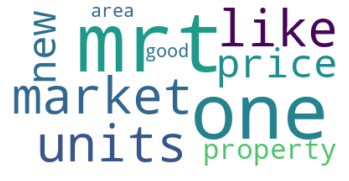

In [18]:
# Show word cloud
create_wordcloud(topic_model_uni,topic=-1)

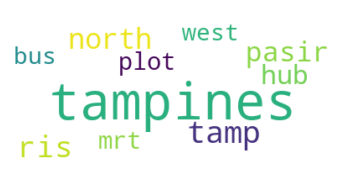

In [19]:
create_wordcloud(topic_model_uni, topic=0)


**Trying different embedding models**

In [20]:
# pip install tensorflow_hub

Universal Sentence Encoder (USE)

In [21]:
text = df["join_clean_text"].to_list()
text

['mine 20 years resale flat top 1999 got bomb shelter aircon ledge noise external traffic supermarket loading bay crazyclubx last time rent unfortunately bought punggol house thought home haiz end peace knew rather rent forever least change buy wait 5 years sell move slamming doors clearly heard hdb stayed hear noise slamming doors haiz noisy inconsiderate upstairs neighbours r pain',
 'kimurayuki mine 20 years resale flat top 1999 got bomb shelter aircon ledge noise external traffic supermarket loading bay well mine 7 8 years old resales flat yes home heard traffic besides busy road traffic noise sleep w aircon noise neighbour made slammed doors sometime 1 2am sometimes things dropped 2 3am think timing quiet time normal ppl sleep haiz spore shld law inconsiderate neighbours',
 'punggolbto per actual hdb models floor plans potential buildings north current bto view units coney island area industrial site johor think add word currently higher average price bto reflects proximity punggo

In [22]:
import tensorflow_hub
embedding_model = tensorflow_hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")

topic_model_uni_2 = BERTopic(embedding_model=embedding_model, min_topic_size=70, n_gram_range=(1,1), verbose=True)
topics_uni_2, _ = topic_model_uni_2.fit_transform(text)

INFO:absl:Using C:\Users\Shawn\AppData\Local\Temp\tfhub_modules to cache modules.
  0%|                                                                                        | 0/13462 [00:00<?, ?it/s]

Instructions for updating:
Use tf.identity instead.


Instructions for updating:
Use tf.identity instead.
100%|███████████████████████████████████████████████████████████████████████████| 13462/13462 [00:21<00:00, 624.29it/s]
2022-10-25 15:17:16,552 - BERTopic - Transformed documents to Embeddings
2022-10-25 15:17:22,872 - BERTopic - Reduced dimensionality
2022-10-25 15:17:23,846 - BERTopic - Clustered reduced embeddings


In [23]:
freq_uni_2 = topic_model_uni_2.get_topic_info()
freq_uni_2.head(10)

,Topic,Count,Name
0,-1,1285,-1_mrt_price_ec_like
1,0,11916,0_mrt_market_price_like
2,1,144,1_hdb_property_singapore_units
3,2,117,2_hospital_water_near_temple


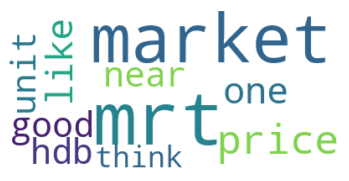

In [24]:
# Show word cloud
create_wordcloud(topic_model_uni_2,topic=0)

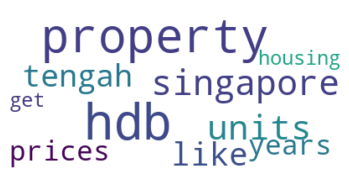

In [25]:
create_wordcloud(topic_model_uni_2,topic=1)

**Bigram**

In [26]:
# topic_model_bi = BERTopic(min_topic_size=70, n_gram_range=(2,2), verbose=True)
# topics_bi, _ = topic_model_bi.fit_transform(df["join_clean_text"].to_list())

In [27]:
# freq_bi = topic_model_bi.get_topic_info()
# freq_bi["Name"][1]

In [28]:
# freq_bi

In [29]:
# create_wordcloud(topic_model_bi,topic=-1)

In [30]:
# create_wordcloud(topic_model_bi,topic=0)

In [31]:
# topic_nr_bi = freq_bi.iloc[1]["Topic"]

In [32]:
# topic_nr_bi = freq_bi.iloc[1]["Topic"] # select a frequent topic
# topic_model_bi.get_topic(topic_nr_bi)

USE embedding model

In [33]:
# topic_model_bi_2 = BERTopic(embedding_model=embedding_model, min_topic_size=70, n_gram_range=(1,1), verbose=True)
# topics_bi_2, _ = topic_model_bi_2.fit_transform(text)

In [34]:
# freq_bi_2 = topic_model_bi_2.get_topic_info()
# freq_bi_2.head(10)

In [35]:
# create_wordcloud(topic_model_bi_2,topic=0)

In [36]:
# create_wordcloud(topic_model_bi_2,topic=-1)

**Trigram**

In [37]:
# topic_model_tri = BERTopic(min_topic_size=70, n_gram_range=(3,3), verbose=True)
# topics_tri, _ = topic_model_tri.fit_transform(df["join_clean_text"].to_list())

In [38]:
# freq_tri = topic_model_tri.get_topic_info()
# freq_tri.head(10)

In [39]:
# create_wordcloud(topic_model_tri,topic=-1)

In [40]:
# create_wordcloud(topic_model_tri,topic=0)

In [41]:
# topic_nr_tri = freq_tri.iloc[2]["Topic"] # select a frequent topic
# topic_model_tri.get_topic(topic_nr_tri)

In [42]:
# topic_docs = {topic: [] for topic in set(topics_bi)}
# for topic, text in zip(topics_bi, text):
#     topic_docs[topic].append(text)

In [43]:
# text = ''.join([i for i in text if not i.isdigit()])
# text

USE embedding model

In [44]:
# topic_model_tri_2 = BERTopic(embedding_model=embedding_model, min_topic_size=70, n_gram_range=(1,1), verbose=True)
# topics_tri_2, _ = topic_model_tri_2.fit_transform(text)

In [45]:
# freq_tri_2 = topic_model_tri_2.get_topic_info()
# freq_tri_2.head(10)

In [46]:
# create_wordcloud(topic_model_tri_2,topic=0)

In [47]:
# create_wordcloud(topic_model_tri_2,topic=1)

In [48]:
#after

In [49]:
# df = pd.read_csv("aftercovid.csv")

In [50]:
# # topic_model_uni = BERTopic(n_gram_range=(1,1), verbose=True)
# topic_model_uni = BERTopic(n_gram_range=(1,1), verbose=True)
# topics_uni, _ = topic_model_uni.fit_transform(df["join_clean_text"].to_list())
# freq_uni = topic_model_uni.get_topic_info()
# freq_uni.head(10)

In [51]:
# topic_model_bi = BERTopic(min_topic_size=70, n_gram_range=(2,2), verbose=True)
# topics_bi, _ = topic_model_bi.fit_transform(df["join_clean_text"].to_list())
# freq_bi = topic_model_bi.get_topic_info()
# freq_bi.head(10)

In [52]:
# topic_model_tri = BERTopic(min_topic_size=70, n_gram_range=(3,3), verbose=True)
# topics_tri, _ = topic_model_tri.fit_transform(df["join_clean_text"].to_list())
# freq_tri = topic_model_tri.get_topic_info()
# freq_tri.head(10)

# Results


Get docs by topic number

In [53]:
topic_model_uni.get_representative_docs(topic=1)

['windwaver usually towards tail end selection people go best left e highest floor best layout nearest amenities etc according priority main difference likely end lower floor less features prefer compared front however take note people even get number ballot count lucky akloaklo mine early dec flat selection checking still got high floors best blocks already gone long ago settle high floors near woodleigh mrt yup best bet',
 'thenakedshades wah done research opinion top 3 stacks think top stack 56 consider stack 66 68 11 13 floor stack 23 glen top 9 floor roof garden 10 floor choose 50 52 west sun road noise distance mrt rest depend individual preferences stacks 102 104 106 108 110 least popular',
 'windwaver best 3rm stack ask next 19 best 4rm stack 05 21 refuse chute corridor service yard proximity mrt stadium view bit angle excellent windwaver 19 second best although little south stack still getting powerful southern winds unfortunately best stack always reserved expensive units cas

List of topics

In [54]:
topic_model_uni.get_topics()

{-1: [('mrt', 0.0034146423888446013),
  ('one', 0.0029894920702733547),
  ('market', 0.002961543985959648),
  ('units', 0.0029559616155484954),
  ('like', 0.0029229432730227753),
  ('price', 0.0028935391084329064),
  ('new', 0.0028607473867254354),
  ('property', 0.0028531975188648955),
  ('good', 0.0028136360220443668),
  ('area', 0.0027746722061613802)],
 0: [('tampines', 0.06700552161989888),
  ('tamp', 0.013848036020050475),
  ('ris', 0.013106002890623756),
  ('north', 0.011627797602792044),
  ('pasir', 0.011079607405993747),
  ('hub', 0.01032669135579021),
  ('mrt', 0.008469361929111404),
  ('plot', 0.008254617832215318),
  ('west', 0.0075290196494020595),
  ('bus', 0.007434523039982967)],
 1: [('sun', 0.030963066109932002),
  ('stack', 0.021421569352685566),
  ('stacks', 0.019966679259796623),
  ('west', 0.015622236642384275),
  ('facing', 0.01349619529607588),
  ('view', 0.01329047872138419),
  ('floor', 0.013276614666424881),
  ('windwaver', 0.012915542984321914),
  ('251', 0.0

In [55]:
topic_model_uni.get_topic_info()

,Topic,Count,Name
0,-1,5780,-1_mrt_one_market_units
1,0,272,0_tampines_tamp_ris_north
2,1,159,1_sun_stack_stacks_west
3,2,145,2_room_aircon_toilet_floor
4,3,136,3_annetyu_developers_prices_garden
...,...,...,...
270,269,10,269_13xxpsf_watertown_scr_treasure
271,270,10,270_nuts_misunderstood_thing_schools
272,271,10,271_terrasse_affinity_starts_stupid
273,272,10,272_stumbled_reviving_unreasonable_taker


# Topic prediction

In [56]:
# topic_list = []
# #probs_list = []
# for doc in text:
#     test_docs = doc
#     predicted_topics, predicted_probs = topic_model_bi.transform(test_docs)
#     topic = topic_model_bi.get_topic(predicted_topics[0])
#     topic_list.append(topic)
#   #probs_list.append(predicted_probs)


In [57]:
# topic_list

In [58]:
#probs_list

In [59]:
# dfs_with_topics = df

In [60]:
# dfs_with_topics.to_csv('file_name.csv', encoding='utf-8')

In [61]:
# test_docs = text[0]

In [62]:
# Predict topics for test_docs
# predicted_topics, predicted_probs = topic_model_bi.transform(test_docs)

In [63]:
# predicted_topics

In [64]:
# topic = topic_model_bi.get_topic(predicted_topics[0])
# topic

In [65]:
# test_docs = text[1]

In [66]:
# Predict topics for test_docs
# predicted_topics, predicted_probs = topic_model_bi.transform(test_docs)

In [67]:
# predicted_topics

In [68]:
# topic = topic_model_bi.get_topic(predicted_topics[0])
# topic

In [69]:
test_docs = text[2]

In [70]:
# Predict topics for test_docs
# predicted_topics, predicted_probs = topic_model_bi.transform(test_docs)

In [71]:
# predicted_topics

In [72]:
# topic = topic_model_bi.get_topic(predicted_topics[0])
# topic

# Coherence Score

**Unigram**

In [73]:
from bertopic import BERTopic
import gensim.corpora as corpora
from gensim.models.coherencemodel import CoherenceModel

# text = dfs[2].lemmatized.to_list()
# dates = dfs[2]['Date'].apply(lambda x: pd.Timestamp(x)).to_list()

topic_model = BERTopic(verbose=True, n_gram_range=(1, 1))
topics, _ = topic_model.fit_transform(text)

# Preprocess Documents
documents = pd.DataFrame({"Document": text,
                          "ID": range(len(text)),
                          "Topic": topics})
documents_per_topic = documents.groupby(['Topic'], as_index=False).agg({'Document': ' '.join})
cleaned_docs = topic_model._preprocess_text(documents_per_topic.Document.values)

# Extract vectorizer and analyzer from BERTopic
vectorizer = topic_model.vectorizer_model
analyzer = vectorizer.build_analyzer()

# Extract features for Topic Coherence evaluation
words = vectorizer.get_feature_names()
tokens = [analyzer(doc) for doc in cleaned_docs]
dictionary = corpora.Dictionary(tokens)
corpus = [dictionary.doc2bow(token) for token in tokens]
topic_words = [[words for words, _ in topic_model.get_topic(topic)] 
               for topic in range(len(set(topics))-1)]

# Evaluate
coherence_model = CoherenceModel(topics=topic_words, 
                                 texts=tokens, 
                                 corpus=corpus,
                                 dictionary=dictionary, 
                                 coherence='c_v')
coherence = coherence_model.get_coherence()

Batches:   0%|          | 0/421 [00:00<?, ?it/s]

2022-10-25 15:24:57,873 - BERTopic - Transformed documents to Embeddings
2022-10-25 15:25:13,107 - BERTopic - Reduced dimensionality
2022-10-25 15:25:14,305 - BERTopic - Clustered reduced embeddings


In [74]:
print(coherence)

0.6563531722461508


**Bigram**

In [75]:
# from bertopic import BERTopic
# import gensim.corpora as corpora
# from gensim.models.coherencemodel import CoherenceModel

# # text = dfs[2].lemmatized.to_list()
# # dates = dfs[2]['Date'].apply(lambda x: pd.Timestamp(x)).to_list()

# topic_model = BERTopic(verbose=True, n_gram_range=(2, 2))
# topics, _ = topic_model.fit_transform(text)

# # Preprocess Documents
# documents = pd.DataFrame({"Document": text,
#                           "ID": range(len(text)),
#                           "Topic": topics})
# documents_per_topic = documents.groupby(['Topic'], as_index=False).agg({'Document': ' '.join})
# cleaned_docs = topic_model._preprocess_text(documents_per_topic.Document.values)

# # Extract vectorizer and analyzer from BERTopic
# vectorizer = topic_model.vectorizer_model
# analyzer = vectorizer.build_analyzer()

# # Extract features for Topic Coherence evaluation
# words = vectorizer.get_feature_names()
# tokens = [analyzer(doc) for doc in cleaned_docs]
# dictionary = corpora.Dictionary(tokens)
# corpus = [dictionary.doc2bow(token) for token in tokens]
# topic_words = [[words for words, _ in topic_model.get_topic(topic)] 
#                for topic in range(len(set(topics))-1)]

# # Evaluate
# coherence_model = CoherenceModel(topics=topic_words, 
#                                  texts=tokens, 
#                                  corpus=corpus,
#                                  dictionary=dictionary, 
#                                  coherence='c_v')
# coherence = coherence_model.get_coherence()

In [76]:
print(coherence)

0.6563531722461508


**Trigram**

In [77]:
# from bertopic import BERTopic
# import gensim.corpora as corpora
# from gensim.models.coherencemodel import CoherenceModel

# # text = dfs[2].lemmatized.to_list()
# # dates = dfs[2]['Date'].apply(lambda x: pd.Timestamp(x)).to_list()

# topic_model = BERTopic(verbose=True, n_gram_range=(3, 3))
# topics, _ = topic_model.fit_transform(text)

# # Preprocess Documents
# documents = pd.DataFrame({"Document": text,
#                           "ID": range(len(text)),
#                           "Topic": topics})
# documents_per_topic = documents.groupby(['Topic'], as_index=False).agg({'Document': ' '.join})
# cleaned_docs = topic_model._preprocess_text(documents_per_topic.Document.values)

# # Extract vectorizer and analyzer from BERTopic
# vectorizer = topic_model.vectorizer_model
# analyzer = vectorizer.build_analyzer()

# # Extract features for Topic Coherence evaluation
# words = vectorizer.get_feature_names()
# tokens = [analyzer(doc) for doc in cleaned_docs]
# dictionary = corpora.Dictionary(tokens)
# corpus = [dictionary.doc2bow(token) for token in tokens]
# topic_words = [[words for words, _ in topic_model.get_topic(topic)] 
#                for topic in range(len(set(topics))-1)]

# # Evaluate
# coherence_model = CoherenceModel(topics=topic_words, 
#                                  texts=tokens, 
#                                  corpus=corpus,
#                                  dictionary=dictionary, 
#                                  coherence='c_v')
# coherence = coherence_model.get_coherence()

In [78]:
# print(coherence)

# Visualization


**Intertopic Distance Map**

---



In [79]:
topic_model.visualize_topics()

In [80]:
fig = topic_model.visualize_topics()
fig
# fig.write_html("./drive/MyDrive/Code/topicDistanceMap.html")

**Hierachical Clustering**

---



In [81]:
topic_model.visualize_hierarchy()

**Word scores**

---



In [82]:
topic_model.visualize_barchart()

In [83]:
fig = topic_model.visualize_barchart()
fig
# fig.write_html("./drive/MyDrive/Code/topicWordScores.html")

**Topics over time**

---



In [84]:
topics_over_time = topic_model.topics_over_time(text, topics)

273it [00:07, 35.96it/s]


In [85]:
topics_over_time

,Topic,Words,Frequency,Timestamp
0,-1,"mrt, one, like, property, new",5307,-1
1,0,"tampines, tamp, ris, hub, north",290,0
2,1,"agent, agents, seller, commission, buyer",282,1
3,2,"queue, number, selection, selected, feb",141,2
4,3,"sibor, rate, fixed, rates, fd",140,3
...,...,...,...,...
268,267,"exceed, lowest, 100k, 94yrs, occupancy",11,267
269,268,"13xxpsf, waterway, treasure, sumang, scr",10,268
270,269,"terra, dating, tayhhd, acquaintances, sleepovers",10,269
271,270,"cck, bb, bf, mcps, kamxiahamida",10,270


In [86]:
topic_model.visualize_topics_over_time(topics_over_time, top_n_topics=20, width=1200, height=500)

In [87]:
fig = topic_model.visualize_topics_over_time(topics_over_time, top_n_topics=20, width=1200, height=500)
fig
# fig.write_html("./drive/MyDrive/Code/topicsOverTimeTop20.html")

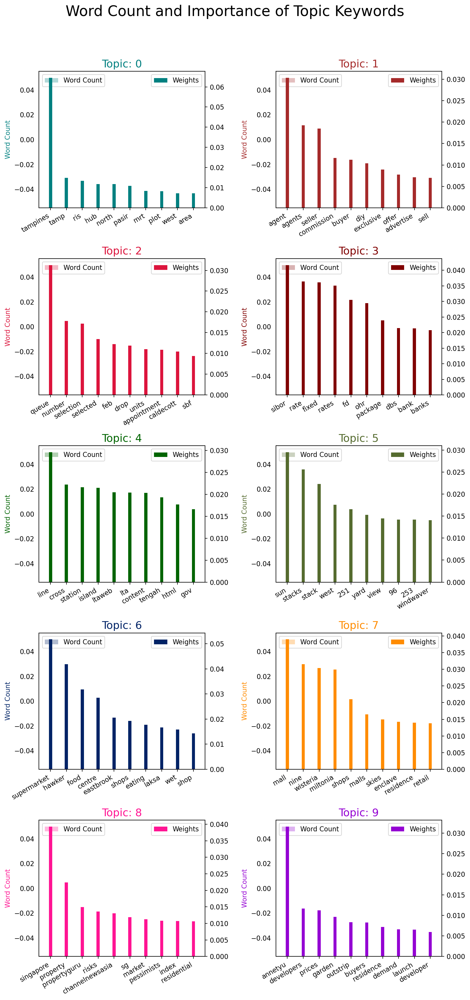

In [88]:
from collections import Counter

topics = topic_model.get_topics()
topics = {k:topics[k] for k in (0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20) if k in topics}
data_flat = [w for w_list in data_lemmatized for w in w_list]
counter = Counter(data_flat)
ntopics_des_name = 10

out = []
for i, topic in topics.items():
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df_word = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(5,2, figsize=(10,20), dpi=160,facecolor='white')
cols = ['#008080', '#A52A2A', '#DC143C', '#800000', '#006400', '#556b2f', '#002366', '#ff8c00', '#FF1493', '#9400D3',
        '#ba55d3', '#b8860b', '#C71585', '#00ff7f', '#00004C', '#00008B', '#B8860B', '#DEB887', '#8A2BE2', '#1b364a']

for i, ax in enumerate(axes.flatten()):
    if i > ntopics_des_name - 1: # break when all topics are shown
        break
    ax.bar(x='word', height="word_count", data=df_word.loc[df_word.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df_word.loc[df_word.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df_word.loc[df_word.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')


fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=22, y=1.05)    
plt.savefig('bert_topics_before_unigram.png',facecolor=fig.get_facecolor(), transparent=True)
plt.show()

